# Fit a simple kinematic model for the Milky Way disk to the OBA star proper motion data

The model fit in this notebook is the rotation curve presented in equation (7) of [Brunetti & Pfenniger (2010)](https://ui.adsabs.harvard.edu/abs/2010A%26A...510A..34B/abstract).

The Milky Way disk circular velocity curve is fit to the proper motion data, with the following parameters:
* $V_\mathrm{circ,\odot}$ the circular velocity at the location of sun (positive by convention, in km/s)
* $h$ Scale length parameter of the Brunetti & Pfenniger model (pc)
* $p$ Shape parameter of the Brunetti & Pfenniger model (dimensionless, in $[-1,2]$)
* $\mathbf{v}_{\odot,\mathrm{pec}}$ the peculiar motion vector of the sun (km/s)
* $\sigma_{R}$ the velocity dispersion around pure circular motion of the stars in the Galactocentric cylindrical coordinate directions $R$
* $\sigma_{\phi}$ the velocity dispersion around pure circular motion of the stars in the Galactocentric cylindrical coordinate directions $\phi$
* $\sigma_z$ the velocity dispersion around pure circular motion of the stars in the Galactic cylindrical coordinate direction $z$

Fixed parameters:
* $R_\odot$ distance from the sun to the galactic centre, assumed known from GRAVITY measurements. The value used is 8277 pc from [GRAVITY Collaboration et al. (2022)](https://ui.adsabs.harvard.edu/abs/2022A%26A...657L..12G).
* $Y_\odot$ The Galactic Cartesian Y-coordinate of the Sun, by definition 0.
* $Z_\odot$ the height of the sun above (or below) the galactic plane (pc). The value $20.8$ pc from [Bennett & Bovy (2019)](https://ui.adsabs.harvard.edu/abs/2019MNRAS.482.1417B/abstract) is used. NOTE that one can introduce $Z_\odot$ as a parameter in the model below, but experiments show that the data has no constraining power on $Z_\odot$ (even if mathematically the proper motions also depend on $Z_\odot$), as the posterior distribution on the sun's height is the same as the prior.
* $\varpi_i$ parallaxes of the stars are assumed known for now (high precision subsample is used). The parallax uncertainties are thus ignored.
* Coordinates $(\ell,b)_i$, assumed error free

Observations:
* Proper motions in $\ell$ and $b$ (mas/yr)
* Proper motion covariance matrices

## Model details

The stars are assumed to follow strictly circular orbits where the orbital velocity is independent of the galactocentric $z$ coordinate. The velocity $\mathbf{v}$ of a star with parallax $\varpi$ is calculated according to the following steps:

For a star at coordinates $(\ell, b)$ calculate the normal triad $[\mathbf{p}, \mathbf{q}, \mathbf{r}]$:

\begin{equation}
    \mathbf{p} = \begin{pmatrix} -\sin\ell \\ \cos\ell \\ 0 \end{pmatrix}\,,\quad
    \mathbf{q} = \begin{pmatrix} -\sin b\cos\ell \\ -\sin b\sin\ell \\ \cos b \end{pmatrix}\,,\quad
    \mathbf{r} = \begin{pmatrix} \cos b\cos\ell \\ \cos b\sin\ell \\ \sin b \end{pmatrix}\,.
\end{equation}

The calculate the Galactocentric Cartesian star position as:

\begin{equation}
    \mathbf{x} = (1000/\varpi)\mathbf{r} + \mathbf{x}_\odot\,,
\end{equation}

with $\mathbf{x}$ the $(x,y,z)$ position of the star. The coordinate system is right-handed with the Sun located at $(-R_\odot, 0, z_\odot)$ and the sense of the Milky Way rotation such that the azimuthal velocity of the stars $V_\phi$ is negative. The velocity of the star is calculated from the azimuthal velocity $V_\phi(R)$ as:

\begin{equation}
    \mathbf{v} = \begin{pmatrix} -V_\phi(R)\sin\phi \\ V_\phi(R)\cos\phi \\ 0 \end{pmatrix} \quad\text{with}\quad \phi=\text{atan2}(y, x) \quad\text{and}\quad
    R=\sqrt{x^2+y^2}\,.
\end{equation}

The azimuthal velocity $V_\phi(R)$ at the position of the star is calculated as:

\begin{equation}
    V_\phi(R) = -\left(v_0\frac{R}{h}\left[1+\left(\frac{R}{h}\right)^2\right]^{\frac{p-2}{4}}\right) \quad\text{with}\quad
    v_0 = V_{\mathrm{circ},\odot}\left(\frac{R_\odot}{h}\left[1+\left(\frac{R_\odot}{h}\right)^2\right]^{\frac{p-2}{4}}\right)^{-1}\,.
\end{equation}

Finally the proper motions are calculated as:

\begin{equation}
    \mu_{\ell*} = \frac{\varpi}{A_\mathrm{v}}\mathbf{p}\cdot(\mathbf{v}-\mathbf{v}_\odot)\,,\quad
    \mu_b = \frac{\varpi}{A_\mathrm{v}}\mathbf{q}\cdot(\mathbf{v}-\mathbf{v}_\odot)\,,
\end{equation}

The modelling is done in a Bayesian manner with likelihood:

\begin{equation}
    \mathbf{\mu}_\mathrm{obs} \sim {\cal N}\left(\mathbf{\mu}_\mathrm{model} \mid \mathsf{D}_\mathrm{\mu} \right)\,,
\end{equation}

where the covariance matrix in the likelihood is given as:

\begin{equation}
    \mathsf{D}_\mu = \mathsf{C}_\mu + \begin{pmatrix} \mathbf{p}'\mathsf{S}\mathbf{p} & \mathbf{p}'\mathsf{S}\mathbf{q} \\
    \mathbf{q}'\mathsf{S}\mathbf{p} & \mathbf{q}'\mathsf{S}\mathbf{q}
    \end{pmatrix} (\varpi/A_\mathrm{v})^2\,,
\end{equation}

with the matrix $\mathsf{S}$ representing the velocity dispersion:

\begin{equation}
    \mathsf{S} = \mathsf{J}\mathsf{S}_\mathrm{cyl}\mathsf{J}^\mathrm{T} \quad\text{with}\quad
    \mathsf{J} = \begin{pmatrix}
        \cos\phi & -sin\phi & 0 \\
        \sin\phi & \cos\phi & 0 \\
        0 & 0 & 1
    \end{pmatrix}\,,
    \mathsf{S}_\mathrm{cyl} =
    \begin{pmatrix}
        \sigma^2_{R} & 0 & 0 \\
        0 & \sigma_{\phi}^2 & 0 \\
        0 & 0 & \sigma_z^2
    \end{pmatrix}\,,
\end{equation}

where $\mathsf{S}_\mathrm{cyl}$ is the velocity covariance matrix in cylindrical coordinates and $\mathsf{J}$ represents the rotation to the Cartesian coordinate system (dependent on $\phi$).

The priors on the circular velocity at the sun, $h$, and the sun's peculiar motion components are all normal distributions. The priors on $p$ and the components of $\mathsf{S}_\mathrm{cyl}$ are uniform distributions.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec

import ujson, os

from scipy.stats import scoreatpercentile as scap

from cmdstanpy import set_cmdstan_path, CmdStanModel, from_csv
import arviz as az
import corner

from astropy.table import Table
import astropy.units as u
import astropy.constants as c
from astropy.coordinates import Galactocentric, ICRS, CartesianDifferential
au_km_year_per_sec = (c.au / (1*u.yr).to(u.s)).to(u.km/u.s).value

from plotstyles import useagab, apply_tufte
from robuststats import rse

from diskkinematicmodel import *
from icrstogal import *
from loadmwsamples import *

useagab()

## Read in the data

First query the Gaia DR3 archive for the data necessary to reproduce the analysis and store in the `../data` folder.

```sql
select gaia.source_id, gaia.ra, gaia.dec, gaia.parallax, gaia.parallax_error, gaia.pmra, gaia.pmra_error,
gaia.pmdec, gaia.pmdec_error, gaia.parallax_pmra_corr, gaia.parallax_pmdec_corr, gaia.pmra_pmdec_corr, 
gaia.radial_velocity, gaia.radial_velocity_error, gaia.rv_template_teff, gaia.grvs_mag, 
gaia.phot_g_mean_mag, gaia.bp_rp, gaia.g_rp, gaia.bp_g, 
gaia.ag_gspphot, gaia.ebpminrp_gspphot, gaia.teff_gspphot, gaia.logg_gspphot,
aps.teff_esphs, aps.logg_esphs, aps.ag_esphs, aps.ebpminrp_esphs, aps.spectraltype_esphs, oba.vtan_flag
from gaiadr3.gold_sample_oba_stars as oba
join gaiadr3.astrophysical_parameters as aps
using (source_id)
join gaiadr3.gaia_source as gaia
using (source_id)
```

The Cartesian and cylindrical galactocentric coordinates are calculate for the stars for use further down.

In [2]:
Rsun = 8.277*u.kpc

obatable = load_mwtable('./data/OBAGoldenSample.fits', Rsun=Rsun)

#obatable.write("./data/OBAGoldenSample_xyz.fits", format="fits", overwrite=True)

## Select a sub-sample to work with

Use a high precision parallax sample of B stars. Futher selections are done on the tangential velocity $v_\mathrm{tan}<v_\mathrm{tan,max}$, distance from the plane $|\sin(b)\times1000/\varpi|<z_\mathrm{max}$, and distance from Galactic centre $R_\mathrm{min}<R<R_\mathrm{max}$. The resulting selection is then subsampled randomly to create a manageable sample for the model fitting process.

Number of stars in selected sample: 423927


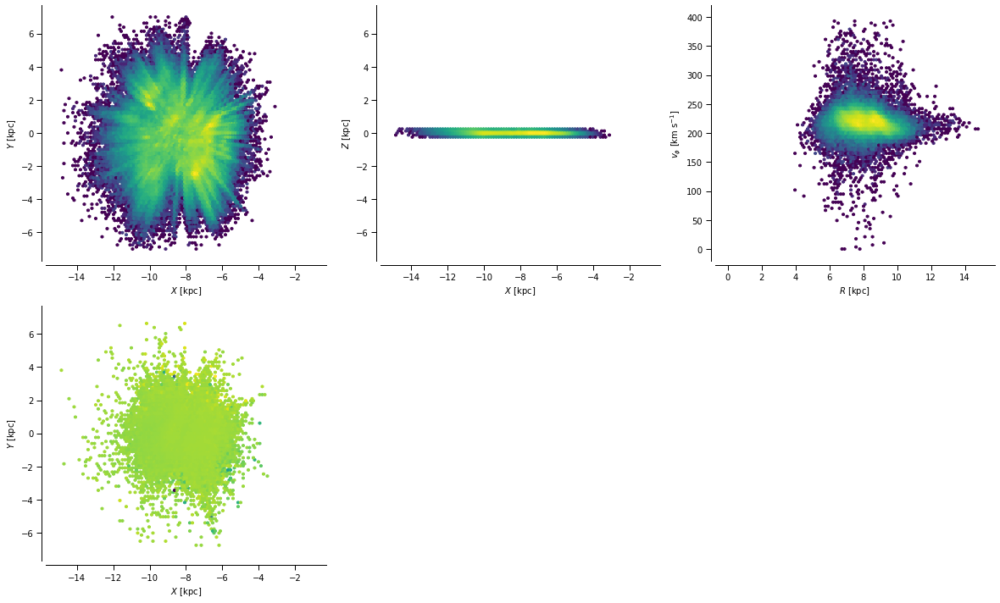

In [3]:
plx_snrlim = 10
vtanhalo = 180.0

startype = (obatable['spectraltype_esphs'] == 'B')
plxfilter = obatable['parallax_over_error']>plx_snrlim
nonhalo = obatable['vtan'] < vtanhalo
zmax = 250

sample_filter_init = startype & plxfilter & nonhalo & (np.abs(np.sin(np.deg2rad(obatable['b']))*1000/obatable['parallax']) < zmax)

R_filter = (obatable['R_gc']>6500.0) & (obatable['R_gc']<15000.0)

sample_filter = sample_filter_init # & R_filter

# Not yet how I first implemented it:
filter_of_choice = "oba"

# spt_lum_filter = filter_dictionary[filter_of_choice]
fit_save_location = os.path.join(os.getcwd(), 'fitfiles', filter_of_choice)
#

print(f"Number of stars in selected sample: {obatable['ra'][sample_filter].size}")

subsample_size = 3000
if (obatable['ra'][sample_filter].size <=subsample_size):
    oba_subsample = obatable[sample_filter]
else:
    random_subsample = np.random.choice(np.arange(obatable['ra'][sample_filter].size), size=subsample_size, replace=False)
    oba_subsample = obatable[sample_filter][random_subsample]
    
plotgrid = [-15, -1, -7, 7]
fig=plt.figure(figsize=(16.5,10), tight_layout=True)

gs = fig.add_gridspec(2, 3, figure=fig)

ax_xy = fig.add_subplot(gs[0,0])
apply_tufte(ax_xy)
ax_xz = fig.add_subplot(gs[0,1])
apply_tufte(ax_xz)
ax_rvphi = fig.add_subplot(gs[0,2])
apply_tufte(ax_rvphi)
ax_xy_vphi = fig.add_subplot(gs[1,0])
apply_tufte(ax_xy_vphi)

ax_xy.hexbin(obatable['x_gc'][sample_filter]/1000, obatable['y_gc'][sample_filter]/1000, mincnt=1, bins='log', extent=plotgrid)
ax_xy.set_xlabel(r'$X$ [kpc]') 
ax_xy.set_ylabel(r'$Y$ [kpc]') 

ax_xz.hexbin(obatable['x_gc'][sample_filter]/1000, obatable['z_gc'][sample_filter]/1000, mincnt=1, bins='log', extent=plotgrid)
ax_xz.set_xlabel(r'$X$ [kpc]') 
ax_xz.set_ylabel(r'$Z$ [kpc]')

hasrvs = sample_filter & obatable['rvvalid']
ax_rvphi.hexbin(obatable['R_gc'][hasrvs]/1000, obatable['v_phi_gc'][hasrvs], mincnt=1, bins='log', extent=[0,15,0,400])
ax_rvphi.set_xlabel(r'$R$ [kpc]') 
ax_rvphi.set_ylabel(r'$v_\phi$ [km s$^{-1}$]')

ax_xy_vphi.hexbin(obatable['x_gc'][hasrvs]/1000, obatable['y_gc'][hasrvs]/1000, mincnt=0, C=obatable['v_phi_gc'][hasrvs],
                  reduce_C_function=np.median, bins='log', extent=plotgrid)
ax_xy_vphi.set_xlabel(r'$X$ [kpc]') 
ax_xy_vphi.set_ylabel(r'$Y$ [kpc]') 

plt.show()

## Plot histogram of $\sin(b)\times 1000/\varpi$

Use this to estimate $z_\odot$ for this sample. Note that the precise value of $z_\odot$ has very little effect on the results.

Median d*sin(b): -20.3
RSE d*sin(b): 97.4
Mean d*sin(b): -17.6


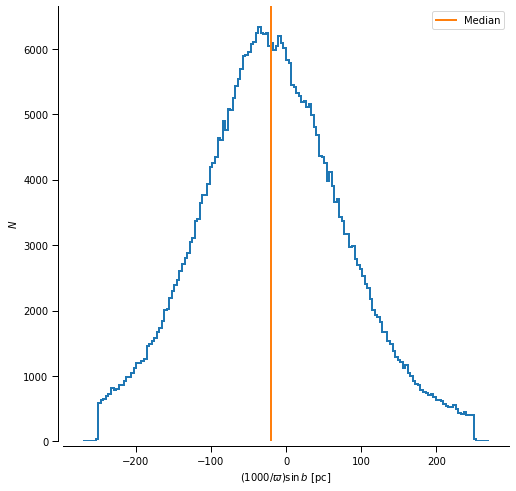

In [4]:
fig, axdsinb = plt.subplots(1, 1, figsize=(8,8))
apply_tufte(axdsinb)

dsinb = (np.sin(np.deg2rad(obatable['b']))*1000.0/obatable['parallax'])[sample_filter]
print(f"Median d*sin(b): {np.median(dsinb):.1f}")
print(f"RSE d*sin(b): {rse(dsinb):.1f}")
print(f"Mean d*sin(b): {dsinb.mean():.1f}")
zsun = 0.0*u.kpc #-np.median(dsinb)*u.pc

axdsinb.hist(dsinb, bins='auto', histtype='step', lw=2, range=[-270,270])
axdsinb.axvline(x=np.median(dsinb), color='C1', label='Median')
axdsinb.set_xlabel(r'$(1000/\varpi)\sin b$ [pc]')
axdsinb.set_ylabel(r'$N$')
axdsinb.legend()

plt.show()

## Plot the sample proper motions as a function of galactic longitude

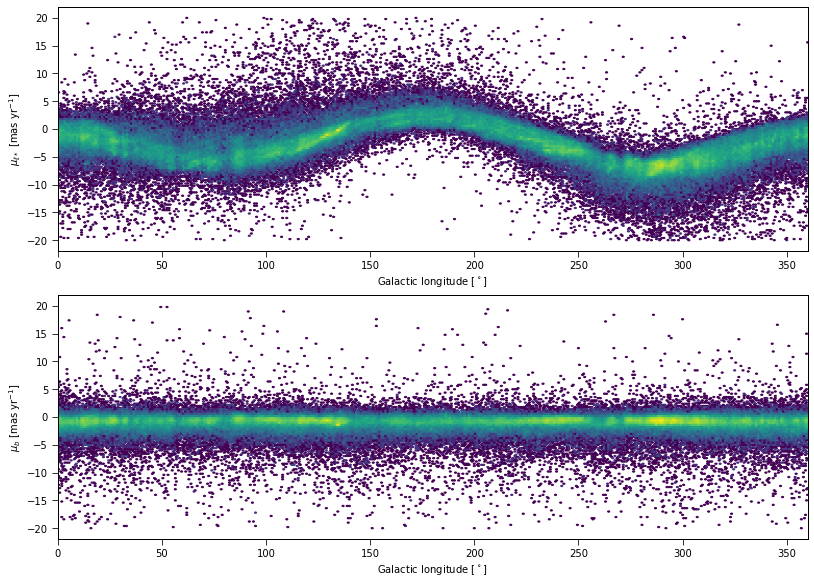

In [5]:
fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))

gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], obatable['pml'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'$\mu_{\ell*}$ [mas yr$^{-1}$]')
ax_lmul.set_xlim(0,360)

ax_lmub = fig.add_subplot(gs[1,0])
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], obatable['pmb'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'$\mu_b$ [mas yr$^{-1}$]')
ax_lmub.set_xlim(0,360)

plt.savefig('bstar-pml-pmb-vs-galon.png')

plt.show()

## Set up the STAN model

In [6]:
nsources = oba_subsample['ra'].size
print(f"Number of sources in sample: {nsources}")

oba_data = {'N': nsources, 
            'galon': np.deg2rad(oba_subsample['l']).tolist(), 
            'galat': np.deg2rad(oba_subsample['b']).tolist(),
            'pml_obs': oba_subsample['pml'].tolist(),
            'pml_obs_unc': oba_subsample['pml_error'].tolist(),
            'pmb_obs': oba_subsample['pmb'].tolist(),
            'pmb_obs_unc': oba_subsample['pmb_error'].tolist(),
            'pml_pmb_corr': oba_subsample['pml_pmb_corr'].tolist(),
            'plx_obs': oba_subsample['parallax'].tolist(),
            'Rsun': Rsun.value,
            'Zsun':zsun.value
            }
with open('oba.data.json', 'w') as fp:
    ujson.dump(oba_data, fp)
    fp.close()

bp2010_model = {'stanfile':'mwdisk-bp2010-model.stan', 
               'npars':9,
               'parnames':['Vcirc_sun', 'hbp', 'pbp', 'Vsun_pec_x', 'Vsun_pec_y', 'Vsun_pec_z', 'vdispR', 'vdispPhi', 'vdispZ'],
               'labels':[r'$V_{\mathrm{circ},\odot}}$', r'$h$', r'$p$', r'$V_{X,\odot}(\mathrm{pec})$', r'$V_{Y,\odot}(\mathrm{pec})$', 
                         r'$V_{Z,\odot}(\mathrm{pec})$', r'$\sigma_{v,R}$', r'$\sigma_{v,\phi}$', r'$\sigma_{v,z}$'], 
               'inits':{'Vcirc_sun':220.0, 'hbp':4.0, 'pbp':0.0, 'Vsun_pec_x':11.1, 'Vsun_pec_y':12.24, 'Vsun_pec_z':7.25, 'vdispR':10.0, 'vdispPhi':10.0, 'vdispZ':10.0},
               'best_params':{'Vcirc_sun':np.nan, 'hbp':np.nan, 'pbp':np.nan, 'Vsun_pec_x':np.nan, 'Vsun_pec_y':np.nan, 'Vsun_pec_z':np.nan, 
                              'vdispR':np.nan, 'vdispPhi':np.nan, 'vdispZ':np.nan}
              }

stan_model = bp2010_model

Number of sources in sample: 3000


## Sample posterior

Feed the OBA star proper motion and parallax data to the Stan model and sample the posterior for the Milky Way parameters.

In [13]:
oba_stan = os.path.join(os.getcwd(), stan_model['stanfile'])
set_cmdstan_path(os.path.join('C:/Users/rjrri/.cmdstan/', 'cmdstan-2.31.0'))
oba_data_path = os.path.join(os.getcwd(), 'oba.data.json')

nwarmup = 500
nsampling = 1000
nchains = 4

oba_model = CmdStanModel(stan_file=oba_stan)
oba_fit = oba_model.sample(chains=nchains, iter_warmup=nwarmup, iter_sampling=nsampling, thin=1, data=oba_data_path, save_warmup=False, show_progress=True, 
                          output_dir=fit_save_location)
#oba_fit = oba_model.sample(chains=4, inits=stan_model['inits'], iter_warmup=500, iter_sampling=1000, thin=1, 
#                           data=oba_data_path, save_warmup=False, show_progress='notebook')

17:19:09 - cmdstanpy - INFO - compiling stan file C:\Users\rjrri\Documents\Universiteit\First project\milkyway-rotation-curve_fork\mwdisk-bp2010-model.stan to exe file C:\Users\rjrri\Documents\Universiteit\First project\milkyway-rotation-curve_fork\mwdisk-bp2010-model.exe
17:19:42 - cmdstanpy - INFO - compiled model executable: C:\Users\rjrri\Documents\Universiteit\First project\milkyway-rotation-curve_fork\mwdisk-bp2010-model.exe
17:19:43 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

17:59:21 - cmdstanpy - INFO - CmdStan done processing.
17:59:21 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: mwdisk_bp2010_model_model_namespace::log_prob: scov is not symmetric. scov[1,2] = nan, but scov[2,1] = nan (in 'C:/Users/rjrri/DOCUME~1/UNIVER~1/FIRSTP~1/MILKYW~2/mwdisk-bp2010-model.stan', line 183, column 2 to column 21)
	Exception: mwdisk_bp2010_model_model_namespace::log_prob: scov is not symmetric. scov[1,2] = nan, but scov[2,1] = nan (in 'C:/Users/rjrri/DOCUME~1/UNIVER~1/FIRSTP~1/MILKYW~2/mwdisk-bp2010-model.stan', line 183, column 2 to column 21)
	Exception: mwdisk_bp2010_model_model_namespace::log_prob: scov is not symmetric. scov[1,2] = nan, but scov[2,1] = nan (in 'C:/Users/rjrri/DOCUME~1/UNIVER~1/FIRSTP~1/MILKYW~2/mwdisk-bp2010-model.stan', line 183, column 2 to column 21)
	Exception: mwdisk_bp2010_model_model_namespace::log_prob: scov is not symmetric. scov[1,2] = nan, but scov[2,1] = nan (in 'C:/Users/rjrri/DOCUME~1/UNIVER~1/FIRSTP~1/MILKYW~2/

17:59:28 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 3 had 16 divergent transitions (1.6%)
	Use function "diagnose()" to see further information.


## Alternatively reading in earlier produced fits

In [21]:
oba_stan = os.path.join(os.getcwd(), stan_model['stanfile'])
set_cmdstan_path(os.path.join('C:/Users/rjrri/.cmdstan/', 'cmdstan-2.31.0'))
oba_data_path = os.path.join(os.getcwd(), 'oba.data.json')

nwarmup = 500
nsampling = 1000
nchains = 4

oba_model = CmdStanModel(stan_file=oba_stan)

# Choice of stars
filter_of_choice = "oba"

fit_save_location = os.path.join(os.getcwd(), 'fitfiles', filter_of_choice)

oba_fit = from_csv(path=fit_save_location)
print(fit_save_location[-len(filter_of_choice):])

11:10:13 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 3 had 16 divergent transitions (1.6%)
	Use function "diagnose()" to see further information.


oba


## Summarize the fit results

Note this can take a while as very large CSV files have to be read into memory first.

In [ ]:
print(oba_fit.diagnose())

In [8]:
# Summary from Brown's github results
oba_fit.summary()[0:stan_model['npars']+1]

,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
lp__,-3579.340000,0.063907,2.282950,-3583.71000,-3578.910000,-3576.42000,1276.13,0.459973,1.001850
Vcirc_sun,235.785000,0.025722,1.573730,233.16800,235.786000,238.31900,3743.41,1.349280,1.000580
hbp,4.439800,0.009410,0.322598,3.87086,4.459540,4.92218,1175.38,0.423659,1.003960
pbp,-0.813346,0.002772,0.093590,-0.96213,-0.816332,-0.65170,1139.67,0.410785,1.004450
Vsun_pec_x,8.235220,0.006911,0.392655,7.59458,8.237070,8.88687,3228.33,1.163630,1.000870
Vsun_pec_y,11.265200,0.012126,0.491070,10.47140,11.255800,12.10330,1640.06,0.591148,1.001980
Vsun_pec_z,8.038130,0.002266,0.139730,7.80621,8.038250,8.26239,3801.86,1.370350,1.000250
vdispR,16.420500,0.005705,0.328741,15.88170,16.418400,16.96340,3320.16,1.196730,1.000070
vdispPhi,11.985400,0.006305,0.344489,11.43670,11.977400,12.56400,2984.86,1.075870,1.000130
vdispZ,7.603110,0.001579,0.098894,7.44710,7.601290,7.76785,3920.11,1.412970,0.999763


In [15]:
# Summary from my results
oba_fit.summary()[0:stan_model['npars']+1]

,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
lp__,-3441.310000,0.060747,2.241780,-3445.560000,-3440.930000,-3438.350000,1361.89,0.293890,0.999956
Vcirc_sun,231.664000,0.024939,1.549830,229.103000,231.656000,234.233000,3862.05,0.833413,0.999340
hbp,4.773510,0.007166,0.229188,4.367730,4.806150,5.088940,1022.76,0.220707,1.008970
pbp,-0.896447,0.002149,0.068428,-0.990473,-0.905018,-0.774626,1014.00,0.218817,1.008710
Vsun_pec_x,9.043030,0.007482,0.389867,8.409740,9.045220,9.691060,2715.47,0.585986,1.000320
Vsun_pec_y,10.738900,0.010539,0.435377,10.027600,10.745800,11.464000,1706.74,0.368307,1.003860
Vsun_pec_z,8.024070,0.002093,0.126141,7.817080,8.022480,8.236470,3631.65,0.783695,0.999426
vdispR,17.310300,0.006942,0.350864,16.740000,17.301700,17.898600,2554.28,0.551202,1.001040
vdispPhi,12.046800,0.006813,0.347816,11.494900,12.036500,12.626500,2606.61,0.562495,1.000440
vdispZ,7.195810,0.001794,0.096275,7.037800,7.194560,7.354830,2878.59,0.621188,0.999256


## Plot the values of the MCMC chains vs iteration number

The burn-in samples have already been discarded.

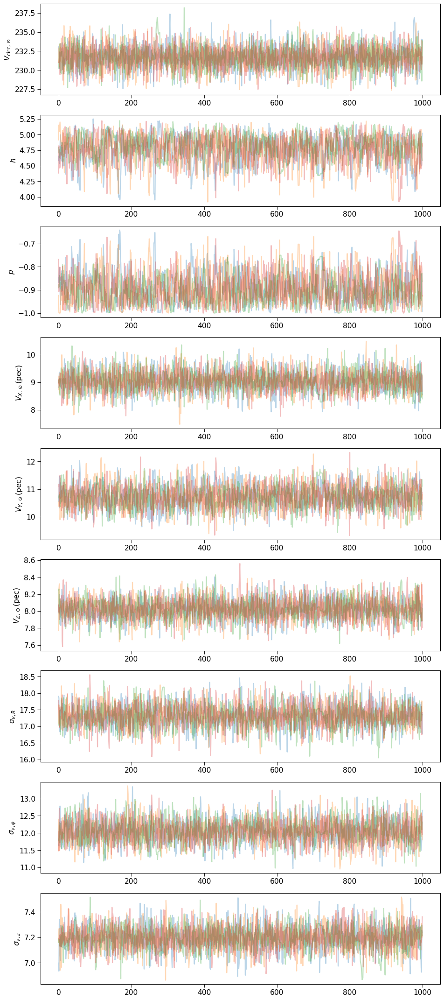

In [24]:
useagab(usetex=False, fontfam='sans-serif', fontsize=14, ncolors=10)

fig, axes = plt.subplots(ncols=1, nrows=stan_model['npars'], tight_layout=True, figsize=(12,3*stan_model['npars']))

for i, lab in zip(range(stan_model['npars']), stan_model['labels']):
    axes[i].plot(oba_fit.draws()[:,:,7+i], alpha=0.3)
    axes[i].set_ylabel(lab)

plt.show()

## Make a corner plot of the posterior samples

Vcirc_sun = 231.7+1.5-1.5
hbp = 4.8+0.2-0.3
pbp = -0.9+0.1-0.1
Vsun_pec_x = 9.0+0.4-0.4
Vsun_pec_y = 10.7+0.4-0.4
Vsun_pec_z = 8.0+0.1-0.1
vdispR = 17.3+0.4-0.3
vdispPhi = 12.0+0.4-0.3
vdispZ = 7.2+0.1-0.1


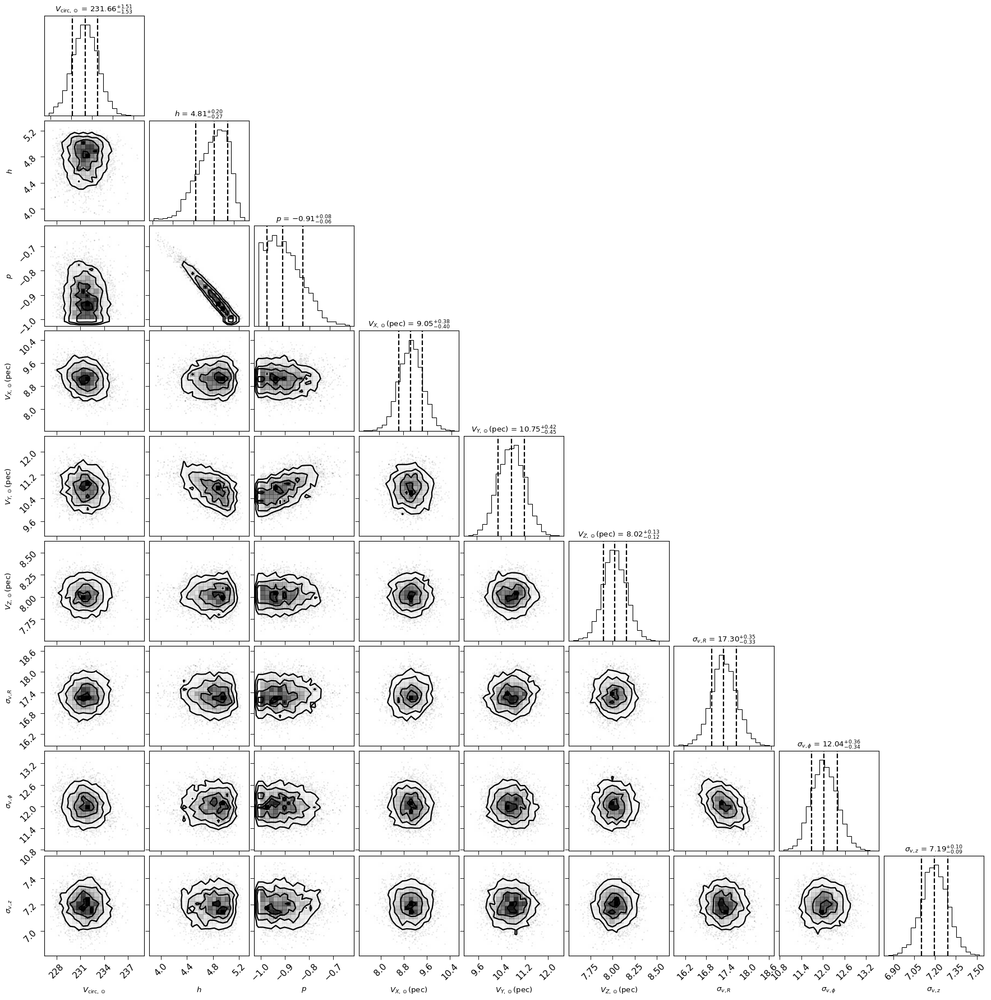

In [22]:
for par in stan_model['parnames']:
    vals = oba_fit.stan_variable(par)
    stan_model['best_params'][par] = np.median(vals)
    q1, q2, q3 = scap(vals, [16, 50, 84])
    print(f"{par} = {q2:.1f}+{q3-q2:.1f}-{q2-q1:.1f}")
    
sample_lists = []
for i, par in zip(range(7, 7+stan_model['npars']), stan_model['parnames']):
    sample_lists.append(oba_fit.draws()[:,:,i].flatten())
samples = np.vstack(sample_lists).transpose()
                         
useagab(usetex=False, fontfam='sans-serif', fontsize=14, ncolors=10)

figcorner = plt.figure(figsize=(2.5*stan_model['npars'],2.5*stan_model['npars']))
corner.corner(
    samples, labels=stan_model['labels'], 
    label_kwargs={"fontsize":12}, title_kwargs={"fontsize": 12},
    truth_color='r', quantiles=[0.16,0.50,0.84], show_titles=True, fig=figcorner
)
plt.show()

## Sgr A* proper motion (assuming no intrinsic motion for this source) and Oort constants

In [23]:
sunpos = np.array([-Rsun.value, 0, zsun.value])*u.kpc
vsunpeculiar = np.array([stan_model['best_params']['Vsun_pec_x'], stan_model['best_params']['Vsun_pec_y'], stan_model['best_params']['Vsun_pec_z']])*u.km/u.s
vcircsun = stan_model['best_params']['Vcirc_sun']
hbp = stan_model['best_params']['hbp']
pbp = stan_model['best_params']['pbp']

diskmodel_best = DiskKinematicModel(BrunettiPfennigerRotationCurve(vcircsun, Rsun.value, hbp, pbp), sunpos, vsunpeculiar)

In [24]:
vsunx_samples = oba_fit.draws()[:,:,9].flatten()
vsuny_samples = oba_fit.draws()[:,:,10].flatten()+oba_fit.draws()[:,:,7].flatten()
vsunz_samples = oba_fit.draws()[:,:,11].flatten()
vsunvec_samples = np.vstack([vsunx_samples, vsuny_samples, vsunz_samples])

vcircsun_samples = oba_fit.draws()[:,:,7].flatten()
h_samples = oba_fit.draws()[:,:,8].flatten()
p_samples = oba_fit.draws()[:,:,9].flatten()
#vsun_circ_samples = v0_samples*Rsun.value/h_samples*(1+(Rsun.value/h_samples)**2)**((p_samples-2)/4)

ra_sgr = (17.0+45.0/60.0+40.0409/3600.0)*15
dec_sgr = -29 - 28.118/2300
l_sgr, b_sgr = ct.transform_sky_coordinates(np.deg2rad(ra_sgr), np.deg2rad(dec_sgr))
print(np.rad2deg(l_sgr)-360, np.rad2deg(b_sgr))

p_sgr = np.array([-np.sin(l_sgr), np.cos(l_sgr), 0.0])
q_sgr = np.array([-np.sin(b_sgr)*np.cos(l_sgr), -np.sin(b_sgr)*np.sin(l_sgr), np.cos(b_sgr)])

mu_sgr_xy_samples = -np.dot(p_sgr, vsunvec_samples)/(Rsun*au_km_year_per_sec).value
mu_sgr_z_samples = -np.dot(q_sgr, vsunvec_samples)/(Rsun*au_km_year_per_sec).value
mu_sgr_xy = np.median(mu_sgr_xy_samples)
mu_sgr_xy_rse = rse(mu_sgr_xy_samples)
mu_sgr_z = np.median(mu_sgr_z_samples)
mu_sgr_z_rse = rse(mu_sgr_z_samples)

print(f"mu_sgr_xy = {mu_sgr_xy:.2f}  +/- {mu_sgr_xy_rse:.3f}")
print(f"mu_sgr_z = {mu_sgr_z:.2f}  +/- {mu_sgr_z_rse:.3f}")

oortA_samples, oortB_samples = BrunettiPfennigerRotationCurve.oort_ab_static(Rsun.value, vcircsun_samples, h_samples, p_samples)
oortAminB_samples = oortA_samples - oortB_samples
oortA = np.median(oortA_samples)
oortA_rse = rse(oortA_samples)
oortB = np.median(oortB_samples)
oortB_rse = rse(oortB_samples)
oortAminB = np.median(oortAminB_samples)
oortAminB_rse = rse(oortAminB_samples)

print(f"Oort A = {oortA:.2f}  +/- {oortA_rse:.3f}")
print(f"Oort B = {oortB:.2f}  +/- {oortB_rse:.3f}")
print(f"Oort A-B = {oortAminB:.2f}  +/- {oortAminB_rse:.3f}")

-0.05951722261414716 -0.04846468783278978
mu_sgr_xy = -6.13  +/- 0.038
mu_sgr_z = -0.27  +/- 0.011
Oort A = 15.41  +/- 0.180
Oort B = -12.57  +/- 0.125
Oort A-B = 27.99  +/- 0.183


## Model check through predictive posterior

In [25]:
idata = az.from_cmdstanpy(
    posterior=oba_fit,
    posterior_predictive=['pred_pml', 'pred_pmb'],
    observed_data={'pml_obs': oba_data['pml_obs'],
                   'pmb_obs': oba_data['pmb_obs']},
    coords={'nsources': np.arange(oba_data['N'])},
    dims={
        'pml_obs': ['nsources'],
        'pmb_obs': ['nsources'],
        'pred_pml': ['nsources'],
        'pred_pmb': ['nsources'],
    },
)

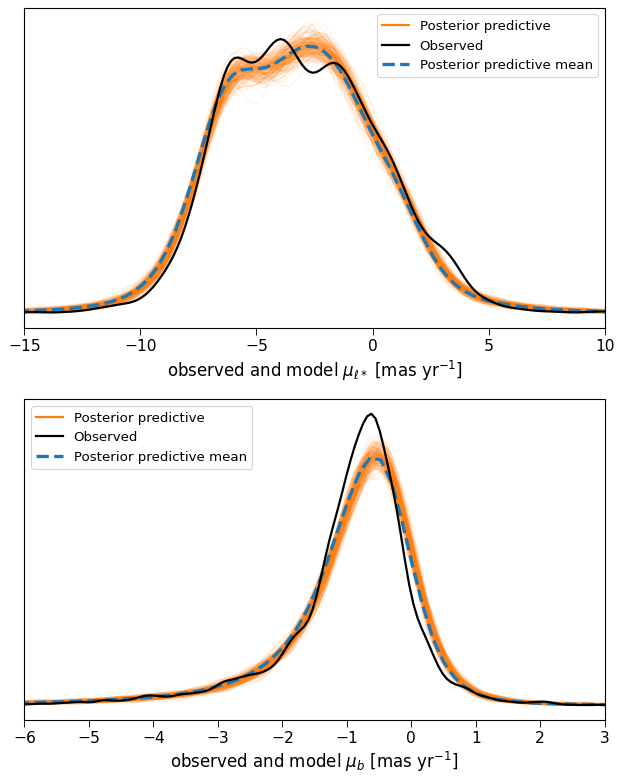

In [26]:
fig, axes = plt.subplots(2, 1, figsize=(8, 2*5), tight_layout=True)
az.plot_ppc(idata, ax=axes, data_pairs={'pml_obs':'pred_pml', 'pmb_obs':'pred_pmb'}, 
            num_pp_samples=200, alpha=0.1, colors=['C1', 'k', 'C0'])
for ax in axes:
    ax.legend(fontsize=12)
    #apply_tufte(ax)
axes[0].set_xlim(-15,10)
axes[1].set_xlim(-6,3)
axes[0].set_xlabel(r'observed and model $\mu_{\ell*}$ [mas yr$^{-1}$]')
axes[1].set_xlabel(r'observed and model $\mu_b$ [mas yr$^{-1}$]')

plt.savefig('bstars_pms_posterior_predictive.png')

plt.show()

[227.16862612 214.65838113 204.4649971  ... 236.352211   238.40810693
 233.14977442] km / s


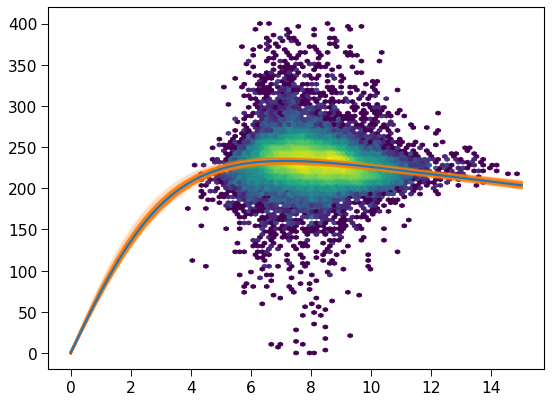

In [27]:
icrs_coords = ICRS(
    ra=(obatable['ra'][hasrvs].data * u.deg).to(u.rad),
    dec=(obatable['dec'][hasrvs].data * u.deg).to(u.rad),
    distance=(1000 / obatable['parallax'][hasrvs].data) * u.pc,
    pm_ra_cosdec=obatable['pmra'][hasrvs].data * u.mas / u.yr,
    pm_dec=obatable['pmdec'][hasrvs].data * u.mas / u.yr,
    radial_velocity=obatable['radial_velocity'][hasrvs].data * u.km / u.s,
)

_, _, gc_cyl = transform_to_galactic(
    icrs_coords,
    galcendist=Rsun,
    sunheight=zsun,
    vcircsun=vcircsun*u.km/u.s,
    vsunpec=vsunpeculiar,
)

rotcur = lambda x, h, p : x/h * np.power(1+(x/h)**2, (p-2)/4)

fig, axvphi = plt.subplots(1, 1, figsize=(8,6))

vphi_from_fit = -(gc_cyl.d_phi.to(u.rad / u.yr) / u.rad * gc_cyl.rho).to(u.km / u.s)
print(vphi_from_fit)

axvphi.hexbin(gc_cyl.rho.to(u.kpc), vphi_from_fit, mincnt=1, bins='log', extent=[0,15,0,400])

rcyl = np.linspace(0,15,1000)

inds = np.random.choice(p_samples.size, size=200, replace=False)
for i in inds:
    v0 = vcircsun_samples[i]/rotcur(Rsun.value, h_samples[i], p_samples[i])
    axvphi.plot(rcyl, v0*rotcur(rcyl, h_samples[i], p_samples[i]), c='C1', alpha=0.1)

v0 = vcircsun/rotcur(Rsun.value, hbp, pbp)
axvphi.plot(rcyl, v0*rotcur(rcyl, hbp, pbp), c='C0', lw=2)

plt.show()

## Compare model predictions and observations in the proper motion vs longitude plots

Show both a model prediction for stars at a fixed distance from the sun and simulated proper motion data, using the simulated data ('generated quantities') from the STAN model.

2242.2419566192184 pc


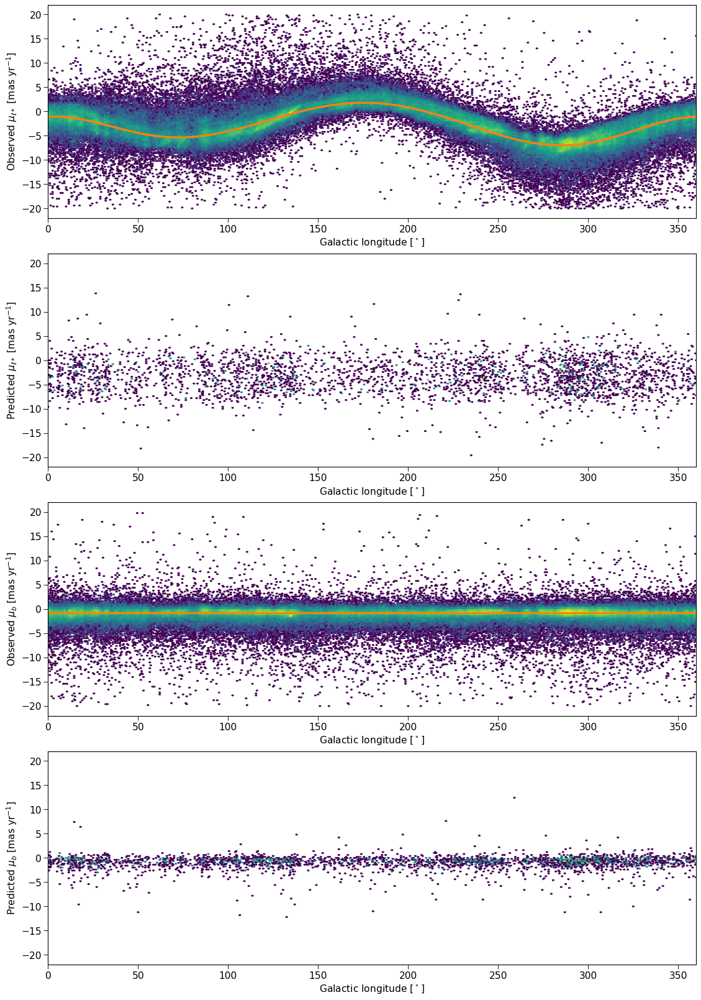

In [28]:
galon = np.linspace(0,360,361)*u.deg

median_dist = 1000/np.median(obatable['parallax'][sample_filter])
print(median_dist, 'pc')

#pml_model, pmb_model, vrad_model = diskmodel_flat.observables(1000.0/obatable['parallax'][sample_filter].value*u.pc, 
#                                                              obatable['l'][sample_filter]*u.deg, obatable['b'][sample_filter]*u.deg)

chain = np.random.choice(nchains)
mcsample = np.random.choice(nsampling)

fig=plt.figure(constrained_layout=True, figsize=(14,4*5))

gs = GridSpec(4, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], obatable['pml'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'Observed $\mu_{\ell*}$ [mas yr$^{-1}$]')
ax_lmul.set_xlim(0,360)

ax_lmul_model = fig.add_subplot(gs[1,0])
#im_lmul_model = ax_lmul_model.hexbin(obatable['l'][sample_filter], pml_model, 
#                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
im_lmul_model = ax_lmul_model.hexbin(oba_subsample['l'], idata.posterior_predictive['pred_pml'][chain, mcsample, :], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmul_model.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul_model.set_ylabel(r'Predicted $\mu_{\ell*}$ [mas yr$^{-1}$]')
ax_lmul_model.set_xlim(0,360)

ax_lmub = fig.add_subplot(gs[2,0])
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], obatable['pmb'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'Observed $\mu_b$ [mas yr$^{-1}$]')
ax_lmub.set_xlim(0,360)

ax_lmub_model = fig.add_subplot(gs[3,0])
#im_lmub_model = ax_lmub_model.hexbin(obatable['l'][sample_filter], pmb_model, 
#                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
im_lmub_model = ax_lmub_model.hexbin(oba_subsample['l'], idata.posterior_predictive['pred_pmb'][chain, mcsample, :], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmub_model.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub_model.set_ylabel(r'Predicted $\mu_b$ [mas yr$^{-1}$]')
ax_lmub_model.set_xlim(0,360)

for dist in [median_dist]:
    distance = np.zeros_like(galon.value) + dist*u.pc
    galat = np.zeros_like(galon.value) - np.rad2deg(np.arcsin(zsun.value/dist))*u.deg
    pml_model, pmb_model, vrad_model = diskmodel_best.observables(distance, galon, galat)
    ax_lmul.plot(galon, pml_model, c='C1', lw=3, label=rf'$d={dist:.0f}$ pc')
#     ax_lmul.plot(galon, vrad_model, c='C1', lw=3, label=rf'$d={dist:.0f}$ pc')
    ax_lmub.plot(galon, pmb_model, c='C1', lw=3)
#     ax_lmub.plot(galon, vrad_model, c='C1', lw=3)

plt.show()

## Overplot model predictions for specific distances on observed proper motions

2242.2419566192184


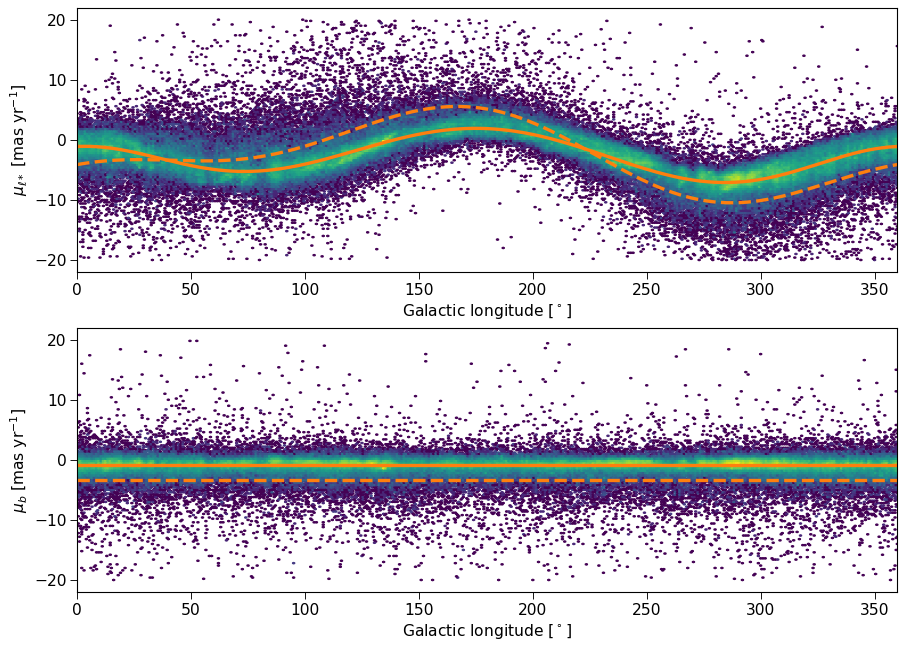

In [29]:
fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))

gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], obatable['pml'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'$\mu_{\ell*}$ [mas yr$^{-1}$]')
ax_lmul.set_xlim(0,360)

ax_lmub = fig.add_subplot(gs[1,0])
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], obatable['pmb'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'$\mu_b$ [mas yr$^{-1}$]')
ax_lmub.set_xlim(0,360)

print(median_dist)
for dist, lstyle in zip([500, 2000], ['--C1', '-C1']):
    distance = np.zeros_like(galon.value) + dist*u.pc
    galat = np.zeros_like(galon.value) - np.rad2deg(np.arcsin(zsun.value/dist))*u.deg
    pml_model, pmb_model, vrad_model = diskmodel_best.observables(distance, galon, galat)
    ax_lmul.plot(galon, pml_model, lstyle, lw=3, label=rf'$d={dist:.0f}$ pc')
    ax_lmub.plot(galon, pmb_model, lstyle, lw=3)

plt.savefig('bstar-pml-pmb-vs-galon-plusmodel.png')

plt.show()

## Calculating difference in proper motion

In [80]:
A = 4.74047  # km s^-1 yr

prop_mot_lon = np.array(obatable['pml'][sample_filter].tolist())
prop_mot_lat = np.array(obatable['pmb'][sample_filter].tolist())
plx = np.array(obatable['parallax'][sample_filter].tolist())
galon = np.array(obatable['l'][sample_filter].tolist())
galat = np.array(obatable['b'][sample_filter].tolist())

# 𝐱=(1000/𝜛)𝐫+𝐱⊙
rvec = np.array([np.cos(galat)*np.cos(galon), np.cos(galat)*np.sin(galon), np.sin(galat)]).T
print(rvec[1])

# pml_model = np.zeros_like(prop_mot_lon)
# pmb_model = np.zeros_like(prop_mot_lat)
# vrad_model = np.zeros_like(prop_mot_lon)
pml_diff = np.zeros_like(prop_mot_lon)
pmb_diff = np.zeros_like(prop_mot_lat)
distances = np.zeros_like(plx)

# for n in range(len(prop_mot_lon)):
#     # Distance is between sun and star
#     rel_vec = (1000/plx[n])*rvec[n].T   # Multiplication met r gebeurt ook in de observables() function.
# #     print(rel_vec)
# #     xxx
#     distances[n] = np.sqrt(rel_vec[0]*rel_vec[0] + rel_vec[1]*rel_vec[1] + rel_vec[2]*rel_vec[2])#*u.pc
    
pml_model, pmb_model, vrad_model = diskmodel_best.observables(1000/plx*u.pc, galon, galat)
print(prop_mot_lon[1])
print(pml_model[1])
pml_diff = prop_mot_lon - pml_model.value
pmb_diff = prop_mot_lat - pmb_model.value

# for n in range(len(prop_mot_lon)):
#     # Kan wsl ook als matrix notatie:
# #     pml_model[n], pmb_model[n], vrad_model[n] = diskmodel_best.observables(distance_n, galon[n], galat[n]) # Werkt wsl niet voor enkele sterren
#     pml_diff[n] = prop_mot_lon[n] - pml_model[n]
#     pmb_diff[n] = prop_mot_lat[n] - pmb_model[n]

[ 0.94855819 -0.11421017  0.29528529]
[577.40077868  50.30584587 -70.08568326]
[783.5523768  -94.34281945 243.91913431]
[ 501.00225817 -166.57046387  250.60492428]
[ 823.64786548 -332.89406753 -331.00085796]
[ 477.59906947  -11.4594888  -201.40656664]
[ 730.92667904  260.73002503 -911.11343764]
[ 392.83199766  152.43989522 -732.64091707]
[  67.82100415  -11.41437775 -289.69392607]
[ 703.35172377 -533.40747343   46.04707105]
[ 639.58951707 -560.28922325  178.98998025]
[ 311.49609228 -330.76535976   30.22121486]
[ 611.20252655 -462.53518901 -558.28923416]
[  640.00816726 -1114.94845843  -254.24928407]
[ 940.32428938 -454.76216527 -730.90879775]
[ 264.61028583 -262.07411985 -373.6796453 ]
[  36.71709921  -34.13679582 -127.89721013]
[  -55.09498487    27.21939358 -1401.13395843]
[  51.31752089    9.9376275  -387.10136495]
[ -366.08739673    77.68669327 -1069.27047514]
[ -519.44611129    92.99950303 -1133.16011107]
[  26.66016718   -6.66780926 -919.9688805 ]
[  124.10011285  -388.88217172 -

[-1118.0404956   2314.65478099  1551.77365864]
[-1507.15480164  1955.40334455  1401.07121618]
[-1197.10247023  1787.68743685  1560.16588512]
[-702.8781902  1162.68466108  782.9894253 ]
[-1013.15477979  1917.19082096  1381.49484527]
[-1035.76133365  1951.45016537  1527.78918049]
[-1239.00550252  1951.81265319  1665.77354904]
[-923.75761957 1730.87973333 1920.76219892]
[-958.18991938 2704.93486221 1716.35037022]
[-899.47364781 2729.84364456 1824.16785615]
[-833.19705507 2811.97533134 1906.33703666]
[-783.23078146 2725.83945573 1926.03706013]
[-1036.82530593  3378.99320271  2378.75983706]
[-897.01599526 2381.89679824 1661.47158307]
[-547.34844    2421.62224586 1636.71261793]
[-628.79432792 2305.65422163 1765.73327134]
[-602.76418962 2489.3506908  1802.49225228]
[-163.48450697  827.06991543  568.67176378]
[-488.51279767 2319.50402216 1650.65529321]
[-450.54736368 2986.43194287 2213.65181673]
[-556.72955957 2549.44001739 2022.74677474]
[-608.23546529 2286.05703804 2031.05189889]
[-388.81236

[    7.54435334   108.58796394 -3619.5649373 ]
[ 5.32465457e-01  6.79029736e+00 -6.42096761e+02]
[-6.59773667e-02 -7.16426059e-01 -2.85507013e+03]
[   -3.76118685   -36.94764246 -3588.3442584 ]
[   -6.15556636  -162.84533615 -3992.88936718]
[   -7.64724984  -124.18119418 -2636.28197166]
[  -12.34712165  -155.03626669 -2467.61476125]
[  -11.29274789  -277.41394002 -4199.89166919]
[  -15.28962159  -268.09854725 -4075.23292373]
[  -33.03882644  -302.53108594 -4166.79562374]
[   23.82576616   194.08953271 -2603.39928084]
[    8.05084958    52.13539293 -2680.08163891]
[    9.46752847    51.16552286 -1222.07366214]
[  -21.95337046  -129.99091632 -2633.2957491 ]
[  -37.22008919  -203.06349611 -3223.11538404]
[  -59.20637068  -306.34406157 -2874.35997234]
[  -49.24494245  -553.92688083 -2506.35447699]
[  -97.5236422   -599.27317849 -3447.72739664]
[  -90.57970783  -582.45111915 -2990.14822046]
[  -45.01248912  -395.56830042 -1582.32666199]
[ -110.41347465  -742.91916666 -2114.45533311]
[  -67.

[-1215.84573917 -2824.06854797 -3098.22749791]
[  872.91998826   571.86387107 -1604.88148689]
[ 234.1074972    60.6001167  -944.63039043]
[  601.31226969    85.99891726 -1929.70557521]
[  140.73426133    34.68100983 -1029.61649679]
[  159.3397308   -987.50902785 -1165.14936787]
[  227.91787102 -2361.14512473 -1081.16893598]
[  226.97049392 -2828.89557422 -1432.67613228]
[   79.56529827 -2332.61178352 -1368.11390722]
[   21.22105261 -1100.93079759  -640.66916445]
[   49.24905759 -2528.09359448 -1904.03546197]
[   46.70072949 -1209.79962047 -1215.83106304]
[  -52.74114472 -2178.95629708 -1709.72487669]
[  157.78537431 -1007.98809017 -1840.92167638]
[    6.05588875 -1144.20088044 -2150.673205  ]
[  222.13181565 -1214.21044932 -3050.63280147]
[   80.85364279  -485.61304355 -1453.72631959]
[   27.8635362   -666.41770139 -2484.04683748]
[ -207.18715571 -1196.45709905 -1774.46599647]
[  -53.248245    -485.45096827 -1095.83096694]
[ -232.47035448 -1106.78811328 -2677.21287231]
[ 105.05145218 -

[  990.53781244 -3536.3066841   1134.0192753 ]
[ 1040.21328998 -3588.51721572  1361.0539501 ]
[ 1228.51895598 -3797.70939152  1412.99402966]
[  645.30622739 -2443.19606184   972.64557129]
[  995.48845677 -3770.29548262  1664.38697483]
[ 1262.04170969 -3203.15937872  1119.50055537]
[ 2296.270677   -6085.62579285  2419.82700191]
[ 1208.57440408 -3443.61273963  1519.33872046]
[  865.7723621  -2372.64567105  1060.1613246 ]
[  717.70943892 -2545.65254563  1279.64435311]
[ 1219.60207642 -3592.33495848  1698.21421569]
[ 1007.30652568 -4394.14988879  1754.44295584]
[ 1390.81120972 -5381.28018169  2293.13004968]
[  520.73953564 -2554.85179707  1246.72119447]
[ 1042.85568747 -3833.47055161  2246.31690223]
[  313.01856433 -1727.76420744   964.62444941]
[  468.87022879 -2622.11289795  1722.90649143]
[  450.74063499 -2655.99733872  1895.58725153]
[ 1227.14855492 -2916.76747653  1465.56362081]
[ 1403.06925097 -3674.51921564  1959.34012289]
[ 1612.21057629 -4239.68626504  2509.00458139]
[  677.773547

[ 1926.72534884 -1485.44897284   -94.31342066]
[ 1779.01597389 -1303.33376628  -368.24992696]
[ 1117.66903372 -1146.71058485   -54.53658027]
[ 1998.89367242 -1736.7125283   -936.22903778]
[ 276.55833752 -234.91415518  -94.32178897]
[ 1029.60762953 -1174.38763129  -681.87867405]
[  814.0347222  -1257.34201716  -735.26320433]
[ 1431.4681882  -2330.92805272 -1230.45981137]
[ -892.09484015 -2847.42045223 -1939.4635742 ]
[ -499.82410421 -2026.9296211  -1953.42533507]
[ -170.5445887  -1517.55883484 -1769.56029303]
[-100.46221382 -572.20523066 -900.54251319]
[  -92.18531695  -604.1402991  -1553.24942762]
[ -235.65854502  -902.65048958 -1735.23023051]
[  548.89105244 -1083.10256077 -2752.22618388]
[  353.31693294  -745.66894768 -2233.24338937]
[  151.89730386  -344.1576009  -1974.35530229]
[  57.86618633 -149.56553927 -845.30782719]
[   33.56291002   -86.84423498 -1385.42423554]
[ 1.46456964e+00 -4.76629603e+00 -1.50845743e+03]
[  47.23443118 -188.2287128  -916.84607854]
[  123.98968601  -632.

[  -13.65036943   -27.4005977  -1345.81555961]
[    5.97359118    12.19830828 -3289.39103985]
[ -175.51305639  -377.52668987 -4266.85263615]
[  -74.0070836   -190.14467231 -2327.74236594]
[  -39.68844804   -88.29747357 -2767.23720727]
[    4.0986927      9.1669548  -2148.13730393]
[  -27.73640385   -71.38886696 -2223.45014349]
[  110.45632018   193.46619671 -2242.81234355]
[   65.99625179   115.29769424 -1355.0449788 ]
[  116.19615713   211.04029954 -2452.11728808]
[   70.91326186   151.97741699 -2333.58515604]
[   91.6693903    184.29642066 -1401.92005899]
[  260.90519423   548.25161755 -4246.05972577]
[   30.37249624    67.73444587 -2583.89348786]
[   41.07956986    98.20405501 -1778.0470985 ]
[    9.04426198    23.37328786 -2074.0331339 ]
[ 1.65818837e+00  4.62699811e+00 -2.78253065e+03]
[   18.1369226     51.34186779 -3516.15407547]
[   10.88160821    31.53655736 -1553.40921945]
[   26.44964998    77.82905624 -3648.32497982]
[  147.66469749   336.96575273 -3000.26556064]
[  -51.791

[-627.98130623 -356.30898912 1395.62242372]
[-788.72010891 -449.91722796 2258.59765718]
[-405.57845213 -312.91157192 1707.38231321]
[-547.51293954 -376.66059111 1752.55967161]
[-548.72192727 -387.10594611 3678.07041093]
[-703.12193411 -459.45320362 3294.01421034]
[-864.8304949  -507.22572521 4084.09187705]
[-681.7784641  -408.63477228 3643.74443743]
[-1048.69651045  -540.59590787  4543.03446159]
[-850.24221741 -388.31278036 2871.5083296 ]
[ -65.57043339   92.83653527 -422.15640145]
[   1.08329592  -51.03062401 -702.65635448]
[ -18.26655011  222.38988062 -382.33865527]
[-3.69366005e+02  5.77510559e+02  3.59712509e-01]
[-111.11879294  143.29457105   75.53439532]
[-326.26469076   95.17383926  219.48384799]
[  -76.94021566  -675.53718588 -2901.81658788]
[ -733.65477073 -1918.54315609 -2415.13307114]
[ -714.27975833 -1718.0846661  -2871.05033828]
[ -504.2727903  -1035.68409922 -1446.628505  ]
[ 241.97040305 -115.94360837 1297.92070784]
[ 81.59500604 -42.78941053 950.70753294]
[ 107.31598179

[  463.70207508   224.24512414 -1157.85968037]
[  647.68117533   338.29559419 -1481.79511518]
[  857.05713955   465.5019539  -2135.33032241]
[ 365.03780459  203.36149947 -905.12223678]
[  882.04572351   541.07831521 -1983.09570293]
[  765.0129594    486.84460432 -1874.18502321]
[  291.54406996    86.89615665 -1787.60805505]
[ 2938.14237517  1177.66612043 -1178.83401325]
[  510.74725686  -128.33725656 -2435.9646636 ]
[  594.32971962  -159.37803235 -2948.39376026]
[  490.66413302  -129.82303771 -2663.77034201]
[  612.42258293  -173.75618281 -3261.16487737]
[  519.51688196   -53.199645   -2394.7226503 ]
[  353.2034413    -76.62531867 -1442.59421218]
[  421.62629262  -100.51734253 -1633.14045926]
[  882.93753344  -140.97441706 -3879.99952063]
[  495.38708066   -27.91802585 -3717.29137511]
[  180.19143767    -5.00285983 -1193.33547914]
[  359.59641568   -35.94249281 -2477.71277532]
[  170.89840216    -5.13526884 -2100.44063772]
[  523.79597209   -98.01004236 -2723.39672088]
[  411.52795778 

[-1185.80611619  -145.40954944 -1686.18448328]
[-1307.49611029  -106.49075308 -1502.40040341]
[-2057.54218799  -150.53790696 -3061.20818349]
[-1860.16720089   -62.13842842 -3142.30060836]
[-1069.98914283   -43.17190948 -1566.1680116 ]
[-1054.64555432   -14.28889342 -1575.25500351]
[-1046.23748336   -12.75931987 -1542.47172362]
[-1136.45580629    23.03448342 -1468.99980315]
[-2509.48516986   -42.65950832 -2956.35058194]
[-1003.30252135  -183.71534921 -1133.42771798]
[-2561.82841456  -448.49409145 -2606.18829741]
[-2168.27502341  -212.13730354 -2338.19403055]
[-1263.4459423    -95.84490479  -930.19168955]
[-1929.38941927   -55.24986709 -1617.82381091]
[-3.58395502e+03 -2.32758038e+00 -2.94024177e+03]
[-1.63943519e+03  5.98915577e-01 -1.26332520e+03]
[-2659.21291816    41.3116171  -2097.06743286]
[ -961.30439036     2.92273061 -1561.45500432]
[-2071.74902861   100.90095981 -3358.35868741]
[-1694.4169716     94.13395256 -2703.06163837]
[-1074.07560775    15.8237113  -1618.26955205]
[-1949.

[-387.16502731  348.25635444 -519.23253582]
[ -862.78688331   980.91778454 -1378.61058455]
[-1045.96034867   978.26396969 -2662.77317735]
[ -780.4098859    867.06050249 -2780.78652955]
[-223.12860389  258.74468499 -942.30745164]
[ -812.52013571  1211.03419224 -1566.52678479]
[ -930.09442419  1392.29977789 -2354.31924276]
[-1292.4053455   1891.17225362 -3361.88837653]
[ -654.52783498  1041.49229031 -1933.88102445]
[ -690.38856565  1274.1173267  -1496.82648654]
[ -765.35227639  1328.43936365 -1892.70661133]
[ -74.34631411  148.29611661 -225.73876176]
[ -504.69814974   847.08312367 -1496.47631091]
[ -845.44180191  3038.28181263 -3394.85874508]
[ -575.3859864   2169.43230335 -2042.56290296]
[ -785.44059362  2484.50321111 -2593.23983802]
[ -637.95616001  1577.03096244 -2724.23942728]
[ -379.51973663  1028.74343094 -1465.32690808]
[ -320.17445676   835.16972791 -1175.73304668]
[ -641.97400428  1425.56300125 -2569.37804333]
[ -458.53132077  1373.6391061  -1640.93834232]
[-273.08366078  709.94

[ -169.8100003    196.33386042 -1047.82592525]
[  -83.43514984    81.88357804 -2537.31983676]
[  174.90863427  -195.1234438  -1568.56543409]
[ -155.01562378   199.87997377 -1087.21972336]
[ -286.32616152   427.50412762 -3380.28647301]
[  -68.30166062    86.55445872 -1321.85034365]
[ -162.84015182   300.79227928 -1886.63729404]
[   27.39944229   -47.30659805 -1115.03911263]
[  132.03584986  -199.92568028 -1011.35309629]
[  264.50302285  -243.30475285 -1806.6968582 ]
[  703.73569038  -691.56540281 -2514.97705899]
[ 353.90371931 -340.98449445 -929.45687731]
[  633.22787228  -718.20222313 -1641.49787494]
[ 238.29133022 -314.48607979 -771.04629939]
[  609.44124157 -1092.36564481 -2805.25725085]
[  941.82734316 -1408.25510948 -3664.46560381]
[  912.38935349 -1466.20266766 -2925.90460397]
[  692.47153796 -1202.49792883 -2478.4241699 ]
[ 1151.57356834 -1427.36831959 -2167.4559882 ]
[  871.2382302  -1405.90892973 -2653.10405029]
[  981.50791592 -1571.34977764 -2764.36390647]
[  728.11603122 -11

[-3479.52656428  1094.60529538  -333.32248655]
[-2089.06524932   522.47030594   -94.27961898]
[-2.02884222e+03  5.40129934e+02 -1.56179257e+00]
[-2.39600116e+03  6.65141339e+02  1.34813587e+00]
[-1564.97913312   483.91509202   -64.94563426]
[-839.86559337  254.55238924  -27.18693039]
[-2933.96509153   985.7162471      4.5317281 ]
[-2689.5687304    895.14286512    93.4803344 ]
[-2372.44419093   840.30528431  -341.28645155]
[-1461.11173162   548.16707365  -214.39026183]
[-2100.02554673   747.81118841  -183.57002154]
[-1123.30479362   544.48069589  -129.24976435]
[-2674.77435526  1239.73592169  -248.4039867 ]
[-5274.71770858  2247.31281618   -68.4274996 ]
[-3070.41886645  1202.3966686     78.58208241]
[-2555.92567648  1071.78227748    79.25219693]
[-2188.45199407  1129.50645143    -3.88167861]
[-1837.46835861   969.81718327   104.66267849]
[-2599.61513693  1386.48594675   203.57255157]
[-2001.69740589   652.20196818   199.5143869 ]
[-2067.03856037   830.74758795   254.21529653]
[-2063.800

[-1393.38550779  -356.25827021   228.1148485 ]
[-1420.52535492  -292.23946405   330.97273931]
[-1388.69606334  -334.72916968   295.92811539]
[-1467.73906169  -457.07784956   129.71147553]
[-2306.45379522  -640.24307303   332.6346966 ]
[-647.86290642 -240.97560222  178.19025422]
[-1174.0587378   -488.34852849   317.79166892]
[-1442.74039775 -1303.24015451  -440.35995263]
[-884.53220037 -795.30096161 -171.6800514 ]
[-1069.8142963  -1249.59038669  -678.85374822]
[-640.33404023 -769.05945305 -381.09489314]
[ -969.52674458 -1231.33843031  -501.51940552]
[-407.71481969 -534.6662492  -208.77573914]
[-1071.42235282 -1643.33948413  -415.15922143]
[2096.86593118  798.76512484 1086.60182089]
[805.09246001 987.34166039 438.92443861]
[816.15510173 742.86479267  48.23531891]
[ 763.77642111  689.18505415 1074.48691279]
[1576.2874182  1274.240722   1775.78054096]
[549.18137161 432.20059453 311.73528977]
[2341.90899038 1351.25962793 2000.49536815]
[808.35214092 452.69173907 659.76971762]
[  97.71778687

[-1374.79608305   361.63449984  2920.14644535]
[-1389.86501306   370.11172299  3029.17703816]
[-897.47032395  240.11743501 1562.26746149]
[-791.53234293  215.20165381 1403.44851363]
[-1185.70849061   392.90674532  2148.82264592]
[-1515.91752191   553.33614447  3018.14349362]
[-1124.1419197    344.09482154  2534.58486122]
[-1640.78431613   497.7079825   4158.04684316]
[-1551.21869833   463.61328523  4402.85910368]
[-584.50008663  125.69800102 2146.80172754]
[-697.2833039  154.2537472 2629.0712727]
[-439.57883219  114.78429328 1934.23358528]
[-444.07901514  123.82474051 1884.65426334]
[-919.65736475  293.85952917 2687.01713388]
[-602.02603782  209.47594599 2484.83507616]
[-332.04633639  128.60890798 1973.81163748]
[-699.47179107  330.25022803 3508.05540482]
[-323.13185071  147.39032644 2091.96166511]
[-958.33025682  443.68129264 1855.92959736]
[-1263.88829217   649.6389505   2701.39995042]
[-983.64273904  487.8666375  2109.86247878]
[-1241.91581661   662.62726786  2836.4130146 ]
[-1307.4

[ -11.32007281 -148.99922206 1821.20922339]
[ -10.92759403 -122.67907007 2146.25051675]
[ -23.69416326 -218.94113246 1707.26937218]
[5.80072437e-01 3.55894933e+00 2.08512576e+03]
[  -7.51621111  -46.54642452 1808.64010141]
[ -18.76835323  -86.35165094 1715.90530893]
[-242.17224305 -956.29760633  447.12592662]
[ -72.82920962 -176.61451983   84.86746569]
[-20.42663192 -93.7899836  575.06631421]
[3219.01970761  855.33330609 -816.20882114]
[2382.01154694  882.03151064 -819.13422245]
[ 2879.01713638   235.80846733 -1407.10491975]
[ 642.35222606  116.56255048 -406.9824411 ]
[ 4098.72946304   534.32247564 -2742.09143021]
[ 2502.2706429    536.52871282 -2461.69879209]
[ 3353.33746629   469.67716431 -3171.31101618]
[ 3889.43690415   499.09963723 -4603.92665577]
[ 2921.64363718   227.47485693 -3127.58106876]
[ 2271.9063392    182.28393219 -2656.35067875]
[ 645.44145181   43.3927147  -359.67344583]
[ 746.90624906    7.79919587 -440.7649735 ]
[ 882.0726432   -65.48455587 -585.56253328]
[ -119.8426

[1894.1074807  -381.61819581 2691.42308467]
[1269.68841018 -364.99173893 1713.48911923]
[ 833.46621754 -202.12492887  972.66642039]
[1469.64211597 -376.69365718 1948.2479677 ]
[1108.27341101 -241.24719738 1082.48165446]
[ 843.5401135  -328.59122655 1571.09641892]
[ 623.11258788 -318.90661341 1284.36660904]
[ 497.77755347 -210.59046704  771.24695291]
[1706.73690554 -743.64644118 2230.97260351]
[1505.25670899 -591.94913568 1726.94088659]
[1854.37919539 -673.6336403  1660.20912356]
[ 2276.76246516 -1157.26964815  1954.1657075 ]
[3004.25623    -462.51309209 1450.09446958]
[-328.16243703  416.11776684 1741.43501132]
[-334.00861206  462.81643931 1242.37024134]
[-236.26678065  287.12983545 1349.41763249]
[-279.18234182  335.84297965 1373.46174963]
[-186.41036347  167.06622585 1249.35807327]
[-348.55144823  330.45732664 1679.46244112]
[-540.64038844  480.93817015 2304.74564637]
[ 713.47076525 -808.40144484 2162.4758809 ]
[ 644.98203777 -636.04057377 1658.19573834]
[ 475.88323014 -479.33842911 

[-1630.06831696  1148.89965171 -1736.45075699]
[ -900.87119642   655.97190541 -1029.89655129]
[-1373.60765004   986.61858197 -1606.54279287]
[ -989.0522494    770.94585901 -1072.96612951]
[-2038.76760978  1449.79627367 -2046.33491021]
[-2624.32796974  2159.51377549 -2109.36100494]
[-611.35248539  481.61964478 -708.3537175 ]
[-393.82000324  177.21334253  -46.71358558]
[-1344.51376861   670.08008776   -88.65139297]
[-1376.40624019   697.10123249   -57.17892143]
[-1608.23050597   957.53123649   162.12688464]
[-1542.98305043   920.15633276   152.77075411]
[-1367.5625093   1023.47716538   127.95190996]
[-3682.46095168  2151.79502803  -293.02255922]
[-2201.92825785  1372.63600203   -29.24065132]
[-2632.95012016  1883.55274558  -640.1296879 ]
[-3173.31436206  1632.05272896 -1318.98153455]
[-1266.8334526    720.27556251  -648.30144702]
[-979.54270142  667.65808567 -738.21362237]
[-2988.86084554  2186.38727821 -1390.7885427 ]
[-2256.46576378  1697.10439086 -1397.84890125]
[-648.48111772  643.11

[-3411.74346735 -2380.1926522  -3757.21233986]
[-1008.47908783  -654.21109172 -1294.99225149]
[-2538.4207217  -1499.81560421 -2637.37115737]
[  -4.88929367 -128.37223087  583.69966148]
[-287.59316796 -682.15193649 1592.06661189]
[-343.087571   -569.40062329 1579.43427333]
[-442.36977197 -518.71029486  999.7667846 ]
[ 1536.43183567   709.53319289 -1449.19831825]
[ 359.50600435  -62.18678823 -829.85770983]
[ 339.41791443  -74.33598008 -805.61457694]
[-1188.25965552 -2199.44570745  -690.65767067]
[-1388.35872333 -2772.55221936  -852.25853357]
[-1273.27340765 -3226.348657   -1334.94569675]
[-1123.18947685 -3646.5564195  -1165.30732133]
[-1367.41749487 -3170.79351965 -1070.97387098]
[ -928.85266865 -2132.94322719  -716.67395873]
[ -621.66468395 -3095.57557139  -648.49216843]
[ -409.09532776 -2180.04609171  -392.26945153]
[ -432.79644359 -2170.30495061  -372.02411537]
[ -492.6613299  -2454.66794061  -397.83452384]
[-140.30871642 -648.19743262 -111.40999074]
[-1903.81126212 -4591.61898023 -14

[  382.14105805  1444.94627929 -1482.07242523]
[  202.81790853  1069.2065254  -1048.95049947]
[-132.32132428 1268.75632206 -622.16569494]
[-372.52602432 1466.157196   -847.22721016]
[-443.94932128 1087.48263429 -517.3703532 ]
[ -242.76602927  2032.7429304  -1316.71549128]
[ -523.72464627  1085.92834025 -1069.35660481]
[  658.6805895    239.6885068  -1093.16080408]
[  786.5674258    321.56870491 -1171.30816172]
[ 364.04217377  118.90475743 -824.50615001]
[ 410.69146853  256.30693768 -865.64088524]
[  356.77706883   200.85581139 -1231.38160084]
[  860.32178303   781.88234148 -1530.03804764]
[ 295.92935937  500.56972179 -698.9931996 ]
[  549.91621512  1063.86425627 -2311.71594497]
[ 155.41564464  300.74856783 -955.23096048]
[-1670.10376167 -2793.56257017  -759.77677747]
[-1720.47824352 -2901.88759791  -769.57050375]
[ -973.80079532 -1687.89836136  -446.06156868]
[-1353.46309134 -2472.32740332  -455.59809021]
[ -778.70000463 -1502.22035478  -234.02300819]
[-1241.80421261 -1666.79621508  -5

[  594.18282896  -384.83243945 -3701.3210797 ]
[  331.97573661  -256.73271552 -1903.88271413]
[  735.19228317  -569.27037578 -4346.21883913]
[  733.60243067  -557.24772578 -4486.73321977]
[  350.67222886  -241.81346427 -2018.18499822]
[ -118.10822624   678.88064308 -2584.33923791]
[ -110.19223338  1006.17835961 -3758.21878291]
[  -81.53683458  1179.26305483 -4140.84521986]
[ -122.22600769  1104.21467617 -5156.08177349]
[ -139.31349495   975.66722403 -4929.92168153]
[ -109.71278307   512.55793367 -2137.5548249 ]
[ -159.33266448   667.48320396 -3299.69094557]
[ -136.52561349   467.64000175 -2572.49825439]
[ -239.21252042   830.78238827 -4365.84994936]
[ -165.87997002   677.11114107 -4008.37860957]
[  -73.7620059    411.98909191 -2057.46824031]
[  -84.36005617   434.61046486 -2230.20601435]
[ -122.03336424   611.35050721 -3406.76404319]
[  -96.03458861   450.49348888 -2704.71076635]
[  -24.65829307   260.63331581 -1312.46060459]
[  -22.70494798   272.93383953 -1412.02723933]
[  -20.702521

[ -100.4504214  -2144.45064579   825.75105013]
[  -86.37621337 -2014.95511363   781.40382316]
[  -86.16734167 -2052.72515224   798.18674884]
[ -102.16812552 -3549.88869663  1587.94874347]
[ -510.35461939 -4262.90719461  1738.8061906 ]
[ -546.85692308 -4414.37862321  1870.41521757]
[  -96.72374226 -3836.91020244  1905.94018654]
[ -133.1589544  -3056.10797003  1472.80166744]
[ -347.81756888 -1581.37906976   557.04187091]
[ -921.2745936  -4443.18929645  1832.81536088]
[ -310.79955814 -2089.12559716   980.45080443]
[ -548.25422974 -2081.25266273   850.25570308]
[ -491.5138413  -2238.18874376  1037.33309246]
[ -373.50972244 -1877.80989264   912.06567504]
[ -556.55376526 -3026.16348512  1522.07788847]
[ -394.28602294 -3030.20766077  1328.11535303]
[ -149.57646322 -1601.84865576   814.61491817]
[ -264.85169335 -2656.234354    1384.7796187 ]
[ -253.75789068 -4011.37419216  2207.62810184]
[ -469.47093331 -3190.90087378  1726.56471816]
[ -205.22971313 -1903.82444481  1108.78759547]
[ -127.063628

[  265.53351054  -657.93425983 -2384.5437898 ]
[  375.47822276  -865.3213308  -2721.59823924]
[   76.8419717   -106.93414498 -3543.77926187]
[   75.01626101  -103.54402953 -1605.82133209]
[  217.51409853  -350.15373799 -4220.96318951]
[  205.43347928  -307.12348896 -3865.23239284]
[  305.21126479  -432.01382625 -4313.364146  ]
[  237.48650441  -295.44773188 -3644.39577804]
[  100.28523866  -120.97312594 -1449.26837154]
[  154.12489975  -201.80700094 -2169.25391012]
[  219.30376777  -272.29896289 -2077.98958073]
[  414.68631483  -495.60579205 -4211.52689852]
[  589.93224492  -659.66258036 -5010.80129562]
[  508.51218198  -544.14445906 -3842.80530809]
[  223.13564829  -243.91726577 -1833.84525556]
[   44.47616045   -77.31047043 -1146.56734732]
[  165.97829864  -281.91635243 -3065.23652601]
[  274.76733555  -450.2542161  -4689.81463818]
[  173.40681747  -302.68899135 -3006.24405688]
[  380.95688112  -566.0900025  -3600.63437593]
[  449.31545188  -671.75169345 -4190.7794616 ]
[  474.349725

[ 1553.15015364 -1199.86880886  2456.09790236]
[ 1874.57163129 -1243.26342686  3064.54305297]
[ 916.67194204 -583.58086837 1690.76564878]
[ 790.33909522 -619.22418878 1369.05757511]
[1003.35760297 -633.89846294 1950.79785545]
[ 748.02379175 -412.5272684  1098.38770363]
[ 1908.94949023 -1115.95462032  2889.12601707]
[1224.14712088 -721.38104011 1875.14368314]
[1192.24534909 -610.17891945 1807.73761293]
[1835.87049228 -916.00381316 2948.50861824]
[1367.01147915 -702.76029097 2192.73443312]
[1398.78830781 -774.37716626 2435.50942624]
[1293.32991229 -599.85209515 2352.94250154]
[1852.23499747 -790.63808086 3380.82024645]
[1047.63621372 -445.53035875 1987.88521201]
[ 860.19480529 -333.04541512 1818.11859065]
[ 886.46613614 -317.57422869 2009.97340473]
[ 793.80858697 -391.08306979 1547.66766437]
[ 1780.02432622 -1092.15957998  3542.11703532]
[ 749.0979829    17.83752335 1337.47402445]
[1008.30157966   36.34788689 1861.38662127]
[ 907.28308815  102.4937008  1765.46330082]
[ 893.03408591   58.

[  -31.03363385   -57.91121034 -2718.3696427 ]
[  -24.61413527   -55.01802037 -2921.47995194]
[   62.36619642   135.20471962 -2588.9972692 ]
[   70.57826233   139.01330645 -2362.60432727]
[   87.28925949   174.44936387 -2576.82939236]
[ -83.8728784  1788.76122949  317.15099088]
[ -35.66477339 1753.55106343  289.45067555]
[-101.28106694 3517.87545612  248.53344824]
[-395.92412608 1354.37146606 -374.91853881]
[ 434.93980375  239.67541344 1900.32369265]
[ 252.61107839  129.35540123 2059.70082353]
[ 633.64850902 1702.52668745 2710.7660118 ]
[ 470.20862882 1092.7941801  1476.22213556]
[ 857.98713224 1754.27267556 2751.11665326]
[282.66583641 552.46775046 940.29881034]
[1206.65269173 2113.14911653 1910.52169736]
[1101.72934459 1740.677102   1719.39491566]
[ 851.25441733 1116.01564948 2224.74876311]
[1092.54093246 1097.95938044 2160.61562857]
[ 764.11596622 1018.34814303 1373.38712894]
[ 995.58856005 1315.97526772 1643.77938547]
[1648.11499246 2795.94603806 1183.850912  ]
[600.78111546 873.09

[  -54.24811526    28.19209499 -2829.4271893 ]
[  -47.25620274    25.50153008 -2924.51505279]
[ 1.95299721e+00 -9.82068441e-01 -2.05815391e+03]
[   19.7036648     -6.86746724 -5239.64590859]
[   18.48086383    -7.05964969 -1551.40384305]
[   24.598681      -9.42074265 -1653.5849779 ]
[  156.19310062   -55.34208935 -4977.39074436]
[  152.07627908   -56.02219091 -2899.24138859]
[  43.15722183  -15.04618504 -747.93066293]
[  275.6231758    -92.33002176 -4028.785188  ]
[  136.70249835   -37.61792106 -1639.64834939]
[  230.9580023   -134.09094866 -3182.111888  ]
[  191.53531972   -88.1937049  -2295.32926763]
[  383.16033008  -151.14749245 -4735.54882292]
[  457.16662488  -107.54531819 -4584.52761783]
[  313.85530232   -48.27836298 -2209.05697535]
[  409.27808152  -101.75775842 -3475.76653568]
[  371.48529187   -59.36114489 -2223.54827661]
[  378.09838373   -80.8848321  -2198.4310007 ]
[  451.75543372   -63.62069433 -2922.10942194]
[  444.08218557   -42.51267771 -2398.00947308]
[  620.904133

[  35.18316529  118.45695668 1963.68120114]
[-17.41385425 -43.39914072 878.66203388]
[ -31.03511672  -82.23091335 1599.04149008]
[1723.31486918  518.05895988  970.56856046]
[ -48.17865021 -120.79259292 1344.15133727]
[-6.17600337e-01 -3.03009521e+00  9.33815803e+02]
[  36.43712559  184.8444806  1699.74252283]
[-1.26656672e+00 -1.69042034e+01  1.63441886e+03]
[1802.82070068  900.4697114   818.8133723 ]
[  28.32554712  834.00831148 2218.72694485]
[1453.70530583  854.50027376  954.39417485]
[  -1.83111537  637.29935617 1764.2063528 ]
[ -66.6501148   454.59632303 1119.18047984]
[927.4705866  602.84493624 508.10736311]
[1430.53899462 1099.06805371  899.72950689]
[1517.83098311 1098.18769735  907.20928944]
[  26.30708574  642.42489137 -268.96262223]
[-972.23614654  717.31452173  233.40951778]
[-969.72086405  715.26186643  234.24649552]
[-343.89178862  280.25623949  104.6610656 ]
[-1488.43730228  1675.83610537   345.79047185]
[1118.91204515 -431.7110558   404.53166968]
[-1200.99169702  1065.2

[2657.82325816 1475.61287077  445.8356257 ]
[1306.80451067  718.52734572  263.15539431]
[2681.02281359 1477.7363605   533.38840673]
[658.90828579 460.53703894 404.74076508]
[2547.23023434 1331.96969398  682.48521495]
[857.28819907 324.22568015 325.32001551]
[1624.91114481  573.53634869  683.72010739]
[720.34867225 341.38556158 434.12657687]
[1635.06003511  728.45443553 1096.19262483]
[3507.20499919 1427.10070296 2275.76166266]
[2047.60175192 1036.47291998 1632.55280465]
[658.78828711 263.74953955 484.43690678]
[663.60318734 243.55594528 429.08785349]
[706.5395989  220.79133938 452.30313215]
[684.71045491 214.51313962 446.18010308]
[1498.29010903  502.9068346  1193.13133855]
[1066.95621644  366.62164966  949.87677503]
[1772.61072137 1014.76596088 1639.84277744]
[1131.75494923  618.24575176 1081.3209135 ]
[ 715.38244931  409.23330699 2087.2965924 ]
[1172.0389631   581.50911624 1358.0394106 ]
[1336.29507888  595.39613532 2185.51992323]
[ 779.65627659  326.63590166 1001.45067128]
[645.5073

[ 1178.47339584  -717.62513287 -3915.38923462]
[ 1367.76208938  -789.93343365 -4222.16098179]
[  968.66945394  -554.3419584  -2972.00125368]
[ 1113.22308668  -571.70272244 -3495.10738545]
[ 1149.34177278  -568.47562395 -3235.70356066]
[  580.13698848  -347.71378491 -1786.12770093]
[ 1177.603416    -708.09609794 -3623.88692345]
[ 1148.03045476  -758.93821229 -3460.36554279]
[ 1045.90505601  -565.21005017 -2736.43903948]
[  394.4455636   -210.65086902 -1033.33557303]
[  802.51876993  -428.88782999 -2109.47004166]
[ 347.62553763 -202.22270722 -915.65420319]
[ 1944.54773434 -1061.5379474  -4920.57176542]
[ 1248.39420126  -585.82241168 -3521.4785713 ]
[ 1960.80008107  -929.25852946 -4904.46419186]
[  587.08693092  -284.73613786 -1373.58124353]
[  999.78721922  -414.31166805 -2234.67165641]
[ 1520.58264542  -634.6771193  -3357.10738567]
[  915.76342032  -356.51165518 -1868.50454259]
[ 1551.76337738  -978.74238736 -4233.10256099]
[ 1634.74757788 -1034.58242032 -4410.94678016]
[ 1931.61517891 

[ 1806.8857025   -586.81375996 -3098.75932017]
[ 1831.73354413  -510.24401064 -3227.18202029]
[ 1569.10442252  -318.63003251 -2627.63197077]
[  782.03508601  -105.40501523 -1218.47831645]
[  850.82096473  -117.91873983 -1282.4693012 ]
[ 2066.57556442  -293.16165068 -3093.78008128]
[ 2458.88288527  -491.43454483 -3535.00770325]
[ 1837.77227739  -329.39481202 -2586.64167277]
[ 1312.00177659  -267.03246043 -1843.69050608]
[ 1193.09708168  -195.3784272  -1722.28345026]
[ 2069.44957747  -301.02290202 -2800.13532022]
[ 1247.7858456   -188.28103309 -1640.6753863 ]
[  789.20548584  -275.30823851 -1311.14528355]
[ 2196.05373644  -729.83302208 -3590.77264635]
[ 1747.4898946   -637.82005974 -2916.0963552 ]
[ 1870.79804677  -706.20512195 -3088.17531893]
[ 2621.59280438  -723.83629093 -3936.91367623]
[ 1623.89946668  -427.64262314 -2449.51793533]
[ 2667.85859396  -651.60326428 -3937.40786461]
[ 2297.73504301  -720.08272485 -3019.16598374]
[ 1958.81416727  -544.46399505 -2435.8255926 ]
[ 2478.099859

[ 2264.84746077 -1119.37777016 -2506.22977791]
[ 2190.96592159  -824.24003923 -2932.96142384]
[ -154.53016277  -283.24251317 -1090.65369961]
[ 140.96006882  227.47255936 -442.04599639]
[ -17.63913907  114.33968302 -576.25376841]
[-216.10394797  493.12803649 1002.75132036]
[-782.78929555  553.59257272  748.31062002]
[-509.47033891  -12.50767651 -869.28913493]
[ -758.54479234   -61.45297617 -1515.54025803]
[-1414.68053789   492.86343162  -397.05287746]
[-1399.67288053  -406.82569628 -1873.43568371]
[ -195.38742461  -154.89405076 -1167.34047673]
[-115.28415531  -93.88376609 -711.94618579]
[ -141.2991817   -143.87262847 -1311.09870832]
[ -354.68698673  -258.04689388 -1018.59131368]
[-196.31429794 -188.97284668 -651.08332369]
[ -361.41432678  -349.66327745 -1193.73253064]
[-1244.96964794  -621.57755801 -1153.49871101]
[-180.57047673  -92.67942396 -160.67034078]
[-452.50953907 -369.89182932 -846.37475182]
[ -625.66370242  -579.0550974  -1029.98000034]
[-317.67380081 -487.27817555 -805.372717

[ -425.61481194 -1035.59548655  1290.61997142]
[ -565.26495143 -1140.28252467  1351.62664942]
[ -510.06111435 -1047.07010604  1386.44633169]
[ -494.19583471 -1133.65128827  1590.49649116]
[-1760.58004944 -1733.84678005  1610.30835475]
[ 216.18143742  352.82533101 2306.94259906]
[  81.98768081  154.34068933 2415.06623116]
[  55.09488886   56.06253349 1925.91382851]
[-130.36046302 -144.58877707 1569.14024766]
[-109.25266958 -238.36210146 2638.24133056]
[-155.61665525 -255.33963106 2327.54793497]
[-159.35450036 -358.4561545  2720.43162039]
[-247.18105    -445.02527866 2606.91145932]
[-237.2694568  -424.40836547 2430.4392549 ]
[-195.2913275  -488.7970882  2889.95507466]
[-126.11318323 -396.37888624 2457.91275051]
[-213.07175438  -64.52266664  944.01390214]
[-405.38963702 -388.94475478 2811.38515516]
[-142.96469786 -129.46376331  755.18338153]
[-563.86029179 -209.43291823 2269.92623794]
[-510.34101765 -195.99559196 1920.73432745]
[-1249.27255649  -530.10418527  2874.22411388]
[ 782.3537177 

[-1771.66537315  2043.10274415  1230.34995425]
[-1312.53138439  1748.06463008   537.56543893]
[-2269.92504223  2958.33542058  1175.60843656]
[-900.97041575 1248.68751736  523.72876954]
[-1819.04100046  2594.10015063  1093.9325232 ]
[-2064.38756729  1599.61080509    -6.68929274]
[ -558.18860509 -2076.9005703   2697.61834598]
[ -719.31031771 -2632.27764246  1716.83675936]
[ -452.52591914 -1603.25929693  1571.36236915]
[ -779.98584898 -2326.88772533  1904.10195623]
[-1559.1753236  -4401.03492065  3918.47442205]
[ -572.37054913 -1631.25845575  1143.3760961 ]
[-1115.68038583 -2737.10216344  1997.65603428]
[ -715.67780937 -1650.213525    1322.54575851]
[-1122.63544547 -2942.56816349  2434.20066283]
[ -926.48195566 -2724.80474773  3080.14259415]
[-1749.02383615 -4714.2095151   4833.85654696]
[ -904.50770393 -2592.89779881  3507.10801193]
[-1423.40568101 -2711.20502318  3244.57233896]
[ -814.5132963  -1446.92442553  2457.85451297]
[ -197.54187524 -1748.57589167  2808.05008396]
[ -283.28515529 

[  163.35147167   -78.90256923 -1060.60592872]
[   16.87994362   -48.76708739 -1567.44500821]
[  -35.27319681    56.6215293  -1152.57435171]
[-4.42670893e-01  7.71120998e-01 -1.18807250e+03]
[  525.50492101  2008.5304537  -2774.31433231]
[  834.68349878  2550.01345271 -2207.60795116]
[ -458.91157181   735.29625302 -2457.94524846]
[ -322.31662614   458.07118935 -1396.18381111]
[ -619.08128387   922.68368681 -2656.17002075]
[ -767.36177113  1160.67653854 -3121.59339139]
[ -797.28461156  1171.40229867 -3052.29512525]
[ -826.8699685   1114.89531961 -2796.83414656]
[ -706.29295538  1031.88262321 -2550.86527858]
[ -768.48783219  1294.49185079 -2905.98749842]
[ -850.56942224  1383.06336296 -3102.63840032]
[ -483.53870695   958.32088191 -2724.3788753 ]
[ -679.30407288  1314.45650457 -3520.60748812]
[ -521.37031299  1060.18183271 -2757.75988675]
[ -507.47596929   954.38702613 -2403.36743073]
[ -733.70612471  1425.40931547 -3146.36588414]
[ -402.2886964   1020.02898767 -2381.09203906]
[ -553.173

[ 248.54534346 -724.13435439  -87.54126913]
[ 174.09495242 -149.35873102 -600.8489346 ]
[ 546.3933211  -738.43003472 -807.8434529 ]
[ 109.41809202  -65.0869567  -411.43250286]
[ 183.56857421  -41.42199166 -390.6976909 ]
[ 655.51575918 -970.57887109 -660.63538374]
[ 673.78663137 -641.73962487 -885.9750823 ]
[ 498.96864286 -463.40112418 -571.71733687]
[ 768.46785551 -789.50850636 -766.59217408]
[ 567.44476452 -545.13619339 -481.90886068]
[  747.63547627 -1000.26236965  -498.6141201 ]
[ 766.1530791  -808.26471997 -411.75330279]
[ 773.84598309 -687.72244854 -315.5611335 ]
[ 1249.86551288  -733.95407529 -1382.17226974]
[ 250.53715545  -68.34425893 -362.27796998]
[ 404.27113679 -171.43906347 -205.06311797]
[-484.26995102   49.1177841  -527.18195804]
[-582.48093804   38.51718691 -602.38366266]
[-292.39555257  119.78418331 -909.57658159]
[-186.93994334   63.41599765 -463.90840671]
[-884.54415304   17.95572656 -756.91673851]
[-504.66231826   11.4568224  -518.28014411]
[ -732.81030307  -133.6761

[ -56.99245565 -313.00465662 1109.22792975]
[ -29.3161808  -259.43383077  936.00138906]
[-124.20714352 -490.58178052 1422.05756477]
[ -82.57390581 -579.2040428  1945.85453444]
[ -30.37880589 -298.39395828  838.16620408]
[ -29.61968615 -547.45195988 2148.07709404]
[  63.33450989 -444.17104703 1408.85379039]
[-101.95535538 -954.86925754 1788.38120406]
[  78.75888433 -862.34836701 2225.62672565]
[  77.86285804 -509.93452238 1207.9552864 ]
[  82.61553821 -535.34585793  935.74949564]
[  41.65043154 -307.41831558 2001.403736  ]
[-1159.44951923 -1935.31002861   820.1804429 ]
[-1477.6864892  -2141.35492299   976.94978496]
[-1701.44186599 -2271.31635244   975.01878264]
[-2147.76962952 -2732.15095039  2007.25050339]
[-2138.36229932 -2245.45743215  3238.6585817 ]
[-1099.09382692 -1166.67474573  1181.11394974]
[-1571.60122359 -1543.33942747  2340.02087468]
[-815.66011037 -852.46954612  740.42761024]
[-1510.58473775 -1401.74223624  1165.38571197]
[-1292.49330487 -1024.85636798   930.55709957]
[-636

[-1163.97812515  -935.51976642   969.66265407]
[-2623.12646746 -1621.93906568  1956.04261523]
[-1050.21616907  -648.97917275   788.73888795]
[ 115.07956044  765.25136336 -118.04123559]
[ 310.36522534 1062.05020677 -198.59867786]
[117.89865664 475.30409565  -3.81045294]
[383.15935277 578.74754852  -1.90193125]
[1008.23868295 1102.4424327  -429.48156957]
[ 757.00151142  627.10788732 -272.31229624]
[    7.0416893     22.72160524 -1508.64753415]
[   41.89437482   126.19135972 -1301.85541182]
[   48.51360892   144.02850391 -1298.25935271]
[  -4.78158783  -25.40862514 -893.6424339 ]
[  -0.75990786  -13.93717397 -570.32434657]
[   22.97690662   104.5037249  -1392.34146775]
[   7.72337671   63.4464188  -739.70824724]
[  138.64227227   396.56692223 -1624.81327636]
[  179.2072085    584.95884396 -1645.59390372]
[   79.68836283   464.88440317 -1421.33309143]
[   66.29358801   597.59320538 -1891.25326102]
[  18.84459129   39.79421326 1462.86318131]
[ -72.32730878 -150.46294214  907.16346706]
[ -93

[-944.48353251  615.57833916 -915.88764279]
[-879.93400092  625.79672455 -896.33295235]
[-1061.60826771   746.45032526 -1078.05063813]
[-823.33730205  510.48389921 -808.60495455]
[-187.76694345  560.80489478 -698.43102121]
[ -178.4029774    794.70958532 -1243.21170879]
[ -379.64899166   934.98200765 -1025.67210962]
[ -494.95358206  1125.69147761 -1513.60741045]
[ -771.18522366  1267.58779911 -1663.19331272]
[-1052.9179844   1518.37482896 -2033.45981803]
[ -643.32605682   929.53123487 -1239.67059849]
[ -403.06449683   820.12244167 -1164.87646214]
[ -750.01768224  1516.6496704  -2601.29192526]
[ -754.70696438  1216.18139561 -2042.8112221 ]
[ -705.94705965  1112.52765641 -1916.61912949]
[ -678.07590702  1028.64017475 -1826.79292664]
[ -331.22002649   729.33696728 -1392.78178115]
[ -574.85398613  1233.93992409 -2617.68713553]
[ -212.60202687   640.57648367 -1570.1340804 ]
[ -387.45918843   698.5274719  -2117.06854885]
[ -555.19718494  1099.20844329 -2004.32936958]
[ -739.60186299  1246.824

[ -527.91274926   478.41639196 -1800.35809299]
[ -492.60249815   404.50887184 -1582.75233704]
[ -727.32003821   520.1913276  -1564.23229425]
[-264.13524969  150.03570524 -560.61281635]
[-742.87886041 1100.00339992  672.01845978]
[-648.67671196  863.0676878   458.47064663]
[-910.83688046  728.19133303  676.58047494]
[-1589.83393188  1540.32821487   451.2171988 ]
[-898.93977252  999.85470972  192.20656695]
[-324.04758029 -250.57475012  591.95538056]
[ -105.0239361   -258.00866425 -4986.2018776 ]
[   11.41965634    28.31214627 -2565.24631784]
[  -10.98500987   -24.59887047 -4006.91157026]
[   -8.34900529   -18.41592205 -1979.70003869]
[  -67.0261371   -137.71198029 -2965.55269854]
[ -131.91664824  -372.59691664 -3447.73078148]
[  -78.93974857  -201.11520651 -1996.62136287]
[  -88.066691    -205.29991867 -2370.47317097]
[ -227.29709897  -498.46525831 -3845.04787251]
[ -250.16987925  -532.61370837 -3843.50790646]
[ -198.44361831  -411.35322164 -3612.34860121]
[ -268.37652271  -544.1767636  

[  54.58401347 -218.26346327 2253.69185117]
[  66.38228267 -238.70089613 3054.19570349]
[ 197.54680664 -468.402337   3445.81132804]
[ 147.8260329  -354.21577392 3372.74351246]
[  81.79421382 -175.26906337 1835.13366923]
[ 150.84702744 -405.99373237 3820.96890553]
[  61.36349033 -136.0355071  2060.72361907]
[  11.74427526  -24.16017707 3177.20613241]
[ -68.02593755  101.71658281 2607.25723802]
[  18.51536805  -35.99420727 3380.28238865]
[  14.69312673  -28.09705458 3459.9826215 ]
[ -15.6509927    26.81451876 2218.54061914]
[ -55.15907061   91.19287958 2395.54226815]
[ -56.27843465   92.44706986 2367.96754583]
[  26.1896612   -62.08093884 1505.06637457]
[ -57.31061099  116.43250393 2309.44465103]
[ -31.03530786   76.93184331 3206.20577257]
[-126.02511034  263.39834286 2993.14705374]
[ -56.16952437  103.03475522 1729.27643723]
[ -80.45282388  162.15697617 3407.3324847 ]
[-168.06102728  260.63061997 2065.42965957]
[-191.16259677  329.95489669 2209.64829185]
[  34.18793822 -239.58507422 193

[ -386.60590913  -668.68422563 -2380.07922863]
[ -625.37756487 -1113.39203622 -3888.28242181]
[ -906.97773829 -1383.18710028 -4705.32669246]
[ -955.0946889  -1625.24485095 -4925.17758582]
[ -430.23476896  -708.32715019 -2216.02570902]
[ -787.66764966 -1299.40602064 -3902.871862  ]
[ -657.43702802 -1000.92613935 -3169.70973984]
[ -481.38328356  -755.73012648 -2319.63420445]
[ -434.16535019  -666.16829233 -2634.85910036]
[ -441.99580587  -675.62936299 -2548.18223865]
[ -647.88589653  -990.10524689 -3565.9203195 ]
[ -842.06992397 -1281.34030028 -4542.20924563]
[ -463.21405814  -692.43194701 -2377.35329629]
[ -387.87524796  -562.62158686 -1920.37179807]
[ -417.59818926  -592.93954902 -2295.52083453]
[-2586.05812171    29.78327951  1620.0052023 ]
[-3845.78661739  -146.02564071  2883.59445497]
[-1405.31694019   105.73981351   587.09958376]
[-1095.74665185   118.56615334   456.08115762]
[-3404.43493715   387.60106134  1991.79659989]
[-4686.49826266   928.52323123  3550.09437165]
[-905.2170752

[-2633.86234774  -118.36794454   283.81670771]
[-2628.21830313  -123.15237306   256.33124778]
[-2508.87473611   -87.54670912   283.59161485]
[-2786.95450214  -141.43891227   371.62938456]
[-4312.14142495  -160.69177413   569.94694264]
[-2712.64441703    -3.39932034   340.07998857]
[-3113.75832879   -19.57744229   466.73703616]
[-2013.46826418  -538.63524927   233.08734358]
[-3571.02154124  -847.58753749   359.65531205]
[-4854.68444141 -1092.02785279   495.99470752]
[-2587.7406824   -681.76869672   408.51036738]
[-2443.59268035  -459.12227835   277.68095553]
[-5257.05796447  -835.71938318   629.40044145]
[-3902.12084474  -551.49486411   752.89771461]
[-3358.02143674  -413.04667241   667.7323912 ]
[-2132.46637459  -550.9988797    376.79173217]
[-2993.34754384  -767.53445255   644.83526265]
[-4533.29406309 -1093.75056526  1131.88879322]
[-2119.18388698  -912.66086954    35.5457841 ]
[-1255.74238133  -272.61520008   -25.39561371]
[-858.65361112 -537.55661949 -111.54040097]
[-1252.90688435 

[-882.13356078 -498.35339252  224.38745028]
[-2374.56657575 -1248.61065467  1281.77245068]
[-2259.43937707  -828.90486904  1546.96141882]
[-1748.99456549  -451.27469298   711.88023557]
[-2533.43040786  -613.8159278   1156.16767419]
[-2311.43489417  -754.91836014   666.6694161 ]
[-774.64104665 -401.55788268  111.37106411]
[-2923.29012216 -1363.94425099   486.51578005]
[-2415.2114996  -1092.26062304   349.20279431]
[-2993.65228735 -1213.23731709   215.34792377]
[-2523.56039435 -1150.33469638  -289.73724069]
[-3766.58116258 -1587.68594816  -159.4730584 ]
[-2609.16105322 -1561.08718824  -446.81758093]
[-2327.63359572 -1163.24672842  -807.44740046]
[-2832.23311094 -1302.3108219   -935.14553699]
[-3328.82644963 -1355.59229224 -1244.97738052]
[-2862.8662561  -1112.96740694 -1177.43207635]
[-3310.05749256  -716.24071131  -358.49467138]
[-2511.88385038  -637.81944824  -919.69157706]
[-2962.01549043  -662.60817509  -771.77662537]
[-3257.76528471  -660.28362819 -1209.38816771]
[  -27.55421467 -12

[ -143.03992348 -1043.92903058   102.15143233]
[  33.39369509 -402.69071535  219.80682947]
[-1703.081397    -685.95066757 -3497.62410389]
[-1451.50284853  -555.50222056 -2559.45708808]
[-1253.13872984  -419.84690879 -2506.61407854]
[-1633.86382955  -514.9297471  -2818.75542152]
[-1849.06561605  -631.9585607  -3051.71251138]
[-1318.82896668  -396.36975393 -2145.63332379]
[-1111.00981357  -264.00972155 -2610.74642604]
[-1202.91112746  -305.50329394 -2643.20217313]
[-1453.83182124  -231.07300198 -2870.42012104]
[-1490.54155253  -236.71279271 -2497.46422817]
[-2360.50177502  -619.06230253 -3993.19212776]
[-1570.01814498  -425.47625387 -2413.72632378]
[-1932.78811326  -436.39947451 -2787.83167936]
[-2874.40650614  -680.00466683 -4126.93621186]
[-1767.09306461  -319.34119223 -2678.51193153]
[-1829.79683205  -402.75794609 -2738.82239002]
[-1086.16461754  -234.01265983 -1480.70037998]
[-1293.4222287   -263.93358665 -1772.95182494]
[-1920.04762434  -362.36752108 -2612.67869074]
[-1942.49685593 

[-2875.99057351  -866.23840227 -1109.22837748]
[-2492.78143389  -716.92641404  -946.74825924]
[-2404.98021398  -689.98184411  -917.54353809]
[-2931.66931718  -982.0291266  -1203.3663947 ]
[-2518.633139    -881.12932332  -987.61927933]
[-2794.6506472   -892.10837368 -1114.93349497]
[-2475.21189684  -831.30369335  -990.89734173]
[-2991.98396617 -1036.35783096 -1155.33316988]
[-2599.87569832  -872.90274548  -908.0489966 ]
[-2989.87749212  -929.65586508 -1174.67470633]
[-2674.2804652   -831.46793084  -980.57474945]
[-2829.56152726  -892.54540807 -1058.34631301]
[-2545.23550071  -816.43220027  -969.26843924]
[-2006.67744023  -581.48103099  -744.28447525]
[-2872.68719276  -838.88513853 -1042.35217627]
[-2550.94434447  -757.55025394  -972.41145071]
[-2800.91400802  -836.31590758 -1048.00237399]
[-2794.27722762  -853.40250933 -1027.90394232]
[-153.36332152 -407.88354791 -446.51127392]
[ -988.92828331 -2394.20487998 -2383.86336502]
[ -637.94578455 -1297.87287201 -1487.06267458]
[ -994.86956699 

[   7.18779246    6.45978366 1397.75710649]
[-396.37841479 -698.42393388 1569.87048073]
[ 286.73220318  353.5106851  1450.02314677]
[ -38.17191099 -150.28000635 1522.42000565]
[ -32.78254246 -154.88360571 1131.43234687]
[ -12.73986805  -61.15145363 1193.92170191]
[  19.26853104   90.94817752 1501.30047478]
[-136.83899399 -781.65210233  -60.03643905]
[ -371.33068619 -2081.06968821  -188.17341417]
[ -405.20249274 -1340.01775306  -309.628043  ]
[ -159.43189895 -1216.74519911  -186.2018685 ]
[ -115.06601663 -1133.74544864  -162.39208363]
[  -99.37150799 -1303.99384594  -176.98318124]
[-1439.89091352 -2215.94342437 -1370.42332857]
[-1390.89830984 -2162.86137408 -1284.77096443]
[-1594.47493315 -2706.89554404 -1429.90900799]
[-1194.61847475 -1904.19705122 -1018.86667176]
[-1423.71344728 -2192.04008858 -1135.19616434]
[-1861.46884826 -2511.54927122 -1514.26479758]
[-1093.22977606 -1906.77042413  -872.26164238]
[-1316.16863743 -1947.80959213  -704.01546545]
[-1999.32341607 -2794.58332215  -914.

[-2051.90368188  1408.16965789 -1840.40301286]
[-1113.60415031   874.85783363 -1220.60795772]
[-909.6048847   798.86984487 -647.78707741]
[-1865.84183519  1631.97758063 -1591.73410314]
[ -947.56329798   875.13993436 -1129.25816519]
[-721.85892733  679.82203315 -886.77446495]
[-760.30213059  720.1070208  -939.59200262]
[-1445.11365743  1375.28197166 -1779.86827138]
[-592.08880787  576.46191952 -724.82029644]
[-1221.70543085  1194.60129829 -1573.16925739]
[-406.88516941  378.36280717 -759.24155883]
[-1331.16888421  1239.91052734 -2943.01707488]
[ -854.75043576   811.91975617 -1797.77593976]
[-468.22062339  210.39054658 -735.07756653]
[-468.92818799  215.30699027 -780.1421305 ]
[ -903.81763282   440.49191311 -1674.89979027]
[-1265.33896641   742.07372575 -2075.54867771]
[-380.21557089  213.30667255 -799.01864537]
[ -926.20331924   544.65020293 -1967.42666678]
[-445.31761711  286.85010731 -874.85348895]
[-1391.56198764   890.65912354 -2969.88805975]
[ -522.82405633   260.35655766 -1563.862

[ 155.12244636 1200.85375185 3309.37504228]
[ 109.19882898  710.10101233 2169.06752028]
[ 117.60743751  925.53164416 2604.67516684]
[ -28.1086728   641.18337227 2394.39849822]
[   4.94498763  369.95230006 1322.03353769]
[  56.54095753  298.13151259 1029.15608062]
[  47.57555172  407.93453037 2037.69426359]
[ -38.81744487  338.64154958 1718.2841669 ]
[-1849.83480309   -69.87390707 -1985.50219919]
[-9.20233198e+02 -8.13055105e-02 -1.50784529e+03]
[ -284.14500103 -1382.23597582  -395.6742587 ]
[ -438.49431976 -1523.44228221  -425.04757473]
[ -466.51602588 -1479.52948076  -367.6160692 ]
[ -507.60904446 -1448.52994175  -340.97703493]
[ -792.38443198 -2052.85874733  -871.88991551]
[ -737.03597291 -1728.81787937 -1073.23885838]
[ -513.90838954 -1143.07245572  -868.15218977]
[-431.07028443 -955.88344424 -736.66090135]
[ -602.04603467 -1314.95395975  -335.73402848]
[ -619.83528501 -1394.96431325  -482.22193657]
[ -565.27439126 -1300.43695679  -652.2540475 ]
[ -696.72728986 -1187.51410685  -521.

[ 485.35844141 1003.97003787 -513.97691955]
[ 549.73523642  929.61777002 -473.1022992 ]
[ 471.92019862  824.37005491 -303.66273843]
[ 554.43221582 1255.38954669 -183.51852448]
[ 696.19910629 1212.13831792 -267.70681178]
[ 807.52207849 1130.35123614 -412.9883063 ]
[ 452.47751863  528.11621132 -217.91548682]
[ 863.52435192 1090.88931765  -66.49487919]
[583.33270469 660.40825442 -21.32459076]
[540.30848256 650.10962044 103.86160447]
[ 380.33025147  360.7165052  -488.83973092]
[ 736.37303782  617.79002809 -825.23707697]
[ 564.86984228  498.59716083 -247.68682478]
[ 540.70686141  301.51661718 -434.79513793]
[  68.874572   -110.25657011  215.89052374]
[ 69.22806222 -15.71560862 564.21820884]
[ 89.13693693 -20.63838908 583.00162736]
[137.72035048  41.97097984 518.71983771]
[132.22920794  39.23019493 915.2581417 ]
[369.2277515  200.17090661 741.68994813]
[ -62.83419675 -653.47193983  453.39866127]
[ -63.64792998 -659.84736358  458.05794517]
[ -965.67217818 -1711.72402658 -1488.37993877]
[-1127

[1872.20827822 -190.45945073 1148.28094031]
[1806.70942087  -60.62961109 1132.80812644]
[1557.71729809  -21.96005223 1074.99653758]
[2554.27281639  162.24442791 2096.65670995]
[564.48740464  31.52962278 455.69477618]
[1609.61197829  452.80651716 1341.59908044]
[1614.45094373  479.68359706 1587.52118378]
[1220.67392564  364.86350603 1270.62145545]
[1535.40420457  513.87209852 1639.2108521 ]
[1310.5025912   153.19226961 1060.72320336]
[ 3153.8033085    718.69887365 -1110.07189853]
[ 733.37755914   93.96059846 -649.17837341]
[ 1119.80840304    26.24725538 -1044.33679998]
[ 1996.22229174  -106.89915215 -1051.13856489]
[ 533.51228788  124.739973   -164.68886615]
[2883.28146768  709.8546327  -549.99218143]
[ 994.63011148  207.03508559 -311.32661361]
[3183.623021    689.47996244 -679.89835155]
[3334.67289477  446.41130931 -127.30833631]
[2604.57229102  773.67664026  -23.61055822]
[688.72650309 127.84477227  -1.94536824]
[1562.16574956  294.0892873   221.64934268]
[1483.50717369  171.23560953 

[ -797.5006284  -1675.61666148 -1378.83922318]
[-455.59719533 -855.4379606  -858.87747274]
[ -514.43463678 -1216.01299822 -1165.4453116 ]
[ -490.93680112 -1300.22284738  -811.04355334]
[ -480.6135767  -1322.98852974  -817.75895228]
[-223.72274245 -489.13213096 -346.41649807]
[ -656.08014858 -1504.98394639 -1142.29609908]
[ -886.91361677 -2955.75106699 -1680.07397818]
[ -466.10603614 -1833.88104419 -1119.61974728]
[ -616.40751505 -1608.02636393 -1292.01660752]
[-334.90515206 -913.79744021 -845.70664285]
[ -283.29785844 -1164.73315112  -886.64115933]
[ -495.99092056 -1724.70203295  -536.82706519]
[ -608.63536063 -2718.69596451  -677.79403212]
[ -266.2652853  -1482.74526414  -339.5211873 ]
[ -268.07404117 -1509.96417554  -363.48990244]
[ -333.45292174 -2309.20052379  -503.68452103]
[ -13.24324257   -8.59692677 -481.88052302]
[ -22.95117435  182.48685866 -499.4261551 ]
[ -16.67162696 -205.69315346 -613.68349704]
[  71.96973064 -120.28870854 -534.30815459]
[   9.6063865    -6.59182047 -210.

[-1269.39866168  1533.63902784  1502.60589577]
[-604.34143521  868.69573998  728.06752939]
[-1552.69097574  2385.14454606  1755.92014532]
[-1416.58085546  2366.74091578  1552.37771317]
[-901.04382096 1238.40212001  820.24234852]
[-970.44234738 1484.51597298  922.79063146]
[-904.75543045 1468.82696566  813.26224312]
[-502.90342947 1060.52721206  783.679613  ]
[-931.19887672 1761.77057452 1258.18789633]
[-835.54422966 2085.19702353 1388.85237948]
[-1109.33915574  3460.08140243  2118.63106311]
[-684.73386276 2668.54223373 1671.9461798 ]
[-1318.19730793  4228.5515957   1750.72691242]
[-725.90316429 2628.3098824  1265.29317855]
[-456.76188596 1408.34584576  459.02912224]
[ 251.6209171  -350.01642696 -773.50113606]
[ 571.9901177  -717.00242197 -778.2634498 ]
[  947.27689489 -1314.18291018 -1833.88946133]
[ 375.665014   -538.58652018 -721.97449931]
[  548.0546352  -1232.12217942 -2334.81848686]
[ 2332.53421464 -2422.86074704  3171.11657077]
[  875.54438927 -1200.90279572  1302.73280466]
[ 592

[  334.1443043    357.44368553 -2709.60904707]
[  199.58829588   203.25686591 -1769.59388334]
[  331.76499695   335.99645013 -3212.88709342]
[  111.43768593   113.40686237 -2276.40571195]
[  119.46445047   116.23965466 -2198.7865418 ]
[  186.38519625   178.73980604 -4626.60438822]
[  597.61374624   600.00319185 -4500.53266072]
[  889.54186151   878.69840927 -4734.7191611 ]
[ 1083.48986812   968.14460361 -5934.25316925]
[  605.90515324   526.64220448 -3368.95386301]
[  680.35500958   562.71031356 -3974.84283236]
[  638.65010924   687.51903002 -2173.60870128]
[  792.16383994   818.55689708 -3399.29294943]
[  818.46487451   811.82635124 -3164.69707281]
[  190.10949868 -3373.0055654   3431.44741944]
[  182.00985831 -1619.0514439   1723.18120813]
[  -53.88992074 -2175.25814963  2603.53693476]
[ -105.9037296  -3708.51512505  4320.73753567]
[   14.27269744 -1468.63460515  2097.64223222]
[   83.90821173 -2621.59642846  3541.9550672 ]
[  442.67609004 -2865.48369653  3206.51450877]
[  226.231705

[ 484.36393892  971.49258035 -913.70797091]
[ 334.55276277  844.12276457 -803.25541857]
[ 365.05319392  691.35173724 -543.99948264]
[  488.78166312  1253.19651102 -1110.4429172 ]
[ 493.18627171 1229.27347601 -895.22140012]
[ 398.26303647 1111.14850989 -915.55607585]
[ 261.41908231  778.02630046 -761.54446515]
[ 283.09824228  829.11132589 -804.84856613]
[  433.52426924  1578.15983961 -1655.2880142 ]
[ 187.19852516  811.52460034 -891.57152868]
[ 276.66648274  836.94164862 -799.17567632]
[ 301.25614944  912.23374386 -775.69420551]
[ 398.33931757  839.27385942 -540.480145  ]
[ 423.64242982  884.01817635 -392.83125577]
[ 680.32004311 1475.01284147 -654.82337553]
[ 569.7566105  1453.44899967 -611.36363392]
[ 302.69169207  756.31422871 -386.01269309]
[ 252.07914364  931.71111579 -448.52573819]
[  178.87114706  1300.2545537  -1021.74639444]
[1628.72909241 -113.06579052  705.8160217 ]
[816.76977946 -37.10910014 618.2934368 ]
[637.27143083  61.21591569 342.24350708]
[1144.40727899  139.16252217 

[  290.98178909 -1035.96286653 -2808.14653051]
[ 197.97587126 -427.05953354 -850.92831531]
[  371.94872119  -479.681848   -1216.01879212]
[727.24888764 228.86070647  59.39995994]
[2005.66397666  611.99820178   98.00729579]
[1359.15566358  382.29601923 -105.85790052]
[589.16799606 298.37301058 113.58605877]
[1098.42877745  659.7766694   253.9979877 ]
[598.9299274  389.92627532 180.35466924]
[1043.67602217  709.1060478   322.88591199]
[626.02169415 380.32335423   3.7731877 ]
[1328.17908681  815.92100106 -109.56690687]
[1185.71035753  740.77852991   -7.36077333]
[587.99282608 441.63319568 -52.46535968]
[2132.44094878  273.29255861 -916.20261747]
[1236.68655442  345.6835978  -711.93781447]
[1158.58812897  -77.09282081 -985.34815359]
[ 571.7103567   105.93131484 -455.55216094]
[ 803.16349986  248.78937828 -563.09585768]
[ 622.12845487  324.07833985 -198.68254979]
[1027.00517452  724.21038997 -532.09503045]
[ 1743.70790902  1045.5388134  -1158.78175828]
[ 608.89968685  457.26237169 -553.0716

[148.6731223  242.20104144 269.21240944]
[  1.69220167   6.40416139 392.61363207]
[-694.91299873 -203.93570754  223.23824348]
[ -82.2852056  -484.62444025  568.22424287]
[-1684.03365299   254.99239797  -765.40750898]
[-1138.24876078   123.50139895  -436.25652051]
[-961.37757536  105.72464515 -290.83715227]
[-612.15205596 -169.00219517   27.70823465]
[-1157.86265629  -558.90492627   304.49515472]
[-694.77233787 -395.61408254  145.13924045]
[-1770.64485289   572.67111392   342.60822468]
[-933.61049312  139.46943057  517.8440204 ]
[-1029.46068554   129.86695027   501.05606934]
[-1682.90254447  -467.8513893   1011.79465159]
[-1188.43093189  -903.78506127    14.65790721]
[-336.15045728 -525.44548048  188.31394442]
[-537.31388553 -634.41077724  214.43665101]
[3723.68155373  216.56332034  343.79416448]
[1996.22852277  212.38660835  371.69839576]
[1342.16939597  137.70109547  256.01124211]
[1390.54999093  212.19620504  492.53263124]
[2428.97429252  320.34995422 1105.25443707]
[3980.88047166  4

[  957.69687302  -104.77685364 -1215.48360385]
[ 302.40106083  -10.22605569 -232.3570915 ]
[1146.12548045 -105.37292433 -895.26613543]
[ 2052.77231505  -316.92346484 -1801.42978506]
[ 1801.5903742   -397.67497884 -1444.48412752]
[ 972.66528884 -224.32492691 -736.68130369]
[1140.60432287 -240.02301067 -746.2653925 ]
[ 384.97929803  -71.58593173 -674.86211398]
[  883.27047021  -180.64517525 -1282.97873295]
[ 1415.35192089  -345.22043521 -2047.96157815]
[  993.36521516  -259.34456711 -1320.72188234]
[  846.15357303  -248.51097073 -1067.50582719]
[ 1194.27869498  -338.4927486  -2188.72424303]
[  961.04507087  -325.41325485 -1998.83506172]
[  863.65809033  -283.10221431 -1326.87640424]
[  849.69796909  -291.81508769 -1233.02432779]
[  914.11128871  -353.70632603 -1306.16068578]
[ 1026.98514329  -281.12254192 -1136.84391516]
[ 1994.21034648  -621.85668422 -2170.6127934 ]
[1079.99594261 -265.11465193 -867.66416743]
[ 1991.02234197  -559.64728546 -1726.93575215]
[1067.25859969 -344.97666086 -9

[  178.48895518  -317.05270905 -1433.07398918]
[  19.84495217  -47.00817121 -306.82239933]
[   77.57363667  -193.29196938 -2029.20961323]
[   76.1651292   -207.75640816 -2376.55344946]
[  214.13388819  -422.95909402 -2442.27065704]
[  111.82729137  -220.85050795 -2571.50781246]
[  191.98118898  -344.39342787 -2714.70849791]
[   84.97399564  -152.69086976 -1186.45444932]
[  107.12914602  -181.54390675 -1351.53446156]
[  237.21474885  -396.82599325 -2961.53167889]
[  114.02401351  -194.10923113 -1817.40681083]
[  447.77153646 -1401.64685157 -1060.84090245]
[  801.1792859  -2048.76433338 -1508.85754738]
[  606.36415241 -1532.39021362 -1115.74347351]
[  427.36672109 -1116.36132499  -971.62133694]
[  933.14241574 -1972.40136783 -1510.27901489]
[  893.42280688 -1582.87436376 -1094.87939892]
[  622.12151769 -1261.64493704 -1097.63641538]
[  696.07143735 -1197.6377295   -995.89342783]
[  797.26499107 -1811.72331394 -1746.79607825]
[  468.57442898 -1219.96198735 -1219.83954539]
[  706.19771781 

[-1112.40987752  1227.08966456   232.4730656 ]
[-673.402894    971.32143222  498.95174522]
[-1042.93057224   452.50206135   287.372379  ]
[-678.38359048  125.9471832  -524.21134778]
[-1232.64374817    95.60967912  -911.97101831]
[-791.74166463 -151.28769096 -935.61185702]
[  908.44701095 -3312.58509839   693.82355208]
[ 1192.94997322 -4380.15124053  1027.5025622 ]
[ 1951.50873668 -4995.62270009  1112.41159387]
[  744.62809374 -1285.52751763     8.65104773]
[ 1603.00201434 -2504.17956203   187.79355307]
[ 1538.76749211 -3314.69596041   413.43386443]
[ 2662.9626069  -5040.73144104   643.07697919]
[ 1214.43370843 -2251.8996941    326.27640653]
[ 1997.24948466 -3785.43959097   738.06863045]
[ 1917.36459255 -3311.54500969   606.57276765]
[ 2612.45942759 -3962.80443441   555.56494335]
[ 1234.75434103 -1909.03134972  -546.06212534]
[ 2444.15113044 -3266.9129869  -1041.36762127]
[ 1301.34954637 -1717.42711174  -424.63918569]
[ 2980.64128914 -3503.01678015 -1046.43378617]
[ 2944.18673964 -4070.

[-2268.11151773  -287.36515578   590.23111757]
[-3666.92563933  -974.97951951  1176.61302214]
[-1506.65039101  -204.56789291   610.65948968]
[-1147.43911979  -237.50233654   559.32276533]
[-2906.80972228  -206.23593539  1077.11469314]
[-3371.65535969  -278.97644336  1510.39936936]
[-3405.99942074   -72.63908183  1459.15996915]
[-1463.91886604   -84.24092228   174.29839439]
[-2770.94213165   102.30342309   459.41935511]
[-4131.64391182   200.23946356   212.50345227]
[-4080.01572931   292.59721127   883.02700283]
[-1119.15900709   126.11240067   237.69456023]
[-2664.50198717   224.78187803   872.24295451]
[-3352.75734062   266.44068297  1261.18761275]
[-898.60225708   35.36637406  408.77365057]
[-3281.39680412   518.64300791  1175.21834632]
[-3519.54898488   598.50482907  1184.02221385]
[-1033.62494628  -778.54935376   787.78331308]
[-1000.70198155  -702.97272643   726.798104  ]
[-1722.84568614 -1261.51921291  1488.66933114]
[-1055.78007122  -700.32537846   725.48637051]
[-1043.01908025 

[2307.58016493 -517.9460386    81.39290219]
[2402.66955511 -507.98375176 -108.18113664]
[-2311.33092375 -1149.66003403  1895.26852774]
[-3830.87382651 -2155.59101359  4879.54804714]
[-2502.59230515 -1472.41076129  2764.29988398]
[-4060.22636423 -2141.84347372  5270.611958  ]
[-1377.714406    -695.25504097  2164.62844371]
[-3355.11564513 -1257.55072151  3843.50677103]
[-795.55780509 -311.89985647  980.50213669]
[-2849.57030492 -1066.23810673  4149.42473926]
[-2625.8186046  -1020.38397415  1899.44013457]
[-2216.28077358  -677.77422895  1574.26468803]
[-2421.8734299   -865.02210136  2070.14026759]
[-2874.13692512  -931.11368869  2190.40266084]
[-2968.90884325  -657.25524933  2043.3697345 ]
[-2230.21546785  -475.37784458  1558.31281042]
[-2654.31818736  -574.99816352  1702.56765235]
[-2159.03023705  -524.79507439  2265.96869957]
[-1354.79023117  -366.82173794  1760.11654775]
[-2811.8761967   -734.74667272  3536.04790465]
[-512.32678763 -246.63966715 1393.76675907]
[-1673.05482506  -672.350

[ -475.67920707   684.73470029 -1314.1455336 ]
[-2.04872362e+00  1.01881932e+00 -2.30136042e+03]
[  -11.53024777     5.59563171 -2450.02969463]
[-230.28725424  354.03037094 -584.91031528]
[   -9.06768318     4.42452341 -2433.70572771]
[ -496.7661914    767.10923567 -1322.28267133]
[  -20.26505037     9.84616267 -2490.74001639]
[ -442.52170049   693.54529349 -1127.93106202]
[ -423.95157241   668.79687948 -1209.40702285]
[  -37.72896758    17.70610462 -2336.32212835]
[ -418.33856906   537.87117688 -1354.55791149]
[ -390.77084457   552.38345199 -1260.14415413]
[ -401.50408604   548.39464393 -1433.68106844]
[  -56.42050233    25.76979879 -2460.18569675]
[  -83.53851381    38.95146972 -2367.7373793 ]
[ -587.89093418   854.5276217  -2299.95565241]
[  -98.42957293    44.69524961 -2444.51468584]
[  -73.14823796    40.96558112 -2126.45448532]
[ -197.78447117   256.61488881 -1193.9687343 ]
[  -69.51542965    38.55212332 -2292.2105994 ]
[ -289.89977971   432.06402143 -1336.92128368]
[ -106.080867

[197.80147237  86.28556441  67.71041926]
[3012.61829219   85.65920608  890.83883769]
[2696.74787295  311.15617708  553.4985121 ]
[3891.19838282  602.50967179  579.28673196]
[3872.49919886  681.85706857  515.23242516]
[1833.16941274  649.29909963  328.58070895]
[2034.85179007 1093.395514    312.25680416]
[2540.20684155 -504.20498087  404.61425955]
[1051.77687249 -150.69617734   24.78404318]
[ 3121.94022237 -1598.32612218  -396.20113006]
[1567.66585327 -697.93897452 -175.36073459]
[1781.45349814 -415.39409448 -257.05250852]
[2793.56333603 -525.54756739 -532.61413635]
[3461.47452551 -454.246816   -621.62350085]
[3162.16394064   30.86094463  399.38842671]
[2020.22406872  239.15626183  104.97641059]
[1352.32002932   82.23045906  -53.59511944]
[3950.05404154 1106.94551407 -202.0461772 ]
[709.71069454 353.35242996   7.34777398]
[1320.84521034  458.07130515 -105.92786722]
[2443.22369299 1411.39475629 -242.73547328]
[1846.89856228 1099.38106813 -275.56337344]
[3262.94139183  661.91843869 -491.3

[ -218.56658659    75.88360595 -2096.65367904]
[ -375.59402597   130.14937652 -3116.38106448]
[ -191.58136182    70.46084068 -1494.37666966]
[ -248.40208298    92.0959475  -1978.02478499]
[ -140.67464253    44.3839496  -2486.06173528]
[ -130.53919837    37.97022546 -2485.392222  ]
[ -214.69137108    62.06171366 -3067.87677912]
[ -136.7298798     36.3748044  -2453.20811665]
[ -434.72436602   126.54659966 -3891.83046169]
[ -313.06838716   100.46786943 -2379.57502354]
[ -325.43002505    98.35560708 -2756.12973629]
[ -310.07203481    92.97590933 -2262.47632983]
[  -68.80205083    15.62515036 -2299.24901777]
[  -77.52689743     7.97731698 -2331.10799322]
[ -315.82095023    23.58588433 -2963.25479847]
[ -280.71658429    27.51122985 -2417.81273709]
[ -687.08129728   102.1757165  -3347.51470891]
[ -735.2677165    102.50204447 -2874.84529123]
[ -746.87884087    65.43132766 -3134.72201026]
[ -711.16281578    43.3952063  -2753.25698442]
[ -781.02261874    49.00999955 -2637.04420584]
[ 604.1474295

[ 661.00689534 1882.91735526 1991.0489569 ]
[335.89834935 862.82062625 820.74653045]
[ 740.38305839 1810.9759568  1868.21413179]
[ 634.0020103  1488.27378943 1523.23234483]
[1084.363421   2083.39688553 2127.20648236]
[101.14464016 895.0318502  340.58347769]
[ 481.0087921  1803.14912883  930.46620536]
[ 477.27244127 1863.0631991   969.01539568]
[ 537.35676405 1805.03861858  940.94168233]
[ 498.16194529 2484.06515963  568.3125127 ]
[ 534.15633708 2173.35123453  306.42055982]
[1099.9123052  3647.72495881  269.91532589]
[1418.93297759 3785.40318162  376.27757709]
[ 558.3334904  1399.40865993  658.57521564]
[333.41654591 836.64219779 332.58152265]
[ 823.26203796 1626.85439318 1277.31042839]
[1188.50928494 1968.49766912 1101.91712634]
[ 571.41644079 1215.52906637  286.12249243]
[ 876.38905434 1649.68481235  544.73844476]
[ 693.57855488 1110.29050571  383.71782645]
[1771.95963794 2784.95765896 1167.52293998]
[1448.46530353 2359.62043122  444.04393092]
[ 2451.3218642   1024.99555133 -1583.7177

[ -59.84381385 1008.48469531 -471.72469675]
[-386.79185336  941.74724795 -509.41380676]
[-656.78810303 1587.27074331 -853.09164803]
[ -59.46749772 1208.29741512 -693.93795637]
[ -43.6814579   935.37925869 -547.02600321]
[-198.61671193  710.06947223 -489.70169872]
[ 470.09401605  936.36903314 -606.85506714]
[ 289.24587891  851.0183145  -602.40880645]
[  865.49046827  1472.33036656 -1136.63520182]
[ 217.38170594  569.90630789 -508.84128282]
[  414.70338331  1207.3540714  -1007.39015238]
[  15.08377705  266.75398632 -208.49045089]
[ -520.51386518  1725.63596632 -1518.04093642]
[ 240.4580168  1287.58827638 -339.65446332]
[  46.40406266  246.52732326 -108.65974047]
[   67.57087836   906.32731465 -1017.86672515]
[  138.50620591  1270.60035069 -1375.11683604]
[  113.49751605  1140.84792826 -1634.47764953]
[ 253.6137358  1303.67157966 -996.71165851]
[  146.01582522  1041.95091331 -1036.30801628]
[  356.36305829  2074.92005077 -2510.2286057 ]
[ 998.49503266 3122.18915878 -435.48408473]
[ 353.72

[   9.90903761  -22.90324277 -865.53599436]
[  511.23368588  -589.36448289 -2097.75427792]
[  243.75298734  -300.5251856  -1470.00468695]
[  359.90077823  -417.39806642 -1220.86152428]
[  370.23285365  -482.2291142  -1320.24442873]
[  345.8179578   -504.93626485 -2312.63339211]
[  378.82820133  -547.73165343 -1796.6633469 ]
[  306.63742494  -505.18112707 -1303.66167937]
[  519.04601134  -663.76624705 -1365.18561892]
[ 281.08960115 -361.09130935 -723.78026728]
[ 267.99930947 -338.63940309 -690.28484688]
[  537.37299471  -741.77013496 -1570.3104682 ]
[  505.02426533  -751.42143218 -1314.52688354]
[  399.71692716  -620.82188737 -1193.3654338 ]
[  565.98882698  -903.73323564 -2125.26293653]
[  179.46147574  -317.55761858 -1858.82155454]
[  233.56587008  -473.65912701 -2412.90421777]
[  136.39144695  -277.38265038 -1415.40567955]
[  231.27751644  -462.02159079 -1373.58220989]
[  176.69231054  -373.79167554 -1808.46437977]
[  186.14091466  -437.32670768 -1328.0956238 ]
[  439.14398551 -1114.

[ -210.20866102   -91.11649648 -2007.61253025]
[  124.84533172    11.51038376 -1269.54438192]
[ 167.8320429    26.67043855 -721.80586349]
[  122.9295861     31.35565248 -1674.02682681]
[ -89.63811816  -43.51360189 -339.63845736]
[ -502.94074162  -308.91576803 -1554.25285348]
[ -268.443623    -229.60055023 -1297.62179204]
[ -366.30673362  -392.66570469 -1538.43939719]
[  228.34573289   137.45708897 -2159.3409184 ]
[ -128.62164373  -102.57684292 -1660.41704799]
[-1414.42535943  -825.187703     375.07464722]
[-1178.17263571  -758.33389788   384.92349658]
[-1155.23728846  -644.03884086   198.49832479]
[-1057.25592213  -730.95396016   225.08674447]
[-1021.90467059  -785.29870313   267.85823458]
[-1413.45731597  -918.10708316   259.41383205]
[-1293.66809554 -1048.31715336   268.44886038]
[-910.16944217 -776.93322924  175.56600608]
[-1065.55915512  -796.00037001   -41.83093158]
[-1250.89628115  -909.50700673   -87.46749126]
[-944.16852995 -722.21854024   57.92987006]
[-1131.95401698  -737.602

[ 764.9928258  -806.90383441  519.32725302]
[ 589.2550539  -582.22104987  550.99283283]
[ 356.87129682 -358.29037824  660.81796561]
[ 519.38435923 -610.65826625 1148.61529036]
[  97.74993223 -108.41036047  236.98210543]
[ 237.74019286 -632.55881298  913.2311751 ]
[  -5.64001702 -524.41924996  811.14297075]
[ 157.91464355 -687.77846743 1269.55240492]
[ -909.8142977   -128.45627401 -2534.40312313]
[-269.17070214   68.853183   -699.07152441]
[-279.2414215    85.74622059 -868.07721049]
[ -323.7671957    -30.52652842 -1006.21524593]
[ -239.41159104    -9.5957637  -1169.71277606]
[ -317.71381988   -54.73046221 -2189.25944189]
[ 211.17399655  455.95991352 -760.83594582]
[  205.57605507   942.16715507 -1614.36006353]
[  163.16260469  1131.74141297 -2538.7800691 ]
[3204.09527988 1651.13075452  673.86164244]
[1773.66334927  875.72446911  395.98769698]
[1574.69664146  945.56230428  393.0453455 ]
[2517.58325928 1623.6931469   729.08872935]
[2160.18067841 1324.20727124  595.60076624]
[2149.381553  

[ 2371.33983587   439.59472199 -1966.87826175]
[ 1682.3874151    257.92669501 -1257.58828937]
[ 2337.91464972   282.44777271 -1741.3230124 ]
[ 4291.75083052   589.11992548 -3472.03660557]
[ 2752.43220182   257.40279273 -2357.13814428]
[ 3475.47819462   548.08654272 -3214.26237873]
[ 2687.72357504   252.08056422 -2369.14238731]
[ 297.3587848  -384.4711423   904.47703732]
[-0.64418283  2.07592764 56.81283472]
[-19.45432042  51.22197426 889.77691557]
[523.61481967  -2.04011651 486.08893409]
[574.2129078   55.00900634 496.5161173 ]
[1348.61535597 -392.93583268 1403.73452007]
[376.29478953 281.88228432 468.72541322]
[199.79860505 191.57959619 677.83984838]
[128.94661858 172.94769005 700.09752805]
[ 568.54487424  142.94469317 1233.29467575]
[  -35.10254405   -69.89818021 -1936.27406439]
[  -70.43257467  -128.82080492 -3033.45298888]
[   18.61657925    25.81974905 -1653.27289182]
[  188.72300423   275.91731158 -2221.55779855]
[   49.91750238   107.11448634 -1844.03240258]
[   56.44581462   18

[ 2208.95500988  -935.2803407  -3122.7288373 ]
[ -290.93651146    60.77469186 -3636.67586199]
[  -57.41890346    16.12470384 -1038.60189842]
[   30.31536613    -8.86709801 -4630.647966  ]
[   89.66049131   -29.89242715 -1865.18721862]
[  111.85883189   -37.3807753  -2879.64591109]
[ -133.38924862    47.42485508 -2016.25845934]
[ -639.30792325   250.89657901 -4106.89134116]
[ -532.54760435   213.55289736 -3263.43448143]
[ -132.7251323     52.98036818 -1683.38755502]
[  356.84429989   -86.32466855 -4014.76738025]
[  688.45133135  -182.28981737 -4025.18020635]
[  430.78538281  -126.36841178 -2437.15939659]
[  253.7105556    -78.76131566 -1598.27455535]
[  314.46644112  -103.86341883 -1968.68241969]
[  783.48701827  -237.60241283 -3031.77400705]
[  982.0688015   -359.59835123 -4230.32069201]
[  757.98819811  -299.23256855 -2957.72734001]
[  382.64788825  -148.77685633 -4350.19875059]
[  308.45167368  -142.81226846 -3772.11900153]
[  400.39593483  -199.30467991 -2205.96982719]
[ -286.620128

[-955.86509372 2843.72455694 3732.24224664]
[-299.87248128 1727.56680582 2807.01422155]
[-226.18737715 1133.61407852 1409.14581253]
[-473.84970514 1729.07160176 1198.19112505]
[-655.08509797 2904.53575188 1781.36003887]
[-343.64126043 2234.39771294 2196.21926578]
[-222.62385669 2124.85233707 2355.42532105]
[ -5.56533152 425.73720645 452.58271332]
[-192.49828779 2529.49308987 1868.56804742]
[-280.89310314 2729.06851726 1840.61751728]
[-465.71790615 2827.20475356 1329.62513945]
[-574.26707343 2417.77532488  543.14361899]
[-482.00355803 1468.27673111   67.51951316]
[-851.79146667 2815.5066186     6.84236284]
[-703.52344099 2749.99469959  157.20991682]
[-412.33558236 1832.98779732   -6.46669012]
[ -47.88651519 2489.57437783  997.03297191]
[ 135.56161372 4390.51761404  525.36972603]
[-236.12654587 1841.26619509 -111.77666437]
[ 236.99872392 2031.3759001  1713.25004757]
[ 134.56013769 1862.09665039  755.26020681]
[ 221.19388532 2411.96790465 1071.72015753]
[ 374.24836277 2882.23790646 1521.9

[-377.47696827   60.554219   2245.35622572]
[-2.65383246e+01  1.62485181e+00  2.43225916e+03]
[723.0007467  305.51652833 503.46341634]
[1008.99908844  297.72193301 -332.43084725]
[ 588.69958968  259.31922369 -218.83609856]
[ 677.98833191  565.50484994 -497.8061335 ]
[ 867.16688816  493.54677442 -181.28058774]
[543.37046839 393.8800922   79.59907699]
[982.45421483 511.70104724 459.891567  ]
[419.92235156 488.42878537 218.19294758]
[484.93800639 529.55736951 -56.21064206]
[107.31753061 452.80600201  87.51421532]
[   -4.22028965    -7.27281226 -1014.94742774]
[  -61.43233786  -136.43195937 -1714.34597033]
[  -34.21009255  -137.77289372 -1711.09814763]
[   38.42036916   132.90816892 -2124.07052985]
[  122.67791769   424.931595   -1598.33647458]
[  -37.80422417  -258.90145525 -1211.01445565]
[  -6.55754912  -45.94415357 -980.19949705]
[   -4.41594799   -78.49005889 -1656.64032186]
[   25.28591412  -314.07274713 -1551.8946632 ]
[   37.67613165  -317.28590526 -1762.3401409 ]
[ 3.03871101e-01 

[-1244.02257515  2614.9343168   1060.6923174 ]
[-988.08410581 2277.65036493  902.2236543 ]
[-840.45512661 1720.38521434  768.10081348]
[-988.99406814 1976.77013683 1011.62730651]
[-1572.56676479  3240.35275595  1652.8594122 ]
[-1677.3562847   3601.39963765  2030.36155763]
[-1140.0605851   2394.48004988  1365.32329167]
[-710.28948966 1654.04147006  937.87890102]
[-819.55092597 2024.93220891 1139.92883515]
[-852.35164077 2124.81069915 1232.03034744]
[-875.5027125  2182.07236108 1259.33163112]
[-1248.96352359  1773.3941618   1092.53197009]
[-1318.92782104  1879.04863706  1215.39218661]
[-1497.97434228  1991.96443794  1347.98508923]
[-1166.78052994  1596.98494727  1091.57294209]
[-1356.25412167  1805.34485258  1284.2383094 ]
[-2285.84077478  3187.41876124  2130.49334272]
[-276.45332089  399.54042058  289.8549203 ]
[-1159.89982702  1846.24798887  1172.1083516 ]
[-1288.55065502  2078.02327801  1384.18824247]
[-2045.77856026  2938.35527579  2161.92364304]
[-493.67655005  742.83265903  645.015

[ 3272.30506576   721.74987041 -1300.85350356]
[ 1.67384061e+03  1.18140731e+00 -3.66253232e+02]
[1926.87655041   19.07851632 -600.4699722 ]
[2082.30751864  -56.62676261 -750.10169819]
[1354.2658685   156.49878406 -738.43607912]
[1067.61088017  126.39151412 -587.52532923]
[ 2296.97200171   816.64601576 -1475.11716112]
[-438.84244786 1610.88722169 1545.41997005]
[-581.50944918 2107.40351493 2087.21648418]
[-545.01029899 2191.47244617 2301.15909128]
[-882.38925682 2528.76308308 3155.12451856]
[-605.53657892 1930.51139077 2216.0847351 ]
[-535.64513808 1855.71485859 2461.84160624]
[-839.07115359 1510.65203566 2055.49858725]
[-1419.765421    2461.82637711  3563.45172638]
[-706.5060085  1329.22551323 2235.64861283]
[-155.53520195  356.82657421  557.0779901 ]
[-772.70562061 1515.57389786 2808.70941453]
[-610.06048466 1523.47988693 2041.06242754]
[-555.76251093 1661.42073952 2394.0095232 ]
[-441.14063267 1033.3381547  2059.92195716]
[-400.3434025  1202.66398749 2068.21959201]
[-469.27686138 13

[  146.26883897   -72.68505775 -3100.4273991 ]
[   16.58284691    -8.59035575 -2242.76350384]
[   40.03940343   -18.63468428 -2611.1960888 ]
[  115.0643904   -50.8215424 -2344.0352534]
[  227.41077813   -77.59638447 -2320.48565892]
[  170.31098119   -62.11950321 -2385.76981631]
[   64.86340534   -23.90272939 -1403.15280784]
[  581.47525871  -167.29484271 -2470.40405755]
[  423.74932424   -54.18176623 -1429.23029259]
[ 285.54334802  -27.38179039 -990.73624626]
[  507.77773017   -76.82494331 -2645.81068042]
[  279.57438133   -68.22543103 -1990.54270257]
[  307.75341404   -64.69072756 -2485.83065279]
[  212.5032939    -57.76542651 -2429.95256519]
[  162.90365703   -43.81601171 -2023.82110058]
[  379.44815402   -61.39407322 -2178.28881749]
[  361.73675988   -58.52814688 -2181.19977935]
[  397.40402719   -45.16863047 -2154.57821945]
[  305.03675716   -32.7845759  -1591.36813675]
[  414.29431669   -29.8160305  -2613.76631078]
[  163.58805173    -9.49563182 -1320.21066407]
[  161.30068276   -

[-1986.62669881   333.31446279 -2348.87443669]
[-2047.43680393   235.25437214 -2456.19888335]
[-2073.22104757   140.4110513  -2516.96219761]
[-2629.14958368   218.4976229  -3313.56440233]
[-2257.63312171   246.34328492 -2868.01754888]
[-1865.29445307     6.41293104 -2499.23759826]
[-795.11609259  -63.00008253 -827.6475554 ]
[-732.80963243  -78.95960108 -786.79286744]
[-1961.45821552   -25.41900237 -2255.9197908 ]
[-1914.4913544   -150.91995172 -2200.73167587]
[-3511.58422147  -338.86098936 -3973.670572  ]
[-1955.99700427  -224.88757811 -2403.64784324]
[ -859.2351752   -206.2585721  -1098.98026251]
[-1856.72289675   -30.53380354 -2582.5476033 ]
[-460.51527571   -4.31235925 -626.84549541]
[1907.33537248  266.41556492 -295.34213882]
[1059.65336564  134.33445639  -12.73233751]
[3771.76006485  310.35766562 -123.85971733]
[ 3705.71628863   385.98505697 -1252.68814161]
[2232.20278207  225.99180668 -422.80967376]
[4545.6032754   728.02389416 2053.99657358]
[1590.76136544  109.6477454   797.510

[1966.76180006 1279.89651429 1115.10509968]
[3328.2822624  2099.34585181 2320.35752149]
[2473.93107971 1432.22334716 1359.26243971]
[3526.8835911  2020.53774707 1972.61894763]
[5208.69561183 2854.82922811 2100.3384363 ]
[450.02110528 232.22941271 184.99760239]
[1616.81846557  829.62295089  739.72305087]
[2811.81715612 1403.10709052 1025.04942617]
[2930.74165238 1410.15778386 1505.30120542]
[2918.60018365 1301.5181229  1685.04503217]
[2718.56409505 1156.36401978 1579.01642224]
[3676.64975333 1577.17345454 2145.16737943]
[-703.95114093 2038.82595378 2293.042707  ]
[-813.46168431 1390.85273913 1945.71034665]
[-895.40669199 1399.1525527  2221.46933751]
[-798.46165796 1272.17908676 2038.19002661]
[-849.02620905 1393.5671247  2506.56078725]
[-500.93445163  904.92168258 1604.34592682]
[-425.99302475  779.32792099 1412.70197851]
[-654.97167529 1272.1506851  2022.02238819]
[-756.5321221  1552.08373491 2440.24320425]
[-1045.53912768  2288.88620482  3760.42428319]
[-559.91754412 1057.32920283 190

[2723.92979937 1701.05044959 1986.60317073]
[3386.53936998 2015.26269181 2537.3154917 ]
[3506.04353515 2054.62615751 2767.82241109]
[3655.01361257 2053.63284697 2458.31345639]
[3308.96525694 1611.06443084 2257.91708737]
[3861.1252377  1875.37620704 3037.76004053]
[2718.80089592 1242.67640556 2074.80425699]
[3352.85525658 1508.8691976  2432.6977637 ]
[2778.46864214 1219.4554444  2012.80427675]
[4272.13081074 1890.50429325 2672.00220057]
[3174.29860779 1273.8142775  1964.26158541]
[3883.15813574 1617.82624724 2949.80260511]
[2323.47986813  827.25497926 1671.62432234]
[1365.60053919  556.77718833  569.06399357]
[3546.03453832 1213.18362174  998.7658339 ]
[4530.09872639 1589.07750218 1785.1706082 ]
[4924.42049922 1582.18366581 1901.58124977]
[3371.08009752 1129.86786742 1824.85523104]
[3859.94410743 1264.73383231 1861.41137369]
[3792.2825563  1071.74019144 2036.90202914]
[3239.56013242  941.29483947 1748.09347986]
[1077.57907209  293.34025766  577.24671577]
[3223.11423441  956.77083448 104

[ 692.16344828 1533.30840709 5949.51318538]
[ 235.58028669  522.55488277 2092.77425536]
[102.30973131 222.88599291 980.92916517]
[ 547.84150115 1145.8611728  3666.00153868]
[ 297.91431385  797.76833782 1759.64323941]
[ 229.37144141 1522.31393869 1236.34900622]
[ 416.7571417  2426.75293396 2151.8857156 ]
[ 331.46201417 1834.35005486 1704.14416119]
[ 672.06409258 3031.00854358 2946.64467333]
[ 194.77742795 1959.31558746 1952.02690547]
[ 357.01473408 2578.2790437  2626.99704071]
[ 146.13208181 1375.95498446 1517.66149666]
[ 296.56004088 1800.09805765 2081.87784165]
[ 272.18255224 1280.39533129 1388.47555377]
[ 496.75783242 2167.27298879 2336.22812884]
[ 328.35570722 1711.970582   1983.34583638]
[ 416.94468302 1753.0253436  1972.51494161]
[ 747.67697004 3008.36826763 1800.74333585]
[ 544.88797868 2237.0823965  1327.73838892]
[ 501.05911413 2238.72537108 1534.97735584]
[ 514.27932301 2179.41147477 1450.09563413]
[ 394.15034775 1484.86867677 1032.20064232]
[ 559.38682406 2050.39205589 1285.2

[  99.76949163  199.03182203 -416.11108003]
[ -291.61318189 -1078.76519848  -574.33662209]
[  670.36210534  1140.24071846 -2127.60867412]
[  342.58649771   573.18175112 -1757.25040339]
[ -417.13288551 -1359.3799052   -696.62482412]
[  553.69931757    91.74921997 -1246.48734109]
[  471.35536821    34.81790167 -1167.69856161]
[ 1.22756888e+03  6.69218261e-02 -3.06584526e+03]
[  735.10598018    -6.36866034 -2159.96000135]
[ 1570.05274321  -256.07785777 -2711.06105801]
[ -77.03667929  -41.56072976 1612.88188806]
[-412.71360856  273.45382956 -891.38296074]
[-407.06590488  220.71085448 -705.24704882]
[-182.1754651    55.1031715  -332.47168209]
[-273.28577161   23.95921993 -634.25051392]
[-431.09586056 -127.79198927 -842.48139539]
[-379.14349079   39.98060535 -564.47637157]
[-364.58464481   38.28505188 -542.79336365]
[ -897.31137646  -156.52922563 -1503.16550605]
[-683.11884271 -179.74388493 -956.65148418]
[-1816.91036112  -545.42503146 -2139.00424819]
[  233.38267481    57.85353791 -1988.101

[ -59.63965705  241.7801573  2970.65451909]
[  72.58742394 -345.42890843 1563.53864528]
[ 102.05803076 -469.58532661 2946.0179316 ]
[  15.17234116 -113.27789423  367.82632907]
[ 119.02998742 -733.54164414 2856.30431659]
[  65.20365705 -481.15687757 1875.41729178]
[  38.2119336  -279.60293098 2113.01720635]
[  43.89368987 -660.36410242 3929.48480537]
[  35.21963814 -157.77729508 3624.08250013]
[  14.17345345  -59.24277377 2858.93772648]
[  17.60299745  -80.79489372 2646.27416105]
[  41.24052038 -233.19526715 3996.15307638]
[  -4.41697103   29.06800998 2823.44422829]
[  10.86498156 -178.94195227 2755.83870792]
[-2.45903762e-01  5.36777118e+00  2.58929431e+03]
[ -13.95455378  135.32454081 2198.5037943 ]
[   3.69498086  181.86385903 2455.89293673]
[   2.27121752  227.60652488 2114.00622693]
[  14.77389285  514.11131899 4702.93651601]
[-103.90549538  222.8115488  2385.4110299 ]
[-125.24567794  312.73503947 3386.37341386]
[-206.09175392  515.56621062 4460.12236434]
[-142.83052155  374.613676

[191.43403085 287.92581817 667.33297207]
[ 61.33753332  98.31805648 605.01717209]
[ 74.54829845 103.96397882 507.66293543]
[ -53.57473251 1223.81807254  211.92978168]
[-340.49818962 2659.0347512   668.94561326]
[ -333.18656408  1893.43377492 -1444.80316739]
[ -428.32849775  2249.8301038  -1673.29639339]
[ -617.73908094  2143.0349962  -1655.04701048]
[-171.91458697 1019.37479383 -609.96269727]
[-527.06489924 1892.35148571 -991.57681882]
[ -591.19598037  2079.15907931 -1162.34126059]
[ -612.36106945  2158.31048189 -1144.06207787]
[-355.87511956 1082.54532082 -526.75825473]
[ -654.45145694  1919.41949737 -1621.94138145]
[-344.90147263  957.86593577 -767.76346666]
[ -599.68283727  1824.35842105 -1334.27176602]
[-541.98412607 1232.45530922 -881.63098207]
[ -727.83249227  1676.80237862 -1079.9277877 ]
[-623.66043747 1228.4008305  -842.94851777]
[-575.19028709 1476.62963673 -850.94755619]
[ -688.52555036  2035.39906818 -1055.48852517]
[-556.64493491 1640.46853611 -821.24804255]
[-521.60875936

[-135.65360151 -381.83040445 2674.4004927 ]
[-224.772876   -512.74843146 3870.49002601]
[-101.72783375 -228.34303653 1880.96303715]
[-127.06425314 -318.37223249 3010.51656154]
[ -84.57759527 -202.35771503 1660.02461264]
[  -9.66611642  -30.97836891 2386.51974809]
[  10.0619534    27.67670438 4262.3699517 ]
[ 124.76257646  302.47997308 2776.49446748]
[ 299.85227467  790.95602157 5357.54194533]
[  -3.20594957   -7.30380889 3005.50197884]
[ -20.87794849  -49.50390102 3864.38430866]
[  97.30528691  220.41384923 2704.27563952]
[  89.05656703  184.90204945 1763.33997621]
[  78.65671469  159.8907102  1474.30803942]
[ 168.77391324  351.69838247 2958.238536  ]
[ 153.04017872  279.81944458 3094.29003409]
[ 110.9712066   197.70964052 2003.00107071]
[  44.86593143  316.57227022 1964.25682952]
[  19.13930945  315.89603168 1316.31860128]
[ 105.06042751  723.63441683 2118.07560144]
[ 135.9483419   702.93722464 1956.9074103 ]
[  68.82209458  365.25404949 1860.62943236]
[  76.84124551  383.11585003 200

[   49.90754745 -1618.88922894  1393.27318658]
[   71.72887286 -1811.8784806   1550.36957147]
[   78.01572841 -1977.34831616  1681.11690262]
[   99.32005268 -1714.24508615  1425.52180369]
[   93.63358456 -1640.06150317  1313.83038784]
[   79.95817916 -1688.75779763  1371.9016419 ]
[   73.87258657 -1522.39330052  1261.2810637 ]
[  124.24183997 -1776.66991057  1413.2799848 ]
[  119.47104248 -1753.80072304  1391.69297179]
[   -8.02647884 -1637.26594922  1399.13255517]
[  -27.92951514 -1563.31754219  1327.04956331]
[    7.08904629 -2461.45430309  2060.78926775]
[   10.21890662 -1572.73213884  1291.90685753]
[  -22.46385508 -1670.28706583  1351.25424639]
[  -19.16512781 -1943.03621589  1553.04295407]
[-964.54542355  999.13414142 -617.54571757]
[-669.51612963  590.10742836 -371.29368395]
[-1561.41167033  1567.22932076  -890.60223727]
[-1090.29269797  1025.70080849  -528.6038255 ]
[-1872.68609901  1637.20747614  -926.33503552]
[-1219.21215841  1454.41238908  -715.04873402]
[-985.35888745 1167

[ 119.21461459  106.61848929 2262.35419324]
[ 123.36907922  724.99044834 -357.97416108]
[ 220.49922945  628.47059859 -229.16694905]
[ -59.75499623 -214.38679241 -476.17434307]
[ 239.66222551  288.19054803 -200.3737035 ]
[ 13.06695001 145.97363881 575.72747791]
[572.99559644 782.46117678 -50.07227375]
[ 584.3553685   883.70304564 -164.05068761]
[2167.77218538 2954.97448726 -311.18492593]
[ 616.61345328 1132.20536135 -387.44558859]
[ 390.09879772  563.53263436 -306.43919545]
[687.69200126 755.81743936 320.81233289]
[1981.05417815 2144.84602034  399.9005499 ]
[1208.6181713  1139.23572343  -24.41052665]
[813.40897686 713.85809734 -31.75490745]
[1453.23622544  961.51710553  671.46932283]
[1778.3593785  1340.3965059   473.07551267]
[597.83548985 338.33762901 252.64222342]
[2119.07565952 1146.0548584   724.58896438]
[880.71708138 560.94813813 110.39695882]
[897.03796683 585.75325543  63.27763761]
[2161.9724398  1346.92180101   51.7589646 ]
[534.47405623 610.53831136 -76.71811841]
[1236.258919

[ 341.12279726  222.88413755 -494.18791278]
[ 538.34871401  821.55843576 -990.32363326]
[  607.7535011    932.80940216 -1194.81895872]
[ 316.05688205  532.54191645 -688.03987899]
[ 248.10161639  650.48129777 -984.26463763]
[  88.91388452  487.59341555 -611.14513461]
[  181.01099796   904.5952116  -1318.02189468]
[  372.27278519   764.03532362 -1300.32914164]
[  160.39256016   816.23026158 -1523.44105507]
[  -21.57839558   833.89700653 -2166.92051142]
[  953.46807928   564.75442473 -1348.31616629]
[  548.20973817   478.98280931 -1418.0602082 ]
[  550.47697083   550.61888714 -1197.42594666]
[ 1027.55155322  1101.89187885 -2596.17293765]
[  880.50850732   512.71442056 -2326.79477798]
[  382.54406708   576.86224544 -2165.56674746]
[ 248.50751661 -944.19654273 1099.29738826]
[  626.06392843 -2469.25339753  2627.4686945 ]
[ 218.78225977 -892.65807766  935.2532638 ]
[  753.69730858 -2847.38687962  2304.39492368]
[  773.90275735 -3646.30205706  3178.84335167]
[  628.03728766 -2830.73894055  23

[-114.0918254    34.4976761  -643.12588452]
[  -35.50781624    51.04222001 -1056.07881604]
[  29.27352581  -45.60522163 -729.49073757]
[ 130.47902611 -125.65270432 -875.43802698]
[-4.95191580e-02  1.05550748e+01 -1.15701554e+03]
[  691.58085375  -492.09225513 -1213.04395239]
[  890.34917175  -176.91011095 -1305.06252585]
[  680.2776966   -531.80244956 -1277.21252761]
[  689.32669732  -199.61207723 -1535.47753813]
[  425.03815049  -152.42572128 -1241.95500253]
[  576.45873047   -61.59267311 -2207.87896253]
[ 156.9185858    66.87992066 -547.8618201 ]
[ 253.64098623   40.45335194 -971.41611863]
[ 239.3376753    59.29562267 -872.26673063]
[  482.03170029  -344.47783669 -1404.0493854 ]
[  297.04132762  -104.42551404 -1459.88295138]
[  83.38236468  -32.11780287 -714.58883508]
[  79.18264542  -52.24911479 -909.58308754]
[ 160.64120354   -9.74457999 -752.49257538]
[  59.72002309    2.23681992 -380.58517869]
[   82.89072897    28.91815634 -2169.30748606]
[ 3.00320454e-01  1.11189285e-01 -3.9469

[549.87240362 372.02607442 245.07682163]
[415.50808085 277.42953568 441.97239996]
[1297.90703749  427.43066237 1187.27216867]
[351.83154222 147.8079339  893.19354254]
[ 169.43585119  246.45630236 2748.44539578]
[ 253.40810136  375.04549146 3275.01110482]
[ 115.80817198  169.59342084 1471.37396465]
[ 203.33727984  280.44537307 2791.0585958 ]
[ 269.62797376  382.93159236 2883.91861642]
[  81.12004163  110.39532077 2872.7584899 ]
[  83.06391028  108.67487925 2722.22142238]
[-353.65186699 -387.83663318 3793.23004933]
[-113.10223147 -111.45111423 1927.32817647]
[-219.69696167 -202.18360889 3144.91450748]
[  31.59473892   29.13114251 3715.46078042]
[-216.21204367 -182.37107849 2391.95894497]
[-481.33256059 -362.9535082  4603.18170584]
[-156.33496872 -113.36871655 3428.66689046]
[5.64180600e+00 4.34124165e+00 5.05040502e+03]
[  68.43683687   51.70289602 2727.66884876]
[-127.59431478  -93.81397469 3215.08621566]
[  49.2797098    33.45850364 2976.71465788]
[ 118.78607886  126.76900658 2981.7324

[1216.26632222   43.76425709 2527.58117033]
[1519.25734029   71.6282731  2522.67815475]
[1028.86354708  103.07554702 1818.06890318]
[1276.27682037  228.38720487 2498.86711544]
[1234.43548207  279.68546743 3241.22680573]
[ 868.26788079  196.80960044 1892.60516053]
[1265.87365647  542.15116064 4360.07833711]
[ 869.46552079  320.02868892 2191.14853368]
[311.85030923 124.28890977 772.05014409]
[289.63047939 121.05970511 536.99538079]
[2115.22023379   87.19186979 2892.2441974 ]
[2587.8410841   248.73340808 3454.018415  ]
[1124.768989    146.40683259 1675.57171663]
[2464.28916927  482.47915876 3011.92941324]
[1531.97443204  421.31819959 1749.39565194]
[-523.45036134 -617.12028655 -282.25953848]
[ -585.98325755 -1230.90141532  -302.90235396]
[ -134.3705871  -1181.84991465 -1204.94296698]
[-239.60137208 -990.53710522 -573.9870403 ]
[   58.53526247  -226.98712868 -1626.55407381]
[ 112.96169551 -513.42413738 -811.04342125]
[   76.23442566  -161.38597486 -1064.65661633]
[  33.46436299  -49.204499

[ 1241.01674493 -2767.73029356   592.46320377]
[ -39.14498702   33.98950768 -234.97983187]
[-448.29977075  189.09465004 -589.31991257]
[-448.63939897  209.94473862 -758.91701079]
[-685.40526639 -142.52646805 -508.29684822]
[-782.95749082 -466.37265616 -212.14594878]
[-569.18547343 -438.77674286  -72.59564116]
[-598.36139907 -396.95696406 -202.82505932]
[-449.24969809 -179.42320072 -547.72025098]
[-518.10931892 -201.88905556 -737.54490465]
[-493.17437839 -176.60110264 -955.31557054]
[-389.65416613 -176.42402375 -572.07759702]
[ -15.68874888   13.07325658 -678.16467853]
[  46.31987479  -21.05629728 -696.02237359]
[  48.0766444    -8.55346983 -783.03270349]
[ -34.00003293    2.48398752 -796.1835749 ]
[ 172.45637814   24.16314182 -426.40593837]
[-276.81135808  -57.36861233 -981.20703981]
[-3080.17605301  -957.75257651  -837.01374735]
[-1605.41473612  -491.69000775  -613.11380792]
[-2787.70277002  -595.71881214 -1239.51602269]
[-2250.39469451  -209.94925972  -776.24300898]
[-1926.29499486  

[-1594.79528218 -1086.99524507   984.88846126]
[-960.0415334  -799.69399393  648.11072694]
[-167.98795735 -132.17684933  131.68629978]
[-1417.90936681 -1471.26944473   973.69995747]
[-187.53236775 -324.89338573  428.16051677]
[ -270.00551635 -1057.93803824  1146.85953984]
[-201.05286083 -704.54516819  892.95724592]
[ -16.51914752 -400.99998025  788.21749904]
[  18.8070576  -779.23167152 -291.5781576 ]
[ -189.94038481 -1150.44386323  -236.23805695]
[ -50.29425012 -738.59207196 -202.68548668]
[ -232.08049086 -1164.54363831  -208.11136272]
[  199.94298452 -1307.51953204  -697.47799718]
[ 124.61225427 -488.1735226  -265.92600728]
[  451.42167518 -1246.64785455  -635.18243308]
[ 408.7046442  -744.12734419 -332.54314164]
[  852.66450426 -1176.75902526  -314.82268082]
[1258.7367636  -880.88796548 -587.38280923]
[1305.74195364 -704.79169948 -490.59242992]
[ 576.63581797 -160.77461896 -219.83427568]
[ 815.38322344 -142.8324495  -344.93260533]
[ 1578.58854615   848.94108494 -4892.10245722]
[  65

[ 360.99683008  395.91347365 -850.59360152]
[  548.35563839   565.31061538 -1162.5622838 ]
[ 1048.11417629  1050.75038839 -2471.89444379]
[  545.45104573   515.90536435 -1175.91435929]
[ 2120.74404781  2000.33123277 -4977.51372692]
[  666.28621435   659.78627968 -1440.78280788]
[ 1494.34985366  1377.41947641 -2920.32330269]
[ -396.22798517  -805.7994456  -1150.57714842]
[ -411.81819123  -867.22787099 -1205.57185907]
[ -922.06968156 -1314.44083543 -1740.73231816]
[ -952.187087   -1577.19921977 -2142.9859022 ]
[-1269.61347886 -1906.46416574 -2104.62881864]
[ -361.59917406  -800.66934412 -1042.8131393 ]
[ -821.45307267 -1693.75649062 -1946.43109397]
[ -715.2071656  -1357.89006136 -1533.39792074]
[ -499.55018581 -1043.15848178 -1138.45668116]
[ -846.63216558 -1810.14304975 -2058.83926737]
[-2248.75585845  -844.13883483 -1317.67066827]
[-2007.59806177  -876.40881336 -1246.15068274]
[-1364.50510948  -694.25273943 -1069.88903501]
[-2035.63665365 -1081.52464361 -1498.27325858]
[-2235.2610999  

[-936.06394231 -673.19052133 -355.3235254 ]
[-1590.66269399 -1264.89171422  -753.42816189]
[-836.64492369 -881.16176665 -520.32926131]
[-1675.50803783 -1224.7968586   -628.99621004]
[-1963.93646033 -1517.26318867  -621.67025475]
[ -953.36017023 -1029.86066583  -470.8778944 ]
[-626.83916724 -626.66235878 -249.33858701]
[-1270.62472467 -1290.8108823   -450.27313503]
[-1448.14877724 -1423.6346377  -1582.96564571]
[-1697.21565523 -1847.74951063 -1824.64515559]
[-1135.31508303 -1361.90669822 -1505.8099319 ]
[-1076.33351108 -1306.03254243 -1447.31824045]
[-1112.63771449 -1395.58513178 -1511.50637628]
[-1380.2013942  -1840.66227782 -1829.05008636]
[-1146.85485225 -1441.52389212 -1292.23207003]
[-1203.44386792 -1806.77209242 -1582.06459161]
[-1535.20612955 -1719.22222834 -1361.393098  ]
[-2302.33711468 -2595.60328092 -2182.2292629 ]
[-1022.48245254 -1050.94108309  -774.04981302]
[-2022.9814857  -2160.61756842 -1600.08722902]
[-1242.02895576 -1566.5286735  -1287.77564095]
[-1328.58488512 -1668.

[-413.63652337 -511.81007109  123.69540043]
[-1250.65258453 -1023.98290382   297.14247024]
[-1751.02082407 -1584.10704706   401.51663228]
[-2280.39417028 -1923.37923943   610.73282351]
[-1259.96443965 -1200.4385927    449.60859716]
[-1581.26355448 -2132.29258644   665.09203286]
[-1055.40472246 -1571.39636836   568.3333853 ]
[-2013.61932698   207.93756226  1183.02370642]
[-1475.5480284    347.78466398   970.65761417]
[-2441.97369029   535.63816237  1345.89239707]
[-1361.45284827   145.08605116   604.52863944]
[-1538.67550074   -80.58665545  1117.21043568]
[-741.31532962  -58.79755077  529.32884406]
[-1770.12952732    26.01664069  1424.05853873]
[-1516.28344322   -98.09800202   930.70367049]
[-1836.75291244  -181.68390117  1054.92053518]
[-2090.33228471  -215.02069523  1204.33996638]
[-3757.68292982 -1170.43870677  1850.64885494]
[-1867.60470859  -703.406257     889.37601565]
[-1930.16523678  -922.27829799   621.20433643]
[-1296.83130652  -395.06774158   496.74212834]
[-2399.71581982  -6

[-1844.95774499 -2503.52800865  1651.27646857]
[-1478.35084926 -2548.25431385  1596.93201626]
[ -788.20596931 -1399.02986567   891.72233619]
[-1535.42654795 -2906.8019766   1829.4086374 ]
[-1151.88275406 -1900.08230738  1376.04172671]
[-1145.5052657  -1464.287062    1103.90264626]
[-1510.6277632  -2140.87483578  1593.20038481]
[-1022.82493963 -1229.30976916   996.55666817]
[-1163.95559322 -1538.14237554  1292.51235154]
[-1136.54799372 -1566.86999101  1347.78714749]
[-1368.91084452 -2021.90514832  1436.67016921]
[-553.46551474 -990.27313754  789.52410945]
[-1008.22760865 -1826.4042876   1504.52952149]
[-1569.9615841  -2320.96735297  1888.69602008]
[-1491.38607698 -2331.36885816  2068.75780023]
[ -873.27007887 -1503.01546272  1290.88565045]
[ -996.82162182 -1785.65794203  1534.68823072]
[-2491.95277704  -467.72522557   535.91450254]
[-3103.21578656  -538.9146824    763.26365353]
[-2708.66865699  -555.02703055   729.19854487]
[-2552.70555826  -659.47850938   753.48350057]
[-2408.34035571 

[-2372.68090056  -604.31388189  1175.24652614]
[-2453.63150166 -1098.53315393  1046.95215504]
[-1399.06636407  -702.13901467   669.9100844 ]
[-2327.61601809 -1298.11043477  1170.54862686]
[-1245.21977387  -698.13848681   623.14902562]
[-1939.57151489 -1054.37320175  1098.55101671]
[-1796.36274472  -762.0925445    960.01295412]
[-1864.07165507  -853.65276894  1051.97419065]
[-1837.58597353  -907.12060219  1140.26424226]
[-2523.48459224 -1275.31228827  1587.06046812]
[-2102.58715686  -844.09862416  1282.72476318]
[-2351.00043136 -1359.4435404   1663.51769857]
[-2190.04267959 -1396.36068859  1541.29197465]
[-1210.5422497  -802.3030592   971.4709376]
[-2830.1183035   -640.44367917  1535.2242622 ]
[-2064.58095273  -476.37047281  1119.78556357]
[-891.49439074 -162.74821905  499.99317881]
[-1270.13646383  -263.1516015    766.1885941 ]
[-2745.43109326  -691.18081123  1586.13611178]
[-2363.27869729  -716.21552277  1342.01378486]
[-2067.58856562  -709.12106076  1329.70425242]
[-1892.57229828  -4

[-1250.68066735  -105.53810867  1510.06767749]
[-713.38350994  -44.850485   1223.0119219 ]
[-1508.75767587  -132.89471284   -20.54885301]
[-2658.82946481  -258.06866663     5.60833293]
[-2357.8824584    -95.94219668   -21.22753438]
[-2234.3792509   -345.83855009    25.81363994]
[-2499.44542353  -420.50819966   118.0467989 ]
[-2415.4397779   -397.18913408    99.55693762]
[-2379.67869973  -469.05845615    41.10650915]
[-2474.53487166  -450.09558507    93.88566383]
[  154.15862465   -44.40935862 -1009.09642173]
[ 645.85573191  -89.8371977  -708.35605484]
[375.32822392  29.5115119  903.94454879]
[-170.33032553  -88.17754587  145.89810083]
[ 354.95238247 -163.95213757  518.18025765]
[2017.75773778 -444.60540595  -15.72411444]
[-1494.09571216   648.95121596   353.96077168]
[-1621.11479862   789.00720974   592.53609746]
[-1516.52726842   891.55651374   762.9585189 ]
[-2276.12590702  1495.68310479   381.24535804]
[-795.33499808  528.63229817  281.40929267]
[-1235.2111833   1001.26869623   460.

[ 2059.85769431   576.13862448 -1792.30649817]
[ 1591.20217262   356.21360567 -1408.54902842]
[1013.27191042  157.45592406 -823.95222167]
[2564.80296085  266.14821969 -741.93664746]
[1866.25180533 -338.99357345 -376.66283165]
[2141.83558799 -379.38218891 -604.48557471]
[2227.6522172  -261.60313896 -913.74143102]
[1429.82075074 -321.21975344 -626.47645197]
[ 1375.12815876    63.12288192 -1034.49285388]
[ 2934.57660599  -218.39855961 -1680.17786301]
[ 802.08820428  -51.8140048  -672.52015546]
[ 392.069355    -56.92544924 -425.38491117]
[1531.97096445 -421.75759604 -881.88904004]
[  257.57424794  2485.94982953 -1440.95884515]
[ 531.68791393 2606.20101813 -263.73213309]
[ 392.58980834 1693.40233487 -136.75763993]
[ 436.20657628 1727.276284   -341.33480604]
[  454.66377672  2379.44740329 -1007.44850378]
[  465.57574988  2527.03700067 -1175.49456332]
[  695.64784631  2217.57258372 -1313.9337187 ]
[  527.54961404 -1249.0954077    178.18782862]
[ 1221.23673451 -3392.57136038   460.34045236]
[ 

[ -783.36942704 -1119.68484008 -1113.26188419]
[ -425.48564775  -733.04133831 -1083.17323   ]
[ -636.13158582  -754.11814199 -1259.86939491]
[ -241.67188562  -533.44003039 -1203.37179105]
[ -125.38938486  -298.38742574 -2143.70025645]
[ -179.93792419  -404.17977048 -2166.41834491]
[ -180.91476267  -379.320868   -2005.97682852]
[ -181.28637602  -395.85449367 -2291.14253207]
[ -192.7952774   -406.28433669 -2843.91980434]
[ -212.50880172  -372.32259567 -1857.50033092]
[ -236.87585614  -382.86282129 -1872.02735191]
[ -202.93775279  -339.93160495 -2457.08204756]
[ -651.02368397  -877.06695606 -2258.26826167]
[ -255.91416993  -348.97847803 -2032.21247906]
[ -111.08318526  -141.62503605 -1971.7974028 ]
[  -85.23512513   -96.20481422 -1065.37387229]
[ -388.77196498  -413.81697638 -2136.61366762]
[ -179.5313029   -199.02117636 -2217.18528465]
[ -100.10272616   -99.55229374 -1466.62351249]
[-372.88308633 -473.01615756 -464.18695435]
[-602.92294605 -602.27868705 -868.08072913]
[ -928.81956621  -9

[-1851.65150804  -345.43974685  1385.67434277]
[-1530.07146672  -305.06653362  1312.91029179]
[-1131.49568067  -107.44831888   912.18085971]
[-1175.64250349  -182.3875256   1119.94714398]
[-543.97655982 -217.09810591  481.34303232]
[-1096.14281008  -434.32840182  1135.60060829]
[-1395.60306459  -460.98922343  1508.55155366]
[-488.45197939  -86.53365542  717.61910106]
[-1205.52543078  -240.23913314  1447.68818536]
[-1064.85729183  -339.8199988   1500.1263778 ]
[-675.78779328 -206.55672389 1471.46646124]
[-648.18599808 -218.96487033 1551.74884042]
[-659.7828821  -252.20230524 1835.46605699]
[-1379.00019371  -754.35338201  1390.37783196]
[-1527.91217404  -817.46865823  1623.98424682]
[-895.45670561 -475.37788699 1021.78968847]
[-853.58729541 -451.42162642 1173.35763422]
[ 1049.03296371  3246.90863391 -4201.71079521]
[  941.91883287  2984.00155708 -3661.86994669]
[  978.67317841  3027.92628723 -3683.21039842]
[  682.82135997  3171.98854748 -3318.45521869]
[  296.50576468  1111.53902761 -12

[ 1453.50257647  3639.9231907  -2298.31550933]
[ 283.22890204  703.64710505 -620.89057163]
[  566.90436409  1449.80725908 -1226.21603671]
[ 1736.79138348  4122.60890238 -3529.54810874]
[ 1104.17285574  2440.41082905 -2181.30636707]
[  688.88452193  1568.9044523  -1270.87548296]
[  982.40325324  1999.4972479  -1743.64783925]
[ 1679.36745372  3089.57153407 -2792.93779969]
[  897.62886773  1782.15160564 -1429.60353995]
[-1383.09731558   331.83101445  4096.24956034]
[-735.73963069  225.77370728 1693.5621954 ]
[-602.03169102  116.61802227 2130.71919207]
[-806.48409834  158.68589669 3687.18114396]
[-738.22771451  181.35140273 3426.73655384]
[-530.5161757   141.03897816 2077.11649057]
[-540.94986704  133.16990774 2956.00288494]
[-454.58125357  113.93072162 2723.99796607]
[-358.58056088   82.96329767 3509.09575775]
[-379.90633285   98.74823213 2168.21843126]
[-575.37923538  224.06708033 1054.8429671 ]
[-942.74872455  424.91676789 1679.67941016]
[-2453.6675867   1327.73835056  4700.58781912]
[-

[ -573.50589694  -290.89893434 -1467.28865948]
[ -493.86399197  -283.01574104 -1258.84690017]
[-303.5063656  -245.23158106 -689.22330711]
[-396.97067279 -321.31371817 -789.80744836]
[ -576.80944707  -707.37296779 -2347.95511751]
[-301.48994201 -376.50283879 -900.47097368]
[-197.6152069   238.64300761 -830.06994722]
[-168.15477263 -537.2316948  3820.1420835 ]
[ -20.47194158 -134.04219155 3991.95651118]
[  -4.38966409  -27.80191854 1301.27423664]
[ -20.81096238  -97.43889998 2713.33072004]
[   2.51468174   11.38223913 1471.97422576]
[ 121.92356026  432.75528318 3499.63774691]
[ 128.13851781  385.4335075  3379.08684905]
[ -10.08939364  -26.27997535 3114.31345246]
[ -516.04705795 -2122.14343958  2937.99480333]
[ -558.60015543 -1758.56991316  1820.06428557]
[ -764.24075607 -2104.68352117  2520.00957112]
[ -614.51625876 -1659.0321467   2439.43873435]
[-1172.0263624  -2648.51861764  3064.97937749]
[-1099.90409929 -2501.85374893  3195.30895291]
[-278.06217492 -945.15680101 1483.2187036 ]
[ -39

[ 1331.33279239 -1139.41475657  2096.11628668]
[ 1773.8390844  -1534.59859446  2409.56887175]
[ 1203.50234637 -1149.13793547  2822.8934929 ]
[ 1455.01340257 -1510.01333687  3065.75552256]
[ 1510.48566525 -1511.96805518  2846.05697019]
[ 1021.41239079 -1084.93585642  2052.81600977]
[ 646.62651542 -698.53197724 1305.16753395]
[ 808.47734722 -981.71947298 2109.10048303]
[ 578.23541667 -632.19576431 1063.02475902]
[ 1427.31984865 -1707.81939161  2699.12069285]
[ 644.1643999  -709.62753128  884.46992495]
[ 1094.14524536 -1473.15383047  1479.05911249]
[2994.91880718 -537.2575813  2570.35624632]
[880.63082022 -91.44523815 707.46853977]
[3060.9613811  -399.06396449 2088.5716632 ]
[  113.19742483 -1368.15748116  -170.09338719]
[  428.64692422 -2111.73498254  -229.17282427]
[  415.25624856 -2099.7325795   -256.69835006]
[  511.60136049 -1840.06805846  -364.18666245]
[ 215.09139329 -486.57783164 -124.32791664]
[  433.78359418 -2015.47855168  -355.76210392]
[  426.24703713 -2295.58995632  -451.269

[  615.96914916   210.23777903 -2564.08466367]
[  689.98073256   214.65437068 -2308.76571087]
[  701.31684504   208.83852511 -2294.94664799]
[ 1078.20410435   319.02107383 -3514.13786398]
[  618.93848996   185.47212621 -2212.68837495]
[  776.11585218   214.72266518 -2482.2545725 ]
[  973.79980212   252.33994583 -3369.61906748]
[  679.17448079   188.22509613 -2527.40461676]
[  644.83626682   194.70638006 -2429.23794958]
[  624.51716068   189.8832483  -2579.42910903]
[  565.23889064   156.87403893 -2151.62361249]
[  651.87924288   176.44625743 -2511.30523591]
[  691.3919906    184.44588045 -2659.02794382]
[  449.17588574   113.67468252 -1844.07945952]
[  562.35295655   152.38217103 -2474.77418692]
[  927.6131603    226.56837157 -4049.28237307]
[  565.77907126   137.11483752 -2542.7384634 ]
[ 1140.39686804   299.22849512 -2816.68154836]
[ 1886.10148265   486.43920069 -4745.20930752]
[ 1102.57019858   278.69998464 -2900.20509337]
[ 1019.48831317   207.86581342 -2641.86172633]
[  871.583659

[-151.04915789 -660.09811598 -347.58759153]
[-925.837503   -307.6620857  -369.27666685]
[2006.27528764 -348.44371157 -509.4337991 ]
[ 3554.94932873  -713.38370469 -1215.5421919 ]
[2213.94510195 -387.78128157 -695.4422992 ]
[1683.41754224 -194.07374845 -421.57700098]
[1515.02210535  -96.22068021 -362.85547435]
[ 527.40860583 -337.10962075 -963.36796094]
[ -369.11465346 -1350.42612541  1470.80567578]
[ -644.80818326 -2820.58095737  2058.62770225]
[-241.5156753  -846.42307128  718.25568868]
[ -387.77673573 -2330.8379212   1508.95379907]
[ -641.38632562 -1837.18418541  1095.55859458]
[ -927.12494112 -2581.27954271  1440.88604713]
[-1171.56865965 -2984.23560667  3552.52805953]
[-1058.04779835 -2673.09387669  2419.25799553]
[ -791.02779868 -2098.77614097  1372.09585008]
[-1041.89356423 -2818.61287984  1859.92184625]
[-1703.521984   -4193.26941397  2532.70303986]
[ -961.56469669 -2009.06752645  1138.67863036]
[  310.61103406 -4150.4627642   1164.1583992 ]
[  263.95056274 -3769.41865257   888.

[ 1127.4141562   2007.61913271 -1101.80485452]
[1007.27657118 1777.66573263 -918.94996112]
[ 956.83020465 1572.81100425 -837.70336958]
[ 1634.953471    2858.04742288 -1403.12658703]
[ 2172.42243386  4500.04366042 -2018.00782257]
[ 1285.82404919  2658.35586261 -1152.4747257 ]
[ 1276.00673904  2552.11513089 -1133.629872  ]
[ 878.73712822 1713.64517334 -771.39157083]
[1131.96189032 2165.26995946 -937.6853067 ]
[ 1258.07746635  2756.83186645 -1129.57644637]
[ 1384.79812014  2783.41096921 -1146.63571818]
[ 1796.71931244  3627.82679126 -1491.52703052]
[1181.59915874 2329.10291251 -872.38996504]
[1102.40815298 1993.38860331 -939.09393346]
[ 2187.05080417  3899.83347902 -1797.34746725]
[1055.09355114 1862.04670155 -808.8438548 ]
[ 2742.6615696   4620.33233159 -2034.84646133]
[ 2465.56131805  4130.27554656 -1839.31596998]
[1233.16794842 2034.18301977 -854.78934774]
[ 2034.42802841  3646.29536359 -1536.93578419]
[1254.17376946 2225.74752457 -859.62647663]
[1602.46954102 2556.93536222 -998.847845

[-2022.67046041 -1435.86402189  2103.30469101]
[-137.81581093  -57.88767824 1505.50002273]
[-245.40065197  -89.86687006 1580.82311191]
[-412.52136669 -154.55722485 2301.76816272]
[-550.2118327  -207.69160284 2337.23642816]
[-486.70232661 -122.61533709 1810.93211328]
[-595.34391683 -287.21536475 1823.7300522 ]
[-415.59052724 -206.57260969  978.21047465]
[-43.29615121 -12.25566033 120.49223541]
[-948.65098388 -350.47170593 2054.53041379]
[-385.74183013 -147.02160682  725.42983096]
[-591.27238951  -67.46023266 2168.2911554 ]
[-410.34231626  -51.96245607 1289.57848729]
[-771.98273706  -32.08384778 2639.8371232 ]
[-177.51516116   -2.48592682  485.50724952]
[-1302.06569022  -262.69221455  2303.26229301]
[-1554.7193567   -212.52434698  2912.87307379]
[-1529.27444282  -145.6244641   2102.6014178 ]
[-1185.37315104  -625.91505419  1691.6923943 ]
[-382.97647425 -164.60442616  560.94510886]
[-1312.4127986   -419.98116624  1543.81902478]
[-1472.71451516  -877.0872947   1630.69944909]
[-651.95412341

[ -408.51576855 -1962.94728426 -2221.64635655]
[ -492.19858755 -1171.67779116  -886.71822009]
[1099.1716069  1652.48981379 -899.64058436]
[ 1348.23918086  2048.85758253 -1052.9315894 ]
[ 2408.20752618  3176.85814834 -1821.40883493]
[ 577.67423276  810.80283437 -459.56608518]
[1191.53704711 1610.39845076 -874.11146625]
[ 2550.81229582  3318.18502852 -1877.28832627]
[ 1704.60996037  2293.12058378 -1126.51832086]
[1108.38109876 1642.92798647 -759.12170016]
[ 1663.96567621  2622.89140092 -1101.23740025]
[ 1983.98712913  2828.90220037 -1254.59222968]
[ 2446.76282956  3396.39428973 -1505.40403928]
[ 1944.3493996   2926.75080225 -1058.7009408 ]
[ 685.80191822 1038.40491779 -371.98026827]
[ 2484.7794738   3330.6311055  -1511.68682029]
[ 2273.52905848  2963.64818322 -1326.3282113 ]
[ 2136.56570363  2893.76322449 -1277.88850681]
[1627.58653358 1913.23158149 -860.18229622]
[ 852.76148918  996.47191816 -418.47640543]
[ 2387.18386055  3058.12569125 -1188.03509848]
[ 2723.67544173  3291.16732387 -11

[-575.54502594  293.03664268 1799.30062364]
[-209.66652944   77.33571311  635.54714213]
[-875.35540014  392.79182637 2371.11659361]
[-389.51187263  167.88486149 1004.88878764]
[-877.88983024  318.9075722  2175.85293625]
[-854.46266866  297.76474158 1891.68237505]
[-379.67926067  232.06770765 1063.50554197]
[-1031.97485154   437.74941325  2181.15436215]
[-1077.47026523   475.21068411  2063.38835679]
[-915.21996623  369.52224737 1867.57703434]
[-1703.71309205  1866.04778071   185.80177078]
[-993.98676189 1041.57925347  110.34061373]
[-1049.12752468   999.22801854   167.92364358]
[-1096.1083322   1032.68941879   186.65311194]
[-1115.23769186  1029.94323305   177.37730655]
[-1126.03925418  1012.71617461   184.89473062]
[-1053.68899581   954.99300459   160.06104872]
[-1009.3691899   1007.48525306   162.97977834]
[-1098.95952228  1013.70993303   208.49119379]
[-937.37397543 1033.6034948   154.81352955]
[-992.18527    1066.39442099  182.42268799]
[-1016.52038348  1106.72800876   199.92167329]

[-136.77247039 1015.83012865  775.25530494]
[-206.56936016 2280.91900691 1570.5529954 ]
[-234.37390966 2076.22911245 1372.05652096]
[-818.8275423  1842.83896077 1120.96350051]
[-683.19240334 1574.69084248  894.86075148]
[-517.16918109 1608.29496315  816.22526634]
[-254.16838089  824.09464915  394.41114029]
[-351.03096945 1362.34614348  474.61971424]
[-555.80059516 1407.2458883   270.96952792]
[-298.04254356 1127.09375248  220.68770979]
[-706.1304645  2825.72801566  688.5839106 ]
[-542.37466167 2093.78712678  335.50823878]
[-401.08004508 2346.31823979 1081.3982725 ]
[-70.50358882 752.06038914 230.00321414]
[-507.23756258 3114.81212634  516.69923684]
[-532.48321589 3367.91529806  678.24824446]
[-155.80290653 1202.81493565  269.64809574]
[-119.95382426 1643.87462038  251.27109408]
[-358.04581776 3331.18246009  152.10342023]
[-167.08717803 1887.03221242  241.51445077]
[-226.50461266 3421.51350489  341.14237209]
[-226.88183745 -900.25064635 -875.68104336]
[ -380.60717588 -1461.05025645  -70

[-493.47409842  341.64698211  321.68538911]
[-1461.80700553  1093.76174506   863.66852133]
[-2004.38233724  1406.00836445  1111.64609372]
[-2709.05071532  1821.66541051  1137.79209368]
[-457.84257648  366.84253453  219.21599553]
[-637.33705617  560.68281385  404.2140014 ]
[-1421.3422597   1260.24305462   807.61378953]
[-1502.63775729  1347.92805672   594.221086  ]
[-2338.47324222  1575.69080101   618.04965248]
[-2161.23972053  1393.04235304   354.50494787]
[-1556.15320006  1173.40873557   314.28906952]
[-2152.32395855  2108.82242144   607.34889992]
[-1755.13936703  1445.84860753   310.36466756]
[-882.32272697  786.5116112    86.29105314]
[-2260.16831148  -181.98319019   978.5828138 ]
[-2642.46934703  -282.78479917  1028.65085554]
[-3107.04247643   -39.65368169  1116.46952095]
[-2389.28019492     2.52530162   756.71658278]
[-2410.04610302   160.65531761   765.90775107]
[-3644.89539524   226.30803153  1088.32049516]
[-2633.19042411   133.58556557   759.58995687]
[-1015.06493965    51.622

[-2214.43158741  2116.51432874  1414.35849872]
[-1566.47890079  1569.39935935   702.27812235]
[-2094.89201543  2277.13814733   985.72811305]
[-684.59537594  731.110262    398.68424254]
[-1884.61890358  2158.39246077  1382.70095383]
[-1824.26900679  2289.29522946  1081.26850303]
[-425.34902831  407.61612532  361.02188085]
[-1675.13291137  1601.90565216  1924.0255861 ]
[-1383.21589088  1557.21202359  1151.83040689]
[-1138.81973947   910.20717273  1433.42962309]
[-1628.40664928  1386.17082041  2128.27008731]
[-366.24543916  334.77474377  697.10603026]
[-1536.9112804   1518.75940903  2297.96718866]
[-1300.65129523  1350.98261886  2413.80207628]
[-1423.44952647  1948.21696348  1494.34863374]
[-1095.49463957  1435.80837266  1421.24100365]
[-781.58738124 1078.12139526 1063.30899612]
[-1530.92791912  2461.47326947  2067.88550897]
[-947.54343391 1487.55890835 1806.35310084]
[-1031.59533925  1678.66884103  1914.24781223]
[-607.39612897  809.74589878 1333.77784708]
[-1461.51922328  -698.40278128 

[ -193.30452402 -1395.32259531  2013.85085738]
[ -385.40437176 -1863.20985695  2188.96164237]
[ -763.00931795 -2612.4380181   3461.17662827]
[ -634.53676961 -2260.56401818  2057.64490016]
[ -795.63021141 -2201.20355175  2008.69105379]
[ -752.74457102 -2174.17728893  1714.67646622]
[ -796.87904444 -2025.51308913  1442.54579769]
[ -935.11760299 -2113.35888689  1826.31842088]
[ -782.51532176 -1762.02565144  1414.88651025]
[ 587.82274033  -58.89507033 1997.27776792]
[1481.15733762 -179.03342259 2122.04223483]
[ 529.93998271 -127.38174828 2283.4130447 ]
[ 869.18967171 -281.98323311 1815.71459765]
[ 378.54296033 -156.91694457  707.76154553]
[1286.15717913 -215.2775393  1207.44013353]
[1371.19530001 -289.03414513 1444.32931186]
[1779.77315136 -257.57122551 1417.2019671 ]
[3170.85125766 -605.07240836 1787.95961744]
[2725.0659592  -516.80118977 1468.13920831]
[1120.12471979 -376.79466788 1507.02402581]
[ 838.42307808 -361.70841285  781.95396908]
[-449.29425798 -204.88413724 1934.12480195]
[-247

[1086.22320198 -349.90632758  337.43992985]
[1666.69906784 -718.05139053  705.10643819]
[1972.71132968 -617.56182006   48.19962063]
[2343.9547738  -955.43131205  103.01314782]
[2168.32676884 -860.40959157  537.80456198]
[ 2818.22885449 -1281.1130439    222.27919826]
[1339.5935785  -846.68749696  727.89587716]
[1340.44714008 -908.31014128  518.7167884 ]
[1190.82493092 -805.85124744  465.79279571]
[  -50.56556374   298.79589509 -4672.27112735]
[  -10.48199949    79.1354144  -1485.86867692]
[ -251.00797915   192.43047855 -1177.51905314]
[ -310.35909405   272.19996491 -1636.63728739]
[-169.52560934  140.0278562  -471.91961143]
[ -508.13779956   489.15464235 -1578.98048131]
[ -404.58719969   378.5375746  -2280.78445503]
[ -684.54861484   687.66858609 -4349.19969011]
[ -659.78441532   708.21577573 -2243.29557753]
[-1041.97278272  1064.56253784 -2944.26258928]
[ -801.21611809   866.26040129 -1974.88554796]
[-156.94488494  161.15854844 -318.35642465]
[ -967.75854042  1061.66233236 -2933.753598

[-1351.78844842  1563.11228494   752.41239557]
[-3250.30615213  3277.25896698   981.76529652]
[-2860.1274591   2430.33293789   812.39230117]
[-984.50481033 1276.1669385   380.75562512]
[-491.9204014   630.67368709  159.37585668]
[-1770.81417234  2188.8708679    560.52187657]
[-442.55824914  562.58986299  131.62693985]
[-2021.22503606  2139.3095368    409.75434906]
[-2810.33675941  3184.426822     601.78918059]
[-2013.74698857  2264.27593132   248.39387937]
[-1863.30809625  2743.22597793  1440.98974417]
[-350.22219132  564.69626412  242.12990476]
[-1209.48465561  2055.51269907   733.40503946]
[-1754.18066159  2976.74444597   756.32928977]
[-1341.82196961  2413.33029919   708.7958077 ]
[-1595.09795678  3110.7615545    839.42234387]
[-1602.72511444  2908.02752029   629.4284422 ]
[-1577.61935899  2806.61885329   597.63584476]
[-2492.93458276  3455.26828538   859.10775224]
[-620.17686708  860.55926088  173.71189699]
[-1900.09765652  2580.83849884   453.06541815]
[-1262.59231821  1850.961877

[-1444.65719721  3525.97660581 -1860.66365579]
[-1319.76353401  3039.36595126 -1506.14419788]
[-2285.72537403  3398.88868448 -1979.94736081]
[-1229.4244906   1821.53472267  -970.09494741]
[-1715.83560889  2522.06899346 -1295.49454287]
[-2024.59944451  2972.95841132 -1513.45524207]
[-1744.51298072  2958.85749985 -1473.83664765]
[-1195.29512432  1951.68759279  -944.66157033]
[-1393.15779204  2026.39576106  -875.13009219]
[-1704.00446045  2272.27549568 -1055.23401781]
[-2446.77734242  2813.46736019 -1238.32775456]
[-2005.11328641  2591.79382852  -999.75626537]
[-1841.0728625   3291.56109705 -1450.04786417]
[-1695.3537778   2891.9601889  -1160.17933975]
[-1112.63712806  1980.0561251   -789.61697856]
[-1498.31038386  2408.66695115  -867.04638226]
[-974.65589879 1523.28240993 -577.00105032]
[-1789.07082307  2819.55954318  -973.74350073]
[-1537.07638118  2330.8448435   -733.02727484]
[-2046.22230868  2704.35012956  -949.85368745]
[-1205.8411268   1656.10119648  -425.73127016]
[-1649.41173647 

[-1048.75427091  3491.9086877  -1852.27773859]
[-574.54249897 1914.86569453 -968.20724869]
[-1062.4867028   3145.6375965  -1520.30042506]
[ -989.3523792   2668.36509145 -1431.23883155]
[-1208.39367426  2981.5905037  -1321.22412545]
[-822.87376697 2055.06579654 -818.01469717]
[-1483.83179023  3484.02614414 -1435.43089164]
[-2159.71933507  5050.58396105 -1902.72941921]
[-1385.57650116  3204.40262144 -1121.45513695]
[ -891.65086597  3362.55302256 -1506.37612751]
[-1035.23675701  3656.08357302 -1682.20621462]
[ -946.16034641  3240.66764674 -1457.54524624]
[-548.37639906 1692.78449067 -733.06405308]
[-1363.89691283  4167.90681783 -1695.65286285]
[-504.80994106 1614.31437358 -645.85927969]
[-274.04996215 1143.11034567 -508.38982366]
[ -884.44187441  2821.74990026 -1061.74148983]
[-606.56964575 2138.95005341 -810.13934543]
[-239.20736093  747.21320245 -246.46748728]
[-1402.96511546  3393.8468964  -1140.60292089]
[-1443.12845503  3809.67594456 -1133.06982255]
[-98.03561669 284.58144383 -91.517

[-414.5636891  -800.38566521 1319.9381248 ]
[   46.07585841 -1164.89336436   193.10441341]
[  -10.00099495 -1387.85293981   138.03322359]
[ -623.71295618 -1027.97412259   744.40920846]
[-393.07718278 -860.24362532  348.30963428]
[ 824.02754761   48.46883575 -685.1408058 ]
[ 709.29755615   57.16704552 -462.81277869]
[1151.18766229  -87.27281704 -725.54189839]
[ 281.00661657  377.46041799 -408.21427313]
[1031.48454581  376.17289462 -375.2618646 ]
[ 421.01756164  336.2370783  -177.09648756]
[ 359.22579541  343.1209982  -245.97391352]
[-1622.17190565  2430.3423527   -479.36438183]
[-1013.45961818  1507.7693566   -228.48812209]
[-1846.36963035  2315.34125532  -196.72136791]
[-1544.09828937  2910.18143234  -537.35152376]
[-935.00719146 1792.509604   -255.67753636]
[-2590.16259615  4054.72135829  -686.75323822]
[-1844.23281407  2770.89496796  -364.97778163]
[-1291.29709842  1989.39516842  -258.86109734]
[-1579.08578976  2315.6399556   -210.53422963]
[-1515.48992514  1995.62987753  -106.364060

[1344.05432458 -532.41234343 -663.31522136]
[ 550.38334623  556.98081049 1812.50870412]
[1961.46366288 -826.39525967 -954.49160878]
[ 269.51321965  353.31690178 3286.555843  ]
[-1324.16177089 -2759.46890438  1237.752722  ]
[ -816.68127158 -1559.20589747   654.11405826]
[ -597.17946842 -1949.73724432   422.64281103]
[ -624.85205538 -1970.09642119   417.61751436]
[ -997.51612726 -3155.08797365   522.27409249]
[ -942.40851061 -3178.23484164   294.37116004]
[ -828.49507902 -2888.15733042     8.19799316]
[ -403.16588473 -1095.69332106   -39.67809939]
[ -719.89881419 -1435.30764145   363.33451502]
[-1259.59416513 -2323.12858324   139.37718381]
[ -604.76016879 -1038.20141792    81.56899167]
[ -952.49532197 -1698.57870209   -53.79756218]
[ -881.71706176 -1205.5320126   -123.64069584]
[-1910.64927778 -2626.65340877  -457.34958888]
[1065.66286888 -545.24760719 -620.9792181 ]
[1492.43223631 -767.03954789 -913.62308216]
[1156.28598692 -646.45624996 -651.23950328]
[ 1477.38733817  -829.85060021 -12

[ 595.95493888 1355.42774291 -667.59879184]
[ 779.23527969 1459.9219663  -713.97800826]
[-486.9702307  1059.07100967 -521.89504062]
[-143.37915125  997.90732062 -308.51312062]
[-123.95019195 2034.12891873 -519.96211043]
[-35.08777219 774.79840919 -91.26128514]
[-241.53079982 1746.05500256   13.41526678]
[-382.58620601 1109.35388313  -39.70954885]
[-1163.98159057  1816.59186478   261.06401962]
[-528.33895031 1265.22828443  170.44345437]
[-258.89913774  749.44950865  222.72912419]
[-1412.29033442  1728.67930078   -27.3597076 ]
[ 127.46106724 1879.1983016  -388.16824541]
[-3157.00827373  3530.06560388   233.79652592]
[-1844.29288274  2079.97356616   173.23548004]
[-2229.87895824  2425.27552112   183.70531046]
[-2350.61122876  2362.23042742   -17.73507613]
[-553.15391342  654.19166513  -35.55751063]
[-2299.50172341  1750.76905003  -424.85661161]
[-784.21772718  658.45701615 -108.51958344]
[-2271.21147874  2301.78334428  -727.26055952]
[-1912.77143306  2453.3117621   -419.44070531]
[-2315.1

[-1121.83760651 -2426.47890623  1506.12340943]
[ -740.26299307 -1842.15144317  1374.04899323]
[ -693.51532356 -1817.97322854  1332.88291956]
[-1274.57481955 -2676.50780016   630.17925563]
[-2100.8742825  -2718.34656652 -1087.42921766]
[-2084.01603523 -2847.05070576 -2757.11689807]
[-1764.90752502 -2356.48869278 -2581.90834241]
[-441.71755274 -562.9291196  -580.94983684]
[-2030.44546948 -2490.77281057 -2546.56492134]
[-1265.41452672 -1851.0486577  -1591.42686705]
[-2412.86729036 -3045.97136247 -2743.52901735]
[-2189.37060679 -2742.07063159 -2483.44733664]
[-2596.65403943 -3158.25057612 -2936.81624927]
[-2310.5561446  -2790.97768335 -2412.97960325]
[-1694.58507082 -1977.0277179  -1790.73600846]
[-1886.0180925  -2366.54855772 -1905.23532029]
[-1906.73343299 -2216.91401816 -2570.43112077]
[-1114.4711039  -1146.6062438  -1545.38509789]
[ -848.07827417  -901.1569477  -1036.01408023]
[-356.70029114 -364.00139618 -426.42334377]
[-1632.70836115 -1647.23391087 -2035.6737758 ]
[-2225.69468136 -23

[ 501.07817728  170.91282412 2452.16402092]
[ 292.68484652   93.78912529 2936.09515659]
[ 152.0497799    28.90295415 1202.6945788 ]
[-13.68686441  -3.92368196 762.82663656]
[ 107.53547118   22.02141487 1593.6574929 ]
[ -20.65990652   -4.60417283 1163.9983479 ]
[ 12.74063009   2.61593065 831.57992303]
[-135.05323263  -27.40556141 1856.05649263]
[-905.60025856 -453.05348182 2290.97558975]
[-860.89170805 -386.1460601  2391.34577995]
[-1581.99229028  -649.21425427  2133.57603116]
[-493.16825244  -54.22685872 2904.22092138]
[-587.63352419  -54.64096934 2942.10278988]
[-477.8548896   -60.23096497 1951.97625833]
[-94.07109923 -12.70096752 255.20636993]
[-437.18796752  -41.44368219 1763.7412194 ]
[-1038.72045455  -205.35003741  1847.21817072]
[-1126.69731975  -112.13999753  2298.25881983]
[-932.22800708  -28.93638652 1957.04018663]
[ -167.89733633  -523.33221244 -1744.41287479]
[ -110.11660909  -462.33318097 -1069.87867394]
[-118.87669077 -483.68093465 -968.98468617]
[ -240.67658152  -721.8970

[483.97610671 -36.08132559 542.94867845]
[619.81631576  17.08243977 525.0443853 ]
[ 123.58220875   87.97020394 1226.30163   ]
[  85.96448413   87.80414012 1154.46075561]
[ 47.33248575  69.47090777 628.54774666]
[109.0829354   94.27007759 824.06143606]
[ 64.76463466 214.55303475 905.89819056]
[-33.15718095 340.69930696 863.23545039]
[-147.57383912  290.26757873  543.7249225 ]
[-305.39112048  571.26355596  788.16892082]
[   55.08191997 -2785.5869243   2012.89104234]
[  178.86472793 -3282.0216458   1917.31663762]
[ -152.36471581 -2481.12916654  1700.22932876]
[ -317.23826164 -1834.47159986  1160.24750262]
[ -562.37503631 -3450.55394032  2133.11260692]
[ -58.50814035 -265.02106631  138.82178097]
[-118.53796571 -582.05724559  229.6541753 ]
[-158.47501469 -943.02173012   46.22690134]
[  48.24396732 -657.79461153   69.58533806]
[ 127.66854787 -942.90292482 -308.1904025 ]
[ -125.4725296  -1701.59875341  -320.94778704]
[ -714.83101823 -4264.48147334  -575.64096905]
[ -562.61000597 -2575.6784045

[ 1132.65137352   -73.31552957 -3132.19577744]
[ 1779.3924276   -178.86318459 -4618.89658012]
[ 1658.92625498  -210.05526268 -4282.80709216]
[ 1818.95199133  -235.61259341 -4717.79746743]
[ 1300.89257401  -196.19359855 -3759.28217491]
[  799.59592558  -137.91706811 -2507.33060521]
[ 1220.52331428  -228.05320404 -3375.31671514]
[ 1673.75470014  -250.79611434 -4278.58528242]
[ 886.52154618  113.80225161 -206.49753755]
[2269.10902879  331.81453868 -562.39112667]
[3028.38228773  512.09487926 -648.61744303]
[2609.27102133  399.11735026 -534.07062254]
[1784.83569026  164.23220103 -338.61466245]
[1524.0863161   227.13690306 -249.88774324]
[2847.47452667  542.41044629 -425.89197062]
[2483.52950154  412.7863721  -779.5699091 ]
[2451.35323697  639.05359878 -921.07395593]
[2617.5095949   699.04496957 -867.68454054]
[1564.50874107  336.01263177 -310.25488267]
[1650.92050108  472.8456016  -376.05992599]
[1206.90261774  344.61281202 -266.29570497]
[2649.3822428   544.54149809 -485.23221415]
[2697.10

[   84.80789585    40.94256553 -4828.07554419]
[  -26.3932111    -13.51089426 -1917.34540134]
[  -25.09969539   -12.55022761 -1754.29964195]
[ -235.30930151  -125.31497097 -3072.70101229]
[ -135.68993997   -66.99120487 -1853.67880766]
[ -613.50427326  -402.20039788 -4289.21212509]
[ -77.12620204  -44.8506045  -568.16418844]
[ -433.54409244  -240.77084939 -2994.66421573]
[ -234.77434557  -117.75415089 -2075.11294038]
[   33.37791581    12.53139102 -1089.70787398]
[  168.7382656     63.5681083  -1873.88339048]
[   41.84501009    13.14370257 -2591.16377543]
[-2.00256171e+00 -5.96905554e-01 -1.84247095e+03]
[  -81.07749081   -32.90764361 -2059.98610095]
[ -158.08575349   -54.53912593 -1914.54020279]
[ -374.91915145  -132.17684844 -3419.2227968 ]
[ -249.54729312   -82.00838611 -2459.56366211]
[  -38.86449716   -12.40654727 -2284.14208166]
[  -71.60643661   -21.81924609 -1966.60130353]
[ -178.27999949   -52.26345277 -2705.94784908]
[  136.42916781    38.35246991 -2007.75152254]
[   45.072336

[  864.67613151 -3503.19617188   100.81453106]
[  931.99016188 -3573.86936887  -276.93613598]
[  798.85753972 -3436.88869841  -245.17018038]
[  701.75814966 -3323.35228971  -218.98516683]
[  624.14162044 -3249.94054664   267.12103479]
[  735.00616603 -3619.74983772   500.24578942]
[  856.60707964 -2618.33175954   560.16792264]
[  946.94898011 -2778.50445065   704.26030546]
[  411.18051137 -1294.01670443   316.24104683]
[ 1159.01030909 -3873.96608786   819.06941822]
[  904.70097599 -3140.41778683   671.3643633 ]
[  938.79295106 -3992.92918893  1023.21467704]
[ 1283.64937267 -3777.85391071  1242.59634559]
[ 245.68807678 -854.95551188  307.128821  ]
[  710.84718713 -2404.17151621   874.05714064]
[ 1318.79497738 -4213.26375994  1608.10107796]
[ 1084.53951318 -3382.33528731  1278.14068113]
[ 1043.83855927 -3938.44226765  1236.40958819]
[  496.48911868 -2106.78110762   644.33087723]
[  802.97943152 -3626.06044521  1136.4120882 ]
[  830.82557498 -3494.70531921  1387.53606564]
[ 1032.41665321 

[ -495.36554698 -1114.11352103  -469.23713261]
[ -412.68241032 -1006.65326529  -385.33410646]
[ -528.62513332 -1268.48828986  -545.29804084]
[-493.49279544 -953.17253012 -615.19177242]
[ -539.99218884 -1093.40210215  -813.12939844]
[-417.8410329  -981.10554843 -643.25166911]
[ -814.99777958 -2233.94666848 -1167.26452123]
[-706.02431067 -504.8756955  -989.24117361]
[ -704.0191635   -528.72337143 -1074.13576481]
[-1186.33525833  -977.48413287 -1488.0338331 ]
[-1302.00970787 -1449.72427869 -1607.78561058]
[ -677.47226972  -774.63152651 -1105.84591718]
[ -686.97312776  -883.45479379 -1357.64362227]
[ -503.98207547  -667.35059073 -1016.63880669]
[ -831.98548512  -723.92413815 -1620.90546244]
[ -464.8514846   -402.59954402 -1456.87551568]
[ -469.58181912  -419.04361836 -1488.04061202]
[ -511.87917196  -688.08818995 -1090.77209331]
[ -493.91388974  -579.49458268 -1125.99567083]
[ -858.29374238 -1034.08270601 -2445.05984103]
[ -397.1169682   -586.59495357 -1361.17963235]
[ -538.88987695  -938.

[ -790.77657817  -440.68539124 -2126.53181737]
[ -930.94364952  -520.25459707 -2285.82208787]
[ -888.12776023  -451.12766624 -2475.97525627]
[-1149.29139887  -574.17257597 -2852.90151413]
[ -998.57927455  -503.50958783 -2380.60561535]
[ -992.27560141  -482.66403162 -2171.38207597]
[ -542.34262452  -266.07547331 -2532.13908153]
[ -717.87348214  -301.10222572 -3195.95508731]
[  -39.57202803   -18.08846986 -1089.43358145]
[ -197.22874759   -83.68336468 -3088.71401598]
[ -677.94210813  -197.42043451 -2799.39321483]
[ -848.95484255  -407.68287352 -2381.6131193 ]
[ 1566.80419503   -19.51365557 -1246.30153466]
[ 825.25089103  -58.63068211 -951.91068265]
[ 1441.52216984  -164.02112118 -1653.66847158]
[1171.39987511 -191.09407013 -878.88405425]
[1030.26664351 -161.33137311 -883.05291958]
[ 479.55035211  -74.83576629 -447.75253569]
[ 846.84883709 -119.28434046 -792.23368889]
[ 389.25260272  -73.29895879 -506.47920908]
[ 2045.46119879  -473.59437241 -1927.53792255]
[ 2061.95584637   667.7273477  

[  475.33734945 -1833.49015469  -414.93266765]
[  395.1613642  -1400.67654751  -266.43412665]
[  580.10919011 -1581.90035235  -297.03276941]
[  711.73750434 -2100.62386674  -304.80872348]
[ 295.04612511 -812.15111614  -70.99078709]
[ 1113.57921635 -2235.23789773  -614.17898656]
[  921.14542408 -2023.36873634  -356.89998197]
[  822.71262262 -1580.9335226   -221.51927527]
[  780.41643377 -1297.82988078  -311.83431649]
[  895.0231275  -1411.70536591  -158.13068096]
[  268.31590889 -1028.09881262   -76.39447375]
[  391.78526391 -1354.33687588    35.17694577]
[  602.30295032 -1364.18600407    72.96026046]
[  710.51792281 -2009.73393287    82.57673865]
[  485.99171427 -1871.58139689   221.37291653]
[  801.08209718 -2015.25852921   309.7591618 ]
[  835.61011417 -2110.28100912   403.85674097]
[ 1051.99954112 -2428.53867733   491.18383201]
[  934.96666268 -1976.59367868   422.07670801]
[ 1143.35206226 -1734.80074586    38.10434159]
[  990.63230438 -1483.89043326   148.99005739]
[ 1367.89878189 

[ 1895.38560681  2188.22771324 -2270.16250385]
[ 2296.98674582  2715.61701699 -2895.12355088]
[ 2066.79883289  2693.81553706 -2723.4658545 ]
[ 1582.60577996  2050.24213261 -2090.36985384]
[ 1564.57434265  2614.7987741  -2653.80612712]
[ 1060.77761385  1452.65991246 -1369.55594024]
[ 1336.85468159  1934.470309   -1795.04057169]
[ 1328.80838751  2112.07460478 -1932.6112752 ]
[ 1433.80107112  2333.63479893 -1975.48553088]
[ 1564.83029967  2788.59224469 -2295.27127693]
[ 3376.02000158   283.85377555 -3188.7391363 ]
[ 2280.71818531   312.72615044 -2148.97055578]
[ 3132.32949436   150.70883787 -2866.94569306]
[ 3152.19752404    97.6464728  -2683.55847834]
[ 1454.48218314   171.61811548 -1314.55688286]
[ 4161.08609685   761.17777859 -3397.14572443]
[ 1533.97878289   252.43926682 -1171.93765904]
[ 4241.99776975   810.28126604 -3124.35343803]
[ 4448.66634221   989.18985223 -3330.18311548]
[ 4379.27105199  1138.45101711 -3221.8399872 ]
[ 1807.76368615   465.88207887 -1212.91608453]
[ 2571.715770

[583.83856942 -77.63894866 311.32573985]
[2287.58366192 -344.20417329 1229.42535008]
[1197.10106587 -192.68947768  602.1251969 ]
[2732.00811424 -391.57169776 1132.41534798]
[2455.66868417  405.83625575  703.6246399 ]
[2383.60456728  300.45857718  226.22608605]
[2229.23985881  276.08986707  403.53771404]
[1470.99004995    4.5856885   403.76328713]
[4220.48150549  158.4453673   347.59299201]
[2948.48838404  -67.29747185  365.86387573]
[1587.68005327  244.85855991   81.36332722]
[2587.55670719   94.39553132   49.08906157]
[1515.44136176   55.89454119   -9.05621111]
[2153.63221601   59.03417968   17.88899523]
[1768.5313948  -138.17104558 -107.56064139]
[1376.60916504  -32.04656636  414.15072632]
[3091.12176409 -242.79477188  694.03652785]
[  849.65158694 -1902.19184677   992.72948008]
[ 1075.36873767 -2431.45149352  1292.19102853]
[ 399.31711932 -773.59304194  502.12688546]
[  933.0092193  -1777.4192533   1134.11484222]
[ 259.20815132 -478.47453532  334.29134038]
[  680.05500147 -1172.5868

[-1602.19214418  1029.62188021 -1198.23515533]
[-1192.80057639   724.54630732  -844.42401133]
[-250.7642258   750.02622775 -885.84916835]
[-181.1689488   337.37890513 -368.42097981]
[-524.94346685  793.31288617 -876.89638235]
[-655.2804477   867.90162335 -981.11590206]
[ -288.66057242   744.62802746 -1394.99657861]
[ -213.6795446    373.82689019 -1112.40136872]
[-383.7284118   474.03409009 -970.21417849]
[-226.80899973  244.26249696 -580.07696855]
[ -700.25213215   788.49758073 -1299.7381347 ]
[ -734.64984437   694.97951042 -1140.18907745]
[-1048.14497753   955.44119955 -1651.25780461]
[-1260.07612009   933.20183772 -1105.2857432 ]
[-895.41131158  490.50475367 -773.21566761]
[ -968.60493601   681.77557577 -1191.52777801]
[-960.93551493  545.28480648 -931.33239507]
[-607.71295897  283.23682841 -615.96022472]
[-756.70534642  377.63886955 -948.90634972]
[  -13.31433875   -27.19442177 -1317.1826991 ]
[  -21.85558145   -58.12416703 -1380.94709596]
[  11.2000971    52.12494819 -986.57827218]

[-1655.29664579   -14.42379186  -727.89324386]
[-2400.75956246   119.35348288  -688.88045643]
[-2057.73179658   110.75132104  -670.16115211]
[-2342.11394748  2461.15104876 -1795.46896507]
[-1532.69190317  1631.92153128 -1303.16620437]
[-948.46322847 1050.1714373  -815.71273371]
[-1409.14036037  1643.45786656 -1327.82092019]
[-1853.56668739  2157.81198214 -1631.05325445]
[-2047.54367024  2404.77807023 -2154.67770688]
[-1230.85222479  1497.8303723  -1270.08899644]
[-1063.78093954  1281.34798756 -1010.71087083]
[-1730.11617486  2201.95195009 -1645.03814438]
[-1276.23895977  1731.313227   -1214.43092216]
[-1543.22073135  1633.58766546 -1251.92273453]
[-2874.0390076   3151.91150983 -2385.97370271]
[-2926.49412344  3254.75969524 -2190.80291122]
[-1760.74339364  2158.09154216 -1375.68736902]
[-1426.60186361  1753.38015269 -1065.58378959]
[-1432.51916356  1816.50232397 -1269.67045987]
[-1513.09338772  1994.05263359 -1256.21789909]
[-2847.84669822  3810.60896022 -2351.15368723]
[-2134.55281384 

[  -39.73610722 -1315.18429709  1117.63179298]
[   77.46789502 -1070.34936981   958.27309732]
[  140.13474899 -1849.70741869  1490.41560302]
[  384.33423178  -396.04707128 -1114.47509522]
[  163.43009285  -105.40569331 -1583.99373402]
[ 278.5777402   -46.07464688 -895.10350729]
[-1411.92102921   721.49196197  -419.05035746]
[-375.12484063  165.38005757 -209.13035911]
[-1330.12150451   397.36206096  -581.8000452 ]
[-1213.64323057    -2.78865076   -15.92920073]
[-544.89219099  -46.53885161    1.82841232]
[-1428.36445481    98.48881366   -95.50825523]
[-1315.96470117    11.34728401   -91.28603176]
[-1616.19202058  -305.43919922   208.80557412]
[-1651.95462408  -505.23402946   104.01892221]
[-1213.12391911   -42.63571106  -378.29144643]
[-1363.42190924   -81.77757277  -473.90640472]
[-955.34991347  -83.73974121 -359.9739165 ]
[-1037.88094534  -316.64381521  -169.80118645]
[-1357.06355585  -546.35312721  -221.51255015]
[-1747.58713712  -348.13273295  -433.08792304]
[-1386.99089746  -301.014

[-148.51603847 -313.40010084  303.72575618]
[ 274.18311181 -279.64882719 1468.65990455]
[ 364.99671606 -153.2186877   723.09472108]
[ 335.65223514 -131.92925342  690.49305389]
[ 460.55506281 -123.68372542  726.45298009]
[ 545.2203055  -510.15789408  780.04642766]
[-1061.84651865 -1817.5792668    -27.00088637]
[ 564.9969506  -113.29666204  609.37469538]
[524.56304056 -93.32913023 461.26032061]
[ 839.76837235 -554.80914384  656.73746162]
[ -353.41879904 -1224.70153045   759.57491662]
[-3.31101477e+00  9.45008854e-01  2.08021964e+03]
[ 76.57021251 -11.48355099 832.41886271]
[ 219.21512377  -22.85979773 4023.90576925]
[ 7.46264862e+00 -1.32147851e+00  1.57801513e+03]
[-128.90112318   -7.96263051 1970.3787702 ]
[-393.3465601   131.34368219 2876.60997269]
[-425.24420209  112.42400657 2752.89955773]
[-709.23929859  111.81508577 4237.57703645]
[-846.12702251  131.68699646 4154.33496791]
[-994.23012963  287.69191374 3742.87576717]
[-353.19573249   98.10898316 1252.0330339 ]
[-972.74796307  303.

[-1667.26215173   863.88410069  3497.45547363]
[-1728.25071026   804.0004613   3434.94270352]
[-716.18661812  364.03961748 1204.80243434]
[-1178.67902084   944.48273379  1798.30225917]
[-2236.86346731   968.95451304  3491.03862061]
[-2791.80412179   903.77227327  3475.70163946]
[-2011.66978042   469.47937706  2040.46839038]
[-2479.81320809   510.973858    2698.99274089]
[-1811.1812606    376.10419206  4385.67697368]
[-914.31940376  155.43304627 1790.57461442]
[-1642.88220296   332.21873417  2963.92158863]
[-1209.2063289    115.16173857  2268.24147017]
[-398.02175404    6.55916386  682.00859217]
[-443.81462186  -32.2579147  1127.89734028]
[-990.80173169  -81.39866494 2014.15183745]
[-2327.73374406  -401.37409662  5285.01914599]
[-1856.24141344   203.928089    2962.75704804]
[-1783.36958805   117.36303389  2753.10668836]
[-2390.08463131   132.74839749  3899.15429032]
[-2607.20742111   358.00614188  2920.72377528]
[-1917.0990913     95.29254501  2193.07315408]
[-449.24163077   -0.49842269

[  93.16333304  -71.4743161  1656.29919417]
[ 114.5179818   -76.19538069 1729.46150375]
[  36.29662464  -26.57941702 1540.27040357]
[  12.27248847   -8.30644059 1902.38853655]
[  41.74220663  -18.98639569 1229.74369353]
[  13.21691975   -6.30026589 1606.17867603]
[   9.33484184   -4.07255338 1221.88458085]
[ -45.48173209   20.47569447 1803.97337006]
[ 1084.5330648  -1232.71541662  -163.42803263]
[ 1127.02638174 -1273.214317      15.9179832 ]
[ 1005.82264654 -1067.76401062   -53.3403913 ]
[ 1347.40227441 -1307.97728401  -102.15276809]
[ 1104.93268441 -1054.6314458      2.20789655]
[ 1955.98111727 -1657.89142281    80.97908151]
[ 1539.97034755 -1322.36583448  -303.9341565 ]
[ 1820.08670227 -1434.33441524  -228.77748051]
[1389.01688436 -966.10523392 -135.19255372]
[ 2204.18811791 -1235.46018893  -248.65564998]
[1530.094857   -889.83025647  -48.56754576]
[1620.4197403  -938.60872116  -88.60399426]
[ 1091.89573997 -1251.24336927    50.25460623]
[ 347.01874236 -391.32973224   24.91249115]
[ 

[   8.97987717  151.18774152 1503.89565688]
[   7.46140476  126.86233507 1266.92079691]
[  10.4442138  173.5322433 1384.6805315]
[-369.76390157 1274.52340128 1351.92216865]
[-142.14905224  753.06905541  944.08793462]
[-414.46703918  632.71510396  897.82273833]
[-834.94496836 1184.14954682 2009.79518121]
[-656.94821048  813.93081678 1130.75161769]
[-390.2614633   454.5514524   659.47154234]
[-466.66051478  775.59812199 1244.41793809]
[-412.32572752  804.66130496 1349.77793808]
[-386.78106277  421.50536103 1020.48649139]
[-484.52319717  482.99626898 1648.70633762]
[-12.69144622 376.90010227 995.51981874]
[-257.64601259  994.50033592 2174.37804045]
[-163.49957402  660.60110206 2147.76935642]
[-122.57444381  327.18317527 1244.15693922]
[-17.1439375  155.48018553 643.17019874]
[   9.15594897  202.61449388 2722.89221899]
[ -54.84729817 -346.68111596 4051.65118665]
[  30.64828026  722.38354828 3340.88228101]
[  30.44018673  629.73927036 2779.63705542]
[  28.46282329  236.82832731 1026.2527786

[2239.52999527 -509.9987701  -537.6044746 ]
[3835.3631983  -760.38172501 -771.01170593]
[ 824.03070554 -145.97868432 -233.04574333]
[1540.13709689 -267.83408874 -442.02913816]
[1579.55509221 -275.23287868 -420.13101232]
[ 757.86817843 -131.09013601 -201.65085352]
[1806.3781991    65.5055399   449.87833271]
[321.31306694  15.90963082  82.93396253]
[ 1132.81658062 -1098.42902361   468.51061818]
[1122.93242235 -905.55585061  400.03526614]
[1333.25828056 -983.84510766  439.94423377]
[ 1252.02482646 -1246.69766256   723.27010985]
[ 625.68961688 -549.10752173  381.90943937]
[ 1915.3918429  -1775.05205225  1300.38480237]
[2264.90330024 -991.52439206  966.18200468]
[1661.80150663 -642.94851906  684.3512245 ]
[1374.43221908 -633.90743124  663.52840252]
[1645.63321813 -586.76174487  930.48187793]
[ 2079.54136422 -1364.09047947  1354.11808476]
[1066.9469703  -788.14420755 1070.63423542]
[1093.17898664 -644.5074917   952.22500568]
[ 985.31872353 -534.77023922  612.06643699]
[1195.38872669 -550.514

[ 2345.96170998 -2750.51124951   698.1192188 ]
[ 1368.0664802 -1691.2005392   437.2300594]
[ 2177.50070812 -2823.60491095   427.98427093]
[  889.70050937 -1222.47324855   152.39588467]
[ 2825.61826761 -3222.92391535  -331.83868608]
[ 2051.00878236 -2310.16759634  -364.34444298]
[ 1342.5992757  -1649.90725024  -227.35007377]
[ 1442.82114426 -1318.02661723  -555.54745529]
[ 1013.88622522 -1277.37705066  -438.89532551]
[ 626.36963885 -822.97852665 -848.64592085]
[ 575.86644507 -699.44646107 -407.95690392]
[ 1287.10174103 -1631.77759547  -872.66974915]
[ 1138.15346829 -1606.21226229  -620.61567274]
[ 1305.47150237 -2097.13051868  -921.19374094]
[ 1350.09779213 -1489.61438813     4.46337025]
[  793.25199238 -1748.95840609  -328.79713063]
[ 384.69411983 -897.20238164   30.09469169]
[  792.40355063 -2075.93935433    29.97373854]
[  708.00363099 -1212.39579541 -1302.70275147]
[ 112.90067248 -332.14071223 -355.63714992]
[  610.81714736 -1602.10774896 -1145.99687193]
[  842.47300659 -1844.550351

[ 127.78464588 1013.61943022 1121.05620783]
[ 110.44084419 1076.4355494  1132.66352328]
[  98.30972474 1242.26837077 1319.46192895]
[ 107.98492422 1033.62746304 1244.05125541]
[  81.5987031 1245.9537194 1371.3051772]
[ -61.00143391 1255.56097365 1144.66593758]
[ -20.31294965 1121.94617591 1165.34648866]
[-123.76322716 1461.31948423 1554.69636925]
[165.72531487 538.66125659 863.22639265]
[ 361.25109921 1369.19886679 2105.44022652]
[ 195.61502636  986.60954264 1688.55978971]
[ 117.23297549 1087.83450817 1486.48348178]
[  90.22933356  810.30600596 1124.83309062]
[ 162.81535421  744.23268354 1386.1875474 ]
[ 2645.59175806 -1510.85816985  -210.28790589]
[ 3817.27567877 -2554.75320966  -221.17561662]
[ 1952.64699681 -1146.81587575     8.30949831]
[ 1802.24698168 -1062.07382746   -13.56743019]
[ 2470.57296955 -1956.22012352   -26.48715702]
[ 2606.65089407 -1737.90112895   182.17895929]
[ 2585.22577875 -1707.51177713   321.56948352]
[ 2236.34731165 -1476.51539336    79.13899191]
[ 2304.7629589

[ 887.99474744  221.53212294 -404.68619726]
[-145.21878145 -124.18165389 -454.58931609]
[ -181.02560829  2135.26789329 -3620.17822603]
[   39.44460376  1467.23496168 -2283.31833205]
[  -26.1512468   1254.92008631 -1987.72035872]
[  -68.39469462  1320.54474967 -2000.09228172]
[ 2486.40150233   478.62943749 -2026.53661912]
[ 1985.81663479   523.7773455  -3335.4693753 ]
[ 2399.28313515   489.78637694 -4341.01944898]
[ 1850.14988018   299.7610621  -3050.23405904]
[ 2660.86328391   615.9446638  -3442.13875096]
[ 2639.1261292    365.59702524 -3329.72732491]
[ 2411.91141445   259.84091636 -4285.91980204]
[ 2356.72907402   240.17907835 -4250.08014289]
[ 1833.38830322   103.90384913 -3314.51705902]
[ 2719.59516533   350.2555205  -3996.5081818 ]
[ 2601.24999275   284.26393006 -3656.20674735]
[ 1063.68475606    93.31175744 -1421.09440458]
[ 1928.73750316    96.37746779 -2924.94765235]
[ 1839.1195445     58.32081745 -2332.30300346]
[ 2691.52039723   242.41750077 -2787.48678739]
[ 2458.39014007   3

[-643.31382697 1568.88209729 1130.84962579]
[-956.51946048 2177.48939498 1497.97741744]
[-229.53415741  588.37592256  442.07172851]
[-807.76722506 2762.8618778  2060.10338461]
[-708.68088991 2516.17313892 1635.97864809]
[-1080.46829771  2982.89113145  1957.1848238 ]
[-482.6257311   855.34302868  487.75043805]
[-1137.81249034  2718.140409    1576.46414616]
[-719.57925237 1932.51730211  781.98144908]
[-816.59797412 2677.8213688  1306.21417032]
[-813.98998022 2206.4554825   873.84587289]
[-740.82752729 1956.12490342  652.50401823]
[-775.58422942 2106.46496984  554.35346757]
[-2112.48560811  2587.785907    1220.6608657 ]
[-1711.7318044   2100.12941477   512.37286189]
[-1254.61507572  1758.88608279   803.22248036]
[-648.9245225   949.44906502  427.20232348]
[-1385.41214272  1826.15137513   670.32595704]
[-1243.19342282  1587.33678537   365.37088345]
[-1253.09092864  1909.83062651   497.31577851]
[-996.21655814 1076.92098925  235.83502641]
[-2402.75782775  2321.55673271   326.48068726]
[-188

[  -3.09411275 2558.02470236   86.11381288]
[ -41.13299348 2648.78603321   42.93126603]
[-302.10680429 3163.65305278 -212.18266457]
[ -96.31750026 1769.97282163 -168.27392376]
[ 115.39239405 2178.74284259  -27.55062416]
[ 186.54141801 2588.32517512 -177.47665992]
[-368.72907529 2413.18556344 -642.7888622 ]
[-216.19590008 2213.21557614 -826.22995613]
[  50.25468427 2939.73189116 -785.39299851]
[-114.86369222 2944.31050967 -821.13957432]
[  29.63036122 2564.06210844 -714.9022002 ]
[-749.84997461  715.49932706  -30.29723164]
[-775.07735354  715.55870295  -85.48578603]
[-1558.48365939  1744.71346044  -228.61584643]
[-858.98301802  876.62800789 -112.41534369]
[-1703.35794365  1776.50336354  -282.57773808]
[-218.04066076  204.80657234  -69.62952631]
[-2194.50616045  2276.5423484   -537.21558276]
[-792.83734882  855.83854064 -289.61656423]
[-1471.63936039  1702.85103529  -543.81501558]
[-2479.89041318  2705.46051714  -933.88544803]
[-1469.96763433  1775.50488823  -635.53155031]
[-1644.0793787

[-2022.28796847  1085.98740794  1838.62337352]
[-2115.6487932   1117.79730624  1541.64963572]
[-2124.94979235  1220.89313897  1786.61841531]
[-1997.36483309  1135.20285341  1814.26030778]
[-543.59496692  360.22381814  461.85604801]
[-1819.23666425  1247.62005824  1922.12988028]
[-1541.41230009  1114.23957829  1459.6682632 ]
[-2199.28507588  1789.51450777  2240.2526239 ]
[-2668.88929946  1517.54965539  1719.52972162]
[-3399.41300093  2120.15379377  1546.73275256]
[-2195.73651035  1614.76265455  1661.51581119]
[-2105.96304349  1584.19227195  1573.6195165 ]
[-2396.69066458  1930.05664672  1980.64553199]
[-2050.31494319  1719.95892925  1760.6406421 ]
[-525.35398058  452.05387219  726.79917251]
[-719.81391767  686.63063312 1026.54011828]
[-1298.91918527  1304.6581591   2113.25169608]
[-1257.454369    1250.89663417  2145.29846627]
[-634.38913516  696.88794848 1097.3077002 ]
[-1652.84453135  1681.86119362  2191.61990189]
[741.43418452 443.94116477 525.64941582]
[2663.31331515 1038.93795124 20

[ 871.08756255 1950.83023704  575.02760599]
[-3056.89404085 -2866.83999293  -951.81636662]
[-3645.20009466 -3340.01790307 -1058.05796317]
[-2107.18526153 -2055.72848381  -311.82663893]
[-1929.35000421 -1799.02459225  -421.19645594]
[-3309.80961589 -3194.14630392  -510.85356211]
[-2036.03494963 -1850.53349604  -400.71891124]
[-1688.92460655 -1529.37022958  -572.33004267]
[-2924.73399357 -2597.92897455  -838.31927912]
[-2180.09649229 -1886.06172489  -678.64515939]
[-1578.01797504 -1329.6717249   -681.70329169]
[-1975.63708373 -1601.99786297  -816.59183008]
[-2904.00672249 -2428.01377707 -1081.91558283]
[-1845.55540697 -1502.87339876  -804.8485841 ]
[-1825.391405   -1476.87221349  -788.5486911 ]
[-2071.61054463 -1664.78847597  -901.0625143 ]
[-2050.2991844  -1620.50381614  -841.93569077]
[-1860.69227803 -1458.93900973  -816.39774757]
[-1412.31743396 -1064.27407696  -510.70170431]
[-3626.26458473 -3155.5824889   -920.54913532]
[-2988.17475082 -2469.22087021  -561.96923101]
[-1666.98758762 

[ -780.9698186   1106.19097942 -2349.64087231]
[-1049.13922563  1509.59842103 -2953.66922294]
[ -604.43814051   901.6790202  -2393.45335524]
[ -526.04565072   852.84632306 -2206.43911945]
[-1184.28101233  2090.86733679 -4651.63948489]
[-1354.23627399  2362.4734423  -4826.24846712]
[ -799.7469768   1366.37216433 -2392.76033585]
[ -736.30134125  1278.62352247 -2522.51805066]
[ -706.66165025  1232.30721368 -2138.25117984]
[ -361.73921257   652.1006946  -1093.20126691]
[ -783.38577326  1395.38862061 -2300.76454821]
[ -984.90584433  1871.77480659 -3026.9714722 ]
[-1317.92257396  1564.69844737 -3096.02224709]
[-1896.22016496  2235.47965282 -4480.61428583]
[ -994.87072847  1308.79152315 -2247.04826011]
[ -541.99193333   678.11914836 -1092.96006173]
[ -805.85340093  1069.17176574 -1726.08325278]
[-1112.13206161  1673.32676031 -2657.71863689]
[-1395.24957801  1999.90052521 -3180.39465395]
[-1262.15089084  1796.23812963 -2841.46801783]
[-1250.0725207   1847.08071736 -2867.66092798]
[-1222.601838

[-954.56537531 -910.27630778  -88.52215701]
[-1465.69085573 -1430.81100184   -42.94412005]
[-1354.95736602  -836.71042282   184.48572511]
[-5.63834839e-01  1.34779728e+01  1.97540744e+03]
[ -29.92294982 -199.16100823 2912.00448323]
[  -8.22481974  -50.83884859 1937.91747811]
[5.20109162e-01 4.66269204e+00 1.53010226e+03]
[   7.35800821   55.96846902 1964.86771599]
[-379.69757801 -776.09936665 4113.6071045 ]
[-23.90394735 -61.74912889 926.60046429]
[ -33.19956854  -99.08576991 2962.1556217 ]
[ -53.20326882 -180.4563799  4361.17758966]
[  -7.55610525  -25.67208871 1289.54250271]
[  10.20626319   35.78191168 4273.2423119 ]
[-279.2165353  -549.32682678 4308.52024614]
[ -62.07275327 -143.929346   1725.44408356]
[ -48.16218526 -116.19817583 2170.3515888 ]
[ -74.85093383 -156.96810552 2153.52683032]
[  65.95095005  254.73838117 3247.36515684]
[  23.08984767   67.43731792 1268.2560848 ]
[  58.62793867  195.56183769 2856.649526  ]
[ 124.83422429  466.39697001 4613.67278842]
[-8.61229744e-01 -4.

[-1391.22842718  1920.51967922 -3373.71312873]
[-1203.82536515  1618.70632687 -2914.86664319]
[ -619.59080623   710.58879658 -1273.66572669]
[-1908.76418707  2681.30371035 -4345.5389708 ]
[-1380.89362613  1774.02338155 -3006.62478612]
[-1704.46477698  2041.02189609 -3550.38438406]
[-1589.42287128  1995.12076771 -3164.30102221]
[-1065.63585187  1761.91385102 -2529.53462211]
[-1065.46514946  1620.43843994 -2072.95958735]
[-1341.25967172  1952.20872556 -2533.96489154]
[-1699.78117924  1984.10309539 -3011.9019696 ]
[-1789.0124001   1997.30366358 -3007.27086858]
[-1817.96963035  2285.16018307 -3098.84357778]
[-1627.22009487  2069.07043281 -2766.80204104]
[-1979.66139117  2401.6963267  -3282.14985389]
[-2090.40313957  2312.3496459  -3335.8670182 ]
[-1335.69612189  1471.23023365 -2000.0498727 ]
[-1649.17862644  1742.17120904 -3338.34690621]
[-1237.60289322  1114.71173179 -2194.02310968]
[-2280.9871656   1597.32541006 -3327.48746619]
[-1296.44044464   924.59085674 -1857.0862102 ]
[-1140.542637

[-1323.96714799  -974.72282778   700.51506939]
[-2389.81988355 -1829.87428685  1266.19140239]
[-2623.41167218 -2119.86315651  1354.88617657]
[-215.32334227  814.76375091 -868.51083867]
[ -103.0656469   1073.32906807 -1597.53671611]
[  -43.1749797    909.14381035 -1598.13984251]
[   97.81918926  1166.51620821 -2812.18788783]
[  66.02240307  727.63252747 -961.57597275]
[  162.0771018   1360.51377478 -1737.55852902]
[  112.40580984  1282.34165026 -1425.53918566]
[    6.15614267  -142.16565699 -1610.11064737]
[-8.58185247e-01 -6.46407522e+01 -1.16459917e+03]
[    8.63713886   298.97838192 -2606.93518533]
[    5.28650596    82.74041088 -1537.43352977]
[   15.23245716   137.01519226 -1756.27649874]
[  -18.9249111   -110.82779315 -2705.96825047]
[  -27.60507257  -128.28987939 -3063.72372857]
[   34.31114356   115.69981089 -1928.47786805]
[    5.35464707    13.03988145 -1739.63696506]
[   81.81420736   180.48384484 -3369.18395273]
[  137.372081     815.93735953 -1388.80613273]
[  74.37635976  

[ 1257.9960202  -1999.95324854  1169.35817032]
[ 1413.53634814 -1967.84236293  1292.7285235 ]
[ 1022.21231744 -1841.1006786   1010.67396119]
[  581.68283322 -1055.05834427   603.35151131]
[ 1162.08266407 -1926.74215081  1267.98241778]
[  974.79938833 -2146.81047645  1287.93221802]
[  920.78327933 -1974.1136434   1242.12895971]
[ 1051.8015409  -1877.48079875  1181.11986895]
[  840.84902272 -1386.04224985  1104.73269934]
[ 303.94042891 -491.30976872  419.79386883]
[ 2476.12798113 -2152.89784215  -110.17051877]
[ 1470.93761762 -1346.84882052   -64.36201869]
[ 1819.53693566 -1547.29122788   -22.45915094]
[ 2491.99059799 -2420.64769687   -58.0749557 ]
[ 2537.9512623  -2708.15533841   -43.17140732]
[ 1497.30080729 -1313.48281262    24.43679842]
[ 2753.1524957  -2547.48766628    56.8400449 ]
[ 2928.57015189 -2551.50221062   211.60925498]
[ 2736.19735122 -2292.09675409   -92.24615192]
[ 2664.35069146 -2040.59679142   192.25165873]
[ 1403.77255946 -1539.81848224    22.56275374]
[ 3060.16954583 

[1261.00633183 1822.59176079 -737.19643022]
[ 875.91177069 1210.19232875 -447.75733542]
[1380.8614068  1863.18372466 -743.92901868]
[1375.08486507 1909.59350415 -839.11294737]
[1459.41055265 1980.6534708  -918.45196919]
[ 1613.27331044  2194.59303732 -1005.52104346]
[1010.80854269 1657.10482816 -735.29579428]
[ 940.99462638 1516.32868899 -777.83340054]
[ 1471.16461035  2309.25951473 -1363.62381922]
[ 1085.50332984  1737.72890392 -1078.13132472]
[ 1419.80847543  1977.13810854 -1299.31803906]
[1533.21018933 1776.74936614 -811.38898103]
[1355.22052795 1533.48010194 -774.26979346]
[1446.24131665 1585.560609   -842.33946619]
[1285.62151477 1348.7692633  -750.02406833]
[ 408.70204294  424.33332961 -264.03560417]
[ 1479.8203506   1894.22728467 -1126.44579108]
[ 1427.85189098  1612.16634976 -1156.19412489]
[ 1279.24514597  1439.19466998 -1218.45515014]
[  990.61833547  1753.2903581  -1159.45058628]
[ 1162.43849176  1901.53604304 -1219.175963  ]
[ 1068.68273503  1601.17531668 -1168.85723852]
[ 

[-597.20645005   80.08812497 1254.61218169]
[-705.65985028   89.08223768 1456.0639188 ]
[-3178.34915023   289.735042    3660.94591327]
[-2188.63907209   240.6121348   2263.47135545]
[-1499.95897628   212.31203811  2069.25234615]
[-1172.09329569   202.04681563  1328.99337533]
[-805.27883092  165.152981    802.26574164]
[-1931.69283995   475.79349729  1932.20708424]
[-198.3165295    15.02541472 1752.83818694]
[-482.89566906   57.00256074 4006.71700253]
[ 135.63394429  -16.80583622 1878.92530447]
[  72.72558911   -7.85559212 2730.63282264]
[ -18.08804521    3.82024023 3747.4946234 ]
[-168.10560467   20.50044425 3204.51126119]
[-180.23729163   24.15136176 2758.3422821 ]
[-710.83692788  110.27384914 3140.78253835]
[-849.9117306   112.63624046 2804.80064917]
[-856.2228231   106.8725573  2551.22261171]
[-751.17901677  115.31916217 2358.48116595]
[-358.43637489  119.66350512 1094.70367253]
[-534.99224734  178.23239402 1632.66520333]
[  88.49003522  -21.33509098 1383.98911222]
[ 340.92766139 -1

[  434.02398583 -1179.37178043  -623.88331009]
[  617.5688869  -1640.02054239  -834.50972428]
[  814.16476111 -2173.56447447 -1229.17749232]
[  719.59686398 -1806.8448852  -1001.70733135]
[  864.75058503 -2123.01090141 -1235.68171527]
[  876.18276463 -2216.12821097 -1208.43084745]
[  717.8552882  -1625.35750242  -885.00131982]
[  378.76790662 -1118.38115219  -505.2665851 ]
[  549.17505854 -1376.38886496  -682.00973174]
[  671.34434467 -1590.43040512  -809.4621604 ]
[  367.72250653 -1491.31860103  -533.52809379]
[  354.94176749 -1468.84140955  -482.90844877]
[  340.90547907 -1133.53864098  -432.10542708]
[  383.85594831 -1115.37102549  -448.10581225]
[  402.56532874 -1179.3336769   -481.96614386]
[  426.44613202 -1222.05281225  -478.07235694]
[  517.527418   -1498.42678278  -554.53685066]
[  314.78515132 -1088.94805318  -351.15929434]
[  336.28262035 -1211.97104418  -366.00923821]
[  518.68338116 -1758.87994887  -489.17536873]
[  384.64825269 -1205.07311815  -397.61410877]
[  554.607225

[  738.53767064  2221.74471721 -2047.76779892]
[  760.83443414  2216.57905928 -1983.9978539 ]
[  787.10949155  2296.13236619 -2041.73158123]
[  727.66441595  2402.44081102 -1772.25133031]
[  699.78413569  2221.86408583 -1762.55558926]
[  644.65351874  1914.48984923 -1516.1288295 ]
[  796.50652562  2198.24494117 -1912.27856304]
[  727.2850391   2086.77825185 -1601.19522717]
[  946.54384544  2250.65923409 -1737.8533502 ]
[  832.31252437  2023.66209804 -1521.33581723]
[  581.70708587  1421.56046714 -1069.55090717]
[ -218.84149453  2367.38060766 -1896.38151832]
[ -177.96654382  2242.24167893 -1722.56498799]
[ -231.83336455  2159.35230057 -1491.37770987]
[  -27.95152934  2400.4351899  -1735.52063393]
[ -149.13670264  3036.05874638 -2192.68453395]
[-143.07157733 1658.13488067 -993.48964617]
[ -147.85022229  2705.37561126 -1657.15654835]
[    8.07077973  2353.14963244 -1404.15816934]
[  -46.45742503  2386.15897688 -1331.76726081]
[   56.50572383  2519.74779426 -1378.10391262]
[   49.69999494 

[3761.22355874  -79.03306935 1671.26049883]
[2404.08413108 -296.99893148 1076.31430436]
[2614.03182435 -289.33866593 1282.63409618]
[3346.80479915 -301.24882909 1618.30357671]
[3022.66536618  162.32598034 1490.24027627]
[3116.37230805  130.24178848 1592.05018687]
[1536.78584016   72.66897596  828.43534739]
[3576.39200425  231.69895661 1893.97984644]
[1700.41299838  154.79269359  945.32213773]
[2548.29613655  174.00647607 1418.16256233]
[2979.10191535  286.35262032 1730.79296897]
[ 1141.7699207  -1769.07472844 -2135.64837356]
[  999.80052942 -1839.94316161 -2783.98710553]
[ 291.57987704 -583.03272619 -962.77698481]
[  900.94826491 -2038.46442134 -3211.50683674]
[ 1222.48540286 -2427.60304485 -3023.12924779]
[ 219.86069766 -462.36051918 -577.83721632]
[ 273.93485389 -619.43951712 -723.26054985]
[  950.74780325 -2278.10303143 -3058.35820786]
[  458.50012954  -920.45293648 -2773.67699752]
[  685.79530961 -1455.8971922  -3936.79963447]
[  587.48445242 -1329.91345622 -3408.94196283]
[  535.4

[-1220.88412541  1046.53357598  1201.76663881]
[-394.71316337  398.57893334  371.65145313]
[-2140.80992246  1855.28112242  1262.12302601]
[-944.90644192  758.59354536  803.63357119]
[-834.08990559  650.54229304  646.11390539]
[-1885.25020214  1085.74641831  1288.16354447]
[-951.78959082  345.89710668  924.37713742]
[-1524.35185068   787.54200481  1257.31104005]
[-431.50907589  147.46442128  382.88881243]
[-756.51319814  247.84663314  564.98493249]
[-419.23160331  109.14467047  380.90889951]
[-847.37510967  147.79626894  628.47189728]
[-2559.33557762   291.29291538  1914.50633478]
[-1452.07216718    95.20548995  1090.78525078]
[-1300.24053784   295.76967588   104.98216532]
[-3073.67111662   756.25837866   -31.62683467]
[-1155.30070144   281.8679442     43.84810361]
[-2559.59333997   237.75254139  -337.43140841]
[-488.31220034 -870.79956315  532.47040397]
[ -51.48441524 -158.86299605  414.03563828]
[-207.67987449 -626.58346271 1581.73259506]
[-235.70355411 -640.45651943 1250.75445679]
[ 

[-1152.26902086 -1157.55525066   579.88223066]
[-119.59436982 -377.63386201   84.428361  ]
[   61.94217991 -1549.97943953  1039.35485154]
[  -25.0450711  -1359.73376294   740.96962141]
[  68.90591961 -679.43026161  489.23097645]
[   12.37067262 -1243.11481152  1025.3013965 ]
[-289.84066536 -602.26329446  589.703566  ]
[-312.24435388 -432.06333179 1377.54294497]
[ 610.19293281 -420.31278223  318.09827265]
[ 694.97200057 -531.3215263   397.99685069]
[ 500.96204385 -352.80752257  662.96505381]
[223.61308105 -83.47205989 526.21835666]
[ 302.99590749 -415.48195135  350.21895091]
[ 205.38529877 -406.36897766  466.34340846]
[ 371.07040155 -969.0462451  1299.94474936]
[ 134.21365333 -300.2917098   593.26585946]
[ 110.58223557 -161.16271566  554.09182535]
[ 42.35314455 -98.04764843 833.69216398]
[-150.50684597   98.12924785  775.69944509]
[ -9.13324928  54.14980132 639.35460578]
[-23.81577285 -77.15415648 370.81162455]
[-109.28631042 1096.68175999  885.23226607]
[-756.53969145 -294.86175535  -9

[-2185.93046374   806.84428675 -1175.3149658 ]
[-1662.59497434   620.10194599 -1035.95543429]
[-3722.25115729  1264.70470934  -542.94795125]
[-2316.51099521   966.098985    -827.50215292]
[-510.5297895   272.77872659 -270.69033283]
[-659.64416955  485.64153193   78.54969942]
[-1978.23037239  1273.76493886    77.76649161]
[-2077.39017002  1364.29620596  -230.70688871]
[-1736.9408351   1345.46219642    13.4234967 ]
[-1033.07958541   770.34007305   -95.49111109]
[-1157.73821905  1032.85018426  -217.23920301]
[-2595.63439728  2476.99943189   620.15602737]
[-1190.8710613   1255.74845365   -65.40895275]
[-975.99841869  960.54114845 -127.30979375]
[-1601.81388711  1848.24240504  -313.65571941]
[-1477.71064149  1017.88265902  -336.28375739]
[-1111.10807733  1100.93587936  -418.87959036]
[-903.80568021 1019.89492895 -802.36878659]
[-1406.92981449  1836.10032311  -635.24426778]
[-1292.33101561  1927.12938058  -643.80100413]
[-636.69352704  829.81144116 -639.0909609 ]
[-589.50024824  960.65720547

[ 949.44500059 -497.76050333 2127.45301337]
[1103.67936369 -543.61591858 2415.81082569]
[ 955.0360864  -518.79842362 2240.32662458]
[ 963.60324475 -510.61615953 2180.54279127]
[1127.11171689 -590.84299278 2380.99969326]
[ 770.29093343 -435.87604393 1748.12089269]
[1028.98618678 -611.20523774 2172.72870747]
[ 804.56625134 -507.86740817 2304.08140113]
[ 816.98141127 -562.40658534 2400.56658575]
[ 791.63217469 -642.04940173 2521.79320063]
[ 731.89781126 -571.00643083 2221.15184236]
[ 816.59257867 -540.65610727 1822.22306358]
[1026.43751272 -657.2836415  2279.39096992]
[1065.75702384 -713.70672451 2354.86963075]
[ 955.89378653 -673.60867622 2119.3285139 ]
[ 872.64038511 -637.33830429 1989.83994289]
[ 1333.43103235 -1005.05214731  2870.70814086]
[1438.96538391 -688.21669931 2749.5322915 ]
[ 316.83685826 -139.70344641  578.58466396]
[1337.79171966 -603.79476995 2378.21553546]
[1142.89322977 -545.67731783 2129.61402557]
[1278.88856889 -724.80553501 2166.339483  ]
[1209.26478861 -521.16061261 

[ 3542.47543111 -3897.93493065  1285.11265282]
[ 1588.76188616 -1539.32501483   714.46785388]
[ 2491.86620908 -2402.07348702  1154.38269789]
[ 2066.22890302 -2062.09749478  1073.71354631]
[ 1483.85953709 -1707.89620245   778.74347306]
[-262.21436855  923.31781589 1315.23541699]
[-1132.22988814  2600.6271328   2647.42930683]
[-260.48116061 1350.75292031 1441.85354665]
[-706.4544417  1730.59309453 1585.94456626]
[ -35.50744343 1187.50694614 1531.01823664]
[  23.65928017  855.84890189 1116.55394686]
[-265.03382813 2806.48227344 3396.88626672]
[-107.13700058 1318.3750882  1370.02447259]
[ 135.33392762 1632.94118486 2202.53807383]
[  57.28635262  788.49290601 1004.46810951]
[  98.7850994  1691.99129509 1861.45588235]
[-139.82919398 1115.32860685  893.91468427]
[-281.96933569 1250.61594562 1201.84052314]
[-438.57128268 2157.78213574 1893.56394696]
[-237.96436022  625.28048784  410.53523186]
[-333.20548116 1607.86581361 1332.92783057]
[-392.32008015 1573.00904224 1101.195963  ]
[-188.28782037

[2404.19940682 -659.86142505 2206.92505289]
[2292.71528864 -627.62833435 2134.44239353]
[2914.00823669 -572.19894664 2758.35666934]
[1661.07049218 -370.29457302 1684.24894319]
[-3753.76444789  -460.431215    2288.70277339]
[-2099.07084948  -304.45730937  1489.2614395 ]
[-1800.05961372   -53.43818534  1476.04925897]
[-4041.13979483  -135.05029951  2395.08737193]
[-2688.08724927   160.27966479  1525.26380817]
[-4307.29583318   -29.8520185   2850.76386358]
[-3757.72714439    66.03508878  2951.94735141]
[-2159.41098769   112.49787726  1676.08992518]
[-2088.20459161  -245.40205914  1875.51130853]
[-2155.30205163  -193.81973185  1960.8807888 ]
[-1605.00508009   -50.72333164  1421.52033988]
[-2968.12015807  -108.60867928  2823.25772812]
[-2335.55825742   -94.78642162  2381.9439884 ]
[-1655.25228218    -3.50298779  2134.73352743]
[-3287.59238412   255.82404098  2873.36806187]
[-2982.7035396    337.01843682  2554.27599703]
[-393.73003938  129.22703973 -707.50504643]
[-2116.18067266   377.133958

[ -128.08091984  1109.78236235 -3669.61692825]
[   -9.4384817    343.62762075 -1678.62200612]
[  -53.48075723   477.59129007 -1654.82249235]
[-543.06529222 -125.49674215 -906.40736229]
[ -491.72558045  -204.22115355 -1067.6908407 ]
[-810.76893604 -164.70991742 -829.18320798]
[-1041.12684647  -374.27237449 -1358.75167744]
[-789.15984738 -274.56012974 -923.95074446]
[-412.41623831 -169.40931196 -632.92738902]
[ -724.88984923  -350.27727449 -1131.41842448]
[-618.76221285 -337.68837653 -959.33358613]
[-739.32811451 -351.47183655 -957.47990969]
[-504.96730063 -326.24697472 -914.78687379]
[ -588.43564569  -400.54441426 -1051.56207077]
[-551.81318651 -351.87476593 -926.66129511]
[ -805.91855273  -555.88132966 -1237.3161137 ]
[ -262.53878614  -192.99646964 -1425.41816189]
[ -207.12855822  -167.70009187 -1340.64525601]
[ -445.70268161  -286.96929836 -1473.19112641]
[-284.44073108 -200.55886411 -925.94529657]
[ -377.27467255  -283.67538779 -1335.39166052]
[  -83.94253783  -110.0173141  -1272.105

[ 111.96219781  849.19407399 1527.05471794]
[ 31.88716052 211.93814682 473.92457645]
[  33.17181897 1073.2271149  1905.42668706]
[ -36.16724476 2414.90830605 2120.71592399]
[ 17.35775194 172.86101205 223.84419496]
[ 239.18561181  858.46520697 2617.6387579 ]
[ 209.34347735  701.20693806 1745.42726659]
[ 131.61744113  579.39551941 1272.95529367]
[ 258.86214617 1267.66413873 1549.67019929]
[127.75563635 478.37897008 646.5282116 ]
[ 249.87558008  757.92010484 1137.39569782]
[ -66.05508214 -272.45311002 2117.40018115]
[-25.47543687 -77.4001216  371.67897386]
[ -78.35996569 -189.21730032 1772.84897145]
[ 375.23271055 -275.07646814 -235.44047385]
[ 735.19310318 -397.79321371 -443.21617459]
[1053.18656518 -807.23300334  111.89693596]
[1085.01779825 -954.37081311  322.09867706]
[ 476.10448363 -479.99085909  232.39782751]
[ 914.1162669  -202.18022371   36.40870113]
[ 310.72872107   11.1119755  -507.29372873]
[-859.58391558 -352.60946614 -547.84040668]
[-613.03360275 -299.49966939 -401.92472522]


[ 992.11142107 1710.74395399 3351.99838297]
[ 670.43281383 1390.35365823 2321.78801504]
[1080.04357239 2219.31827277 3788.61890754]
[ 962.27889614 2174.73889117 3240.10158988]
[ 407.0530466   976.53333826 1312.75545857]
[ 408.98616183 1210.53406016 2100.39858433]
[ 335.30558722  932.38177319 1631.25120435]
[ 305.77239673 1103.25162507 1450.15918726]
[ 542.64080355 1455.67217974 2131.22788387]
[ 351.74800145 1160.73328374 1467.96687351]
[ 661.57536004 1726.49243426 2251.29215531]
[ 470.44977291 1712.25396859 1933.06331151]
[ 386.52115419 1221.55717603 1391.06274846]
[ 834.30235927 1280.88227382 2576.96802585]
[ 470.91864355  740.35635155 1453.93724147]
[1130.11010196 1570.10827984 3216.53308958]
[2019.78674969 -643.12962831 2716.72284858]
[1730.68355713 -540.37876547 2394.26487323]
[1441.4529957  -432.04386737 1952.61109829]
[ 940.03345057 -236.09289457 1356.28362615]
[ 863.41631524 -298.11257056 1243.37500798]
[1018.48870565 -303.06502592 1639.6060369 ]
[ 2097.37804003 -1076.24540738  

[   88.27850618 -1167.75832936 -2828.5595401 ]
[   73.28495995  -989.58355502 -2293.85443726]
[    8.54391461 -1254.58606318 -3237.550823  ]
[   21.12039113 -1082.9991582  -2586.90607221]
[   21.65297669  -969.22395709 -2153.89237033]
[   11.88001452 -1074.24271077 -2484.9649046 ]
[  56.03962612 -402.10161992 -824.75830005]
[  313.27290027 -1397.24799954 -3119.42206103]
[  206.91533331 -1187.67455716 -2059.26082464]
[  139.96306783 -1448.63104856 -3283.23328663]
[   58.43017891 -1053.69988665 -2189.39799144]
[   57.16950212 -1034.33874499 -2175.08680131]
[  124.68633849 -1135.73281184 -2117.8612057 ]
[   62.29490562  -738.63082261 -1355.3855099 ]
[    8.74221489 -1288.94886295 -2328.96628704]
[   66.2095332  -1241.5580505  -2087.02867942]
[  122.91229917 -1340.81660853 -2106.92379549]
[   51.54971083 -1438.33407368 -2129.85079817]
[  124.56547709 -1998.85744402 -3003.3714823 ]
[   74.19773711 -2035.93062577 -2789.44251055]
[ 103.42818737 -200.32896451 -493.1078882 ]
[  662.81784509 -13

[398.97875186 611.15952101 -99.0733584 ]
[485.96040061 776.23828706 -81.72657683]
[ 551.25698534  -33.88287975 -236.87731154]
[1234.20066302  145.04110701 -386.78588828]
[1904.38318116  267.34994434   19.29098066]
[1084.21646874  196.26119251  217.74904889]
[ 778.20802729  275.37502222 -200.40719679]
[843.57013309 509.41618253 -28.74158135]
[841.62039215 517.93856763 -31.45973222]
[1825.60993449  825.8289656   158.75964106]
[768.36120246 379.64434984 100.06777251]
[1265.40033459  -81.76517435  315.6727762 ]
[1667.51934856  255.12636876  369.27170562]
[379.05411933  46.67720903 333.73055427]
[739.31405485 154.85404726 591.98297998]
[-2090.65043554  1457.26727261  -399.65278093]
[-2674.31947588  1793.0250682   -637.81497618]
[-1383.10606203  1137.9242153   -373.4331403 ]
[-2654.32314775  1874.29623171  -825.79056653]
[-2483.35528679  1976.292741    -751.43868738]
[-1197.62759496   853.05063552  -586.92338607]
[-998.03338822  745.98758166 -777.43126258]
[-533.99220976  459.03861903 -283.2

[3168.44868908  707.75728284 1226.83512404]
[756.37686479 119.00094509 200.89473099]
[1121.28923829  292.891359    394.00169519]
[1226.01330823  388.62652843  428.65699384]
[1591.88481159  111.37349436   94.61756313]
[164.46363828  58.32914271   4.63114504]
[1409.50953859  454.32186888 1730.51418662]
[1104.33352269  499.15848533 1044.86485585]
[873.59001674 492.58928768 915.48267025]
[802.27222617 546.39760551 735.09140837]
[1560.14851422  763.39047701 1128.85149348]
[1139.40239357  646.48005009  733.68015835]
[1501.05238269  875.02617128  873.78269918]
[-275.69421039  -70.42964501   30.41190982]
[-669.2222902   -94.06071911  -29.34474372]
[-1245.22519452    84.35301584   490.31509718]
[-1221.25829467   343.18016442  -154.12597463]
[-195.96313393   81.22797371  689.33370973]
[-223.10841078  184.48662097  512.51641007]
[1998.42454205  141.59632474  899.55086834]
[2347.98574867  173.38351626 1069.49344189]
[2157.29185432  139.12041086  946.03098516]
[2283.63493658  200.15917162  956.0064

[ 35.82709087 -13.56152743 828.36220408]
[ 245.06265333 -131.14018446 1106.24847488]
[ 273.92704489  -51.29714236 1574.74411801]
[114.63697044 -18.89277332 420.57832803]
[-1131.96015541   323.8132408   1677.98883535]
[-725.32499507  227.31455659 1235.335929  ]
[-797.92616128  123.96631297 1536.44980299]
[-983.03852408   75.60597375 1289.05445388]
[-919.00157229    7.57903817 1342.65609183]
[-349.78466462   49.51546654 1606.62833422]
[-401.42453001  -23.35528869 1408.89950544]
[-996.36028623 -119.84828251 1013.8119455 ]
[-838.21956939 -110.14646089  898.67692416]
[-1047.06200716  -200.57631245  1026.88045724]
[-1108.47114969  -217.73812417  1331.0715734 ]
[-652.96686582 -180.66954608  677.30836338]
[-1000.80926485  -327.08372012  1019.19261942]
[-848.13967673 -142.64042075 1064.71971813]
[-966.94088855 -315.80725674 1333.4672792 ]
[-693.66499247 -250.86434152  972.11363439]
[-1106.6836069   -634.60597351   980.16925011]
[-1151.20761708  -654.61067076  1056.79634939]
[-977.13852201 -439.

[  146.10326572 -1585.55422121  1335.75246229]
[  263.16313219 -2185.81022143  1887.91720393]
[  126.00568281 -1076.64562326   966.32878202]
[   98.96123545 -2122.97258209  1938.33935229]
[  272.92969709 -1994.83137791  1906.79732724]
[  310.6129018  -1656.40556637  1603.63743505]
[  317.07520808 -1838.03506672  1763.86640575]
[  396.25141005 -1881.29833254  2016.56673572]
[  340.18425414 -1567.70116332  1703.97203939]
[  835.01970504 -2074.16513019  2253.96347404]
[  772.01524777 -1701.79477826  1977.55326899]
[ 221.92788898 -603.75955743  647.04650433]
[  630.73334174 -1608.9567511   1793.4044592 ]
[  631.47740177 -1661.34806708  1929.45426141]
[  635.18446673 -1518.76901096  1906.79067392]
[  760.00646941 -1431.00483947  1819.62822505]
[ 455.23219315 -834.21781496 1112.91672863]
[  762.35284701 -1378.21011251  2003.81977503]
[  488.84939435 -1212.79934428  1680.56113596]
[ 493.15547883 -926.53477111 1563.78782543]
[  676.07974059 -1502.66978881  2493.32901323]
[  533.16489199 -1044.

[ 920.64254696 -644.88144939 1422.57249208]
[1027.5137778  -690.56499188 1516.40765579]
[1006.29918736 -481.16635281 1309.50974776]
[ 441.91035458 -299.12491927  522.57537026]
[1038.89489157 -440.99228937 1195.51569415]
[ 872.97799123 -368.59953097 1109.9778585 ]
[1001.40019319 -183.54041233 1281.61301122]
[ 603.66875153 -402.37304954  583.44363013]
[1257.69697753 -787.52709461  913.17547866]
[1487.73894075 -336.03600725 1130.32811705]
[1378.26643406 -229.05286234  957.0290928 ]
[1307.90574442 -183.80402118  923.99378789]
[ 1168.48364233 -1109.71212519   531.86131488]
[  916.55933242 -1262.93236986   315.36520014]
[1176.8365427  -930.81976906  332.94514487]
[ 1120.35746811 -1190.41071717   171.84742963]
[1255.2624184  -779.46919191  229.40938942]
[1185.30359543 -888.07883429   49.7148444 ]
[1586.72183811 -806.58193912  101.48272128]
[1032.5136839  -517.41369243  496.6505526 ]
[1107.29103088 -375.74813719  370.67826321]
[1327.61834733 -206.51564543  911.82911651]
[1040.20660704 -307.949

[  264.24916729 -1140.30412419  1579.11753663]
[  277.1910134  -1288.70909908  1893.86265701]
[   45.02861666 -1203.83049362  1501.47363599]
[   38.81259474 -2093.21354707  2729.18644081]
[   30.99940534 -1651.80552392  2202.95852112]
[  396.88376577 -1656.35972515  2770.84059845]
[  331.12203468 -1439.94746546  2581.81371327]
[  229.09877147 -1114.65920504  1947.56009919]
[  378.10683576 -1313.67715455  1726.76283452]
[  391.3209125 -1363.6151923  1790.8351402]
[ 213.40796333 -707.82824635 1021.08056979]
[  623.50314522 -1811.87772463  2970.62559906]
[ 393.53700349 -866.68239566 1518.89452758]
[  578.47360987 -1323.63081449  2391.93171844]
[  324.40902273 -1092.35415689  1882.25693986]
[  311.98026172 -1086.25939234  1946.96437361]
[  82.48605406 -305.59276902  607.4793715 ]
[  380.16745514 -1269.26005949  2672.82283477]
[  597.48634352 -1136.95353664  3171.81006034]
[ 237.2716786  -545.11792938 1453.40517812]
[ 362.27688821 -872.99348974 2334.00413734]
[ 344.50374463 -675.41561356 20

[ 270.53724803 -154.8360424  1604.73773523]
[ 223.07581838 -115.51273015 1374.92828815]
[ 162.18231568  -79.57540051 1241.23890331]
[  31.63773515  -31.86855006 1315.1545377 ]
[  41.3923618   -39.17622645 2037.56789225]
[-133.71653311  108.48227199 1744.96547053]
[-180.4950189   138.79741924 1575.36947426]
[-130.2725008    94.0191809  1197.68166649]
[ 111.87936132  -66.32532513 1210.39324145]
[  92.73269766  -55.64189442 1112.15457648]
[  24.75682818  -13.97468813 1460.2038977 ]
[   7.30597143   -4.30601168 1252.63573243]
[ 347.57238026 -171.84883622 3311.89403982]
[ 182.33453014  -75.9935318  1586.00866135]
[ 153.596662    -63.73307469 2805.7416377 ]
[-207.34462476 -245.23656183 -536.39953511]
[  -26.10083393    -7.84051397 -2801.9396448 ]
[-420.36109943  -73.18672534 -832.4019434 ]
[ -198.80356304   -21.1049347  -1368.00056879]
[ -995.5356069    117.21076785 -2799.93308775]
[  646.64562201    93.24401345 -1421.71543318]
[ 349.11582357  -48.08312239 -411.1295467 ]
[ 724.12127945  302.

[-289.17412033 1341.51515945 -687.40945395]
[ -747.262295    2637.33960185 -1454.21337406]
[-495.09252521  892.67828151 -461.47576961]
[ -813.96388046  3380.89286891 -2228.9030863 ]
[ -372.35099655  1411.46035154 -1112.33752759]
[ -457.38323323  2539.21524563 -2218.00259951]
[-350.690849    973.86189307 -912.08485757]
[ -478.7179895   1079.69962506 -1048.19616799]
[-691.41558037 1265.70690921 -951.72425999]
[-692.53671822  919.22607597 -245.71921447]
[-853.87212986 1210.61234019 -343.90086689]
[-845.05424532 1183.11694412 -567.04155684]
[-1048.65419734  1012.08913943  -213.33316892]
[-612.55287346  887.46864222 -533.90855064]
[-646.0886214   824.46938126 -663.34789849]
[-1397.11906307  1109.92745257  -742.81704611]
[-1167.48159722  1115.64112688  -939.63897905]
[ -448.37871912  2077.01693925 -2321.79455531]
[ -280.06460872  1101.72597986 -1328.91838235]
[ -79.77035487  284.43039804 -328.63940625]
[ -205.2864338    921.54603852 -1267.29653986]
[ -370.71903692  1406.29534145 -2294.570975

[ 1770.28660259 -1198.11160899  1283.88870125]
[ 1836.33285578 -1175.66604564  1259.88000016]
[ 1567.71672247 -1016.54005943  1012.58990863]
[ 2019.46898455 -1290.00837171  1315.92101992]
[ 1834.76209045 -1229.31898849  1191.0829231 ]
[ 1618.14154258 -1157.41076803  1078.19640777]
[ 2101.0965106  -1358.2420657   1239.10175101]
[ 1704.31581602 -1105.4766944    947.37186107]
[ 1676.78688997 -1205.97300477  1060.84126235]
[ 1577.05933027 -1169.17132514  1006.31017593]
[ 1817.22535965 -1341.40484969  1043.31763284]
[ 1962.35895084 -1341.39731777   996.92389075]
[ 1807.92910279 -1174.36417826   778.93620429]
[ 1727.11622001 -1158.80072149   760.4747965 ]
[ 2757.80347029 -1927.28584992  1445.5759899 ]
[ 1799.22284152 -1291.60392987   924.58117998]
[ 1794.00479016 -1378.9581946    827.43047068]
[ 1943.91974379 -1330.90363408   854.5011972 ]
[ 1599.50501733 -1096.77516586   608.84294191]
[ 1935.14091905 -1462.48221808   818.52390539]
[ 1675.76476837 -1433.67978639   996.27895444]
[ 1968.859854

[ 788.407898   -165.57601499 2187.94084031]
[ 654.45796524   99.5245905  1559.62294919]
[ 971.75279773   35.85731033 1413.11724572]
[  526.56036136   453.4156201  -2381.09989897]
[   78.89821735   123.46123528 -1163.66200512]
[ -245.91203495  -299.76777566 -2389.07101883]
[ -153.05546334  -132.68122262 -1906.10445546]
[ -177.20957247  -148.23941726 -2004.23237504]
[ -207.65578935  -165.25903727 -2049.40019864]
[    5.87122747     4.58667702 -1841.97882618]
[ -137.89718035  -107.50542374 -2028.60945387]
[ -132.26674725   -91.99236672 -1947.50500175]
[ -314.62001036  -196.32850908 -2823.34312095]
[ 1059.55222442   936.53005522 -1833.14311422]
[ 1258.30750021   937.93130084 -2514.07790532]
[ 1033.24025834   680.77701011 -1364.59485139]
[ 352.43692894  226.18413011 -571.43169629]
[ 1004.41120812   550.79019166 -1666.25955484]
[  814.02306915   373.83524657 -1353.76361117]
[ 291.01997177  163.09929518 -646.91319183]
[  482.95108045   181.53285233 -2658.93847327]
[ -380.50471491    64.138260

[ 1498.71629251 -2521.6919328    337.18075991]
[ 1516.27339171 -2417.7415036    417.22826184]
[ 1319.63224943 -2152.70604287   427.05539946]
[ 847.66970325 -909.15037564  211.50536955]
[  969.37926403 -1017.46068683   288.70094646]
[ 2195.48854921 -2377.44102395   758.27362548]
[ 1809.37084763 -2316.44760912   590.91337102]
[ 2263.71739208 -3069.08941906   936.53810286]
[ 1820.51424016 -2604.88946673   739.36287118]
[ 1383.59901072 -2465.28191901   260.14353965]
[  730.4680707  -1358.31535979   268.76486985]
[ 1210.86815798 -2629.86759276   460.70708752]
[ 1808.49096521 -3787.16426566   883.66108084]
[ 1178.67930235 -2517.79032435   628.01640105]
[ 1363.17964712 -2351.33243662   557.76413341]
[ 1616.62928205 -3467.40397682  1269.4632485 ]
[ 1060.20069608 -2716.72369111   773.24366113]
[ 1291.98815615 -2952.9601398    955.81924593]
[ 1315.57764787 -3270.30512105   968.0997207 ]
[  983.30281811 -2605.53110679   819.90961584]
[ 1656.11100894 -3675.83035585  1403.91682543]
[ 1094.17479118 

[  387.99520494 -2449.35789265  2141.05455939]
[  228.24465471 -1606.49895048  1283.1000029 ]
[  179.12158875 -1698.38185298  1348.43483732]
[  -10.34598261 -1714.77558654  1313.93639858]
[ -28.41181774 -379.8594086   603.49930494]
[  -17.87153674 -1320.87693276  1771.61005838]
[-1381.36799824  1344.81452681  2370.5043975 ]
[-624.1276453   657.70233344 1221.01766265]
[-705.5060835   849.55003662 1227.87314048]
[ 289.54755665 -959.34472551 -148.80546908]
[   72.07004794 -1282.88690479   -64.95531979]
[    3.32895931 -1539.48675642   220.04455545]
[ -50.83141325 -753.63224333  194.20089769]
[-1237.19660567  1256.74181955  -436.27642762]
[ -393.16154619   375.45082591 -1996.53815871]
[-505.69815988  743.03618998 2051.14550438]
[-480.45485536  610.563451   1899.8559835 ]
[-855.17782231 1073.10957687 3467.061848  ]
[-449.62224509  549.77662992 1861.01215538]
[-100.73765763  119.91136194  426.31954031]
[-458.60506376  597.74624544 1910.48158101]
[-422.02394249  532.11353095 1855.29762723]
[-

[-229.04909225 1742.9095883  -124.69809728]
[-422.05964475 1517.17529401  106.47125415]
[-69.05593093 405.65954408 -59.84401878]
[ -62.09297938 -221.22925906 -152.41215958]
[-206.11364293 -960.24463005 -592.1219191 ]
[  20.90526089 -973.15884424 -560.58604421]
[ 1085.09163309   243.81964169 -3978.11109303]
[ 1394.8330942    447.89164103 -4273.28885177]
[  420.50093377   146.6588522  -1357.77165666]
[  998.8523634    185.4789004  -2709.27948865]
[ 1557.68897379   360.78629362 -4352.93735657]
[ 1235.60245054   305.14672636 -3085.04646847]
[ 1271.45638234   338.42349016 -3148.76253688]
[ 1109.51784704   375.16318333 -2719.08719322]
[ 1098.5507922    333.83741067 -2273.43784722]
[ 1193.88645534  -114.35302457 -2658.79268677]
[ 1343.82348541  -108.50926717 -2620.17097912]
[  859.11383208   -48.26475976 -1618.95293286]
[ 1650.67071703   -61.1367958  -2980.13173504]
[ 402.37319126  -20.2149887  -714.99790513]
[  799.8669559    -55.41247626 -1395.006476  ]
[  636.23278065    50.63060694 -1312.

[ -91.36925797  286.43713166 1614.47939464]
[ -90.59232846  251.7355537  1589.52652702]
[ -89.34254762  246.40777745 1809.74773651]
[-125.0607969   324.3208647  1845.67017245]
[-132.83970658  340.36256331 1984.89224309]
[ -90.1286591  197.6005895 1862.9160539]
[-121.25492493  223.37482191 2377.23274363]
[ -93.50549565  189.08054475 1600.94818011]
[-103.8143177   242.31448546 1751.11505386]
[-272.07845729  333.68415445  323.94203085]
[-767.25835973 1252.77935873  491.20887507]
[-638.88774454 1438.88100658  668.39979536]
[-147.05995204  397.58245563  246.650165  ]
[-600.67559683 1897.91872457 1063.65997536]
[-900.36968011 1740.16879949 1337.62867911]
[-543.32685946 1669.95840953 1495.93567069]
[-798.59785583 1854.28399551   24.06009155]
[-323.1665718  1763.42299493   67.85131245]
[-65.47973952 366.32816581  20.16493188]
[-753.91079088 2255.88080623  676.40198307]
[-392.68780609 1747.62797202  183.42636117]
[-378.05827297 2024.92421798  285.68454761]
[-166.619026   1296.76148596  351.9464

[-1040.75587351    95.4175676    874.75471468]
[-924.79415801   82.0619083   830.55587939]
[-1000.00357724    87.70743087   879.98406012]
[-987.60072807  138.28519661  802.6197528 ]
[-1005.61171723   127.17252482   797.1153882 ]
[-1000.03914058   115.12927618   803.81038726]
[-1062.7681459    119.22407004   834.68506655]
[-1081.79843756   105.20987968   844.64277381]
[-1058.99584801   115.73557263   824.81357876]
[-980.49070787  112.41762004  754.91061695]
[-950.63708639  110.12817831  729.55623889]
[-1060.23670057   115.91157119   781.74865604]
[-1045.69816602    95.09242142   791.42355822]
[-1054.25774208    83.93921212   861.67630988]
[-1063.64219298    61.5257971    839.07085143]
[-965.06517197   47.00084224  753.12834135]
[-1036.04462091    38.1219395    805.69257713]
[-1038.23223759    67.32630046   793.93230557]
[-976.09928796   58.48046171  747.11016454]
[-1010.06138143    24.12673176   740.35514585]
[-1078.68083245    26.05578436   804.27757009]
[-838.38899401    8.89096501  7

[ 150.046594   -876.53659425  438.6695545 ]
[  285.52038029 -2054.15161036   910.36692116]
[  274.27811043 -2973.73307288  1402.42189447]
[   62.44316196 -3252.11264294  1390.79610637]
[   5.09439782 -783.57648416  300.2697576 ]
[  -90.94003811 -3604.3412913   1543.47906976]
[ -126.15056526 -1567.84300357   560.71501018]
[  -35.58347449 -3692.98351156  1022.14746445]
[  -84.6924041    -43.7747224  -2713.56040239]
[ -129.36204256   -76.01341585 -1016.70902648]
[-1589.13405115  -699.09547254   359.11400303]
[-2170.06107813 -1428.99670779   912.7722868 ]
[-984.43461409 -581.85042533  281.62632526]
[-691.39026831 -323.87098323  144.5887072 ]
[-1741.67379243 -1029.55737622   353.20534354]
[-1145.66073836  -412.7792092    -91.39506147]
[-1526.10649678  -782.03149125  -121.9819407 ]
[-591.80627421 -388.60102366   68.38119831]
[-2085.79146186 -1430.21525253   291.92289082]
[-1636.23994425 -1108.46381487   -14.22058777]
[-732.74609137 -453.9315942   -46.5573028 ]
[-2127.61362959 -1507.54577503 

[1382.730238   -654.47084148  176.51594758]
[1636.24886877 -662.07617712  132.00806789]
[2063.88015833 -736.11536268 -459.89775047]
[1961.79277464 -594.54941653 -468.91888556]
[2137.12351699 -749.00550377 -381.28551677]
[1653.13209593 -477.65643781 -344.84002027]
[2474.82156588 -378.27517722 -672.17656348]
[2100.60940481 -433.58992021 -466.21695744]
[2945.55649743 -187.65522954 -903.11228089]
[  -2.87348076  317.12353366 -527.42445628]
[  23.43267302  326.43991494 -716.32641944]
[  19.94337629  300.52765679 -754.44877579]
[  22.32269841  335.33949566 -839.85470506]
[  -0.8243773     1.32603969 -706.2242148 ]
[ 189.26306143 -211.5677104  -107.56878806]
[  -5.22035922   29.11955126 -154.01238186]
[  41.46729293  -35.70271955 -468.64612199]
[ 425.54580543 -200.35957326  -49.19411121]
[ 241.06683969 -479.35711854 -107.77878872]
[ 202.87141302 -248.69893913  -72.01906225]
[3634.20524413 2426.15463084   -4.73139148]
[3461.5866317  2340.64418001   64.58735875]
[2157.45258351 1389.09543939 -39

[-187.42495291 -186.88167703  391.27170146]
[ 70.79175116 -94.10365622 792.76746747]
[361.58104033 -77.7199155  437.31997508]
[ 4.17307604  0.42401915 96.41751011]
[ -87.80984954 -116.0412726   401.08641593]
[  31.69169602 -210.11255194  410.77415566]
[  8.45717736 -88.11912786 163.67378445]
[-255.01481153 -167.66732633  430.33843959]
[ -822.95642995 -1734.43665899  -465.5824149 ]
[ 1804.8460498  -2255.41449929   230.79212246]
[ 1156.76012864 -1448.29591542   116.00871283]
[ 2550.46312955 -3413.82056319   107.47279437]
[ 1192.98571439 -1591.16694592    22.55214686]
[ 1808.57940742 -3232.88986823   222.75726636]
[ 1717.3976669  -2733.79884989   108.72488088]
[ 1022.27253562 -1238.40105131   -90.65716933]
[ 839.54789685 -973.18200253 -128.34535357]
[ 1526.43855716 -2038.92682972  -417.01195901]
[ 1170.50184439 -2010.91471253  -491.84307525]
[ 1612.93645257 -3223.54043878  -818.02864804]
[  752.44749791 -1789.60066775    97.2183273 ]
[  721.05129471 -2142.70225224  -124.30640093]
[  810.7

[-2899.48350971 -2962.16586247 -1330.23484463]
[-1914.62113032 -1706.59524604  -856.16818439]
[-2195.62092306 -2061.47528879  -847.42668144]
[-1580.75579804 -1275.02086317  -639.50353703]
[-1204.00340255  -894.96613524  -399.97107555]
[-1356.14846655 -2347.30239683  1951.30778778]
[-519.07944221 -904.39507346 1395.11837908]
[-358.44960742 -577.94635433  807.46392859]
[-539.46542335 -943.57870235 1151.58395339]
[-368.57898649 -587.79256939  682.9339225 ]
[ -738.29551858 -1036.1637978   1334.23013978]
[ -971.66248884 -1345.7127114   2199.74935961]
[-729.16801354 -868.3165103  1319.90703777]
[-395.86397264 -439.35664525  596.0297201 ]
[-465.87174771 -511.39431616  691.86568354]
[-1653.70052002 -1726.51393606  2194.28111627]
[ -982.0067464  -1278.8839022   1311.24529054]
[-1512.39531084 -1961.7841548   2016.67027517]
[-1058.06773136 -1490.0055607   1242.98874652]
[-512.00012569 -657.46273891  572.07726861]
[-1540.79077408 -1702.04777037  1744.49489136]
[-619.35453077 -623.28160947  564.971

[-2395.58522705  2553.2453821    474.48090421]
[-2730.14481233  2687.63877205   154.29206834]
[-709.03217964  838.96174585   97.33346712]
[-2532.47666682  3154.03940187   390.57100891]
[-2129.63649765  3028.13272566  1375.94008955]
[-1881.14993049  2853.47116226  1021.45151365]
[-538.98616375 -418.46970321 -163.9182607 ]
[-1934.44497084 -3289.65102632 -1938.9722582 ]
[ -974.32796781 -1775.8880361   -993.29516118]
[-1079.74399089 -2003.0802525  -1081.41736805]
[-1016.91781766 -1963.97456681  -921.08721246]
[-1151.82009726 -2267.37476567  -962.95294888]
[-1376.27329586 -2355.2402173   -972.95383182]
[-371.58327031 -652.21412986 -262.85218244]
[-1725.9183494  -3194.34270462 -1155.62497922]
[-1759.59565109 -2739.18192808 -1256.74687308]
[-1916.3731246  -2397.97531088 -1103.29011587]
[-1720.9544083  -2257.85602707  -879.37097587]
[-1523.99163918 -2476.49595951  -982.56172666]
[-1275.88462596 -1722.82661191  -601.26186159]
[-1491.29981987 -1961.68786965  -549.96129844]
[-1494.94758435 -3332.

[  324.23705739 -1335.97963558 -1355.57062259]
[ -130.55444521  -897.92792386 -1550.13078801]
[   32.56671401 -1465.85469888 -1930.0731532 ]
[  -48.18280516  -880.3361067  -1698.55032224]
[  -5.461472   -408.26575573 -751.29882951]
[  102.95150526  -883.10074377 -1143.52356711]
[  329.91665423 -1311.11126823 -1461.07291926]
[  217.93822601 -1188.21047244 -2167.6846462 ]
[ 271.86901896 -831.94367394 -591.92813427]
[ 1010.90032383 -2616.15914332 -1662.14466133]
[ 377.61229199 -958.65584523 -720.87253509]
[  434.04945322 -1015.50669213  -741.3559878 ]
[  779.11963379 -1777.41921405 -1379.67303609]
[  437.80360837 -1373.14620065 -1131.76266441]
[  514.14458628 -1010.59796292  -694.26944294]
[  517.27979793 -1009.04689971  -710.6655292 ]
[  579.95533091 -1163.00021676  -856.98983347]
[  696.57628577 -1016.38842823  -595.50530715]
[ 1713.89985008 -2287.55432593 -1616.57506893]
[  708.717271   -1449.11236946 -1146.19350016]
[ 532.21305243 -905.82470761 -720.14949625]
[ 446.73136997 -714.79096

[ 193.53927966  354.57586991 1377.42137475]
[ 1411.73893569  1241.23580182 -1032.05429985]
[ 2577.26463202  2344.77365627 -1951.32926042]
[ 2808.22592343  1963.52429716 -1471.90680622]
[ 2193.21923204  1850.12786505 -1566.92784924]
[ 2075.47541757  1758.7885305  -1378.70135192]
[ 3547.14836398  3008.62097476 -2197.57295836]
[ 1634.92080961  1597.26825585 -1432.94001972]
[ 605.84893856  677.03424575 -579.33366889]
[ 2082.96370194  2006.37222364 -1630.58348731]
[ 1667.36508212  2104.59010338 -1649.25150563]
[ 2196.89736238  2909.90033596 -2397.61000816]
[  999.85157222  1394.59075462 -1065.4511842 ]
[ 1915.56150847  2840.125883   -1813.20186233]
[ 2318.826475    3470.48715016 -2206.80310661]
[ 2166.58098385  2365.68054019 -1609.10657149]
[1036.26268844 1148.27453479 -720.33117268]
[ 1839.35981539  2118.29702027 -1408.76315386]
[ 1762.85859424  2071.74945356 -1300.55259583]
[  327.8883617    431.42731453 -1335.63454027]
[  797.01906949  1100.98250304 -3092.65315914]
[  899.76143707  1069.

[-345.25263097 -383.17680057  239.88171816]
[ -89.7338558  -589.71422902  129.36194793]
[  22.63260473 -551.13811558   61.82752409]
[ -91.85754915 -454.27480172 -124.48432697]
[ 326.98052427 -179.49578279  179.52686461]
[ 494.37693846 -152.50133826  131.14427282]
[ 507.99282745   89.01014044 -105.10950254]
[ 467.93682064 -517.28830262   -5.36841738]
[4443.08667887 -326.51965946 1643.96988984]
[1622.91943202 -114.49221339  311.73264211]
[3164.02322348 -206.93715707  623.12316932]
[2622.92169084 -203.8788661   518.24798485]
[3564.67759822 -364.09450472  777.3991711 ]
[3383.15345442 -296.43054536  889.63750035]
[2093.22715942 -238.21083719  574.70245427]
[3080.54036006 -522.75068411  648.2290171 ]
[2397.07218766 -364.44476085  592.54800959]
[3697.97835188 -622.24698377  942.13052045]
[4159.68892081 -674.93967103 1124.5938569 ]
[2899.27658231 -264.28662917  934.64114229]
[4202.49579775 -572.92270316 1307.73329689]
[2121.47331249 -266.62555408  685.9748206 ]
[2215.10232114 -343.33443854  73

[    9.49675859  -206.16286131 -1457.82238669]
[   -7.32796311  -242.85882564 -2059.54079799]
[-5.50913797e-01 -1.06803683e+02 -1.08485487e+03]
[   -2.91543701  -241.50854055 -2778.87748436]
[   2.80492938  -46.47874552 2551.89191579]
[   7.70859842  -89.9442849  3069.81269997]
[   6.35005495  -69.29711789 3230.58197714]
[   5.51389018 -119.81123473 2876.9907169 ]
[  24.99138848  -83.6905894  2307.36379244]
[  57.86225137 -229.15299884 3868.91200779]
[  67.60549384 -333.04380919 3036.67695703]
[  62.87989143 -415.37572782 2884.51830689]
[ 101.96829868 -447.95324746 2631.58083928]
[  99.85071737 -332.05446736 2343.01493358]
[ 159.51669717 -578.63515103 3504.51511459]
[ 183.5962694  -488.8062933  2510.15898228]
[ 144.46628195 -503.1194954  2483.04130268]
[ 166.58569025 -587.32841291 2572.62384534]
[  91.4060251  -241.74484643 1034.84333526]
[  91.76144438 -271.14061595 1040.72798132]
[ -15.34764534 -236.49561616 2907.62787152]
[   4.36327714 -304.03091901 2201.71480803]
[  18.97386514 -1

[1001.74296083 -855.70203564  541.91550966]
[ 570.51532154 -474.66242178  314.72105283]
[ 738.7134387  -679.03007462  529.39501176]
[1075.96346919 -739.58148698  501.32284316]
[ 453.99544315 -409.06928997  357.17237147]
[1106.38817401 -728.20152442  722.86126   ]
[ 1207.60028749 -1021.30664766  1531.34798865]
[1028.45603748 -674.46210912 1099.55244511]
[ 891.8776843  -325.54325045  751.23589256]
[1408.96305309 -410.38305896 1069.3918731 ]
[1125.63881784 -298.68652237  334.98946663]
[1618.03121022 -408.45282236  501.3295818 ]
[1686.37525775 -337.45599531  277.1385343 ]
[1372.18797149 -270.26917365  334.73148558]
[1627.6561842  -438.09390483  640.83092792]
[1219.99016631 -284.2478494   409.60261953]
[1683.93968353 -325.59732257  649.13462968]
[1440.75580793 -244.34997443  563.03900638]
[1181.14109284 -147.56192634  425.24201831]
[2186.95522204 -312.94917441  318.49550532]
[1508.86254589  -57.97823459  231.12777182]
[2084.14483111  -53.69784885  226.81895036]
[2225.7802797   -14.11042779 

[1386.57538795  774.5134324   262.36134439]
[1566.86810165  791.02367337  458.14778717]
[1150.40986298  685.91896553  266.88291793]
[880.69127864 427.49285606 270.01063471]
[350.09442061 189.87690968 138.65138713]
[530.06975632 355.50619419 -98.80748784]
[1798.8634388  1230.97133872 -218.45044757]
[1699.08830934 1015.62111137 -110.39166418]
[1629.07356694 1245.30533231 -278.77570645]
[1495.66199806  926.65430138  172.70052882]
[1132.40215216  849.87124756  -65.74127557]
[493.30114651 378.01419169  12.45940715]
[1141.17767424 1044.66377478   37.13847457]
[1538.2798635  1411.55586022 -379.27583967]
[1301.03702748 1322.31359739 -285.66874861]
[1148.59316336 1220.62768909 -370.96912011]
[ 870.16506068  990.69999076 -327.01448991]
[268.55656366 297.01413119 -88.73158458]
[ 939.4950402  1125.69247277 -201.17471521]
[ 921.21321947 1188.26250644 -165.93361918]
[713.52771141 873.13047538 -33.36325547]
[1813.75121875 1191.09766476  202.95035969]
[1782.62948757 1180.10199325  273.4183263 ]
[2012.

[  -2.90094991 -266.59838876 -874.77259387]
[  -24.50492763  -443.06654747 -1277.12429074]
[  -23.99887798  -936.29738983 -2930.77354855]
[  -8.35790573 -202.45992694 -733.17214563]
[  148.87260361  -868.63888571 -2791.92988901]
[   33.11030116  -267.60683004 -1010.58298105]
[   28.56042101  -471.00385427 -1787.1503371 ]
[   73.21683004  -382.85977206 -1550.41998151]
[   33.9168015   -756.90475793 -3541.14378538]
[   13.16629423  -281.82085734 -1051.75472134]
[   -8.30510287  -298.47019006 -1385.25353895]
[  -34.34767379  -766.07726011 -3305.25078226]
[  -49.15051396  -570.07536674 -2669.5528405 ]
[  -34.53721229  -514.94037098 -2620.27730318]
[ -230.25514254 -1670.99820881 -2140.69707971]
[ -195.82736875 -2162.19214059 -3132.25717965]
[ -264.90263126 -2291.88410002 -3128.83509537]
[ -176.78623925 -1285.8030077  -1836.43022723]
[ -159.78106655 -1554.88955395 -2245.78058611]
[ -179.10008636 -1069.16117804 -1254.61764672]
[ -308.53786562 -1744.40785668 -2148.28340303]
[ -201.77144872  -9

[  201.52703927  -141.21388002 -1147.91488279]
[   24.42359569   -33.48504477 -1150.03352791]
[1567.9743003  -439.06433463 1097.52121814]
[2081.61490619 -639.41754554 1517.72511684]
[1796.24881051 -572.832179   1488.64039934]
[2314.31012572 -946.84692367 1795.54423105]
[1954.97281244 -790.564863   1529.18064614]
[1683.76023618 -655.55908485 1803.81560689]
[1437.19466722 -625.21499654 1371.92746109]
[1355.1556632  -642.29386224 1507.23116881]
[ 2076.26840075 -1006.81462169  1773.76797772]
[1951.34118386 -881.49933257 1695.26433575]
[1943.09346843 -975.65955065 1731.69485778]
[1797.7018612  -924.74182192 1692.97700197]
[2049.37750396 -992.27448288 2142.73035739]
[1462.53578706 -733.64653934 1555.99859858]
[ 3307.37930113 -1711.05212099  3567.07095151]
[1195.02974314 -570.68393499 1308.08101372]
[1455.44051113 -775.43139488 1703.03371718]
[1180.53732289 -687.41441751 1302.4080557 ]
[1255.64827089 -755.83366606 1585.6472853 ]
[ 2504.26102708 -1558.26602872  3080.55410245]
[1566.3114618  -5

[-3020.6745434   -322.62618513   -40.78119538]
[-3285.53654319   -87.39196163   219.06944605]
[-3055.0891259    202.664349     -66.81840447]
[-3062.99218058    57.76504601   -77.31501719]
[-2942.90061      170.82205211   160.01636783]
[-2968.88158148   285.04003357    11.86245141]
[-2469.19075412   257.00356053   103.55755046]
[-414.68524257   47.93441453   24.85935341]
[-3824.02576691   410.06208279   230.21433068]
[-2707.27851006   318.42291831   275.98002926]
[-2268.27782327   134.15602619   192.41555205]
[-4230.65176653    21.58040799   503.28350017]
[-3091.9314279    298.31123042   388.3019328 ]
[-2758.875182     204.82699355   358.94267326]
[-2666.21774739  -280.03195402   151.21705459]
[-3484.94359925  -325.95599203   693.05710726]
[-3193.48297133   187.43881668   874.00891505]
[-2723.18096445    81.58911577   762.6817026 ]
[-2794.91119466   146.8901297    810.23288068]
[-3574.01285699   631.34056429   377.70036069]
[-2840.33586361   741.33345727   499.8409021 ]
[-2460.63926679 

[ 1768.34842014 -2099.59534357  1342.69997182]
[ 1517.41255829 -1783.67122597  1171.99638472]
[ 1150.77054937 -1371.64461926   855.79687635]
[ 706.10641991 -918.84355406  578.88148787]
[ 1577.50265387 -1763.71406146  1206.39615629]
[ 1785.27686407 -2056.29422112  1372.10135018]
[ 1034.51291523 -1135.39416806   929.8383793 ]
[ 1607.25411756 -1918.13431392  1376.75870364]
[ 1896.04590272 -2363.92260219  1792.64061617]
[ 2352.10460401 -3218.43362872  2431.03483003]
[ 1420.67638546 -1930.52967497  1151.09480274]
[ 2292.8998489  -3124.88437801  1873.19279325]
[ 1309.68096935 -1795.61891416  1156.0745157 ]
[ 1338.35893853 -1910.99174394  1234.01793909]
[ 1562.08188907 -2422.71454449  1291.83544776]
[ 2083.57532878 -3166.19186964  1703.41641986]
[ 1652.92250455 -2614.31617201  1471.19692415]
[ 1685.41823662 -2279.56609467  1547.44465134]
[  345.40445411 -1019.9132042   -434.83999205]
[ 1601.21715924 -2207.87719372  1513.00612877]
[  814.89713683 -1227.60594399   879.79290184]
[  866.67044419 

[ -684.52013989  -420.73278316 -3210.34613441]
[ -709.18138877  -400.95172256 -2666.94368766]
[ -840.07378201  -458.02301167 -3526.21713285]
[ -382.47025346  -199.75342115 -1335.33014123]
[ -552.02390238  -222.43362485 -1776.37759624]
[ -544.16179203  -252.50796851 -3173.31312591]
[ -428.47767846  -189.39273965 -2206.77394069]
[   13.11415474 -2041.81416143  -726.45345078]
[ -564.55789802  -193.37447244 -2983.50215975]
[ -151.14621907 -2757.10216435 -1065.02381523]
[ -547.44419963  -369.54377692 -3982.75650446]
[   40.31150561 -4299.02471987    17.10314778]
[ -458.54150002  -274.49096554 -2664.27106552]
[ -641.67196559  -337.40918839 -3793.97331185]
[ -543.94314693  -276.00670055 -3504.84316123]
[   93.647144   -4049.44493324  -371.59762847]
[ -137.4993286    -88.18049304 -1397.93771084]
[ -460.96708959  -283.9838278  -3854.6429327 ]
[ -336.96278336  -218.18618885 -4225.01775435]
[ -140.16473138   -89.44960988 -1725.27900869]
[ -160.10975802   -91.24170821 -2894.98166554]
[ -355.839361

[ -342.33048355  -308.61501187 -4753.54550151]
[ -282.14453899  -279.87671269 -4666.76418604]
[ -165.29664934  -165.39902909 -3572.29242852]
[ -216.22337235  -198.47219388 -3633.01132613]
[ -122.68805574  -138.27516907 -2382.921341  ]
[ -112.4206202   -126.48283002 -3048.40854655]
[   -5.56970388    -6.13065308 -3729.78535993]
[  -21.45380898   -21.69992434 -3887.07382677]
[  -11.71342347   -12.50774371 -4616.62870284]
[  -31.42996456   -30.96705788 -4616.88742476]
[ -188.55537618  -149.17871266 -3283.92789357]
[ -136.79941694  -113.5256598  -2628.28830796]
[ -198.27174063  -152.01591907 -2589.97643874]
[ -123.41125959   -81.59330599 -2352.52824684]
[ -119.09728462   -79.35609694 -3424.53356578]
[  -96.21078947   -69.50058079 -2916.76886683]
[  -69.01004464   -49.86515286 -4187.62269174]
[  -33.50692574   -22.19997876 -1941.05583956]
[   -8.8984142     -7.61523618 -3204.71401794]
[  -34.89593391   -27.87703988 -5143.87414449]
[   71.07630731    52.83490428 -3930.27153041]
[  169.742070

[ 2824.12952988 -1580.93161705   -32.78180943]
[1370.24174693 -998.76194206  231.32033334]
[1404.51223641 -939.65693308  137.94368075]
[ 3238.05649404 -1577.30539051  -318.84011675]
[ 2539.05852332 -1206.64368336  -287.22710447]
[ 3370.14059448 -1720.78036793  -282.09684175]
[ 2478.29483442 -1446.07669843  -293.11168532]
[ 2256.28058828 -1385.71028086  -613.37842071]
[ 1437.90113783 -1930.29679056  1124.73479124]
[ 466.60349308 -524.55734128   39.98747682]
[ 360.32769509 -625.73976967  227.52372982]
[  885.57059322 -1586.52796677   451.30550301]
[  917.31486161 -1494.83641842   151.82280997]
[ 1100.83197794 -2051.3875316    435.39307535]
[ 310.8965353  -637.23862054  102.23962895]
[ 419.53664666 -827.03876047   -2.24495531]
[ 2094.88597638 -2132.89396946  -403.52019793]
[ 2062.0666415  -2358.17546298  -245.02078777]
[ 1180.69449326 -1072.18041479  -621.75545487]
[ 1054.47984032 -1414.9417212   -699.25982211]
[ 1172.97229196 -1640.23043724  -944.18489576]
[  879.55525208 -1598.58376771 

[  80.43091458 -279.47603829 -126.83931151]
[  485.54326625 -2236.91240448  -572.99070437]
[  443.44336211 -2016.19635059  -648.09661841]
[ 293.21877576 -229.92133771 -844.93310818]
[  421.20090323  -505.80862544 -1310.19535875]
[ 444.83062601 -410.14751573 -836.17236073]
[ 1006.96919619  -984.82629979 -1771.12863658]
[  912.83082731 -1024.09684294 -2170.69489676]
[  767.62957593  -882.0645452  -1839.59216531]
[ 1115.31777259 -1361.98203031 -2124.29836369]
[ 1636.45964271  -185.37604371 -1747.12682989]
[1134.85598203 -226.12156523 -804.97733528]
[ 1862.02004886  -412.71817054 -1854.81844955]
[ 1315.33799052  -262.76427904 -1248.17219579]
[ 2511.99854141  -658.20752823 -2510.4316667 ]
[ 2381.15204437  -369.88527719 -1587.93733049]
[ 2194.39188786  -416.23356271 -1269.28420033]
[ 3433.74658179  -631.86531325 -2320.34780818]
[1352.43558247 -248.88274676 -888.28968801]
[ 1894.96641982  -382.19532726 -1122.32728075]
[ 2321.03309543  -543.06105174 -1124.93680616]
[ 2541.12303947  -675.580537

[ -305.92650398 -1585.42157557 -1888.3298117 ]
[ -488.13927289 -1815.50501132 -1755.28766257]
[ -353.5333357  -1387.62966725 -1789.30938248]
[  873.55677763 -1488.23132803 -1382.65999678]
[  674.33189614 -1380.21978089 -1356.98963947]
[  952.81838775 -2198.09838705 -1684.24641668]
[  513.00302135 -1360.16930107 -1147.49772475]
[  974.63080831 -2013.05818358 -3072.29077979]
[  542.74473102 -1441.22127083 -2176.57854886]
[  507.87064938 -1035.98182422 -2095.22906544]
[  507.39331882 -1170.23231986 -2233.4605332 ]
[  417.28569979 -1536.81014941 -1394.32706218]
[ 134.70082874 -423.5995323  -452.19170456]
[  489.94467433 -1683.28232582 -2112.78791311]
[  400.93945841 -2490.07961483 -2539.22868382]
[  125.07829425 -1089.77925312 -1105.99574239]
[  272.05845783  -971.28917683 -1472.92353185]
[  209.81756967 -1178.98439625 -1878.67615984]
[  86.49267248 -586.16577474 -867.77958944]
[  607.14146143  -980.90400971 -2091.16603649]
[  404.13133837  -849.7309529  -3097.11363396]
[  276.18760435  -5

[ 2185.3771644   1636.51684879 -3674.20635079]
[ 1847.45316411  1261.22903348 -2899.21196063]
[ 1869.25234574  1493.54444758 -2940.07406045]
[ 1141.53366131   908.95976604 -1704.37371019]
[ 1085.36690371   846.7457983  -1577.88853491]
[ 1823.3183929   1400.53612968 -2469.66865222]
[ 1259.06645046   862.09398949 -1823.01107257]
[ 1176.39837961   814.34807225 -1547.4983838 ]
[ 1269.66942694   845.43686524 -1632.33735543]
[ 1679.99481633  1058.09802881 -1972.6248396 ]
[ 1403.46829109   909.05937503 -2169.1281234 ]
[ 1531.41376281   929.61714929 -2475.00087851]
[ 1842.62547836  1125.05486054 -2725.03161196]
[ 1504.12277419   944.25912732 -2160.04852141]
[ 1339.22354188   722.41915212 -2006.01929509]
[ 1450.26796798   756.79574161 -2071.64571106]
[ 1641.79560601   821.11558008 -2214.53598568]
[ 2144.89193454  1248.01157213 -2667.04355717]
[ 1646.98421662   843.96236627 -1945.28617401]
[ 1394.12614445   706.76954848 -1584.98724588]
[ 2564.21940375  1144.15853122 -2753.18035338]
[ 1913.994079

[  665.28283423   261.83307696 -3620.14285686]
[ -119.48202583   -57.9592848  -1069.87349362]
[ -377.28766085  -177.78619668 -3307.75496623]
[ -445.28195853  -213.83606536 -3837.13442451]
[ -247.93822696   -97.47820132 -2687.02217154]
[ -291.61207178  -119.69416004 -3242.12683152]
[ -199.80276214   -84.95846516 -3167.99024839]
[  -40.73540285   -27.96189891 -2702.46993171]
[  -14.40433217   -10.97016616 -2634.1928288 ]
[    8.68793547     6.62569993 -3375.69509167]
[-1.56690884e+00 -7.78226290e-01 -3.72359364e+03]
[  -70.7524705    -35.1469592  -4243.51654496]
[  -65.97001712   -35.71830783 -4307.51165846]
[   38.38036267    21.60781168 -2418.07457535]
[  241.24441171   182.98611816 -4147.03667369]
[  -46.88943926   -38.80456612 -2818.83402406]
[ 2.04036345e+00  1.71120042e+00 -2.71334307e+03]
[    4.05992406     4.31801576 -3372.1289028 ]
[   23.64295233    31.79944304 -2762.40605271]
[   37.50135096    43.32139115 -1543.69797178]
[  109.12896751   101.52030182 -3240.02396431]
[  220.

[  881.51180431   840.62841603 -2166.73610501]
[  215.63678449   190.16507536 -1372.13823004]
[  262.72862214   236.28306429 -2045.6649306 ]
[  -79.47772914  -104.72640243 -2568.29761283]
[  -5.56846169   -7.22198498 -880.42456253]
[ -212.59569999  -293.72361017 -1366.28508722]
[ -636.66990971  -925.00511064 -2614.3145827 ]
[ -572.44731937  -725.72219862 -2468.15338294]
[ -247.17366476  -290.28833859 -1014.39431973]
[ -291.31272807  -297.64951044 -1010.07006614]
[  158.24286773   166.28191003 -3447.58540189]
[   34.18171435    36.71890576 -1014.9540398 ]
[ -552.02109344  -503.86820809 -2416.83418413]
[ -648.91533043  -559.39307874 -3062.40770953]
[ -616.84690232  -513.11427358 -2971.29844802]
[ -440.5091879   -348.93412354 -1757.16653206]
[ -393.62450931  -247.48283456 -2123.17298894]
[ 376.46106914  266.29707395 -933.37083564]
[ 250.54768952  186.73162482 -859.66454928]
[1.37550069e+00 7.37036155e+01 2.77241850e+03]
[  11.19752464  114.01758143 2272.77449825]
[   9.36194659  137.58922

[ -402.37113013  1223.75494542 -2166.43644353]
[ -881.32435971  1179.01557219 -1943.92352773]
[ -635.14615243   946.2170624  -2030.20786649]
[ -905.678042    1457.63768314 -3064.9009554 ]
[ -383.59576885   646.11156774 -1437.46611263]
[ -619.60232806   971.23069403 -1712.1904456 ]
[ -899.96491836  1392.3678869  -2062.59475   ]
[-292.52710971  511.71442197 -854.70887523]
[-1330.8094655   1759.88567827 -2827.68555575]
[-298.37386032  387.80558249 -635.71799921]
[ -524.44109967  1024.38983253 -1466.82229943]
[ -758.41683011  1401.2094196  -1856.99244205]
[ -416.42011365   861.69036807 -1131.0241922 ]
[ -440.26943151  1281.20631323 -1978.30206995]
[ -579.9944558   1816.73788827 -2738.24242058]
[   60.48202358    62.23481556 -1735.65603747]
[   62.06845417    71.25171494 -1538.28193754]
[  141.70732024   221.51113992 -1884.05941996]
[ -17.19592069  -13.7658151  -402.33216424]
[   2.275907      2.12356375 -502.75014357]
[  -26.64013842   -26.95947506 -1496.92798753]
[  -43.7087094    -43.710

[  24.24918503 -365.76824375 1513.39429065]
[  14.87923585 -147.76460834 1092.59477511]
[  26.13092581 -122.42691435 2184.34637236]
[ -31.17010732  153.63902993 1101.81938814]
[  -6.2466731    71.2208302  1197.11052655]
[ -43.28423311 -386.55109438 1086.76159062]
[ -28.23138798 -156.44713181  492.6846712 ]
[-109.7882083  -603.21931924  960.13651896]
[ -287.32358207 -1521.89873659  2134.42355016]
[-134.97191906 -461.6459963  1457.80897251]
[-109.46472713 -339.06867743 1247.35297967]
[ 303.49856331 1040.33734692 1339.48841059]
[196.92065943 444.41471657 589.56725044]
[ 532.84958642 1348.4321102  1673.59337698]
[ 484.91483904 1191.73947247 1471.70796533]
[ 170.92163516  980.67018594 1201.18840259]
[ 209.85918958 1369.30548712 1496.74200245]
[  93.91018449  920.86148    1062.90115132]
[ 51.72648464 585.65056669 467.54719897]
[ 184.59538567 2279.75413926 1731.32959554]
[ 157.11053176 1928.35074427 1450.06896788]
[ 597.33349036 1344.52428477 1356.83232863]
[ 586.26303088 1532.21015674 1022.9

[-2092.14151517  1355.28180625  -970.46223763]
[-2587.05396245  1311.50418442 -1178.3515966 ]
[-3488.53652936  1700.10998465 -1506.91327794]
[-2572.11518002  1183.00366212  -891.27194664]
[-2763.99208524  1319.84901702 -2605.66097602]
[-1476.83628779   653.0215347  -1469.16231913]
[-1864.75703802   502.1801087  -1420.98866825]
[-1904.61238571   408.68255798 -1736.74136661]
[-2479.39228582   368.09941811 -2339.79640474]
[-1201.17841663   150.79404063 -1147.79765652]
[-2768.79207667   174.2606181  -2318.28148118]
[-3462.43253705   424.98536546 -2214.58913659]
[-2963.17187975   294.06334616 -2315.39090701]
[-2270.24152869   178.63528371 -1748.02425473]
[-686.51026673    6.8592509  -452.7143663 ]
[-3742.10159568   101.53643384 -2364.55610703]
[-3135.28180256  1296.26480521 -1823.82937049]
[-1451.58248241   534.74112764  -733.10158871]
[-814.83543112  316.99941036 -397.98470997]
[-3413.67417986   774.88388502 -1986.36192135]
[-1267.72604171   267.49210077  -633.20580169]
[-4028.04385903   7

[ 353.70156871  348.10542969 2471.89948932]
[ 443.40428182  391.86554061 2136.51031822]
[ 889.53785931  715.15475193 3355.5898469 ]
[ 702.80912222  632.49364494 2529.92716364]
[ 644.27153527  493.90795617 2444.55872875]
[ 807.12752383  513.12690467 2981.33762704]
[169.48896686 129.87109165 467.11761244]
[ -55.17403248 -677.55923674 4104.65965042]
[ -54.07106789 -376.20144309 2687.33761271]
[ -52.59250044 -346.65537282 2620.99795726]
[ -48.77976083 -282.27351204 2428.95977711]
[ -44.91924903 -259.56920423 3397.89304711]
[ -51.83689463 -242.34554534 3544.08417535]
[  -5.23170948  -21.36896518 2605.45974592]
[  47.56077466  263.40118418 3356.36091384]
[5.43993836e-01 2.25281232e+01 3.64249364e+03]
[   8.83193441  278.88714442 2719.81299889]
[  86.32158394  375.70552605 2625.63593485]
[ 16.12978024 125.61667571 720.21146284]
[  89.77814076  569.19688532 2226.69130284]
[  27.36420761   77.9955576  3365.29286319]
[  79.75686792  232.29090993 3364.22671654]
[  95.23066597  200.03217305 2669.0

[1190.64582775 -145.45954022 1228.23732306]
[ 1568.41614242  -475.29490557 -2229.38833914]
[ 1840.0989005   -471.44231661 -2537.52543891]
[ 1229.19143409  -235.84723988 -1628.49780491]
[ 1801.88607519  -240.10571696 -2560.0618142 ]
[ 1516.25712153  -172.5943365  -2221.98857422]
[ 1443.29481416  -299.55726332 -1619.23423297]
[ 1185.80866292  -359.69014072 -1223.42539708]
[ 2317.81907375  -441.51823002 -2450.62221442]
[ 2245.21212672  -489.06104369 -2239.02477664]
[ 2068.07946439  -368.89672665 -2494.7508947 ]
[-186.55441337 -289.20595778   45.46449277]
[-324.18754323   87.88538842  -29.15447295]
[-708.03483985  279.30224559 -500.09255197]
[-434.18106409  160.22400138 -591.76617742]
[-1746.86859502   693.81838341 -2579.56472273]
[ -514.43810682    87.8563396  -1207.06977751]
[ -568.8109301    146.95768872 -1052.4891844 ]
[ -884.60447897   294.78639455 -1888.35484267]
[ -591.93126192   307.29971381 -1954.96025517]
[-214.73645575   83.26166038 -981.12323284]
[ -64.66619305  -98.97731691 -4

[-3238.53612223  -873.09038327  -651.92937288]
[-2688.56507481  -153.64157937  -276.34529538]
[-1170.87036492  -313.20420531  -186.64992073]
[-3249.75088409  -930.01563301  -248.03437026]
[-1309.64210982  -280.0160317   -700.84099803]
[-2227.64379447  -505.07450782 -1128.0742124 ]
[-37.49463592  92.22096237 661.66661   ]
[-106.67882836  730.85337327 1592.18818885]
[-29.88153667 184.17257039 673.20789925]
[ 16.49026887 111.40381657 641.93398815]
[ 193.3539251   730.77391214 1133.66480945]
[146.50134474 341.67817225 785.71793579]
[ 658.28552533 -424.38724981  864.95619924]
[ 183.65512064 -206.62080252  460.74939663]
[2182.73253667  989.31233582  119.31568524]
[1297.78643628  661.4789578    45.74849245]
[812.64082032 443.69671033  13.58329754]
[1072.86927673  677.19093809   41.20147523]
[1383.97261638  804.21203103  -95.1744763 ]
[563.31495907 381.82313859 100.38131241]
[2117.51046596 1460.278669    153.03545958]
[1564.11629284 1015.8367092     2.29851806]
[1476.96796724 1080.24237098   2

[-420.47715825 -466.31130107  339.03703193]
[ 108.34338948 -551.68667804   22.38908877]
[1269.50716786 1534.57254039 4087.19785922]
[ 453.27458737  508.1202985  2701.01838428]
[-662.65095079  230.14540258 2038.16747855]
[-754.52162438  285.50392703 2472.56263991]
[-802.78380517  307.58033531 2900.50171342]
[-635.35416921  219.46084483 2282.08189444]
[-591.71695824  197.24655292 2035.99074363]
[-447.18260346  147.95581406 1686.37415469]
[-380.69770719  148.61936515 1563.52788523]
[-377.48475256  145.57998476 1033.66839486]
[-612.57668355  285.32837186 1685.85501182]
[-908.18769399  442.6511608  3060.4132401 ]
[-531.84190736  290.80019154 1931.13228968]
[-541.29120114  259.2709191  2628.56112749]
[-625.03255388  309.81348883 2320.15223444]
[-620.26111095  317.62032141 2535.63119809]
[-563.26845096  302.89431074 2318.49672912]
[-518.67258755  157.91337643 2233.2037428 ]
[-527.74617481  159.73126641 2282.20907501]
[-358.64888821  114.62928377 1996.023088  ]
[-612.54137403  203.5627806  266

[-417.28706257  336.27000831  972.15102225]
[-925.79757658  814.35781636 2203.01203098]
[-732.52582642  374.73755836 1559.08420726]
[-815.8440596   503.60198064 1678.56139576]
[-920.36839726  595.6493469  2198.56257948]
[-553.16874096  355.67158629 1384.89690121]
[-1157.08153675   653.64433167  2866.77262193]
[-847.32169494  480.675665   2380.76229548]
[-761.89744199  522.04221635 2143.36042674]
[-543.89279591  363.66366858 1669.31554295]
[-662.79765622  483.20668014 2157.00735645]
[-652.71760733  476.06632886 2275.16416825]
[-1492.93388893  1150.97037278  3693.33014259]
[-592.4161846   458.80247674 1547.91691839]
[-748.81970048  581.85365893 2056.00171944]
[-722.22160691  606.49723641 1781.32481557]
[-1064.53297346   925.18567161  2705.69084249]
[-806.62483667  686.52341331 2260.99012592]
[-953.67585874  909.11104978 2980.889575  ]
[-682.01426964  523.65305746 2179.2777187 ]
[-589.08655107  444.86817209 2071.28869002]
[ -580.22347031 -2679.2143948   -280.81431101]
[ -65.77103946 -993.

[-919.05128335   99.93530924 -344.14624834]
[ 476.40610533  584.9297828  1504.50381105]
[ 299.17587193  421.07624926 1579.91087295]
[ 939.61586206 1227.36619291 1756.66762914]
[1192.46041062 1546.81496154 2328.49382697]
[ 556.28580122  740.96950386 1125.89063007]
[ 783.76242867 1162.07731471 1652.79306266]
[ 690.07695209  952.18052866 1535.29763156]
[ 565.96160551  966.55359775 1216.80761817]
[ 462.88824803  876.57023471 1251.08773143]
[ 466.75383829  646.53745481 1143.8671402 ]
[ 439.97366446  718.40651041 1279.35842409]
[ 475.60765597  740.56425208 1454.01716353]
[375.70155001 779.19409377 904.94174913]
[357.93688718 801.43579643 904.51215942]
[ 391.1806144   933.45193165 1060.33600769]
[362.95192345 786.96143681 956.87573689]
[ 309.80511198  982.68842543 1026.68837285]
[208.53155727 822.31257715 813.25768187]
[ 287.39131424 1088.04431819 1212.90367911]
[ 294.39680719  767.66690763 1089.65511976]
[ 426.57251729  606.88148007 1648.42436708]
[109.49646597 176.61580092 446.93276807]
[13

[310.63624836 669.48834158 382.911127  ]
[401.37748568 623.32653232 376.08835097]
[1099.81653649  125.04749618 5005.61609723]
[1096.73880051  131.35180767 3629.50817418]
[1076.09493148   19.42254536 3407.16128485]
[ 865.01414834   13.40263714 2455.73443068]
[ 951.34486185  -13.44916237 2390.75808636]
[1033.85625253   93.64234984 2670.25509167]
[1162.47997094   14.36518084 2275.53319553]
[ 350.87633678  182.63727257 2589.07580542]
[ 527.84298843  274.1294292  3976.74324434]
[ 463.5766518  235.0943256 2995.3400668]
[ 405.62689847  217.50303918 2777.00171452]
[ 499.23290011  244.58779692 2696.82993823]
[ 703.67772664  376.4563445  2822.24882187]
[ 778.41006012  410.97988229 2645.26328825]
[ 548.05694384  188.10122029 1633.74894988]
[ 901.91173274  358.45346664 2796.39284636]
[1009.61598032  392.36480479 2338.26164877]
[1229.16436386  370.94425203 2462.69095572]
[ 993.36652086  473.6907798  2438.73722965]
[ 565.06940644  256.92230209 1278.50164066]
[1359.72607952  810.43126397 3497.7184638

[ -276.20913936  -790.27004651 -2576.58226107]
[ -223.33219762  -635.92830065 -2354.70645408]
[ -142.40886187  -570.73275381 -1885.38331555]
[ -201.44336277  -631.62342675 -2644.08018631]
[ -273.87796342  -677.42187648 -3064.08165043]
[ -158.63564823  -420.90925796 -2042.9866161 ]
[ -193.39009883  -592.88041971 -3114.07505198]
[ -19.45524448  -72.39595562 -928.49602757]
[ -47.52240473 -214.64969658 -932.53380373]
[ -44.8111345   200.50970313 3592.56094081]
[ -80.03854681  402.0122681  2904.02424481]
[-196.36668208  749.15653547 3180.85000454]
[  451.67690474 -1212.72629263  2611.80990157]
[  422.59931151 -1163.57517266  2699.24153045]
[  359.65445429 -1394.50752557  2717.52798431]
[  249.04793232 -1187.1422823   2552.2100088 ]
[  240.75674031 -1176.58977209  2814.41255852]
[  358.30270744 -1024.7687892   2994.60889403]
[  364.94375052 -1026.90348747  2736.45492965]
[  421.30460193 -1199.45369857  3829.50756947]
[ 246.14060863 -738.47772158 2707.99981727]
[ 265.2884533  -787.26715207 28

[2143.76595814  588.39593536 1798.47106499]
[844.36393333 221.34902929 738.01191792]
[2443.61742863  317.18364668 2067.54612329]
[ -136.89396342    11.98782203 -1465.29442866]
[ -553.56860602    24.62484195 -2534.85855163]
[ -785.07391865   -29.64257481 -2119.86904461]
[-1203.55428418    57.91555567 -2104.20095484]
[-1048.05267139    83.70534118 -1945.7764272 ]
[ -807.56873103    64.3087945  -2067.70003749]
[-1479.26227986   132.93587136 -3423.89394825]
[ -881.49222636   111.05923415 -2016.8709587 ]
[ 1.47103768e+01 -3.04702950e+00 -4.14798058e+03]
[ -353.97337742    55.04563355 -2711.11003354]
[ -518.43751655    86.80346062 -2304.14757149]
[ -182.95891412    47.73782219 -2065.7015194 ]
[ -321.97077762    82.07880314 -2336.92592208]
[ -109.00070048    36.33535452 -1295.22426841]
[ -118.66346937    40.49700216 -1381.32559517]
[ -855.93355764   244.30761179 -2561.76938753]
[-214.12673598   65.30141955 -902.05426219]
[ -458.91659502   136.66030554 -1888.05819713]
[ -581.82757417   223.286

[   84.67708002   -11.85246697 -2503.12040348]
[  199.6152918    -28.12069431 -4476.11470779]
[ -260.22196789    61.62448653 -3199.96445704]
[   46.49144261    -8.6626883  -2376.72113499]
[  110.98615629   -23.69174405 -3801.69838997]
[  132.19230759   -22.50030545 -2532.40890953]
[  172.62535724   -29.02693652 -2512.06003104]
[  132.3730963    -35.50296937 -2525.79909985]
[ -635.92811703   219.15342544 -2263.02680107]
[ -575.38035226   200.91369973 -2382.08205933]
[ -453.80640149   165.38942158 -2498.86129933]
[ -399.2829702    149.97509716 -2249.69799744]
[ -605.6715269    255.0401427  -2365.82031542]
[ -492.20241063   219.2233533  -2396.12220563]
[ -474.17822479   212.58103931 -2592.79596343]
[ -414.83632349   185.01743084 -2383.36164375]
[ -471.41426372   207.30034272 -2598.94012581]
[ -365.42896711   158.04601263 -2417.48073187]
[ -285.55135001   100.75106415 -2139.2212122 ]
[ -310.78545274   113.36896154 -2214.87344828]
[ -288.13570221    94.97703165 -2676.96547338]
[ -307.826138

[   14.9496097  -1038.41853145 -1193.94912467]
[  16.1530957  -626.6309948  -722.31618587]
[  -10.53403255 -1800.72956751 -2742.70126539]
[  -33.08299281 -1365.02051072 -2268.11393841]
[   -5.81479083 -1561.02583048 -1795.06312433]
[ -132.3149168  -1519.85092919 -1831.27475567]
[ -143.27461295 -1094.93303887 -2669.49430992]
[ -276.09853571 -1243.28945795 -2451.65757718]
[ -321.85195883 -1454.54300548 -1796.81536446]
[  717.64191084 -1276.34835865 -1264.38769224]
[  639.50568885 -1194.9723234  -1015.0679763 ]
[  530.36137378 -1293.88974544 -1344.96915274]
[ 1121.1738497  -2084.19687589 -1475.21290171]
[  654.98565182 -1292.55451451  -883.77617484]
[ 154.6425313  -439.1801625  -299.58465986]
[  529.12819491 -1707.0015816  -1416.35871337]
[  263.31929802 -2738.96426246 -2031.28284344]
[  56.92880562 -832.58973612 -636.61232108]
[  546.62947601 -2668.57146189 -1509.64888278]
[  495.48394943 -2671.94502696 -1485.64002786]
[  376.30418686 -2521.90559012 -1382.42774345]
[  501.46551342 -2591.

[   18.78280754   153.39501081 -2346.0725586 ]
[   14.97501891    73.57673532 -1886.90957198]
[   18.17127037    76.29102809 -1435.42366226]
[ -21.62700139  -26.09293181 -367.65400242]
[ -11.56656695   -8.26439187 -730.38046631]
[-299.31489675 -208.48296612 -432.37348714]
[-297.82590073 -213.44485206 -464.46061501]
[-505.6268455  -194.85989045 -770.36280766]
[-1162.21366496  -889.34637438  2524.21521804]
[-1656.65751195 -1270.60276683  2548.93316217]
[-456.28920384 -471.37436468 1103.89715115]
[-638.34233381 -658.3932069  1737.88646349]
[-396.72245128 -505.45697116 1710.26844647]
[ -753.35208978 -1041.11641579  2880.048718  ]
[-1031.25759197 -1239.63638167  2660.73816074]
[-408.875829   -499.12288821  964.29532053]
[ -845.16989678 -1063.97708623  2077.83794885]
[ -913.75652766 -1114.63750249  2086.49590825]
[ -831.94059727 -1216.72292054  2821.93136618]
[ -64.14062475 -114.35475676 1433.29337445]
[ -80.58350585 -146.72949387 1351.79917445]
[ -56.75898602 -126.23038305 1349.33373209]
[-

[-1913.5549396    689.12885804   346.67448615]
[-1746.42148891   624.40785265   350.86017215]
[-2355.27697305   840.41410304   487.062394  ]
[-2137.62996028   816.53073074   357.60827253]
[-1572.15701272   549.35024463   367.50744743]
[-1875.42433961   764.55778091   504.13230337]
[-1048.34208474   468.29320161   154.52709027]
[-2043.42530113   981.59224009   575.57380992]
[-2799.8465227   1494.23306887  -538.20701475]
[-1200.69928753   726.88683737  -167.37600463]
[-2260.13748815  1466.25417398  -617.0703371 ]
[-1514.34188951  1022.50632348  -250.32757721]
[-1608.15036147   904.63889578   270.31740577]
[-802.26204123  531.43408749  114.62010284]
[-663.73641727  417.17665168 -554.99121237]
[-1432.62018418  1072.14094515 -1341.5507802 ]
[-1216.30941215   999.19438023 -1580.2316452 ]
[-124.49854159  805.19958732 1812.81920382]
[-268.10356771 1795.83598575 3757.91228556]
[-133.17355441  890.21990787 2034.65145759]
[-133.95887417  923.40587133 2135.88301644]
[ -69.83273412  363.58432906 10

[-673.39731015 1560.68705545 1456.01906858]
[-272.88089043  808.65940586  893.84340824]
[-672.99521796 1520.12715396 1446.43864779]
[-606.0626582  1363.87427561 -161.55457197]
[-813.89070631  905.87433769 -145.83519481]
[-548.66165479 1021.80804844  296.19111971]
[-1202.48271191  2021.26963596   403.87534652]
[-657.35594188  991.43851035  148.63113627]
[-670.95058725  926.23409596   44.24272009]
[-1093.13417537  1303.79969714    -3.48209795]
[-1073.64005383  1178.27058336    58.61120001]
[-2219.13182446  2757.33412414   479.9610208 ]
[-920.29540708 1155.01997805  242.83203038]
[-1004.25321594  1201.33005871   211.13722489]
[-1782.10107225  1878.50373032   120.28399108]
[-792.30718935  787.85202103 -308.0402493 ]
[-1141.88096905  1059.7515502   -318.96689025]
[-1607.39270542  1275.27519991  -495.83588843]
[-1486.51811483   985.83871691  -516.10379584]
[-1291.5626445    653.19564714  -691.03676818]
[-1483.3228154    783.47518215  -460.20573137]
[-2122.73556173   942.21643025  -689.362290

[  347.07561103  -224.84841122 -2775.2144798 ]
[  474.34772682  -194.19866585 -3813.82509093]
[  506.37877154  -214.30576597 -2961.3019129 ]
[  453.06397595  -191.18910694 -2437.32858612]
[  642.67324916  -232.78937369 -2809.94052272]
[  599.28147038  -254.67926477 -2486.9808345 ]
[  420.75457017  -163.72287881 -1696.16417394]
[  441.49878262  -177.12718704 -1701.06373626]
[  573.06854552  -255.93364811 -2916.42443119]
[  604.81620243  -296.77374253 -2377.51201288]
[  381.66969306  -215.72125252 -2302.19845632]
[  633.81461348  -337.69711151 -3072.83130825]
[  373.88380688  -240.96854227 -2220.02045998]
[  607.08746563  -401.2736157  -2812.21111988]
[  583.94338768  -315.40557496 -2489.68154071]
[  955.97735041  -600.70091218 -3656.88251433]
[ 1128.20783699  -731.62854581 -4303.10695899]
[  775.63614161  -544.10961341 -3240.41827164]
[  393.16548875  -274.81725332 -1547.43842618]
[  405.62906956   877.06248824 -1235.61812692]
[  544.65105867  1169.18901961 -1856.05185124]
[  429.558436

[ 853.11753596 2930.27324686 -921.50812904]
[ 639.47160776 2545.60089604 -673.0033016 ]
[  908.52714523  1897.7829017  -1021.14138201]
[ 1511.93271021  2555.5432276  -1482.70144498]
[ 802.03201964 2287.74825141 -928.63766862]
[ 806.6888775  2479.75631694 -765.9285742 ]
[ 992.22113744 2422.21430964 -591.29576006]
[ 288.22325762  683.26083747 -161.82390441]
[ 1268.19878333  2769.56967672 -1155.75060902]
[ 1368.20524791  3013.57812985 -1148.1113599 ]
[1177.7610756  2113.9917904  -796.19061139]
[ 660.43226332 1153.0946816  -442.87769143]
[1249.93716237 2269.66459788 -611.34936786]
[ 1047.189155    1393.66132064 -2054.27807942]
[  848.46544058  1190.75681537 -1679.57202356]
[ 1493.75576161  1954.93014648 -2626.99659202]
[ 1073.91555526  1340.26016883 -1962.5229269 ]
[ 1079.74240391  1093.14886204 -1998.50238459]
[  912.46066766   998.37948864 -1788.90730103]
[ 1070.11408357  1142.01974056 -1726.75503434]
[ 1463.90223102  1554.8744442  -1983.44171314]
[ 1004.34166139  1400.45830383 -1626.008

[ 1029.01888489 -1502.91691409 -1738.9286653 ]
[ 1363.68160402 -2004.64869296 -2379.75984106]
[  211.32543407  -278.396875   -2411.18630698]
[  349.38361874  -450.5624774  -2796.47937844]
[  139.16619586  -210.7301798  -1601.34583634]
[  266.39601829  -443.18406419 -2247.25041634]
[  211.27098991  -270.78751499 -1178.71495332]
[  465.33001097  -613.8335002  -2498.9228636 ]
[  561.30980058  -753.32263592 -3129.7320675 ]
[  367.15233026  -558.54221884 -2269.6746357 ]
[  432.06994131  -681.3056985  -2532.89076612]
[  168.21003874  -281.47833253 -1822.19024727]
[  98.94636655 -187.88767685 -971.76487982]
[  370.84099861  -710.78231934 -3547.59888643]
[  207.85272445  -402.56635582 -1740.562388  ]
[  381.71698323  -820.41210735 -3163.13445158]
[  326.15665621  -766.75223364 -2667.17309931]
[  320.19892114  -480.71289247 -1496.59049116]
[  562.50899343  -753.9441971  -2292.59424829]
[  934.22278706  -682.23464803 -1666.32613712]
[  545.18787621  -259.09468864 -1002.0172435 ]
[  480.58693734 

[ 141.89312663 1606.72300627 -421.20106239]
[ -85.40776246 1869.11216883 -583.91518699]
[-196.76109409 2118.81805908 -526.8253134 ]
[1134.80310287 1428.24721944  155.56393549]
[1687.53417645 2263.85464272  152.62128039]
[1452.03308575 2012.8875673   172.39810603]
[1643.68256429 2354.4855311   277.94284794]
[1167.78460097 1842.57948773   76.80183418]
[1011.14488507 1700.31379792  108.94848257]
[1173.55037728 2040.43907431  128.61182073]
[1160.89645793 1833.80832795  211.79647436]
[1007.04481209 1389.90768737  425.80891325]
[15.65988292 89.80571078 71.94127555]
[ 659.69121237 -765.13448424 -430.32369441]
[ 1856.56340003 -2118.55349544 -1457.98727791]
[ 1756.4931819  -1991.01168232 -1548.72899507]
[ 184.17668114 -305.81461415 -205.92598404]
[  848.20260563 -1518.69651399 -1053.2710394 ]
[  632.16336844 -1139.14868656  -815.47100421]
[  781.35605546 -1215.31342266 -1051.10319431]
[  805.78854156 -1890.91745439 -1396.15962963]
[  812.51931014 -1882.10002057 -1468.15556859]
[  454.11314828 -

[ 1613.53351393  -818.21147687 -1338.54591389]
[1191.01258845 -641.78190392 -994.37465029]
[ 1795.97886489  -997.24827245 -1446.66659134]
[ 1725.06751398  -991.70495417 -1272.45539754]
[1308.35857273 -791.18721907 -962.66882674]
[ 1765.34578685 -1055.82096338 -1248.12312619]
[ 686.31884871 -427.23435395 -516.36727299]
[ 1209.51680492  -907.28783546 -1118.30510356]
[1032.42313685 -726.17208602 -891.48886768]
[ 1747.10876583 -1225.01049046 -1518.04244795]
[1038.23042022 -816.30299962 -952.28614225]
[ 1730.49033924 -1518.46126234 -1707.914107  ]
[ 1569.43180641 -1443.83191861 -1594.4347445 ]
[ 1765.14505766 -1592.70987018 -1641.38257529]
[ 1664.10104895 -1518.97223223 -1537.59315267]
[ 1370.70101139 -1027.25812364 -1129.61452473]
[ 1195.14360043 -1013.24082457  -988.73974289]
[ 1068.77248104 -1041.83997561 -1546.44155641]
[ 1066.91815649 -1010.22291927 -1464.37475577]
[ 1077.86658275 -1098.21686309 -1497.15335837]
[ 1092.44986407 -1303.45399045 -1464.23970588]
[ 1126.50443484 -1126.222855

[  414.03888091   949.71649887 -3548.67736274]
[  440.91533805   980.39025151 -3583.57513493]
[  319.83679529   663.62306526 -3064.13518892]
[  125.01272487   315.33299564 -3143.25156056]
[   71.37066158   182.64707053 -3182.21344069]
[   67.64562274   165.89204574 -2364.04561352]
[   48.88785698   122.50602968 -3021.65315252]
[   12.70485095    30.29245355 -1995.74588115]
[   62.01277507   139.62174383 -2858.09224148]
[    7.50643867    16.78655216 -3870.66548602]
[  409.25864728   725.68109817 -3375.01565889]
[  161.90009987   275.56231207 -3073.91676601]
[  220.43755308   374.47047369 -6012.31865798]
[   38.59146249    60.92337105 -2265.3761364 ]
[   83.3903603    127.05279843 -3308.838271  ]
[  561.54198902   999.87922484 -3142.69148708]
[  395.62419103   623.47612233 -2143.68341044]
[  521.32597224   870.6981252  -3351.24109935]
[  350.8174874    557.95670738 -2191.02084599]
[  662.73875399   811.36019049 -1706.24559571]
[ 1281.56531992  1603.92888321 -3584.9421467 ]
[  439.911147

[3412.67878102  356.69709595 -453.40436197]
[2166.79571959  150.28233969 -374.44196419]
[1451.85840806  111.35108115 -334.17003882]
[1031.62361832   69.77275702 -245.77328077]
[ 3251.6293251    721.19787816 -1611.42397125]
[2160.43424018  253.49571953 -906.11211603]
[-1621.58737452  -723.67129554 -1618.52343726]
[-1746.49354723  -649.17192052 -2217.9491848 ]
[-1167.41086739  -397.8114704  -2212.44422011]
[-717.31047271 -291.26669725 -746.31114212]
[-1097.86039885  -176.58679684 -1036.96871898]
[-523.78016069 -165.20907241 -741.23231771]
[-1694.21960694  -319.64622054 -2680.33460476]
[ -659.92922394   -41.70282429 -1105.45216469]
[-1516.22064681   -57.0860239   -668.8709454 ]
[-1480.94860195  -239.33556101  -972.06481497]
[-2043.18069558   -51.36488343 -1454.24670938]
[-2597.28428064   -43.73632692 -1537.67436396]
[-1328.88166241   -90.68730564  -353.65777095]
[-1486.33344734   -10.66425731  -354.81296147]
[-3101.80162685   290.56733919 -1087.15064923]
[-1848.19207298   167.5597982  -12

[-1425.64395466 -1180.99979184 -2407.5994273 ]
[-1124.27224153 -1033.58229354 -1818.08759617]
[-1774.23935035 -1336.14429307 -2299.47266395]
[-2047.50832087 -1585.92594873 -2544.38205914]
[ -963.23705507  -788.20759672 -1165.00623352]
[-313.37718381 -321.26324184 -498.55208151]
[-487.45035476 -443.07569773 -669.1019483 ]
[-2067.67419126 -1936.70535587 -2668.71904641]
[-1038.14515789  -435.0993746   -920.1312557 ]
[-973.4937113  -410.56705964 -809.08805338]
[-2159.81991435 -1215.16551507 -1895.82942831]
[-881.09138244 -563.13561941 -797.09907632]
[-1747.18463557  -782.86873568 -1353.89795114]
[-1141.72434361  -550.9627562   -801.12162252]
[-1914.81168634 -1168.60059289 -1408.31033061]
[-1055.74109393  -663.56901595  -811.92057927]
[-1512.84789287 -1159.71272479 -1604.77159854]
[-1908.35191139 -1537.02632051 -2063.63514339]
[-1438.18715629 -1204.06420451 -1682.97323182]
[-535.70259129 -415.44170191 -557.94744117]
[-1055.40588398  -802.40744879  -994.83300036]
[-773.71966476 -595.88098991

[  819.22745234 -1852.92553344  -176.29775856]
[  842.94825638 -1868.39739388  -151.72130017]
[  883.30568416 -1970.16513468  -165.96208775]
[  928.25157026 -2084.08297026  -161.283327  ]
[  893.47300159 -2108.94335985  -182.80722336]
[-1984.16900805   377.97372291 -2013.93836905]
[-2850.91445585   631.4461341  -2096.61585211]
[-1568.14857039   483.43231815 -1368.46509443]
[-1419.54556721   293.66564211 -2242.44362394]
[ -908.17168919   276.38892126 -1317.96685552]
[-1383.2412482    470.84417613 -2243.16282905]
[-1777.33459533  -189.45841611  1365.73783288]
[-2549.57649358  -231.33020955  1526.925641  ]
[-823.76609235  -14.13295989  565.31520019]
[-720.05993962  -12.70503165  491.6144298 ]
[-1898.00980956   -10.42074536  1188.07643016]
[-1140.81249197     1.98362503   702.00095218]
[-2589.18323864    69.49476385  1690.68569046]
[-1098.28850558    65.92490389   765.2583182 ]
[-894.71192039   61.32449613  549.11152996]
[-759.28036199   31.2803453   320.66734889]
[-2691.85569795   219.271

[3424.96974403  252.76230486  645.35583561]
[530.69665552  34.17773971  81.45119465]
[5232.33942565   38.64476975  246.39274173]
[3816.45966033   56.37295639  250.32306169]
[ 345.2473008  -136.82053723 -390.43141499]
[ 737.6174015  -158.50623896 -438.30177431]
[461.68992172 220.56802248 -94.29995028]
[  79.49988719  189.1196472  -337.87301441]
[ 300.02038488  517.8565018  -387.512669  ]
[ 163.08674281  696.17710603 -439.66399512]
[529.22384816 519.8379372   39.06850818]
[-244.61611158  526.74968204 -153.644359  ]
[-374.8348838   410.90426738  -97.60942121]
[ 301.69186478 -472.03763957 -352.34978896]
[ 519.87212924 -231.91980565  292.42230684]
[459.94173535 196.02408905 326.4122884 ]
[1280.19576391  249.40460843 1186.24061767]
[719.63460871  91.05190994 498.39355176]
[2509.8885516   259.08865694 2007.9068792 ]
[1639.93344183  218.39686477 1710.76441239]
[1964.87494981  226.73038828 2131.9303177 ]
[2476.9073302  -460.32440838 1524.95246175]
[3815.85194307 -543.95734449 2458.2804714 ]
[31

[-1178.16956529 -1180.20981663  -459.5784336 ]
[ -820.42954561 -1087.23975301  -364.37332462]
[ -887.93484577 -1324.37205385  -481.76348135]
[ -759.43978721 -1063.96833744  -313.33481888]
[ -962.18175506 -1261.31920899  -315.55032222]
[-1024.34362035 -1447.70258784  -444.57915165]
[ -794.12950474 -1083.49809931  -754.78468895]
[-1163.9545624  -1746.07804711 -1023.20092096]
[-1026.15514989 -1538.21112533  -754.1733308 ]
[ -717.03376945 -1194.51329516  -506.83542245]
[ -826.99544145 -1676.15130144  -737.86580366]
[ -647.62814117 -1428.27429935  -650.5150199 ]
[ -412.46485756 -1061.58845151  -456.50272936]
[ 509.98588182 -343.32946338 1661.49975558]
[ 644.35436801 -756.57753158 1489.95112448]
[ 1716.9910223  -2142.47370831  3572.8297026 ]
[ 508.03233657 -575.72605228 1079.68456066]
[ 245.03438926 -272.41503884  514.92631469]
[ 687.27727272 -767.7551497  1390.2293235 ]
[ 910.62560819 -913.33704188 1832.40188056]
[ 304.0570365  -426.52671404  610.38244853]
[ 572.98382131 -764.61037204 1054.

[ 1483.56409029  -215.11768392 -2075.46633428]
[ 1479.25431891  -216.68665859 -2043.63229294]
[ 1445.37832156  -216.52786087 -2005.96485564]
[ 1196.36504672  -176.79115152 -1687.65276095]
[ 1269.39733643  -173.93322924 -1730.69937177]
[ 1322.18636304  -181.83902624 -1786.81827693]
[ 1122.4951766   -152.95276267 -1526.03647797]
[ 1277.31762527  -169.18623768 -1761.77457247]
[ 1310.71919817  -165.51191734 -1762.29215825]
[ 1234.2986375   -171.44205382 -1741.68556507]
[ 1246.15384267  -269.38766683 -1704.76215501]
[ 1322.41923993  -272.30767256 -1815.44808255]
[ 1200.74978209  -234.85057083 -1643.83374024]
[ 1255.22526455  -244.67834695 -1742.31323975]
[ 1226.49627358  -261.54498684 -1755.6651761 ]
[ 1223.91100815  -249.00020248 -1752.38519822]
[ 1736.79129892  -297.04847912 -2497.33050481]
[ 1223.89049908  -259.54162616 -1842.76619437]
[ 1186.89441297  -250.13913898 -1729.93753672]
[ 1233.85533334  -254.82209143 -1821.76108159]
[ 1163.71962827  -253.25046762 -1785.01361722]
[  946.392428

[ 66.21533981 944.77955233 463.10966181]
[ -7.33784874 394.26864537  86.53041546]
[  -3.3485547  1387.10806848  214.87871963]
[ 674.80993231 -333.62371247 -101.98023035]
[ 429.54700417 -202.29160479 -374.95438684]
[  38.33805209    9.92941499 -221.75257776]
[-524.08824917   45.5457419  -415.60741524]
[-182.39472238 -153.45336458  -74.58161217]
[-759.33881717 -142.00658197 -523.22657614]
[ 191.08377532 -195.4313332   818.65577779]
[-9.04234512e-01  9.84572824e+02  2.02573246e+02]
[-253.07517868  288.64271138  347.21198585]
[-372.54161448  398.95876763  455.45459995]
[ -63.12308823  342.79670558 1116.38291516]
[-54.37826317 212.7802651  648.53197936]
[-83.60088844 212.59480446 623.57465816]
[ 67.61282722 -77.86202014 297.15915606]
[211.76437905 -26.51546214 664.83036499]
[ -224.25761316 -1809.71042415 -1610.53636449]
[ -212.64661157 -1984.92586528 -1587.26610607]
[-182.32217378 -945.2727708  -975.81991581]
[ -416.75465855 -2471.72214211 -2396.22007649]
[ -450.98415917 -2459.82369369 -224

[-1043.83437956 -1144.39827372 -1887.24557272]
[-1113.0243168  -1245.32530684 -1853.97352175]
[-1269.62287102 -1269.96664389 -2117.36511914]
[ 378.10931371 1324.95801859  855.07971773]
[-1121.47163454 -1053.68023627 -1823.6095787 ]
[ -893.30348867 -1317.11114947 -1550.32151029]
[ -922.58946984 -1285.06445219 -1786.30282407]
[-1017.53897138 -1314.49320791 -1626.87405551]
[ -812.18445792  -962.85075644 -1206.2288502 ]
[1555.05829802 1660.65570952 -643.85888455]
[-1197.00996532 -1771.35941958 -1908.24432389]
[ -825.05189951 -1196.78442698 -1342.66337324]
[1195.64572919 1252.19549474 -503.37835216]
[-618.81177553 -902.07262661 -935.93506144]
[ 2675.20535163  3054.24719833 -1230.17374113]
[ 472.49056903  502.72152226 -206.31547999]
[128.06853838 407.49014158 541.4728316 ]
[ 796.52681625  951.89724012 1637.95244926]
[ -47.93375108  -85.95680859 2381.57086251]
[-112.80442633 -195.98236309 2280.42491725]
[ 1144.2562885  -1018.44209273 -2351.14095842]
[  897.03381498  -727.24540097 -1535.966229

[1058.69664774 1126.95377872 2439.84751148]
[1145.67685624 1189.68310248 2246.0518218 ]
[1343.2761744  1308.04718438 2668.80844355]
[ 881.17173971  829.61743514 2312.08576731]
[1045.93608146  870.39047001 2187.62900193]
[1106.50770556  905.59420981 2387.30788132]
[1165.56445202  965.53600675 2416.35335478]
[ 873.00693165  719.92053718 1816.66530717]
[ 275.56254716  628.6727394  2321.92779125]
[ 306.6348279   520.58424192 2391.01333221]
[ 224.61894212  741.09136962 2457.00829948]
[ 187.35721161  942.43037968 2728.89695864]
[ 225.02122882  945.47889615 3088.15300852]
[  80.16682623  493.76233598 1584.92122231]
[ 141.86961556  486.90134969 2323.68573462]
[  90.59560878  337.62151743 1550.72646278]
[ 113.09050728  477.17797564 2198.28440763]
[ 117.23027194  364.45697249 2761.6617815 ]
[ 797.56500165 3335.13521827 2389.16338578]
[ 521.44765573 1892.4775936  1471.23884141]
[ 273.82633996 2009.85175581 1384.98275857]
[ 361.34203903 2115.84912463 1498.62570773]
[ 104.29616034 1480.91857964 120

[  592.59072046   -37.81704774 -1392.17766915]
[ 398.54681957  -60.43869535 -671.89268678]
[  805.56923839   -28.45905516 -1530.73141385]
[  377.80469593  -310.09769337 -2086.62802609]
[  460.96917809  -380.9824664  -2053.19152775]
[  376.14643457  -282.55201884 -1995.69269016]
[  498.92180635  -316.15634769 -2081.40784053]
[  365.48137859  -366.89145101 -2009.80801659]
[  613.23160691  -568.38892429 -2256.38089158]
[  491.14381227  -420.26811644 -1672.49209336]
[  526.33281837  -384.03891247 -1797.10852279]
[  587.40602563  -318.74085615 -1333.38150359]
[ 1123.78845673  -392.55197389 -1644.54185776]
[  805.70989867  -655.46792298 -1665.18863178]
[  736.71313543  -412.70090321 -1285.91094651]
[ 252.85195001  -79.60429683 -444.21995252]
[ 643.80397101  -57.09546394 -896.59523175]
[ 617.32088031  -36.525548   -882.46416221]
[ 719.54861071 -120.24313889 -500.98407186]
[ 986.11198479   -8.1888999  -595.72118874]
[  817.62797174   282.25140018 -1550.20253388]
[  734.5151482    312.97722799 

[ 604.56454516 -514.9206444  2381.82282306]
[ -84.24406581   92.46759496 2948.70616837]
[ 39.15189505 -50.05889618 697.38308153]
[  47.30235096  -65.58723369 2148.89957092]
[ 279.70297251 -345.10664118 2474.64331485]
[   17.55729889    10.20759313 -3090.75472817]
[ -300.50447923  -252.11935548 -3190.98748184]
[ -179.80552995  -143.04185974 -2386.11167389]
[ -266.91443932  -198.2665076  -2764.45588626]
[ -387.84328523  -277.84191125 -3418.21594016]
[ -840.32146274  -531.76927637 -3714.95451672]
[ -352.41381405  -234.25781849 -3515.46501657]
[ -164.92993062   -99.49699512 -2701.97706794]
[ -429.39983078  -274.83454736 -2917.88037653]
[ -240.26200247  -142.02231679 -2042.88139803]
[ -136.94299732   -81.71260655 -2091.50462631]
[ -120.31322973   -65.06416073 -3007.96684977]
[ -407.47771199  -221.29058449 -1789.11603708]
[ -812.40981259  -433.39151009 -3317.96252872]
[  277.03979605   156.86926998 -2987.15124858]
[  410.3739366    201.4817683  -2971.97854845]
[  183.29587434    81.23016686 

[ 723.14502319  264.41679326 1958.81664264]
[ 965.44967282  403.94302695 1599.50694291]
[ 469.93577155  257.97256658 1156.54753337]
[ 830.12669905  433.19508763 2170.4414323 ]
[ 684.30796907  417.83114626 1521.40283141]
[ 659.88273075  425.43652782 1700.2871488 ]
[1950.60072191 1416.26777363 1984.00108582]
[1082.15499349  704.06606879 1239.59751331]
[1127.15840296  703.497198   1305.05696555]
[1567.37288256 1211.75834769 1750.0775263 ]
[1264.87143743 1021.06181637 1306.95285168]
[1810.64964253 1581.676776   1834.94262791]
[1790.93309855 1617.31304538 1846.15433606]
[1180.92203857  924.38041362 1480.96248376]
[ 915.83887946  617.56570863 1337.00437562]
[1319.66620428 1269.12366126 1252.80400249]
[1374.55039308 1335.15167131 1434.2189245 ]
[1316.71050306 1582.28983845 1257.00496098]
[1703.49952955 2040.63843063 1911.86492718]
[ 887.34708921 1082.69102981 1089.19899177]
[1019.08569756 1473.98210609 1275.63635852]
[1023.55276421 1181.98569154 1315.84006805]
[1138.32323141 1293.9880087  155

[ -448.84302344   398.41144181 -2351.75569639]
[ -189.0804671    203.09985849 -1358.07371458]
[ -176.71906365   193.43883937 -1986.72232591]
[-1351.90514103   660.90156413  1112.55169468]
[-1543.64635459   710.19549115  1351.69038293]
[-461.3906236   183.30216309  425.8324789 ]
[-2478.30926907   881.38458693  2405.47436572]
[-2054.52808004   667.76180226  1827.59166146]
[-1796.56161596   500.33265643  1578.87131564]
[-1540.23217867   376.34917488  1465.99547288]
[-1876.10326244   386.86305123  1269.14989063]
[-2674.01629015   321.5773311   2344.99231917]
[-1382.09456493    30.90579757  1100.02721893]
[-2770.40825141   388.16415476  -208.24280416]
[-1703.77102169   198.69165503   -64.9366216 ]
[-1498.43725966  -111.24164065    33.50471901]
[-2048.45215365   -67.83438513    75.98891481]
[-2275.57746957  -334.38392387   108.56137639]
[-1902.02052561  -223.41980066   227.71689782]
[-1054.50811116  -271.74716617   137.22909636]
[-3215.87506014   307.88311576   695.78726973]
[-1250.75010161 

[-102.87170326 -662.14947406  415.84638685]
[ -116.7585604  -1715.56586952   679.86965777]
[  -56.71454593 -1449.2944027    712.51221115]
[  -35.40762234 -1184.3685263    528.79890344]
[  108.05005138 -1529.045018     626.2286001 ]
[  -83.39685399 -1274.29666643   906.53061884]
[  -33.5187126  -1269.58167372  1125.10370045]
[  103.89237831 -1010.60240312   876.05468645]
[ 166.0012462  -917.17501646  912.1282213 ]
[-1476.88519551    34.40008526  1754.01845183]
[-649.12441826  -99.76608673  961.83986575]
[-342.78910477  -70.55460224  498.66308323]
[-39.12193797  82.75610269 537.56079105]
[-106.26338508  129.43348063  481.2238387 ]
[-524.60178518 -627.15945473  812.2360312 ]
[ 566.9209275  -253.23387604 2453.27720582]
[186.37914707 538.66460879 517.4442833 ]
[ 886.32122579 1788.11833381 1917.33753923]
[ 862.85297568 1723.99266657 1943.34683559]
[ 705.54498692 1527.97270979 1465.33492918]
[1017.92797751 1829.69364449 1738.39920484]
[ 434.58958381 1066.86900319  749.58422812]
[ 910.30712526

[-78.58736904  85.61870772 256.2186491 ]
[ 19.63096457 234.23250189 765.61678776]
[-68.12416131 346.30166815  -7.5351187 ]
[-226.25475434  340.1478979  -120.01330678]
[-147.82454306  483.58320656  -79.29402005]
[ -68.52670286  316.21637557 -121.50601088]
[ -40.31348434  435.15956389 -161.14436619]
[ -15.68161073  253.80618648 -447.87820578]
[  5.622908    24.173039   195.45365774]
[225.73056613 299.43400095 195.65348168]
[835.03215903  25.7321739  -27.17798504]
[ 235.85925593 -183.52235427  198.11100772]
[-1138.76925507  1960.97278778  2786.90786975]
[-786.27242584 1122.11500774 1678.33868857]
[-167.09069138  556.03177135  889.23610774]
[-419.84697825  982.06323244 1589.9570591 ]
[-521.53660045 1118.80237237 2061.11634644]
[-297.98020964 1153.31005663 2310.9253334 ]
[-242.33814793  914.27513308 1838.25983844]
[-202.38009364  736.28400087 1746.90659604]
[-475.24246688 1236.76576555 2443.83649708]
[-583.82878048 1521.68971113 3447.82754621]
[-537.51742099 1220.93920393 2793.13319733]
[-8

[ 547.82477969    4.10671419 2956.64942833]
[ 954.80813934 -777.75895855 2071.22704103]
[ 951.82601894 -661.803611   2260.30083587]
[ 870.97968428 -514.94655905 2068.28611665]
[1024.52112743 -627.37402779 2247.92721125]
[ 2341.11161443 -1499.38404773  4293.85082657]
[ 170.29260472 -120.74881376  260.17263292]
[1391.06256424 -835.64974248 2479.54784813]
[ 1713.33425503 -1062.67074347  1867.14639815]
[ 2033.30574646 -1175.95851209  2216.66709854]
[ 605.25113608 -357.58074585  615.59634761]
[ 2410.0890373  -1370.2157099   2352.27377236]
[ 791.68896942 -176.48411184 1075.28148367]
[1093.96953155 -264.17422833 1303.58176705]
[2150.32818041 -483.89716979 2625.90929168]
[ 917.79242101 -146.07586645 2728.18055863]
[ 385.126257    -13.66642657 1085.78283948]
[1195.87858324 -271.21141563 2195.90367931]
[ 475.23692938  -27.85214862 1131.11900229]
[1127.88019687   10.85828581 3371.99364513]
[ 669.22709305   57.99808773 2665.558995  ]
[ 675.34277207   94.4324331  1936.36064763]
[   69.578749    -21

[ -211.68934667 -1116.69926809  1274.1171095 ]
[-180.17621028 -928.24417365 1098.10050689]
[ -94.75837562 -670.20240003  968.43898932]
[  131.74685129 -1084.54494496  1375.01670599]
[   80.12079132 -1053.05992178  1533.17799478]
[-11.06946022 800.08018255 116.01638469]
[ 369.4413391  1635.25303629  291.04140645]
[-1105.20713738  2481.11411276  -334.28398373]
[-1236.6327787   2674.79404484  -749.26726286]
[-591.66212484 2020.83415615 -207.41826467]
[-680.76869253 2311.45877063 -281.11671938]
[-599.68966486 1652.80582941 -641.5057447 ]
[-1190.08949109  2979.22024465 -1504.0149949 ]
[-418.90428591 2444.90375963 -399.3496021 ]
[-275.22957744 2197.64360908  -12.73374933]
[ -34.70251774 1837.66139815 -258.86286445]
[-378.50123075 1890.45648003 -480.81569855]
[ -774.35280633  2573.44992978 -1616.65835577]
[ -784.50019606  2649.57724862 -1708.11172468]
[ -808.07917933  2715.66691953 -1725.15191908]
[ -695.07427209  2350.59401074 -1490.77079545]
[ -766.05885167  2461.41882738 -1621.20469104]
[ 

[1458.69307271 -400.24318505  485.21827983]
[1564.16108255 -629.77081459 1202.95697734]
[2103.19756734 -954.02376915 1794.50360973]
[1226.99949731 -653.33614364 1109.22753094]
[1446.00791063 -700.19013655  646.96497419]
[1104.36198158 -533.55769018  348.9879075 ]
[ 1972.09111354 -1040.12574441   540.44294356]
[1640.80979762  169.33374613   15.54277249]
[2109.91221226 -102.11938184 -184.28391245]
[1131.94180182 -130.37923019   28.26130225]
[1946.47302464 -757.64460015 -478.80406697]
[ 2481.83431736    59.35334603 -1121.74357958]
[1745.30245674    3.48821319 -870.51614855]
[1494.30679685  -75.49192701 -713.38962853]
[ 535.48089912  -99.18135893 -343.45873103]
[2614.40160439 -794.66687638 -734.16689485]
[ 3193.66669771 -1268.91224816 -1036.33998525]
[1785.22327509 -754.39055796 -863.35783038]
[1749.70023015 -625.0388706  -988.72078389]
[ 1864.70289498  -767.36808797 -1094.4049299 ]
[2118.40646817 -479.61967081  408.47006192]
[1902.38535666 -781.32228827  444.59982554]
[1136.73524066 -523.

[ 149.16337567 -479.47000053 2373.99180796]
[   8.01553435  -50.9163635  1599.01966392]
[   8.79693941  -38.4878183  1560.1083469 ]
[ -2.42621924  52.82066248 931.18659643]
[  73.95027429 -284.63528944 3205.78031154]
[ -62.74249607  152.14375336 1503.66960456]
[ 153.33517549  240.84228173 -978.16279811]
[  83.7480922   123.02259243 -629.00059782]
[  117.79263546   233.39269875 -1117.29282005]
[  170.66476683   279.54031985 -2016.39785295]
[   81.20694525   130.62680588 -1403.75575553]
[  121.22169771   243.10809572 -1591.84154382]
[   76.16780544   183.38597398 -1381.44161032]
[   62.86628652   134.01038876 -1383.67445407]
[  147.72053082   365.25251798 -1798.43898199]
[  123.22215171   403.27453491 -1418.51037762]
[   7.53081122   74.04286464 -604.30549095]
[ -217.99281313  -469.92554777 -1371.11023048]
[  27.84590193   78.21639772 -304.66484587]
[ 226.21599447  353.60961438 -958.0909617 ]
[ -34.01835538 1232.01235966 -893.21640609]
[ 448.15194863 -508.27730148  -66.62347561]
[ 272.22

[-7.52593748e-01 -5.09581500e+00  2.08788835e+03]
[ -20.42571331  -98.93972378 1273.19012532]
[-101.47184683 -461.24958242 1889.84573501]
[ -39.45399526 -254.29474877 1731.65608455]
[  -3.28167775   43.58898383 1369.05246007]
[ -10.53800938 -255.01452766 2229.45540874]
[-8.42830729e-01 -6.38858313e+01  9.42266180e+02]
[  0.67928375 -20.55002884 342.23355009]
[  13.40697371 -131.43136487 2034.08617167]
[ -52.42271207  606.21447312 1775.02990771]
[ -45.53764262  536.37920812 2057.1665121 ]
[-107.19642234  524.01541066 1554.88736251]
[ -48.04022991  299.09182513 1862.53922226]
[ -34.08707172  198.51082185 1173.50285509]
[-107.14449315  406.20706883 1579.39050252]
[ -71.03980608  363.16299391 1851.03709845]
[ -65.20420049  325.05375141 1874.81232494]
[ -63.495653    249.25195505 1357.07827147]
[-200.22299089  576.61574929 1534.06546038]
[-381.36643697  728.20208499 1944.65562559]
[-326.13460822  646.18831158 1817.69724092]
[  -9.39472422   73.92161431 1630.30586993]
[  41.033172   -224.423

[1161.06572893 -205.31838565 2620.62856525]
[1030.88199388 -147.97675219 2359.49029399]
[ 964.84408346 -104.16546054 2201.7038529 ]
[ 864.13440499  -87.71360907 1799.31090352]
[1806.20771735 -387.37213389 3131.15544013]
[1506.15706793 -353.90326591 2433.49831195]
[1069.18618833 -232.91063008 1682.82606333]
[1163.28326534 -234.16443877 1874.94358732]
[1462.68145316 -258.79063153 2115.22034655]
[1131.59908177  -49.91878885 1835.78137238]
[ 482.87222135 -191.25313375  637.40674282]
[1416.3429442  -593.43599265 1487.9320037 ]
[1666.7017079  -593.3882393  1858.44284174]
[1417.36809107 -596.08456768 1346.12316201]
[1594.75155763 -668.96695696 1525.7593975 ]
[1340.50734993 -557.34693506 1276.46309606]
[1217.25811578 -508.7805059  1149.29743533]
[1400.50075985 -429.52511712 1418.12194447]
[1577.94513546 -224.1674366  2037.15393633]
[2461.27837216 -479.81922882 2844.74288939]
[ 861.76695281 -141.34940761 1092.33383753]
[1189.79967247 -164.02972118 1504.13332039]
[ 798.02259964 -108.94997986  99

[  801.16943268  1218.51738406 -1848.02909928]
[ 1182.86574828  1486.65652135 -2135.71161198]
[  605.64848354   629.6638873  -1388.29336463]
[  346.03354868   403.45237688 -1610.74833236]
[  201.34054058   285.98105121 -1153.42390261]
[  238.91179968   286.08367577 -2881.84330053]
[   89.45821195   130.69268528 -2917.84928306]
[  115.84572531   103.27102828 -2567.53402438]
[  -83.64632823  -286.34472063 -1038.34438802]
[ -514.56837119 -1239.2303489  -1961.77520504]
[ -334.18247423  -727.47193036 -2711.74399975]
[ -398.0966976   -552.24963507 -2767.33642836]
[ -509.87748517  -904.53207616 -2429.46099861]
[-182.83239253 -271.68141869 -813.14133089]
[ 2938.29941595 -2433.91482157  4044.63719144]
[ 1168.85393323 -1002.26024487  1698.1931755 ]
[ 3757.44518856 -3261.41353344  4947.87127368]
[ 2021.21799239 -1922.36785812  2647.82492014]
[ 1813.34723841 -1613.51647215  2622.63151989]
[ 2373.78218886 -1528.30790864  3311.14052016]
[ 1943.34087823 -1466.5380634   3081.20507685]
[ 2879.39474333 

[-723.07848193  -57.35132115 2211.42319718]
[-1208.66849929   -63.44174686  4323.32512062]
[-610.76545063  -87.89896755 2163.57117705]
[-496.38960075  -71.9948621  1747.10848031]
[-353.42167795  -23.74274434 1478.19732412]
[-609.83312177  -76.95195955 2410.3179865 ]
[-698.99924853 -106.77465021 4226.09183231]
[-387.04544478  -48.02891322 2681.2917411 ]
[ 598.66297907  413.76867077 -462.67422569]
[ 1212.48247567  1019.88980482 -1201.39844145]
[ 1541.87181581   860.7703137  -1330.3060717 ]
[ 216.30135443  215.15190793 -241.99123381]
[ 597.88050016  569.18854446 -655.45851733]
[ 336.53264076  410.6387217  -450.32325673]
[  766.75661643   974.35636029 -1059.14404084]
[ 372.86753906  501.85510394 -668.37037741]
[ 489.23404784  366.28827305 -596.15213283]
[ 1450.58846685  1033.93139247 -1965.07807647]
[ 641.5203674   344.22204716 -836.1391241 ]
[  942.35746566   676.94383729 -1529.46565304]
[ 383.20372729  291.5547192  -601.2882017 ]
[  870.48017109   962.01175451 -1771.10551717]
[ 407.27316

[  265.56762386  1794.45673515 -1466.83336576]
[  506.24508905  2998.98921481 -2250.01299976]
[  482.71389135  2973.5046694  -2221.81096048]
[  585.66548887  3535.37349737 -2560.62736334]
[  323.82224154  1758.26476669 -1246.24085861]
[  456.17835466  2266.45763708 -2141.409825  ]
[ 105.99700861  525.76125872 -486.80086445]
[  623.1722556   2513.62290592 -2265.68943961]
[  391.52499762  1736.61175601 -1465.57297939]
[  652.74387623  2785.47599933 -2331.58139647]
[222.72754954 445.58928078 545.64730308]
[166.32768641 -43.93357761 629.41579525]
[181.13871541 105.47305115 281.46167114]
[393.79780596 272.63937796 480.58312604]
[628.40288726 380.97251617 608.60257177]
[247.42361432 457.75609017 284.92258835]
[569.93274652 435.98623951 292.03714655]
[508.70162074 353.74349167 188.7270359 ]
[77.57850377 57.72109182  8.69906619]
[ 293.46891362 1425.58745704 -144.16062185]
[-388.87748072  274.13163101  130.9523687 ]
[-944.24715467 1011.65260814  420.18432645]
[-417.51628352  439.71979898  103.9

[  234.87679076   -30.44057928 -2400.51539518]
[  -57.39995296    11.92394708 -2373.68395751]
[  545.60529684   -49.99515615 -1897.05256688]
[  429.83887496   -77.98551011 -1474.41416426]
[ -490.99599247 -1661.40484932  -266.54933646]
[ -538.63683186 -1713.1368085   -310.610237  ]
[ -580.81166584 -1742.75848074  -302.11696425]
[ -526.12590869 -1682.71334437  -337.69201749]
[ -580.74532327 -1685.01296986  -327.92871066]
[ -591.64787476 -1726.65401328  -347.59506906]
[ -676.94929494 -1976.64981553  -388.1158234 ]
[ -607.04764118 -1618.44105288  -323.13431268]
[ -570.37176143 -1567.62424448  -444.68913023]
[ -695.97736396 -1734.04412691  -195.51633717]
[-1493.15489223 -3177.830909    -576.56613784]
[ -841.36659932 -1677.79670272  -489.59899523]
[ -728.36317201 -1338.26453195  -438.22276636]
[ -870.99840034 -1557.81144072  -526.07736318]
[ -809.80167076 -1450.44458947  -496.29237342]
[ -884.66523414 -1525.40989122  -437.37908666]
[-473.85056232 -982.42797181 -437.79555276]
[ -938.2181895  

[  194.08982802 -1708.69810536  1074.04813399]
[  260.27815722 -2004.07707087  1244.86480248]
[  354.52889062 -1641.60553281  1676.69558467]
[  585.88765704 -1939.45061338  1613.25176909]
[  723.62196024 -1612.58261673  1279.99729697]
[  510.89069585 -1131.75956893   829.47886406]
[  354.50134255 -1148.54672004   879.29028177]
[ 186.31155331 -862.422135    667.99619106]
[  604.77422476 -1874.79583555  1445.28068183]
[ 269.86328506 -855.99009479  553.38673654]
[  719.01168388 -1441.52212471   972.41775648]
[ 1971.91553662 -3374.95731564  1875.72703564]
[ 518.54541872 -973.24247504  526.18015703]
[ 1255.24442719 -2137.57110122   934.36363589]
[ 1225.11228991 -1619.50431327   604.7180012 ]
[  940.62418809 -1364.2293267    461.45118441]
[  472.59370519 -1648.6572929   1041.03984955]
[  523.90889051 -2165.55183447  1248.69048444]
[ 263.84230518 -732.64688661  401.12756076]
[  231.28636866 -1041.46182036   549.98245304]
[  953.60497675 -2220.16530227   983.70411561]
[ 1096.2032579  -1723.072

[ 1448.21246873 -2832.94527115 -1418.41631977]
[ 1822.871473   -3681.77298234 -1588.88453297]
[ 379.68820938 -350.69391846 -157.36023672]
[ 1995.77622537 -2011.88399971  -868.44174633]
[ 1724.1991712  -1730.01980432  -370.45688748]
[ 3516.9345153  -3635.25685014  -768.37026743]
[ 3511.82356097 -3730.80901341 -1345.73336371]
[ 745.6368297  -899.95084724 -354.13121141]
[ 2457.78736627 -2895.96679309 -1167.02276627]
[ 2476.95155668 -2774.50574228  -619.80478783]
[ 2238.39850424 -2620.22602797  -538.80442592]
[ 2212.25789855 -2705.45809049  -382.30740157]
[ 2804.40757986 -3009.13942332  -321.36342306]
[ 1184.43443319 -1261.06405529   230.15930954]
[ 1074.16404799 -1691.53277485    44.3451693 ]
[ 3080.91303142 -4584.41996632 -1399.99354801]
[ 2293.93779785 -3238.04323398  -740.12887013]
[ 2335.91926212 -3400.04511329  -773.71668138]
[ 2437.53261039 -4002.75703868 -1556.97263807]
[ 1691.84680822 -3046.05550103 -1107.59377674]
[ 1546.62874448 -2914.07769568  -946.78663275]
[ 499.68828391 -959

[ 539.05996838  -72.93636692 -941.90654081]
[  557.57392658  -102.64363461 -1336.55551325]
[  847.95856612   -60.44824007 -1432.5156163 ]
[  859.34571222   -50.88567936 -1589.79383771]
[  784.24388152   -53.38283429 -1573.01654067]
[ 1047.63216063   -34.40838112 -1885.28723536]
[  449.23984077  -189.26422916 -1630.46773819]
[  457.6576622   -188.96195431 -1863.36612572]
[  512.48410281  -188.13106712 -2099.11170849]
[  412.35050754  -127.49313349 -1193.62929329]
[  527.02907692  -161.94611578 -1716.90638746]
[  670.64055639  -150.45548296 -1988.99387007]
[  508.18734041  -116.06857453 -1710.12525728]
[  345.33486876  -108.00823616 -1875.61665779]
[  44.24956235  -14.36681391 -456.94783641]
[  410.34578584   -99.59557332 -1747.32276199]
[  557.3357293   -129.4870653  -2215.49284784]
[  221.77067334   -57.52036062 -1456.48767404]
[  346.61825655   -85.84577837 -2083.0194619 ]
[  453.5398507    -88.70107914 -1277.8705359 ]
[  560.20260385   -54.25394339 -1242.70561109]
[  467.17265066   -

[-1258.99529019  -486.92529559  -412.67983708]
[-1694.15914246  -670.46073581  -425.12611072]
[-1593.61779171  -573.70056775  -544.50789673]
[-1704.86877574  -602.92187644  -561.45427233]
[-1418.38104673  -838.75263728   878.9785233 ]
[-1808.61241174 -1046.47388008  1078.74442017]
[-1457.9019775   -757.45072256  1087.36911728]
[-1464.34055229  -743.30938789   964.60181648]
[-1624.78855759  -816.52743046   788.17248742]
[-1439.65057377  -657.02617855   863.34799233]
[-1623.25043641  -730.47932557   951.36090027]
[-1730.02569977  -757.22172722   830.72806318]
[-1597.15512541  -626.49059523  1005.20603706]
[-1479.08620302  -535.95565504  1096.41113078]
[-1706.79240502  -687.1455491    834.44501685]
[-1958.21373526  -690.01863828  1012.93588312]
[-1862.29237981  -707.77763592   661.8946495 ]
[-1626.30577308  -558.06856434   609.18753966]
[-1743.49665234  -522.39727786   711.07177455]
[-1639.78665799  -493.75798771   423.3266154 ]
[-1462.4136015   -466.47178018  1077.48598139]
[-1562.543405

[-1643.57779184   150.30737376  1839.20364231]
[-1328.59884689  -373.28693524  1380.05828149]
[-2413.80308615  -548.34936006  2572.15697509]
[-2323.70130347  -548.46819877  2125.46591588]
[-1610.79187724  -268.68738718  1209.45925597]
[-2435.52636307  -392.74662974  2603.50558483]
[-2251.56431961  -205.55425568  2039.57422263]
[-2832.91972297  -154.19546729  2666.4410103 ]
[-2235.96859782   -10.47541009  1592.58936027]
[-1088.9715978     56.00345752   542.77160526]
[-3298.57803545   -80.22217245  3449.6814876 ]
[-2380.19911067     3.84727053  2021.22444058]
[-2559.14732767   157.88822067  1807.76674361]
[-1865.04902842   141.37128718  1452.39167984]
[-2365.61988889   279.29182478  2585.23702572]
[-1458.01033321   144.8392181   1372.40356321]
[-3482.21646512   590.18898349  2828.85134249]
[-3260.59751296   745.90776923  2147.40757339]
[-2736.45486693   933.63518696  1215.54102893]
[-2570.14641973 -1062.96046504   479.42252515]
[-4488.34205852 -1429.85059421  1168.06773695]
[-2817.976797

[ -294.26044857 -1407.69339161 -2843.60249967]
[ -214.22290532 -1095.30592641 -2143.34173638]
[ -452.53821762 -1809.13349231 -4030.21366082]
[ -131.07707881  -786.27832193 -1259.6340869 ]
[ 1379.22700349  2867.53012915 -1106.38926038]
[ 1486.02478598  2854.75418231 -1292.24715268]
[ 1663.29102003  3144.33496249 -1335.66688451]
[ 2029.03535327  3811.36171003 -1754.83533535]
[ 1725.35166776  3400.59558755 -1306.66689077]
[1090.92753534 2049.06905137 -757.75592754]
[1338.05145566 2433.01417542 -912.16392682]
[1497.93349781 2689.04668571 -949.40397326]
[ 1675.37257552  2722.50563943 -1434.61913848]
[ 1551.76049924  2522.12349971 -1402.53583618]
[ 1759.73000972  2838.55286941 -1545.27894296]
[ 1583.23267724  2472.17393679 -1270.19830728]
[ 1605.80672883  2658.45888318 -1289.6686673 ]
[ 1803.50438494  2674.20680515 -1316.17681528]
[ 974.40470653 1502.54185445 -686.85180436]
[ 1389.32173177  2182.23379037 -1024.69099626]
[1281.36083499 1865.36335416 -932.1874542 ]
[ 1773.79523549  2505.172942

[ 1148.22115066 -3011.716859   -1167.75984249]
[  604.12115303 -1740.84331703  -668.13986768]
[ 1241.52952701 -3827.57706424 -1161.11699947]
[ 1539.26801285 -3749.44482873  -994.28506431]
[ 1590.3970266  -4527.0483831   -961.10941435]
[ 1209.42382038 -3309.1443594   -518.16348114]
[ 1281.12956811 -3976.36553477  -734.18788052]
[  538.41648897 -1815.51530905  -540.9549328 ]
[ 1118.70178794 -4777.10809368 -1908.41226355]
[  836.26458493 -3800.10128377 -1325.61446233]
[ 1182.7249878  -4690.93001507  -965.83192629]
[  992.92687092 -4643.92790274  -990.58048595]
[  323.11174662 -2043.91841535  -388.91682679]
[ 1257.37106119 -4271.91500226  -180.88788114]
[  896.03973584 -3702.10086106  -254.27668935]
[ 1136.02111669 -4407.02065301   -42.87216036]
[  772.32000934 -4772.07753907    43.16107555]
[  435.22113098 -2722.28234802    99.93819983]
[  511.97806946 -3511.6692054    213.19844683]
[  557.36040821 -4820.26096845  -209.03991455]
[  495.81392781 -3927.41772698   -73.77598911]
[  315.364680

[ 807.95850743  860.79964422 -128.58451302]
[3010.41943654 3080.36892702 -311.13234787]
[3016.25258251 3005.88905601 -300.57262997]
[2669.87889551 2552.85947761 -128.30202759]
[3075.38260071 2739.7788125  -271.33038805]
[3165.75117176 2722.01334576 -133.66616077]
[1534.22208564 1334.82975882  -69.861102  ]
[3390.85298329 2845.06993747 -116.80200596]
[3577.58407015 3361.46389945 -166.35496045]
[3542.18805624 3265.06921307 -176.50083046]
[2555.68727699 2142.16458664  -78.32233905]
[3084.65519309 2495.66554934 -569.25927276]
[2665.15257293 2011.22491937 -339.0397104 ]
[2603.94771623 1799.32109977 -321.02833444]
[2609.22694584 1825.93103702 -324.76044731]
[2918.28656791 2046.23729136 -353.55932631]
[2585.93820406 1802.89094281 -302.59557831]
[2354.74788    1702.67429976 -288.50648805]
[2737.61296204 1912.33719079 -315.03357419]
[2747.40217173 1921.51096846 -310.66235141]
[3099.69475022 2135.65374116 -301.57884847]
[2662.02124199 1821.42096478 -246.72790929]
[2606.75292993 1743.64942017 -31

[  202.26373052 -2062.43415391  -754.07910071]
[  -24.11603105 -1546.15681912 -1492.02749957]
[  -30.66076819 -2451.88538269 -1853.15594995]
[  -40.43655747 -2341.00791871 -1730.66829411]
[   38.50507469 -1950.14476839 -1202.84694592]
[  -25.52306804 -1010.9671104   -689.87648258]
[  -89.64354409 -2095.39127065 -1419.6000986 ]
[  -71.16391786 -1238.68526988  -717.61830459]
[ -256.42957717 -2103.85281798 -1471.63683362]
[ -41.35742848 -510.18430112 -288.85548679]
[ -85.32216582 -833.78815916 -504.93187774]
[ -297.39032485 -1841.089068    -978.99823124]
[   72.68645541 -2619.77093793 -1487.48615463]
[   14.83489717 -2274.70594238 -1243.05195652]
[   14.30697336 -2591.07903283 -1420.10741894]
[  -73.79071482 -2739.59274388 -1541.3077612 ]
[  -73.09779038 -2738.97926257 -1408.68151035]
[   78.26299435 -2432.99776904 -1049.30408151]
[  128.89129484 -2199.11496066  -796.96452093]
[ -307.85474643 -3106.72474935 -1629.50295282]
[ -125.10697785 -2214.43222022  -922.72086616]
[ -285.22992195 -20

[-1339.62679943   -54.26748461 -1305.99924405]
[-1112.22155279   -40.25696678 -1211.90397102]
[-1413.19315652     9.20614891 -1287.73473659]
[-1203.7328245    117.06058098 -1302.91067147]
[-736.9327681    69.54779838 -901.28531723]
[ -890.81307604    97.30104204 -1058.73144565]
[-1821.98627979   169.24481438 -2393.66452859]
[-1092.61620145   131.6461214  -1647.61513798]
[-1265.5510774    157.97761216 -2684.50138257]
[-1377.81436923   188.87506653 -1108.49319999]
[-1169.67428322   188.25604952  -924.72503474]
[-1147.64251163   197.62767207  -913.07588623]
[-1626.54424149   247.28781466 -1530.43153636]
[-1261.67825551   305.19801641 -1199.11109977]
[-1401.89853601   366.89107088 -1636.56625263]
[-1240.41584454   412.73062935 -1335.18359063]
[ -982.06184729   159.4509021  -1498.56739001]
[-1059.99664715   192.84550587 -1627.69517588]
[ -958.93562171   262.48603625 -1571.15284342]
[-1113.72858401   397.7221366  -1665.65282175]
[-1040.5292382    401.49577596 -1555.42031892]
[ -962.70195075 

[ 196.27969862 -462.65742619 1922.53276304]
[ 122.58333427 -242.64793037  517.09040358]
[  655.35730772 -1276.30644685  2129.41004081]
[ 202.16131764 -578.88438783  966.44808318]
[ 122.7124843  -347.88851998 2724.31258266]
[  41.80306358 -169.08470126 1169.96087039]
[ 105.35923497 -514.28161321 1690.90793252]
[  84.32280341 -542.83628118 1739.43332782]
[ 224.68304709 -854.14575302 1894.70647066]
[  73.20394136 -283.91078492  644.15834924]
[  304.16207348 -1333.23997776  2932.57758559]
[  329.57674021 -1167.3630701   2224.14495238]
[1309.72800772  -47.74974799 -391.71021366]
[3613.59459332 -541.5585432  -381.78173354]
[2304.88423966 -422.68716727 -450.81175247]
[1474.6522566  -142.04915589 -354.18432817]
[1216.2249955  -207.2827899  -409.77261158]
[ 1711.04274356     4.56918549 -1243.83691956]
[-742.02598306 -536.77636182 -482.762232  ]
[-562.16469248 -439.69675564 -340.72623158]
[-1052.64978247  -790.49147331  -619.37604087]
[-1069.87655676 -1300.61375379  -512.41502161]
[-931.06711363

[ 1551.61919964 -2391.19851213   568.28394119]
[ 2100.05331646 -3212.6021527    505.15775616]
[ 1287.45221879 -2279.12119394   513.01148481]
[ 1641.43818841 -2925.93455165   641.19872716]
[ 1258.54713367 -2374.90431555   923.46400325]
[ 1406.50588944 -3110.51739946  1028.02469823]
[  814.19268979 -1819.78265437  1011.53563031]
[  980.51157584 -2383.59702103  1308.34829019]
[ 1162.41808152 -3202.00261988  1485.43170378]
[ 1090.74348706 -3484.55341733  1094.82273573]
[  878.03199874 -1753.1738644    347.49438599]
[  737.7474793  -2032.55836562  1016.96820174]
[  353.75347638 -1006.96307316   484.51031406]
[ 1624.51575508 -1967.06455788   268.22055434]
[ 295.40141827 -482.12462003   15.92487026]
[ 487.46670727 -859.63565832   86.65548049]
[ 1391.80671707 -2022.51909593  -253.14632303]
[  764.68999729 -1119.25613524   -17.66553917]
[ 1015.85503015 -2010.32882197   243.30843634]
[  532.60825587 -1603.00883346   525.32243337]
[  828.97978522 -2206.04214222    75.40203506]
[  659.28352146 -15

[  90.14059346 -557.47393229  214.69862566]
[  692.09205174 -1278.61301609   949.16743796]
[ 248.6048218  -418.48692437  756.84859334]
[ -124.01623175   -18.86786989 -2416.78326213]
[ 103.38071998   16.06753766 -744.38663315]
[  218.16151633    36.72465531 -1069.21346443]
[-6.15379466e+01 -4.60197639e-02 -1.98085563e+03]
[ 244.40678795  -27.77194661 -960.27137111]
[ 1628.33809484  -173.76219937 -2041.77317485]
[  780.31113898  -115.54510505 -1455.55821477]
[ 534.42960286  -71.37951775 -791.59046289]
[  481.88074606   -50.77706931 -1572.66790907]
[  706.53136969  -112.27024792 -2389.85594705]
[ 464.81571137 -104.05482363 -994.79948005]
[  882.12969512  -354.56047282 -2265.04941186]
[ 1313.22257531  -375.78901214 -2318.49463914]
[-664.93283586  -87.06510707 -424.26634746]
[-2035.82770172  -181.35909813 -1331.90987501]
[ -30.0430345   -23.26263809 -604.54595999]
[-715.6946677  -335.41146304 -238.9455772 ]
[ 569.93324924 -138.81723845 -749.64139037]
[  72.85593441  649.76535216 -340.870635

[  -94.22285342  -142.63465617 -2479.55936853]
[ -119.12403896  -199.09887484 -2336.07101222]
[ -105.59939686  -244.65159433 -2176.56079735]
[  -85.25547296  -206.76595123 -3073.88260668]
[ -534.08770379 -1079.63420882 -2518.58686513]
[ -427.58377467 -1130.56263659 -2409.34771497]
[ -306.79453461 -1004.44252774 -1949.42552175]
[ -368.36690678 -1085.82780155 -2209.15672011]
[ -295.19055367  -955.74362569 -1944.33444456]
[ -258.19790899  -668.2519781  -1483.97465019]
[ -318.34690414  -953.96881367 -2332.55939186]
[ -308.07373244  -954.13653555 -2347.2080544 ]
[ -309.84097925  -633.59398112 -1879.88365136]
[ -322.23360437  -643.96551752 -2025.5592567 ]
[ -252.05388259  -596.44594984 -1565.75008439]
[ -205.89004299  -424.29174494 -1471.4743231 ]
[ -169.39486928  -419.22435729 -1408.62441018]
[ -320.45889343  -841.2880679  -2159.32364082]
[ -269.03990219  -833.99742717 -2323.56018898]
[ -290.98281274  -814.21940597 -2434.77017729]
[ -170.50538118  -553.2346498  -1707.76759363]
[ -278.021309

[-1661.67553819    87.79622643 -2179.58908502]
[-1940.46982432   139.47406161 -3071.0490131 ]
[-1565.95244634  -196.11087172 -2454.16498713]
[-1101.19385561  -111.39129449 -1798.80301643]
[-1410.31189172   -83.23390162 -2251.61780538]
[-1639.54335789  -118.61772848 -2670.87027383]
[-1982.39702183  -111.05914794 -3278.66101742]
[-1141.59325764   -49.33149651 -2035.83974288]
[-1094.21139269  -134.2127516  -2185.03310617]
[-1000.73115061  -100.49713699 -2066.55327329]
[-1500.57101814  -152.687219   -3135.34732682]
[-1673.46261414  -112.17286021 -3507.64888799]
[-1847.32690584    -3.10092386 -2965.65622387]
[-1332.15901952     6.95736938 -2288.88281925]
[-1475.36550187    -8.42022935 -2471.05150624]
[-1586.38740276   -57.49885332 -2712.82876907]
[-1128.31007567   -23.15633519 -2094.76603049]
[-1012.61699259    17.76196068 -1787.82734429]
[-2629.62911875    63.27736319 -4116.93169255]
[-1172.88506075    44.16325408 -2215.4112087 ]
[-1462.91038135   116.07861098 -2656.34650737]
[-1129.963110

[ 1329.33068879   682.37643441 -1900.98445503]
[ 1219.51890283    89.58891173 -1364.09074238]
[ 1742.52873278   246.2115807  -1821.07646474]
[ 1299.82711722   331.17417664 -1484.46171471]
[1094.81480544  143.94601232 -899.74079498]
[ 967.12880539  110.33874124 -753.37010973]
[1088.09201458  377.50824933 -899.51297791]
[ 1018.56743256   349.32030677 -1176.64237545]
[ 942.03141782  328.56857168 -993.92139585]
[ 1207.80545905   599.00863195 -1600.55351216]
[-220.77050571  177.16927581 -156.4649718 ]
[-111.6473675   290.3971047   206.40522875]
[-376.34252924 -107.91513458  186.48900386]
[-54.22832009  18.94195513 282.3831911 ]
[-308.58681858  264.22578806  431.1425302 ]
[ 49.89265738  34.1360215  -86.63405668]
[ 160.09575696 -291.9364232   264.22086778]
[ 46.34809867 -40.55228222 535.00263208]
[1282.19508615 2161.23878103  720.30311144]
[ 944.73333689 1353.73613722  514.34056295]
[1267.04812861 1747.36000597  676.77323194]
[2177.9436541  3622.41542525 1444.66653265]
[ 700.75127569 1100.192

[ 1171.19787738   873.97074983 -1606.47608775]
[  818.31490135   693.06923771 -1121.06310385]
[ 846.00698683  643.42942084 -901.44201523]
[ 476.26699556  391.8913756  -579.7216648 ]
[  904.75995003   805.13576365 -1215.39332147]
[  860.98605045   753.05938231 -1135.22272186]
[ 1031.36802613   906.18838289 -1187.44091304]
[ 1204.68216147  1069.53463755 -1404.57451438]
[ 1547.90556078  1943.16859422 -2684.99876615]
[ 510.13250911  601.45694263 -740.63278331]
[  807.58896273   971.72681826 -1058.62110313]
[  771.45599246   986.57780373 -1090.34502205]
[  675.59605495   895.44972829 -1143.06865672]
[ 1753.67720427   203.45752593 -1285.23721531]
[ 1514.78261329   209.0141973  -1054.26497145]
[1076.76980156  210.18719087 -789.99042473]
[1182.41122548  230.55119327 -753.23434577]
[1457.47879784  443.24665343 -955.71112967]
[1195.90954767  317.20405849 -606.19526276]
[1178.58873214  666.20274392 -718.72232034]
[1220.63242147  883.33100812 -803.84572877]
[1901.22629842  427.86276079 -868.985531

[  655.87117123  -547.75527471 -2164.93973225]
[  960.62463967  -912.33384295 -2133.07296233]
[  892.99621249 -1186.39804389 -1955.24929258]
[  -56.17934453    50.04477319 -2405.34611411]
[  281.98887788  -303.10634646 -2147.70778448]
[  379.95088821  -489.47649891 -2659.61480517]
[ -87.00024518  576.06499036 1051.58594759]
[-71.91202951 616.83612586 930.68574685]
[-506.63605472  -95.64013317  495.55720202]
[-454.43363187   99.82469793 1073.31868719]
[-188.55256973  -65.26912337  573.58981622]
[1844.03447317 -510.23314178 -692.47637924]
[ 3126.63174927  -608.42252927 -1221.24886414]
[ 3365.47395769  -580.1273558  -1064.940387  ]
[2223.3317463  -816.07774631 -691.68962679]
[ 4037.14754832 -1464.46690407 -1174.82386966]
[ 2968.96773319 -1145.2194594   -812.73580447]
[ 6177.20938499 -1606.61186951 -1842.887812  ]
[1883.96028813 -558.83220724 -524.28594238]
[3482.24484441 -620.97835886 -922.53841789]
[3802.06251701 -721.97746039 -887.69596151]
[1994.28758179 -401.34052817 -389.54786871]
[3

[1038.64916634 1570.22083998 1921.84559015]
[1265.4271466  1776.13880819 2088.16362108]
[1515.14461278 1808.5414555  1910.0888301 ]
[1574.69361465 1853.68046792 1688.59398478]
[1875.21714573 2355.48209919 2130.91887129]
[ 846.06458499 1159.38532081 1248.57502193]
[ 872.20562671 1333.97258884 1213.37182664]
[1292.40369157 2250.6924272  1912.04072723]
[1578.73192621 1388.05312222 1339.88304104]
[2064.18517013 2023.08971196 1886.6529841 ]
[1257.49117352 1384.72169181 1036.78161358]
[2634.58216964 2204.3724199  1604.97517075]
[1019.79890721  944.63648776  639.07655758]
[1807.00359306 1559.94671608 1004.00939723]
[801.33579077 688.18244835 402.46899595]
[1302.89897206 1490.77452414 1334.67100317]
[453.00142602 842.46063057 543.87010549]
[ 938.58653754 1554.47087919  998.14292666]
[430.83111022 779.4892486  453.30184932]
[3219.37981173 1417.31038168  659.50234144]
[2084.46771525 1449.42163259  494.89249351]
[3014.48959041 2377.88621265  934.44208622]
[ 319.34680349  982.35166302 -994.3964495

[1211.30569587 1956.0916362  2350.64690804]
[1525.84094754 2797.10279043 3516.20311549]
[ 843.61825442 1886.40706157 2282.44660266]
[ 770.57551576 1823.95510478 2028.79792446]
[ 943.58684246 2561.53882233 2711.45043417]
[1032.70320186 2977.19243376 2639.0036306 ]
[231.12578979 595.4558676  471.73900132]
[ 214.10435806 1332.48532861 1350.28710226]
[ 180.73637676 1368.49707537 1468.2796106 ]
[ 551.29148968 1922.73430992 1805.1164304 ]
[ 97.16937603 612.28575634 509.67116218]
[ 767.00085268 1985.61952745 1521.96883608]
[ 753.50134067 1778.78717037  979.80994986]
[1003.52367032 4143.89561957 1950.86610598]
[171.39744906 920.7019085  425.35988313]
[ 563.10375893 2730.54942228 1554.81201532]
[ 76.4715089  853.08975424 452.90316483]
[  93.16979311 1027.94550811  607.072613  ]
[ 152.76996405 1686.30096186  953.63115221]
[  86.79014911 2458.96785768 1422.93116723]
[  80.76607756 1942.79178984 2164.65516182]
[  -9.91924368 1351.31524897 1378.57654317]
[ -47.04072405 1756.76242988 1787.74509013]


[-4338.58620631  1500.83838905  -730.30674562]
[2159.63588755  409.54604148 -535.98668441]
[3643.66309103  561.43106701 -755.74057954]
[3887.2984209   579.1685238  -808.90489389]
[4134.77229762 1043.57049749 -733.7866904 ]
[2934.16099829  785.52421105 -476.82541962]
[3851.94570552  542.55671683 -560.65603468]
[1113.89769862  294.19044105 -124.33196983]
[2429.72532169 1126.66615046 -385.88947879]
[2149.76932385 1270.59435615 -316.0708722 ]
[3602.33843941 2380.02303272 -784.6710401 ]
[1304.31779429 1010.30801603 -263.56097517]
[-2791.68030237   729.19781257 -1543.86927141]
[2935.42991471 1894.25700387 -516.11226828]
[3137.33667753 1970.7341532  -426.05576498]
[-1235.36844672   610.6946121  -3958.97983478]
[-1095.34219869   665.70188488 -2643.6621447 ]
[-1148.28662663   721.99035195 -3286.50607704]
[ -652.04284625   439.68269275 -1670.19422067]
[ -924.22035333   622.87092865 -2498.98109818]
[-1328.90991559   813.73001857 -4085.14062466]
[ -765.53034154   467.08173142 -2415.29956005]
[ -84

[ -202.82550381  -170.31071833 -1298.13289196]
[ 321.03142111  616.09124815 -614.32856611]
[ -963.55584383  -813.60285844 -2911.15918636]
[ 365.05872092 -482.63762609 1171.99356837]
[ 877.28923085  127.74269754 -807.12167805]
[ 215.11183465   80.327993   -200.21756213]
[1235.53006762  345.66604592 -690.70845976]
[-625.85077889 -199.31319396 -699.13441321]
[-642.82087744 -368.869235   -854.39115864]
[-418.31764128 -237.84736748 -682.7772242 ]
[-327.69426673 -275.2947143  -826.30911836]
[  54.43668794   21.00250197 -723.69249843]
[  34.26423398   21.0315143  -684.49542188]
[ -531.59928567  -563.78867613 -1498.66396657]
[   -5.28435805    -4.38143562 -1759.84428186]
[4118.03781649  -87.79806667  971.08406789]
[4195.00967542 -278.2126498   977.97946512]
[3794.66523234 -253.35085712 1025.06782974]
[3560.73655762 -241.89853562  961.53497748]
[-341.90198303 -488.38117955 -635.19439076]
[3803.15713929 -299.02194217 1229.57734325]
[1326.92361139   77.38691151 -590.70770252]
[-294.34178353 -713.

[  -79.50854498  -455.7883819  -2037.47461705]
[  -87.32406275  -424.92847511 -2588.34018595]
[ -116.43973803  -548.26977736 -4398.5926053 ]
[ -18.62360171  -69.33966636 -348.7501193 ]
[ -147.90019087  -588.1875112  -3366.45984241]
[  -73.09934683  -281.57652146 -2131.17596165]
[  -70.85492741  -273.00043635 -2084.05427868]
[ -116.03227873  -383.0218234  -2678.95852813]
[ -108.29869513  -371.00297457 -2621.42562355]
[ -154.95815741  -479.00021725 -3520.00570935]
[ -108.63893936  -332.92533843 -2778.3985707 ]
[ -110.17032422  -330.85015731 -3224.39171197]
[  -52.57889801  -259.67264354 -2537.86253271]
[  -70.47203306  -323.92462426 -2838.36639567]
[  -43.93490048  -209.53998395 -2398.18645113]
[  -33.28253183  -136.12439816 -1464.08471536]
[  -49.60720987  -188.71891652 -2568.80166664]
[  -12.36939463   -59.15410056 -1014.36364637]
[  -55.26868819  -217.19218537 -3550.78213223]
[  -20.47326409   -74.37635692 -3177.06977188]
[  -68.10262815  -204.75048545 -2387.23048993]
[  -54.31572102 

[1518.22681577 -561.41057815 -428.46123987]
[ 3885.09845343 -1648.36084967 -1003.90401268]
[2364.88997447 -859.19732358 -525.66808733]
[3237.3858545 -958.0962259 -589.6480547]
[2790.89659194 -903.82170783 -546.35624727]
[2556.17799395 -928.00007448 -347.73376384]
[2849.22903859 -992.88904252 -336.81632812]
[1575.39138829 -614.26729768 -295.6624147 ]
[1643.34899993 -658.62297477 -255.57302882]
[2155.46962675 -939.15925772 -285.55293402]
[2360.09902489 -882.24062279 -336.87480243]
[1700.87414831 -748.57602956 -459.81901235]
[1392.40894294 -620.2713034  -325.57039882]
[ 3886.01097027 -1939.36526901  -907.99374452]
[1479.76155045 -738.54711135 -308.9997887 ]
[1487.68497928 -749.78208696 -314.10934971]
[1640.86167247 -853.55685128 -258.07532474]
[1592.22407257 -854.13614812 -290.75211417]
[1576.13518254 -884.25575904 -270.43445473]
[ 1833.17787827 -1104.94196534  -311.88618509]
[ 1727.93962332 -1026.70524344  -289.18712675]
[ 3226.11559807 -2030.3337059   -532.73849966]
[ 3294.56217536 -207

[-1146.65730926  -111.67272374 -4177.02372119]
[ -610.07842592   -39.62264646 -3069.98161307]
[-1238.60569237  -177.15670112 -2943.70703912]
[ -479.28457901   -67.48007485 -1028.03258328]
[-1477.96124596  -188.6232967  -2809.32264139]
[-1090.13659544   -69.76771849 -2282.36156709]
[-1551.19644392  -197.71361804 -2461.09748354]
[-1634.23857172  -143.03179854 -2562.62116274]
[-1452.93697331   -89.07364029 -3462.03403849]
[-1451.79241077   -84.13706807 -3259.59272912]
[ -737.57678152   -36.89821077 -1493.49151576]
[-2109.51911827    81.96204211 -4140.27624096]
[-2073.35739049   -64.82910812 -3703.90784547]
[-2439.09889625   -50.82934109 -4061.37819521]
[-1489.54539075    18.01655851 -2714.28192397]
[-2166.87275294    41.8198242  -3328.29865737]
[-1908.00419307  -635.7945639  -2402.88602303]
[-1175.89320508  -361.42034508 -1266.63677871]
[-1575.21545753  -389.12279873 -1676.17516968]
[-3412.62142972  -792.6207662  -3891.1534027 ]
[-3302.08808558 -1031.22864069 -3386.76496713]
[-1538.143453

[  52.93774849  286.98915268 2568.3531129 ]
[  97.26318409  317.75248701 3037.76025044]
[   7.31974539  139.60482268 1124.9007415 ]
[  99.71675819  205.59880299 1608.76624916]
[ 233.3161266   717.33182623 2617.21147122]
[ 272.70320603  860.30537725 2782.90977799]
[ 17.17705665 316.23050721 991.75222109]
[-170.74815879  804.34727736 2346.80622593]
[ -78.83292344  981.18961731 1986.70164311]
[  -5.33373006  896.860522   1560.51492597]
[-519.52455487 1154.35790468 1649.72773506]
[-873.85219847 1670.75043221 1958.50701117]
[-1339.59592621  1980.24006036  1796.66169674]
[ 596.60610027 2288.83047955 1788.60385542]
[ 466.63915525 2611.02530358 2109.76448122]
[ 304.14968959 2060.45349576 1518.74721781]
[  86.47525401 1461.02409285  882.00800015]
[ -17.90088821 2754.73063593 1981.87551253]
[-230.45238815 1933.66084252 1317.47051312]
[-234.88380864 1469.51064208  911.40294063]
[ -88.38186271 1770.99141635  860.49812486]
[ 398.0692916  2486.6217249  1193.98925681]
[ 241.6341249  1430.6341821   61

[-686.94185074  386.96962752  460.18524914]
[-995.71133872  -58.82261051  809.48110882]
[-794.54183063 -412.2734797   522.43184294]
[-926.81517872  112.26456392  509.94616831]
[-1107.97774282   164.53970356   270.80049517]
[-324.49992841 -661.33129618 -819.72964585]
[4388.2377766  2218.90081269  832.26286956]
[4034.73347242 1989.3211476   820.9805108 ]
[3187.04871129 1483.35688152  666.83050366]
[4379.68736896 1718.37005927  699.73521307]
[2740.11487808 1066.55391318  462.46967457]
[1679.89193044  663.34867337  283.97245554]
[3594.35075659 1408.44604366  605.34970786]
[1637.47549881  660.79502265  288.08121121]
[1779.0863778   780.30542657  358.05103715]
[3515.19648822 1558.84434078  780.10083651]
[3459.72192199 1539.39796168  813.13943218]
[4580.55655304 2453.46694581 1046.91901047]
[4550.19900514 2289.51650253 1097.57066818]
[3894.5200299  1987.52853994 1018.28880078]
[3201.15665871 1620.69038487  704.24350669]
[4085.98275567 1972.07879807 1013.9026775 ]
[3172.97355029 1464.62850846 

[3444.38447157  -94.75083504 1107.43562032]
[1933.02782937  -88.45071801  699.01710301]
[3948.1571058  -196.22896217 1465.61569937]
[1880.37443498  -78.18743891  730.76915484]
[3866.88804211 -303.17368031 1600.02247321]
[4296.2667888    -7.48438614 1756.32331053]
[ 103.60388367 -427.35363576  593.59105755]
[  492.33986712 -1971.60825273  2878.95621863]
[  243.38009578 -1387.82177633  2261.05973973]
[  231.75929656 -1096.5017734   1837.58435714]
[  214.55574355 -1116.43748069  1966.69988427]
[  426.96234297 -1700.39830754  3089.52242804]
[  571.86962622 -1706.58759356  2799.33738435]
[  333.78432433 -1029.84311369  1813.07642781]
[  415.95164742 -1136.26113616  2002.9030248 ]
[  395.26425655 -1211.57600445  2363.13886437]
[  625.29621518 -1689.89040789  3582.88892607]
[  125.05732857 -1655.66365667  3583.26334031]
[   97.58422987 -1354.34947182  3330.32050761]
[  225.89859333 -1270.90659518  3074.70412294]
[  391.03798766 -1897.57275604  4279.28880718]
[ 147.75743522 -696.50448396 1847.

[ 1145.89006525 -1588.83046554 -3531.45581029]
[ 1350.25143135 -1976.79277666 -4457.53372489]
[  699.9975347   -881.97327215 -4399.72229536]
[  827.68118077 -1101.89776671 -6161.49951685]
[  502.48375596  -596.5815502  -4895.52679281]
[  459.14535027  -584.23951959 -3678.50378771]
[  559.27660414  -746.50716087 -3393.15787203]
[  690.27063642 -1059.27475665 -5018.5515414 ]
[  505.15365134  -855.66485789 -3857.42460225]
[  360.41521759  -545.76720518 -3019.47539243]
[  298.87111114  -491.33684595 -2814.85772942]
[  356.30252948  -591.46723692 -3847.99384249]
[ 1190.55462512 -1799.86138621 -3374.75970681]
[  948.84542485 -1610.72218631 -4194.53185011]
[  233.2992865   -406.40317733 -1057.44452374]
[  444.93492122  -889.79730175 -2462.49050053]
[ 425.8394771   404.80302778 -699.45505332]
[ 316.07149809  168.68565539 -377.65046798]
[ 1139.65845912   582.57168246 -1191.72110327]
[ 458.40212018  568.89447671 -628.28021304]
[ 1115.87542581  1390.89603406 -1458.94240249]
[ 430.96318014  420.01

[1695.86517064 -559.79318801 1114.04042847]
[1816.69267182 -633.51992268 1222.34322188]
[2080.56074032 -720.64480496 1406.95659944]
[2297.3638123  -924.02420001 1552.81602503]
[ 3026.57152175 -1177.49717135  2100.90555357]
[ 412.19257706 -149.89973707   16.64724044]
[ 578.69138664 -337.12475771 -472.54944531]
[ 754.90925281 -526.70750402  218.373589  ]
[-655.68296686  154.23445629 -599.71986298]
[ 142.48401842 -347.08205627 -562.10621519]
[  20.58072692 -100.52576522 -413.72307211]
[ -66.73790061  383.57768552 -675.8810521 ]
[-241.54947863  132.62649038   -5.90205238]
[-302.98792605  326.82511166   -2.26968042]
[ 87.18560045 -62.93672792 126.26008045]
[ 66.59972449 176.07901699 -21.32136465]
[ 1897.59567182 -1199.26876565  3592.1483552 ]
[ 205.83075539 -119.77389807  362.24601937]
[1000.08338197 -622.32671253 1933.13018955]
[ 271.77499957 -157.64897892  507.08628318]
[ 2081.65661225 -1281.86777777  4239.14429841]
[ 868.88835249 -521.02729846 1743.72361086]
[1028.70589359 -508.60389539 

[ -472.70631781   927.02779299 -3290.54245078]
[ -397.57747353   893.98491539 -4835.65662252]
[ -303.68394479   762.05662831 -3116.78416765]
[   16.00380818   -37.28713663 -3442.16980132]
[  -32.60185826    74.9585417  -3881.52498623]
[  -65.95843094   164.96126225 -3225.89212675]
[  -39.53257319   105.48457642 -4029.20655003]
[   76.09236907  -224.03720996 -5376.95990338]
[  -18.12487811    60.34486034 -5442.04691173]
[   41.15497694  -148.8481664  -3208.17226347]
[  -59.14331059   196.30119981 -1764.25558296]
[ -231.07431487   778.86775149 -2919.83330586]
[ -163.03280629   590.82843791 -2388.46077857]
[  -32.26057691   157.32492742 -2965.16437587]
[  -51.89952675   248.1972366  -2809.65779755]
[ -42.60369788  159.57356025 -846.95299755]
[ -132.25919021   574.44294775 -2842.9829351 ]
[  -96.94474424   557.7724451  -2293.86096253]
[ -825.88492306  1346.7066485  -4151.30645947]
[ -786.88345624  1361.78429984 -3291.06416289]
[ -878.16072963  1576.21895836 -4501.24005244]
[ -736.9833976  

[-2281.57570579   -71.24365481  -322.09625209]
[-3100.9499939   -210.14568321  -121.37092536]
[-2375.66240256   -73.45702573  -260.15136558]
[-4283.15978429   -97.8360252   -398.83043667]
[-1141.46603523    -7.070272     -74.69742546]
[-3265.36095964    33.88922422  -122.98962356]
[ 1173.38702541  -617.35428728 -1923.76372085]
[ 1085.37132565  -455.90562209 -1374.81381069]
[ 1091.01181562  -474.56037886 -1281.67222413]
[ 1057.5690707   -546.67451588 -1385.49470996]
[  880.40486774  -822.90905167 -1762.7855663 ]
[  893.28951004  -877.65926072 -1845.67406379]
[  993.11293599  -796.85566213 -1425.72411789]
[ 1123.95683897   110.26991273 -1068.33883163]
[ 1891.90329611   154.01507714 -1818.42410225]
[ 1811.59681318   136.41392533 -1731.72948954]
[ 922.89284271   58.11018838 -825.22257907]
[ 2355.2836935    110.49958313 -1730.02874295]
[ 2099.08066066    67.42096265 -1579.5840996 ]
[ 1.93422590e+03 -8.29227929e-01 -1.59582412e+03]
[ 2079.8611327    -52.77755383 -1685.74601963]
[ 2079.064628

[ 771.72514948 -211.79943646 1517.5760465 ]
[762.44786833 582.15907501 672.97721894]
[365.46000152 297.1372565  691.79741303]
[301.22272786 268.10796638 831.11608428]
[207.02615263 141.82048175 491.99823275]
[ 361.65369723  -62.39826363 1118.84443937]
[-7.30004691e+00 -6.18063126e-01  7.00792381e+02]
[-70.93455227   8.89857355 723.42645333]
[161.08808269 -34.95676198 -71.07657845]
[-1461.84886665  -409.8653593  -1137.24506365]
[-1271.56733048  -397.63108045 -1004.79729568]
[-2102.44695274  -642.972564   -1591.24550114]
[-2760.50135111  -615.75858096 -1820.99905501]
[-1692.46700711  -234.09862361 -1050.24937035]
[-2544.27220732  -492.90628718 -1446.00860231]
[-1666.92797143  -328.34790419  -994.90371161]
[-789.40054495 -162.71471695 -456.43494128]
[-2650.9437245   -502.97423504 -1439.38717646]
[-2063.76912666  -409.6376108  -1069.89414807]
[-1642.70623151  -388.60678425 -1024.81971313]
[-2619.71254984  -737.56765362 -1705.81587297]
[-2556.87984089  -830.57639845 -1523.83857954]
[-2795.0

[-140.39200767  686.45453632 -666.93453055]
[-258.4765687   934.37302222 -731.88378572]
[-337.53916649  883.51151855 -630.39279748]
[ -77.64688886  198.01611986 -131.43445508]
[-224.92523209  817.17450566 -648.47791091]
[-180.1220583   555.35108646 -891.20763443]
[-265.48438763  740.22799563 -730.27367104]
[-247.19792298  653.83915105 -810.57906163]
[-293.59389915  706.94300318 -912.37532653]
[-351.0520426   573.62981793 -473.02728457]
[-265.57983569  474.80389038 -512.1786941 ]
[-709.28499839  658.41064637 -690.37174259]
[ 423.71609705 -766.04704577  140.16334568]
[ 492.16482149 -468.60319952  535.330432  ]
[ 628.45406933 -489.6219024   391.9549747 ]
[ 550.50471979 -138.40337211   50.75539318]
[  897.88446784 -2087.01164451  -164.04098655]
[  432.43417111  -944.88110876 -1185.77344026]
[ 117.12809979 -780.1856964  -866.56790463]
[  200.03853441 -1407.1734387  -1024.02974837]
[  530.43508343 -2070.23568673   150.13602894]
[  116.89124908 -2120.17643574  -642.67421083]
[  865.60282704 -

[ 304.48433021   55.39509061 4133.82770151]
[ 207.34259851   34.79642067 4105.96576645]
[1.17285819e+01 1.55226256e+00 4.00316333e+03]
[ -78.80327259  -10.44731086 4326.14170488]
[ -19.87110026   -3.45624242 2696.93908402]
[-134.80195814   -4.2794203  4107.68000236]
[-386.04064863  -34.37538432 3976.53385808]
[-377.65016936  -36.16229254 3563.53926007]
[-366.21886805  -46.65110858 3578.43734874]
[ -55.67242972   -6.52467944 1972.94512992]
[ -85.48986378  -15.3365616  1280.85547305]
[-240.20999592  -31.34664627 2863.29516456]
[ 237.48668768   69.50460105 3515.56869752]
[7.79024362e+00 1.70459442e+00 2.17255619e+03]
[ 138.96656329   61.26721541 1996.62405909]
[  46.68236596   16.60286223 2001.86331066]
[ -38.67078538  -15.08135476 4155.70076669]
[ -70.14854403  -16.83703929 2163.00800669]
[ -87.93545466  -25.43935488 3060.27471087]
[ -65.56328632  -20.71903997 1716.48687251]
[ -85.24090845  -27.72115664 4095.10710006]
[ -98.8365771   -35.19327139 3697.47660667]
[-205.32546236  -63.204114

[-1115.67749971  -303.7234272   2999.90451672]
[-910.09735621 -230.29837855 2273.74312054]
[-737.87549584 -223.43239817 1841.28779211]
[-746.71775736 -266.13520524 1826.08520762]
[-709.54505618 -127.98653062 1374.02845059]
[-232.77357663  -42.35977676  448.08659305]
[-967.73429901 -392.5650855  1866.95255671]
[-948.45679052 -383.40478714 2789.59828561]
[-1483.71935051  -768.52321442  3647.69926154]
[-986.41395858 -576.06463219 2778.38649609]
[-1088.43152531  -616.86854872  2769.63296863]
[-1041.27527844  -488.92534728  2237.04270772]
[-902.4103427  -412.8461739  1847.01859823]
[-806.0055634  -391.73668277 1771.971071  ]
[-489.42602968 -223.02293678  854.70055489]
[-1134.35898007  -512.66711904  1973.10922994]
[-1385.92508263  -764.45094755  3204.00170522]
[-237.67843382 -171.15581542  549.26257422]
[-1266.50638356  -897.9166955   2613.1751604 ]
[3040.35945802  154.3891819  1262.02128303]
[2959.86169104  393.29544555 1238.15861165]
[3018.40651914  643.63175664 1241.07459817]
[1443.96125

[-339.66757443 -942.7513348   818.86068264]
[ -559.22652995 -1038.52655393   915.39107606]
[ -850.28638998 -1777.23388251  1346.6808734 ]
[ -694.5858446  -2405.46585005  1800.18704658]
[ -219.73259829 -2616.00434151  1958.46885071]
[   70.28170997 -3036.47730958  2150.33486191]
[ -70.62571721 -537.50740332  298.25379804]
[ -131.62217955 -1929.46741338  1171.90837222]
[  19.29691487 -635.75922256  378.09807754]
[   39.97598557 -1368.87870128   762.33501574]
[-2208.48570121 -1463.87257235  2123.02454302]
[-2318.1243626  -1959.67715969  2198.53525449]
[-933.78859507 -836.66366074  915.57658479]
[ 279.5306661  -497.05462133  611.21557321]
[ 296.8789752  -860.41472831 1302.87941877]
[ 162.10679581 -463.58017551 1094.09421661]
[ 140.34653533 -392.32567829 1426.38145296]
[ -0.28388091   0.99677831 263.74903615]
[-35.91041274 103.46558721 927.02752069]
[209.29202434 -84.07715365 656.37850108]
[ 39.87336956 -25.42613242 650.30878531]
[-215.55071308  567.55437105 1229.83980139]
[-1347.32945281  

[ 1538.85807605  2078.06890623 -1566.49770831]
[ 1425.13409693  1881.25400677 -1444.81970889]
[ 1278.92909631  1625.41637767 -1279.51485282]
[ 821.03046253 1096.06899976 -898.7784439 ]
[ 1495.14691102  1757.9218427  -1591.07155971]
[ 1494.92291064  1899.51550144 -1775.59888059]
[ 1458.50244585  1713.61699661 -1691.70639589]
[ 1184.77036589  1458.22424982 -1628.21987947]
[  808.52254062   927.19848571 -1096.23924799]
[ 461.6895633  -620.1133019  1174.92822306]
[ 357.11103268 -354.15535653  753.79308089]
[ 285.83719213 -163.32061349  467.798601  ]
[  736.9533048  -1548.14650012  2128.69137484]
[ 288.14049185 -482.27232141  841.18447762]
[  846.2193396  -1182.90779913  1392.16361539]
[  479.95874527 -2021.93345353  1757.12644559]
[ 314.75664941 -923.42835307  830.91104708]
[  859.31526449 -1304.53795461  1044.36311282]
[  794.80717967 -1208.27815465   965.90229227]
[ 754.77296621 -992.76675306 1496.0927101 ]
[ 728.34617094 -939.82399695 1147.74186883]
[ 812.98787306 -791.37611183 1045.466

[1351.13255601 -718.95978825  889.13851895]
[1119.28143041 -714.51904309  538.06278222]
[ 624.3324478  -348.84888802  327.07471149]
[1249.74112819 -650.21645677  517.32556094]
[ 987.28009305 -489.84522105  467.01265659]
[1083.63058466 -394.35899101  799.6688083 ]
[1762.41591277 -802.67903717  927.28217675]
[1902.98653795 -622.97413584  963.89873214]
[ 770.90495532 -232.21419375 2503.15351767]
[ 386.38770988 -105.99128515 1376.54990937]
[ 304.16812098  -51.3655615  1059.10584233]
[ 176.3842194   -21.50987503 1043.7202426 ]
[ 826.53051453 -136.64095111 2209.38329161]
[ 526.75973116  -56.49916189 1300.26321172]
[ 738.91883646 -285.89668913 1536.78662056]
[165.15678927 -26.37116494 279.55633814]
[1017.88203954   44.27359049 2052.2665693 ]
[ 638.99256251  -53.73775328 1097.34486123]
[ 827.73204215  -92.57705362 1360.58033999]
[ 708.07750853   45.04621896 1378.95328533]
[ -445.76116794 -1581.51418251  1088.1166873 ]
[ -484.47638367 -2585.59091353   998.34569673]
[ -179.81133568 -1124.8101164

[-1273.57720004  -881.9463533    701.08874576]
[-1585.38221492 -1125.03873897   899.05322424]
[-1173.78394198  -869.65282116   662.81455317]
[-1045.08786745  -556.56472539   352.4142202 ]
[ 529.86604433 1390.42886899 -341.57018136]
[ 282.64940223  481.1759216  -503.82229544]
[436.62231562 689.40991464 -78.7149849 ]
[ 456.6520197   738.06236558 -227.33999322]
[245.52127021 381.93193951 -91.46798469]
[ 193.28902849  346.42813448 -142.95566833]
[1557.68825751  839.8425881   -49.56797619]
[2227.01403573 2259.69312523  773.44023462]
[ 863.25100404 1033.08729026  290.80314353]
[1380.65411717 1086.82126657  285.73829672]
[577.63125626 493.97716775 107.82973581]
[1566.09148214 1320.70256398  226.87241556]
[1921.51002303 1686.74779625  310.20584089]
[1123.67436629 1443.96987409  234.68192533]
[329.29348618 642.07292504  57.26061534]
[570.32185403 807.82877242  60.65065921]
[1008.26358533 1613.7408534    78.23792397]
[1471.55397501 1509.1302818  -262.95117658]
[1560.12387098 1604.80313713 -294.9

[-1.69828108e+00 -5.13530809e+00 -1.81129030e+03]
[  -42.50223643  -140.16797458 -2760.38254616]
[-996.97039    -276.20230499 3606.79089545]
[-648.48902078 -178.1728468  2083.89728139]
[-690.89281571 -147.79844846 2441.45093744]
[-1227.58482816  -249.13751135  3556.94867876]
[-532.83289905  -99.5468341  1540.64663383]
[-277.51927888 -239.99561939 1985.01760053]
[-195.99427835 -165.5802768  1116.83075905]
[-334.64241498 -273.34859368 1857.96097801]
[-154.53202086 -109.58733258  860.0503022 ]
[-940.82043855 -793.00525463 4673.24776088]
[-466.02852944 -389.15067104 2125.06752442]
[-402.15955643 -349.44797028 1867.31467182]
[-620.32235777 -472.15149763 2492.71190848]
[-523.8664444  -392.20268065 1902.75716855]
[-412.3033026  -246.27612248 2114.36458554]
[-416.34796813 -235.522675   2001.92747385]
[-539.96359947 -288.6560891  1868.62811363]
[-1590.57159035  -783.84377095  4712.18656567]
[-684.19700942 -560.04863681 2402.48237698]
[-404.80656568 -323.48852973 1262.18339572]
[-1066.19753819  

[ -745.70970994 -1580.47407794   342.84945257]
[ -928.0614554  -2941.11203775   476.38942904]
[ -412.87577997 -1077.60561538   241.30671003]
[ -926.11536189 -2430.59838805   669.85424553]
[613.77252051 323.95616589 456.79897305]
[1936.65783848  395.88384589 1106.53603333]
[1087.82661895  559.32187968  691.29810904]
[2513.22768879 1388.07734606 1461.72291844]
[1983.28534859  920.57711225  858.1391471 ]
[  351.00902467 -1087.15357372   733.92763052]
[ 233.13767014 -722.4330912   469.59005191]
[ 188.12731804 -416.27806264  183.85199444]
[ 712.57857237 -837.05914148  548.1506027 ]
[ 1682.42813955 -2147.49220463   789.95564741]
[  841.03893208 -1021.8634315    384.8559609 ]
[ 1402.46125007 -1853.78363748   278.51918322]
[ 471.12567707 -597.56171469   80.58868052]
[ 2238.3564049  -2452.65934788   405.63614613]
[ 405.01818663 -247.44082183  191.96359949]
[ 2232.74862801 -1273.08044982   738.29556397]
[ 2786.59086175 -2177.38356819   721.16466115]
[1523.69292325 -951.83076884  455.99612484]
[1

[ 666.82947065 -225.75401116 1177.87587507]
[ 946.89906886 -344.99778439 1340.73174014]
[1319.6173217  -222.39494349 1558.32681449]
[ 105.45080861  294.11289057 -434.93141453]
[  54.5259162    74.94944209 -554.49868304]
[110.14845564 -64.40669187  82.38434169]
[ 224.33085479 -345.41518189  380.78291763]
[ -0.94212151  20.1360131  242.67876591]
[-16.93963719 294.174829   104.90855792]
[ 298.74037583  460.48561505 -109.36464483]
[ 550.97154561  463.31881169 -210.32612831]
[-220.26313225 -495.88712339 -187.34682008]
[-437.0059004  -542.45790522  271.93776502]
[  75.65518031  129.95977022 -632.64236994]
[  90.47578311  155.25980042 -755.42057582]
[ -28.82228944  -60.32942225 -613.32095813]
[  36.32238155   43.61226966 -379.27440775]
[  971.82593755 -1207.12119867   292.18842948]
[ 1360.94665292 -1664.39597603   537.50512976]
[ 1353.07963142 -1386.05772117   424.46782939]
[ 1463.84593936 -1408.07528281   427.99558389]
[ 1551.58655116 -1442.98552044   303.86753235]
[  290.2500969  -1871.4607

[ 417.42335828 -121.82852516 4034.65422313]
[ 181.39955407  -58.06579364 1986.03281943]
[ 341.34381369  -86.64172923 4021.18558514]
[ 171.77177715  -33.96943056 2082.91482872]
[  80.72477571  -17.73508679 2173.80362159]
[ -54.46761042    5.76363841 3791.10192248]
[ -55.72526322    5.46237741 2604.40417645]
[ -41.8753203     4.21084808 1475.88787517]
[  75.76968166   -9.69294095 2847.60701917]
[-1.16926498e+01  1.62081936e+00  2.20957188e+03]
[-128.39536716    8.8632406  1843.44897349]
[-172.78235145   31.76542133 1437.57273896]
[-559.04824247   91.56938739 4013.47856713]
[-1.45905627e+00  3.16339780e-01  2.00182773e+03]
[ -64.30816675   19.21958489 1097.45056656]
[-182.36030907   64.43076429 2293.51348387]
[-195.32172719   61.76149534 2514.09607473]
[-163.21805737   39.60398405 1389.30644682]
[-135.42330631   33.26956707 1077.60507193]
[-192.44676512   55.45801803 1705.45999826]
[-302.38934631   68.95083292 2134.42312844]
[-317.90163154  121.66498187 2022.95050056]
[-327.5156159   123.

[-337.24021516 2277.66185586 1528.08988412]
[-194.54608944 1423.05121308  976.12014621]
[-251.98547501 2606.18334399 1772.19358656]
[-239.12811768 2452.92564351 1772.13913801]
[-378.74489464 4010.65761104 2880.76815779]
[-293.15947667 2583.46651988 2157.33002811]
[-101.62454386  839.63853571  780.94461987]
[-157.54414473 2822.78308341 2211.56173369]
[-186.29807961 3629.50388346 3561.1731618 ]
[-585.98480056 3165.39964677 3601.55763089]
[ -29.03777841 2560.87612337 2604.65235912]
[-47.53951825 526.79222299 685.7915848 ]
[  27.89111446 2051.9406791  2575.13972657]
[ -17.16118132  794.34191857 1144.35117352]
[-545.2897494  3164.35528287  325.03580258]
[-399.85731718 2819.88089356  485.52922836]
[-598.22053729 3874.26657596  907.73315769]
[-2344.8166065    967.71242014  1359.43316869]
[-2013.9145806    850.19028722  1486.0052457 ]
[-1135.97829945   500.2907819    783.85319141]
[-1562.59418718   717.84202009  1050.70508901]
[-1668.48973424   884.60327319  1161.4499335 ]
[-2202.39639882  116

[-1148.40311442  3674.55573244  1000.14929402]
[-338.36979578 2374.20645945  970.17049062]
[-451.43094922 2904.90028938 1039.31784587]
[-446.55206807 2974.94371428  990.32536912]
[-481.55768304 1912.47237469  420.57082158]
[-355.17383145 3010.5851544  1525.91976094]
[ 106.08063942 2286.56062593 1418.49432398]
[ 171.80366697 3560.6221347  2250.35324126]
[ 197.80033315 2894.77916215 1388.35091479]
[-1735.56510462  1713.17330255  2312.17165805]
[-1065.36414021  1011.71757402  1351.99903536]
[-1331.95961157  2459.55258952  1847.33115834]
[-794.78607237 1261.86811527 1237.83631623]
[-1776.86631463  2347.21281908  2124.23574688]
[-1316.85673325  2472.74247464  1778.01205377]
[-1354.09198613  2299.11765018  1719.54193043]
[-703.12769921 1241.98484391  825.98227706]
[-1039.11272401  1612.41858774  1042.97010183]
[-2094.73273684  3187.59746445  2172.50895141]
[-1930.83912427  2161.0598599   1556.19000509]
[-1615.24118866  1973.14179244  2171.24722933]
[-991.42105277 1184.40147375 1307.79832703]

[  946.54394996  -658.38954457 -2574.96805091]
[  450.4671854   -319.77683419 -1503.2213621 ]
[  737.09099354  -410.97753294 -1718.84028676]
[  679.9215314   -351.53157831 -1964.70542833]
[  307.41762538  -216.92284597 -1466.80962867]
[  334.13373761  -238.46863045 -1618.48099757]
[  471.23716792  -281.45574954 -1935.57856178]
[  486.65927798  -289.42625033 -2121.51286872]
[  518.45297026  -275.92728216 -2010.35526212]
[  431.52936693  -236.93819336 -1818.89930955]
[  609.45776965  -334.82626775 -2601.80672499]
[  609.2425307   -280.65184964 -2394.40933589]
[  540.43006838  -209.03585991 -1293.37137871]
[  929.19632651  -349.20794925 -2299.07202626]
[  922.61196683  -226.60077083 -1564.36049008]
[  517.0463532   -201.25361372 -1435.04746016]
[  814.1342058   -288.88841555 -2315.79329288]
[  666.01764715  -219.84562361 -1824.59360022]
[  592.03412641  -216.57927197 -2035.60417334]
[  734.80642348  -228.00928531 -1762.99834502]
[  580.55186986  -166.43667609 -1519.76327232]
[  724.316281

[-1805.71868345   300.97213437   -37.25565952]
[-1616.33604264   209.78307351   -36.40183928]
[-1594.30456835   212.03185398   -76.36399766]
[-1740.60761725   677.83013043    98.44116651]
[-1718.99418765   679.30332035  -102.90113781]
[-2330.19988705   816.1310411   -238.77583903]
[-538.46670848  280.35905428  -94.62195464]
[-896.01066414  462.49744461 -161.01923388]
[-1106.98681997   411.02553294  -133.05529249]
[-1072.34039488   364.1344685   -202.67097451]
[ -699.74407687 -2425.86803693 -1377.53190447]
[ -597.00684285 -1952.60979208 -1089.57400391]
[-1450.24398521 -4039.6268165  -1567.59750521]
[-1511.41462293 -3992.82141077 -1453.48487439]
[ -463.03867806 -1502.20007229  -789.33668934]
[-1010.29286119 -3182.23684097 -1785.87260669]
[-1196.32977616 -3439.65213193 -1994.22970593]
[ -791.05386179 -2037.7034005  -1092.12685315]
[ -650.80024781 -2698.82233206 -2051.52970722]
[ -950.85754019 -3524.76427062 -2423.07554698]
[ -598.79493688 -2208.09025038 -1554.18788829]
[ -777.11904004 -25

[-1551.60547398 -2305.68933157  -934.0707422 ]
[-622.58924534 -974.70389306 -332.90861716]
[-1401.96280757 -2038.23032777  -724.11273062]
[ -653.60207018 -1348.1162714   -240.93861657]
[ -552.98232759 -1071.8397712   -107.70755719]
[-1334.48761453 -2558.62487375  -163.62445675]
[ -843.01310507 -1540.73368824   -59.67671047]
[-1599.55791428 -2789.8712525    -61.2205713 ]
[-1663.58919451 -2785.77214008   -64.85234293]
[-1482.79604381 -2250.94760069   -79.54680625]
[-1304.65258377 -2071.02749016  -483.24333025]
[-1767.12241202 -2309.33691289  -439.51365996]
[-1757.49320119 -2158.98825878  -294.18350539]
[-1725.95280286 -2064.7010721   -112.29377862]
[-660.46021759 -778.09926458 -274.96648048]
[-2475.89303055 -2327.78379498  -882.44430444]
[-2420.49836095 -2013.95350873  -679.24873046]
[-2400.10624782 -1952.83354694  -592.7410887 ]
[ 199.35856239 2762.37532074  475.73847531]
[160.95446888 733.404373   -14.01390598]
[1076.99186558 3335.36701477  -54.8363349 ]
[   3.8577698  2722.57527039 -1

[ 1155.54855451 -2272.97936987    59.73631738]
[ 1071.29585233 -2287.12415462    75.46074119]
[  865.37615101 -1932.7809015     65.49157436]
[  851.43181989 -1878.49005011    67.90884418]
[  887.13427719 -1912.34015355    85.42959276]
[  851.40013643 -1917.65095263   108.42158626]
[  790.7470093  -1830.73285926   126.36063212]
[ 1123.41331059 -2318.06181317   183.03388098]
[ 1046.35222311 -2137.93837164   171.86727917]
[  124.09432637   605.07952638 -3721.54736588]
[  204.48752764  1381.86575914 -4252.45537342]
[  133.21098874   868.87727281 -2416.08463426]
[  219.35922365  1117.39074933 -3009.72629386]
[  173.52887645   867.65195921 -2920.14853086]
[  158.25441351   705.25866436 -2052.32397944]
[  269.84318857  1094.26962327 -2921.48881307]
[  315.83701357  1196.55166886 -3172.13155171]
[  164.55712269   668.4805932  -2581.45741112]
[  320.08018802  1186.85785617 -4548.3551086 ]
[  299.5348451   1068.71282491 -3544.54055082]
[  301.39142753  1092.95696419 -3031.91536747]
[  341.576220

[638.49733359 572.32630706  81.45114982]
[661.60313882 705.93622594 201.30902813]
[630.80540487 879.98938428 283.55508742]
[ 748.38736097 1035.65927836  314.23339745]
[641.920637   846.07111653 240.75674442]
[567.97726629 607.60996619 155.74741337]
[583.37798481 911.7834539  211.89510816]
[540.21670129 976.72784052  92.75305084]
[ 757.78678032 1277.24705439  786.76364529]
[299.51191535 879.84445324 535.77799347]
[202.9892728  816.64718245 276.54475434]
[ 212.77425908 1667.79655142  708.64408626]
[166.19025618 789.60331971 300.62820577]
[497.21428593 913.4360686  279.02641677]
[ 676.70953607 1449.268963    345.85104595]
[295.5529513  731.61924388 211.04136109]
[288.79410229 815.79703627 223.55923913]
[ 526.91427346 1176.30809129  195.40629062]
[ 498.26285702 1195.00030677  160.48543731]
[ 449.23255674 1025.19504621  112.23542245]
[385.84063645 866.78386456  93.06195404]
[ 547.10697414 1431.37637467  259.96421618]
[318.25765408 833.06515671 145.99911711]
[235.72102365 805.24254571 145.28

[  680.67201881 -1330.50954337  3626.98125766]
[ 104.60008208 -202.11046212 3868.40241175]
[  16.15037047  -35.73667076 2141.17967774]
[ 291.73291663 -656.42755287 4321.2375079 ]
[  96.55321917 -194.86222129 1050.64224378]
[ 367.26777693 -758.86505095 3881.9097332 ]
[ 269.5700776  -626.91409096 4463.35273423]
[ 313.97502138 -756.14479019 3811.90155751]
[  68.65776039 -191.02947239 2063.25753367]
[  65.85327854 -228.98569498 4378.50438701]
[ 183.24032365 -581.45243629 4476.72493707]
[ 181.80556274 -552.93108906 3150.46622739]
[ 218.82704836 -799.49596707 4301.51169373]
[  443.40859293 -1096.52762745  4198.31897473]
[ 355.01716768 -875.59390598 2705.42892926]
[  351.49862661 -1084.31412248  3880.00393259]
[ 203.68420375 -684.63713434 2206.47570213]
[  290.83969503 -1068.78502264  3828.38270365]
[ 155.73327472 -710.98755193 2963.55991913]
[  283.36314563 -1184.27031563  3972.86173312]
[  450.88985678 -1709.52185828  3827.12937246]
[ 204.65443665 -810.77737474 2494.14139521]
[  206.0071608

[-2430.76845264 -1002.47980177 -3045.55873533]
[-2793.37209437 -1030.00379503 -2930.66746438]
[-1702.68560686  -754.70985936 -2361.8366754 ]
[-2678.2604055   -977.73396142 -3352.9721951 ]
[-1656.46813288  -522.67592181 -2470.86356662]
[-1990.88183065  -672.32828482 -1730.42703201]
[-3010.62248271  -589.55269417 -2475.1573908 ]
[-2693.40749273  -401.39433706 -2117.81342233]
[-2775.93215651  -863.77582446 -2772.38582621]
[-1691.02011645  -499.03195291 -2173.04188989]
[-1907.50338486  -469.10961347 -2442.57139295]
[-1697.58006371  -307.61588446 -2236.39940118]
[-2337.39909024  -441.41074404 -1990.71539279]
[-1659.53225877  -273.42427966 -1905.65182152]
[-1787.91870923  -241.93126511 -2021.50481176]
[  596.76106414 -1669.93943169   189.83373367]
[  736.68487909 -2122.92161452   228.84955939]
[  742.46704219 -2223.73844724   136.69511946]
[  754.86286928 -2315.4319626    188.10392523]
[  617.36440113 -1885.53938146   142.71390299]
[  632.43958483 -2030.73732607   178.71809412]
[  597.285677

[ -598.44269352 -3592.03591634  1976.55141277]
[ -96.62939739 -546.98359298  342.33192462]
[ -503.06876758 -2683.47995331  1463.3518577 ]
[ -678.90052471 -3668.11677707  2070.45508174]
[ -870.18363697 -4368.0556585   2569.82710956]
[-245.55407736 -963.34831793  584.85586692]
[ -481.12063805 -2109.95145331  1407.07049427]
[-1372.36269682 -1166.02844445  1753.87224522]
[-1048.8333365   -874.30753785  1541.81568025]
[-1142.62559315  -897.7502247   1554.61593426]
[-848.19568425 -709.45338244 1676.55299146]
[-915.50701694 -693.38672766 1347.25776882]
[-2297.90818074 -1620.67013296  3377.16823774]
[-586.5541444  -387.11069677  685.35223349]
[-1239.5372087   -784.96950821  1379.68813751]
[-1111.81796295  -680.31567363  1306.23070314]
[-2628.79427006 -1737.81417449  3717.80489714]
[-1656.89613326 -1028.54085232  2443.95398589]
[-1051.34208981  -618.16823096  1362.96311474]
[-1348.20606494  -941.84454739  2475.78094698]
[-415.06737239 -282.22534852  934.03206109]
[-1564.93739062  -976.91774242 

[  63.32935957 -878.65278069  628.93120619]
[  176.63824442 -3995.48626315  3007.49742315]
[  909.56854349 -3202.51520666  2315.11345002]
[  853.34475682 -2854.04202266  2117.4638459 ]
[  613.64031551 -2948.75022399  2145.01429535]
[  69.69934386 -323.63106427  259.54567748]
[  433.50925651 -2064.98756491  1713.01975996]
[  759.7290684  -3673.094845    3119.92350932]
[  723.81700796 -2661.8465203   2302.82965468]
[  585.60466564 -3465.62966289  3230.55132083]
[  520.02683986 -3189.6014647   2815.07590026]
[  196.04174226 -1755.21524863  1496.45008795]
[  116.53973516 -1268.872337    1146.17816912]
[  183.20756856 -2148.82399384  1975.07574978]
[  -17.4775521  -2112.86335245  1954.67008723]
[  14.32882946   -8.86273171 -961.11232223]
[ 405.69708117  -95.46399854 -694.6194861 ]
[-152.81635081  228.92991508 -234.83311267]
[ -69.56404066  112.53626324 -126.84790758]
[ -87.36638548  116.03999179 -695.55678257]
[  253.06713493    99.85495898 -1440.51685303]
[  263.17788588   148.25876207 -12

[-1550.33848014 -1034.21990319   -65.17070544]
[-2343.86865733 -1618.23282685  -115.3834482 ]
[-684.10710542 -340.21542641   88.79729209]
[-1914.22180992 -1257.07127175   174.5056855 ]
[-314.34590303 -171.03386437 -347.85869338]
[ -96.16758892 -461.3790852   378.07328029]
[ -319.34310508 -1542.64766157  1301.18649628]
[ -467.01250488 -3026.29950517  2732.54453862]
[ -561.62280504 -2533.80614004  2224.86437109]
[ -454.72157707 -1556.04697829  1381.04463327]
[ -563.77834918 -1904.38460095  1809.90695902]
[ -425.38099233 -1517.76583661  1534.60000154]
[  -85.71690895 -2396.78347385  2079.38889797]
[ -127.67478958 -1771.39137353  1651.9803389 ]
[  -64.82645203 -2354.3915284   2211.56890364]
[ -336.63116521 -3529.3085219   3328.48648072]
[ -126.99979762 -3744.80244516  3745.7736432 ]
[  -77.88790954 -1975.74620442  2092.63040082]
[ -43.56030384 -450.04305767  490.55635775]
[  -68.71438649 -1653.75247221  1960.04233585]
[ -167.32841148 -1586.49519514  1674.16619118]
[ -270.40678487 -1822.573

[ 303.93545156 2073.2257137   479.85865852]
[ 163.18945897 2689.17321057  626.65249491]
[ -76.43975032 2698.14025041  358.40172926]
[-102.89052554 2698.22804575  277.12870523]
[-195.44969662 2521.18032988  119.12704404]
[ -15.03744577 2212.43833053   76.17848547]
[  650.77146289 -1050.05560025  1830.04119046]
[ 1643.82001523 -2654.30453317  2496.63890972]
[  935.93372853 -1632.05655707  1529.83296289]
[  869.80457639 -1606.99288212  1493.10719497]
[-416.29338759 1791.04886008  212.74166776]
[ 1508.82621524 -2761.76352702  2836.04672378]
[-370.94715229 2954.53559665  221.27608472]
[ 1761.87127898 -3367.42208121  3495.79586119]
[  716.18370203 -1482.01782126  1546.13809305]
[ 1738.52327781 -3000.22890478  3506.623737  ]
[ 1103.22658662 -1923.96707372  2477.89023413]
[ 1125.44452752 -2127.86600863  2574.72844631]
[1236.22130986  934.89459284 -935.99104638]
[ 2228.62155585  1641.20255865 -1501.73872039]
[  759.30519064 -1552.43120728  1739.93124658]
[ 1993.3674561   1456.23710815 -1193.071

[-1141.31836593  1515.77051801  -293.83749832]
[-655.22107689   56.27575885 -553.60193319]
[ -69.57293052  -15.80764812 -411.57792307]
[ 371.27258422  229.27891019 -382.84497667]
[ -888.84256675 -1522.81500699    34.13911596]
[-1620.15929767  1878.18506155  -348.37410078]
[  20.41935576  259.69002585 -379.73110487]
[ 141.27887214  505.18131685 -806.29553453]
[ -44.60483631  -20.93285056 -802.36278705]
[ 264.36571229  220.86004929 -748.60206115]
[ 359.00377183  258.63229163 -733.17444945]
[  90.40434312   62.22245696 -163.02560673]
[ 126.87886875   64.49149219 -486.37166841]
[463.80080895 131.53568184  35.06270885]
[ 798.03498657 -235.26764382  850.46340075]
[ 1152.61986043    94.58501791 -1330.44634422]
[ 1580.50725155   104.40261572 -1831.21938793]
[ 1280.33279968  -229.77305461 -1676.35905966]
[ 1114.02753947  -397.59690875 -1188.67316298]
[ -837.84936288 -2170.26049507 -1398.74602036]
[ -531.912245   -1285.85048337  -732.31934572]
[ -603.58647452 -1333.21976856  -514.81001388]
[-367

[-1330.81811776  -350.46756556   329.2376738 ]
[-1473.06994668   130.48801879  -203.54059512]
[-446.79685716 -658.66989951  717.67504969]
[-578.16583395 -907.98416299  868.62790133]
[-2460.82403003  1900.50225711  1425.39077397]
[-1391.472898     486.19124379   958.55192413]
[-963.86863168  381.57385647  522.19527376]
[-973.33148696  335.08880847  515.91870709]
[-822.44040531  637.40292745  352.33764625]
[-1148.34731139   930.5184005    346.22600018]
[-862.83108309  653.96479414  220.79382767]
[-914.62875178  283.6374753   247.05598907]
[-1459.2660054    519.2349703    332.37076862]
[-844.54408158  241.06404035  141.27442528]
[-1025.16778558    41.12710146   704.92259034]
[-1105.78990705  -112.77936      546.03869766]
[-854.40578492  217.10255881  326.6396872 ]
[-894.13070699  106.58052796  336.74401744]
[-712.97467787  117.91253432  189.71623899]
[-1390.72043422   879.98122096   157.92909589]
[-1062.86165635   763.57123953    37.64699292]
[-1013.33678975   680.28209502    21.0441622 ]

[-530.91151958 -332.33614605  281.72976707]
[-952.97609681 -318.85077826  299.22206941]
[-1453.02436348  -488.57107347   577.14619302]
[-2686.4046392  -1150.35058455  1110.54025539]
[-941.28633444 -384.75439851  351.25791926]
[-1007.31834188  -419.47809219   332.06180295]
[-934.4333364  -504.40829473  447.63864192]
[-2619.595621   -1525.83890744  1233.74759708]
[-869.76146962 -471.64259538  355.54596112]
[-1050.80347012  -592.45279273   429.11518014]
[-806.91897772 -469.57029265  322.35159586]
[-682.558049   -584.94881913  654.08957241]
[-451.72039283 -410.82590468  420.04646615]
[-587.56104462 -618.11993672  606.22192347]
[-817.27501789 -742.90448914  728.93307878]
[-1071.97625477  -874.92900842   771.27219447]
[ -849.27018551 -1101.7827321   1043.47908877]
[-544.70344341 -707.76638232  598.88175962]
[ -697.41481421 -1324.67010047   973.96825713]
[-590.26083453 -863.18893696  632.88136674]
[-828.60406022 -668.35545501  476.37444597]
[-1105.81480247 -1095.93134621   686.98131667]
[-459

[  788.01138617 -1621.69020396 -1900.13813209]
[  542.19447829  -789.66845663 -1106.98929021]
[  461.56453581  -717.63904371 -1161.89081779]
[  635.65118233 -1165.15540419 -1892.59302823]
[  788.58368564 -1341.14884975 -2352.21944486]
[ 121.79786874 -145.98537001 -287.63318081]
[ 491.44074218 -548.04948938 -742.25710045]
[  460.88058029  -609.43597598 -1339.41770604]
[  451.27856586  -458.82679944 -1717.43599905]
[-1200.70282098  -677.39669037   905.11231678]
[-1343.55569356  -817.67707279   717.58050484]
[-1530.91569656 -1081.81476833   751.83623336]
[-922.63919717 -745.89083303  524.97748654]
[-1818.07440103 -1130.94867273  1180.35005805]
[-1187.22838711  -822.87992007   904.50990045]
[-1263.98502521 -1001.71996269   989.34314457]
[-1053.49574054   -61.34716287  1325.94964164]
[-797.30731737   13.67976703 1330.97482546]
[-907.37464426  -78.14581988 1254.84561439]
[-618.66860916  -64.20523758  934.60268357]
[-705.7984233   -83.961123   1133.01869122]
[-1020.10041863  -170.00397132  15

[ 2618.70714189  1465.75216982 -2890.25327567]
[ 2057.86028443  1094.6525279  -2372.82897817]
[ 1404.92911497   722.66469623 -1492.33394877]
[ 1252.68371049   659.86905418 -1810.58924945]
[ 572.9540268   262.65895231 -831.43334238]
[ 1629.22948823   715.83951659 -2205.27213055]
[ 2150.74710437   935.12118164 -2158.8431692 ]
[ 1322.62028032   528.72110023 -1576.08138639]
[ 2516.91423177   964.3462444  -2753.18804705]
[ 1471.22360163   562.93063361 -1518.3760104 ]
[ 1010.91849054   358.75953258 -2201.29926812]
[ 1615.47634698   655.58154745 -2993.98323621]
[ 1719.72711671   677.71531876 -3166.96045582]
[ 1574.07144291   680.93489944 -2764.07100464]
[ 1537.28894318   578.00658689 -2607.02682872]
[ 1560.43581741   602.78095909 -3005.58277404]
[ 2155.57703455   755.14337753 -4437.75684134]
[ 1754.87884519   599.47984743 -2803.7027709 ]
[ 1367.94153288   393.98435043 -2790.31286567]
[ 1279.81155293   323.5776314  -2628.98729165]
[ 2486.53528926   559.25618577 -4443.68321312]
[ 1469.1933762  

[-371.73339137 -770.83658759  956.97940394]
[-470.4080524  -976.71636421 1348.53225814]
[-402.29330611 -814.86153883  829.2033977 ]
[-225.59415929 -777.48074016  761.75482931]
[-154.84599552 -775.48818344  690.50342193]
[-120.74355879 -936.89826076  894.06776516]
[ -31.55289843 -551.54224718  491.28531435]
[  10.59230042 -962.73367001 1705.79779246]
[  76.34805647 -667.83760295 1148.23603309]
[ 175.49929753 -651.80431852 1207.5439935 ]
[ 213.10720366 -801.60068953 1388.14593101]
[   -6.06102478 -1056.26767415  1208.41577113]
[ 129.43571513 -888.77154826 1152.74269346]
[ 156.80321387 -936.97099832 1201.84176849]
[ 281.65518424 -904.59617152 1256.36966317]
[  384.84683561 -1043.64600423  1260.69041168]
[  474.53138995 -1200.16421221  1212.32400798]
[  -1.83505641    9.13622259 1308.52583876]
[ -32.0098602   101.74437259 1619.61162311]
[  19.43694285  -52.97927594 1873.10154147]
[ -32.17275758   55.76008547 1328.77333065]
[ -79.28498244  111.45572475 1593.13584055]
[  14.18175547  -29.131

[-185.94057235  350.18872318  105.29423425]
[-196.16526366  534.36010632 -421.82891213]
[-49.25576931 171.65349097 357.8086588 ]
[ -1.35666673 536.18233608 582.69206889]
[ 56.4549818  407.67167178  98.11326721]
[ 77.66178666 399.0751443   79.22108527]
[208.02078416 345.49180306 -47.08669261]
[ 208.34958452  306.6189991  -149.84318655]
[ 122.65896519 -245.12475382 -887.79990628]
[ -52.19109557 -245.33569486 -338.69444597]
[-311.8420111  2641.31576783 -661.01035335]
[ -54.86978461 2320.18961777 -733.06751681]
[  -88.27991552  3473.26712226 -1453.63612082]
[  -82.98682494  3218.59830082 -1381.8350841 ]
[  17.37124374 1119.65766291   57.90912211]
[ 105.65521606 2639.43909593   36.14772487]
[ 76.42484716 953.96743496 -93.2302331 ]
[ 246.24394905 3004.14839061   58.35099443]
[ 207.21628584 2532.78240167 -921.89845767]
[ 290.10890947 2608.90956303 -738.11007308]
[ 332.59257166 1419.62750698 -417.25082755]
[ 718.75950661 2845.71803187 -827.67431547]
[ -107.46134972  1918.89256095 -1546.3218219

[300.92601134 318.99854218 -81.96476982]
[  -1.43302774   24.60874413 -218.40507399]
[349.69629139 240.94279868 -25.59660746]
[331.45056034 232.19738228 -57.35439131]
[ 244.51504258  162.03146572 -289.91642147]
[345.32850538 218.83977239  52.80889037]
[358.27683284 196.20782979  36.19024225]
[371.21172436 197.16494793  22.0114523 ]
[367.18353701 173.74048765   4.83202335]
[354.61418818 167.78090137   5.59836998]
[407.2018398  178.91361325 -25.46371359]
[386.09991897 149.06540434  35.53346401]
[403.08726051 173.77041782  -4.64262896]
[375.8122743  136.65867378  44.53342989]
[ 385.94557015   26.08044656 -100.89740452]
[ 302.64658588   84.55890295 -274.79275372]
[ 304.795132     53.13662559 -269.3104357 ]
[ 291.05487913  -30.04232799 -280.82488467]
[446.75126622  43.6088265  116.38993488]
[406.25516863 -37.10327205  53.13603266]
[232.70700644  -9.87165437 349.20826933]
[320.02568771 -64.86752489 247.84746072]
[ 388.80916092 -207.98199994   55.23858288]
[ 322.56056791 -225.34985747  158.25

[-1166.89741951  2934.39768917   306.25520151]
[-520.06496723 1290.92014566  167.07811992]
[-1117.41237448  2402.87947627   561.88292633]
[-1290.13873638  3042.56569228   893.23944039]
[-1166.27954724  2891.39119206   547.30734978]
[-558.4579215  1544.06272159   70.29490849]
[-1306.83540149  3553.34930782   244.24145903]
[-1338.00715902  3682.2445004    326.48051952]
[-1219.04564741  3702.10077729   498.18310095]
[-536.94262749 2007.22895459  160.17619666]
[-491.71580572 1925.64183049  165.62265723]
[-1272.7064217   4259.91940425   939.1031691 ]
[-686.58598263 2957.98036901  538.03560164]
[-330.57741874  901.67798484  378.26408252]
[-404.12562676 1126.12128288  514.69423134]
[-377.55931384 1160.48412452  631.28041302]
[-663.85811098 2588.44034603  941.99759818]
[-390.77514044 1636.61778215  583.81264069]
[-608.54950477 2494.92963465  917.74114029]
[-655.00720009 2682.04541081  857.0862778 ]
[-548.51614199 2396.56085751  858.37591138]
[-671.01673032 2624.22129206 1086.22886002]
[-530.11

[  438.9975002  -1965.94541787 -1460.69769905]
[  601.56654123 -2072.59657139 -1819.98222606]
[ 208.28748202 -606.09072173 -511.26033933]
[  313.81536011 -1040.49774105  -775.9602665 ]
[  -21.98934515 -1434.66844797  -586.69936604]
[  148.82500801 -1539.49000522  -756.98913709]
[   55.68280615 -1172.75762119  -523.0065838 ]
[  167.31549267 -1483.93963358  -731.98799757]
[   10.66275579 -1480.50252891  -504.70668893]
[   49.85457852 -1532.54766453  -507.29663682]
[   92.52598322 -2047.82221792  -724.97660436]
[  -44.81744287 -1552.36121847  -403.37311887]
[  119.20268617 -2786.35620995  -796.68997082]
[  699.29517433 -1977.62842581 -1390.78928733]
[  612.10464748 -1563.94344533  -956.04337936]
[  313.38329113 -1801.80890274  -794.12997592]
[  925.17708204 -2654.66988052 -1264.62259024]
[  594.95016249 -1738.97357602  -950.17171959]
[  295.86074871  -902.95059785 -1029.99460706]
[ 283.98206688 -844.65089876 -949.58560976]
[  403.54581711 -1013.70976716 -1262.81951021]
[  423.35268782 -10

[ -434.05302571   -22.62291117 -2693.74361611]
[ -476.28648776   -54.40835014 -2751.0590786 ]
[ -427.02005932   -61.11922403 -3005.7675826 ]
[ -809.20744866   -73.67957996 -3072.43987308]
[ -356.92866603   -22.97548974 -1182.90878843]
[ -528.79297286   -72.58312519 -2584.7249648 ]
[ -499.73626918   -81.54073914 -2923.46880027]
[ -248.8540913    -48.07885495 -1344.04377336]
[ -480.31221023   -99.086076   -2402.36128508]
[ -289.56547024   -55.6810056  -1103.36040479]
[  -71.66705707   -16.35884095 -2752.71727274]
[ -120.80628599   -22.72729849 -1669.26330476]
[  -46.33669483   -11.42139628 -1960.45183179]
[  -99.47536553   -27.022509   -1951.28009476]
[ -367.46399402   -90.02136688 -2969.53736238]
[ -181.17415457   -50.56290197 -1588.83148657]
[ -593.15494297  -158.89563693 -3539.53319893]
[ -221.76901792   -71.39975933 -1542.04951753]
[ -472.19303085  -153.58207845 -2956.31363184]
[ -371.13161606  -120.608918   -2011.7699351 ]
[ -517.66286697  -175.86996142 -3084.32061978]
[ -420.993119

[345.93944024  50.3899927  790.83710623]
[ 904.33014934  129.23154103 2961.14440212]
[1501.28473446  165.64337445 2273.23383878]
[1752.86770251  119.58900216 2566.72957544]
[2335.99416197  184.11804248 3076.14621541]
[1225.10602043  -60.20590471 1701.01355239]
[1572.36392843  -50.55525195 2088.76538394]
[ 743.56318059  -17.24750791 2069.46816027]
[1342.49087593    4.70726529 3557.15877201]
[-1134.72709722  -853.25860155  2072.37080814]
[-1645.42324751  -982.12783391  2775.59772447]
[-1507.23005307  -902.88206399  2612.54621316]
[-853.91517448 -531.16057057 1583.35307031]
[-1855.88500035  -996.96124544  2636.16663723]
[-715.58618277 -372.44452493  992.55253669]
[-1723.44981365  -968.42532559  2638.65109552]
[-1803.04387633  -994.98570433  2778.79936881]
[-1331.05044695  -666.12889629  1924.1768313 ]
[-920.8399781  -532.81118096 1608.96030137]
[-2394.89020718 -1190.83943617  4250.10096412]
[-1166.99046155  -658.40548948  2127.42822369]
[-2473.50403146 -1406.7995505   4508.34482565]
[-128

[1258.68643405  591.84970817 2202.69476119]
[ 992.63527801  488.84792245 2123.8583837 ]
[ 491.87978078  221.63505964 1177.24755288]
[ 1271.0067465   -522.95014605 -1314.22700222]
[ 1796.55101563  -672.83372651 -1941.57928024]
[ 1912.37471892  -639.98818961 -1908.66174904]
[ 1325.27464112  -513.85483153 -1265.44609008]
[  675.63009062  -194.40643009 -1605.88301998]
[  925.67223923  -157.60320232 -1683.21827639]
[  628.5212591    -98.86721495 -1061.16298012]
[  629.37916254  -115.10845245 -1693.23826269]
[  701.55660033  -121.68849495 -1939.34900318]
[ 1304.49171242  -211.55871578 -3363.06404809]
[ 1235.94880285   -14.1554268  -3141.78458539]
[  838.07909284   -80.54578482 -1666.60731044]
[ 1444.37621459  -108.97575491 -2427.52636224]
[  830.98721376    52.8681245  -1680.19718624]
[ 1083.43947932  -283.23845225 -1397.12118252]
[ 1930.09953623  -389.44525632 -2505.21300674]
[ 1271.68840019  -255.9277393  -1620.39194137]
[ 1369.08254065  -326.99808071 -1421.59632981]
[ 2067.02792689  -599.

[-193.84219541 -420.31868936 2355.98550379]
[-164.06564355 -356.33872201 2064.24292678]
[ -71.31533868 -121.40201749 1329.82484807]
[-137.99539287 -216.31114007 2369.03236395]
[ -92.45351794 -169.99342243 2277.18935587]
[ -28.04757323  -49.88180902 1903.89505946]
[ -23.3930972   -41.73550515 1654.93865522]
[ -58.39098311 -100.16472053 1761.3636758 ]
[-101.36267283 -154.51485566 3831.84696832]
[-4.79939693e+00 -7.75534324e+00  4.91812859e+03]
[-163.12017357 -238.63533794 2031.38330869]
[-105.53615773 -157.25013793 1747.80508326]
[ -26.07106657  -37.36344496 2078.82529874]
[ -75.12857464  -98.58025921 2647.79047142]
[-1459.59763326 -1106.06366693   237.78663369]
[-1720.85481972 -1373.69351246   184.67625051]
[-2165.99777969 -1551.52979321   125.43908025]
[-735.42996172 -467.66283843   12.81233696]
[-330.16903383 -375.74200236   50.47363088]
[-1082.54415879 -1379.93827729   145.66823038]
[-1552.51166751 -1554.62824042    66.04738591]
[-393.88243341 -416.17477028  -24.57446912]
[-1916.1479

[  88.29005493 -454.78402352 -440.28041832]
[  87.23856905 -445.39552149 -404.1981749 ]
[  18.13409164 -497.08154308 -338.13767609]
[  295.86819304   247.10775447 -1662.6805634 ]
[  625.52861017   538.35315707 -3197.92248584]
[-2492.83241714 -2192.28206419  1221.50463705]
[-1052.99605976  -863.2265006   1324.62731916]
[-1257.00487418  -868.02602534  1148.95874597]
[-1390.02065366  -836.80336875  1062.121372  ]
[-1880.04372716 -1000.8268526   1419.68373301]
[-788.79548056 -335.58225523  891.33451609]
[-1650.3526788   -614.52044652  1725.39724599]
[-758.84950426 -274.5732195   688.93806742]
[-1591.96235674  -425.53094057  1557.27107008]
[-1501.67073018  -377.12079127  1347.61167296]
[-1517.70418423  -419.52174602  1369.24079543]
[-2023.12076851  -412.20372353  1420.38850801]
[ 822.77857613 2372.29145711 1876.69058814]
[-1351.04700495  -359.70781193   954.67745625]
[-1864.09315815  -327.59490375  1136.11205325]
[1567.84063279 4517.54323645 3978.10158001]
[ -471.30247322  -488.25793315 -13

[ 107.61716833   54.50969532 3014.75282571]
[  85.18695439   39.52553496 2394.1415958 ]
[ 135.69989626   59.06371984 1826.93527273]
[ 308.65546538  132.5050654  2790.63655817]
[ 261.03060732  130.83824346 2783.99450619]
[  66.82281327   28.02108162 1421.19653207]
[ -864.47505747 -1858.78332628   123.63686439]
[ -672.60521242 -1084.65455121   103.71742465]
[-784.300688   -471.89936688 -416.20231346]
[-1240.94438979 -1309.89772804  -398.79962224]
[-654.28626259 -553.23528123   19.6016404 ]
[-1652.53091709 -1399.72546047   114.72763059]
[-252.49482384 -187.58845022 -675.9274746 ]
[-334.09479747 -213.65566854 -870.21668025]
[ -418.88345954  -221.14571706 -1215.23894929]
[ -45.58634622  -17.93135988 -304.49866319]
[3390.2796134  -337.27075886  372.71857363]
[4493.47510522 -966.31960768  884.73009899]
[3372.60374926 -615.00576418  567.66061391]
[624.25017547 -79.84319152  22.26179473]
[ 2.89843617e+03 -3.29729872e+02  2.10547347e+00]
[3114.09347594 -902.82458217 -623.81729263]
[3066.44030594

[-1238.96074549  -338.44785735 -1279.86591671]
[-509.54494243 -143.76477291 -534.06071598]
[-1343.70314121  -218.61325916 -1746.60364845]
[-1483.76693559   -89.10098859 -1426.92612306]
[-1403.66239144   -13.36933663 -1705.53317592]
[-1276.47922592   117.36827274 -1518.12565717]
[ -744.20377245   124.03666208 -1918.78097296]
[ -495.79561526   126.84551806 -1265.41434717]
[ -862.66242029   373.13179374 -1803.67692771]
[-1077.64339787   210.73167545 -1770.31051631]
[-1032.48886094   396.18275991 -1466.30226912]
[ -622.91055493   386.10104551 -1444.72087718]
[ -621.29734799   428.29863615 -1725.81093607]
[ -459.9690441    359.25264088 -1250.80547523]
[-1105.7812604    777.8474237  -1795.31031633]
[-1384.92288019   905.7052075  -1924.27032591]
[ -769.56435223   685.04965661 -1364.77335689]
[-1142.84744355   267.32880254 -1604.23869739]
[-1431.74472145   414.69328645 -1241.46447856]
[-1075.15561956   612.9295318  -1245.17983225]
[ -951.62753312   863.8886642  -1150.93857916]
[-1378.52321405 

[  -94.973571    -756.96821677 -1237.53047871]
[  -55.46182458  -715.63093127 -1113.16973764]
[ -560.40403367 -1492.83694174 -1660.42929863]
[ -691.95383501 -1788.81914255 -1764.27063558]
[ -441.31316193 -1076.9177535   -994.74254159]
[ -457.38849588 -1027.84582735  -878.77111242]
[ -456.6959568  -1415.17517513 -1182.7078862 ]
[ -173.61872016  -997.13844018 -1272.5374916 ]
[  -52.42324565 -1178.72506822 -1545.45249263]
[-164.31542411 -773.67761489 -665.10543873]
[  -28.50455666  -897.36918967 -1045.58265739]
[ -102.13363558 -1413.56487588 -1301.79192814]
[-850.96722225 -991.68625918 -654.11344055]
[ -774.5833828  -1534.68840102 -1114.40226124]
[ -566.20119391 -1144.23412344  -628.08524949]
[-908.94693268 -957.31944673 -380.31961207]
[-925.19720755 -980.27169348 -184.20406806]
[ -915.9895634  -1082.55630714  -133.29589367]
[-1016.11590978 -1410.97232682  -233.61246009]
[-370.67628203 -900.09462651 -390.27059649]
[ -579.39855774 -1160.33336041  -283.39054542]
[ -804.8913864  -1982.016571

[  882.85076508    84.58367886 -1110.18201805]
[   75.24929163  -359.47110278 -1256.66012608]
[ 107.0652668  -310.8288259  -792.50834943]
[   5.10855308 -131.21709114 -920.64104487]
[  31.34863501 -190.64252172 -781.69489861]
[  118.31608602  -310.65454283 -2088.82573198]
[  307.27118886  -641.23696086 -1408.39496643]
[  549.51363229 -1052.98991743 -2346.36857545]
[  256.55551685  -499.05304742 -1844.36924437]
[  330.16886521  -436.51872992 -1364.30703063]
[  526.43424844  -497.58700276 -1401.06047249]
[  414.91642947  -339.4982761  -1149.13938422]
[  287.85540866  -319.64915302 -1130.73954757]
[   22.82553389   -44.76978332 -1564.02263329]
[  25.47161544  -29.17349205 -723.76012822]
[   70.41852519   -65.31485166 -1736.32053636]
[   6.19493505   -4.16059892 -631.9313279 ]
[ -38.64736101   33.67561144 -548.12518324]
[ -282.43359132   268.23292423 -1396.65611043]
[ -316.33060404   305.11737739 -1352.84331948]
[  388.40997082  -281.89062249 -1096.07544148]
[  437.55053843  -296.40651296 

[-1871.40032298  -974.64730738 -1917.98068851]
[-1363.3695808   -650.39774222 -1502.94487577]
[-324.01884703 -156.00531585 -392.3607271 ]
[-662.97773159 -275.90661084 -842.59272175]
[-1106.13330557  -510.67656072 -1499.35015987]
[-1543.97267379  -640.56974828 -2161.58516201]
[-1628.69341306  -748.23989427 -2498.89310157]
[-2253.04615345 -1445.07900285  -195.36170896]
[-1695.39586874 -1094.59237543  -211.71547016]
[-1102.78093775  -812.35453378  -152.68042229]
[-2611.1516987  -2079.57876826  -465.10362448]
[-1484.66532464 -1846.79021475  -472.33901895]
[-1729.65531173 -2294.39137024  -562.52735036]
[-1069.12293636 -1489.22532583  -543.66446729]
[-1209.87581538 -1314.86118983  -563.20602566]
[ -863.01432824 -1179.37971414  -503.64214933]
[-1417.49807971 -1786.58252185  -876.48083862]
[-1329.07038436 -1015.68525485  -700.07534384]
[-1363.49560053 -1113.79232281  -745.09804136]
[-1651.00983374 -1003.90429406 -1056.43555418]
[-917.89317628 -646.15424122 -581.79374632]
[-1284.57735683 -1136.

[479.14707939 -47.05726427 328.54682418]
[361.74221875 615.13398404 126.39709645]
[138.92551245 287.21040917 -36.78303954]
[206.12651091 234.92425602  61.16801269]
[ 893.6662112   966.20287158 -121.38700328]
[ 989.30307246  459.14113372 -477.42953514]
[ 574.39882936 1136.66078603 -837.47598821]
[-1299.50152799  -179.56551237   139.13707972]
[-617.75166539 -450.77295602 -110.79395456]
[-325.04220188  393.15681374 -591.82566649]
[-1152.30346277   176.08279026  -620.0665356 ]
[-288.91064745 -434.12634466  546.73975152]
[-289.20472105 -914.01827274  937.23171423]
[-225.64133601 -574.18277504  549.12171623]
[-545.30710883 -640.78841883  326.81165304]
[-457.62101231 -561.15348901  131.22389283]
[  151.81454968   133.57007484 -5004.08199151]
[   60.96964904    53.48884492 -1974.10230073]
[   56.84545369    49.66709187 -1648.57363949]
[   43.35639764    43.96982579 -1754.47735894]
[  165.32145807   101.48123068 -3294.12556985]
[ -105.5899621    -75.94990741 -3164.76048425]
[   41.75035441    3

[339.48166951 414.35144128 727.72742583]
[ 973.79187498 1052.61774686 1855.79763403]
[ 990.75052167  945.17426419 1867.83309839]
[ 791.77530496 1109.9396409  1464.6702963 ]
[ 712.48763663  966.13022758 1255.37317483]
[377.89891492 433.11056609 594.50070545]
[1177.15284649 1248.86241073 1543.08989222]
[ 966.37897203 1117.33539163 1265.27184989]
[1770.43987241 1484.94273013 2158.68868947]
[1433.00591584 1179.70522056 2286.07141062]
[1493.13596703 1146.18889411 2372.64739599]
[1913.74794888 1324.33639196 2543.01239226]
[ 914.98804536  565.3268273  1162.62174194]
[1825.87492979 1382.57914292 2238.10338257]
[1606.63876016 1006.61716994 1656.28910249]
[1432.1347983   864.45012855 2007.7120935 ]
[1357.8435544   774.85990726 1794.15052821]
[1506.34414411  879.98790638 1944.1609046 ]
[1371.23646936  790.05965884 1615.89013399]
[1682.39960174  910.1069563  1926.50389282]
[1772.02353852  883.11823184 2236.67123054]
[1830.0500369   851.54312741 2082.64038039]
[2478.10664423   95.43057769  208.5447

[ -789.41264315  2371.7518608  -1496.91181883]
[ -571.38466072  1576.16800988 -1038.12690572]
[ -705.07087635  2190.33565981 -1251.90295082]
[-556.46573898 1647.07772655 -856.76743921]
[-342.8538423   841.86036125 -438.06084901]
[-1007.86899178  2430.44526376 -1197.88819308]
[-1102.14775367  2096.60214674 -1099.83800314]
[-910.98777163 1853.27486434 -929.95552242]
[-708.26969683 2101.08658482 -914.40166267]
[-465.41122354 1379.94758    -568.37029583]
[-1096.42633671  2771.10481152 -1188.38809826]
[-858.7671164  2036.30892888 -907.32430132]
[-699.33005799 1659.52449407 -569.60653732]
[-1119.25804326  2326.40397423  -825.75918947]
[-1155.39971229  2613.95287182  -922.08064884]
[-657.74212536 1230.57176055 -400.01263403]
[-1243.49861973  2077.02199921 -1226.65547157]
[-1334.21502708  2218.06118678 -1303.40047207]
[-1055.83357224  1840.57889232  -907.81176749]
[-796.60383525 1380.54825804 -587.89087182]
[-1737.90621343  2355.27331669 -1226.06281915]
[-720.97029987 1009.71674702 -479.986473

[  197.70034526   -76.41253622 -1138.17634123]
[  161.69838487   -68.00081015 -2484.91947143]
[  877.51199267  -393.4521994  -2686.90969403]
[ 1213.50634202  -647.77884891 -2191.92329292]
[  382.42299058  -227.07771431 -2983.12155874]
[  286.90490664  -176.51431757 -1289.42211773]
[  169.2303734   -109.86988131 -2651.8174256 ]
[ -180.74794835    62.16335908 -1940.01081627]
[ -391.42351112   168.53767472 -2592.33524997]
[ -375.19624985   187.76710688 -2061.42524061]
[-402.31766665  230.56841406 -684.91781676]
[-1097.50805271   811.68206704 -1781.53763361]
[ 1052.48496874  -884.38082459 -2968.33610091]
[  528.54595189  -443.91680465 -1980.36705429]
[ 3268.07487249    -9.38427367 -1629.10543978]
[ 2272.5790644    -64.02560401 -1154.81890683]
[ 2337.26781767   377.41947178 -1146.34632049]
[ 741.63766837  106.95419881 -347.04079704]
[1268.0942001   130.31869038 -678.8659252 ]
[2835.50664275 -251.34456499 -884.92041131]
[ 3308.50088352  -222.73270873 -1709.51723254]
[ 2139.57952339  -438.343

[  751.09934865  -131.27624291 -2714.0528017 ]
[  747.24075314   -68.6208872  -2912.95188366]
[  584.00281087   -84.26254979 -1833.86378776]
[  400.6013016    -48.84679978 -1206.73866007]
[  534.79945833   -45.32374582 -1864.29837661]
[  426.00957525   -35.20902837 -1552.10514026]
[  498.17368695   -32.93431861 -1722.07381925]
[  908.88266513   -96.83067242 -2906.92332387]
[ 224.32114596  -15.15615475 -727.06638632]
[  134.50609647   -10.90818168 -1527.89091165]
[  284.32375244   -19.57548088 -1792.61704904]
[   83.73824482     6.4148589  -1878.95589696]
[  163.49781668    16.54037074 -2129.84592305]
[  207.91353806    11.3525153  -1737.32822082]
[  294.07423574    20.18103753 -1946.28996943]
[  327.85844257    34.62794591 -2895.2247177 ]
[  534.2160117    -34.35263962 -2375.53716968]
[  372.24697808   -12.47485346 -1734.42933672]
[  681.74200437   -29.02599408 -2823.39103966]
[  326.49669445    -3.04469225 -1483.64407213]
[  600.05015862    -5.53800784 -2707.4932099 ]
[  591.60766601 

[  39.46196316 -697.18496559 1309.12276845]
[  96.61999788 -831.7321175  1500.96536277]
[ 126.69050909 -858.26264497 1564.11882074]
[ 110.18400442 -769.34942763 1573.09921537]
[ 197.05043921 -641.89335463 1447.18687278]
[ 195.18021984 -654.76052772 1522.37347539]
[  67.04489817 -642.02298202 1660.02768498]
[  283.9071726  -1047.42099689   613.18570012]
[ 558.31007831 -966.74499475  696.33110353]
[ 471.25835457 -781.17419467  635.76780858]
[  222.26520072 -1166.07603773  1153.12752708]
[  236.08955498 -1272.88669246  1267.16977158]
[  337.44470223 -1245.02060056  1309.1966785 ]
[ 314.02987566 -965.54816509 1140.35865828]
[ 437.2832218  -991.31037774  853.3015367 ]
[  550.45234697 -1120.26976545  1202.90098725]
[ 134.3161127  -185.6475484   224.16922826]
[  731.81256699 -1082.72365784   724.59429534]
[ 637.33544279 -664.72189702  533.51344444]
[  724.98807806 -1057.23244748   783.89967997]
[ 580.45978011 -843.79019691  691.9869015 ]
[ 747.05470445 -720.73061667  612.47529572]
[ 418.62800

[-1349.55219358   373.211866     159.91740493]
[-1465.54215682   275.64449785   146.55898201]
[-731.4144326   132.83748642  119.34013363]
[-1165.15105874  1230.69987427  -121.82901059]
[-1244.07897533  1172.15124409   -29.76853874]
[-349.60274176  338.0213497    19.26880921]
[-1053.17258512   995.95814383   131.03307056]
[-797.27961977  486.53134648  114.83261388]
[-735.46317972  912.41470426  238.31815369]
[-1808.57526327  1695.61540857   836.87995806]
[-942.49551426 1046.27255362  601.70153118]
[-1085.11977519  1114.58362535   566.45431487]
[-946.18235027  720.63233245  304.26862904]
[ 582.73197883 1449.16177035 -471.31244925]
[ 231.97823932 1178.176574   -362.71541364]
[ 630.54838214 2726.76579323 -924.4871254 ]
[ 288.60999873 3026.51038187 -888.55426545]
[  23.65354695 1880.30782304 -188.25374988]
[  27.16556645  856.76306053 -132.9900217 ]
[-193.58824302 2143.89552313 -233.4446183 ]
[-189.0591186  2018.57270627 -325.50481816]
[-254.74832546 1955.88723604 -345.10205599]
[-186.78429

[ -796.88380148  -379.5621313  -1231.36860891]
[-2375.77942799 -1023.62597274 -3251.05640407]
[-1081.52429286  -493.06679381 -1428.60076274]
[-2306.85470528  -812.25940924 -3075.04507222]
[-1341.24673885  -520.91580708 -1694.56786578]
[-2599.93918143  -981.6084998  -3364.28722634]
[-2250.20253924  -792.19115049 -2710.8930631 ]
[-1814.84471658  -640.71622054 -3004.42680155]
[-621.30666996 -211.81721797 -948.10088114]
[ -683.10661616  -225.30822971 -1053.21336925]
[-2043.89854391  -689.44731635 -3096.68472166]
[-1619.84253766  -549.75282186 -2430.22069513]
[-648.42450646 -219.55096564 -965.51528157]
[-1728.4088472   -461.37754774 -2251.8811616 ]
[-1164.26428336  -261.93454987 -1558.89552196]
[-1390.43251992  -460.83711442 -1788.8792823 ]
[-1241.81378354  -370.8259645  -1609.98164332]
[-1942.01247099  -402.19929701 -2049.1780253 ]
[-1752.06003289  -424.13629668 -3944.43794313]
[-1662.98665225  -357.1536641  -3440.81330569]
[-1143.40983781  -219.44812963 -2262.42815989]
[-1299.86830662  -2

[-296.68223686 -534.24772758  338.16753167]
[ -164.05006705 -1010.70262104   616.82140716]
[-132.31296893 -655.24041913  450.93069665]
[ -706.3330042  -1092.89478256  1106.28061703]
[  642.58529748  -405.92448546 -1353.06859657]
[ 879.18101622 -711.90588578 -902.89025939]
[  317.14534698  -310.44539004 -1274.90195456]
[  -82.25770968    70.55361433 -1681.82005177]
[ -43.40320035   41.20553912 -813.59705065]
[ 124.30082014 -223.81757788 -891.15979834]
[-113.95958745  -42.32143466   -7.03042529]
[ 152.71098583  342.42018908 -112.90392777]
[-313.38366925   11.74194201  -77.48938247]
[-1030.02314435   247.21535977 -2006.71084685]
[-1136.1603824    242.54463154 -2005.99669539]
[-1634.94820225   553.42971167 -2705.49057052]
[ -359.01415994   110.00271477 -1556.00859819]
[ -998.55773758   327.35647656 -3808.46589371]
[ -741.65502459   287.88643941 -2397.6062565 ]
[-1081.77977527   439.66784197 -2618.71679805]
[ -658.840691    286.930385  -1994.3821354]
[ -340.61380309   175.69218087 -1148.569

[  182.66789885 -2224.69338727  -398.91098388]
[  286.93948158 -1883.64914533  -314.35610071]
[  245.39433954 -2347.99513315  -289.59935257]
[  294.72828127 -2793.37857003  -311.24119654]
[  361.5536671  -3098.85977833  -391.72143647]
[ -209.27352368 -2084.0581497     35.08405371]
[ -60.94836492 -659.83409359   61.19951837]
[ -535.76371614 -3091.61163878   681.5861091 ]
[ -223.40649659 -1803.6019545    330.25734522]
[ -178.87783061 -1387.9172903    272.39812927]
[ -328.05066864 -2691.63464072   522.89665625]
[ -231.00307512 -1811.64942971   403.53822217]
[ -189.4381191  -1870.16013153   389.86105311]
[ -151.7101259  -1489.91185024   272.48383588]
[ -156.59513372 -3045.77250099   500.87723205]
[ -164.61303211 -2867.26505636   543.54731625]
[ -139.61983718 -2736.34274074   433.87403456]
[  -69.2767319  -2128.93626464   313.3675482 ]
[   98.64895187 -1460.53600909   -83.99263991]
[  -14.23007638 -1411.95950527    41.90486685]
[  108.49190078 -1773.16851842    13.48533933]
[   59.50211865 

[ 472.92617033  120.65187927 3406.85552477]
[ 549.97246838  147.49029338 3028.03634907]
[ 727.89069728  217.86115938 2645.95170276]
[ 873.24658085  266.67236154 2980.65693398]
[1466.17710305  432.07035969 3718.5009153 ]
[1544.33283339  529.09875326 2302.40496689]
[-306.57879787  -60.08179828 1037.36085332]
[-406.40699383  -14.63545198 2187.47131025]
[-621.05988216  -12.6757413  4159.49185464]
[ 382.12589912   79.41554445 4398.64018877]
[ 359.37393157   25.40322904 4483.3446789 ]
[-827.89937602   47.07911466 3356.61224495]
[-422.60885149   41.92684775 5556.92346962]
[-292.95882966   43.1628146  2850.69225325]
[-112.9817441    19.64309242 2914.75539042]
[  658.83677511 -1198.54171161  1618.00187836]
[ 524.49915001 -930.61635889 1208.07129611]
[ 472.35957258  -50.60757337 3704.93275185]
[ 579.75461443  -94.08306194 3736.80724222]
[ 911.25596483 -104.6234406  4119.78672082]
[145.16779881 -23.3525633  770.63032146]
[ 880.42436213 -135.56674826 3469.37004426]
[ 766.09648381 -120.77079743 261

[-492.85621422  745.81838423 -785.64936494]
[-484.567187    765.66433395 -820.43563135]
[-1413.35095956  1975.1566189  -2253.5463786 ]
[-1532.39017928  2512.04845077 -2916.823025  ]
[-1508.0262117   2220.938972   -2774.62956115]
[ 334.58880245 -257.68540147  485.31658464]
[ 434.0820841  -307.54899888  656.2705337 ]
[ -859.73252516  1244.78681545 -1575.49151295]
[ 115.26754588  -45.50604282 1655.68238897]
[-1534.00928531  1710.67963031 -2531.0362591 ]
[  10.83080634   -1.9106112  1172.77541819]
[-45.71647335   3.6280393  933.08777071]
[ 1055.29619411 -1388.53976736   765.22615716]
[  625.9589863  -1308.89141094   659.67197059]
[ 1655.27603667 -2329.67347558  1143.7829694 ]
[ 1236.45742838 -1772.37461594   815.01386402]
[  938.04871856 -1166.19147294   611.60846114]
[ 1496.72956887 -1800.23752473   824.56699831]
[ 1442.01408772 -1253.63192995   504.89580844]
[  950.73194043 -1898.98115524   871.83376154]
[ 1096.25787754 -1871.40611135   796.33825062]
[ 473.41021108 -838.03859227  205.118

[ 1917.49172718 -3295.82531281 -1320.77330639]
[ 1510.02479111 -2571.1672184  -1120.84078665]
[ 1323.16899365 -2198.40283541  -906.22368804]
[  786.31759288 -1965.49195647  -590.71538131]
[ 1252.02127476 -2795.76033016  -861.44273461]
[ 1079.62378445 -2658.90925221  -741.56508599]
[  837.1568167  -1658.49809365  -579.62451359]
[ 1151.55415358 -2754.3683515   -581.84419032]
[ 1104.67448621 -2372.35894732  -504.50596435]
[  760.84991277 -1448.97407794  -424.48330331]
[  843.69594506 -1565.25595901  -388.37518366]
[ 1790.68888194 -3268.93862549 -1106.22721696]
[ 1070.44526311 -1875.25771551  -598.64117217]
[ 1510.10805202 -2401.68349666  -982.32259892]
[ 574.40984939 -934.4259248  -249.45199225]
[ 1095.73104163 -1770.26729524  -544.61831377]
[  302.23691288 -1245.36619259   -95.23075322]
[  538.09596744 -2187.48341364  -271.00019365]
[  604.42515    -2079.1999297   -265.91734293]
[  441.62806644 -1927.11607558   -86.18113789]
[  430.45506353 -1767.34383324   -90.69698822]
[  574.61281637 

[-2373.50695013 -1013.07897868  -930.59016103]
[-3850.21261238 -1623.54130972 -2317.77380462]
[-1008.61357402   467.96041002  -501.06977707]
[-2977.84625114  1226.64167906 -1654.39769469]
[-2927.4630128   1431.75227954 -1743.88653745]
[-976.73655417 -796.08521908 1763.85183065]
[-623.80038808 -431.05332832  970.65774977]
[-665.81840144 -478.82088257 1327.47519312]
[ 815.82153898  401.33676412 1006.72250129]
[528.05433445 385.98771905 980.78290896]
[ 545.4218137   633.58583797 1071.19575988]
[218.29262486 207.24461455 527.15451216]
[370.96087708 417.48663922 948.0417307 ]
[ 622.32440316  771.54352303 1073.99247942]
[453.7702116  793.31759339 998.61513529]
[ 487.55683042  995.60982051 1092.2941883 ]
[ 487.94754678 1278.46108246 1347.51345722]
[ 465.32640912  969.71847254 1153.26115546]
[278.8881322  758.84860135 864.98165312]
[ 223.99043686  827.63855465 1071.57893927]
[ 444.66497671  716.2278374  1276.70174076]
[ 400.68775367  703.69823768 1231.95509632]
[ 417.9343379   587.11532802 114

[-2872.15694594 -1248.3703948    759.70292301]
[-2399.38041026 -1112.31293849   820.12203081]
[-2201.5258708  -1135.65294409   720.94717825]
[-2179.16173716 -1063.95292189   812.42775312]
[-1986.26248908 -1001.29071719   698.75526896]
[-2696.07138943 -1354.93591484   971.67628214]
[-2024.49407579 -1040.7421435    738.88078987]
[-2163.49320133 -1086.31287615   801.46982715]
[-2454.91375055  -908.35103911   978.82878817]
[-2159.08558456  -864.51718051   967.98136937]
[-2437.00627891 -1048.94212363   973.89037667]
[-2370.89158276 -1106.17222434   924.24294759]
[-2188.90226938 -1041.84398095   903.30650225]
[-748.43127871 -366.99279574  306.74980304]
[-2207.07091389 -1141.47007833   979.96577631]
[-2359.01725991  -964.15620292  1030.92207252]
[-2283.2588985   -993.67404292  1110.67569316]
[-1235.69612054  -573.97870855   561.93510499]
[-2169.69908916 -1053.44511712  1017.09916365]
[-606.19900723 -296.66454492  312.57869134]
[-2025.26858487 -1074.88544759   686.94020726]
[-2214.54951735 -12

[1226.19119584 -612.65576654 -469.17331305]
[ 2471.13526274 -1304.5082346   -849.20780965]
[ 2529.41254527 -1360.79405055  -854.75363192]
[ 2834.09652477 -1406.65257424  -943.69964245]
[2174.2046403 -983.2332065 -871.3404396]
[1768.60508963 -695.2248542  -745.97968527]
[1523.76379978 -516.88402445 -714.01243462]
[ 3005.89763521 -1145.76835812 -1242.06016945]
[1607.18512073 -532.67619702 -676.70818962]
[ 2881.39631343  -937.52228219 -1087.76105768]
[1631.72811207 -502.35748379 -591.7836589 ]
[  599.52784226  -477.96375866 -1072.35407618]
[  999.68208929  -937.64532462 -2044.78189448]
[ 149.06875478 -137.02678059 -278.59269207]
[  987.38954922  -949.2741269  -1164.37654227]
[ 992.20634403 -644.02609851 -844.16963714]
[1231.84841076 -623.38616191 2143.05106083]
[ 2107.06553114 -1097.36795487  3262.27435608]
[ 1918.49957311 -1139.80222584  3389.40366078]
[1367.63671108 -843.17625446 3166.73838817]
[ 986.96268325 -693.43635104 2678.81087029]
[ 2134.67433196 -1420.86418595  3742.73410931]
[ 

[ 2194.01010481   651.13534734 -1951.30069554]
[ 2020.73357288   641.39723495 -1889.50548066]
[ 1740.03111143   598.02418858 -1668.09126396]
[ 1941.54080361   640.29763833 -1836.27268629]
[ 2243.98418074   544.32337644 -1880.31504832]
[ 1493.56106596   388.12345629 -1262.63076099]
[ 2091.95736321   578.4584692  -1764.7987648 ]
[ 2075.26847551   495.98567501 -1642.54730475]
[ 2256.13801485   563.96174063 -1791.51428844]
[ 2155.9677282    623.40810936 -1743.48066003]
[ 2223.68367875   666.96700999 -1937.57887183]
[ 1867.38726399   571.71308197 -1672.22540293]
[ 1647.8071053    510.2334022  -1414.87193488]
[ 2275.89319413   711.56959208 -1965.69173272]
[ 1967.42802832   598.51384701 -1638.33485686]
[ 1777.44397553   -93.61845515 -1039.04431272]
[1773.41603767  -28.08401866 -994.35306409]
[ 2496.85748569    84.14494182 -1403.22204478]
[1788.64679988   67.64513069 -914.81514624]
[ 2298.9087691     58.72816955 -1157.6291591 ]
[ 3006.38807371   113.47454129 -1512.30278544]
[1387.98068616   58

[2179.32629697 -236.26446713 -369.21027845]
[1645.819543    -23.06714809 -344.50500193]
[2363.4745664  -459.305956   -238.48919871]
[2891.78382709 -599.42337194 -266.40512397]
[2871.71283772 -404.64624268 -401.77521322]
[1957.57012393 -232.29435569 -291.88120638]
[3100.38589115 -448.19774957 -255.65503335]
[2835.53756398 -393.06957887  -76.69286379]
[3082.01829795 -364.53402979 -209.96349369]
[1518.52162744 -127.23260801 -214.19091324]
[ 652.32931539  -39.92059832 -100.30932919]
[2224.73002278 -130.48329749 -307.58699127]
[3064.19045863 -226.13717942 -267.24878927]
[2818.41499535 -122.38982199 -256.7285755 ]
[2920.70013932  -13.85718557 -340.80677548]
[1741.94093253  -44.08812115 -156.39655741]
[1878.59164679 -656.82327892   84.39084557]
[1820.68872298 -712.26407377  253.89918593]
[2056.70876577 -775.89281103  277.18959865]
[1727.3294625  -650.9534219   239.41565334]
[2829.49405897 -962.70796206  305.82897355]
[-280.8952406  -272.19936205  980.6561658 ]
[-364.83480331 -269.56233878 261

[ 128.82209814  108.82450834 1092.17295566]
[120.55601544 139.52510837 568.7345117 ]
[ 692.12291651  709.28058817 2723.7577652 ]
[ 626.58540817  580.64435764 1605.86135134]
[ 476.06800594  420.95616107 1713.54896657]
[232.17203471 185.82108607 936.3000018 ]
[   -5.04398926  -875.64727953 -1695.97203483]
[  -38.0075974   -717.78025783 -1046.40855864]
[  -62.8340676   -862.68522598 -1940.42171822]
[  18.84137269 -379.75961617 -302.64356775]
[ -25.66200466 -528.49455555 -569.26944236]
[ -185.72154688 -1196.17526513  -516.70038528]
[ -169.30963945 -2255.13116556 -1064.94444907]
[ -187.72100577 -2302.14921359 -1207.49879369]
[  -40.96093085 -1516.53876844  -889.28493997]
[  -80.72759095 -2427.12258163 -1462.50412704]
[  -91.78396374 -1100.01087644  -798.71828607]
[ -386.43588524 -4168.18161194 -3102.92327462]
[    4.75767762 -1309.93725996  -763.5704888 ]
[  429.4609095  -2216.04752187 -1695.99358644]
[  469.42863462 -2276.28261193 -1751.68253952]
[  113.28462449 -2678.72472507 -1903.999089

[  305.05283848  -584.13995    -1793.95931832]
[  329.4105916   -612.46497599 -2062.45568235]
[  526.8978937   -646.61372861 -2357.73578666]
[  349.20081908  -548.51113877 -2119.69205949]
[  568.33215533  -618.88031222 -3625.69610997]
[  334.2205834   -362.6107767  -2165.34883889]
[  325.47913972  -672.82187831 -2868.87174651]
[  346.94838114  -797.78920333 -3310.08713889]
[  236.84369113  -486.47861263 -2662.7004395 ]
[  188.31223229  -296.17141019 -1245.353643  ]
[  267.83188651  -307.43438212 -2027.70220483]
[  128.70085726  -197.62890953 -1483.34720478]
[  315.76023195  -437.83344126 -3897.63691302]
[  130.63638788  -142.21342241 -1609.4018531 ]
[ 1094.73381108 -1221.26467553 -1856.56060415]
[  684.51155512  -683.81560037 -1153.32422197]
[ 270.71501939 -221.85518599 -458.28769939]
[  675.95044299  -417.28986112 -1132.9352542 ]
[ 1248.98845626  -743.40571233 -2386.92944187]
[  980.02880627  -822.85811848 -2058.29753768]
[  976.68489806  -610.10320279 -2179.18009734]
[  691.53911976 

[1696.81414195  719.61570043  255.88115529]
[1463.33856074  624.04300365  235.10979905]
[1454.67554963  734.35602616   96.14823234]
[1521.96929773  788.85874137  155.29775307]
[2359.25557371 1124.85059541  501.08745145]
[2762.71596334 1176.89674535  729.56776744]
[1391.73021985  670.17332576  360.89031352]
[1396.44038371  760.91132467  277.38495968]
[1429.02545369  740.14069314  414.40233533]
[800.18506482 193.35424302 336.92237173]
[1482.08612349  288.02356279  723.19969919]
[1460.22756058  413.58787691  638.93457316]
[1437.04693574  460.26867539  614.43274206]
[1582.46984029  473.83127085  873.61622608]
[1380.05371429  626.02580951  449.70388901]
[1396.30515962  721.48794916  588.8383582 ]
[1263.10681795  848.19360606  486.32063396]
[1213.35368346  818.2061779   534.28761304]
[1156.92298996  739.03848906  690.12109796]
[1049.47079626  753.98175807  563.65078065]
[544.71948395 -18.28277173 491.57887785]
[1122.51356218   11.75182677 1190.08810842]
[1293.45926174   -6.59425962 1023.3458

[-1453.5741012   -361.26286179 -1013.93307969]
[-990.22279865 -302.93204714 -714.34365729]
[-1165.19562455  -161.512166   -1148.36539757]
[-1508.8898816   -497.75812271  -576.49623298]
[-1680.3344824   -560.41319405  -828.60626806]
[-1149.28097279  -553.31101106  -712.77130341]
[-676.05078406 -420.56240939 -266.78510693]
[-1786.46116436 -1146.77661248  -698.09066568]
[-570.82024128 -380.98360623 -193.53024449]
[-956.90985394 -706.73599269 -258.65469764]
[-463.06068069 -319.01837999 -198.15480509]
[-1325.39975718 -1032.05180587  -454.99467555]
[-1241.30284514  -712.13630657  -594.13532615]
[-702.24163925 -491.50543625 -409.67283217]
[-1062.28599468  -900.16777483  -529.78071194]
[-2460.03885835 -1430.77563773 -1823.08785814]
[-1937.78576666  -950.19719134 -1749.60931354]
[-1632.35459914  -946.8781803  -1675.54439369]
[-1098.09938806  -720.74079667  -785.16983696]
[-425.30442586 -383.08789505 -266.66384467]
[-1232.89449455 -1014.3740199  -1258.16389078]
[-1128.06921035 -1093.85200009  -9

[ 2693.16150575 -1803.8075051   -365.26858508]
[ 3409.81846759 -2556.80460766  -721.20035675]
[ 2638.46582802 -2052.40869646 -1027.11475596]
[ 3942.11028552 -3103.70827379 -1129.65984404]
[ 2656.71349973 -2185.85239871 -1019.851605  ]
[ 1546.13001764 -1333.83971571  -459.38540433]
[ 2057.95533974 -1684.21555254  -410.35544529]
[ 2522.26067568 -2113.01011688  -468.86162564]
[-247.46885515  670.6110206  -713.74974575]
[ -88.83723909  950.78897706 -943.01368833]
[  161.65510683  1354.03381517 -1154.18981107]
[-591.83783926  449.64060139 -415.40331953]
[-647.25335845 1068.59762196 -699.32436772]
[-737.72689098 1673.53490638 -958.86781185]
[-382.41175898  538.9428639  -325.27957688]
[-435.60641542 1064.80081972 -346.70038627]
[-794.69632287  951.49749364 -189.90994675]
[-421.17994136  560.1196412   -62.99341347]
[-906.58959355 1431.69045017 -276.27898314]
[-517.83570617 1092.70265889 -149.7365163 ]
[-251.840027    788.79491303 -544.00566857]
[-131.37736159 1332.22586404 -328.81044595]
[ -73

[ -120.40220629 -1124.65094487  2581.09033352]
[ -30.74839176 -873.34045787 1859.13400937]
[  -67.0584778  -1315.42244798  2706.6892034 ]
[ -131.39457575 -1318.90290762  2572.95241575]
[-141.45354364 -685.70184954 1637.1034812 ]
[-119.99766723 -565.27499195 1193.82184943]
[ -394.16035765 -1682.94417733  2697.35987459]
[-109.30408551 -984.55435597 1484.21473633]
[-196.47368327 -567.96290593 1030.52769674]
[ -425.55967016 -1597.82287182  2483.45363461]
[ -448.9382747  -1369.21062021  1972.01583987]
[ -674.62459732 -1909.29076235  2530.72777458]
[ -636.92675411 -1535.33357794  2562.27294974]
[ -303.82238911 -1202.60336895  1593.04423064]
[ -519.12984919 -1978.58932436  2652.62617209]
[ -512.45589574 -1567.8977461   1784.0998563 ]
[ -478.59574046 -2047.27281348  2103.52309802]
[-130.96251603 -566.37534167  591.01722935]
[ -725.05013285 -2595.65516272  2339.02292744]
[-1042.20668273 -2770.39724885  2260.10523775]
[ -935.70241459 -2510.60189373  1996.90401714]
[   79.98052446 -1952.92665582 

[ -149.77315556  -331.5666157  -3226.94707225]
[   50.99644551   109.30459682 -2276.35427901]
[  -28.34003161   -73.45984208 -2937.48603387]
[   68.44911592   193.64638246 -3197.10626042]
[ -125.14073508  -329.08058257 -4436.07274896]
[ -156.29063949  -362.45548588 -3748.86981626]
[  -45.23582122  -187.34408582 -2614.96533313]
[ 334.74785998 1637.2210591   273.72073168]
[ -54.54246169 1273.6466281   323.15731062]
[-123.42819063  961.2779538   199.84286098]
[  4.84197597 886.33596923 390.24343618]
[-284.5199665   949.14236919  424.96528651]
[  10.986493    681.63400093 -836.46052768]
[ -47.29695799  229.98429576 -379.0986129 ]
[-180.78693391  487.47175429 -608.07971588]
[    7.87295106 -1969.74908288  1671.93271778]
[  156.67922258 -2566.00463059  2463.93354443]
[   58.65025304 -1742.22852458  1813.38956178]
[  164.38396203 -3367.55343652  3756.9441514 ]
[   54.75162552 -1949.930133    2098.27281916]
[  -55.64265159 -2399.5497327   2198.73279656]
[  -76.21327614 -2838.16566342  2115.737

[1133.07089854  734.40672513 1364.26146918]
[2119.02364685 1588.82602124 2332.05129375]
[1434.47379639 1005.16312192 1467.78054744]
[800.81553471 409.29101249 806.16238865]
[1299.01839269  727.64872406 1216.09276393]
[2632.16435429 1394.4909505  2283.63784128]
[1834.30104026  734.83841301 1475.29973285]
[1468.41767576  951.91547912 1219.63982268]
[1348.40998244  833.25148134 1156.03360218]
[563.92081231 307.49049158 331.68653361]
[1721.05759716  728.38593734 1122.0682598 ]
[1829.60308196  712.73730355 1186.68792334]
[ 422.83990629  217.20751922 1136.2578771 ]
[336.81289753 170.67243377 833.79405403]
[1305.57336377  660.96318476 2834.439913  ]
[ 730.36319708  370.30701325 1511.53652986]
[1396.35968727  400.76017897 2081.26804957]
[  34.43619306  -68.10209402 -109.65120508]
[ 452.00872558 -451.65994002 -296.00552779]
[ -79.59982522  321.38443307 -677.52877413]
[-115.06775846  353.26043657 -832.29485116]
[ 114.44583543  -39.80588283 -826.21187637]
[584.89787979 255.73691601 221.50194775]


[ -30.6433753   456.72128936 4135.77210426]
[  -7.9903789   422.69457393 3257.42410455]
[  -7.45930935  690.68880644 3644.77705111]
[   6.19021047  659.88558834 3950.10435903]
[2.12771099e+00 1.73457580e+01 2.67392205e+03]
[   9.72001584  103.13021011 2463.37449973]
[  37.24838459  399.35261393 3391.86927232]
[ -14.84578574  621.24074419 2459.69132248]
[   5.1907364  1136.11875139 3119.84174181]
[353.29929761  85.95150335 468.20723592]
[166.58097443  38.69564805 411.93425669]
[1154.36135874  252.12280734 2069.21286883]
[ 427.42936655   50.6029905  1161.59543422]
[1242.31963221  130.96907903 2687.25436082]
[ 518.42989005   47.10235517 1075.60282195]
[ 833.71750337   78.91882071 1054.92488626]
[ 745.2590349    24.88860061 1078.73108419]
[ 899.78994955    8.23434293 1326.33843724]
[1870.62061169   47.95825996 2185.56993551]
[883.23131918  -6.64490711 909.63809272]
[ 879.52993062  -20.10517633 1023.10573212]
[2404.00699673  796.51248414 2363.83812173]
[678.12240373 207.34411268 652.5079588

[ 1601.81673989 -1803.41699631 -1016.49446418]
[ 1613.03333471 -1783.13424835  -922.50569672]
[ 1891.7341868  -1866.9623619  -1305.05093418]
[ 1161.30539568 -1098.06546731  -538.96582621]
[ 1787.77088747 -1697.00554593  -830.72234   ]
[ 1944.13370914 -1443.44009087 -1245.62671657]
[1026.00583753 -727.5067861  -655.00251624]
[ 2272.21164532 -1598.83403384 -1323.4042911 ]
[ 1984.14128993 -1481.68074193 -1095.81716734]
[ 2393.66960325 -1766.04535003 -1337.3897388 ]
[  522.43185253   273.92758623 -1261.52229484]
[ 1074.95885731   558.72837458 -2609.43195769]
[  735.64111493   404.76702005 -1962.11900236]
[  909.63105902   496.03733836 -2290.00734622]
[  878.88921332   498.44744687 -2416.35114301]
[  856.81342749   445.7742279  -1958.60719063]
[  781.26431144   426.12136325 -1699.76625937]
[ 1684.30192379   906.83876217 -3545.08544779]
[ 1300.8838671    713.65262384 -2906.30815096]
[  722.74713044   412.26878998 -1629.66459826]
[ 1235.38544743   710.66005707 -3124.28464167]
[ 1065.58661653 

[  261.31407677 -4250.0568648  -1818.95440739]
[  281.87026645 -3800.91756681 -1401.81019738]
[   95.01900023 -1605.75284641  -983.86171061]
[  230.74698735 -4533.31441094 -2380.69204692]
[  30.83345599 -979.14244499 -501.02879729]
[   49.29219898 -2040.48088105 -1000.32823895]
[   14.53027356 -2009.85561895 -1024.6807047 ]
[   11.36702604 -1789.85254405 -1064.57497619]
[  -55.02140645 -2365.4236658  -1262.89470947]
[ -182.62661498 -5130.98758887 -2869.81637624]
[   34.65480928 -2544.90584351 -1017.2650947 ]
[   15.15559005 -1866.31606614  -767.29570222]
[   23.38931919 -2631.89055767 -1010.61374972]
[ 6.63025404e-02 -2.81208315e+03 -1.15653109e+03]
[  -37.95406415 -3077.52963319 -1213.37016724]
[  -42.17992605 -2596.22424267 -1278.80155509]
[ -114.90939336 -2879.7332978  -1347.93865119]
[ -137.93210291 -2459.95727908 -1155.81874525]
[ -176.11305089 -3166.83895615 -1192.77457256]
[ -257.67739096 -3009.53443916 -1248.49645966]
[  -10.07987852 -2804.63500824 -2561.41279006]
[  -43.772077

[   35.27928907  -394.89473726 -3027.70631964]
[   7.08879666  -45.17244023 -608.23687146]
[    8.37912938   -63.67941521 -1603.36986742]
[   12.71809795   -89.74291302 -2261.21602194]
[   14.28978042   -80.27125971 -1217.8376623 ]
[   60.89501065  -384.56719645 -1911.63146029]
[   99.49569925  -367.00042591 -1738.54573925]
[  147.47350082  -536.04229663 -2557.58231252]
[   42.16143081  -252.76549998 -1912.01722209]
[   70.38225856  -244.93339988 -1445.56684528]
[   65.96043785  -232.63563572 -1613.00904285]
[  208.57877294  -536.24256357 -2464.99122245]
[  106.87656971  -281.66144305 -1694.43506554]
[ 1.02079548e+00  1.97073692e+02 -2.24868025e+03]
[  -11.06213173   161.87335644 -1542.75178506]
[ 2.81359001e-01 -1.99280380e+00 -1.81940719e+03]
[ 3.23520586e-01 -1.68602507e+00 -1.66676252e+03]
[   -3.00807175    16.61002092 -1895.29670355]
[  -19.96472381   117.07716489 -1987.05158611]
[  -10.8845499    251.64557395 -1642.17780904]
[  -14.89084637   185.96706742 -1581.3144945 ]
[  -16.

[1276.96474145 -923.22311017 2001.0195521 ]
[ 1905.23899195 -1213.14682892  2077.32237712]
[ 1389.00794975 -1021.59254581  1604.34463231]
[ 1244.34825844 -1025.06397667  2317.67439861]
[ 341.53094506 -290.4914878   621.28367504]
[ 726.97481506 -722.76359483  697.07708944]
[ 3016.80184731 -1800.85820987  1058.72302393]
[ 3572.73109684 -2241.95894991  1819.12189933]
[ 2121.64449186 -1317.34928488   945.79818994]
[1095.315719   -822.8155991   508.20348556]
[ 3049.29288659 -2055.36638925    56.5192043 ]
[1371.67018749 -909.490988    230.12446848]
[ 2082.92021097 -1682.02750772  1326.14343929]
[ 2212.16689846 -1965.56620942  1657.98914659]
[ 72.60892807 328.77860298  96.67257051]
[-1418.58624386   761.24354778   800.86457788]
[-1622.20506948  1170.12846465   657.17247696]
[-1205.30779235   906.38740865   178.6789571 ]
[  787.61060992 -1299.07998886  1146.38257142]
[ 527.27860085 -180.96800196  643.94178542]
[ 435.83605508 -272.92092228  885.67114628]
[ 472.13023563 -706.95808882  834.840769

[ -69.31982371 -203.75560989 -354.04960126]
[ -293.76937851  -861.98237927 -2190.15669848]
[ -313.1587484  -1105.51811727 -2922.78527544]
[ -239.82626557  -965.56116942 -2492.63754911]
[ -367.94039379 -1061.73194724 -2484.51661364]
[ -525.15974678 -2014.5720468  -4221.84305656]
[ -163.46850996  -730.827417   -1739.93846834]
[ -194.76241741 -1278.6072739  -2873.20878914]
[ -764.06357497 -2468.94505516 -4090.29040596]
[ -559.69116825 -1890.28924655 -3101.12395845]
[ -341.86988786 -2028.62075414 -3615.2736373 ]
[ -116.71954673 -1246.13610011 -2228.1638412 ]
[-242.97603073 -471.44403217 -851.51526179]
[ -614.51529534 -1817.33925004 -2615.03369987]
[ -997.15887899 -1975.29917988 -2727.01038726]
[  82.10509152  858.79889225 1849.63846643]
[  71.29090063  384.50800384 1629.37556346]
[  5.2425908   53.23390347 219.20124811]
[   5.87938286  232.74390323 1130.58916014]
[ -59.11735302  289.1533353  1490.15290776]
[ -13.62150392  301.21229043 1519.91777178]
[ -36.88766915  287.22557712 1417.694677

[ 1735.28610097  -407.60076009 -1044.63620646]
[1448.35997623 -173.0799268  -781.19555193]
[ 2023.3943299   -879.01196159 -2041.94117968]
[ 1544.83415422  -593.35117276 -1480.88279248]
[ 1719.97268423  -403.72142258 -1292.01411827]
[ 1356.68739704  -286.12410461 -1096.60425601]
[ 1325.82432994  -278.86318364 -1116.73715375]
[ 1076.90635316  -274.65079158 -1081.31476928]
[ 1168.60004282  -201.78485063 -1335.91909641]
[2866.41172722  666.8986666  -838.16371895]
[ 401.77257331  162.62106548 -130.20975796]
[1860.94466962  778.31975013 -231.49232731]
[2131.51522708  948.48229854 -325.4011287 ]
[1582.55335112  806.09375547 -225.41965142]
[2085.54100201 1094.87479569 -272.02382673]
[2389.37607579 1262.81823601 -530.84627709]
[2311.78411438 1289.58293026 -559.91657355]
[ 1998.60344663   644.53897673 -1004.47495435]
[ 844.42973298  317.35758438 -452.81455516]
[ 2245.03726757  1166.77243674 -1214.10140208]
[ 2129.14388208  1693.40593352 -1210.78344944]
[1149.18532578  629.09880921 -661.1527534 ]

[  -31.1458093    -36.86983654 -2032.07025529]
[  582.92319795    23.68544946 -1869.35640257]
[  603.15968088    80.09676784 -2297.68057161]
[  637.24467855    88.50251458 -2347.87988646]
[  733.80868243    86.02307424 -2408.51834186]
[  579.7785257     76.08220142 -2020.2606306 ]
[  719.6185347    103.04081189 -2492.57091295]
[  765.71897683    93.52743221 -2277.78400504]
[  581.77591857    85.73974952 -2412.43568798]
[  548.17182433    83.58979024 -2180.46433766]
[ 1035.42473696   163.38540945 -3289.31711616]
[  704.95879871   181.63556614 -2355.03211892]
[ 341.00627348   54.99212705 -848.56938814]
[  866.1425523    164.35127564 -1766.08534732]
[  422.33343196    71.8775939  -1150.27616838]
[  522.13825022   102.9687078  -1458.79356749]
[ 1228.05995981   319.80460483 -3215.6136482 ]
[ 1335.67791604   306.05042579 -3021.09759073]
[  713.35016295   199.02305077 -1765.48195156]
[  771.72071069   225.09633375 -1952.66388046]
[ 1648.82076773   191.2595066  -2422.10966432]
[ 1328.04786921 

[ 1688.52439469  2106.33157581 -1312.32244218]
[1638.5790947  1733.17194191 -901.08047422]
[1661.43732786 1642.95869764 -893.87003991]
[ 1201.72428248  1569.67615431 -1004.57147812]
[1006.94309287 1246.85786084 -882.05144137]
[ 678.02835821  721.15462386 -687.82542844]
[ 1896.30258697  1977.62354275 -1941.40114107]
[1017.95046983 1055.95577352 -707.47660269]
[ 988.61583197  970.93752187 -663.05718076]
[ 1153.70862612  1046.56929389 -1101.578634  ]
[ 1317.42136019  1164.86769458 -1157.57507683]
[1494.26251296 1378.7499078  -465.46738823]
[2666.37550015 2450.54238526 -887.26029378]
[1648.40588925 1542.17734566 -644.92218594]
[3068.43164653 2389.8730868  -973.44395115]
[1482.53980246 1262.05759257 -767.31889232]
[2641.30942404 2022.96289093 -980.26152036]
[1869.19452401 1348.60140134 -580.31569108]
[ 963.54549774  677.96964551 -160.45547029]
[-30.19265716 159.72815663  74.24176325]
[  686.62249021  1371.10582157 -2990.00990194]
[  201.59569451  -100.96319775 -1885.46143153]
[  219.0369686

[ 2375.14879619 -1949.73973825 -1733.19611782]
[ 1166.04627801 -1087.69460942  -724.85971883]
[ 2050.32440405 -1992.94893706 -1043.8796968 ]
[ 1923.09541315 -1899.48282304 -1277.26455639]
[ 770.84964607 -728.28045885 -507.99941207]
[ 1712.1013004  -1759.55923405 -1339.69528829]
[ 1608.43599788 -1632.06231388 -1267.76278646]
[ 1563.70718118 -1423.42457447   534.58255735]
[ 2013.25876598 -1674.59416862   636.46076039]
[ 1237.46463521 -1212.37601259   323.88803233]
[ 2628.19018965 -2751.11873102  1070.58130781]
[ 1741.45135599 -2212.51147161   715.43177998]
[ 2360.04906397 -2911.65438099   391.26944242]
[ 2107.48201353 -2141.77944525     4.30134141]
[ 1404.64396716 -1623.53660919   -29.117753  ]
[ 1784.87920825 -2039.24425506   -77.60614935]
[ 1393.20890711 -1485.6210915   -146.62078285]
[ 2357.46113509 -3248.02923813    51.26230566]
[-1583.00563258  -415.09557855 -1711.26946126]
[-2202.64115317  -565.01048455 -2364.19456903]
[-1908.20777746  -401.51625368 -2052.18283659]
[-3337.86034822 

[ 402.97925992 2029.2925226  -113.18688993]
[ 236.3136922  1732.88253367 -169.55045559]
[ 438.74951962 2420.62969479 -193.68283431]
[ 252.50909131 1547.28355632 -130.24427575]
[ 283.48767366 2046.92361318 -183.30208731]
[ 681.00685233 1164.5415828   116.76421574]
[ 750.7022823  1442.14744725  104.61597282]
[ 825.16112024 1665.75726253  129.5200495 ]
[ 690.51795456 1444.49183746  233.13640615]
[1092.82879842 2479.67905071  142.28829102]
[1071.22555188 2582.38902551   93.61274595]
[ 727.63979403 1983.110921     46.9654354 ]
[ 563.5773868  1521.52538285   29.55401832]
[205.62220854 581.24319027   3.10919184]
[ 611.90579324 1576.26457567  108.60627151]
[ 756.81809827 2159.17214999   87.58554594]
[ 883.68842383 2508.8102503   224.7875286 ]
[ 594.81320967 1794.9289814   143.96263059]
[ 529.54801113 1617.13110851  180.12579783]
[ 961.92237585 2042.36374843  477.71592233]
[1141.31797645 2115.44828516  642.53406354]
[ 680.71866575 1299.21768727  403.14324739]
[1112.54402609 2425.43182413  597.0

[ 284.80067868 1244.73753488  897.342017  ]
[142.08052423 555.13505335 439.65247596]
[ 321.72987469 1577.21231514 1224.26001051]
[ 274.47044699 1480.80669367  796.59986471]
[ 404.19359501 2534.39724148 1198.53843028]
[ 234.81982134 2309.69169974 1238.60080555]
[ 271.34628943 2560.36494053 1160.2781158 ]
[  91.59295195 1405.13820886  597.06674099]
[  68.54213975 1317.14594089  638.47893531]
[  11.73046249 2858.78533231 1483.23660726]
[ 246.90889292 1549.86729222 1113.88626606]
[  99.32414568 1248.31547112  929.33960037]
[  -9.57571829 1446.94928288  942.19562042]
[ 248.2965867  1686.87187644 -455.81599726]
[ 218.6575743  1703.46286844 -387.07086373]
[  96.87532782 1594.58373141 -408.47108827]
[  74.49274625  820.25758891 -171.08942253]
[ 237.39499786 2446.76431475 -532.41394615]
[ 161.778133   2351.61014126 -546.49780663]
[ 107.02615326 1554.59413022 -348.3315643 ]
[  68.93569694 1262.81481913 -395.64045445]
[  72.92550747 1457.41767543 -429.70369611]
[ -54.94732774 2332.52241775 -744.1

[1790.61467556  238.15787358  831.17961859]
[2479.36716365 -265.94239493  821.78628844]
[1476.57138437  -30.82944525  397.78227118]
[1195.93674946   79.38372793  538.12677329]
[1557.92734959  175.62348477  540.27472986]
[1380.56676913  188.01696131  431.25606417]
[1858.77459991  148.91988602  557.63171842]
[2004.41037902  260.07621682  375.98480247]
[1645.93507205  377.62559648  979.86081982]
[1092.85133842  410.50118152  688.88857349]
[1676.80796345  658.69641502  869.29558213]
[995.42987494 543.53347009 498.24215947]
[1546.79918099  675.47022464  488.92506248]
[2032.99461854  754.5635321   572.01493188]
[929.05298468 199.2080163  212.61048209]
[1785.31491927  963.62546145  350.03932923]
[1036.41636339  505.72287037  143.63980772]
[445.36692397 228.71726534  57.39275146]
[ 917.66443915  745.41082552 1311.96821333]
[494.6855777  502.15702399 765.9392864 ]
[ 790.4790787   611.63728085 1015.89351739]
[743.72360518 584.81968279 957.64245022]
[567.5437084  590.87698477 899.13740462]
[455.7

[-222.04530753  510.96884614 -483.09543596]
[ -757.45545673  1596.03720233 -1624.36439794]
[ -660.16598237  1291.83109601 -1297.9973867 ]
[ -664.84193049  1559.65076975 -1392.15540451]
[-440.9185627   908.22407213 -853.13036245]
[-1004.73514503  2360.72123081 -1540.07732594]
[-469.62587123 1083.22067228 -805.04725455]
[ -779.26165581  1701.74564316 -1211.20000887]
[  262.43238741 -1799.48513506 -1880.34226115]
[ 108.67309385 -626.88507187 -780.07493127]
[ 140.03133383 -558.39137628 -561.61115536]
[  514.13049808 -1929.51379708 -2085.27894931]
[  668.23645828 -2625.08013678 -2981.52369583]
[  195.76305162  -858.86768548 -1058.62063709]
[  286.94175538 -2066.32838769 -2760.16509921]
[  355.45299722 -2344.59830074 -3238.85140572]
[  112.66932868  -792.74567542 -1241.51654398]
[  312.13468695 -1328.41284644 -1931.97630844]
[  806.94055257 -2356.15489538 -3166.27040495]
[ 40.58577272  53.06306977 793.01487577]
[ -1.56549475  -2.14078588 150.42418437]
[-122.97146522 -113.31666687 2195.120977

[-423.79965812 -823.43270768 1591.19167369]
[ -628.79753626 -1199.09397322  2087.98759501]
[ -720.65442788 -1027.87478224  2528.01135724]
[-674.76562425 -962.15455254 2031.69836531]
[-256.30803344 -380.27681621 2213.50350564]
[-289.49108662 -352.24129593 1416.63728159]
[-292.90118468 -353.5868225  1331.71153713]
[-412.38325558 -427.45711972 2799.56161354]
[-2130.31895907 -2534.0507253  -4530.20210739]
[-1277.28941935 -1442.81621297 -2865.40195549]
[-1457.79273585 -1609.98252937 -2210.09454137]
[ -890.45582734  -930.91890501 -1496.57329437]
[-1277.26554677 -1279.95127182 -2838.22360948]
[ -952.17242965  -829.74780817 -2048.99683964]
[ -861.42705553  -814.31862274 -1806.87185057]
[-1790.86207763 -1756.44587261 -3025.31048468]
[-1448.18818579 -1397.3785838  -2473.83591047]
[-2262.85359885 -2125.58347731 -3923.69876748]
[-1388.66592016 -1193.29894095 -2420.34076773]
[-1662.9334287  -1405.09529144 -3037.1230101 ]
[-1790.89522948 -1464.27145287 -3000.42864739]
[-1469.92688383 -1170.29228327 

[-818.06456739 -117.40455092  354.14874956]
[-666.43136779 -201.08175422  137.68168916]
[-1046.47216842  -391.47036567   351.48077498]
[-998.76813528 -579.15181823  288.45307733]
[-428.02391387 -331.02031004  113.6148499 ]
[-96.43018357 -87.61001068  39.01611472]
[-244.50385364  298.73609936 1183.2191412 ]
[-407.01466402  712.355922   2552.77882286]
[-286.41030657  491.90145478 1122.66827841]
[-100.05072528  387.96421446 1926.03081367]
[-490.80469847 1086.73855609  651.85452365]
[-751.33453052 1782.52008645  829.16363709]
[1789.17965907 -801.66005869  625.61208772]
[2300.60025176 -717.73199814  471.89432383]
[2225.64770965 -735.19638757  537.20032837]
[2186.71801631 -561.35263867  575.27466045]
[2448.74401389 -606.62720863  861.91799057]
[1518.21313835 -222.21316847  420.53769134]
[1128.12295385 -163.9745641   302.83625188]
[1936.13285831 -349.81423318  556.36228155]
[1040.99022223 -158.11092613  455.97719515]
[2445.09512244 -499.75603429 1206.63984847]
[1088.81380657 -211.60495458  53

[  647.21736415 -2125.75555012  -208.42568224]
[  900.94352715 -2814.63721996  -423.52577606]
[  758.38510951 -2813.84641133  -543.2569134 ]
[-2583.62134893 -1359.22664145   -28.66752222]
[-1631.3493529   -829.30049746   -37.19556731]
[-2578.12303554 -1241.38359827   115.41802944]
[-2329.07254466 -1592.19171844   303.68718232]
[-3214.90428124 -2265.65491923   669.79913241]
[-2057.94202146 -1369.25943607   496.00616412]
[-2171.62910763 -1419.98182128   434.97729127]
[-2304.14937239 -1439.42553148   495.32461195]
[-2504.90904758 -1468.06344849   400.63554163]
[-2639.65389911 -1654.51789848   687.96281612]
[-1876.25052365 -1221.69069242   704.0570156 ]
[-1532.49321323  -972.3267009    552.65051595]
[-3288.16731213 -2060.08691284  1161.49302201]
[-3806.03307022 -2355.84681558  1355.93974291]
[-2129.39333676 -1264.57384457   600.45356618]
[-1178.58423855  -675.35844756   309.26387461]
[-2864.85194736 -1535.65116166   923.79031125]
[-1401.59252029  -734.82661977   124.51494271]
[-3436.541108

[ 1225.53666894   -93.91800936 -2491.48231429]
[  957.49989001   -74.21213846 -2185.95790306]
[  564.42941772   -13.75172358 -1955.43197491]
[  718.98282176   -42.37455816 -2285.57517609]
[ 1247.1466234   -121.09207823 -4000.24170482]
[  943.70968119   -91.6034102  -3675.74371213]
[  975.75897325   -93.13368519 -3800.42172634]
[ 1647.72293757  -180.30194609 -3695.17675493]
[  987.4303817   -118.21190523 -2632.97401143]
[  666.60640171   -86.36932152 -1793.11315469]
[ 1341.18161852  -177.53264317 -3292.92127798]
[ 1570.03432792  -242.79607632 -3332.02672247]
[ 1308.10760477  -248.17123766 -2509.04335307]
[ 1572.80057979  -297.24754074 -3416.23004885]
[  945.99381667  -164.90791239 -2703.88274587]
[  890.34195399  -141.29207255 -2717.80191447]
[  824.63561342  -149.76725858 -2250.0713008 ]
[ 1321.66701176  -268.4428166  -3911.00036003]
[ 1359.66450049  -300.87512774 -3596.70651455]
[  454.93326617 -1395.58583916  -120.56685698]
[  760.3576534  -3043.3462606   -153.08684425]
[  642.362377

[  420.01363494 -1719.6995951   1197.70587363]
[  116.58424301 -1511.45991034  1105.92540809]
[  105.12914074 -1268.74349008   968.14175929]
[  236.63388762 -1801.63711044  1386.11039425]
[  314.81396531 -1511.36815585  1340.13871273]
[  339.78245487 -1616.40490567  1489.240667  ]
[  329.02825476 -1293.41030745  1270.59882197]
[ -164.96844009 -1765.95635316  1448.49638554]
[ -193.12363683 -1758.31035943  1498.60379901]
[ -111.4404534  -2417.05269851  2098.78364226]
[ -177.14406979 -1457.74622674  1422.92861869]
[ -72.27179848 -971.32572608  942.2472047 ]
[   18.77492058 -1473.59295294  1290.32366907]
[  -23.67661156 -1330.26995352  1203.91696437]
[   28.22290543 -1013.52329011  1003.10554605]
[ -109.75832433 -1970.95946025  2065.44946285]
[ -35.77899439 -892.58810603 1221.93386238]
[  29.77400219 -954.45911314 1339.00080633]
[  37.04915996 -684.76151434 1002.42698878]
[  384.53944102 -1611.94707991  1764.58969943]
[ 178.2300125  -684.34785919  752.8764464 ]
[  323.85078296 -1350.611338

[ -792.33580346  -312.05563092 -3730.41666016]
[ -325.57586156  -113.27905604 -1570.53459627]
[ -802.74589566  -337.6729871  -3146.53952452]
[ -322.75125757   -12.86729758 -3290.42605583]
[ -315.26041816     6.60145371 -2961.23813549]
[ -384.01828136     7.60689793 -2829.05105902]
[ -646.1536669    -16.54119845 -4245.92676817]
[ -237.15191024   -30.62909862 -1744.19678783]
[ -664.57525054   -60.79041523 -3538.5684927 ]
[ -388.33880026   -63.41380932 -1978.69432027]
[ -634.5586974     11.92465865 -3271.23516371]
[2254.10847656 2528.65430664 -392.08825716]
[1408.85571925 1840.50250693 -295.04547209]
[1536.35117532 2279.23940151   49.13220928]
[1058.40565926 1381.06053167 -738.91101594]
[ 896.98405193 1459.34620152 -573.36874331]
[ 1955.61775434  3331.89707389 -1220.31898182]
[ 970.21105303 2196.85026917 -823.37885495]
[ 2290.34469863  3359.13121681 -1001.64962033]
[1051.14440631 1752.59677136 -379.47785706]
[ 786.54244113 1651.63654667 -403.28029375]
[ 602.02302282 1286.45422788 -389.274

[ 1786.17245533  1043.93196421 -2229.87834838]
[ 2286.7728158   1476.40890743 -1758.06500167]
[1381.46041487  367.19707128 -962.07529049]
[1337.02300847  615.03483521 -864.03233703]
[1495.88017695  685.92465084 -844.79511041]
[ 1769.64769776   555.91134404 -1021.43408139]
[ 2713.48850645   981.36621989 -1280.34712478]
[1389.37509123  538.99024548 -787.41107118]
[ 1896.85655633   960.24463653 -1372.50682576]
[ 2663.41050756  1313.24741069 -1555.65507828]
[ 2111.97822717  1329.30489625 -1218.11911664]
[ 554.57671073  362.8713505  -326.96443912]
[-5.40100870e+02  5.44972341e-01 -2.37529164e+03]
[-183.28958896  -16.86917733 -846.62328242]
[ -604.00253178   -58.47197637 -2311.06281813]
[ -747.26556569  -133.33299487 -2583.45750569]
[-1010.18831094   -81.44693551 -3678.17771928]
[ -800.2732628   -117.96301655 -2463.85086388]
[ -979.40728598  -150.36045259 -2941.65058619]
[-1080.52741629  -167.53273438 -2906.14026326]
[-1022.52405871  -157.26167069 -2799.69806988]
[ -589.10476606  -155.161639

[  254.71493895 -1992.03074616 -1504.67463795]
[  334.82139106 -1905.95009763 -1465.14851623]
[  331.38114575 -1912.96650409 -1464.74043625]
[  294.61947265 -1764.72319117 -1300.5769739 ]
[  309.64034981 -2062.01158199 -1543.88980202]
[  319.52531992 -2023.26889753 -1538.61470913]
[  329.00460061 -2015.2319682  -1521.82892519]
[  277.34739571 -1694.34208068 -1283.40378851]
[  310.65597138 -2098.14961691 -1529.13459316]
[  293.43581872 -1973.42716493 -1461.68127834]
[  298.16746753 -1933.68183147 -1434.48977536]
[  313.89637646 -2162.81633842 -1576.50090317]
[  338.00668309 -1914.25911489 -1399.28740437]
[  337.67365255 -2123.32895754 -1549.75428412]
[  316.64788492 -2011.00211364 -1465.10802189]
[  270.49382308 -1816.1432951  -1314.62124403]
[  314.09196162 -2106.41671288 -1515.49212476]
[  266.93431626 -1825.384763   -1289.0653993 ]
[  265.35625824 -1978.26569113 -1477.43516493]
[  270.08632503 -2059.92312911 -1530.12701207]
[  246.11888777 -2117.35323578 -1531.17009162]
[  244.429877

[ 177.0646795  -179.46299175  467.27522284]
[ 756.32019589 -728.31884126 2034.55885024]
[ 620.31675999 -710.76062932 3157.11932699]
[ 454.71687044 -428.42376999 1777.59812578]
[ 338.27946034 -336.73410823 1506.16990657]
[ 345.96364706 -376.19810699 1696.53210644]
[ 295.43990243 -309.83063416 1561.2883916 ]
[ 671.43290674 -568.02155851 1715.96795786]
[ 668.3819397 -414.1249112 2116.7210829]
[ 365.03402825 -234.49973602 1206.44709055]
[ 211.95538916 -177.85966243  865.25990864]
[ 371.47391813 -317.41732759 1739.13334973]
[ 509.96591358 -395.75410199 2540.78283324]
[ 306.48993258 -216.44389642 1420.27152974]
[1406.20302152 -661.52958796 2089.03676414]
[ 688.4095511  -385.36228392 1147.5324848 ]
[1519.23724404 -831.14225376 2603.33226136]
[1041.47075819 -480.22419918 1701.83694799]
[ 764.71721912 -423.2716192  1549.95085274]
[ 786.77805228 -361.02888009 1693.80960003]
[ 747.78860287 -297.98866899 1882.15546131]
[ 677.4012502  -249.45237937 1902.9838127 ]
[1025.16444635 -227.39778336 1981.4

[-405.09672643   70.71734044  -56.39007337]
[-1942.44871857    29.99485383  -184.69357497]
[-1060.7433043     30.98023619    -7.55264832]
[-1155.92797529   -55.82007998   -24.21711428]
[-1174.64264012   268.98163222    77.19699124]
[-1418.95170878  -369.44623268   268.69135609]
[-1377.49853137  -627.84621082  -261.2824164 ]
[-2344.68676479 -1024.51785518  -751.39196963]
[-1561.9577373  -1469.65144629  -967.2187858 ]
[-876.11743213 -796.39906946 -705.88535047]
[-1158.49339111 -1140.45415022 -1039.61759218]
[-1384.3126031  -1241.13610105 -1465.99998227]
[-804.36858924 -470.57467757 -912.93818715]
[-2462.40803959 -1318.49054077 -1136.18853676]
[-2867.74137046 -1630.87403078 -1501.34497058]
[-2746.97439327 -1614.59103882 -1617.68627859]
[-1652.36261712  -839.65040535 -1134.28893872]
[-1448.47553442  -735.11063067  -813.9774014 ]
[-2133.9718446   -939.06987417 -1166.87981782]
[-1676.03517138  -788.52008838  -982.29766343]
[-3273.46421151 -1306.4841644  -1880.03175697]
[-1272.38108559  -633.

[ -697.82792603 -1177.29182887 -1615.44689327]
[-1063.79703142 -2115.8051142  -2530.39787707]
[ -647.28714047  -972.21873724 -1393.17777662]
[ -817.81104556 -1602.78045136 -2439.07558899]
[-142.60680354 -760.14213814 -824.45449935]
[ -345.29653389 -1365.74232009 -1959.47924831]
[ -396.58794339 -2079.22610007 -2594.32886319]
[ -711.45490566 -1412.98331976 -2468.52946263]
[ -226.44546363  -921.41928201 -1494.81877152]
[ -42.45669635 -277.56616538 -457.91520701]
[ -171.25988308 -1201.0979216  -2368.27238426]
[ -615.31903336  -558.2013374  -2354.99661777]
[ -442.18755858  -445.97281769 -1694.92599207]
[ -169.21442412  -186.39455058 -1408.31251691]
[-2942.1051111   -816.01081582  -723.73660382]
[-1372.43296327  -377.68600166  -330.70414036]
[-3251.44188098  -727.35584582  -812.22794972]
[-3854.42878363  -770.12840539 -1623.55196036]
[-3836.31260174  -339.2082673   -321.94286033]
[-3878.1902484   -720.35740951  -485.94552408]
[-3248.54589976  -579.50889349  -427.67393531]
[-2353.02748115  -3

[3.14739182e-02 2.81368783e+00 1.71582668e+03]
[  13.64011878   34.7221621  1583.5963053 ]
[  5.32520227  23.3507959  743.2008223 ]
[  44.77958319  192.02558338 1884.12536488]
[  45.84594022  188.60450608 1469.26612083]
[  11.92322245   99.05826693 1786.6340675 ]
[   2.39857504  -17.39177752 1765.02374719]
[ -11.65328661   98.57419464 2745.72961607]
[  52.63686487 -148.44101481 1508.81865135]
[  69.78793183 -189.65952915 3770.70172818]
[   6.45603504  -12.62045247 3156.58735914]
[-9.07550408e-02  1.68934875e-01  3.31073909e+03]
[ -18.14479281   47.66839204 2237.43042392]
[   2.40197551   -6.10537923 1442.17382682]
[ -52.12475764  274.12894254 2011.70750285]
[ -29.13726959  136.06334198 1618.05250776]
[ -41.72259054  318.21884438 1642.63565214]
[ 508.8532739  -526.73137747 1783.06203561]
[ 790.07318277 -504.94446154 2134.99316627]
[ 344.05570645 -317.33075368  698.99134851]
[ 1168.17588014 -1263.1051878   2685.34914039]
[ 539.71243523 -825.42798087 2225.04991559]
[ 467.50505065 -559.813

[-179.25549591  448.4170361  2056.84337768]
[-256.02205316  575.35952091 2913.53281146]
[ 611.21546949 -889.5912238  1878.2146223 ]
[ 607.85020661 -949.5130214  3232.2935228 ]
[ 675.22192939 -989.20527837 2712.2484045 ]
[ 340.62194568 -440.0598243  1376.82868234]
[ 331.17676181 -454.24158017 1397.06596676]
[ 369.10402453 -499.75349556 1735.64469035]
[ 678.88328675 -555.60679721 1890.02334306]
[ 530.69347557 -573.32390252 1960.69914369]
[  996.27043256 -1008.95844161  4333.58015143]
[ 120.03711176 -114.88495285  547.23459901]
[ 321.12121392 -280.02319428 1100.59012045]
[ 865.8165991  -675.57340908 3211.77353147]
[ 555.99894281 -416.67317828 2007.8194564 ]
[ 592.41579928 -478.77033627 2704.26556786]
[ 240.4826162  -385.78493033 1458.31884708]
[ 333.912311   -569.52363553 2277.8001832 ]
[ 327.28490873 -613.55469229 2777.16389487]
[  90.42460943 -146.2275419   803.96333001]
[ 445.9201033  -565.6645911  3572.68107825]
[ 325.61485189 -577.89789145 3741.10829738]
[ 215.47935589 -367.78201158 

[  856.09596946 -1659.10114301  -530.53393115]
[  950.75234963 -2195.78598826  -661.92962138]
[  770.75961216 -1881.92448823  -576.39243112]
[  939.52211874 -2106.34400656  -471.77595608]
[  477.72870689 -1142.09252757  -245.21974916]
[ 1052.78469772 -1957.93941046  -470.12946634]
[  970.60396486 -1909.75331524  -382.50895616]
[  869.22112538 -1904.8404601   -408.26826406]
[  792.54606283 -1149.7250849   -162.57854859]
[ 3152.05859541 -4604.6309184   -443.73434409]
[ -865.40997663 -1934.09484689   703.3318684 ]
[-1330.90150429   860.17599268   467.91020474]
[-1098.5606533    510.46775824   433.67934582]
[-1476.95162726   550.69244791   521.60588441]
[-1559.31035731  1120.34653906  1205.75133115]
[-653.23081353  355.68517255  419.51992992]
[-1300.1924572    280.3570014    320.53409453]
[-1434.55765296  -237.28936267   554.73793882]
[-1165.07800906  -210.46922074   636.11792526]
[-799.6856597  -123.67219593  434.83470678]
[-1045.83087686  -222.43001655   483.82858503]
[-940.31642606  523

[  312.89506976    46.81630156 -1741.89489981]
[  568.43004964    94.02605213 -4000.53762677]
[ 1139.63934694 -1098.28063992  2290.13991841]
[1081.68389977 -971.5136089  1904.79539193]
[ 1311.21466597 -1246.62817675  2288.26290119]
[ 1417.34779697 -1526.6691251   2886.49440647]
[ 1485.64643036 -1661.21211301  3008.31713788]
[ 1690.22711761 -1738.23202379  2887.29727812]
[3706.27945203 -161.34602151 2295.09323187]
[2939.34291284  -93.05830539 1596.98223237]
[3452.76561095 -230.45940012 2323.55454476]
[2081.51348871 -156.76876688  985.25768739]
[3636.71272405 -380.53710697 1894.93448086]
[3614.96495908 -449.86525482 2355.69182588]
[3326.79944445 -455.35413187 2111.09419685]
[1643.10226113 -319.66534115 1244.38542032]
[1966.2787826  -278.41241574 1075.53024497]
[4702.88126826 -749.09073262 2111.51840114]
[3526.09205278 -709.40784503 1619.75743424]
[291.60793577 -57.53977349 160.2779543 ]
[3411.94633616 -819.87244461 1972.97433664]
[3383.98983438 -363.37264893 1008.3989315 ]
[4014.76193931

[  971.93115993  -258.75954531 -2784.69852357]
[ 1133.18056954  -351.24947763 -3071.14494929]
[  993.44795041  -275.89718662 -2367.11585634]
[  309.64662743   -54.78471858 -2599.89940235]
[  59.84848399  -10.08544708 -468.27010677]
[  309.34680656   -35.12768258 -1989.1138214 ]
[  185.86074834    -9.19685858 -2098.20273817]
[ 105.13251882   -7.43540874 -793.01387557]
[  128.54698642  -338.4435121  -2341.69019439]
[  203.35000077  -357.19126927 -2556.38191582]
[   26.3804542    -56.16001793 -2704.26729678]
[ 2.58679832e+00 -4.25042392e+00 -2.87059753e+03]
[  387.5178328   -646.68396672 -2338.05682746]
[  478.52342623  -567.19412013 -1782.81276276]
[  521.92340908  -437.94409251 -1712.34669645]
[  154.72786443  -231.22453109 -2096.55313993]
[  197.83566205  -115.53462492 -2112.45120202]
[   46.99687623   -24.31288175 -1518.08790406]
[ 1405.63591493 -1103.9718344  -2253.17715004]
[ 1508.24638482 -1107.69330005 -2289.70205897]
[  296.50874168    41.2128748  -2445.65284746]
[  239.41288706 

[ -166.67207432    33.25056574 -2710.44346841]
[  387.6470792   -133.90402102 -2097.70542447]
[-115.24445786 1117.29522298  292.7199567 ]
[  94.42414704  802.07492377 -350.54025916]
[ 354.74307214  736.49213801 -540.86491518]
[-338.17653047 1220.35890275 -220.52901663]
[  37.57966751  997.79074848 -487.43376675]
[-50.88388746 294.77775481 603.97176925]
[-73.59407386 161.84443112 605.25499254]
[221.80477221  -7.6748571  756.60906045]
[ 199.59111859    2.32561282 1256.80903763]
[-213.45750711  635.98742489  322.51837033]
[-423.3948972   951.77212854  153.81397238]
[  516.6725541    -17.20937117 -3178.34822719]
[  500.08544139   -20.14283143 -3035.27015597]
[  652.24950783    -5.79369104 -3723.17209825]
[  290.00006945   -59.44587914 -2140.2997419 ]
[  499.50670981   -79.77015494 -3294.08090765]
[  592.62355235  -122.66245777 -3065.88471797]
[  601.92572356  -117.58533069 -3105.24668478]
[  820.74498484  -157.51464931 -3811.42190061]
[  799.17362801  -131.1217851  -3370.09984454]
[  651.9

[-1130.72015581  1528.62403389   -93.30366747]
[-1268.62618268  2364.18831165   227.26113671]
[-581.71216037 1977.56096933  544.02921968]
[-658.43162349 1885.6863162   633.07229466]
[-1037.05728002  2211.28337605   587.76717374]
[-1240.61658552  2358.55494987   648.18724304]
[-766.50924522 2202.36106877 1009.95537454]
[-436.1725445  1162.54456988  463.24071454]
[-772.24604909 1394.17238662  503.68694631]
[-872.15336792 1414.82389413  401.17572879]
[-1006.34820381  1504.63824068   401.64668122]
[-922.55524116 1393.02316714  429.6666699 ]
[-792.61647183 1056.7425173   202.53436019]
[-240.39087544  352.39127709  123.61393476]
[-828.3912083  1305.327082    557.54709936]
[-1261.47190083  2042.74274213  1028.50193475]
[-1035.49881453  1444.25459973   498.9561342 ]
[-1207.61712858  1658.15854791   587.58122543]
[-2219.03428864  2750.98386407  1175.68225487]
[ 826.9156681   720.96524358 1376.78188247]
[ 708.93622701  646.60264627 1233.87907357]
[1106.82563542  998.09710206 1919.12132086]
[ 628

[-538.13635207   -2.77800807 1709.61357266]
[-533.95269485   16.79287223 1731.00479966]
[-607.43405049   12.06663    1848.39403851]
[-1199.45222276  -224.06353465 -2339.34775703]
[ -900.03300178  -392.8688912  -1720.06373154]
[-1073.63075166  -111.35059347 -1399.26374634]
[-1578.68282673  -196.57138451 -1770.05799297]
[-1211.36834002  -357.91677819  -743.24980991]
[-1535.8700845   -788.93605483 -1859.06980821]
[-268.41348754 -103.0397961  -182.50605553]
[ 393.57637032  234.93845536 -180.75257661]
[ 1489.78524262  1034.72900728 -1217.57979971]
[1158.61316268  735.32868791 -576.55361957]
[1625.14282228  821.84364532 -397.4334436 ]
[937.43354022 880.43074538 248.40421191]
[2079.80315916 1803.53663603  644.30818241]
[1815.19646507 2018.76208673  429.45089559]
[609.71457351 740.30625622 205.3126299 ]
[1820.56727723 1964.35759765  575.50785957]
[829.09291527 980.30647953 347.97674056]
[1462.198369   1732.61787214  654.53720699]
[1533.2508584  2003.64630588  509.78984227]
[1485.91813863 2030.

[-739.56393292  271.19444137 -381.97763104]
[-530.06315924  824.38990534  142.65763671]
[-760.25856997 1076.63656441  241.80928282]
[-1330.69371661  1173.44909431  -228.02179479]
[-706.7989976   623.17398336   25.57602506]
[-1593.95623605  1511.36321989   400.59758743]
[-1065.27466851   985.01469865   523.23765443]
[-690.04302544  138.45689462 -771.38850738]
[ -541.98480365 -1894.03697323   786.37273229]
[ -557.95921277 -1699.42023142   983.74751072]
[ -539.25966723 -1652.14809213   614.77947451]
[-259.40851916 -598.98275599  233.73907527]
[ -693.91006815 -3196.36287578  1088.63643019]
[ -669.12975809 -2367.88388794   620.90316332]
[-150.25852319 -514.36045842   84.06965006]
[ -590.30182898 -1937.68768439   437.03211302]
[-212.64612301 -666.6898792   126.59389935]
[-197.22695501 -615.32149383  119.21812235]
[-1401.67900322 -3929.66285913   733.55974671]
[ -806.14019629 -2490.12196326   371.04585193]
[-1426.81766982 -3800.29516112   556.07257091]
[ -617.91743124 -1705.13641921   440.300

[ -511.50557345  1730.41005215 -1844.46946107]
[ -632.30064546  1951.12093019 -2135.36595167]
[ -695.07627611  2015.36177253 -2200.47158319]
[ -660.99650684  1458.56651175 -1842.29929098]
[ -489.71192703  1192.70416031 -1393.42694304]
[ -628.4727497   1578.84612603 -1740.80878268]
[ -403.45753294  1716.26584251 -1671.26031736]
[ -396.65304488  1261.92745046 -1285.86967533]
[ -795.39787541  2316.25103567 -2199.31198903]
[ -994.22348026  3027.16634709 -2653.58963157]
[ -510.58652338  1198.39331795 -1258.70851962]
[ -736.87280914  1562.64266493 -1417.74879393]
[-1356.27708929  2208.84478538 -2763.24884677]
[ -795.17609447  1416.65644122 -1554.40584182]
[ -874.54295856  1304.91672059 -1772.350829  ]
[-1101.98096805  1324.14487948 -1750.19700715]
[-1841.4143933   3075.53334395 -3324.22359038]
[ -687.76455002  1277.26712865 -1176.5465959 ]
[-662.33637067  794.50724181 -803.24551833]
[-1250.92198346  1422.22619418 -1480.2186792 ]
[-1278.91738655  1454.56785402 -1541.91395384]
[  528.25666894 

[ -514.55465616  3803.49895076 -1289.55095178]
[-528.67284472 2582.19124149 -961.03577127]
[-664.22032562 2489.43114907 -950.41989191]
[-675.81120848 2249.88630221 -865.49190966]
[-1024.1903943   4324.1879774  -1507.18327191]
[-532.91287268 2009.91740842 -653.63409404]
[-504.44966715 1834.54942758 -604.16095554]
[ -841.13060957  3052.9802094  -1012.0782244 ]
[-349.4586839  1076.83138055 -355.69327041]
[-1333.85591485  4557.74999606 -1322.21866177]
[-1771.25838462  5870.62528814 -1778.34982254]
[-280.09708878   59.66861471 -804.76008528]
[ -406.87884136    51.33902779 -1026.48086738]
[ -450.84907345    55.55168295 -1139.1262945 ]
[ -123.36690455    49.5151761  -1070.65303605]
[  -32.05892416     8.95874191 -1101.72210314]
[ -396.60709436    16.13379656 -1544.80858041]
[ -196.9953873     27.45734371 -1387.90913649]
[-124.53915376   10.1089909  -702.70156818]
[  398.31809692  -222.20460906 -1239.18180992]
[  35.42255861  -13.33846676 -661.22392818]
[ 115.52057021  -31.70495693 -802.350293

[474.06530682 291.54110904 298.09242232]
[1471.57523318  484.64960795  804.82726296]
[ 3420.48016052 -2071.52117868  -598.77409345]
[ 469.77365741 -269.97009226 -251.8641201 ]
[ 2901.06946447 -2726.08851543  -166.30863342]
[ 1669.91808406 -1033.54118958  -982.10618852]
[1116.92884126 -949.67151323 -790.00826832]
[ 1176.15293992 -1000.95625918  -841.80197836]
[ 1442.43996434 -1424.56012295 -1181.49014686]
[ 457.07740879 -547.94281147 -396.96117335]
[ 363.16648303 -486.03784198 -400.98793333]
[  623.38837326  -105.63403953 -1048.66752509]
[-2429.23956749  1682.68751155  -696.39047831]
[-2080.89157382  1192.39868226 -1857.80522614]
[-1303.08842343   638.46236131 -1286.84718764]
[-1189.78242616   776.80138573  -929.68937189]
[-1722.23279187   930.01372073 -1251.61881251]
[-1157.78856785   620.56695745  -733.10418903]
[-1013.32757883   502.65330012  -790.55798727]
[-1282.91061841   600.52333995  -990.80205862]
[-1892.73708283   860.05869805 -1471.91105204]
[-818.06388254  303.48619693 -598.

[1639.78039655 1823.54833433 -727.33553214]
[1580.98692892 1455.87185823 -709.13912818]
[1099.4114457  1168.54756687 -529.50712288]
[ 2692.30243826  2716.26517039 -1373.44881264]
[ 2086.16848492  1899.92401533 -1055.27310535]
[1707.14524213 1634.92000481 -887.36753147]
[ 626.1778235   530.75422601 -340.45940079]
[ 874.03434021  715.75740669 -532.04019567]
[1084.0010256   757.80479364 -496.2789279 ]
[1835.18440218 1088.43502797 -418.65589539]
[2771.37214387 1656.57975972 -800.75755792]
[2582.81929752 1520.07659993 -789.61963717]
[ 3401.2396758   1934.32011137 -1000.18824148]
[2454.63167251 1192.48578678 -702.24627798]
[3793.9000997  1700.26979103 -894.77171071]
[1546.59088862  583.24674538 -432.77664118]
[2133.68535292  841.49680695 -770.1022647 ]
[ 3259.41670352  1038.3428631  -1232.92528718]
[ 3816.3409763   2001.02735394 -2124.80418383]
[1529.24214389  727.8564109  -858.5361906 ]
[ 903.5178331   415.00628927 -524.2197442 ]
[2266.23861645  946.40161992 -960.07744513]
[1989.49872374  8

[-1193.88494086   -43.01644951 -1140.44827584]
[-2646.99735281   -17.09615544 -2071.40601474]
[-1475.75396349   -92.77462268 -1799.80168086]
[-1981.95355382  -127.77393946 -2337.67062523]
[-1850.93912426  -163.86238642 -2047.99186466]
[-1800.61458428  -232.20221471 -1992.27944577]
[-1225.04403002  -249.56364852 -1614.26017997]
[-731.92260768 -136.84733041 -651.85021441]
[-1802.1290106     38.72121395 -1328.45501313]
[-1380.3145757     10.77112363  -889.75304801]
[-1760.82944319   -94.9096758  -1283.24169184]
[-846.72146261  -94.16358722 -625.3047256 ]
[-1503.18664585   -55.74466718  -968.7271959 ]
[-1317.25731414   -45.2571996   -803.18671297]
[-2115.57087331  -224.67392426 -1518.49882404]
[-2590.37744614    76.59481444 -1119.89990673]
[-1338.43555413  -222.82553172  -960.8844092 ]
[-1950.64830167  -516.35372672 -1627.44821556]
[-2442.82906121  -791.51895108 -2201.2701039 ]
[-2278.73583075  -725.6657556  -1978.86458128]
[-354.32320621  -75.15819798 -241.93496081]
[-2426.28579408  -818.

[   46.45948438  -146.84524781 -1280.7991024 ]
[  23.97907082  -92.69966785 -609.95349945]
[  62.902657   -263.20635349 -750.15957339]
[   32.43225601  -357.72377963 -1465.05273928]
[  55.20781018  495.53465586 -764.89060547]
[   91.36109587   686.15949639 -1151.2162155 ]
[   62.36413224   223.60014903 -1441.13832616]
[  41.50526272   87.10144841 -630.01274315]
[  -98.98863779  -183.90150815 -1328.34562716]
[-1648.326229    -176.00518047  -802.64023441]
[-2804.41070058  -248.61224054 -1320.07324854]
[-2517.34371568  -138.03837267 -1164.15610138]
[-3921.24665617  -279.04803007 -1487.71003836]
[-3897.70128208  -273.02845804 -1469.54913454]
[-2490.1797824   -215.41084774  -769.96366475]
[-3154.54956323  -183.79785618  -836.02807019]
[-2967.69991756   -97.8607397   -876.43895019]
[-2524.01757568   -48.19262051  -989.12727231]
[-2005.12340167    87.96838841  -922.74827752]
[-3625.35992888   246.92718797 -1362.12573758]
[-4341.0063402    266.53816118 -1612.43188313]
[-4589.87644868   319.151

[ -913.92669314  1084.63546309 -1046.80554615]
[-1.40833169e+01 -1.38178110e+00 -1.82005416e+03]
[  455.24344016    11.37679902 -1352.71752126]
[  79.59368172   20.21841828 -549.13272295]
[  16.30812167    8.01169644 -559.48959719]
[  263.54534862   114.58476304 -1130.10478502]
[ 303.51305996  -49.89552518 -736.43808337]
[  436.06585473    67.48281704 -1109.67675387]
[  846.36823591    66.57152658 -1037.59279506]
[ 638.92030736  214.55860255 -992.50015513]
[ 364.00419633  262.39539284 -657.55498021]
[ 621.7017374   464.57648335 -746.55855356]
[-2176.97015268  -860.96144391 -1211.32654823]
[-2321.63241204  -933.05895891 -1123.8242689 ]
[-2290.38130056  -703.11401117  -843.06897441]
[-2749.72875688  -633.24266945  -715.19689201]
[-3002.72567411  -769.18868905  -882.50865724]
[-2511.28831648 -1020.28415569 -1188.74859918]
[-1461.74991818  -645.28083939  -548.70737142]
[-1777.68891854   -53.77153036  -272.58910152]
[-2403.84764274  -149.92835525  -237.18782638]
[-2043.70560669  -331.211023

[  -37.12430844   894.26685051 -1560.48545574]
[  222.16600914  1654.51022387 -2888.33707239]
[  242.7655789   1594.72815009 -2511.42778149]
[  280.66173107  2087.43010893 -3200.68868281]
[  244.10036714  1936.34932514 -2908.94179635]
[  165.15142117  1739.01555538 -2558.62055397]
[  149.17166026  1861.38367663 -2578.74576888]
[   32.79312794  1835.2100485  -2804.03798773]
[  102.37200339  1448.19823801 -1953.93561823]
[  -62.44746793  2001.94145298 -2539.56543706]
[  586.15126902  1738.52064038 -2896.65631433]
[  598.76644714  1546.82222163 -2460.36046495]
[  260.34916918  1386.54841427 -2141.84559887]
[  422.41443974   979.02909457 -1560.87532494]
[  404.2640642    961.52301924 -1516.00855341]
[  663.74118031  1971.07507655 -2795.82971962]
[  715.3936445   1893.1030769  -2669.95576967]
[  476.15343141  1065.79105108 -1492.57016015]
[  683.09836971  1985.99156812 -2502.64835942]
[  582.48471762  1632.87596852 -2051.06184632]
[  634.22603044  1892.16604799 -2295.52460474]
[1522.0708593

[-1372.1486798  -2230.16337899  -576.97649954]
[-1149.49234938 -1967.93427659  -438.82359676]
[ -638.10654708 -1161.47833364  -203.44080457]
[-2775.92455973  1992.43896724  -524.53138342]
[-1083.03703098   708.02642212  -737.54996736]
[-1668.39178703  1079.28707448 -1039.03990794]
[-1260.03876604   861.34052452  -772.55584361]
[-1331.69437917   917.61958772  -662.05917664]
[-2211.81010085  1490.2107846  -1020.05064915]
[-1314.88837975  1108.9928198   -996.09299898]
[-2401.15483579  2143.39908403 -1722.71083182]
[-1465.25121146  1417.32510129 -1186.15570733]
[-1224.88377765  1230.52404331  -828.6711848 ]
[-1628.26155448  1492.13355266  -945.5883868 ]
[-1530.74324514  1081.65010605  -658.99149397]
[-3651.62623342  2696.23066078 -1610.27983592]
[-2063.83419601  1631.69830937  -755.76399184]
[-2973.6578743   2201.62409113  -898.58438064]
[-1859.47982458  1392.62360214  -373.89328012]
[-2491.94282204  2076.84460186  -713.65452506]
[-1735.48420038  1531.48806926  -426.99346933]
[-1250.063464

[  48.1039652    34.97978169 1111.46756738]
[ 296.39353456  324.58053345 1335.28292613]
[  48.54824173  120.10619387 1752.19634532]
[-147.53426113 1214.44152041  300.15955674]
[   26.68406974   464.90417574 -1097.897177  ]
[-183.98704446  635.2927278  -935.60526209]
[ 3007.56638437   476.80538407 -1664.39719906]
[1666.42537734  377.23976024 -994.90194803]
[ 3411.7679955    654.29904663 -2315.62550329]
[ 2116.34306759   270.34982898 -1296.44468816]
[ 973.52543968  143.43864973 -654.8660603 ]
[ 931.69188425  111.6841655  -639.63997925]
[ 1793.62468679   157.36682711 -1254.23511757]
[1507.47003821   66.49596564 -756.05439823]
[ 655.76621967   29.54307124 -334.63362032]
[ 2392.37932493   241.0785731  -1409.84827094]
[ 3506.73690052   284.72062735 -2161.05615952]
[ 1909.8713703    141.60950844 -1147.16781761]
[1338.05544521  -26.02376244 -892.63978838]
[ 3312.28985339   -58.11401197 -1071.50316867]
[ 4514.66413722  -147.79911381 -1406.52114837]
[ 3681.12128383  -210.04220221 -1294.84965321]

[-1856.45706033  -655.70879346 -1345.17214612]
[-3558.4152496  -1287.91427927 -2506.32388228]
[-1486.86432381  -428.56914403  -873.60095393]
[-2398.82173517  -675.49675164 -1280.69399395]
[-1526.00094123  -318.75762573 -1127.91663894]
[-1954.97189911  -477.97220876 -1149.46324567]
[-2032.3809161   -405.01073385 -1186.74138995]
[-1648.43200623  -198.70220363  -952.57982988]
[-3414.48488759  -408.45192102 -1838.12729626]
[-2642.89225474  -387.88243985 -1356.66471145]
[-386.10390133 -143.27362535 -177.61054171]
[-1284.35828447  -418.3792368   -577.72450252]
[-1680.60988642  -540.92651339  -770.90143347]
[-1768.19498425  -588.49776334  -609.16672769]
[-1920.97856453  -557.523021    -668.88002445]
[-2359.69352858  -527.19992446  -825.4770558 ]
[-1479.52375986  -342.18202502  -718.80735374]
[-2695.44036316  -320.22077304 -1214.32780073]
[-2406.54642854  -240.73486346 -1036.32897156]
[-3224.01668594  -348.38587057 -1271.98182972]
[-3092.82052477  -281.4213699  -1158.3871177 ]
[-2458.04123399 

[-1866.64336273 -1187.51673562  1816.37954964]
[-1751.31686983 -1395.95286766  1770.88654362]
[-1925.41124756 -1532.83331949  2022.55537122]
[-1933.40645479 -1424.43050878  2074.66592   ]
[-718.29407556 -422.30371581  615.04357753]
[-1024.27322675  -641.62988593   910.06796904]
[-1371.00379237  -628.38075018  1158.25969184]
[-1655.90160614  -874.65151337  1833.6985578 ]
[-2253.8559829  -1286.24323592   360.79368913]
[-2073.81071917 -1014.25414835   452.52498168]
[-2949.45830835 -1330.49217186   782.29404843]
[-2534.43486059 -1017.07682082   645.71336054]
[-1637.6069221   -665.17844706   134.12347   ]
[-2496.94504188  -974.39462576   249.40302125]
[-2360.7787054   -851.84426947   237.0928932 ]
[-2527.88254918  -941.27767187   307.5277158 ]
[-2409.30750684  -752.13490745   346.15177884]
[-2578.24624682  -614.70831325   759.94400497]
[-4407.75519015 -2399.81294079  1371.00277813]
[-1866.8177665   -792.93100126   694.75330271]
[-1903.64427209  -721.45826644   737.17206464]
[-2259.25644732 

[-587.12472932 -512.68673563  270.29956963]
[-799.36287713 -744.27941459  528.25113166]
[-1097.3616888   -986.22884464   761.85363822]
[-1240.59325769  -454.90465583  -898.59594663]
[-1086.77225895  -553.16188167  -897.94059814]
[-1429.58970632  -455.16843096  -702.43697046]
[-1693.9679558   -507.20983256  -746.5383061 ]
[-1458.49265301   -68.72552706  -419.01819725]
[-1894.26387582   -44.15420706  -316.25194496]
[-1446.11092325  -794.63885794  -543.2901323 ]
[-500.5890955  -249.60386738 -168.15126205]
[-1282.1674765   -653.83256093  -425.14722817]
[-1386.82063886  -748.10992036  -308.09061513]
[-1175.48004938  -275.48622217  -246.75229679]
[-778.11812876  -27.26596139  -75.6555147 ]
[-882.80552344 -119.57068732  -46.24709981]
[-810.02026856 -230.89099528  -67.19225447]
[-593.71251538 -137.27458781   62.38900143]
[-1076.45066029  -172.45981823    95.95973945]
[-915.84606038  120.02220393   45.62783693]
[-1257.48338284   425.48804893   224.7558702 ]
[  887.11903736   419.29881528 -1341.

[-1795.95396556  1594.62041116  -835.58044746]
[-1280.48036893   970.3462414   -445.65205889]
[-1218.50653584   903.19472979  -421.09200272]
[-911.98968912  748.04368028 -400.97880737]
[-1369.08672702   892.10652933  -444.13180984]
[-910.58024445  551.23729787 -234.57549616]
[-1273.58086315   728.06305171  -287.96531921]
[-1792.4308519    911.87288636   269.2472408 ]
[-1462.04080464   621.42262424   136.64690248]
[-1359.0489151    433.96884334   150.541338  ]
[-1527.97384674   401.4553841    138.89958607]
[-1027.36549027   146.44257846   208.71562966]
[-844.8329723    78.18075565  207.07807487]
[-1595.27186298   326.05788173   268.93485468]
[-1028.90955605   180.0610866    165.56276486]
[-1001.84488211   168.99520742   150.11260442]
[-824.37097522  179.20771068   70.62917966]
[-766.54520568   48.65907208  129.78726121]
[-2017.78573532   858.74548566   -93.1808612 ]
[-1787.33611626   412.12636286   -48.09390543]
[-532.52128476  206.92726005 -122.31075738]
[-1634.99212924   599.63184396 

[-3163.8986464   -479.18457576  1750.84581393]
[-2396.22302641   -10.93184535  1121.22437871]
[-2567.11729091  -241.1652897    152.26080976]
[-2224.02998418   413.93983674   535.98930126]
[-2509.39586028    25.61919625   404.71576733]
[-583.67778369 -130.91592071 -152.26739106]
[-2943.75572014  -310.29092092  -901.35315722]
[-1576.25173778  -165.26478674  -474.87474617]
[-1996.78832738  -210.51574868  -634.31608653]
[-2971.37791083  -316.33019838 -1444.92557553]
[-2408.78330634   -64.41594337  -349.26949522]
[-1106.15199138    61.16410696  -135.21259801]
[-3163.65270562   136.97882315  -839.96452381]
[-613.08447237   53.86705071  -80.87422889]
[-3330.29466801   379.95257577  -696.8472842 ]
[-3336.47294461   195.72158001  -959.92564464]
[-575.2536037    12.7601079  -277.46593038]
[-1513.17907133    49.4456798   -845.99094194]
[-1559.98049433 -1004.39870943  -749.88310815]
[   27.06371824  2456.15421336 -1574.5335702 ]
[  125.60222701  1576.14456133 -1003.82880506]
[  -44.48973595  3215.

[  220.38638286  -748.24214712 -1690.35245114]
[  154.35844827  -409.81620607 -1235.56860944]
[  297.44580431  -509.79873576 -1343.9037424 ]
[  583.1379043  -1073.53706781 -1733.05728897]
[  785.52922195 -1370.05453773 -2140.44622109]
[  920.07179379 -1036.31320578 -1708.22717751]
[  683.01462637 -1044.95305412 -1199.25607283]
[  -36.50286864 -1132.76524001 -1087.30771341]
[   96.8098125  -1307.54743984 -1215.16747585]
[ 118.04031779 -910.25030174 -858.90100129]
[  -33.80288026 -1434.2038517   -964.9715364 ]
[  406.66352748 -1411.183386    -932.67166608]
[  235.96945164 -1515.70789514  -686.24592091]
[  750.5201868  -1420.59021055 -1121.44502939]
[ 573.37938846 -716.61333121 -500.45311497]
[  791.70862268 -1360.05573896  -545.96023541]
[ -273.47271031   587.45793386 -1299.42120532]
[ -388.939912     559.43387304 -1348.42568456]
[ -493.96363885   669.15776362 -2032.31611339]
[ -482.45820762   552.18359685 -1566.9405939 ]
[ -559.62437048   790.22918857 -2754.83620252]
[ -451.54414832   5

[ 188.32487985   15.54946269 -837.93609017]
[1171.79980133 -254.34126884 -765.33493944]
[   23.46128378     2.73193431 -1080.62788285]
[ -221.96827767   -16.54157113 -1215.6404029 ]
[  268.8541193    -89.870791   -2578.23827925]
[  148.88167616   -76.53667096 -2038.96553896]
[   75.93075397   -38.69677347 -1888.72005152]
[ 3.63383421e+00 -1.78692931e+00 -2.47859757e+03]
[ 1.64126974e+00 -8.04283691e-01 -1.40052766e+03]
[  -83.26600797    31.57429766 -2409.20231565]
[ -155.60670652    55.95134434 -2499.5962578 ]
[  -71.64805036    23.63773333 -1529.92879986]
[ -207.23315346    67.73376611 -3527.19450289]
[  144.86048715   -20.74590134 -1972.46179221]
[  217.39329484   -35.59743951 -3569.90358889]
[  160.86689282   -31.80377037 -2478.68609302]
[  122.12556723   -23.98153118 -2994.35815425]
[   54.27247066    -9.54309648 -2723.6953991 ]
[ 2.28704737e+01 -1.69749008e+00 -2.67869847e+03]
[  -27.90834581     1.68472229 -1559.0866342 ]
[  -19.55094551     4.58092244 -3371.74776082]
[  -74.272

[2984.60590567 -966.14114928 -790.9414911 ]
[2303.28261151 -728.31157907 -729.59189678]
[ 3849.1102358  -1438.73008102 -1395.22920332]
[-446.3005154   469.51044991  123.66807865]
[-164.50267994  216.84874457   72.80928994]
[-683.86742122  836.08548535  458.82433021]
[-996.57200147  868.61773053  615.10296893]
[-777.74227665  461.10970046  419.56252645]
[-699.79582564  447.65777368  444.68837177]
[170.53298394 842.81773122 391.89358161]
[   4.5194359  1003.6726694   248.25579607]
[-30.8430813  937.92032282 396.86765184]
[187.48124139 864.11713042 423.40814516]
[5.63066733e-01 9.80666266e+02 7.55439399e+02]
[-15.99065173 585.18212357 430.4339564 ]
[-375.93568802 1662.4805704  1077.63099156]
[-201.96871192  601.52209787  444.39722994]
[ 277.70782826 1163.28857603 1173.12548378]
[ 386.78188699 1476.34723652 1945.20368999]
[ -77.78659482  869.11530419 1051.84731734]
[  925.8488836  -2749.69342478  2978.42438893]
[  564.14462644 -1688.34346708  1920.06323014]
[  868.63890507 -2734.13794374  

[   29.67540855    35.07615625 -3274.94448957]
[   69.19203763    80.59399886 -1347.0382164 ]
[  228.99455026   292.64843594 -3300.63226079]
[   24.32970102    32.22560336 -1516.34252991]
[   25.58664129    33.55229934 -1199.67252792]
[  110.32146375   144.24152486 -2592.63902078]
[  -96.65689672   -98.33041858 -2364.7609397 ]
[  -64.57222199   -69.34304703 -2085.31869443]
[ -151.43817363  -159.44530161 -2666.88953054]
[ -136.40306767  -161.06761426 -2164.97451422]
[ -123.55086036  -149.42239267 -1964.60353778]
[  -14.34807489   -18.01140857 -2588.04548181]
[   19.81051513    27.54953852 -2583.77061821]
[ -781.60509783 -1431.94272418  -107.89418861]
[ -831.3545694  -2005.16962539  -157.91011145]
[ -524.26242173 -1697.1804952   -147.15758351]
[ -563.03895519 -1937.9641128    -19.68259901]
[ -905.45694823 -1625.60583594     2.65475377]
[-1530.9039987  -3196.27358978    16.91875342]
[ -546.23708862 -1216.17087846   103.39000462]
[ -986.44977516 -2439.55199833     6.21563801]
[ -376.494864

[ 816.4303617  -517.2424699  1055.06527195]
[ 885.10785125 -222.11713102  929.93792254]
[ 666.85242467 -439.05500635 -940.81272532]
[ 367.09683271 -267.00790768 -475.17482051]
[ 697.30092597 -350.2865173  -905.17718967]
[  972.43506251  -288.2359679  -1159.1084243 ]
[ 788.91697183 -257.52334418 -844.07120895]
[ 582.11875666  -10.11663801 -893.36500864]
[1710.51846766 -654.94620369 -662.5383974 ]
[1788.96900023 -955.80339838 -358.37067849]
[ 639.70168355 -309.57014991  -81.21410141]
[1002.37218504 -115.24672528 -736.0866374 ]
[1161.80218692 -131.13063603 -692.35727139]
[1711.74627186   65.66468693 -502.1867864 ]
[1100.58001678  161.26877629 -413.7938228 ]
[1246.62040663  360.43093687 -644.8527682 ]
[ 217.50427042  131.41334667 -764.74584976]
[ 220.53455866  151.30155491 -820.22068602]
[  37.46197194   32.94370361 -491.1290107 ]
[ 491.2217815   337.22023656 -523.94528593]
[-101.71090896 -272.65317912   91.84907729]
[-427.98171803  -42.79546656 1157.80996599]
[-942.89400319  108.65382002 

[   18.15360078    88.96935501 -3007.38586642]
[   20.89505651   152.08114112 -2039.96198743]
[   10.17631719    62.41045327 -1752.91043105]
[   -5.43976985   -27.09053298 -4396.34849188]
[   -1.41636034    -7.38238603 -1358.41138962]
[    5.57237748    34.40323257 -2906.65537608]
[-9.09465157e-01 -7.62583904e+00 -1.82737249e+03]
[   -2.5043721    -23.84746667 -1872.01796285]
[  -27.52392192  -118.17838709 -1404.54270563]
[  -40.33359716  -166.84147065 -1571.36207026]
[ -109.53369345  -377.47251621 -2259.20536123]
[ -107.5852133   -405.98165076 -2831.05557439]
[  -86.25351565  -361.82420972 -2129.29041535]
[  -90.14676561  -387.4097225  -2138.9579698 ]
[  -55.32233164  -310.19491167 -4173.87588973]
[  -16.16880244  -100.50838091 -1697.45739048]
[   -6.21607059   -53.65302493 -2100.09234331]
[  -52.02528786  -308.50285743 -1889.76930165]
[  -23.05677344  -169.82457058 -1759.25560193]
[  -19.94463662  -224.33389387 -2700.07322185]
[  -25.62851957  -233.32142902 -2197.76640596]
[  -18.081

[ -685.58381967 -1560.90543073  2149.15501096]
[-269.68981457 -837.57579525  932.0654558 ]
[ -383.28307829 -1352.13625646  1373.91550897]
[ -244.48682508 -1036.03121678  1073.16249818]
[-255.74035926 -862.93603374 1165.55541714]
[ -316.87192074 -1580.65741685   321.07150851]
[ -350.03980099 -1743.0541908    494.83653889]
[ -232.53506736 -2807.1064079    987.44392385]
[ -100.73321297 -1459.98943888   401.52419874]
[   23.76245199 -1256.03221311   366.38980714]
[  236.33866395 -2845.85005854   468.7841299 ]
[  235.46449965 -1742.05338812   336.79505484]
[  328.85860462 -2951.96322796   807.99395171]
[  476.86120336 -1925.9652213    386.28092786]
[  877.11730763 -3169.59139796   867.2664392 ]
[  167.95381024 -3452.48905722  1230.71224026]
[1279.442785    313.22386005  350.95110351]
[2073.15266492  130.55030693 -638.04783728]
[1430.15222832 -148.57076798  271.26576928]
[-1627.2268579   -588.60544162  -374.14179384]
[-2314.18802388 -1008.74738977  -608.23661161]
[-3642.90584949 -1128.657693

[  10.79535543 1254.93438462   35.35502032]
[ 361.82396903 2815.04650873  587.6394265 ]
[  58.24119626 3664.74546223 1062.49727156]
[-145.73631486 3267.47346502 1189.30298298]
[ -42.9974223  2862.36186918 1139.08522663]
[ 139.11759205 4676.39006279 1626.87628503]
[  68.681231   2051.21423798  864.68857396]
[  65.66825737 2655.86664261  595.9771543 ]
[ 314.54623614 2572.75546397  672.4328542 ]
[ 219.01286299 2060.58781934   73.55405104]
[ 393.46413842 2275.30497013  183.38267077]
[ 794.66684078 3583.42419183  259.46001802]
[ 421.16122339 2437.42852841  544.83655237]
[ 564.38523088 2773.37808347  486.27606999]
[1090.50724054 4166.20781271  340.21398932]
[ 398.14014941 1562.18500855  192.31831878]
[ 699.45790045 1824.30430465  253.53582657]
[ 437.28753334 1593.04535223  251.52812534]
[ 643.26101747 2417.64890679  420.25333934]
[ 533.05568112 1622.12486535  417.29753633]
[1020.14472617 2889.84078265  645.13633806]
[ 485.19808468 2847.31238091  922.52737416]
[ 775.84031954 3413.2790081  119

[-597.15704416 1110.1651213  2201.19391076]
[-1074.03410119  2219.69514038  4872.76573708]
[-980.12833019 1924.26212073 4057.53320869]
[-727.76209592 1198.16601515 2538.42780111]
[-1080.44688283  1634.91662916  3981.66404961]
[-458.86473602  630.66912615 1637.62775672]
[-287.12282113  593.58729934 1347.13450876]
[ -165.68076095   197.26987407 -2870.13707078]
[ -112.71486807   105.34356896 -2342.916076  ]
[ -125.37790647   117.64299786 -1317.47052601]
[ -287.4068869    334.98774523 -2372.84194431]
[ -184.36826113   157.23152017 -1149.02208211]
[ -150.94833979   692.28811196 -2725.75209218]
[ -208.08865757   750.92202442 -2199.04534145]
[ -149.78507019   480.46948532 -1785.51961784]
[ -331.54629867   804.55534368 -2451.16781034]
[ -80.9126705   383.40629684 -690.80479023]
[ -184.10393924   880.2548353  -1419.52640336]
[ -558.20845263   507.0737468  -1880.75683835]
[-179.19875805  165.85846995 -551.54034493]
[-154.60360432  126.81077121 -463.23426263]
[-1447.02054443   974.8766338  -1918.

[  211.73153221 -1443.47533586 -2828.05574075]
[  238.67220254 -1038.16703367 -2567.19188289]
[  187.68116716 -1266.51663271 -2285.85893103]
[  245.38380268 -1410.91322366 -2470.6282499 ]
[  263.80000965 -1308.08447629 -2554.19650981]
[  277.76124129 -1290.81789298 -2572.00317692]
[ -810.26113699 -1443.45740867 -1564.26533997]
[ -787.83935023 -1396.869635   -1351.57088968]
[-1166.92875387 -2116.34572857 -1964.41609128]
[ -839.32674528 -1743.39528018 -1797.74035705]
[ -912.41142031 -1644.98222199 -1345.06725214]
[-425.58515722 -817.58122812 -663.94359333]
[-360.15131855 -715.65154616 -589.60085345]
[-1408.32674024 -2419.85660761 -1721.65396655]
[-1287.30410037 -2267.9508768  -1599.0737102 ]
[ -778.02060107 -1420.31186872 -1121.94196597]
[-465.20698428 -912.14336529 -683.16926281]
[-1379.85623938 -2773.53719449 -2549.30597775]
[ -559.11475746 -1158.02687964 -1069.38006423]
[-1107.86036914 -2222.05335168 -1974.60381519]
[ -603.72076103 -1266.38722022 -1051.62158438]
[ -609.23464378 -1238.

[ 1559.83509239 -1319.77209152 -1511.92328714]
[ 2565.08881529 -2560.23973422 -2173.00023402]
[ 1109.81650281 -1046.47851536  -939.55574144]
[ 1771.34634906 -1855.24994196 -1655.33384638]
[ 2421.91392331 -2795.82449745 -2299.74035051]
[ 1468.67773619 -1668.85577987 -1475.1952958 ]
[ 2189.21964388 -2211.41110222 -2525.83582733]
[ 1153.21688634 -1238.0475294  -1183.63145459]
[ 1984.90401364 -2212.94932807 -2155.68304147]
[ 2128.26508825 -2381.6218665  -2415.91333273]
[ 1107.49242743 -1256.22234587 -1249.62480811]
[ 1419.47020839 -1774.06661709 -1826.05320136]
[ 1298.31621432 -1099.57611989 -1337.30256443]
[ 2096.62795521 -1910.03410854 -2273.23993243]
[ 2195.37310974 -2040.12589181 -2608.04043305]
[ 761.39159676 -681.92501932 -901.24528714]
[ 1076.53713861  -928.56973921 -1280.13533222]
[ 2056.09661773 -1828.78606989 -2528.609664  ]
[ 2399.34954022 -1839.22583115 -2853.52668673]
[  967.93657771  -836.21659779 -1363.84392882]
[ 2079.6073852  -1836.51746201 -3117.68803024]
[ 618.99643188 -

[ 694.59811689  524.49206656 2252.3159953 ]
[ 876.67151717  500.47868325 2273.88196386]
[ 961.24399841  806.66962378 2001.98191552]
[ 931.25359579  979.26079297 2495.26085542]
[ 903.80385952  889.80511064 2399.36759739]
[205.1676456  204.06933736 538.10908236]
[ 936.84784896 1026.95666216 2583.15419221]
[ 956.38081421 1212.03605963 2282.39633092]
[1025.96347691 1213.51585551 2032.14318693]
[1066.6314441   667.08652435 1937.17187427]
[1013.8762878   645.32854554 1817.51802403]
[1229.11112634  632.72724492 1875.81744772]
[583.67148295 315.43172256 869.02264069]
[1625.8270489  1153.26546861 2487.87738607]
[576.31011048 405.9233493  796.92902443]
[1512.50945746  999.93088118 2000.5925997 ]
[1959.67023251 1364.49961108 2481.40969118]
[ 991.95670263  902.10483736 1537.48610842]
[ 136.67540935  889.76063172 1666.11895911]
[  44.00291543  797.64537955 1185.45356777]
[ 143.12791912 1151.8100004  1662.69520841]
[ 117.87534264 1326.47096394 1697.20751062]
[ 559.69679098 1041.43780396 1954.6096070

[-318.07623923 1538.51877086 1356.53713681]
[-373.48655679 1482.82604451 1507.10081985]
[-227.78070043 1786.57648513 1366.71680421]
[-177.17862552 1309.43490775  988.66803667]
[-162.70996995  835.17903294  604.09889929]
[-302.3953852  1283.72995574  965.3910666 ]
[-215.72978045 1063.63541753  736.19852732]
[  21.69903109 1562.79360649  738.40622283]
[  11.50209729 1153.31506087  390.62834639]
[-197.94170925 1488.56215252  637.86040216]
[-250.37007732 1803.46695163  746.60029376]
[-265.50414887  965.37716424  599.14115732]
[-310.11429599 1078.16648758  462.42159586]
[1229.76762762 -397.72652935 -677.45931172]
[ 669.79188444 -427.08936656 -406.21377229]
[  634.77328346  -594.4849484  -1914.4357532 ]
[  82.04073792  -90.09822142 -270.13538842]
[ 1042.49407989 -1135.29621462 -1678.2774359 ]
[ 943.08215341 -707.29186063 -779.70225146]
[-2367.6671643    603.23050512 -1289.86507245]
[-2538.47746335   634.24430513 -1356.66475624]
[-2552.89132802   805.37626935 -1412.29227545]
[-3163.48077037  

[ -340.02307599   269.67638048 -2648.22929669]
[ -178.57653116   148.26836792 -1918.59941849]
[ -231.9383595    187.08149102 -2306.46744197]
[-100.71644486   77.91710578 -940.68010563]
[ -149.31469077   131.95132099 -2950.35723538]
[  -15.39936692    12.9995684  -2927.8636504 ]
[  -50.51799656    39.70426865 -1948.52566398]
[ -363.40838291   236.09190738 -3255.08591028]
[ -142.54687506    97.69378882 -2797.76831528]
[ -143.53807896    96.32510052 -3056.28455851]
[  -49.55225477    33.2867458  -2509.02021549]
[  194.68790908  -255.80252837 -2211.25947327]
[  199.63539061  -248.67341171 -2081.42082783]
[  305.33329285  -365.08514321 -3030.52955351]
[  176.6644671   -178.22238922 -1810.62450132]
[  237.81401829  -241.99753962 -1946.67819487]
[  259.84425395  -244.12667914 -3052.81478433]
[  250.74097966  -236.0101572  -2573.17843046]
[  337.6069797   -311.40795411 -3042.42478102]
[  683.27908108  -805.31167911 -3793.724763  ]
[  464.1327282   -519.25439973 -3207.16216527]
[  531.12154552 

[ -898.62418416   502.41595415 -1307.32973619]
[-1038.72734662   514.30981401 -1536.72646678]
[-1080.39191332   363.99587099 -1639.52002288]
[-1158.38773629   374.3613002  -1616.33312066]
[-1827.78074044   478.39130577 -2382.2025803 ]
[-1143.91541008   318.86839803 -1448.93171083]
[ -859.47358836   141.0952283  -1147.99299763]
[-1128.28357093   189.58225607 -1493.36349419]
[ -946.08309033   342.6127766  -1184.37204713]
[-1347.49399075   381.9438583  -1408.73623565]
[-380.94797914  101.04308432 -430.91095594]
[-550.51087216  353.23804674 -628.72598465]
[-1216.22562105   733.96515324 -1420.08069774]
[-1071.74663002   499.3723498  -1196.81976702]
[-474.66718429  247.75196696 -478.0039302 ]
[-627.63021335  414.74290231 -688.33416925]
[-1337.5714048    768.34951109 -1317.77608928]
[-1557.06926473  1084.99022474 -1521.74683046]
[-1308.44368191   952.41172058 -1299.88341323]
[-1182.52505081   644.208182    -945.83553295]
[-1494.25486916   430.59483895 -1336.58570244]
[-594.63523154  788.45179

[ 794.9188928  -538.09055847 1184.88447574]
[ 820.22209887 -506.43638738 1212.51668839]
[ 393.64236583 -332.74001099  583.1412974 ]
[1404.25646038 -705.80665268 1341.74746023]
[ 337.63261426 -591.7103756   882.230771  ]
[  854.73292037 -1204.72612045  1756.30578594]
[ 778.7121691  -891.84833224 1293.26249406]
[ 1298.7880312  -1279.58011054  1624.62776613]
[ 1462.71588766 -1347.70571285  1740.8973305 ]
[ 470.56611589 -824.95148957  621.80407242]
[ 416.2293654  -681.30239602  506.97973073]
[  876.6156905  -1551.37327646  1048.59133221]
[  690.59098039 -1093.47684378   542.15887113]
[ 552.06481992 -674.94812669  406.75327821]
[ 950.86938555 -788.49064694  505.83407718]
[ 1312.35536625 -1271.84461      715.76057214]
[1107.0453341  -783.64647119  945.55936184]
[1215.05571135 -961.59064686  914.10273984]
[-502.24230198   80.63833944 1728.83844517]
[ -23.50147539    3.57916112 1432.07748637]
[-229.28590512   52.48980095 1431.80564411]
[ -82.2457001    24.75628191 1375.66311628]
[-292.60707005

[ -695.61003863  2985.76863594 -1268.72087533]
[ -647.76019091  3470.26132897 -1480.21742374]
[1047.76125426 1366.15635532  172.16367351]
[1570.59871985 1952.3202666   145.49200653]
[ 951.99123544 1384.53415256  151.7572971 ]
[ 855.03984136 1485.06789689  -47.2613837 ]
[1114.15503566 2709.36658239 -297.84761328]
[ 466.07831555 1192.84270955 -130.82661884]
[ 779.66608388 2384.24693419 -483.60851502]
[ 376.11395272  873.08205001 -133.92927633]
[1394.17726826 1652.69412625 -309.01196629]
[1081.94797739 2410.0917374  -711.3919031 ]
[1330.14377422 3162.20808684 -947.23233916]
[ 1920.33878248  4366.98747788 -1323.89474507]
[ 768.51614166 2155.36323701 -715.06608578]
[ 666.81550937 1934.8251092  -749.82236917]
[1621.99607638 2611.76614853 -949.93979828]
[ 1791.32754567  2822.83888177 -1215.95262665]
[ 871.7702636  1713.57083303 -830.67394093]
[  18.98112379  -24.98070168 2095.38215753]
[ -21.35909438   31.2458021  1599.12920199]
[ -49.94395374   89.32114138 1107.20833426]
[-2.95888688e-01  3.

[ 174.9199377   892.81935185 2476.50355493]
[  58.7641356   588.55486066 2578.96174478]
[ -17.78570917  386.77544795 1277.15077806]
[  47.59063015  838.36893602 2058.99886955]
[ -99.49415899  899.95110127 2577.10878232]
[ -16.34922844  834.48473634 2020.83837211]
[-13.34509274 423.76037644 985.6006074 ]
[ 126.4342187   732.20925396 1694.80740151]
[ 82.31626397 500.55511901 973.41115092]
[ 203.85276754 1206.73013514 2304.65732935]
[ 135.11845481 1222.37954497 2358.80149304]
[ 406.44816184 2149.66734621 3300.62468976]
[ 11.88151962 281.15400966 638.58309303]
[ -70.88080401  940.9119339  1960.93888853]
[ -24.43981496  666.22866131 1086.00810026]
[  75.46855216 1203.72774199 1896.25644514]
[ -90.58919109 1510.52960202 2237.1675718 ]
[-349.72276479 1945.75688621 2821.44707797]
[-157.95109259  994.07330253 1344.80714067]
[430.35830378 422.55710856 936.5970176 ]
[ 734.14251632  855.5691414  1663.77719106]
[ 960.97145976 1304.98363834 2621.79911043]
[549.70199521 579.34583087 997.755306  ]
[10

[ -696.5767518    454.75164307 -2418.97787951]
[ -923.90742516   572.53458697 -3116.97743424]
[ -647.40587984   378.72427654 -1803.6291583 ]
[ -485.53808955   290.17157988 -1888.01118483]
[-1001.37770038 -1960.96112862 -2081.73778426]
[ -893.75058268 -1712.1076061  -1796.08173993]
[ -946.9623827  -1871.56727913 -1926.10249345]
[ -989.70519941 -1964.55015123 -1867.78420623]
[-1195.24793275 -2307.25808436 -2184.18070841]
[-1262.77628292 -2407.10134487 -2305.46113519]
[ -928.78726417 -2155.56185885 -2100.37865857]
[ -961.84778245 -2157.2240043  -2041.73482335]
[-1036.19897883 -2613.56246344 -2473.35354192]
[ -996.12156326 -2321.20521557 -2077.98442793]
[-1173.07350541 -2809.6605214  -2453.75036658]
[ -901.62246402 -2685.29152162 -2249.6154823 ]
[ -875.65291805 -2679.31992395 -2201.99347752]
[ -867.21759474 -2689.21330352 -2172.14981254]
[ -383.23694535 -1005.4042848   -834.01990595]
[-1833.9914766   -214.09919947 -2581.19165586]
[-1730.21653418  -202.42860719 -2269.0798361 ]
[-486.7865593

[  -20.7331601     -6.82631722 -1961.34345997]
[   47.83258733    14.0971452  -2550.04774481]
[   46.40864559    13.51268648 -1918.53654874]
[   61.25942998    18.07242903 -1926.29513916]
[ -299.51877144   -93.2907045  -2130.81060346]
[ -273.85083369   -81.83664653 -2032.30699397]
[ -225.95978612   -66.97836367 -1897.69089283]
[-134.17409196  -38.7642817  -966.03088893]
[ -220.46598725   -71.66693357 -2209.02810254]
[-1068.45099003   674.48263327   777.94267686]
[-1544.35317903  1458.46399366  1033.39222819]
[-1432.62238298  1261.25249818   950.3323613 ]
[-1583.07035923  1163.8334546   1096.17615979]
[-1649.22200731  1029.56639421   899.21264029]
[-1952.48002829  1132.37694212   988.93768728]
[-1261.7077995    758.56430754   633.09720755]
[-2171.7465997    815.88308139  1195.85023958]
[-1426.98371147   723.44297885   713.40525034]
[-1815.19089992  1032.35348238   908.15207987]
[-1130.04087954   525.08922589   543.75048389]
[ 125.69907039  395.89827319 1673.64551203]
[  91.13788027  384

[-145.45016209  275.07469857 -784.58911838]
[ -29.51217733   42.24566818 -666.4449504 ]
[ -27.22138738   38.92095181 -619.59670358]
[ -214.17308458   489.89559361 -1502.30290322]
[  -65.60062301   133.31726639 -2624.13697393]
[   3.72018959   -8.74753222 -912.56241593]
[  152.50906786  -193.44757487 -2125.6797103 ]
[   15.93119222   -27.40167473 -1152.80824592]
[  61.90240887 -145.43920678 -431.83702229]
[ 138.93558623 -333.05144338 -797.80883951]
[-2194.68078845 -1785.84206035  -586.3653942 ]
[ -846.80453754 -1154.53955933   -27.30039445]
[-1032.33564563 -1385.67102722  -150.15621659]
[ -837.38871901 -1324.43783841  -311.18569198]
[-1466.0583844   -411.9648456   -940.17132765]
[-1884.93578252  -445.86869636 -1404.654421  ]
[-1311.28146245  -386.49306728  -898.2422232 ]
[-1534.26880433  -556.40590245  -869.56238388]
[-1650.41625997  -667.55165096  -977.75034295]
[-2026.30927416  -707.82961072 -1288.42114276]
[-2120.06173993  -769.63587166 -1430.87727659]
[-1184.67920218  -268.76536557 

[ -258.15691818   114.43036498 -2171.17681973]
[ -260.43297996   121.504871   -3102.57137407]
[ -446.29918175   185.60623416 -2841.97156943]
[ -419.5360184    151.81463839 -2371.07586258]
[ -313.37909265   116.29005718 -1859.94351827]
[ -339.80350995   119.12289019 -1990.7761825 ]
[ -278.02239809   110.88671604 -2205.56721088]
[ -288.67210827    94.8771188  -1857.05328936]
[ -859.55581755   301.86375667 -2633.12398487]
[ -447.23016347   155.53280125 -1487.04067893]
[ -539.25617226   190.31170901 -1856.35196202]
[-1000.99363974   309.35150785 -3324.73426629]
[ -807.49760037   112.09676962 -2106.51761432]
[ -428.72382897    90.38541337 -1468.30069267]
[ -391.69295357    63.92580827 -1142.051384  ]
[ -655.04335165    83.50878003 -1920.3885431 ]
[-1162.56295275   160.78036028 -3547.5140525 ]
[ -439.18472283   128.81478509 -2109.99697134]
[ -705.48054298    80.9156877  -2297.90443599]
[ -538.10991242    77.32418215 -2051.46657986]
[ -779.6093609    102.73828448 -3018.42175239]
[ -249.523248

[ 2013.21226561  -457.66695201 -1231.15644972]
[ 1361.76712579  -354.40336947 -1010.25531938]
[1087.01459641 -149.09926011 -695.33995491]
[ 1621.50249852  -243.34656766 -1157.16816769]
[1207.74329714 -121.67133022 -593.83383762]
[1430.9719543    21.82510729 -609.8688235 ]
[ 4303.45884654  3302.61760392 -1220.3859407 ]
[3686.18534315 2523.76890049 -475.74772055]
[1119.15930176 1577.78592995  253.4167342 ]
[548.33120376 763.31057464  60.67654873]
[516.90494049 684.55975252 125.60532772]
[1961.98594929 2831.95222198  990.33336795]
[3121.32925891 3596.26331448  506.36642782]
[1572.39145842 1697.28168607  280.57724342]
[3107.05332617 3234.07961461  941.54898492]
[2573.24118965 3502.19246951 1429.8740596 ]
[3185.01125886 4089.74303502 1989.05484993]
[1730.69676947 2092.56059263 1062.5911876 ]
[1423.83072051 1847.35556967 1130.94373757]
[1728.69289927 1960.78656744 1065.63033842]
[2339.78880735 2269.56878133  784.84844187]
[1095.3994946  1062.74700098  520.60675115]
[1048.45434443 1086.962626

[ 2.25893271e+00  6.95229310e-01 -1.83513144e+03]
[ -87.81342902  -32.04574163 -855.11242113]
[ -213.74409157   -81.84464634 -2092.2574395 ]
[ -116.70560512   -45.72361869 -1089.43590414]
[ -248.5981767   -107.53736948 -2225.25129844]
[  -37.55321899   -13.54084293 -2432.38120154]
[  -31.30856979   -12.49533755 -2224.26713131]
[  207.94423779    51.19690212 -1759.18406855]
[  538.20565913   142.01104624 -4326.57480459]
[  271.67339588    83.26964563 -2188.10602296]
[  138.30853276    45.45166472 -1749.26372624]
[  205.96657984    75.20295874 -1992.87975803]
[  115.56542208    46.13996828 -3348.10575074]
[  49.87031181   19.05988351 -715.9942348 ]
[  199.85356671    81.34098566 -2072.71309784]
[  473.73908837    28.14994262 -1819.94101292]
[  622.15146715    83.09949278 -2055.33885044]
[  514.46711707    69.46720415 -1615.77634121]
[  701.49519269   121.52521215 -3067.16666764]
[  554.36299239   100.20382089 -2409.75363134]
[  793.56332175   189.97248816 -3685.14346717]
[  695.96912682 

[  968.66178211  1805.847264   -2253.67907157]
[ 355.28746068  690.9087678  -779.14940841]
[  841.94904194  1065.75396259 -1544.97610942]
[  973.04440297  1293.93777952 -1742.02041168]
[ 1208.72663611  1722.41036474 -2161.5714635 ]
[ 1324.0407643   1637.98322704 -2075.76135485]
[ 1050.87015068  1514.06013113 -1699.86197779]
[  998.3346765   1664.05404745 -1926.71296109]
[ 1162.87510178  1957.0418746  -2155.70675638]
[  543.88770854  1075.77964412 -1076.40998944]
[  997.28938359  1716.11214235 -1805.56851809]
[ 1486.48968185  2283.48406752 -2372.65070993]
[ 1401.37233083  1177.74226455 -2106.53942722]
[ 15.72620537  32.35544936 644.53298615]
[  -2.04606517   -3.14893912 1051.11922613]
[ 113.97746655  102.51921267 2072.65635244]
[ -37.32346493 -469.91014895 1414.35016278]
[ -35.07086661 -803.67382965 1433.32278046]
[ -74.88566387 -287.35220927 1023.68770451]
[-155.03025096 -550.02112659 1983.46074492]
[ -95.91126609 -297.13697845  882.65734897]
[-199.45998961 -799.77777832 1100.57165928]

[-392.10795062 -284.34243268 5061.66988214]
[-526.28942796 -338.4654027  4665.69491871]
[-138.80369295  -81.57293545 1952.97203467]
[ -87.19800552  -58.39936816 1150.6237526 ]
[-221.88376718 -133.28812118 4312.94429623]
[-1004.36834737  -591.24307975  3299.96932006]
[-868.94116812 -470.55427576 2430.19357886]
[-1815.30042187  -928.06539468  5265.34612744]
[-515.24284947 -248.70712922 1696.76244227]
[-761.94258953 -427.19819421 2949.9362984 ]
[-650.61914615 -369.30730268 2568.62664744]
[-692.61335708 -331.66904946 3103.61565052]
[-505.27587434 -240.43707701 2534.80328825]
[ 369.17633508  190.31261779 -435.02005801]
[844.94685128  52.94814658 526.6464614 ]
[ 146.05461464 -126.8482941   -59.95134574]
[ 323.08224998 -571.31838501 -608.24533454]
[ 344.18017822 -607.58424005 -281.27670961]
[-369.54383488 1065.15747995  804.44334784]
[-19.46298592 206.04677034 855.12533818]
[ 14.99636162 300.68737826 456.14737208]
[   9.19750808  865.86203444 1152.99826273]
[ 42.7563561  603.41791273 -30.1007

[  47.56210359 4177.99297635 -443.12207797]
[-349.67085778 3668.35831462 -890.50377086]
[-140.90687978 3442.40164706 -928.91398094]
[ -185.36453305  3678.28614013 -1105.9679727 ]
[  54.1881945  2561.80875084 -778.77833394]
[  103.10151576  3832.45537391 -1119.59036103]
[  86.18525655 2328.09528935 -828.96556688]
[  113.12163761  3414.41778487 -1264.24478349]
[  160.49086872  3168.293208   -1252.32678878]
[  136.97834423  4712.17061056 -1015.24631648]
[ 374.96396447 3580.08495474 -953.55992331]
[  224.64300759  3275.42925771 -1258.2723512 ]
[  266.44582386  3083.27658414 -1209.32761304]
[ 236.83303155 2212.19355093 -927.20184061]
[ 250.20687238 1646.18374261 -559.03233615]
[ 1311.70363273  1182.07414155 -1945.41601414]
[ 1139.05624691  1032.28897549 -1698.4124177 ]
[ 1244.98603306  1118.63976817 -1807.59458785]
[ 1251.27466968  1122.96847125 -1747.55070004]
[ 439.2376736   396.62313718 -594.6516687 ]
[  975.7760742    829.92944362 -1308.82974068]
[ 1511.44245137  1486.09366154 -2133.257

[  563.64573367  3216.52554738 -1535.13327189]
[  725.88774718  2780.74197389 -1240.74286577]
[ 467.14281243 1990.94429032 -820.04633922]
[ 111.32421913  648.87515921 -242.82200314]
[ 152.04703169  906.26784033 -333.67928493]
[ 505.23229882 2184.97900017 -738.61572356]
[ 349.45342586 1191.70660175 -346.99873399]
[  891.89045367  2823.26269118 -1400.93794501]
[ 776.68706597 1989.71018244 -600.71136271]
[ 235.97460103  534.06896052 -427.85635281]
[ 1298.76432803  2427.54095734 -1428.90247865]
[ 665.81484642 1340.3299696  -515.52840641]
[1627.07699173 2139.51872729 -700.84181182]
[1236.60875128 1577.2153288  -459.82507951]
[1150.25258384 1465.09962914 -415.43633634]
[1022.12711762 1301.04609088 -369.93908778]
[ 561.79277728 1920.57542942 -465.8495108 ]
[ 375.94422089 1145.27908433 -241.74089588]
[ 797.08435858 2770.73462523 -349.35188019]
[ 521.07542454 1798.66932554  -58.33809159]
[ 974.70931788 2601.08200559 -582.10533338]
[ 739.42833064 1714.92131358 -424.16600155]
[1320.80958769 2867.

[ 117.24578969  383.48574352 1441.946819  ]
[ -6.1318321  -18.33602612 643.03628736]
[ -94.05724468 -315.1800379  2281.08055243]
[ -33.10926507 -159.049856   1290.82542379]
[ -19.55187299 -122.92528187  965.13918911]
[-109.60887382  634.45539227  645.58704912]
[  45.47913613  880.84921749 1323.69324072]
[-63.48861864 668.77557108 993.47092243]
[-143.5018273   397.63792929  351.23199643]
[-370.59708477  658.10104562  544.57332947]
[-938.9237893  1614.64893684 1514.43928898]
[-423.13186584  616.37768846  918.08032931]
[ 19.1691217  337.447968   939.60470183]
[  2.3610178  222.73180292 679.7597617 ]
[ -15.93724257  384.65963837 1528.75248141]
[-44.41849557 370.75400919 868.60451459]
[-79.04686181 352.71118859 719.17621478]
[-12.03308467 107.48071999 762.37509785]
[-152.70576185  427.11986849  992.93867992]
[-333.37316632  475.9825129   813.52590453]
[ 882.29687328 -623.92900493 2862.83267196]
[ 845.19409978 -605.57348006 2304.75237541]
[ 565.41924788 -285.71419053 1251.57899596]
[ 814.622

[   15.77957218 -1135.09144667  1653.24583253]
[ -104.81153553 -1279.19494337  1332.74262084]
[   3.98735377 -674.19868303  721.37767069]
[-125.43529759 -972.34896383  686.4480302 ]
[1381.73541045  502.47345401 1325.74510824]
[2424.20440483  756.54972337 2144.75114984]
[-808.8005461   -77.04971921 2493.29453496]
[ -243.58200885 -1270.773339     582.24633991]
[-800.14281209  -30.96277798 2560.15816814]
[-246.14942372  932.16611741 -700.1464817 ]
[ -973.46904033  1629.38882842 -1687.16981141]
[-1107.32663744   816.78444897 -1571.81724953]
[-770.11139142  767.53095567 -726.94521872]
[-552.06648929  465.83020176 -440.51396693]
[-758.55381441  544.47836321 -769.4452975 ]
[-832.24783333  413.8478832  -602.00339857]
[ 492.6204158  -916.8530383  1122.44381799]
[  920.39022942 -1585.06902188  1817.04280988]
[ 409.80051872 -676.33426347  906.38508561]
[ 518.44857835 -568.37208722  684.98994815]
[ 1119.85748009 -1656.36943353  1243.89235095]
[ 655.43874368 -737.59997665  558.68443722]
[1102.04413

[ 593.71132937   16.49836825 1418.39503333]
[102.97305936  13.4011018  486.45917602]
[ 580.02367785   73.85081501 1884.49482404]
[ 526.75413762  120.00021176 1831.49329906]
[ 2105.74751582 -1440.54867943   -47.62190879]
[ 752.70420073 -363.17652323  271.24977916]
[-506.12785517 -251.85281384  709.48394326]
[-579.62026475 -309.37876264  931.93614497]
[-619.92931967 -319.51208788 1228.06153775]
[  111.37772068  2294.27857107 -1930.20722544]
[ 2.22092265e+00  2.19259235e+03 -2.44278525e+03]
[   26.72804431  1769.49610611 -1823.73122097]
[  122.89339235  1876.00323958 -2207.78972642]
[  111.68778271  1064.44764347 -1185.54177635]
[  60.58895952  728.25673641 -513.56176415]
[ 129.22016099 1538.93708179 -993.79035933]
[  203.18449999  1667.28911712 -1165.22260221]
[  450.23431005  3513.6774315  -2440.91958504]
[  341.24049925  2872.14757851 -1525.35028951]
[  490.92412266  2410.13548896 -1155.05164816]
[  398.36070958  3223.58743204 -1956.81435222]
[  79.46158416  544.64682921 -349.95543029]

[1106.97509442 -430.04820879  805.80330581]
[358.0330246    8.40110948 319.4941104 ]
[3664.55144966  107.67520162 2746.04788791]
[2148.92346429   57.00701848 1631.62493012]
[2403.36149707   55.58961555 1870.53699608]
[461.71048704  -8.07693923 408.45176626]
[593.10820457 -34.69602296 663.25570103]
[2237.46838181 -237.10630823 2096.5943837 ]
[1022.42855898  -53.03382131 1012.72211941]
[1718.39426314 -140.72919399 1787.06505273]
[1005.70021374 -175.59840942 1035.36087448]
[1388.46669151 -248.32095095 1592.3162268 ]
[1365.79592681   19.96693454 1554.17199126]
[2446.66423569  -60.44876292 3085.69956364]
[1752.21734312   31.87161409 2501.25025959]
[1298.36760981  -56.32484374 2064.48900916]
[2541.44965822 -180.58385608 4120.22145323]
[1715.18915976 -222.42852373 2130.07391986]
[ 847.66522809 -116.85748406 1166.41319032]
[1018.72761719 -143.69635777 1308.02431863]
[1390.41522359 -258.92375291 1721.34026036]
[1079.75676884 -157.25579627 1450.23267332]
[1050.32827418 -204.95469254  958.4451954

[1940.82019315 1519.91887621 1233.94749712]
[2021.00220353 1177.52307297 1105.99670417]
[2249.36703718 1148.69784852  914.62087742]
[829.89301351 461.88657515 299.25475715]
[844.14788268 471.40960267 310.79800908]
[1614.28899766  850.67840216  549.07305864]
[2192.53213799 1068.31126563  662.22028259]
[1652.93255288 1075.27611302  598.49945661]
[1206.45947954  816.14422047  432.6614441 ]
[1162.32032882  174.75582872  334.42667402]
[2743.91158299 1148.54559885 -220.93651985]
[2000.35983733 1029.96171355  237.42217245]
[ -985.25748517 -1524.54638088   -60.28225889]
[-342.58326019 -758.77893993    7.75651637]
[ -656.18839269 -1709.89746304    19.23124198]
[-170.49235692 -661.53251783   60.28175211]
[-162.13856132 -629.76713137   56.75539356]
[ -522.7370681  -1643.83265986   -44.01668262]
[ -323.89260694 -1512.16782475   -26.10610864]
[-122.48780916 -776.81609419  -40.49596988]
[ -189.34169579 -1647.75249403   776.43592253]
[ -413.22950275 -2349.14047355   887.98349686]
[ -110.9530702  -159

[   58.91578862 -1592.37931607  -823.36770893]
[  409.53636122 -2333.28003293  -805.97046081]
[  633.32888898 -1532.74916214  -356.83350757]
[  222.94100395 -1022.80283249  -365.10246897]
[  671.89592211 -1715.57786459  -644.55926506]
[  531.0486242  -1537.18352589   826.32598488]
[  410.79847101 -1255.02926482   517.74660216]
[  724.39919347 -2025.45673144   860.91077561]
[  757.31110965 -2026.63603017  1131.51647685]
[  806.98835809 -1389.61820364   872.82926554]
[  892.98561268 -1289.63877924   817.50580781]
[  919.335409   -1332.89999017   844.78133481]
[  917.78001175 -1287.21640422   888.00192252]
[  507.87855819 -1553.52666371   343.82549297]
[  999.52618827 -1718.26943819   441.35525719]
[  738.29976143 -1286.60758922   583.85718311]
[ 540.36149272 -846.8586994   291.25158603]
[ 1068.29639737 -1270.28566093   589.09661299]
[ 1757.59586307 -1945.14941401  2470.591298  ]
[ 760.95565635 -815.47479323  763.92574146]
[ 1013.48977762 -1061.64154042   908.09656337]
[ 683.73506719 -642

[-264.39464281   64.95105116  160.7636548 ]
[-922.9416713   400.94453207  888.64586515]
[-740.90361496  344.25935302  641.26210063]
[-2462.5946175   1119.60548047  1912.42395465]
[  214.72019428  2680.3285571  -1543.63942449]
[  92.5944732   942.96277191 -519.26270423]
[  193.42540388  2699.8713932  -1411.28132347]
[  58.39583964 1050.7477342  -503.44585543]
[  980.77095343  1994.68263848 -1660.73223075]
[  666.54933908  2071.06615656 -1358.70284838]
[ 408.09488232 1482.05030996 -855.29276373]
[ 590.8312582 1578.29996   -924.2817782]
[ 1006.5010235   3064.04341746 -1807.90531342]
[  671.15204618  2123.12432562 -1109.2876304 ]
[ 429.2837694   873.34561195 -537.41635588]
[  816.87625782  1937.94575566 -1083.7721095 ]
[ 1142.13881036  3192.88714313 -1627.73191649]
[ 780.16056251 1909.66505299 -955.72918683]
[ 600.91498296 1926.72305561 -942.36491081]
[ 796.27700878 2047.11238899 -911.076513  ]
[ 508.55218148 1335.81944775 -574.88870346]
[  400.8238589   2322.52600031 -1219.12462353]
[ 153

[ 805.32246362 1739.40128953 -707.11883631]
[ 858.5951309  1861.04531722 -892.33900948]
[ 792.33543641 1854.64013069 -807.55094864]
[ 524.83590815 2467.70744432 -629.85172404]
[ 216.30690321 1163.17906611 -261.55391193]
[ 340.95206492 2804.49726076 -807.59213426]
[ 610.70143188 2052.32568437 -882.280664  ]
[ 562.36761879 2336.96567674 -828.55347973]
[ 241.51253311 1205.75577065 -494.0195133 ]
[ 210.53002459 1716.53167716 -762.61413502]
[  743.35779478  2122.17952742 -1328.62059557]
[  684.35577985  2261.26952986 -1408.37257903]
[ 1070.77385788  2185.75640225 -1699.13144247]
[ 405.72245365  906.72342585 -747.54505628]
[ 318.66791326 1241.61934938 -813.98888886]
[  395.40816967  1643.70499132 -1316.29586343]
[ 419.32548224 1477.63952477 -778.05579144]
[ 273.63530267 1286.83378778 -639.16433145]
[  53.34989379  373.45977586 -210.15842436]
[-210.52450187 -251.27299617  795.90300923]
[-156.04725304 -180.44890457  860.83395721]
[   20.03543678 -1300.73210139   944.52748838]
[-1364.07008952 -

[  849.95224138 -1213.60938262  -778.52968208]
[ 1217.85036002 -1067.80117499  -466.74803197]
[ 1433.80228047 -1388.36004396  -795.98958525]
[ 1542.71886149 -1278.85314865  -695.3896819 ]
[ 1676.44526321 -1566.7723975   -952.17696647]
[  956.8954547 -1465.7884998 -1011.9558341]
[ 416.16405555 -696.29251826 -657.79873188]
[ 577.9403762  -561.6362611  -504.95661609]
[ 1192.22615679 -1145.89485274 -1053.17709614]
[ 1027.48711901  -930.67402853 -1000.19305899]
[1282.36823613 -972.71751682 -940.79980249]
[1051.63339628 -885.8449199  -930.42380025]
[ 800.16579009 -478.22904063 -140.79085138]
[1702.76200002 -910.89769732 -329.43855736]
[ 1752.12367466 -1242.90605422  -680.65776688]
[1511.50577617 -844.86811651 -483.78442706]
[1651.86997925 -668.43614332  -68.30021927]
[-495.30146016  -12.39519839 1250.42760351]
[-1302.41887559   -63.7880182   2806.5440472 ]
[-1280.52158685  -194.03549721  1731.1844277 ]
[-950.85221793 -142.3912087  1175.96416052]
[-1859.54467852  -226.10911975  2495.85330545]

[-508.44696645  -39.09271396 1401.44640574]
[-465.66273122  -54.4966477  1668.7610038 ]
[-243.3005905   -67.51020805  743.33848185]
[-386.9550218  -121.92865748  901.59513634]
[-555.80164222 -262.13476975 1935.33300583]
[-1075.15468634  -170.39117737  -703.17928638]
[-619.29977082 -334.51216223 -451.83454888]
[-1300.91685266   313.77149543   506.01766552]
[-1312.98355404   351.60053303   519.57748467]
[-591.80651737  142.23546179  173.08431592]
[-3299.4694101    878.28363104   964.12512971]
[-1556.06994359   328.61139866   355.71044912]
[-1020.03274355   416.33199129   207.22441746]
[-1821.59917965   810.19658162   394.62621047]
[-2274.44252539  1022.01119485   358.00224792]
[-3448.4922924    889.76503936   252.54312732]
[-1606.29681524   500.27831847   132.11483071]
[-2310.04718436   664.68143135  -167.97342246]
[-574.05989708  191.16153033   -6.08472961]
[-2909.95514626  1278.65476211    56.54881523]
[-2997.38867942  1415.18563585    38.16249925]
[-1869.15891807   979.98817901   -45.

[  247.55455114   206.07161674 -3848.65709902]
[  353.93726234   275.97431381 -5909.32524846]
[  -55.19784862   -45.2663842  -3943.24192696]
[  -53.06309729   -38.89554641 -3481.36431651]
[  351.51311274   263.84711989 -4244.8324243 ]
[  277.25853663   198.6482838  -3258.79146355]
[  330.46557441   236.06213057 -3458.23199992]
[  425.13221171   293.06858156 -4334.67441465]
[-34.62772021 124.78999095 678.16998945]
[-115.44503277  609.80987073  163.70540503]
[-393.22877197  887.58056777  103.87848836]
[-845.04060729 1560.18050953  155.92156502]
[-1299.18992445  1659.50866346   397.37851553]
[-1237.08119574  1429.50793739   341.55225904]
[-1525.44801469  1426.86196104   161.05729827]
[-1852.68923733  1400.91432446   751.37067808]
[-3048.1231396   1810.52542756  1376.93008536]
[-1977.01237474  1275.35516711   827.27460473]
[-1025.02327932   738.10588398   417.01688689]
[-1860.6270185   1235.48159889   684.70053988]
[-637.22981955  417.93132551  179.02770316]
[-1895.17717106  1006.8346556  

[-3388.46077111  -987.0105533    652.21711029]
[-2797.19299946  -797.40589457   729.88969435]
[-2700.19256819  -767.56956486   703.50289745]
[-2892.29945591  -667.61299724   348.34849255]
[-2247.03629878  -435.05400394   273.55504129]
[-2079.75742879 -1620.17885312   327.66608571]
[-2111.05503665 -1594.81690628   299.70307451]
[-2420.31289568 -1832.32113195     8.51909953]
[-2892.86519714 -1856.14909829   386.36129336]
[-3570.41995546 -2319.40732888   275.06291296]
[-3216.93245849 -1949.78600041   191.84012584]
[-1450.85478207  -734.56509249   117.67143109]
[-1975.42932454 -1278.31724626    51.90892735]
[-2949.5983265  -1671.48572098    63.17340836]
[-2315.20459352 -1352.11240619   -47.89643999]
[-2114.15244246 -1159.03718421    54.62748468]
[-2024.23036821 -1675.22561536  -121.33807398]
[-3380.05467605 -2137.82301373  -281.66481187]
[-1204.01356895  -794.66915733   -97.90073472]
[-2320.18893209 -1500.46234856  -236.18194898]
[-74.22125201 457.3316763  603.24012824]
[-72.53235125 229.0

[  932.8793709    285.00059786 -1876.06353482]
[  859.28305204   286.66531444 -1957.86568719]
[ 1400.37011839   510.72747311 -3485.91972944]
[ 1243.77885289   505.18955493 -3246.42766906]
[  826.20088236   460.34801999 -3820.39912691]
[ 1566.12613352  -662.24598665 -1522.42662044]
[ 1894.07025398  -801.48707185 -1845.38892603]
[ 2399.58207171  -927.7875877  -2538.62754864]
[  769.75206613  -176.66404494 -1013.86482976]
[ 721.84334009 -166.52236775 -950.46186965]
[ 1375.52669107  -405.61595994 -1917.67620274]
[ 1446.13390356  -251.59069292 -1853.90384764]
[ 1169.77268506  -164.66092797 -1434.57563484]
[ 1131.80766698  -104.24223694 -1587.51422963]
[ 2502.22838154  -506.11314329 -3178.08435483]
[ 1466.60824698  -291.56028711 -1885.63501461]
[ 1407.54178495  -272.61638352 -1862.21614025]
[ 1780.9472406   -192.95644209 -2709.05211032]
[ 1362.5634214   -154.50166874 -2137.91031249]
[ 1385.69299105   -86.34930055 -2015.47020133]
[ 1539.74648702   -76.81456946 -2495.36206446]
[ 2286.49153332 

[1262.16021811  880.28184039  212.38276572]
[1257.87059078  350.5950455   -51.23910928]
[1107.80721685  287.09589726 -103.19593723]
[1486.05838478  528.83565507  -11.63882236]
[1817.28215652  799.60369646   54.40168329]
[1469.3977446   644.42685538  -12.64871226]
[1258.90528227  485.46521825  -60.67947729]
[2782.77292917 1270.90269135 -167.76111893]
[1646.23498334  617.32246361 -207.60150447]
[1741.10357849  638.13267788 -227.93266293]
[1657.77419916  816.30920855   -2.51270601]
[1465.83178029  856.02148854  -19.98617124]
[1727.51886139 1138.49060879  -11.94262323]
[1584.4799094  1170.04793824   94.51988984]
[1012.95846814  741.54299601    7.70065949]
[2772.7816608  1663.90754761 -226.35829859]
[1259.58756904 1028.3482893  -144.84079809]
[ 2365.50043464  -319.82430825 -1187.46006825]
[ 734.7930548   -19.81753858 -302.36621081]
[1606.78016625  -48.97656738 -981.38463888]
[ 1917.06931268   -23.40620074 -1112.28169965]
[1513.92097361   73.45603047 -789.25612884]
[1973.22516697  167.094139

[ 735.8964681  -456.79872863 -404.1452933 ]
[ -771.38630373 -2250.15129943  -417.5458859 ]
[ -357.00139566 -3848.60642779 -1006.8270593 ]
[ -280.8670567  -2355.74616338  -650.57972608]
[ -251.5785521  -1663.39083019  -506.61985676]
[ -308.11581342 -1724.39658988  -468.4783817 ]
[  27.82376666   25.33215957 -849.98332838]
[ -697.78480021 -3667.34488426 -1175.77053698]
[ -425.41447382 -3180.63017768  -986.31128634]
[-384.22279923  737.17951043 -447.04542725]
[ -725.93240218  1620.38577057 -1070.79246218]
[ -99.83158264  880.6135839  -613.15661696]
[ -363.42749918  2530.84350821 -1780.79403064]
[ -98.81209892  812.00114104 -676.91088629]
[-191.33517376  689.39196033 -598.3430895 ]
[-247.93406739  744.95999121 -519.09003098]
[-241.86367765  703.25508562 -501.82171401]
[-271.71305632  746.73321825 -501.15013243]
[ -760.39135278  2572.30756766 -1833.12719828]
[-243.20818065  705.13343333 -512.39148648]
[-311.03103432  737.61521866 -536.96157179]
[-384.91925205  692.08526278 -535.22596968]
[-

[-929.93690058  -66.645853   3101.24959021]
[-400.40025963  -17.11413988 3664.29930025]
[-852.03252069  -22.9985837  3419.4048428 ]
[-959.008296      5.85481559 2242.98731155]
[-1075.77493491    68.94718888  2711.24304359]
[-264.41930927   16.07484935  500.81123534]
[-2453.37824779   319.99084564  4721.9702141 ]
[-252.01189779   23.69664287 1885.66165214]
[-724.92837352   93.37517998 3748.97699468]
[-222.22991306   31.52777187 1508.01809166]
[-119.04113126   19.20908484 2709.71724023]
[ 14.6232701   -3.40322711 948.81045944]
[-850.56757652  124.54569287 2596.59661768]
[-693.60032718  120.10339332 2962.33289886]
[-717.77053974  149.15215738 2849.48104641]
[105.54302408 -50.50557268 595.11138875]
[ 143.70381085   -4.2358435  1192.28392665]
[ 169.68291139   -3.08282147 1279.05271636]
[2.15776014e+02 1.51630494e-01 1.55827362e+03]
[-167.6472616    26.38836044 1826.75256265]
[1108.45846138  100.33917564 -114.53077086]
[1326.72079871   43.90243857  277.72636939]
[1355.99097839  314.12712648 

[ 1750.17258066 -1563.78912701   574.9058797 ]
[ 2897.8895703 -2167.5606783   508.2717064]
[ 1837.69384637 -1606.24268068   130.31849724]
[ 2644.42240779 -2325.85889039   305.85010501]
[ 2899.56825054 -2567.94594827    35.81809226]
[ 867.98727218 -796.69136622  119.19112101]
[ 2372.98696309 -2285.16275239   235.4957822 ]
[ 1091.63621675 -1146.50458598   100.19841583]
[ 1736.51435766 -1658.48947773   105.96592213]
[ 2527.10831765 -2663.33225772   195.83265327]
[ 1766.67933677 -2144.30802315    70.96045913]
[ 1071.4263344  -1246.8773471    -57.58211177]
[ 1940.63819657 -1751.34980611  2506.91144472]
[ 2074.18609395 -1682.17748964  2007.7402318 ]
[ 1768.37263324 -1605.9966728   1775.65372959]
[ 1271.77363437 -1175.88260133  1364.07041511]
[ 260.8105838  -273.85681848  307.81677841]
[-957.97612286  -55.6733778   799.87064862]
[-966.40876438  -15.14550205 1058.2803552 ]
[-811.55928288   13.80798787  922.37998745]
[-523.89211579   29.76559581  518.74646494]
[-1468.61510917   106.66373941  13

[-602.56871779  130.41777301  862.04034982]
[-1436.3198455    344.40707423  1822.66899184]
[-1909.78295511   459.20727531  2986.24891638]
[-2260.84785532   551.01036895  3185.1595386 ]
[-489.3335746   167.01684437 1104.31748228]
[-546.35472123  195.69710398  898.28192131]
[-2598.95183734   624.99253744  3108.10752115]
[-1805.2545767    669.53456094  2045.4236807 ]
[-1114.41280598   461.48423095  1077.44700897]
[-2789.13961746  1135.88925167  3167.5451829 ]
[-721.99738763  331.04874708  782.89644046]
[-3053.20295278   516.84648245  1839.81933877]
[-1823.46620667   438.60337982   855.25988084]
[-2550.72385583   672.52115991  1493.63100436]
[-1630.87253493   474.7902489   1056.55684357]
[-3404.98455073  1228.02572145  2733.63382516]
[-1412.33567191 -2345.34967749 -3351.70968281]
[-1691.0523767  -2770.71577451 -4147.73388837]
[-353.2751725  -577.83455664 -907.97891738]
[-1447.18148521 -1928.7038093  -2158.70178092]
[-1108.79817194 -1451.68772053 -1858.31591348]
[-1149.38322866 -1505.378489

[ 623.89102619 -134.31414857  499.61794278]
[133.74539502  58.5773543   23.03861955]
[1105.79241156 -408.78231722 1128.5763259 ]
[411.49670876 228.07538416 354.26833732]
[  -33.46839033   154.98214459 -1747.43053202]
[   -7.53960271    50.75864767 -1385.83869044]
[ -84.95664066  172.83636937 -526.79781484]
[-115.07975596  238.62253947 -923.51284892]
[ -597.71293844   866.60527432 -2954.31419953]
[-118.95782976  185.64125167 -678.34189119]
[ -109.28108113   201.06663836 -1293.17020051]
[ -230.16048797   352.87127803 -1967.64323206]
[ -298.29825857   421.06878004 -2642.38174629]
[-8.41290980e-01 -6.07648368e+00 -9.11178494e+02]
[    4.17687579   -36.64524514 -1009.61259487]
[ -364.36673532 -1030.74091337   408.047456  ]
[-1095.25307313 -2567.54662563  1138.14796778]
[-542.53302353 -913.147419   1112.97773082]
[ -618.53026841 -1113.41139512   864.12891278]
[-116.16728271 -162.02599523  611.25659726]
[-468.79327878 -524.62619839 2012.33498997]
[-443.85656245 -491.82804645 1845.45983967]
[-

[ -783.68391981   853.42105899 -4422.11542994]
[ -317.90238205   352.06586105 -1636.50757284]
[ -760.40000134   824.10497441 -3892.27621335]
[ -439.9110921    541.22175452 -3189.6757149 ]
[ -253.66318263   306.24694793 -2427.84432546]
[ -186.9346967    266.29207238 -3319.24635821]
[ -136.9941984    190.91156236 -2363.76678289]
[ -237.7793446    338.73298448 -2967.4722279 ]
[ -314.86037328   414.35380746 -2310.51949648]
[ -470.20614013   676.34573075 -2767.1682586 ]
[ -591.74124385   866.17912368 -3984.00944289]
[ 2463.11029552 -1328.69402331  -686.44623849]
[ 3320.41774013 -2094.53216064 -1283.56035529]
[1468.86740416 -939.92770553 -577.37368575]
[ 3086.07994392 -2100.70120032 -1222.8219244 ]
[ 2435.06093584 -1647.84533984  -395.65078524]
[ 778.06949126 -530.93183288  -95.89451247]
[ 2611.5294436  -1964.91118232  -433.30041488]
[ 1530.24881142 -1150.1918808   -289.75307415]
[ 3119.33847819 -2573.79459788  -717.12564303]
[ 2817.00117733 -2302.37524676 -1017.48041233]
[ 2242.81658214 -18

[ -34.78192466 -225.50471442 -851.53913778]
[ -52.30781824 -365.91443846 -952.25525051]
[-102.67341664  198.91601841  -94.31992767]
[-469.00601407   -3.58235695  -61.3446738 ]
[ 358.98950508  221.89205753 -631.51763729]
[  821.85121913   458.50767182 -1331.20589112]
[ 295.77466605   82.40530234 -763.61412968]
[ 297.58003384  171.37004214 -926.21020835]
[  159.082175      75.87338008 -2106.74849702]
[   54.35380851    18.28578061 -1350.92044973]
[   25.89202577     6.05829303 -2658.64242123]
[ 188.78499947   16.8331925  -511.06559538]
[  260.37743825    43.99586573 -1048.69062062]
[ 1162.31268369  -284.24882288 -2454.52076768]
[  125.41114492    17.10389733 -2888.80443399]
[-613.45004622 -209.28759983  609.17340821]
[-1276.8449578   -282.95640963  1331.92656895]
[-1483.11769039  -363.40456875  2142.03472449]
[-194.33587689  -36.97567934  323.3608935 ]
[-288.64916273 -227.02025258  586.11932768]
[-148.92854927  -45.33858133  586.82834742]
[-238.72329646 -487.26601957 1005.00623168]
[-37.

[ -16.12750706  -26.99201479 -747.42025249]
[  -38.75788042   -80.70077237 -1012.88666542]
[   33.41637432    60.29072121 -1100.48082078]
[  31.5471122    56.66179543 -743.22915255]
[   21.04582766    54.2253365  -1062.53347401]
[   27.03332215    79.69686165 -1286.69977679]
[  -11.47915163   -38.20515426 -1055.13390496]
[ 5.38901771e-01  1.91209410e+00 -5.58921830e+02]
[    1.57699639     5.9255303  -1393.855744  ]
[  10.04434296   35.87301104 -516.04445385]
[   4.11651662   33.57070431 -947.52254728]
[  221.45073574   481.36805708 -1563.91645769]
[  130.03171145   312.35741266 -1020.50935265]
[   38.11394928   152.67395824 -1505.13805393]
[   12.02383005   195.47962171 -1175.86113595]
[  -3.61316681  -48.89007893 -888.43287107]
[ -18.67924284  173.67453198 -951.45511256]
[ -222.37866834 -1217.43534095 -2275.30638318]
[ -172.91207358 -1349.56308748 -2346.69993895]
[ -142.24355446 -1131.14591465 -1996.54144392]
[ -140.26204529 -1532.46206527 -1846.73428535]
[ -346.42725184 -1522.120078

[  362.97548759   212.91786214 -3605.68599684]
[  370.38583822   216.81931721 -3058.91800092]
[ -194.07773359  -112.88725267 -3194.78694832]
[ -148.60302063   -84.51403897 -3300.77184847]
[ -118.55763179   -66.85511029 -2457.39372638]
[   78.64081471    45.70753213 -3015.68552371]
[  -11.63426262    -5.94948663 -1061.24738986]
[  -24.80240543   -12.00897378 -2561.91117211]
[  144.62033798    80.49221399 -2864.30691781]
[  275.35449449   149.56845008 -2746.63491301]
[  205.01876859    97.2548524  -1839.42915655]
[  367.64924489   172.59907012 -3353.3630378 ]
[  307.68333888   138.11144455 -3487.92817661]
[  438.46329051   297.57710496 -2650.41775908]
[  457.80880245   293.68468368 -2681.26890484]
[  820.22753308   542.96447905 -3670.03284336]
[  609.62459981   354.1216125  -2723.65021054]
[  271.98351837   152.33910836 -1185.31815703]
[  729.42198174   438.71500869 -2255.67692599]
[  773.42111474   408.72811628 -2882.94801325]
[  220.04178724   107.84945597 -1047.52178428]
[  426.768484

[-1966.63596504 -1302.77802471   -82.61250773]
[-2954.20969935 -1793.65576087  -168.92227329]
[-1318.54994976  -215.57796427   244.55911377]
[-1952.07835186  -225.97562054   153.75962815]
[-3840.39331426  -447.8583793    235.04355644]
[-312.10735166  212.0519126  1386.36190613]
[  75.41777046  -44.74269315 1445.3289215 ]
[  73.03800936  -43.39108001 1404.45992006]
[  -92.90740436   759.87745897 -1440.22219128]
[ -87.74978716  539.14064584 -715.52939264]
[ -253.89231896   777.11060515 -1194.13727961]
[-128.66175568  419.44673442 -854.00507249]
[ -181.08967904   667.98150057 -1454.36535528]
[ -126.93244528   472.22150543 -1101.10893597]
[  -34.78121222   796.29835886 -2409.69556684]
[  -18.66477844   406.06583872 -1573.4996969 ]
[  -31.8767273    249.84072882 -1931.15476666]
[  -83.42148411   466.35387592 -1215.37183973]
[ -100.06814855   457.16112431 -1261.42397285]
[ -125.90152957   458.88118026 -1908.58883894]
[ -179.94904128   542.39719737 -2678.23954849]
[ -173.60123833   574.313575

[-1967.25806793   798.32758333  1259.67551748]
[-2036.83056171   805.00360906  1328.01038909]
[-2090.29597315   795.31807359  1475.70917717]
[-2307.47879694   948.9360572   1780.92845661]
[-2153.60236457   922.87731638  1637.50928393]
[-1969.52000114   895.34536092  1511.65112263]
[-1966.3139337    978.64168871  1415.62229507]
[-2294.71472546  1286.66688663  1298.81336603]
[-2172.05851407  1398.67064321  1327.58829267]
[-3368.76640841  2152.41818923  2091.66900577]
[-1736.68753315  1138.08215594  1062.57613072]
[-1810.80838779  1159.42373338  1340.60262584]
[-1740.0329692   1202.98578361  1298.20860426]
[-2258.66814395   294.8868818   1528.08943197]
[-2203.52872698   350.14191778  1515.31804737]
[-2129.93691846   266.5964713   1548.79087503]
[-2368.59367151   335.59002312  1711.67640945]
[-2262.22101752   502.91690783  1707.92274769]
[-2053.96422861   295.63756037  1642.6101419 ]
[-1744.77132095   237.14120897  1385.69591082]
[-1943.72429999   348.22625238  1806.46404562]
[-1061.601725

[   4.20763275    4.15895401 1245.65251862]
[-191.61929656 -164.54443413 1226.54702034]
[-36.63325719 -51.52338914 763.79667452]
[-790.65767057 -737.49729367 2395.2265562 ]
[-444.89926128 -468.83841031 1615.66441778]
[-132.75574563 -183.51754577  806.13927198]
[-305.11986154 -456.81004049 1555.95028158]
[ -85.53363047 -191.62572504  599.41655626]
[-1141.94563146  -597.66646834  1796.16791971]
[-1064.92577297  -515.40732237  1097.35233954]
[-1086.0772301   -822.8533047   1358.40450943]
[1457.4182301   837.41073019 -591.63463435]
[ 766.20104512  477.39788126 -327.65394977]
[1294.05095354  139.3344819  -393.89770376]
[1290.90588834  136.1094706  -405.29032085]
[1185.66728987  413.06368359 -428.25685749]
[2190.77626948  715.440508   -835.55362119]
[ 4108.85774089  1091.28185758 -1612.64427194]
[1302.55840569  404.64015183 -582.16015928]
[ 2601.57254572   628.2920837  -1465.5989179 ]
[ 4329.72867386  1313.76668206 -2422.2710655 ]
[1254.01399837  453.99647655 -454.9863683 ]
[ 2817.01859364  

[-2795.81778862 -1013.65717993 -1290.7979208 ]
[-1160.99705761  -376.51086868  -580.06485944]
[-2753.65529187 -1305.35608031 -1522.96109345]
[-3106.7502973  -1434.29333135 -1851.21894665]
[-2992.48897872  -748.57847893 -1637.1628134 ]
[-1759.90395186  -683.91221809 -1109.08442481]
[-2613.48874507 -1159.36218937 -1701.89483054]
[-2026.12646743  -949.00706766 -1574.73497492]
[-1156.48795912  -557.58099777  -972.00829254]
[-1235.98988511  1040.12211069   649.54279424]
[-1968.39781527  1573.66694386  1238.21476201]
[-1399.29631875  1174.83753842   973.63342103]
[-1776.57292953  1551.16301265  1170.18980312]
[-1895.71989659  1642.69095721  1248.39580977]
[-1580.43896926  1412.36635898   856.83464914]
[-1089.55361389  1107.07595704   675.15258502]
[-1572.07570104  1651.29469903  1147.04590701]
[-1251.93661858  1395.99570434  1051.65836209]
[-1820.30809584  1363.55004868  1293.23201687]
[-1087.12310326  1008.27815387   895.91653796]
[-1509.54487822  1286.93846668  1223.14798514]
[-1584.111578

[-1125.31525118 -1035.58543345   327.62645941]
[ -799.50807668 -1060.63967476   535.39340475]
[ -731.59554278 -1012.24963404   478.28092973]
[-1042.7061568  -1154.69941675   493.16667508]
[-838.65140266 -882.22408204  313.64035426]
[-266.30382401 -308.29621699   99.16670067]
[-1411.61441142 -1667.56004354   544.43220964]
[-642.77989114 -893.59989925  409.24304379]
[ -939.09522187 -1235.41235488   408.70134579]
[ -875.61764917 -1335.7109927    456.56276267]
[ -771.64316731 -1030.56490864  1054.63160548]
[ -722.68324607 -1086.74453029   905.21789613]
[ -733.32387136 -1124.97025724   951.16677849]
[ -554.50797431 -1031.64813567   991.02803475]
[ -667.21740965 -1284.27327615   883.32123557]
[ -779.15590497 -1496.94553599   982.21862689]
[-295.83317526 -853.46507534  735.28384786]
[-1692.82046085 -3758.33705198  1428.04715635]
[-1509.90898777 -3450.05320203    33.94709033]
[-1657.6932661  -3100.34866305   167.25972906]
[ -869.53901792 -1496.93057415   325.16982519]
[-1148.64721417 -1859.860

[ 1320.61104737  2836.29682125 -2273.88916808]
[ 215.4526185   764.18891235 -520.84350458]
[  428.13727103  1598.34435167 -1199.63257692]
[  451.02874937  2692.67975678 -1850.15467458]
[  334.49656672  1796.83168649 -1404.03866787]
[  139.6022763   1873.98945459 -1312.71718386]
[ -12.53121094  905.39819659 -644.78260362]
[  65.32792395 1072.58229186 -844.34341734]
[  40.14596542 2011.00200434 -706.83283245]
[ -22.24702645  778.68342312 -421.33516904]
[ -205.00907694  1978.29579342 -1043.57746549]
[ -63.71393607  289.32770355 -173.77255514]
[-190.15206993  647.07623889 -241.14094829]
[-667.20317268 2198.69922021 -907.43087913]
[-327.3398517   873.78980936 -357.28422427]
[-1203.30116039  1758.64188388  2583.4164631 ]
[-779.99220106 1229.4487641  1778.79164957]
[-967.46297589 1428.76707439 2135.39029571]
[-910.51669836 1332.88427484 2116.11641622]
[-811.64364712 1428.4999428  2282.54813248]
[-734.12541069 1379.47469027 1818.01978641]
[-550.26820093 1134.27263958 1478.10676854]
[-1058.4563

[-1429.12861533    95.60861278  -194.17187246]
[-271.10106889 1038.61230125 -226.23205357]
[  336.2115588  -2505.87983653   160.34206868]
[ 1599.16183734 -1081.77976968  -334.88369921]
[-2737.15735449 -2025.50854814   437.90759454]
[ 102.50934186 -446.42413791  548.67029332]
[ 401.05708114  799.78397269 -595.90027594]
[ 472.79453031 -873.39716217  445.5377751 ]
[  243.44728387 -1078.79064594   -86.68786784]
[-1046.67741993 -1063.50466295  -970.48939601]
[-1421.02616485 -1380.06046979 -1165.08499958]
[-1141.77294222 -1212.07630114 -1396.34002274]
[-640.00367426 -613.98989    -697.9486493 ]
[-874.58629246 -737.23383757 -581.58016883]
[-737.48782118 -618.98459789 -672.5923801 ]
[  776.61698368  1565.70905726 -1300.3445921 ]
[ 168.92518596   33.30331725 1117.73459904]
[-3259.58901583 -2467.42142506 -2856.69453551]
[ 41.70642594  -2.59049119 489.05693843]
[  76.38804617  -19.94621104 1816.75524794]
[ 197.07325641  -36.68691426 2115.32915288]
[ 292.69348476  -84.49862085 2745.86789815]
[ 120

[-1708.28059834  1220.62612284 -1188.01810732]
[-2192.72827898  1499.28549287 -1712.56202554]
[-2293.97176713  1708.06739107 -1807.78896005]
[-2554.85299301  1372.94635578 -2716.31069558]
[-1862.79340864  1134.01655512 -1684.81366673]
[-1749.55538413  1130.40047663 -2520.97712992]
[-1724.58007988  1105.23445727 -2346.97763842]
[-1659.61472408  1189.61191287 -1850.59915912]
[-747.65360304  609.81249048 -872.99130465]
[-2077.97203911  -295.0605916  -2343.67757686]
[-1749.55362229  -190.09411421 -2196.57956293]
[-1929.06711381  -232.45431122 -2841.3237761 ]
[-1504.67080301    54.74197999 -2091.4346102 ]
[-1690.12449358    66.85546857 -2505.3072157 ]
[-1129.42379248   -67.04494849 -2575.26252677]
[-379.86861548  -15.74519867 -926.83165954]
[ -901.16540913    66.36539597 -1727.0104316 ]
[-1609.5022265    116.60058415 -3167.41948071]
[-1417.89667559   172.05378862 -2909.03011296]
[-2464.8770825    245.00696342 -2911.3556659 ]
[-1535.83900968   229.43373516 -2632.96190468]
[-2710.09710203   7

[1351.02953824 1122.97762716 1889.74412199]
[1295.81527666 1112.71864601 1717.73621343]
[1389.30188659 1523.64982031 2148.01196142]
[ 980.51665002 1010.63247655 1381.88899938]
[ 883.61232119 1227.51100815 1136.29305433]
[610.29614785 641.18478543 729.07571234]
[1601.63955182 1529.3099019  1918.33514293]
[1428.07384359 1928.49052479 1785.84030328]
[1270.76729201 1689.34420492 1358.45211187]
[1481.28358067 1799.897827   1585.51490532]
[1073.24877044  817.3672718  1363.39557916]
[1418.53113881 1051.86610991 1302.34857408]
[1762.24037831 1895.65433908 1798.30110745]
[1221.41849327 1242.08716198 1203.6916839 ]
[377.41712374 423.3937737  338.7029442 ]
[1537.65785001 2327.57172683 1405.98178485]
[1107.51176755 1574.29726238  971.43557686]
[8.85975590e+02 5.33740844e-01 1.84235498e+03]
[1034.05366805   73.37672822 2197.85177744]
[ 633.62598562   14.76295288 1180.32313147]
[ 650.90482805   70.39840468 1196.28025796]
[1306.27352404  156.35343787 2730.34493589]
[1179.73583469  256.56861816 1960.9

[178.68455971  -8.82604949  23.15347692]
[ 7.22181157e+02  2.70804733e+02 -4.45611098e-01]
[ -903.42783362 -1154.47065193 -2243.5207638 ]
[-1211.02182873 -1332.82245111 -2573.88085845]
[ -842.20710558  -922.09600782 -1752.78385913]
[ -903.48822119 -1120.9037778  -2078.09211766]
[ -622.31743964  -871.3638242  -1361.81817058]
[ -811.65829062 -1173.87660375 -1728.45499146]
[ -494.46936992  -827.78251647 -1687.81350465]
[-117.49194959 -206.36457558 -389.2337172 ]
[ -342.17576712  -621.77959539 -1024.00952845]
[ -447.8940464  -1036.28181748 -1709.97243791]
[ -427.70947259 -1100.3305831  -1822.20781373]
[ -633.68114376 -1689.08310322 -2535.45274024]
[ -913.67692766 -1666.20041119 -2073.37767504]
[ -527.31310052 -1273.13350694 -1601.90620871]
[ -359.44468799 -1221.42316025 -3172.51918813]
[ -382.26549868 -1248.23761122 -3186.18369136]
[ -262.72232944 -1130.86453249 -2837.52139015]
[ -215.90059359  -960.95753313 -2251.15940065]
[ -214.64772338 -1144.57192502 -2276.27519884]
[ -301.35478902 -14

[ -955.98168773 -1795.72451898 -1359.31571644]
[ -623.20756992 -1152.90269067  -848.69865993]
[-1188.56326128 -2616.04015665 -1817.93456938]
[-1400.66102159 -1425.5313118  -1339.12371673]
[-684.04122977 -850.61025828 -832.80789797]
[-699.9833428  -889.992012   -672.52214329]
[-730.56733008 -685.04807209 -581.30201292]
[-1011.98837688 -1162.92993803  -843.69969734]
[ -988.01587301 -1234.44125322  -861.29381663]
[-1679.58797917 -2051.38660525 -1366.64485325]
[ -710.08430577 -1077.92584941  -876.10746559]
[-412.55816832 -618.06325338 -501.36248009]
[ -814.21610151 -1441.18171022  -845.92891532]
[-354.02002683 -842.31161204 -526.84673136]
[ -929.4525226  -1645.24124743  -789.7313232 ]
[ -970.53384065 -1872.21747201  -753.25498247]
[ -492.32758138 -1453.51943248 -1358.32071531]
[ -490.20174186 -1830.32867682 -1558.28975411]
[ -311.49589317 -1439.21775919 -1196.66430376]
[ -400.6497845  -1781.02432815 -1429.93915755]
[ -386.15508933 -1728.47274624 -1134.98285752]
[ -994.20380424 -2557.753968

[1945.7204633   573.50008946 1153.79750139]
[1635.1234724   590.48067229  893.90618616]
[1601.70054486 -641.26916896 2569.82639587]
[1438.45747876 -450.79911914 2569.81677079]
[ 813.18138346 -528.90860644 1699.51724062]
[ 663.43898925  -12.04628974 2160.46656438]
[1214.00072804  -76.92457167 3848.65115203]
[ 869.60825631  -77.00599289 2565.09563746]
[-501.53261881   13.99644578 2283.54026009]
[  12.28436625   -1.69838553 1200.8520461 ]
[ 155.30148082  -36.14343337 2227.80182857]
[ -53.65227138   13.66705961 1965.60825114]
[-176.4327412    28.6746607  1040.22507625]
[-275.80925196   31.83204688  981.76591237]
[-311.48329704   62.85610906  980.46130861]
[ 902.56220485 -123.27987502 1932.00226648]
[ 589.25821614  -95.07417807 1383.06031102]
[3528.30616453  799.07131155 -496.96643946]
[2651.81799312  692.60353058 -375.83034769]
[3749.75712634 1451.94101113 -534.62893944]
[3891.66597924 1659.39371334 -615.6045347 ]
[4095.94843583 1729.81809696 -578.84604689]
[2820.72176195 1277.53787661 -39

[  716.9559301  -1713.19991207 -1916.65096933]
[  477.21177848 -1121.58512994 -1221.01694184]
[ 306.05340667 -719.07695976 -776.77059314]
[ 1036.18811721 -1759.71404374 -2132.98011712]
[  899.69275508 -1764.03377253 -1893.51736703]
[  652.58237542 -1536.80733977 -1591.63031626]
[ 305.21453685 -957.37356848 -843.5542927 ]
[  189.71297807 -1694.1470243  -1436.05777718]
[  407.02674173 -1592.8292975  -1396.78471136]
[  366.48839305 -1654.36077303 -1372.83300452]
[  254.09196215 -2185.71130965 -1323.58882214]
[  511.53625248 -1775.57761665 -1174.46994153]
[  782.30629974 -2155.61798194 -1679.01991871]
[  754.97200283 -2162.90908399 -1635.294314  ]
[  652.19501504 -1669.8185425  -1190.87237515]
[  563.62607336 -1392.43942324  -988.98446132]
[  808.36539833 -1657.79781392 -1304.78664707]
[  862.40646112 -1897.08221197 -1358.93189237]
[ 417.73487945 -935.44614379 -653.61415701]
[  719.3172715  -2100.85420648 -1071.45337129]
[ 1176.35095137 -2398.93700887 -1260.10912427]
[ 1124.28391927 -1584.

[-1784.64369648  3019.15940779  -634.06669391]
[-432.36827104  901.22277583 -145.92947562]
[-1486.20674102  3039.63425088  -572.33883805]
[-399.09367811  946.85865476 -105.49268616]
[-1706.36974195  2917.02155638 -1073.31337759]
[-1062.33286579  3129.58312611 -1179.76068548]
[-952.32674039 2574.47985923 -255.2348363 ]
[-1123.61433287  3625.2239503   -851.63940695]
[-835.58449818 2584.96336515 -674.52382396]
[-164.77739799  707.93004128 -225.41913869]
[-577.67422954 2519.82369281 -786.16261747]
[-150.04409834  646.73810668 -215.70589294]
[-234.77491867  988.19803014 -132.31391076]
[-398.53146334 1868.61315661 -338.86149403]
[-318.44702805 2137.61349794 -836.26407271]
[ -656.50799931  2993.58571567 -1243.83904434]
[-386.44892356 1825.68277911 -939.59342521]
[ -625.48876206  2571.17817027 -1419.06248581]
[ -684.43592793  3395.88334348 -1306.1116316 ]
[ -386.80644217  2889.20534048 -1949.0125601 ]
[-1329.50841561  2643.15834253 -1702.18698018]
[-1524.37070096  3623.60186072 -2828.34640286]

[   95.66689807   117.37387958 -3992.87116647]
[   77.72484775    91.62245047 -4110.81240923]
[   56.19063866    62.58957841 -2444.77769707]
[ -206.99725691  -230.7967258  -2420.26017416]
[ -407.37405213  -443.65189051 -6085.93208454]
[ -190.79877813  -194.43825473 -3486.92025925]
[ -276.30665347  -279.54959623 -4626.6643907 ]
[ -163.18370874  -168.54959402 -4472.89207901]
[-387.64003753   87.70366797 -556.96809771]
[-1385.17328166   391.99717491 -2372.61689713]
[-1061.58165002   281.97935292 -1997.0694415 ]
[-480.42112741  129.86429151 -954.9023158 ]
[-499.07575366  122.39493709 -960.98014497]
[-1118.36697711   198.71700524 -2154.59293137]
[-505.0389234   121.28613085 -990.44490101]
[ -732.70343599   127.95437513 -1685.17432783]
[-1157.37929634   574.87975302 -2340.3600178 ]
[ -872.42273874   444.56697824 -2213.68422493]
[-353.93321552  160.43878439 -988.90316596]
[ -439.52155617   230.77718601 -1526.34753756]
[ -458.41290546   221.49893395 -1538.50167118]
[ -713.86015276   363.079019

[ -224.41672696   -71.52509997 -2532.98895275]
[ 4.05817427e-01  1.06515411e-01 -2.36896375e+03]
[   37.07945254    10.05498867 -1790.08500652]
[   76.26503764    18.36967935 -1882.35902709]
[   51.50277746    13.13359008 -1374.08775084]
[  106.68982875    27.02422442 -1286.09856809]
[    9.4638906      3.23920473 -1584.4792825 ]
[   51.28404165    16.77902112 -2579.98725879]
[  62.39863625   25.5158867  -958.82082228]
[  215.55278045    77.89136449 -1595.20029953]
[ -246.07471197  -109.74040421 -2728.13651146]
[  -95.85560517   -48.27949633 -1328.94890367]
[  -36.92235069   -18.89612747 -2458.87907557]
[ 4.04292929e+00  1.98445981e+00 -2.04216478e+03]
[  -12.22031976    -6.23645076 -2543.53601502]
[    7.28567997     4.12416095 -1367.36715536]
[  107.26294174    57.98419015 -2394.59250912]
[  103.04609369    47.37662548 -2474.74550128]
[  268.61326918   123.46143318 -1721.81614111]
[  47.86315107 -394.59598295 -376.48638044]
[-102.397038    186.46598837 -395.29027189]
[ -595.85445135 

[ -257.81140963  1418.11743697 -3754.84195114]
[ -226.03251198  1343.38476448 -4000.72579853]
[  -56.10340322   626.94555186 -2150.57142838]
[ -114.75174639   975.7355389  -3312.85026422]
[ -117.88731732   672.83443773 -2543.76378996]
[1948.11015667 2323.82375703 -337.56387765]
[1471.8047604  2253.06460345 -507.78076142]
[1974.3033657  2485.70614546 -481.77736327]
[1062.67822261 1500.55873679 -449.35420607]
[ 832.48227723 1573.05381821 -517.66070116]
[  750.78351213  -248.41239651 -3222.57918185]
[  627.47743632  -210.04696905 -2547.74432334]
[  177.70211166   725.03833677 -3515.64446398]
[  711.17567549  -238.27495398 -2923.79055524]
[  328.52217202  -175.68511077 -1844.98303481]
[  515.11238799  -268.04263081 -2672.96459165]
[-1568.06488815  1739.61326595 -3191.04796309]
[-1.05892255e+00 -1.55949839e+01  1.84205483e+03]
[ -47.96779965 -303.74047203 2143.28197906]
[ -41.87765826 -254.10375224 1980.34177861]
[ -25.70021427 -159.76531017 1842.81659622]
[ -65.08649756 -354.74496684 1099.

[-3333.98518817  1692.08781495  -105.59572074]
[-69.80491895 218.18781889 172.87206097]
[-203.19344401  513.3860442   566.60059335]
[-18.12131209  59.38181076 488.97685707]
[-71.59364862 821.58481882 637.50508141]
[181.36368478 585.88477438 564.980795  ]
[126.4257773  278.15920958 611.16529109]
[   3.37781991 -134.88923891  721.04029553]
[  -4.29292184 -397.06886587  961.02737418]
[-2532.97889885  1009.98726988   185.41687521]
[-2836.95555271  1009.33155002   380.65415112]
[-3063.19817634  1328.38771349   749.429722  ]
[-4591.11693734  1795.63947169    -6.74962594]
[-2145.3735108    858.47952401   104.45103423]
[-2492.13756651  1125.46090796   -16.91341083]
[-3421.07439409  1723.76934417   202.32573797]
[-3112.97126102  1696.7487959    237.28741414]
[-1210.10672986   599.59172437   273.08193717]
[-3845.03132056  1957.42732128   473.49783215]
[-4082.89823887   412.63809236  1299.34051191]
[-4644.92097588   723.06457849  1364.31828821]
[-3147.59129101   539.71184548   965.00668558]
[-331

[  -65.56718886    30.41949185 -3824.07763898]
[  208.02956776   -98.6136926  -4175.0788433 ]
[   22.00028475   -11.34478802 -2639.98484596]
[   79.06270336   -40.32356533 -2092.0841488 ]
[   56.57362231   -30.9605706  -3271.57857049]
[  115.33926135   -62.05436959 -3330.86252156]
[-1847.03991367    81.51267012   260.49900687]
[-3265.20415124   395.86681871   362.88204449]
[-3066.30131913   331.63440075    81.40147378]
[-1078.77074011   115.68945966   -46.5775217 ]
[-2361.65547914   443.76145259   236.5942665 ]
[-878.03501848  239.59905661  126.10042659]
[-3374.74601391   537.4457141   -328.51100434]
[-2474.31506268   344.80841954  -374.16500669]
[-1764.54043644   330.19417609  -520.69681406]
[-3164.70710132   803.77225993  -728.39945963]
[-1103.07209808   335.2988843   -190.61598622]
[-1445.04206431   496.56180556   130.08372061]
[-1009.29280458   484.43159419    87.9677067 ]
[-1102.59791139   399.017279     -55.32466301]
[-2660.61828196   971.01454928  -272.43334717]
[-1514.52156425 

[  13.77491993  172.45908786 2763.66302969]
[   7.85989095   88.4258812  1389.35142203]
[  35.68253456  245.74277168 2929.77019242]
[  31.75336404  139.13833455 1596.08744737]
[ 151.21781119  665.4977594  2789.92884374]
[ 303.08354739  953.67324137 2774.68500982]
[ 307.92970414 1201.48913372 2442.27345578]
[ 736.67455816 1437.71055121 1269.27413464]
[345.94896256 733.43844333 775.20900086]
[ 697.73671562 1308.85196693 1324.55097573]
[ 791.85182826 1542.77578396 1558.37893757]
[1082.89828472 1702.413851   1522.66203221]
[1482.99734258 2098.46343291 1862.81639233]
[1115.95252753 1473.06938572 1369.00262231]
[1299.30556749 1694.26292957 1709.31652827]
[1022.33804725 1487.3582387  1667.0792589 ]
[472.41388557 673.03622409 748.98585027]
[ 741.5962795 1505.6412534 1731.1277741]
[ 889.08958237 1460.77944009 1879.06348927]
[ 739.42168818 1268.36309525 1687.69755327]
[ 858.35306479 1564.09731037 2249.52648834]
[ 712.56511724 1198.39759006 1872.68229165]
[ 772.96181255 1170.85346318 1530.1199617

[ -39.36882907 -347.35866866  797.3655845 ]
[ -29.52583842 -728.34457476 1927.26317257]
[  -89.16340224 -1291.41785001  3694.52438941]
[ -134.55722045 -1253.49696171  3820.66188113]
[ -197.35915693 -1730.19090218  5657.74868141]
[ -141.83174832 -1159.37572877  3445.70435753]
[ -43.83607872 -650.75149179 3531.95145833]
[ -222.64884337 -1407.23754513  3403.68003335]
[-116.90832252 -825.64551108 2385.38205447]
[ -312.85036241 -1550.37458635  3703.6803671 ]
[-133.45529827 -902.79588555 3072.18048687]
[ -276.12275429 -1070.45354209  3675.96669381]
[ -314.48618987 -1218.04525922  4042.98655237]
[ -324.83066939 -1685.4294768   2317.73507485]
[ -662.05804462 -2770.52732985  3740.09317639]
[-268.18912818 -802.90398753 1152.18424926]
[-319.42588984 -882.63131255 1066.29071458]
[ -970.30698653 -2714.96609984  3408.33894342]
[ -669.31038788 -1796.17326815  2798.50975496]
[ -550.58128961 -1805.01812891  4503.37734349]
[ -331.85292583 -1175.11624346  3663.53516543]
[-276.10362343 -920.62310333 3607.

[ 321.73004108 2384.46620102 1772.27697449]
[ 305.78465048 2549.57487779 2001.86481968]
[ 298.60422097 2412.99806407 2120.47819652]
[ 570.20145498 2149.69481684 2100.14489889]
[ 501.27007881 2398.27706852 2413.3344081 ]
[ 224.86603254 1967.49805099 1983.3694519 ]
[  97.33472223 2264.03123827 1818.17353402]
[ 238.7224126  2657.09295604 2114.69170262]
[ 217.16358414 2531.12540676 2089.91725296]
[ -53.35576485 2110.73948087 1887.70318155]
[-165.38808965 2589.81069328 2342.37665377]
[ -84.12622006 1243.81120127 1331.23449514]
[ 122.00702162 1934.29865619 2025.29972761]
[  36.84609205 2576.51761992 2758.74362   ]
[-127.24650218 1962.28118068 2294.25802616]
[ 3739.42579579 -2356.82416141   687.04430729]
[ 2118.87093384 -1359.89683767   432.01194451]
[ 2779.12316637 -1574.82069093   602.96249941]
[ 2311.59448104 -1139.6659451    661.4259651 ]
[ 2483.21911119 -1136.52229742   556.21778323]
[ 2450.63185092 -1168.19946538   573.73617241]
[2236.10654652 -782.47745445  523.04246118]
[ 3042.6990865

[2140.35626731 -335.10399843  746.65004836]
[1576.16106581 -111.87375772  501.06858489]
[3863.45272934 -498.04127573 1335.67688508]
[1498.26391377 -155.33142099  573.18360075]
[1455.11738433 -359.55726314  576.57914433]
[1499.49710725 -248.48114356  589.31006062]
[1573.1136113  -254.57630103  663.28396911]
[1681.35371525 -460.75175562  678.90037281]
[1436.12986725 -377.23372586  592.59795223]
[1469.56606438 -351.0111431   601.39669131]
[1423.1968568  -301.53781973  632.19682285]
[2358.26552558 -528.9702678  1074.80049871]
[1498.15350657 -304.95536449  682.68230626]
[1498.74168318 -318.69250365  676.25125461]
[1449.95145411 -231.38303576  673.17550729]
[1497.63040368  -90.2356635   654.70400233]
[ 4530.67449542 -2173.48684161  1850.75992748]
[1791.43770546 -883.05778955  785.26119063]
[ 2434.5660588  -1380.67217869  1163.56771396]
[1410.72386165 -683.4474321   715.35920828]
[1391.14577934 -533.01012915  607.86341736]
[1348.04084758 -528.39777464  606.2820228 ]
[1398.31487229 -488.560443

[-1817.15745171  -781.90661058 -1635.4574073 ]
[-3210.58211898 -1375.29232103 -2951.4777798 ]
[-2505.98077237 -1015.37646785 -2296.2358135 ]
[-3137.94914905 -1255.48391803 -2973.67105808]
[-2676.39780029 -1070.01119673 -2551.74219447]
[-3186.36259032 -1191.41977486 -2707.39594063]
[-2899.57348268 -1278.25109723 -2917.77182919]
[-2397.36698582 -1059.72516928 -2418.3412377 ]
[-1585.41930529  -556.56539673 -1768.31950633]
[-2407.74660695  -820.85910016 -2752.35254204]
[-2068.79495002  2429.59124737 -1329.87600742]
[-596.72396605  724.41933959 -419.44472643]
[-1470.16916605  2232.23508508 -1568.67876841]
[-1510.81121222  1441.33329457 -1023.92360424]
[-1427.61790993  1366.39058861 -1015.29630672]
[-1584.8223492   1470.37903633 -1115.80691579]
[-1286.74249426  1155.63635417 -1050.17469446]
[-3266.0879346   3297.35947353 -3227.41992683]
[-1665.17490499  1288.51839222 -1304.29503496]
[-1188.97432254  1354.58113902 -1319.06786382]
[-1023.97230098  1064.10779891 -1269.42628626]
[-1365.19135962 

[ 2177.36602941 -1215.88927342 -1168.36153395]
[ 1870.3418374  -1048.33752275  -989.13651575]
[ 718.66973739 -405.13297962 -368.96880647]
[1992.78624622 -995.03636585 -826.17304902]
[1832.29124061 -831.66386882 -702.05685305]
[ 2155.95331014  -472.85550443 -1041.58826335]
[1866.63742227 -482.35804295 -736.13959286]
[2376.43044939 -911.80006599 -956.96949376]
[2754.75245634 -671.31991099 -883.6345883 ]
[1874.63342284 -397.39318267 -588.1411603 ]
[1710.04407139 -473.75008078 -457.15356069]
[ 2190.82335934 -1356.60538463  -803.92595221]
[ 1757.70312583 -1203.60739998  -557.87884986]
[ 1990.06597223 -1120.74563269  -568.37002646]
[1405.9496411  -688.53465474 -379.82869948]
[ 2074.70952846 -1545.2724817   -607.52237522]
[ 1966.24937445 -1510.41429077  -465.46653417]
[ 1640.68686361 -1223.53087881  -306.81253332]
[ 2219.99943235 -1289.28578842  -550.33971598]
[1534.42024309 -871.99713435 -216.7012611 ]
[1860.06762374 -762.55235974 -494.11420028]
[1186.91073293 -471.81796985 -271.87229816]
[2

[1018.48515403  537.18871257 1471.52293986]
[1861.86741934  741.26691308 2701.28785901]
[2741.76499014 1107.12125584 3135.74308377]
[1215.41756613  475.90851554 1366.30045191]
[1008.30423141  289.17539484 1100.62393357]
[ -841.6464753  -1004.65600753 -2553.35003139]
[ -751.31246847  -860.57979382 -2267.75068248]
[-1479.4920701  -1055.05013336 -2414.74253969]
[ -540.59700858  -419.41220805 -1135.56111034]
[-1098.6725678   -913.16600133 -3002.13798104]
[-982.08371416 -684.5360516  -387.44074094]
[-1333.69757234  -985.03580078  -825.02373749]
[-2174.34870338 -1227.97148302  -741.72587222]
[-1680.50433832 -1250.24872265 -1102.3862105 ]
[-1160.03359819  -811.27073148  -857.49988112]
[-982.53059215 -630.22678798 -589.03646929]
[-2005.13592982 -1256.60320056 -1206.34525358]
[-1949.14157524 -1219.75491258 -1423.20007492]
[-1911.26943283  -945.0359751  -1063.36028724]
[-1036.51041399  -465.37205743  -166.19333354]
[-1438.52876057  -667.2813191   -536.98234638]
[-2077.95841893  -916.8032951   -8

[1612.30379287  656.02776616  568.41046312]
[2082.67754267  974.56924402  873.0838852 ]
[2098.29828051 1258.26326397  744.28673274]
[3408.42205341 1897.49298086 1483.75004862]
[2098.26660971 1314.91527936 1006.65135762]
[1209.60876493 1164.22889762   36.39849352]
[1400.92824914 1362.4947497   134.35869805]
[927.64073598 699.41433758 166.63276573]
[1326.15174828 1365.54312053  401.70258792]
[1271.97319674 1193.99922678  365.32442526]
[ 920.25341658 1019.62969356  329.88047801]
[1242.12376269 1593.17352781  680.68763575]
[1185.01750844 1657.02246973  723.54002714]
[730.18467721 527.95593364 384.87291112]
[1510.31274878 1161.25266061  880.67863019]
[1936.07003372 1544.09496974 1119.21106054]
[1577.51814259 1348.89450661 1020.3569716 ]
[1126.50167114 1471.75936038  840.13908812]
[ -269.77591413  2839.70998691 -1550.05103984]
[ -172.8273591   2430.34677881 -1513.56817117]
[ -122.39283886  2462.31637294 -1800.7023419 ]
[   66.42764097  2968.21264666 -1757.30180652]
[  131.90334192  2695.5585

[1156.50647161  -83.16405965 2797.55682402]
[1854.92853958  -33.39894981 3406.28884849]
[2298.11283273  542.50636841 3228.35323196]
[1229.4182985   242.7289161  1536.45710324]
[2555.47020815  334.48166446 3486.2135653 ]
[2998.40488206  513.32802897 3905.88772824]
[ 151.14818178  405.66064741 -674.41699606]
[  573.69905184  1822.50500635 -3348.19397588]
[  480.8168088   1463.578976   -2520.01049083]
[ 178.95417073  400.01698009 -661.21874525]
[  504.51583685  1208.17988202 -3100.24367816]
[  126.38886786   355.13365974 -2434.43822339]
[  191.36335794   449.35066634 -1309.57663379]
[  441.38846583   881.15211343 -2985.14853943]
[  153.78285728   296.03607486 -3089.54912427]
[  581.2932191   1144.83419102 -2175.02365756]
[  598.67062191   886.32170152 -2487.46967647]
[  838.71127714  1176.32105852 -3360.00388953]
[  441.62678718   592.9844907  -2007.90476745]
[  311.32797486   585.57534671 -1984.94538887]
[  176.34066085   318.01132056 -1310.19855509]
[  294.16084029   514.66914163 -2108.

[  397.34123279 -1139.73705618  1791.70748267]
[-2083.74733909  -238.03917761  2464.6580634 ]
[-1290.4378174   -208.60807642  2007.01938784]
[-915.16525951  -87.31096427 1354.1872643 ]
[-2968.03629407  -232.73744081  3427.0969846 ]
[-3013.60938395    32.28739277  3193.80028346]
[-2901.31340861    27.91629801  3364.82231684]
[-2507.1327392    -86.30945796  3051.10564481]
[-1261.83832965  -172.24863825  2164.52696004]
[-3095.04480472  -348.30764627  5170.7644258 ]
[-1347.10270182  -180.39642427  2739.56594542]
[-1111.28032264   -76.43817385  2199.02604478]
[-1588.03253558  -141.17782937  3876.08783073]
[-2497.99647253   131.85772595  3672.31233587]
[-1969.73981394   128.18307795  3093.81630108]
[-1610.08695057    15.4306567   3460.66117767]
[-3087.57013641    25.2783521   2936.46173575]
[-4189.16007511    78.1485842   4684.1034902 ]
[-1367.31189243    97.76658017  1696.44125731]
[-2123.38168813   259.08544981  2527.57001826]
[-1785.56540619   254.64233019  2244.9174053 ]
[-1747.00531341 

[-663.73160984 1795.93694666   63.38071253]
[-1108.2085468   3719.95093141   -50.57504104]
[-1071.33905179  3311.80355383   -61.69746516]
[-1246.38736602  4406.59696681  -237.65075314]
[-505.15266484 2484.30923221  187.46751301]
[-636.88272012 3225.30015273  133.72153702]
[-262.56081001 1454.56324681   12.83592242]
[-455.72638594 3095.56206035 -449.41476404]
[-1248.12174456  3742.44262791  -479.396527  ]
[ -913.24113449  3692.18923144 -1205.46605069]
[-1909.11714199  2458.10091063  -200.56231152]
[-1274.08933816  1682.55836704  -138.77946001]
[-1171.05616752  1781.76006859  -241.46351945]
[-1020.86128342  1373.94674151  -219.16203337]
[-1698.81060707  2201.38587713  -517.09247992]
[-1078.56346213  1624.14571341  -358.02128969]
[-2207.3919082   3246.91019994  -965.42739524]
[-379.27864688  813.97464175 -184.38185577]
[-1228.23862251  1981.90271663  -552.63155649]
[-880.07990122 1533.16111648 -549.14050263]
[-1022.71215463  2010.05273707  -802.75233825]
[-2259.06423929  2733.43520958  -8

[1161.92927927   14.73670841 1159.74592513]
[424.64596542  30.96945409 353.3279754 ]
[ 761.29639169 -107.19061899  527.00955366]
[1243.75612421 -301.54949871 2826.55851481]
[1438.91167465   14.8514153  1950.06974126]
[ 917.89334501  -82.44961851 1038.9530041 ]
[2251.42015328 -480.15760952 2225.71147281]
[714.34351617 -56.47062081 588.67988907]
[1465.08562995 -118.65058742 1211.06240282]
[1377.85923324  -86.2491767  1053.13223821]
[1647.89043388 -182.19440299 1181.09183264]
[2643.7652212  -298.85785272 1946.13463826]
[576.62529478 -36.03919186 379.00556876]
[2771.2030634  -384.15059556 1673.1849329 ]
[1723.86053878 -300.56436254  972.94050691]
[1541.97870904 -361.24195702 1091.14669537]
[ 743.83716533 -182.10887379  590.42988987]
[3210.6385518  -740.37275514 1952.66173364]
[  474.88416536  -347.02992261 -1061.6659119 ]
[  478.57682248  -345.72426462 -1283.45804677]
[  468.73286351  -283.92401323 -1295.35943083]
[ 460.23381096 -229.3484176  -953.11240218]
[  630.33780229  -251.70145503 -

[  -34.03049578    36.92184708 -1483.07594063]
[  -64.18112491    69.42389119 -1564.60195342]
[  -52.21127992    53.24841687 -1476.41382936]
[ -126.92923911   117.48266566 -2945.78395561]
[  -72.18781682    69.30776587 -1455.16447804]
[ -116.53428111   118.83208801 -1443.43241954]
[ -110.531451     118.63376862 -1448.34696403]
[ -132.47221756   139.04353117 -1462.91699736]
[ -141.37935416   141.84653666 -1417.7592295 ]
[ -151.95127605   157.14067286 -1449.45687797]
[ -999.53172766 -1091.36927317 -1026.45853798]
[-1202.82993762 -1257.82915833 -1082.99814605]
[-1099.62319641 -1138.89211289  -922.92151434]
[-1259.45636069 -1256.94156014 -1267.47940011]
[-1061.88474276 -1036.27850491 -1066.3259545 ]
[-2129.17363343 -2292.13034149 -1605.80095961]
[-2388.70570371 -2589.52258536 -1576.99068257]
[-2207.3527532  -1766.65553921 -1735.8441323 ]
[-2416.51814055 -1775.24876573 -2697.05941204]
[-2182.42716924 -1622.33049649 -2398.81315742]
[-1235.7900191   -786.62628721 -1314.35568063]
[-2106.375426

[ -302.21089254   438.71313144 -1923.16739858]
[ -373.59457484   503.53160358 -2324.31722405]
[ -223.0322919    309.86869095 -1389.34335825]
[ -224.313149     313.47825036 -1437.49938979]
[ -244.44147666   384.90538865 -1458.32944532]
[ -296.34279196   441.61989671 -1661.89424997]
[ -259.09375336   369.54380054 -1450.61401892]
[-2736.33116882 -1276.96003323  -934.89136889]
[-3229.45463641 -1328.79905628  -593.76077452]
[-3245.50721138 -1267.09164202  -613.02650146]
[-2649.85317431  -805.11269227  -808.65664216]
[-2036.52816554  -628.96648934  -599.72029017]
[-1456.48777037  -438.71514271 -1240.34764529]
[-3713.95170772 -1085.84286981 -2100.646168  ]
[-978.00117913 -276.03020277 -458.82679417]
[-3216.19094491  -517.46722455 -1648.48642161]
[-3332.45287713  -577.24147865 -1287.43491753]
[-3328.29092636  -485.95906145 -1450.98639661]
[-3326.45390847  -429.56669381 -1682.79950118]
[-3004.72754095  -393.55627224 -1399.20372163]
[-2849.9594043   -369.55881811 -1264.98328266]
[-3379.65492627 

[ 11.68412872  16.66532187 291.79818792]
[ -98.73390852 -332.3982388   547.78201409]
[ 470.00954692  216.02333421 -216.76084622]
[ 550.83101719  292.74296461 -175.61049824]
[378.5920601  -11.36377378 284.74593836]
[411.1796545   -2.21395696 377.30412141]
[413.14190236 349.74161199  78.69828055]
[ -35.72441462   36.49032179 -213.29786355]
[ -72.11732245   55.43233616 -782.83593903]
[ 903.45607049 -181.24267895 -394.79911013]
[2067.60714833 -464.7184109  -157.11568278]
[1890.00134051 -511.49315746  -42.09300265]
[ 1305.85986036  -537.95996857 -1286.09858045]
[  806.21231345  -509.69647803 -1399.58465909]
[ 176.26644382 -107.77714682 -272.75508742]
[283.25013028 345.26325572 145.77441298]
[ 766.80786086 1010.56650697 1508.63533397]
[290.10591676 320.73382134 662.35910143]
[552.73974771 650.90737971 789.97062705]
[582.4121784 664.036566  871.7778413]
[1062.84254019 1268.63119044 1476.59425677]
[1271.77715699 1140.97376905 1756.50522926]
[717.90635513 702.27788992 810.01307219]
[156.7351876

[-2047.72229739   322.863283    2346.44714614]
[-2554.57267126   261.69530021  2955.75961947]
[-2157.92538882   160.58412245  2612.73138806]
[-2070.44426076   177.61309998  2544.98494072]
[-2063.45496013   190.6900714   2518.99040101]
[-2023.56317059   180.89904219  2452.5267529 ]
[-2250.27338877    23.42932768  2499.99161814]
[-1976.58199312   -92.58812595  2314.1525905 ]
[-2609.35616611   -10.86429293  3041.55730404]
[-1699.63704636    52.08577343  2045.41538746]
[-1915.68754447  -125.58571276  2039.29033066]
[-1901.35882591  -294.88445937  2188.43045063]
[-1836.01014081  -215.71912598  2157.02154773]
[-2363.19639539  -517.1954521   3041.69899441]
[-2295.42331797  -506.49327415  3102.03111758]
[-1549.14569749  -343.29430031  2083.41909612]
[-2204.12464931  -554.86831218  2650.39576056]
[-2548.06757178  -700.57087375  3134.94130722]
[-2200.82217528  -455.54997912  2988.56373328]
[-2355.27323186  -498.00440674  3313.01826491]
[-1091.99162262   -97.61568861  1543.27955031]
[-1780.348805

[1244.78909828  649.75454496  644.16164366]
[  348.97427002   133.91664005 -3043.83370116]
[  229.01150048    77.59085913 -2103.24225596]
[  555.20599177   152.34558255 -3649.70437149]
[   56.90444985    15.82374826 -3122.04424208]
[  -94.68545995   -18.76656137 -2624.42766201]
[ -426.26658861   -93.17963581 -1919.99073855]
[-135.90241679  -29.799967   -739.40260045]
[ -319.02855542   -57.46876042 -2275.43807261]
[ -907.76438432   -97.80472436 -2490.91526558]
[ -796.67571125   -15.18164535 -3274.01226571]
[ -423.39353399    -5.81575136 -2143.97886845]
[ -142.80357754   -21.81043207 -1490.30951693]
[ -108.1108605   -10.2393593 -1247.3843909]
[   85.57151727     9.73309392 -3371.64910873]
[ -414.25189985   -28.89622215 -4001.10926179]
[ -409.26976297   -25.51436359 -3544.96958794]
[  -93.06679402    -6.03862956 -2926.4881883 ]
[ 7.24584256e+00  1.51153065e-01 -1.66387789e+03]
[  593.86440358   187.16932346 -2914.02337948]
[  758.44514219   238.27566037 -2911.74804931]
[  932.49343038   2

[ -108.12527333   -41.90304283 -2258.91074627]
[  -47.41265754   -18.58940668 -1838.56279551]
[ -283.83111803  -122.36195371 -2956.61084872]
[ -367.2771027   -187.46495677 -3458.31759948]
[ -219.02101203  -101.67383074 -4624.17976495]
[ -100.73974492   -50.54988372 -1858.22260389]
[ -316.36488522  -192.77861489 -4568.5269835 ]
[ -231.8478432   -153.20458806 -4428.67889496]
[ -158.725212    -107.40151208 -3694.5415452 ]
[ -166.62631229  -116.20861208 -4591.55522823]
[  -97.16332152   -40.50131674 -4069.7571337 ]
[   -3.20734928    -1.48340559 -1028.01887985]
[   64.63758788    35.3581663  -1287.26639301]
[  -37.6375459    -22.62293394 -1877.65411929]
[  147.8032223    106.33747502 -2616.86961477]
[  261.47256275   188.45361291 -4937.41913542]
[   77.20592939    15.10669839 -3045.08067791]
[   87.74710053    15.61343258 -1974.75651108]
[  335.07819261    85.54340639 -3987.96497714]
[  546.87438002   160.52433755 -4595.96360353]
[ 1688.21161022 -1760.83105372    54.7758449 ]
[ 2093.424020

[-313.3500761  -138.42082458 4025.622199  ]
[-143.22188201  -74.7567795  2996.38866447]
[-349.87138383  -99.09178008 4513.33369276]
[-178.6523422   -43.98879973 2661.10442592]
[-4.47155216e+00 -2.02129113e+00  2.68414241e+03]
[-672.18823507 -418.06306221 3163.03836315]
[-656.09520866 -331.74921882 3209.20205539]
[-850.50707748 -495.53043101 5021.99511887]
[-307.11986241 -188.03385015 1782.41416262]
[-488.4300663  -432.02647071 5473.91177755]
[-325.05154971 -165.73855555 2159.90721647]
[-316.68130551 -166.14769079 2152.9172989 ]
[-465.31587849 -257.0041622  3045.04492929]
[-314.96836319 -210.52225523 3013.19512555]
[-370.0293062  -198.12018264 3447.08321499]
[-317.54470085 -176.94684583 2853.77416652]
[-282.58348806 -162.53531257 3157.31378427]
[-487.4661285  -315.18291582 5405.94352962]
[-251.6394423  -176.85608239 3135.15139097]
[-262.44267221 -209.88351322 2960.97281781]
[-318.60502702 -259.7980936  4046.54701629]
[-212.3606525  -172.42973538 3521.60841479]
[-364.54083523 -345.735157

[-563.81897302  734.61646785 -251.49243666]
[-1208.841876    1392.32740656  -439.7774786 ]
[-1716.56303077  1913.32566298  -673.56302551]
[-785.4267954  1125.76251905 -522.81263609]
[-1577.31574668  -649.08253272 -2099.27156021]
[-1771.34997858  -698.39707998 -2059.32385754]
[-1630.73040014  -643.17306891 -1963.93157493]
[-1720.9394605   -654.56426152 -2029.22562063]
[-1723.9652516   -643.91803524 -1992.28386568]
[-1812.8071174   -670.97598327 -2178.38621728]
[-1763.39451871  -655.17778849 -2116.77713418]
[-1610.92971022  -607.81420839 -2067.7108129 ]
[-1535.61137569  -587.14217965 -1968.84216487]
[-1856.76678008  -695.42582858 -2352.72690535]
[-2355.45053648  -865.45580524 -2464.90135583]
[-2110.59489     -786.17140866 -2262.79101964]
[-1956.6640511   -729.3664362  -2178.47775924]
[-1850.33238889  -646.58600349 -2027.75522236]
[-1731.75694742  -629.67067686 -1977.56907141]
[-1838.16224312  -629.6892602  -2292.71734229]
[-1967.8622052   -636.69609285 -2196.6340513 ]
[-1807.35086577  -5

[-546.02454731 -780.80861615 2287.92825831]
[-814.2882235  -610.17726441 2347.00310493]
[-823.04564798 -873.21589196 2609.10806245]
[-716.19139343 -938.85699728 2358.97842477]
[ -775.76486048 -1258.26471746  2173.40621701]
[-138.68974929 -727.31293117 2274.83546828]
[-117.03888833 -507.5262873  1321.8455425 ]
[ -82.70916135 -406.20295928  968.4016906 ]
[ -460.39459553 -1025.91846403  2269.80416598]
[-145.20066533 -429.37357922  871.63242271]
[ 2780.26289346  3758.24556949 -1608.3190288 ]
[1830.37262242 2335.56467798 -989.64427992]
[ 1746.931308    2443.43421113 -1425.58650963]
[ 2489.67910219  3133.09464081 -1988.75379773]
[1119.64545644 1350.68954929 -813.53665447]
[ 2077.54188236  3544.63577335 -2199.6219844 ]
[ 1269.0789487   2230.83855037 -1604.63915592]
[ 2041.5390405   3583.83210875 -2588.32428638]
[ 1834.52361037  3217.24915535 -2079.34082089]
[ 1145.98257209  1808.46089293 -1111.1631391 ]
[ 1580.05822267  2484.89255299 -2321.91680324]
[ 2302.55689017  3499.62043582 -2783.781063

[  68.43187102 -484.21061513 1505.79590636]
[ 105.4444241  -525.66149989 1604.43069262]
[  37.02200175 -162.7608771  1006.05788911]
[ 218.50955489 -860.9457628  -241.03527978]
[  511.42304235 -1030.11957328  -238.06371861]
[  532.54807652 -1503.81749051  -139.14501768]
[  347.86703915 -2258.02928033   -11.6285429 ]
[  314.33024752 -2011.9870365    126.82231549]
[  372.5784572  -1005.6852455    -28.08350424]
[  582.10298064 -1239.40108299    61.24916939]
[ 432.99538973 -986.67182876  109.16896977]
[  592.91822868 -1217.12343885    89.83134175]
[ 1162.69468773 -1671.89557868  -365.10375758]
[ 966.00116401 -625.21866223  -26.23864681]
[ 456.28028714 -587.98587375   58.80733928]
[ 641.04420975 -665.77388378  122.20014553]
[ 751.90468513 -574.70324713  164.74651792]
[ 884.7324445  -452.40826171  161.04629029]
[  480.02155216 -1197.78348003   645.54018465]
[  496.30357207 -1237.00123186   666.36084149]
[ 116.59144515 -543.84120136  276.7449259 ]
[ 424.48520466 -952.47279388  543.02860773]
[ 

[ -546.95802597  1150.83967209 -1102.93447449]
[-1207.65505663  2939.89038133 -1976.96096029]
[-1267.25211824  2271.68959376 -2467.86320695]
[ -756.99670361  1387.75238273 -1618.12487726]
[-272.79870001  552.69441479 -715.33671336]
[ -946.20295293  1194.9107694  -2994.21025892]
[ -348.70874941   594.39817952 -2075.86451351]
[ -237.87819608   333.78827943 -1594.81092737]
[ -370.99863549   649.29377733 -2715.6026101 ]
[-2238.75262384  -211.5440674  -4935.37509234]
[-1349.36841749  -149.76868003 -2982.37067103]
[-1676.02942049  -361.76779858 -4163.26024437]
[-1011.55471748  -173.96457812 -2401.03578163]
[-1488.54531531  -220.27567335 -3795.53129022]
[-1520.76546801  -277.56967292 -4091.35587987]
[-1279.30025357  -269.17122195 -3535.19272775]
[-1027.81296082  -183.42716816 -2797.92738591]
[-1013.66076224  -180.84872411 -2721.92883568]
[-1582.9587179   -240.89428404 -4674.74503519]
[ -744.90972605   -98.42152471 -1895.80698929]
[-1057.0122058   -151.40972942 -2685.24411511]
[-1370.55796593 

[-2860.48737709   524.1143799  -3775.00155939]
[-246.98985492   41.83558108 -804.78131368]
[-140.95328909   17.62356169 -356.7242644 ]
[-2656.71265731   559.12301363 -5316.57845918]
[-2242.23726727   470.1202492  -4492.11995396]
[-1549.25545806   339.42152964 -4609.9611556 ]
[-1275.25826587   412.570756   -3301.8361966 ]
[-633.02866283  106.31570284 -936.04744488]
[-448.5100236   110.79817713 -788.07843943]
[-2638.11551517   793.86159948 -3313.67303068]
[-1211.12798395   426.50656479 -1907.787823  ]
[-2043.07372166   824.58701008 -3083.36880436]
[-1855.83253892    37.51967734 -2133.37839964]
[-1137.73144921    69.45743549 -1123.52602158]
[-1388.14655065   151.62072993 -1293.28312453]
[-2070.50048805   304.18467818 -2044.70971776]
[-1814.24439031   379.62429554 -1766.45272467]
[-1832.61590285   260.25144369 -1686.63968519]
[-3311.66858074   497.59444907 -3069.15128569]
[-1739.01453458   401.17366342 -1486.59821286]
[-664.12503245   50.00640397 -492.8465144 ]
[-2226.59640792   346.326249

[  438.46591     -163.85965255 -1766.93347913]
[ 1210.71452398  -451.281441   -5560.90110862]
[  637.45400791  -372.19365257 -2099.59031082]
[  797.25389706  -448.21115354 -3487.15761624]
[  952.69194266  -152.45797959 -6045.83676636]
[  117.10555746   -22.8346319  -1208.69785344]
[  101.66983268   -28.00698484 -2186.03967978]
[  -54.40023406    17.74391486 -1236.85842243]
[  442.6691863   -133.07831035 -4935.44954354]
[   97.60877342   -28.41522306 -1264.02096864]
[  948.47556299  -314.88231022 -5667.12508946]
[ -132.78641605    35.72502459 -1868.62155874]
[ -296.84297818    80.37435917 -1595.07513852]
[ -302.25219594   149.50502409 -2483.18647926]
[  101.07832165   -44.63004205 -1257.01533323]
[  100.98450001   -45.08952973 -1260.5311235 ]
[  132.55301391   -60.68397703 -2296.65177692]
[   53.27487049   -24.49044616 -1190.63557806]
[   62.57201183   -33.45165686 -1432.12329788]
[1774.78273811 1657.12404188 -198.01834095]
[402.08546672 316.23989273  75.52616171]
[1801.8043317  1628.13

[1499.22425305  -56.97672615 1162.51401229]
[1401.19804659  151.71624588 1330.33899382]
[1336.57162559  128.00000471 1460.51022148]
[1290.21857671  113.68648482 1381.08737662]
[611.99737708  47.34067471 670.35609007]
[1489.14308014   77.97911151 1383.51467981]
[1819.70248499   79.1360035  1993.60617225]
[1182.64830969   66.75724313 1492.05282157]
[2127.24479057 -112.83769735 1894.22224949]
[2293.50838293 -200.46039973 2295.39374637]
[1978.84623098 -261.6398861  1238.82548364]
[1457.50219956 -176.75089722 1139.50352001]
[2034.50958823 -333.54196369 1586.95136643]
[ 855.60932732 -229.15578147  528.71140858]
[1544.53431678 -250.58074487 1573.5052532 ]
[ 697.30057395 -114.70667927  580.25824234]
[1792.06523552 -258.8817485  1880.77883881]
[ 3351.20159013 -1113.26512758  3134.38889323]
[2435.23637977 -774.30978444 2590.43233968]
[1601.43932089 -623.62657975 1950.12293795]
[ 959.42457914   55.76987465 1468.48921715]
[1349.42828196   14.40309948 1946.87829709]
[1787.71073452  -11.54771272 260

[1485.78875347 -176.61718019 2299.40321885]
[2565.91951971 -284.72608872 4289.41919754]
[1363.42927812 -191.73557126 2404.0595604 ]
[ 453.49048451 -539.80975507   19.66626472]
[641.12460152 275.39707983 136.63282234]
[196.6678401  602.21141649  -6.44801919]
[   2.13088477 -114.49812869  -84.39057891]
[-550.1843646  -764.67057458 1755.33377446]
[-312.71700416 -332.41814186  657.72731854]
[-481.03602913 -736.33671963 1488.74318872]
[-1084.86828395 -1426.77661558  2508.99108724]
[-1010.03779189 -1175.3552131   1899.57554854]
[-1081.90487506 -1149.11568389  1938.6653125 ]
[-504.40228993 -535.59087841  855.82699666]
[-1546.3369286  -1673.94583897  2332.2733929 ]
[-1147.18558591 -1072.17284485  2031.65844861]
[-1288.56115957 -1291.49452982  1961.24272073]
[-1865.80054635 -1560.86908761  2273.8177814 ]
[-1783.31435317 -1613.58295144  2132.93519153]
[-1712.1985684  -1216.58517387  2341.70862064]
[-1006.20577838  -768.77299218  1258.36987178]
[-714.44095375 -463.76847098  762.17215554]
[-1869.1

[  732.69142558 -1627.98914892 -3270.15652346]
[  795.30285388 -1557.69528559 -3425.69624801]
[  709.48101111 -1429.44673171 -3296.56104009]
[  516.8355605  -1833.02352907 -3368.20464099]
[  399.83243103 -1129.22505577 -2125.02589763]
[  448.39391155 -1136.29989879 -2399.81149165]
[  414.2219721   -912.19242106 -2779.05558097]
[  -23.09377608 -1405.27474694 -1933.17793062]
[  -48.78222086 -1339.74179657 -1882.76563875]
[  142.3555116  -2242.07544058 -3699.26874414]
[   85.98370107  -812.7337975  -1267.0026078 ]
[  299.86516134 -1521.81457209 -2900.06832436]
[  244.03706452 -1298.1771708  -2543.8446835 ]
[  156.93891549  -802.70379345 -1579.78083791]
[   81.63845358 -1118.74303488 -1946.71540528]
[  174.811231    -941.49122324 -1986.20611188]
[  -54.37422552 -1927.75175797 -3014.55880505]
[   52.4353668   -927.51005575 -1887.38084409]
[-1126.18344943 -2104.34262099  1339.14747394]
[ -883.35973524 -1635.58719322  1007.38009391]
[-1084.42193019 -1887.42727427  1093.01004869]
[-1228.496262

[  383.03133708   -29.11130255 -4195.75508739]
[   48.09568692    -4.02065097 -1997.67195859]
[  188.67114418   -17.60815425 -4579.35979649]
[  142.7731769    -15.83103243 -5388.63391072]
[  285.29984371   -32.77610971 -5756.89780209]
[  136.96975563   -17.71617465 -3022.03920454]
[  112.65258627 -1545.6622974  -2979.11563422]
[  126.71157327 -1417.59953151 -2976.46981097]
[  157.56696565  -940.1361838  -2150.2466802 ]
[  286.11502331 -1048.84824431 -2256.24190676]
[  234.20735104  -705.54494741 -1778.3500724 ]
[  370.69443877 -1868.34571953 -3928.38218849]
[  380.89854517 -1258.70541331 -3468.85861934]
[  187.28376911  -398.40982191 -1445.39793219]
[  209.75445128  -531.74003456 -1980.46776605]
[  170.84828598  -684.04644239 -1858.24378747]
[  199.14105223  -844.53915858 -2343.5431023 ]
[  172.57077554  -641.16634003 -1865.86089698]
[  298.22009575 -1459.80269366 -4446.86006007]
[  100.3723204   -386.58382243 -1268.69115637]
[  235.43599971  -607.50790482 -2305.03353135]
[  166.981987

[   31.64365382 -2051.46964982  -473.12952489]
[  375.35996038 -2665.9313788   -657.17969589]
[  442.3734859  -3706.25949073 -1210.89372984]
[ 164.78768099 -875.35434907 -294.84520121]
[ 213.64160377 -877.40770076 -291.46388501]
[  494.21980305 -2480.33076983  -936.59252477]
[  433.3376653  -1476.08906923   596.44233238]
[  234.21204323 -1167.18725661   276.88353932]
[  591.27860955 -2129.18566174   553.89514096]
[  597.7979312  -1500.70817639   641.90069231]
[ 1123.89158946 -2482.90214365   917.31431298]
[ -775.95100638    23.78859774 -2564.21513257]
[ -571.45371277   -11.50783332 -1930.01308569]
[-1282.31750402  -119.77884185 -3361.41085103]
[ -655.26946614   -62.76490312 -1732.83494067]
[ -212.99583168    39.04420282 -3079.00125882]
[ -408.43276598    45.33910911 -2464.84561861]
[ -418.56991027    41.80125827 -2962.1706618 ]
[ -318.33761346    21.31059699 -2591.86041965]
[ -166.42889453     8.97517052 -1579.20383405]
[ -336.34583214     9.75985975 -2226.26468306]
[ -302.57129754    

[4.39885961e-01 7.00433652e+00 1.36431241e+03]
[  -9.56288901  -57.03762767 1593.21105682]
[ -6.9000646  -50.2988412  819.85691836]
[  -8.04257824  -90.11463957 1304.04943289]
[  26.78162929 -111.62668737 1216.31754225]
[   9.57114873  -88.91557201 1357.01235843]
[  53.56033706 -241.54158323 2562.23023768]
[  63.44159704 -225.04690986 3001.62379467]
[  96.80589319 -297.66315793 2787.25944969]
[ 174.12028517 -501.87648424 3131.37918383]
[ 125.74849858 -518.26869919 2892.2155618 ]
[ 216.86597949 -765.13269308 4441.6692054 ]
[ -29.93867193 -175.20090963 1397.49653692]
[ -14.55007106 -252.6590504  1235.3612354 ]
[ -17.43124302 -603.35278568 3488.97512146]
[ 144.15036858 -668.1916311  3058.43550248]
[ 155.93299101 -729.5965547  3013.64177649]
[ -85.36223051 -134.36204131  944.87682967]
[-82.10108038 -95.29275182 768.75302197]
[ 592.24590565 -892.87686539  331.41634144]
[ 604.81909405 -845.06224453  284.77239533]
[ 255.3222265  -548.05547784  162.61152421]
[  768.42555437 -1571.32626643   41

[-1231.29853597  -744.5541153  -1805.4486017 ]
[-1368.66930277  -625.96218265 -1714.26046137]
[-1610.3775741  -1003.86539528 -2337.84156613]
[ -719.87741006  -525.18657844 -1205.77956748]
[ -644.43981634  -502.50144663 -1150.58897649]
[-1446.53890246  -900.83387405 -2297.12708054]
[-2108.13713601 -1282.0268141  -3382.42481803]
[-213.60159193 -158.28623074 -452.84072124]
[-1513.42274214 -1361.29045714 -2582.07297355]
[ -862.24387423  -842.16536843 -1650.59290117]
[-1383.32891233 -1231.43179432 -2809.43321247]
[ -668.06460716  -784.54884567 -1743.86641588]
[ -349.72630736  -435.70571917 -1167.97499833]
[-1083.79127553  -929.60051579 -2284.87394074]
[ -669.81386595  -708.04399035 -1871.28247284]
[ -938.06953934  -994.00526697 -3012.48451362]
[ -497.61814933  -628.28068348 -2151.31766795]
[-1298.26315744  -570.34427523 -1736.2461622 ]
[-1375.05996946  -620.03361155 -1870.89724093]
[-1288.81041581  -606.69287043 -1792.5267046 ]
[-1448.44916943  -818.55254498 -2538.00064441]
[-1326.03886641 

[   64.62092705 -1327.53263786 -1735.05422431]
[   24.97694705  -419.52158142 -1259.52264522]
[    1.06588368  -261.5930478  -1063.15463023]
[ 1062.52657451 -2222.17477006  -607.35193899]
[  869.61957645 -1923.88133613  -726.29712323]
[ 1295.56906296 -2065.10903432  -682.46054778]
[ 1461.30993943 -2296.92504429 -1126.98943676]
[ 1285.99265006 -1640.44075554  -820.0687624 ]
[ 750.71953024 3152.57267547  348.40084302]
[ 662.66647226 -831.84528296 -486.66002898]
[ 321.35140433 3046.01509208 -281.11633797]
[ 1323.23915611 -1355.25577009  -269.80248459]
[ 474.73758634 2746.72433207 -445.62872695]
[ 786.91853038 -753.501802   -142.58966073]
[ 350.28985573 2014.14522487    6.34025216]
[-2083.36640247  -692.98872977  1305.792667  ]
[ 588.74209122 -458.18365206 -133.56096498]
[ 688.54875029 2841.06825405 -603.42475912]
[-1332.79789029 -2238.31220284   722.06025555]
[ 1832.59272978 -1571.74907329  -632.95957891]
[ 806.36947697 -704.42916372 -204.56401511]
[  715.12086634  -175.30758433 -1792.330

[-1992.24972576   536.69827964  -165.12775744]
[-3299.60764206   621.57549853  -460.71992404]
[-2483.15057707   588.16289716  -338.06167906]
[-2374.72109483   525.98289381  -324.53283919]
[-3794.7715137    742.95916296  -603.11887192]
[-2886.47764765   572.50130153  -549.71076545]
[-1937.3789099    469.05301157  -311.15871002]
[-3946.93361396  1022.03531341  -827.3350706 ]
[-2034.62633125   381.10535537  -619.24243096]
[-672.90426836  161.36868823 -184.88022782]
[-2134.29849921   491.72148352  -722.40358476]
[-1797.63535445  -506.53111279  2936.97537017]
[-480.54231051 -154.87692124 1904.04649694]
[-238.24847104  -85.0150118   795.30821245]
[-1068.47211052  -548.60939965  3068.47103656]
[-1048.13458373  -681.77024731  3092.6552018 ]
[-1000.3843808   -451.85792805  2675.88185283]
[-301.26920727 -129.92166915  783.53435272]
[-893.24258844 -298.04415342 2186.04356061]
[-1635.63302019 -1034.62170599  3619.94465612]
[-431.48866265 -299.47924527 1287.58688607]
[-1067.49301831 -1111.90452592 

[  587.20934284  -187.16874989 -2868.1922823 ]
[  398.50583905  -145.07061265 -2882.43421397]
[ 128.76537312  -51.37291343 -828.10674274]
[  816.70491761 -2185.74165991   -86.15925245]
[  492.80723719 -1371.82617229     8.79363631]
[ 148.91883296 -328.4635483   131.70584066]
[  896.85569211 -2257.57773417   630.18511267]
[  433.50145153 -1315.38914116   209.91377176]
[  326.91407608 -1868.43030053   136.17203019]
[  197.18638056 -1573.24195744   -48.55516383]
[  162.37973361 -1468.50434589   -78.81522752]
[  170.86192938 -1423.41357538  -134.34521941]
[ 547.96566435 -513.66099794  -70.35123827]
[ 849.18114734 -918.30089449 -167.66387452]
[1066.7052938  -938.67139546 -584.91396688]
[ 1324.30030564 -1281.55963366  -558.65993041]
[  875.8852061  -1091.2726795   -486.99722304]
[  821.07433914 -1157.25232829  -373.81407136]
[  675.60181073 -1159.39615521  -433.36000172]
[  905.03164836 -1568.99402602  -560.34039633]
[  693.12408947 -1230.68679796  -371.07661715]
[  817.30182827 -1168.597399

[ -282.06730732 -2238.90308811  1071.09570622]
[  -27.88212053 -1580.67352676   667.04420123]
[ -401.68118072 -1445.86995873    90.67562381]
[ -413.7519827  -2309.49210735    -3.20619184]
[ -224.4658656  -2601.58262694   227.39321152]
[ -183.4907135  -2277.32353457   125.61452547]
[   26.57573673 -1470.17919722   303.43433967]
[  193.25093835 -2860.56523457   627.72365713]
[    9.274699   -2377.67233968   198.19741313]
[  121.61190335 -1375.32313705   779.23305026]
[  263.64502152 -1640.40158362  1009.7354478 ]
[  95.12200668 -757.80827697  381.91706059]
[  514.90600365 -1951.3654058   1045.64592189]
[  232.07043018 -1107.92540051   367.85410924]
[  449.35490603 -1578.33101757   526.88453293]
[ 171.97156633 -809.99611164  221.43619452]
[  371.47720026 -1580.01753417   349.7327815 ]
[  721.12918418 -2002.32993312   697.63131043]
[  650.90999017 -1441.90628006   687.44791897]
[ 108.92490695 3384.20812609 -513.14583519]
[ 160.49169129 4255.55536202 -579.53328604]
[ -36.24631377 1854.29846

[  866.29207778  -775.67467426 -2022.67345061]
[ 1167.53507899  -854.91413792 -2708.32635545]
[ 1242.58533956  -914.25025024 -3173.48537981]
[  748.91010678  -630.48171404 -2383.2105551 ]
[  854.13109597  -912.0385577  -2623.3319049 ]
[ 1459.57644326 -1614.84285132 -4249.98123235]
[ 1256.24914029 -1287.95928075 -3951.47277374]
[  745.11984537  -788.14570898 -2542.39354963]
[ 1173.86218391 -1277.83953566 -3783.71772875]
[  982.1900385  -1103.9534974  -3386.74345378]
[ 1553.31335191 -1482.00406063 -5459.00658327]
[ 1192.3944482  -1202.60189227 -4677.57673169]
[  620.30123332  -625.13625736 -2665.86209652]
[  877.85091215  -604.53326216 -2345.43503983]
[ 1083.56562621  -768.76818558 -2937.73905666]
[  951.77539938  -643.84622018 -3585.91464649]
[  424.58367433  -273.20427124 -1558.2753933 ]
[  582.36799669  -502.58427878 -2282.47027005]
[  538.05231486  -484.24696433 -2020.77282389]
[  701.3762224   -659.19801203 -3259.39796032]
[  700.42745457  -669.78053744 -4054.64257007]
[  566.176109

[  19.45961454 -521.41251145 -113.01164793]
[ 224.9269092  -588.16640725   49.3823104 ]
[   29.40895016 -1039.62425339   294.02584769]
[ 147.69266406 -994.4633132   201.7783511 ]
[  446.57156094 -1739.71085154   318.44490889]
[ 305.99937583 -713.82920376  241.83500763]
[  326.92189419 -1227.88998161   684.53666911]
[ 123.58184037 -551.89185823  347.75583712]
[ 283.64294794 -494.68770655  403.82672497]
[-168.86294104 1769.60386554  369.97398041]
[-490.47903625  661.61737241  224.07913428]
[-362.68562084  525.80530757  267.26689836]
[-2701.38807447 -2361.95483086  2240.401705  ]
[-515.61105765 -525.06629717  378.11442883]
[-404.92355572 -529.37587001 1376.97406182]
[-352.23433147 -639.45461227 1153.74366692]
[-1271.28217288 -2090.27790018  3318.0463105 ]
[ -642.46140122 -1996.57707606  2737.40756549]
[ -56.11938479 -710.62517744  747.07599581]
[ -822.52392814 -1420.62624002  1958.68452183]
[-215.51483696 -503.97799882  609.91675394]
[-1060.21349556 -2468.6034531   2318.71748673]
[ -324.6

[-1224.54252087  -200.78639855  -549.20681603]
[-2578.74010104  -481.65977146 -1128.65956478]
[-2723.09038697  -347.24697256  -987.23247807]
[-2634.99418685  -326.29084154  -912.16997426]
[-1606.11034849  -499.38890825  -373.04184737]
[-906.28827537 -273.59998431 -148.75381599]
[-984.89806135 -342.78383311 -333.23359941]
[-1698.60305437  -727.07817711  -452.2835667 ]
[-2092.34977273 -1076.00912825  -538.89292579]
[-2032.9796303  -1070.96609366  -492.74390778]
[-1521.14878207  -566.10966339  -259.34193641]
[-2971.19012243 -1342.99542717  -313.81658276]
[-2184.33179438 -1115.63810517  -185.19851508]
[-1517.07538511  -755.84933818   -64.24301329]
[-2480.66911743   604.89475966  -504.91446415]
[  902.56339958  3379.79097138 -1465.63227259]
[  857.21805319  2796.50425792 -1557.91570074]
[ 730.44756366 2371.41577188 -753.44625816]
[ 1066.95891687  3294.58071726 -1192.23250973]
[ 1958.40100209  5014.10273951 -1518.25530456]
[  817.48909841  2291.93290849 -1163.92321515]
[  829.52091044  2335.

[201.76372893 656.75283751 662.27274439]
[ 576.45053158 2036.23257841 1921.42801096]
[ 888.59994121 2469.69118253 2335.32324404]
[111.86278718 784.35228272 707.99458014]
[ 252.42763233 1423.78341726 1108.95422954]
[ 479.45599628 1427.02982351 1159.17902127]
[ 422.5507206  2391.62966724 1718.96568738]
[ 356.82258104 2296.21343812 1421.10841957]
[ 810.35348609 1278.59684892 1065.95348632]
[548.05079019 896.60814318 709.87208471]
[ 821.00099603 1779.19070738 1242.18594536]
[1622.61615656 2902.19146838 1579.43185614]
[ 612.85652932 1413.56150659  803.58638518]
[ -507.82538361   923.83720445 -3522.56202592]
[ -567.08465222  1187.23612604 -3737.76428884]
[ -200.04795949   452.93431743 -1721.11803268]
[ -220.95108558   423.32749206 -1789.59393601]
[ -252.62801421   554.33831939 -2733.70007701]
[ -401.53523774   908.84973606 -4073.25023752]
[ -263.53624347   613.35089772 -2907.54757404]
[ -300.76379232   665.10836286 -3608.94925504]
[ -258.21463766   629.83736189 -4142.05234161]
[ -622.9777754

[  -77.24766145   178.05813094 -3253.66108944]
[  -46.31066409   117.38568535 -1805.50764651]
[   29.28259776   -65.76796586 -1994.41460083]
[   40.85521578   -97.15075824 -2175.97486418]
[   29.52383052   -81.21826632 -1619.87877028]
[   80.30892795  -221.00579417 -4073.39963444]
[  -81.04967931   219.69980326 -1863.69757212]
[  -70.17268449   185.07592274 -1909.91961641]
[ -171.5018881    481.89406802 -4049.13286827]
[ -127.01331043   376.91019013 -3475.37615401]
[  -38.34398659   121.71062343 -3396.39997689]
[ -211.6459798    731.28218502 -6634.64054356]
[  -31.51625426   113.11708681 -2954.21092317]
[   39.27003538  -134.8639532  -4093.152724  ]
[   64.12320231  -146.18520565 -2524.01153458]
[  180.74944406  -443.74057211 -3614.97751682]
[  184.8538502   -493.87450548 -3778.16706922]
[  308.80997989  -699.51287729 -3967.95003359]
[  250.21137777  -583.35514944 -3513.16111528]
[  237.2626508   -563.10288893 -3138.56837028]
[  312.67548494  -794.89100106 -3488.20292114]
[  178.762450

[ 112.07900565 -356.13576138 -363.84449213]
[  619.19013965 -1188.71933953 -2108.34920377]
[  587.38709279 -1191.42648346 -2131.84242375]
[ 429.70538846  676.89786536 1131.45994194]
[   1.18823628  -18.13433407 1159.7979982 ]
[ -61.21147124  195.65157463 1593.88597326]
[-40.02376279 427.5169064  874.52693833]
[-131.55623005  115.25997253  352.27715601]
[ 434.83562458 -343.68426114 -699.79364787]
[  927.69465389  -479.00611067 -1272.32202533]
[ 856.99194025 -353.02256115 -861.13375577]
[ 304.47640228 -442.2804659  -377.37789234]
[ 515.34219049 -455.40436735 -366.9285567 ]
[ 524.87629695 -975.87809029 -468.79192255]
[ 195.68016843 -262.13671683 -167.58947367]
[-1814.35263666  1698.87966848   430.6444997 ]
[-429.71414664  445.02800806  136.45511088]
[-1016.42073914  1139.66817664   276.43587167]
[-1714.7127317   1498.93014124  -164.34855907]
[-1715.86387735  1774.94523126  -133.00172009]
[-1199.1764937   1063.56445257  -301.68042297]
[-2063.455763    2263.93897031  -527.26124531]
[-1384.0

[ -203.36469799   109.81760241 -1424.78164869]
[ -551.03884347   244.63850006 -2894.18372839]
[ -521.24742472   331.72776813 -2402.41907884]
[ -398.03188021   303.9567371  -2148.62288491]
[ -505.77426295   320.84928242 -1923.70567825]
[ -523.37278016   314.44493322 -2684.89126691]
[ -667.09354961   325.83528245 -2368.28976161]
[ -441.21566062   188.03262511 -2045.13406279]
[ -654.40185478   247.45014442 -2075.8141045 ]
[ -997.8361062    347.42285051 -2947.18696171]
[ -791.93825925   214.63070489 -2264.85889969]
[-1014.35900612   267.57485142 -2903.86754776]
[365.4640204  867.62658498 207.06051846]
[ 835.06889146 1881.3322701   423.83769753]
[ 890.2315597  2631.60289013  791.88812888]
[ 383.32609752 1050.87309028  268.89554302]
[ 456.66099573 1830.54415624  617.1642667 ]
[  80.00871567 3784.98360981 1121.98008492]
[ 343.54322114 1892.94867607  482.85513443]
[ 122.96026713 1318.98169463  292.28364218]
[  69.97098538 1624.19884054  331.95969132]
[ 485.46376067 1406.10084966  217.12999878]

[ -645.76053452   151.0990095  -1474.08140691]
[ -571.1058541    201.51701279 -1514.05100987]
[ -476.68927186   172.44622322 -1275.38227517]
[ -773.74775048   323.39649808 -1945.37470274]
[ -962.06752879   443.22423392 -2552.84203874]
[ -828.41668101   315.31684355 -2027.77772952]
[ -944.2535927    381.23050281 -2174.92523018]
[ -902.6664914    353.25876715 -2052.63419293]
[ -890.04884145   338.19769158 -1987.07411982]
[ -851.21755501   323.25069495 -1905.32060706]
[ -966.66809426   367.07405023 -2147.41177103]
[-320.47998715  116.94515504 -714.37242351]
[-1018.23370069   329.37379138 -2182.50718844]
[-1246.47308417   283.53555085 -2253.36305868]
[-534.33197545  142.23824972 -939.68247804]
[-1098.83733768   275.80340515 -1902.72886195]
[-1153.83531721    18.31227942 -4088.5433799 ]
[ -907.36311235    59.64288436 -2820.74787608]
[ -746.43971738    47.56541851 -2152.2741438 ]
[ -610.84478197    42.67018105 -1752.24054652]
[-9.04062679e+02 -1.67672520e-01 -2.81071835e+03]
[ -784.04902341 

[-1950.31456261 -1292.10215811   258.81385906]
[-453.74107993 -311.73901669   50.42912468]
[-1484.39310282 -1059.72075274   161.26821708]
[-866.49511372 -672.81741703  124.91068648]
[-1523.0521774  -1182.98177348   288.69092395]
[-718.85707604 -500.85530687  151.90571086]
[-1547.63966089 -1420.97339597   350.43106977]
[-1934.08440893 -1667.71676215   847.77033433]
[-1072.62378569 -1009.21753664   521.10557754]
[-832.33858511 -799.67333185  482.23380727]
[-705.41983472 -483.98785373  327.27780868]
[-1299.09753699  -956.73057987   604.41580424]
[-668.01548888 -373.36701615  415.09913105]
[-1962.94679789 -1692.38457367  1205.88948062]
[-618.40364004 1013.97735217 2861.01572739]
[-733.11450604 1318.97502651 3646.90857646]
[-483.67243112  628.39808334 4044.72958409]
[-465.278967    690.08812767 3283.37952538]
[-263.4390169   379.83922516 5229.03244879]
[ -81.95409189  126.27571274 2194.94691814]
[-416.52632783  783.21788185 4317.04346779]
[-267.2149264   520.91662693 2603.00559552]
[-304.35

[ 1359.03396215 -1650.50328995  -702.60911253]
[ 1399.13588906 -1680.88266966  -745.86262569]
[ 1461.19622647 -1645.79053936  -705.61917636]
[ 1196.57554163 -1546.51904165  -740.92752771]
[ 1424.95054811 -1898.35771605  -976.98480279]
[ 1143.97382186 -1519.84679582  -764.04105924]
[ 1397.96527621 -1812.63675701  -919.77898548]
[ 1142.19324329 -1446.13687082  -683.9096494 ]
[ 1365.39118235 -1669.19244341  -796.27172258]
[ 1220.26329967 -1484.50750553  -692.85062129]
[ 1384.45251963 -1720.11850236  -807.98752622]
[ 1292.30540016 -1560.25761739  -767.01719125]
[ 1286.72890652 -1671.36297573  -897.21473979]
[ 1345.2380155  -1685.18864909  -921.27818969]
[ 1168.76393355 -1424.19416908  -724.32321997]
[ 1562.10379112 -1882.87308087 -1002.26590389]
[ 1679.38894596 -2010.80577126  -946.47933851]
[ 1326.35707567 -1531.7257699   -815.51011311]
[  647.62618584 -1768.74169686 -1384.19598814]
[ 1307.80849825 -3038.32199498 -2469.6031219 ]
[  715.39082631 -1639.57460953 -1281.41454049]
[  598.700168

[2567.4771758  2222.23761935 2624.15918816]
[697.56134913 728.74972255 766.48813111]
[1811.88987107 1954.31175067 2320.34690848]
[477.17517318 169.24664129 437.88704709]
[1118.62389492  587.0247382  1108.91670233]
[ 919.51390012  366.56205617 1023.9850583 ]
[1072.32096446  695.91083282 1103.22213129]
[ 873.80037326  701.3168489  1067.39612733]
[1808.00975077 1507.12870363 2229.52450679]
[1708.55738952 1456.89635231 2357.14232663]
[452.84722355 352.45166833 632.98175309]
[ 912.73509754  800.52386583 1380.20056113]
[1276.12173357 1091.84176625 2109.57773511]
[416.53148873 383.9655079  680.45379701]
[1093.04018625 1147.86738189 1960.17091994]
[507.68105187 533.61769015 490.58712988]
[1574.3875969  1781.43051846 1656.73322284]
[1094.97476515 1518.69938303 1579.38474227]
[ 881.72122647 1730.18973567 1543.58295515]
[322.74072419 799.59067534 600.47660801]
[ 987.1247262  2870.25850119 2312.6418603 ]
[ 639.44895324 2063.77361125 1656.09014368]
[311.30202174 889.72404908 810.82356373]
[473.5200

[-323.82848252  662.08753302 -760.73220317]
[ -602.99098032  1387.41536149 -1469.4234858 ]
[ -776.30658211  1998.09979499 -1826.75552963]
[ -864.00272274  2695.73902786 -1918.25737385]
[ -682.76629687  1889.2127158  -1505.87518117]
[ -838.00274415  2279.42578814 -2163.45441963]
[-188.27816684  601.47602742 -459.68856226]
[-1130.52641282  4065.85898932 -2994.43114618]
[-225.66359451  862.0707588  -726.21829163]
[ -405.61935137  1626.10018918 -1423.88487781]
[ -810.75140696  1882.11351001 -2225.42057704]
[ -565.65287269  1585.38674218 -1697.43248443]
[ -649.79462509  1507.09827063 -2171.76664853]
[ -610.20610991  1409.33973185 -2159.29704195]
[ -474.41729198  1138.52449751 -1930.90647516]
[ -766.73866428  2114.35148044 -2832.96519246]
[ -509.35970285  1421.09618865 -2084.97099087]
[ -771.87697352  2351.28656382 -2608.66497708]
[ -298.01281539  1000.14287416 -1277.23610402]
[ -550.31455748  1827.62686209 -2665.36280621]
[ -412.19417428  1748.97670234 -2224.70536907]
[ 1006.82931021 -1577.

[-1894.33907677 -1993.17793489  -581.47411128]
[-3030.10503252 -2334.036251   -1163.39574591]
[-1346.9848221   -967.91557075  -694.19872776]
[-1140.69743592 -1240.54634281  -977.08286484]
[-906.04747294 -582.01579292 -464.5709505 ]
[-1665.44053646  -723.071601    -799.27689879]
[-2039.23794386  -963.50661509 -1133.0809471 ]
[-1763.95357771  -709.781912   -1079.57716096]
[ 2265.99970291  -509.85894709 -1187.00260579]
[ 3349.78961502    46.6682754  -2028.08900181]
[ 609.81996595   16.90581676 -392.23442594]
[ 1429.38797919    46.49337293 -1001.84164548]
[ 633.68252551   42.65390347 -430.46154228]
[2135.20254256  424.55751042 -609.57944149]
[1238.08375243  352.89524241 -451.10428214]
[ 497.71502178  172.66294689 -159.84720784]
[1756.32627676  534.69744413 -880.17899437]
[ 2620.29037633  1656.09324019 -1263.23863018]
[ 614.1848426   395.49411496 -248.63334892]
[ 2611.28063938  2186.96033452 -1530.22017119]
[1172.07340409  599.55035987 -643.23516379]
[1565.40884139  456.04180194 -875.078549

[-666.83231462 1481.03308905   84.19142451]
[-729.06234227 1598.98650194  169.86773675]
[-1166.04647283  2603.3094925    280.27864723]
[-1181.7798149   2522.42800857   214.73860198]
[-951.3288974  2009.57843148  219.17941096]
[-1340.77464266  2324.02920467   235.95871129]
[-963.78293459 1712.4652242   212.27213255]
[-759.33100859 2959.32148566  118.92140257]
[-637.47247178 2211.28117332   93.40529556]
[-409.87875189 1551.65655218  111.51163934]
[-575.24381647 2799.98538834  354.62147004]
[ 970.98717131 1630.27323514 2215.91791956]
[1557.75766884 1831.57595645 2605.93527549]
[ 495.51184479  460.59430168 1118.79541559]
[ 689.0768981   696.8794769  1273.27518141]
[1087.13471838  973.24967812 1688.36152842]
[1360.5199389  1115.87842842 2372.58507699]
[1579.22453922 1131.80657152 2164.16359163]
[1767.03714008 1281.24727331 2217.63806367]
[1744.67314055 1583.83849227 2542.23991563]
[462.24278733 473.0681072  658.30800998]
[469.13791106 451.74452111 523.63050345]
[1223.02528275  887.11172582 

[  883.31412285  -758.40747268 -1331.27986187]
[  740.6068325   -694.04277983 -1156.75596089]
[ 1140.71494297 -1081.97734486 -1888.56246896]
[  849.42499573  -539.56578253 -1370.2868301 ]
[ 1436.84523691 -1082.1648402  -2560.17175775]
[  945.16540514  -639.56590064 -1761.74037807]
[ 1160.82444874  -736.32695777 -2166.42924298]
[  645.43907959  -579.94512426 -1353.54128844]
[ 1361.23920133 -1138.5647755  -2690.00279804]
[  845.45625907  -726.16289168 -1723.31850736]
[ 1216.5391165  -1071.42379981 -2772.45168901]
[ 1197.03522415  -831.56333925 -2411.37801374]
[  866.5956512   -675.54494624 -1941.90702112]
[  720.58732424  -487.0697078  -1707.18172168]
[ 298.81200793 -414.69756879 -847.48261399]
[ 1030.94317428 -1432.26506608 -2980.0829103 ]
[  762.06901679  -964.74059143 -1960.21356825]
[  760.88277677 -1064.0433297  -2349.7564782 ]
[  968.9152672  -1018.18192294 -2457.00612703]
[  666.8750959   -670.17742772 -1668.79949518]
[  581.32299522  -853.29496738 -2225.91659675]
[  951.23536774 

[  103.81578635    -8.45916175 -1947.23531002]
[ 150.60175335  -21.80002078 -924.03016751]
[  252.12370669   -31.10333117 -1690.63769992]
[   95.44274076    -6.12328374 -2279.09390135]
[ 1.04142304e+02 -2.89965607e-01 -3.37397394e+03]
[ 1.71555691e+01  5.31937544e-01 -8.54333480e+02]
[  205.18250941     4.61740862 -3703.89811284]
[  632.88316583   -63.82090279 -3040.87419195]
[  329.76277916   -14.10929038 -2137.79035843]
[  220.73768159   -14.19685286 -1320.7331803 ]
[  453.06094621   -57.98325632 -1780.67314857]
[  526.59457903   -60.49871125 -2042.76840278]
[  826.76538904   -90.28667562 -2868.40442168]
[  408.46688079   -31.94858735 -1814.16631148]
[  857.28613321   -56.43485833 -3140.82843274]
[  372.18977022    -9.32469841 -1923.62064961]
[  640.83986058   -12.62164446 -3465.15606269]
[308.4720349  415.46272686 979.30854352]
[372.3216598  257.14580007 705.12883148]
[488.50582114 308.59685961 591.77139489]
[439.88543858 186.58414127 843.11478981]
[972.94256591 377.9589421  912.725

[-1212.37586672  2369.17188837 -1443.78893467]
[-2015.47173361  3152.82314604 -1898.92447812]
[-1501.82157696  2152.97105675 -1282.74230016]
[-1191.77449725  1853.15433809  -888.46116282]
[-1376.72953436  2311.96029649 -1129.24959913]
[-1377.18427632  2216.25810555 -1060.17417698]
[-769.58738968  849.12198614 -541.33163748]
[-2025.49630314  2170.59580532 -1194.54422589]
[-2116.86996795  2370.11891929 -1146.02225927]
[-1847.90412791  2321.57479234  -748.25633524]
[-2046.57973918  3125.10938192 -1319.30581911]
[-1292.23369965  2201.15400308  -638.12772491]
[-1675.3984864   2496.15954801  -815.75923179]
[-1736.28849689  2322.78695915  -774.42836782]
[-1967.00448512 -1946.7884509  -1872.0597904 ]
[-1738.37252391 -1591.52032366 -1628.35375422]
[-2622.60315602 -2640.86122847 -2459.84141745]
[-1576.89285048 -1346.7209728  -1420.02458143]
[-2130.11784282 -1883.34531405 -1791.16683228]
[-1990.68235708 -1788.96931978 -1671.76244521]
[-949.38109063 -342.05749257 -998.63195607]
[-1936.74707375  -7

[ -32.12720092   -2.2560323  -124.85807293]
[-276.09191337    6.21012472 -378.55878804]
[-273.45042761    6.17475277 -374.54262346]
[-1004.20823764   388.76599607  -864.96012122]
[ -734.28490383   121.46580731 -1310.93007058]
[-182.48604993   63.52807051 -472.03922275]
[   27.95667146    11.42752753 -1285.56798988]
[ 136.88200797   66.82828741 -655.33654608]
[ 137.22021284   66.8237256  -655.73071518]
[  384.86385531   177.38301633 -1696.37333795]
[-1467.91093517  2436.00267014  -620.97347374]
[-2283.73475796  3759.97831599  -866.03805214]
[-1765.66476638   108.87110295 -2092.94365665]
[-1954.8389585    191.63370459 -2168.52062243]
[-2023.78703684   345.96047816 -2276.74121426]
[-2611.14997646   445.69815758 -2830.9055157 ]
[-2461.34997191   379.14563307 -2464.23473006]
[-2647.98246429   130.55146325 -2561.56998251]
[-1782.09890861   252.23437938 -1627.91811372]
[-2405.0010351    259.24784176 -2134.28850943]
[-2338.47095395   503.32620922 -2366.77660102]
[-2464.3718808    424.09832444 

[ 573.68202316  257.43919046 -283.37441805]
[1893.01526785  893.99070487 -936.68008349]
[ 945.43133118  490.87012301 -669.94349005]
[1381.06641098  891.64394555 -706.57473309]
[1448.50109746  955.94071526 -748.24431465]
[ 2052.83195001  1422.66746067 -1114.35457656]
[ 1808.11260387  1267.36037348 -1135.40806475]
[ 2072.15535387  1526.69440154 -1030.91201741]
[ 2089.07288134  1563.48146898 -1093.7169395 ]
[ 1713.93898426   974.17169018 -1214.91912521]
[1215.41701741  952.82563469 -957.40648626]
[1238.74012401  459.66795578 -823.73475293]
[ 2328.32440556   751.80057709 -1578.95075084]
[1244.27496125  675.67624241 -952.87825289]
[-272.4811869  205.501361   461.708249 ]
[-239.68613701  167.68129025  160.20702347]
[ 151.28384327  391.94357367 -341.87222391]
[264.55255777 -20.6238484  611.2673365 ]
[-494.74438928  192.52564144 -506.95789598]
[ 1474.44131365   -11.01425316 -2182.91929865]
[ 1779.07771865   -99.49570006 -2438.75707397]
[  617.50176999   -37.86733723 -1301.2065307 ]
[ 293.81826

[  560.16860912 -2290.01840833  1339.74125215]
[-136.52368375   -4.61938129  266.62628548]
[-3204.32790335  -262.61675724  3641.1478997 ]
[-2276.90705724  -307.82437439  2513.97757793]
[-2527.15902158  -373.95467764  2809.13153231]
[-2631.84699537  -404.37294899  2934.20286868]
[-2381.60473843  -504.14527592  2502.32093123]
[-2384.5859702   -575.28403975  2498.37799387]
[-2634.83055633  -464.91680772  3037.95756419]
[-696.00863609 -203.06044614  837.57042034]
[-2662.6904809   -697.16075367  3223.26485892]
[-2319.35984418  -172.81586502  2747.55809946]
[-1863.96284151  -132.42526582  2378.08881408]
[-1658.29073618  -351.99069747  2468.32324478]
[-2249.25288392  -676.17509166  3271.75786489]
[ 611.6097126  2890.51765189 2329.19656684]
[ 302.92474997 2505.54647021 1982.83968313]
[ 590.27598958 3081.32797314 2690.72812941]
[ 64.18897879 964.58592666 816.50920593]
[ 545.2345487  3175.62106283 2945.43652727]
[136.83727291 816.32884393 862.13657756]
[ -30.53933443 2946.15910308 2854.25593891]

[ 1316.53698245   658.45844607 -2038.25458749]
[ 1541.91167143   440.63630448 -2029.90706355]
[ 2044.19456298   710.89693225 -2898.55018008]
[ 1108.71900496   416.03054911 -1643.00588968]
[ 1401.49662523   453.89738466 -2337.58248686]
[ 2140.97011849   907.69059059 -3264.55011312]
[ 1982.016896     787.91737184 -3078.959548  ]
[ 1203.28433097   492.61913249 -2191.25623964]
[ 1359.51092768   992.43001205 -2747.59467367]
[  754.46728894   470.41512504 -1383.36503014]
[ 1388.57108496   725.09620409 -2864.75922138]
[ 1197.40878842   611.04424105 -2386.50141443]
[-943.44792359 1816.00948898 2415.33073428]
[-459.87216459  862.32887259 1156.84504712]
[-401.46951319  633.88997576  892.04477241]
[-1266.70392374  2175.30318668  3050.95445569]
[-1132.64830218  2033.6263535   2815.07440911]
[-1015.20636595  1659.3951005   2346.28415148]
[-1031.99350217  1989.97914673  2769.02749411]
[-1666.63464971  2704.48442476  3015.26739092]
[-1528.44211686  2445.63854931  2712.48359343]
[-1424.29818077  2108.

[1206.95466549  702.06573575 3582.78444233]
[1978.01604958  935.22817684 4377.51056981]
[  97.57122948  335.49485273 2381.01238388]
[  80.80414286  260.69593748 3601.91094173]
[  27.32800998   73.22498225 5522.20209805]
[ 125.14842791  297.71170514 4639.02924821]
[ 340.69841405  848.3212563  4064.25276806]
[ 436.171128   1008.85643798 5713.32099253]
[ 232.42599818  540.34316252 2993.99040939]
[ 304.12825463  656.06986451 3351.95296018]
[ 265.56845491  586.17045992 2968.03445896]
[ 178.38700186  344.36771246 2285.42441337]
[ 130.9370997   248.20810342 1782.03426244]
[  74.52165328  160.89978335 2431.4312749 ]
[ 161.61697181  310.74956012 4082.66410982]
[  94.60566594  179.24857092 4768.79509501]
[-107.01049691 -244.09524803 3669.82595909]
[-443.39420349 -914.0360003  4839.93197948]
[ -14.3605744   -28.8580657  4813.71912269]
[ -88.53060674 -176.75328501 4042.64567821]
[-138.36320275 -243.56140751 4009.92280028]
[ -95.84428162 -168.66763898 3244.50213548]
[-227.81025066 -411.60640989 400

[1462.24540055  357.81285311 1210.61173061]
[2629.97164511  523.34361945 2113.93392845]
[1276.16384872  238.31221471  554.68902772]
[2254.95915976  303.71391627 1217.16115384]
[2141.78427204  274.0303154  1238.12037232]
[2510.2175937   116.76839479 1421.82698441]
[1001.0232387    54.18556731  630.88092886]
[2569.1337965    57.21641657 1098.5095305 ]
[2131.692236   -128.49822532 1020.83704081]
[2307.07290366  -92.28071201 1261.28560965]
[2247.81207965 -177.54837626 1191.94927674]
[2585.43137024   33.80846745 1491.80655735]
[2956.9492988  -125.05187013 1674.29961769]
[2513.48880392 -162.33921935 1604.29490531]
[2093.72394688  148.04006626 1675.63919858]
[-314.68686973 -623.75509075  177.05991114]
[-357.35221838 -826.70226813  283.85626365]
[-421.74453506 -915.64826412  128.19353511]
[-150.38135014 -365.77900892 -193.43294419]
[ -160.58372653 -1432.64191842  -968.4373293 ]
[ -108.10035153 -1124.89905785  -393.71784093]
[  17.92738638 -745.3546457  -519.19080077]
[ 218.2497241  -560.736061

[  229.2849457  -1076.1261159  -1692.56935856]
[  235.59292101 -1039.49114376 -1384.50270227]
[ 142.64039785 -403.49689425 -515.3255174 ]
[  249.15117947  -570.2576418  -1115.27833899]
[  499.31413311  -622.75776492 -1757.32016347]
[ 248.34398947 -270.11946219 -992.58387324]
[ 354.64285227 -621.70438069 -865.08781085]
[ 184.48590552 -348.98472149 -309.57367693]
[  809.02843337 -1195.94832767 -1317.15777121]
[ 567.38099633 -732.06558763 -587.97781255]
[ 1100.83314099  -727.74064982 -2291.29366653]
[ 609.19735668 -522.23097857 -595.11736224]
[ 1537.20261072  -826.51050774 -1732.15014858]
[  170.18291953  -101.06435575 -1645.86351603]
[ 103.52831312  -56.94731992 -552.27267902]
[  -45.20334482    12.83161913 -1123.64362206]
[  471.7977927   -187.41386079 -2076.21177694]
[  450.92393966  -164.09483841 -1883.82904813]
[  789.53628807  -457.6793589  -2156.93424177]
[  433.45692028  -134.98911274 -1912.517746  ]
[  441.99298415  -128.88304545 -2017.71653318]
[  327.96234261   -74.46678127 -18

[ -19.3564916    -4.06457176 -273.54691187]
[-49.60047887 140.37906103 -22.74368857]
[-590.22450455  588.52565191 -339.92973064]
[ -146.61349987  -277.13309334 -1085.55266142]
[ -319.8780269   -958.37903143 -2353.57314293]
[ -152.52910207  -426.2134289  -1084.086107  ]
[ -246.22799049  -660.84326298 -1533.47102462]
[ -177.63537615  -447.91141297 -1108.20602632]
[-140.4040639  -346.29075334 -796.50002558]
[ -172.62271234  -336.01646118 -3244.48533871]
[ -110.44345559  -204.11811818 -2495.79809503]
[ -201.64890315  -353.00634079 -3014.77937358]
[ -290.25395316  -512.50812232 -3359.3297792 ]
[ -137.51656625  -228.90867182 -3192.41740802]
[ -112.72988356  -171.62042224 -2242.23553308]
[ -247.62427005  -389.71518826 -2965.12686714]
[ -191.41711756  -290.41854984 -2010.27771186]
[ -354.21295964  -598.67630263 -2961.95742418]
[ -255.57841725  -376.33677706 -2330.56014959]
[ -258.12260049  -357.86714874 -2816.25570974]
[  -92.15285592  -117.04517372 -1145.86606364]
[ -306.84065562  -419.599051

[ -254.27879616  -321.23380343 -2323.15148251]
[ -155.14508846  -201.41144179 -1985.91222633]
[ -479.43283767  -677.82353294 -2385.36177201]
[ -553.11599714  -746.25307761 -3036.09942844]
[ -672.35882015  -898.9312959  -4196.09025282]
[ -205.78425398  -319.03595859 -1171.51433146]
[ -381.88501798  -611.54032625 -1987.72296307]
[ -426.53606486  -783.70074015 -2315.19873643]
[ -95.56385948 -181.30554314 -603.55057521]
[ -491.72533057  -694.26714592 -4039.06870382]
[ -147.43621182  -207.0178314  -1118.95563851]
[ -217.59811842  -343.30492945 -1500.57356461]
[ -556.84191485  -890.19727694 -3860.32870903]
[ -220.08358978  -342.71165774 -2229.97333876]
[ -711.29613041 -1323.09896441 -4613.78559105]
[ -434.62460701  -854.39296836 -3121.39930372]
[ -267.80013699  -501.66963536 -2587.21948084]
[ -280.2609175   -552.00305346 -2368.73184663]
[ -109.29520112  -105.98339692 -3310.88404752]
[  -40.48140638   -39.27195928 -3151.97201666]
[  -82.58396374   -86.46730394 -1682.08559831]
[  -38.74182891 

[ 2779.64933783 -1523.77056581   -12.22997945]
[ 2744.52392896 -1532.64023309  -667.3756978 ]
[2552.84346615 1722.58023567 2118.32554461]
[1600.20406203 1078.24528808 1288.00453462]
[1315.5717705   690.39624042 1462.5531446 ]
[2238.90134388 1160.58217381 1853.16694542]
[1574.00785243  733.40251333 1497.79590452]
[1249.68197408 1282.45632428  801.91726399]
[1463.05888512 1348.61297671  986.96362585]
[620.66587907 510.60622185 149.18378542]
[1021.09427503  686.82118451  141.72781518]
[2312.21310453 1453.19066009  332.67607899]
[ -605.8864034  -2735.85302345   443.80627475]
[ -586.8767892  -2214.90792948   379.00421528]
[ -244.34144961 -1361.95212565     5.77170854]
[ -307.66238059 -1697.1159172    -57.98788226]
[ -684.94588251 -3597.40797276   -63.87001541]
[-1217.7138281  -2192.66557558   115.84082042]
[-1195.26324731 -2520.25207017    92.3658863 ]
[-1265.79422132 -2509.27818795    20.12842928]
[-1446.89538818 -2775.32311686  -251.11536057]
[-1734.54864254 -2962.49344363   -53.25708967]

[ -501.41264027    45.32913364 -1206.02874014]
[ -898.97951762    12.57865947 -1995.32054592]
[-2222.13245567  -100.28844378 -4789.09860708]
[-5.94962627e+02 -8.31248023e-01 -1.26665884e+03]
[-1424.46605961   282.38861145 -2885.06553323]
[-1834.92687981   392.28663114 -3714.92497558]
[-1761.19953875   737.93085228 -3469.05143106]
[ -866.29667031   298.52454355 -1458.84425253]
[-640.79815373  217.55512273 -969.79941088]
[-1501.11594682   330.20760782 -2614.69194729]
[-2328.78922158   539.17183874 -3545.32072546]
[-1148.41678832   189.20497197 -1674.95305094]
[-1362.81585746   217.74065739 -1859.6380518 ]
[-328.25775482   63.69137594 -712.44911377]
[-1302.11158015   214.96403559 -2320.83260166]
[-1060.88515802    92.8503921  -1801.03062411]
[ -883.39784128    89.55790366 -1471.13945345]
[ -841.51648397   -35.68723007 -1598.97303218]
[-2276.56773782   -19.34877676 -4122.31262631]
[-1444.34563952    -9.45649811 -2366.03918878]
[-2070.19223979   -44.37203466 -3395.42124444]
[-1588.7963315  

[ 1106.70441211  1017.62132801 -2180.90968119]
[  883.69610419   825.01409707 -1701.57902147]
[  612.92785424   849.9758035  -1233.20110485]
[ 1131.54187099  1493.13428852 -2073.41259035]
[ 1008.36875147  1232.09479014 -1704.32537894]
[ 1140.70428873  1876.78636746 -2754.47836587]
[ 1165.96867085  1902.33375531 -2557.89761721]
[  701.76387759  1516.19703977 -1748.77235823]
[  833.43490539  2141.89195324 -2253.81612598]
[  838.01143777  1932.32955183 -1989.85014673]
[  588.81563197  1417.87714258 -1440.5135123 ]
[  472.63330655  1229.73255723 -1161.80961266]
[ 381.53075638  864.06197694 -814.9070572 ]
[  896.92033621  1355.52739904 -1728.90185226]
[  764.17000517  1347.20770953 -1374.64932196]
[  989.88638758  2463.01902508 -2036.69744141]
[  606.04439554  1409.02858737 -1166.27698022]
[ 422.74527833  794.13321119 -702.47583727]
[  135.77386499   808.29461822 -2345.5789065 ]
[  147.1259045    589.4769566  -1715.24427064]
[  191.73660618   793.57966827 -2143.48318473]
[  188.35282033   8

[177.94662301 545.14184748 614.36312834]
[189.18411079 538.93366335 628.45396647]
[180.98473074 497.52897435 684.31728679]
[197.94398838 537.94622963 746.01932059]
[188.91119335 510.12540253 690.24917052]
[179.04408708 468.57713502 675.98880592]
[196.990638   490.67728262 676.65895402]
[216.96445168 537.10451917 721.92829448]
[211.03023483 512.0549712  713.21654659]
[187.34027456 507.60993321 639.0867375 ]
[203.9095487  544.80007465 686.2382328 ]
[200.48739795 528.09642564 646.00440243]
[210.44241768 543.28194127 646.10425898]
[1372.29315229 3336.18343122 4303.28571406]
[ 235.66310144  617.58809778 1644.62730383]
[ 381.11994263  956.24473753 2453.78623978]
[ 196.16895965  482.3244975  1168.62643996]
[ 407.63157769  891.31451058 2168.1445019 ]
[ 495.46390598 1051.31510553 2449.35179027]
[1023.59333399 2159.93763842 4819.70055771]
[ 345.37296981  685.45921392 2251.92879794]
[ 255.0151098   448.79897769 1625.36881497]
[1188.14626042 1967.75402043 5328.69715649]
[ 563.51523119 1506.1527726

[ -811.3856486  -1318.59449748  -948.55910519]
[-1385.00072915 -2232.59396426 -1745.85113643]
[-1343.53479213 -2121.67324145 -1577.32524151]
[ -770.68917993 -1197.13450617  -922.34650597]
[ -906.09212132 -1403.89289879 -1126.56019117]
[ -747.93099999 -1152.06828387  -954.88870624]
[ -784.07858897 -1321.48424549 -1053.84464242]
[ -751.62994586 -1275.10923192 -1052.10187039]
[-1435.97621452 -2244.33346992 -1860.64506619]
[ -960.63453959 -1343.17237303 -1126.52290519]
[ -914.11290063 -1248.38493659 -1068.47737455]
[-1053.30463346 -1253.58769989 -1030.30115437]
[-1027.49371795 -1231.06868557  -998.44429146]
[ -995.86656492 -1203.12472949  -996.62103292]
[-2213.84268716 -2661.93857498 -2317.23552287]
[-2094.81292845 -2413.24959554 -2222.26771405]
[-1089.013625   -1386.60622    -1158.80869752]
[ -998.15491838 -1194.84474835 -1083.9129772 ]
[-1059.60057351 -1161.44734169 -1060.95632928]
[-1032.69482137 -1150.45531327 -1063.01805565]
[-1112.55845715 -1167.91780674 -1152.08322392]
[-1033.243987

[ -754.54166364  -696.48469605 -1068.06365828]
[-1898.07247982 -1426.96663311 -2281.70577495]
[-2397.62504015 -1765.80359982 -3013.62953622]
[-2581.41972158 -1578.02453132 -3409.26353615]
[ -921.6552013   -717.10582513 -1421.0662258 ]
[-1114.01875202  -755.74018141 -1823.43551037]
[-1281.87944379  -821.96434998 -2221.2260822 ]
[ -938.11899917  -626.60298339 -1751.86276686]
[-1260.42911724  -864.0186417  -2410.8329225 ]
[ -931.40313018  -940.05530505 -1571.39617326]
[-2479.13640784 -2520.90215262 -4394.72783239]
[ -665.88715575  -685.98315269 -1203.77690799]
[ -905.97136267  -850.87760312 -1639.92354729]
[-1409.86466705 -1314.84250668 -2843.01273209]
[ -639.95593477  -702.71500412 -1263.37469173]
[ -978.03925041 -1064.69511523 -2173.22016204]
[-1142.5816986  -1252.21984485 -2549.4463195 ]
[ -546.81992391  -571.45376989 -1316.32384295]
[ -437.27237091  -463.74273735 -1053.97769352]
[-1441.78594273 -1086.02922234 -2729.58859582]
[-1209.30256363  -953.60395992 -2546.94317028]
[-1250.799154

[322.11675825 112.85837149 600.88602439]
[1393.70477717  289.47457895 2696.50690917]
[1250.0001061   421.90268033 4283.94269067]
[ 797.06956281   82.34174757 3640.67904683]
[ 888.78579656  371.84880663 -290.24558976]
[2857.57661824 1396.65011139  170.12125261]
[3350.44430964 1548.93487321 -385.57897379]
[2204.82152237  749.59557011 -200.01596903]
[2226.25788382  812.34740349   98.06056967]
[1315.43191297  537.66832206 -424.26071168]
[1038.34174089  378.44078652 -308.65854151]
[-2198.47251286 -2878.40760942   789.31716068]
[-1648.93598232 -2059.13036711  1358.58090325]
[-2769.48179026 -3166.44936776  1692.23941114]
[-2575.61744272 -3434.82591501   531.98031066]
[-2146.97404929 -2651.38281309   161.66405347]
[-1030.72827467 -1228.8571168     50.78847487]
[-2405.44182211 -2786.28618876  -306.53763579]
[-1847.65092701 -1587.92741914   819.90465071]
[-485.30120026 -402.51729212  204.90645288]
[-2592.26893726 -2256.13849524   -58.0953554 ]
[-488.8211227  -492.11494902  -13.51938477]
[-2066.8

[  727.62394575  1030.34520069 -1775.49200221]
[ 1251.40218532  1795.41655245 -3048.23149067]
[ 1038.9442634   1589.08720464 -2581.91059162]
[ 1281.8415505   1955.21849418 -3145.606891  ]
[ 1155.30061625  1636.01261337 -2551.49699048]
[ 1388.19827756  1909.12332622 -2924.35010935]
[  587.75068676   836.50323564 -1219.04873218]
[ 1114.8856722   1555.05245493 -2239.26337819]
[ 1063.6504222   1527.74724952 -2389.31449393]
[ 1156.3234039   1756.74329263 -2696.15175576]
[  899.49197728  1428.03508215 -2238.40194835]
[  664.42631472  1024.18682926 -1478.16586506]
[ 1331.49118753  2080.3088719  -3006.57551775]
[  646.73593199  1071.64938244 -1933.23401016]
[  989.84049572  1791.75997547 -3290.35513687]
[-189.74853685 -648.50589708 -888.60035533]
[ -649.28975535 -2081.53260429 -2831.1236906 ]
[ -572.13859033 -1721.44795282 -2716.30285979]
[ -292.29515028 -1073.34237336 -2075.05125546]
[ -811.35309722 -2196.93201899 -3169.59635637]
[ -493.64030413 -1222.25546344 -1858.98368795]
[ -691.41650973 

[  908.49138463  1798.63008198 -2838.86565651]
[  795.68620746  1507.78579849 -2243.88987841]
[  932.35518953  1769.0541674  -2570.6682058 ]
[  920.87214179  1757.80433861 -2600.76116552]
[  895.74947     1767.94090916 -2719.36472387]
[  848.29724195  1168.2928684  -1603.49703705]
[ 1427.02370009  1934.79575067 -2641.84865394]
[  716.59799121   981.45641011 -1332.85349917]
[  808.23334258  1180.39877759 -1585.28393797]
[ 1418.02827816  2073.74673979 -2592.99325028]
[  847.7032415   1360.10420253 -1910.48766792]
[ 1456.02877771  1992.32363772 -2445.30031502]
[ 1313.89789691  1804.98781244 -2192.38762963]
[ 1053.42160595  1478.78154284 -1762.41922592]
[ 1324.94604264  1923.74750414 -2374.30748337]
[ 1138.34430677  1738.84133957 -2121.76133052]
[  679.07770894  1078.35699044 -1330.9729187 ]
[  589.74876111   990.59979697 -1110.50989371]
[ 1213.64740415  2117.7490915  -2375.73253932]
[ 1005.77345954  1763.80937556 -2408.31977936]
[  958.04585276  1716.36601131 -2225.75129186]
[  790.128389

[-1565.37701001 -1513.64833474   960.11818499]
[-1594.22832593 -1566.65464373   985.90450384]
[-1506.0898905  -1421.86995439   967.51686882]
[-1496.43484033 -1544.36206356   963.22371926]
[-446.18078547 -485.65785469  290.37057811]
[-2640.45600823 -3093.64246483  2134.44524086]
[-1685.78847563 -2104.65549687  1336.72665614]
[ -827.45315093 -1125.13249008   765.01228072]
[-1646.38286945 -2905.97995833  1377.10385747]
[-1019.1509978  -1691.2767333    928.17398447]
[-1242.69558188 -2575.64501671  1157.78015544]
[-1592.7383912  -3260.66107728  1455.20051733]
[-1038.14919596 -2527.7809592   1209.64961016]
[ -724.99571182 -2121.19487026   993.07794177]
[-1053.69642048 -2553.35970684  1377.99033557]
[-1232.5276628  -1911.10705854  1119.51017554]
[-2309.76059124 -2082.61411859  2015.27158434]
[-946.99416829 -618.1103594   976.69410714]
[-2498.88379668 -1952.02212706  1646.13860164]
[-2254.96115059 -1619.70623842   961.31678051]
[-1692.41473578 -1314.80362572   699.32061095]
[-2742.0603217  -16

[-1976.74896398  -183.70952432 -1265.51928288]
[-537.40189559  -52.19101572 -348.27562521]
[-2368.05213026    53.05920818  -597.17166949]
[-4037.40858881   114.1083587  -1154.39753453]
[-1742.50814117   168.98214925  -693.46633109]
[-2253.04495551     5.1798482   -984.14338129]
[-2350.6223901     40.58834991 -1003.68844679]
[-2087.35295537   190.07632114  -985.41003966]
[-2320.62685962   252.63489278 -1136.29582559]
[-2185.77324652   432.8925988   -764.28208156]
[-3019.48558848   578.25673664 -1094.11111645]
[-2769.96224762   595.16522123 -1155.17691344]
[ 664.01651109  530.51410186 -492.40690768]
[ 545.78122555  514.2614223  -522.30676677]
[ 380.6689931   461.04504798 -317.20254296]
[ 536.88463281  536.14551625 -177.07248538]
[ 309.84757263  573.24339763 -931.39052474]
[  347.10720633   784.79362415 -1307.08896042]
[  185.91859052   640.97996238 -1004.47704772]
[ 288.03568145  673.92409545 -813.3887505 ]
[  70.30845311  372.83693104 -509.89846073]
[  40.40510461  524.37730461 -752.292

[-450.83664243  -82.14440973  527.6883757 ]
[-2313.48805411  -853.83513098  2190.7324749 ]
[-1771.8722185   -625.99085526  1338.56981283]
[-1636.10940382  -843.89338996  1029.18111319]
[-3130.46279077 -1508.94661323  1841.42370863]
[-934.36073603 -276.45644933  429.28858456]
[-2556.10675161  -600.96954978  2238.92817835]
[-1696.4678602    268.92183433 -1015.26264362]
[-2078.44647503   382.4661926  -1001.49034969]
[-2073.9886031     32.37841181 -1076.57463007]
[-3056.92001432    82.3161619  -1692.12675859]
[-2168.65058547    68.89361931 -1207.38410311]
[-1493.51273152    40.55274296  -899.56451096]
[-2757.44013982   138.51539528 -1496.00414245]
[-1854.81357366   136.21621775 -1155.77531562]
[-1882.20081534   -13.08524953 -1284.22847682]
[-2197.25801832    33.29490937 -1552.94310334]
[-1733.1292335    -35.37360181 -1265.25978128]
[-1906.07592975   -23.74058652 -1378.72751526]
[-3029.93205959   100.18270183 -2360.93589602]
[-2210.82647229   250.41575564 -1351.13556355]
[-1973.02291652   2

[ 981.13709114 1359.12070676 -740.63202611]
[ 990.76334024 1360.25560054 -759.58732219]
[ 1164.27516305  1407.05648376 -1068.40381734]
[  883.3410919   1129.46381906 -1154.24336755]
[  995.86791216  1311.39780195 -1534.13043464]
[ 1088.14540645  1420.90700612 -1617.74591556]
[ 1193.33372489  1365.29897964 -1373.48440818]
[ 736.97565627  728.54273059 -876.83267073]
[ 2276.1477819   2245.79318242 -3271.9203583 ]
[ 1608.39060146  1655.60169362 -1258.45276968]
[ 1737.44407699  1697.62240651 -1299.7591677 ]
[ 1632.14619078  1553.43730253 -1334.71842914]
[ 1481.87834402  1371.07457476 -1285.98057332]
[1654.06614016 1425.53510587 -790.25087919]
[ 2362.54464907  1802.6319398  -1273.94946907]
[ 638.59562431  441.36245443 -396.65791977]
[ 2454.40822577  1728.4713261  -1588.29008867]
[ 788.17460393  749.94896628 -909.82511076]
[ 1694.64919648  1527.60739375 -1684.41276344]
[ 1983.14769945  1717.57026835 -2314.90657945]
[ 1860.31416636  1604.71604366 -2159.12612375]
[1191.88846117  914.58989276 -9

[ 1345.93971259    85.96523183 -2694.88113741]
[ 1112.32342884    56.20135801 -2168.2918741 ]
[ 356.30366692   -8.15311351 -708.20395153]
[ 1622.80292578   127.54569042 -2955.91099275]
[ 1444.02828748    54.15838581 -2516.19699493]
[ 1302.08625242    69.40428232 -2224.26169949]
[ 2557.93556612   162.07078892 -4259.69948329]
[ 1404.36539238  -172.58100808 -2914.98397054]
[ 1278.52828225  -127.98284716 -2614.34429608]
[ 1311.08999495  -138.019113   -2463.12780365]
[ 1682.38234285  -229.28213487 -3377.44514935]
[ 2123.71267439  -334.07710804 -3780.57174861]
[  662.22922604  -124.48751594 -1118.65693355]
[ 1379.85648764  -340.03139952 -2871.96258929]
[-1931.34869789  -701.37263181  2459.76001618]
[ 130.08310762   58.61898962 1890.89961949]
[-338.62337253 -147.63884272 4155.88505208]
[-525.6263123  -238.54113612 3738.77275168]
[-214.53164857  -95.85608713 2010.00062549]
[-626.66406124 -267.6328433  3325.22332968]
[-71.99409965 -27.28480757 381.58494788]
[-880.67583412 -303.0056547  4392.847

[ -117.79819546     7.4583111  -2135.01774881]
[   63.53731812    -5.16496958 -1956.1704386 ]
[ -118.14764418    12.83573559 -3812.81288783]
[ -291.96030864     5.93989913 -2419.94115313]
[ -572.59736996    43.65228393 -2806.74132515]
[ -460.76034391    44.73818332 -2728.82795977]
[ -392.59905819    39.62586626 -2097.06622952]
[ -939.95245513    51.68661753 -3798.326846  ]
[ -620.98062836    92.97776664 -2057.15276211]
[ -192.22638056    33.45168245 -1092.22369877]
[ -405.26543202    71.37511877 -2217.27754614]
[  951.1895596    -95.04328474 -1398.85138269]
[ 2362.11746994  -209.38612944 -3615.21471071]
[  978.31650931   -86.09636356 -1843.15911773]
[ 1309.53581576  -128.38258371 -2792.05968337]
[ 1818.70256524  -321.55708179 -3451.86875802]
[ 2193.4746369   -505.4364299  -2706.90089335]
[  618.11680816  -145.61641856 -1179.45644866]
[ 1499.46506288  -400.45992463 -2591.37033894]
[  599.32680329   -88.72453202 -1857.07372916]
[  772.74078796  -161.18848354 -1824.52294513]
[ 228.4880087

[3198.51710839  -89.34848063  726.45193009]
[2863.86814331 -233.93056274  511.56735775]
[2746.05122649 -542.17755868  525.06185083]
[2979.91642591 -123.01521476  143.29599859]
[1433.0357404   -94.50729841  -65.47324059]
[2816.40548377 -576.3529505  -151.09537763]
[1890.98008038 -367.01102765 -170.56226374]
[3263.51824426 -728.39608069  -63.47320548]
[2703.1628362   210.25528455 -995.09872866]
[ 2698.38893217   234.63795166 -1242.85682105]
[2552.69255185  118.50589569 -966.22255476]
[2422.38280453 -131.98346045 -541.20408278]
[1526.45789632 -152.0397671  -433.32183098]
[ 2983.01652138   -88.81376478 -1226.14069452]
[ 3317.636768     188.6550922  -2062.81331773]
[ 2379.11606099    25.05790315 -1402.61427231]
[-2245.42506224  -952.33312117   968.67777347]
[-1208.66998452  -461.56419802   485.9858361 ]
[-2198.69451992 -1247.59994586  1139.38069163]
[-1198.57073062  -772.33234404   726.9042706 ]
[-3106.79832776 -2010.00938858  1898.33578429]
[-492.41235383 -307.9612489   302.70124776]
[-116

[  23.8010738  -118.29063886 -820.78738518]
[   35.83545261  -152.34457341 -2537.42958196]
[   41.16957921  -282.82925054 -3596.65346926]
[   16.56123859  -104.9919316  -2572.18939041]
[-8.08155430e-01 -3.46636629e+02 -9.17018991e+02]
[   -8.04882413  -702.27411538 -2111.85318368]
[   62.7839949   -689.78642108 -2360.42875725]
[   39.91097848  -831.39529882 -2724.68068739]
[   34.71420008  -775.29879507 -2513.84880756]
[  -54.29058807  -789.58345736 -2695.35358581]
[  -79.50617815  -613.24531878 -2048.71039599]
[  -25.66151792  -483.73662692 -2106.19201606]
[  -33.47955666  -550.28590321 -2591.59980851]
[  -34.43007277  -482.62590079 -2286.71417437]
[  -28.51081118  -480.69968004 -2401.3783301 ]
[  -21.43896431  -488.33735668 -2591.54634548]
[  -12.46961972  -324.23672526 -2099.08486697]
[  -27.53143788  -336.31719606 -2449.8040243 ]
[  10.80191837  -91.0337636  -617.19204916]
[   24.77399155  -248.92020788 -2204.66555952]
[    5.03716651  -343.71430303 -2532.79260269]
[   25.54707456 

[ -612.50179919 -1154.44436414  -106.62378022]
[-2494.3446955  -2965.88654099    27.4424437 ]
[-1114.89647292 -1453.73334798    12.46898236]
[-1690.22558903 -2239.23900185   136.5564519 ]
[-1163.48076134 -1672.45007318    -1.69291561]
[-1702.47530324 -2287.08936971   231.52194415]
[-1470.36027362 -2205.67124835   194.69850519]
[ -762.42216412 -1365.4668157     -4.84285429]
[-1576.22098708 -2612.07598493   121.26111573]
[-1517.43270123 -2472.23133157   165.17762603]
[-1545.38120783 -2587.60353904   202.13178818]
[-1496.54772098 -2578.61742443   182.48518198]
[-1428.4370673  -2631.01322067   151.80790553]
[ -758.30299611 -1458.90138157    65.14958997]
[-1120.81303315 -2340.70899999  -382.99157574]
[ -820.77306111 -1875.98032359  -368.27400816]
[ -738.22007751 -1837.94093122  -355.35135025]
[ -631.50123695 -1808.54028958  -283.85493518]
[ -686.91589852 -1998.740157    -361.74978668]
[ -733.79760644 -1952.26005041  -259.86684751]
[ -672.50172741 -1804.72096143  -234.09326587]
[ -703.644539

[-2340.63643439  3588.13729783   224.5976031 ]
[-1137.55100777  1951.89014065    78.18027045]
[-919.93348169 1211.87443611  305.48407941]
[-2185.93614786  3329.48278939  1341.44838431]
[-999.25425445 1603.46326411  325.28913123]
[-1251.17519758  2007.73784009   455.47192552]
[-409.70553945  707.11045923  101.39607406]
[-1659.65720966  2942.05881934   546.56868211]
[-297.36726634 -375.10912887 -414.01837178]
[  20.86131894   24.59142008 -314.6770716 ]
[ -29.26378551 -201.26652277  413.58755307]
[-126.88091771 -159.11294994  233.25803258]
[-112.90585407 -148.82938105  260.79526241]
[ -56.22562764 -124.85111387  382.95247802]
[-889.11082044   41.19140547  527.89557255]
[ 38.93428212  13.57348241 418.11085826]
[ 328.30926127  -81.9950201  -451.22746276]
[ 287.30194692 -116.78225405 -573.8349176 ]
[  26.45034492  -15.0130894  -561.05596058]
[-930.75316911  445.01666205  -69.16373544]
[-119.00720687   68.71467814 1217.26964379]
[-157.26724283  102.49452063  533.62158663]
[-422.10082346  802.

[ 1268.26339679 -1648.22912338 -1532.90022875]
[ 248.66969343 -305.45857762 -262.80249569]
[  927.32342588 -1066.78350154  -927.55250779]
[ 1392.19461438 -1559.91032461 -1406.39615247]
[ 1807.18776832 -1986.09290233 -1771.55184313]
[  755.36340069 -1878.24400625 -1719.37940033]
[  850.75050106 -2095.95114783 -1716.66589169]
[  928.26243191 -2055.8336062  -1731.85183624]
[  984.99944814 -2382.01062388 -1821.91746517]
[  922.56899315 -2055.27876562 -1563.71244096]
[  822.36557177 -1779.92757034 -1251.90974335]
[ 1235.81751301 -2222.96120827 -1941.35715172]
[  958.18785866 -1803.40605313 -1362.59686599]
[  734.9020754  -1240.29495317  -828.23202557]
[ 1114.21099856 -1842.20564454 -1264.51767377]
[ 1181.23274007 -1901.19945531 -1319.25452743]
[  894.81140984 -2047.45926335 -1329.3576181 ]
[ 401.35175932 -930.62764651 -606.4198374 ]
[ 1034.72420844 -2467.71655702 -1473.29836919]
[  814.47933414 -1854.17693591 -1115.21105385]
[ 1058.80940626 -2064.51011764 -1305.47379381]
[  883.60975744 -18

[  300.74419047 -2071.64159372  -105.71626916]
[  298.25674195 -1820.82459067   -13.0068149 ]
[  462.96686696 -1889.51678705   -66.1469241 ]
[  174.51713216 -1925.78122617   274.38204148]
[  301.52899443 -1753.70921822   195.97053264]
[  410.11155989 -1931.61667759   198.80830906]
[ 217.88132823 -957.59152513 -251.65916474]
[  593.44678599 -2172.5474707   -682.89358733]
[ 250.16066978 -842.16821004 -278.27732303]
[  746.64529272 -1792.10959399  -706.34575967]
[ 1009.11759611 -2076.02882173  -705.19913178]
[ 1007.95133931 -1960.89905391  -658.64098104]
[  805.86145594 -1497.1204114   -512.3805502 ]
[ 1097.19319503 -1704.81673252  -632.29525293]
[ 426.1633602  -629.34205886 -197.79168551]
[  579.90856863 -2047.65805694   151.41448095]
[ 1183.8205723  -2635.374845     -86.96389914]
[ 1094.68936531 -2266.32887388   140.68402634]
[ 1156.44706687 -2225.31213007  -293.2980397 ]
[ 1087.44157414 -1757.1636048   -295.99592538]
[ 1175.32391003 -1810.63891811  -259.48067719]
[ 1050.66471381 -1535.

[  562.84765621  1149.76302303 -2092.85430143]
[  327.00213794  1023.66972856 -1857.61819392]
[  306.46946639  1112.53798811 -1899.98471309]
[  511.66865775  1605.57624145 -2754.35866535]
[ 177.340256    662.25140272 -956.31535691]
[  425.03206995  1487.70815856 -2256.67751372]
[  512.20108686  2030.50554089 -2710.29447091]
[  363.24296206  1401.93119388 -1896.72129844]
[  747.78615464  1802.08267644 -2329.60689354]
[ -307.09669321   699.78510741 -2240.98806576]
[ -390.96741962   884.47467456 -2664.88599337]
[ -415.75817984   935.15833708 -2594.74361946]
[ -326.82000837   884.20011175 -2053.66651814]
[ -423.11830386   961.25172283 -2185.55309043]
[ -550.86617418  1401.97836339 -2506.89991295]
[ -265.34627435  1125.92703778 -2396.56543863]
[ -452.36678131  1297.07156913 -2272.02940062]
[ -414.31986669  1190.49020126 -2001.33307315]
[ -383.70170511  1458.07523302 -2129.02476111]
[ -700.37759395  1324.34175924 -2238.68507223]
[ -702.56917959  1605.10443734 -2276.54026665]
[ -544.366397   

[-1410.22711455  1367.41632935 -2956.88624324]
[-1047.89262184  1212.1765111  -1917.83432254]
[-507.21924968  575.93859245 -895.20650396]
[ -911.16022683   991.77513537 -1650.13834061]
[-1091.31937805  1136.06541784 -2144.54864783]
[-1020.51759094  1130.89644032 -1800.14881074]
[-1533.70575624  1496.65165611 -2622.12838692]
[ -620.02134412   574.66708828 -1025.64998609]
[-1263.81641224  1143.36970713 -2006.17525697]
[-600.6116829   536.67295929 -917.45025502]
[ -444.22244366   519.79196931 -2225.01055307]
[ -535.86307447   608.63109355 -2637.73397903]
[ -654.45115084   688.93007111 -2354.26557084]
[ -470.0958944    455.89985182 -1771.30225272]
[ -622.25060421   531.89188881 -2411.69491592]
[ -679.53587321   497.55531728 -2776.87027665]
[ -630.82832004   502.55988262 -2472.0714399 ]
[ -665.84358271   585.15935429 -2345.65421142]
[ -905.58239658   775.25807031 -3121.74635553]
[ -783.63863438   650.76413647 -2579.69295551]
[ -652.933742     660.17266488 -1956.52484819]
[ -694.27719822   6

[ 409.43119564  561.38321801 -412.73894511]
[ 408.27314308  621.6834983  -477.4079205 ]
[ 306.48981983  584.48590225 -339.00354902]
[ 343.6762435   692.60405545 -566.95552437]
[-754.69997648 -153.11748057  855.81323594]
[-1620.21248566  -322.0888536   1865.65646845]
[-1450.40717947  -168.1388108   1861.78577922]
[-1066.36117958  -309.58889776  1057.37729802]
[-1090.30194114  -254.78181715  1196.68235681]
[-1655.82603296  -403.93145161  1892.64966711]
[-1426.57725665  -561.41939459  1619.59363735]
[-792.23002848 -262.45001359  880.98295642]
[-1245.87116433  -414.91979188  1468.29157571]
[-1105.82845889  -367.72289107  1328.00174546]
[-1096.488231    -374.96971877  1370.79274469]
[-1498.68551783  -584.95892236  1934.16564931]
[-1283.91523478  -521.16521524  1659.91608051]
[-1451.34884392  -318.57709115  1700.55812501]
[-1136.61051005  -310.69564395  1367.41159987]
[-1047.82210814  -262.2399722   1458.82345239]
[-1352.2662626   -345.74085628  1914.46228208]
[-584.23909103 -123.78338412  8

[-66.91893494 492.80957559 513.01275731]
[-46.52649303 582.07224555 553.10455817]
[  72.94046701 -155.6899423  1156.64808147]
[-13.47787031  -0.94569576 506.13628465]
[-53.7046521  -76.75326531 703.5677147 ]
[-164.46133684  -18.93389215  623.56905727]
[-167.08165414  -33.75391049  483.4024449 ]
[-175.2074418   -51.5558243   791.09310385]
[-571.47017948 -406.57708913 1018.82596208]
[-298.1550149   160.26335796  367.44102653]
[-747.14849382  665.63402328  887.10877203]
[-453.02526292  294.22446264  750.62692549]
[-1508.49702866  1002.66151721  1921.95798262]
[-1311.17631787   964.05254652  1713.64368283]
[ -65.30107922   38.54590465 2578.63732163]
[ -10.196482      6.26815097 2001.27366593]
[   2.24083489   -1.74477694 1335.07490255]
[-174.59633905  106.30866108 1738.92499438]
[-1044.28671592   769.40009532  4851.22720124]
[-87.13834568  66.53609996 929.48619503]
[ -24.13435608   21.23592865 1068.89953881]
[-132.35188217  127.7077813  4818.40009285]
[ 1944.44964582 -1215.53994315  -584.5

[  38.81345905  652.69687776 1680.32083333]
[  40.38489844  468.79990689 1291.17852684]
[ 106.73633045  997.51248991 2135.49428532]
[ 208.76419595 1654.66736477 3666.93984486]
[ 161.12739309 1192.53381724 2553.35098838]
[ 273.48960372 2088.61476214 3993.79225658]
[-452.28866191 2541.8982175  2254.79839686]
[-230.61919564 1506.94386982 2111.71974868]
[-130.15823649 2398.4507943  3153.21180062]
[ -30.97955784 1829.24269863 1822.21464748]
[-389.04032244 2467.97228852 2015.98277833]
[-124.01867575 2280.98868354 1943.73471117]
[  89.85252773 2796.68521529 1784.57962046]
[  98.4544626 2602.1177918 3502.1063655]
[  32.66695758 2798.07303951 3391.61708451]
[  20.7874054  1853.41063669 2102.62631792]
[ 112.50897805 1576.91824827 1872.32452128]
[ 317.05119906 2103.75805086 3411.92594624]
[ 127.33251828  897.63370392 1193.60382028]
[-438.51869569   11.29616513 2338.57104344]
[-308.71151513  -25.5599744  1605.8879493 ]
[-181.45051674  -28.31956483  810.18063847]
[-272.71788674  -52.12677607  973.3

[-1120.21384695  2080.09972698   -22.10901301]
[-1589.07458831  1802.45076411   171.19174813]
[-1478.2606152   1558.6712021     66.46556184]
[-449.11549613  762.41192664  -98.34620514]
[-1277.393657    1899.57921753  -367.27400305]
[-870.58739534 1243.07886917 -227.27096126]
[-1402.63614949  2898.65660859  -831.41157315]
[-757.44563713 1070.00313389 -285.92757568]
[-1163.2686757   1559.82066241   -97.58112553]
[-1002.84816009   997.59129432   -28.04188892]
[-1137.19226591  1206.7328737   -345.64486189]
[-1701.88108644  1451.04404776  -342.7027214 ]
[ 1313.21065567  1274.55942785 -1937.68137561]
[ 1154.59965841  2431.81826227 -2455.51769583]
[  680.21722249  1326.70786047 -1480.87473901]
[ 417.82538038  683.09586258 -903.41601694]
[ 290.35663048  319.02495404 -778.55633208]
[  659.16086163  1150.28828961 -3010.66779976]
[  92.20092623  742.72437072 -478.54105907]
[   86.67996627  1607.13160427 -1359.78309578]
[   17.78044207  2217.89507759 -1864.3051975 ]
[  -50.90215749  2599.80386385 

[ 1607.26407636  -838.54926806 -2262.46959163]
[  677.87738331  -398.20835079 -1234.5108659 ]
[2425.63729725 -964.57942014 -475.64317979]
[ 2667.77008303 -1190.19219749 -1006.9936372 ]
[ 2185.99916666 -1255.0875071   -768.55928352]
[ 3014.48731071 -1779.27633499 -1306.18667543]
[ 699.967867   -378.94776112 -147.40665748]
[ 3273.23818867 -1925.46375875  -713.37367536]
[ 2188.61380674 -1396.05412301  -330.09900851]
[ 2273.75142222 -1203.37339535    41.60416125]
[1872.35751662 -955.29107741   19.90372908]
[ 2463.15588797 -1755.93910897   -97.25038038]
[ 1963.82159783 -1365.414667      23.10630967]
[ 1543.4845976  -1051.39159851    56.5984984 ]
[ 1681.40579256 -1170.43344268    82.9101516 ]
[ 1727.721068   -1126.07609449   106.99134465]
[ 1.68239707e+03 -1.03092859e+03  1.24821335e+00]
[ 1642.04096565 -1047.44205853   105.14806307]
[1584.25426908 -950.02863964  110.54593779]
[1441.25617078 -879.01927725  115.52635156]
[ 1876.50129745 -1124.52193718   144.58942762]
[ 1713.97794068 -1218.632

[  88.58742548  -51.38875982 1222.12679086]
[ 22.52628229 -14.59403737 572.33297819]
[-164.31405786   26.20276533 1454.94666613]
[-103.84528607   15.68493903  411.15599003]
[-147.70760957   47.46145758  778.24967178]
[-863.52601885  347.98734389 2529.00925456]
[-973.64748772  351.51693233 2207.17971188]
[ 725.97471605 -825.93533268  571.42518261]
[ 1450.44489088 -1896.77938158   940.59968953]
[ 1263.34736424 -2062.49562828  1732.29175439]
[ 1737.17710399 -2271.16259871   781.31139827]
[ 1542.529006   -2014.52521453   716.8407691 ]
[ 1452.85330675 -2443.9711577    498.81013831]
[ 387.70769162 -726.61763726  317.95600111]
[ 1285.77359743 -2325.41153781   797.08073302]
[ 2080.27525143 -3588.17653966   765.34964905]
[ 1432.37037278 -2710.61803681   989.30352357]
[ 1.62631425e+03 -2.39090344e+03 -2.34584868e+00]
[ 2210.32826566 -2429.34449575  -545.75437177]
[ 1979.57291165 -2199.12454287  -726.9057894 ]
[ 2720.67390335 -3266.16843019  -694.41050194]
[ 1816.84706417 -2026.47699188 -1062.599

[ -643.71797766  -530.74303707 -2673.28927966]
[ -594.72690685  -474.08588364 -2284.57326816]
[ -844.16856936  -611.85312419 -3487.33214146]
[ -717.72095531  -447.79912561 -3023.74689602]
[ -383.16566249  -228.23988171 -1409.29535809]
[ -578.98090833  -347.01615372 -2185.19300401]
[ -860.22027744  -527.35072098 -3178.03549471]
[ -850.10679146  -493.91015619 -3088.47574201]
[ -869.32443163  -489.99250632 -2981.8346699 ]
[ -839.97863318  -577.66927212 -2825.75123968]
[ -807.24280218  -537.67987921 -2589.27504343]
[ -766.82751105  -553.50565877 -2494.3286022 ]
[ -888.14529139  -609.04827908 -2658.82040217]
[ -939.75289982   271.51474803 -3278.76842897]
[ -730.36343696   204.64682734 -2478.81055914]
[ -746.10294557   211.79162938 -2419.0555207 ]
[ -867.96740794   195.43817482 -3173.03986779]
[ -624.40034847   128.2226449  -2322.09200059]
[ -705.43287468   140.76830579 -2342.6126841 ]
[ -561.5774993    112.51586355 -1831.34119288]
[-299.0942727    50.68799629 -892.45617246]
[-438.56557924  

[-412.70172265  697.31819795 -453.78547454]
[ -84.16656389   -7.51317938 -537.51387134]
[-2985.49682389  -472.99780516  -123.74609255]
[-2940.59510944  -237.95487499  -121.60460284]
[-3682.67178532  -699.19145381  1273.34690656]
[-3247.98946888  -499.75730352   916.94842865]
[-538.55671179  -69.21072724  191.43636412]
[-2050.280511    -170.77149184   695.47721854]
[-1181.70497349   -78.57576782   367.71880097]
[-3560.16748107  -398.84733035   889.12576241]
[-1670.59015438  -179.3078359    248.02212393]
[-2627.63273123  -137.08700092   548.11899851]
[-2782.6820394    -58.69287974  1000.49805509]
[-576.38787338    4.8420664   222.23365004]
[-2113.10816593    84.43779679   618.85202505]
[-3460.12909274  -310.98040894   405.36368066]
[-3653.02942101  -315.76463766   224.5171234 ]
[-2238.46842059   -51.30273148  -115.39574912]
[-2816.13438167   232.97573022   418.37094391]
[-3019.42169179   211.51377509   169.04383096]
[-980.14522151  110.64589952  -37.4034182 ]
[-4587.18044957 -1010.458163

[-482.44821747    2.47843582  593.78236359]
[-931.18471718 -105.81934965 1081.19695673]
[-1350.74889431  -248.69897592  1696.20832959]
[-613.47988214 -148.64976075 1038.02949926]
[-593.84555117 -188.23396181  934.35428182]
[-902.96174499 -408.16198754 1618.54194909]
[-2086.86583656  -103.21477156  2113.46646057]
[-1431.57432038  -218.45737184  1416.93315383]
[-869.8496094  -196.23604121  886.75956497]
[1497.06225574 -412.5684775   428.9797842 ]
[ 758.97297055 -212.95020755  106.81590718]
[ 965.67737665 -126.0140948   617.19781303]
[1878.11195045 -160.82228682 1291.53687005]
[465.05680819  -7.76047511 349.77922944]
[2188.88397637  -44.67097477 1175.64444019]
[1937.05088614   63.2005722  1064.58533287]
[2645.14227448  -75.32197101  865.79023012]
[2586.95464016  -86.81581438  777.71066197]
[4593.37741224 -157.23894497  837.27006914]
[1886.1244985    33.73007431  452.07703116]
[1083.65215391  121.39685887  510.60045948]
[3375.72011729  294.06648067  768.92989716]
[3123.9392061   499.847341

[-484.75900369 1056.41124857  711.009306  ]
[-959.62329757 2273.01158963 1382.18420953]
[-2252.71426359  3042.38598349  1230.72874267]
[-1183.99804231  2020.34787662   542.66237932]
[-1786.87825896  2998.55746284   691.28110771]
[-930.2610862  1203.7707022    83.08127636]
[-1226.52486923  1789.18149108  -194.66509892]
[-1268.85619082  2774.6355881   1024.5913962 ]
[-631.98299183 1749.91620662  460.61680487]
[-1374.79615887  4082.01370001  1380.40017187]
[-1132.71053922  3675.20961731  1147.96422207]
[1070.59707009  689.24254704 1486.71608844]
[ 745.06345766  417.75337922 2737.9060665 ]
[ 544.18619228  467.07412693 1980.99574084]
[1547.46722839 1097.73841834 3479.10777765]
[ 510.24695902  525.56733998 2635.73447236]
[ 250.7009698   321.44072815 1146.20486422]
[ 993.07649962  974.40019194 1655.8174701 ]
[1037.3951654  1151.29283346 3153.41370422]
[ 910.43397319  996.12056711 2109.40394688]
[1528.51072001 1743.58644875 4111.19135561]
[1877.78925834  527.16016385 1505.70776543]
[1639.63908

[  204.23891451  -353.48703336 -3099.02149273]
[  127.48493117  -190.04282314 -1384.26292585]
[  262.54006865  -487.66880463 -3192.43583526]
[  230.80757628  -401.97310488 -2586.66231057]
[  102.39214498  -174.12605482 -1074.56522693]
[  200.17077282  -315.43704776 -1797.62128521]
[  262.32869113  -435.72024321 -2129.68216399]
[  281.89349237  -396.50837596 -2107.29028489]
[  486.29892809  -728.78833858 -3503.04765305]
[  133.00175049  -409.89917991 -2223.94510323]
[  145.09966149  -393.97501206 -2076.33540356]
[  185.61797692  -461.98990162 -2180.39922118]
[  160.06864506  -533.32409905 -2532.32079531]
[  204.7080091   -577.89057076 -2317.88959719]
[  291.97382981  -689.61596619 -2936.55391893]
[  158.20645301  -379.25398002 -1408.75057309]
[  201.23962848  -432.98025328 -1505.38220552]
[  359.0123786   -765.73270169 -2678.41699385]
[  272.89635845  -539.48099033 -1777.70448313]
[  180.8675476   -586.05169399 -2002.42822784]
[  150.97206453  -479.28856907 -1777.54692482]
[  248.685561

[-316.07609996 1987.32562441   13.55118822]
[1568.97191194 1654.06861811  148.27772251]
[1695.45659439 2131.10964393   89.73556413]
[1928.8424033  3550.46121372 -368.00822176]
[1443.67210578 1630.25776215 -199.53332887]
[2522.82590245 3003.01515904 -462.54041767]
[ 668.23967635  840.80615117 -197.00013582]
[ 453.06076663  593.65309524 -152.63129571]
[1077.40137016 1990.36487039 -309.59406238]
[ 406.23502708  932.34269694 -224.49240402]
[ 341.7191821  1068.82156408 -259.24147299]
[ 444.20459544  814.20559377 -221.65211061]
[ 302.33135375  815.4174271  -303.23087693]
[ 399.76952356 1224.40685996 -450.33037913]
[ 253.7224749  2918.42557176  -22.71749156]
[ 62.51857455 773.02724916 -22.6359573 ]
[ 103.1425059  1188.51587386  -75.94988061]
[ 195.93832003  977.8141042  -167.70258104]
[ 470.61566393  288.02342651 -435.7330765 ]
[ 210.33210561  130.84158865 -331.41621301]
[ 172.66648297  -82.62027951 -391.52698197]
[-546.02088604  857.26530121 -930.13605272]
[ -797.45653371  1526.97326771 -247

[-1703.27775501  -885.17908718 -1526.71011079]
[-1370.2584553   -744.24567707 -1240.21246042]
[-1855.99310789  -659.9537334  -1390.39999561]
[-2472.42447015  -956.34032513 -1799.99538491]
[-1963.76226334  -801.75842979 -1360.19206958]
[-2143.76254958  -775.88537373 -1298.96761139]
[-2024.05238657  -827.18285199 -1237.37313946]
[-2000.1149827   -864.37142237 -1337.89825945]
[-1132.6588777   -521.1130204   -775.23338884]
[-1967.65845963  -966.83087644 -1433.38669155]
[-1326.30299993  -809.30565131 -1050.55515285]
[-2013.35052206  -992.75446995 -1424.98959309]
[-1959.91497704 -1055.58256649 -1317.37878856]
[-1179.74720922  -654.48630906 -1239.57330668]
[-736.64202593 -534.0745392  -774.97922235]
[-1103.85098272  -802.58389149 -1122.14068742]
[-871.79177134 -657.74031356 -966.24316835]
[-1051.87910071  -925.86272803 -1289.28643002]
[-997.9980888  -698.60140259 -916.90011902]
[-1114.99069001  -798.02284896  -905.04916284]
[-1169.60388843  -889.08494184  -982.70525927]
[-952.0368611  -708.02

[  779.81710631   295.47955403 -2539.92736934]
[  551.11690341   515.88284829 -1225.01664943]
[ 338.25634025  245.70775186 -909.04455112]
[  396.13430704   309.0010115  -1064.05042241]
[  377.52275381   289.45642557 -1080.1254591 ]
[  652.26328636   504.06692259 -2211.82162872]
[ 138.37237761  128.9936389  -395.51760499]
[ 1661.07237675  1358.11216969 -2128.95324107]
[ 659.70332467  555.39925958 -858.27973625]
[ 1128.23594684   955.50290042 -1433.11278839]
[  771.01120585   756.71209356 -1084.90498936]
[  984.69714636   831.99446068 -1429.45719552]
[  819.8321152    844.87816971 -1199.61577989]
[ 543.34079636  505.8581821  -904.37980929]
[  673.85712646   741.35013174 -1249.57535441]
[  632.14530422   819.99437126 -1003.00576461]
[ 1082.23259765  1616.51047193 -1933.98388914]
[  966.66230878  1815.86976573 -1842.43115618]
[  827.40224686  1681.43698275 -1718.23189114]
[  691.993739    1082.90728999 -1584.73413209]
[  926.35558898  1505.60226823 -2169.74409634]
[  497.45655452   893.565

[  457.76242638   532.03141755 -2439.66642836]
[  268.82407269   344.19665577 -1491.11691567]
[  436.40181976   716.27325482 -2522.40903594]
[  243.24483709   328.77988559 -2388.6834629 ]
[  141.95235122   198.75807114 -1450.18407931]
[  172.32617657   278.82282253 -1365.48304298]
[  300.63902097   487.79081783 -2597.14444721]
[  270.56247998   502.79307914 -1574.97627741]
[  240.0954469    568.54332734 -1524.85873579]
[1029.73153266  457.84798709 1700.85592948]
[ 888.4440948  367.5435585 2437.4773053]
[1058.13139493  415.12130198 2134.51425166]
[ 469.56082894  226.00205991 2149.68554704]
[ 377.09290591  164.53177516 1628.05373598]
[1277.85094633  245.94346397 1845.53138753]
[175.08356004  19.16071322 528.22744469]
[ 611.35121613   57.5710629  1497.18159338]
[  455.86090061 -1235.48864574 -1389.56540359]
[ -24.69205034   64.55123397 -633.1513092 ]
[ -59.43035464  128.03319391 -846.43475238]
[ -168.60739974   207.78676688 -1766.88007315]
[   7.7507516   -13.20349034 -398.16221929]
[  -3

[ -119.29419859   235.01828084 -2156.62850889]
[  -31.68484278    65.03380974 -1096.51981451]
[  -69.70985786   153.29107928 -2960.84957819]
[  -49.75883916   110.09508357 -2206.01383451]
[  -51.1333965    106.16884862 -2664.77957875]
[  -39.06556001    83.62754498 -3102.6168915 ]
[ 414.1006295  -426.59757303 -247.14768714]
[ 196.81327094  -43.32510536 -810.2782152 ]
[-187.7195862    -4.10985941 -698.09937794]
[  -83.08296424   -45.34291901 -1289.77096119]
[ 167.25831371   71.01781395 -708.95277302]
[ 246.36090521   54.86549891 -356.58152038]
[ 298.75545411 -266.50300666  921.80401679]
[  53.74415942  -25.47676858 -626.21495717]
[ -91.06710294 -246.32017456 -817.42830934]
[ -894.32612911 -1889.70468897   -24.98304667]
[ 817.47452792 -830.7328828  1018.26699603]
[-717.70468502  482.3051802  1082.08788042]
[-48.24931739 119.05209343 394.84900952]
[-111.66243972  200.17387022  520.46289285]
[-756.10647097 -161.5035735   255.43537549]
[-8.01238324e+02 -3.12130831e+02  5.10944006e-01]
[-133

[-608.87479647 -704.38261192 1527.13261511]
[-737.50409465 -698.02404751 1989.3220341 ]
[-788.31131954 -723.26746407 2102.38245252]
[-621.54975456 -639.09883306 2025.56781842]
[-754.89577666 -785.39736715 2831.65708882]
[-486.56376145 -449.52249442 1512.96127812]
[-979.67260538 -776.57891271 2388.78179424]
[-1550.55158749 -1385.67824278  4753.27589537]
[-620.26601625 -520.65867092 2143.82603593]
[-964.34282079 -706.67839697 3207.28949507]
[-1630.78570434 -1239.7848558   2486.02546091]
[-1307.32000206  -921.43920828  2394.11889669]
[-1897.15935687 -1160.33229517  3463.40931109]
[-1678.63753446  -995.89198631  2853.32368877]
[-1154.5790686   -671.37777293  2036.79542048]
[-1230.60093612  -698.9228736   2320.04561664]
[-2622.4667957  -1390.43334929  4180.968947  ]
[-1641.89998287  -699.06638568  2473.97466014]
[-1552.87102645  -838.33962487  2647.36548008]
[-1380.75751526  -664.74216487  2457.01992983]
[-1558.27475325  -749.43285866  2776.32897954]
[-1928.43433476  -914.45362761  3710.714

[-1467.20071165  1073.03442214  -942.17844619]
[-2500.10051118  1583.79967535 -1692.17003326]
[-3343.88216783  2203.55337575 -2279.36632346]
[-1898.36453278  1528.49054412 -1380.05978813]
[-2013.19689692  1391.45590084 -1591.38633016]
[-1595.47571504  1653.57593486 -1401.61765175]
[-1630.30180205  1236.07130409 -1348.95965487]
[-1959.21807994  1645.57495522 -1757.5360711 ]
[-1043.72926883   787.37465094 -1040.40951793]
[-715.46016976  439.23906245 -549.09188012]
[-2121.51458233   728.02746388 -1834.75986493]
[-926.99219555  396.9337397  -814.58125742]
[-2403.28182737   961.64751896 -2177.78391115]
[-2604.62542532   997.0572993  -2608.9092346 ]
[-2512.57673986  1490.87971893 -2562.88681924]
[-2254.30610945  1427.28282687 -2313.76776275]
[-2231.02723339  1164.42787606 -2536.82341839]
[-1995.67206499  1780.75694246 -2136.03478762]
[-1622.06630612  1661.87034916 -1900.3202502 ]
[-1617.20766347  1392.06618795 -1781.54015352]
[-307.84479746  227.01400661 -331.12182731]
[-1376.03025478   987.

[  692.24022777  -896.40539676 -1173.9325381 ]
[ 1092.27664974 -1602.74776413 -1924.98611149]
[  804.69975684 -1244.27581776 -1349.60851926]
[  771.65064043 -1425.3105441  -1886.17375498]
[ 708.52822723 -850.41370107  163.41081224]
[  71.29069609 -498.55387785 -335.53884444]
[-2276.44792523  1241.40898276  1106.34304634]
[-1481.82732575  1014.00163082   372.44209732]
[-2356.91334226  1611.66079819   851.56812811]
[-2351.92373571  1504.32036994  1015.81739841]
[-2125.62685404  1465.49474131  1035.71863292]
[-2590.20484007  1881.52105833  1113.61320728]
[-726.99438968  496.41446115   86.9460049 ]
[-683.92245327  618.9694548     4.65931425]
[-2391.36842148  2124.38531934  -256.25922204]
[-714.48417257  671.82531764   57.28324005]
[-1836.82039929  1325.9992498    447.38328875]
[-911.8958202   768.37375354  241.3693901 ]
[-875.101695    804.28160271  334.01604124]
[-980.11172269 1000.95532307  252.05160769]
[-1183.64222417  1407.10540982   606.62767094]
[ -350.60666722   208.2617568  -1837.

[ -141.44092959  -445.54007489 -2252.5849741 ]
[ -152.34755934  -492.7365076  -2301.42415712]
[  -81.03189435  -537.4026144  -2289.30876866]
[ -244.45677985  -447.7374766  -1421.64088656]
[ -69.47357109 -158.77162772 -439.48908388]
[ -197.47439561  -490.73606974 -1380.55225488]
[ -205.3687221   -528.30156228 -1657.8841941 ]
[ -308.26438999  -802.60305216 -2329.02356851]
[ -268.57113761  -831.62526545 -2594.00630794]
[ -275.12516975  -974.66196465 -2652.92795727]
[ -183.9288978   -674.63266269 -2473.97251911]
[ -179.61135015  -751.93424025 -2490.37427809]
[ -134.38742962  -725.71905503 -2857.76793547]
[ -165.65966323  -739.4793543  -2172.00312361]
[  -47.05505729  -415.97944608 -1602.48340616]
[  -56.59113433  -488.63719066 -1504.21859553]
[ -149.84758431  -698.6694692  -1599.73984414]
[ -202.56856356 -1066.51357914 -2276.62804565]
[  -75.06945109  -445.58607317 -1001.32033772]
[  -59.94666991  -860.79696376 -2196.84601799]
[ -567.54424743  -456.40292227 -1134.42724704]
[ -725.21891411 

[ -563.55108591 -1832.77071511 -2236.60013313]
[ -315.83221431  -923.9564459  -1138.86820295]
[ -694.62880583 -2162.46833799 -2284.31738796]
[ -552.30037904 -1382.62692746 -1266.4815108 ]
[ -616.57579349 -1547.07221881 -1378.75863569]
[ -451.22040728 -2156.64488442 -2087.15103503]
[ -555.30702622 -2624.3973778  -2239.68325169]
[ -259.12876667 -2005.14036581 -1678.80273773]
[ -297.31652254 -2570.7502131  -2076.72675465]
[-1193.97145773 -3897.49744074 -2761.5789988 ]
[ -602.60523472 -2296.22558294 -1366.09502937]
[ -944.04623031 -2809.23298162 -1439.42716365]
[  253.89425134 -2779.23596683 -2456.64499306]
[  61.39494519 -653.29647471 -538.07509017]
[  206.8125508  -2233.59290534 -1713.83724171]
[   99.88151462 -1826.85082651 -1309.50360942]
[   64.26988141 -1219.48269281  -840.12495761]
[   61.15497294 -2853.46937434 -2545.742977  ]
[  -46.44290457 -2182.1006433  -1758.34095037]
[  -79.5152596  -1892.57717012 -1636.68937706]
[ -157.33466403 -2928.63659965 -2229.18471877]
[ -214.90762598 

[-1229.3200878   2105.08945885  -709.05408385]
[-2562.45467854  -991.27147853  -660.23386162]
[-499.94715362 -175.16650125 -120.15237483]
[ -194.49783111 -2196.20657892 -1258.19640573]
[ 185.68964763  381.39848985 -303.28949746]
[-936.542654   1510.657671   -416.70883859]
[-2669.41342729 -1086.2708668   -203.42233841]
[-1066.11101808  1624.93879575  -384.30492481]
[-1067.27193293  1914.04526314  -592.69163256]
[-529.60918676 -173.07270687  -70.67292135]
[  31.99151009  -28.99993429 -342.38549745]
[ -552.76222896 -2905.4928976  -1269.90903145]
[ 380.23068945 1432.83006554 -824.58419122]
[-682.74303843 1358.96102779 -655.34567145]
[ -332.66544395 -1881.66514774  -766.79223021]
[ -586.28256318 -2572.82074582 -1406.66879383]
[  295.25393647   206.38281054 -3019.82061645]
[  103.95998359    66.58685026 -1873.81472996]
[ -536.55269625  -517.73096015 -2249.59911832]
[ -254.93835088  -234.01257518 -2582.20307631]
[-1814.71749557  -375.63937762  -544.59982667]
[ -924.20763361  -740.8643417  -20

[ -244.47601415   -80.16069216 -2501.82982397]
[ -149.08256279   -59.3594514  -3806.66252212]
[  -56.62641921   -23.24986011 -3605.45653104]
[  -29.1016314    -15.56419049 -1966.4574053 ]
[   11.85037006     7.18955111 -1412.40817282]
[   46.29270453    26.54503093 -2068.98470056]
[-1086.30065308   412.69354593 -2301.82030552]
[ -850.88490113   305.13294373 -1996.30289972]
[-1458.17569332   445.25113832 -3703.95515081]
[ -654.37873872   236.24859797 -1774.0967755 ]
[ -740.79654691   228.44585198 -2043.33455392]
[ -651.69822277   166.55328349 -2119.81479783]
[ -568.87675259   143.73148285 -1850.69227456]
[-1284.07338493   559.70053328 -3825.20850524]
[ -497.58668127   208.20325268 -1430.8742317 ]
[ -741.68382109   255.11791641 -2476.81038048]
[-1210.14242706   504.88407515 -3793.86376126]
[-1230.70320518   303.56838536 -4238.72527875]
[ -607.63948818   125.12258536 -2635.37620337]
[ -395.70042539    94.78853909 -2290.15939553]
[ -780.03418729   116.51522167 -2368.40355413]
[ -665.364958

[ 2912.47281061  -389.223966   -1574.760389  ]
[ 2537.19040918  -239.05111545 -1375.19595362]
[ 919.80489289  -95.33313984 -489.09343973]
[ 3479.37247779  -782.07840287 -1449.11459608]
[2124.69389186 -581.90573855 -997.32931771]
[ 2752.39478474  -813.47465609 -1343.64517807]
[ 2761.93569026  -721.39058038 -1088.27598594]
[ 2823.60117739  -800.00076726 -1239.83345347]
[ 3010.25488715  -625.98971732 -1056.36127557]
[2607.18917023 -160.22964537 -672.17709655]
[3076.47754363 -420.22980713 -789.39442156]
[  967.55454171 -2192.9697246   -792.36457322]
[  969.66506786 -1682.73526391  -918.9085926 ]
[ 826.81558624 -835.59848626 -141.57070454]
[1463.21561141 -986.77846035    7.01485305]
[ 1466.21752505 -1945.61530757  -791.914213  ]
[ 1269.68367229 -1340.01017091  -607.33449641]
[ 1406.78559776 -1353.82731531  -562.14389043]
[ 474.2024961  -432.86582108 -274.35066216]
[1085.35994703 -835.93437007 -373.10470205]
[ 2143.6857676  -1336.21285007  -796.75283467]
[ 668.20594712 -452.7110082  -314.311

[-1944.84219098   114.34578262 -3159.19370263]
[-1577.32770292    50.79439564 -2961.48307616]
[-1286.0000582    -53.24600556 -2819.72729825]
[-1103.68750413   -12.64032386 -2135.00014931]
[-1963.57104893   -13.54912492 -3774.97724052]
[-464.70830336   18.83495981 -742.3262383 ]
[-1205.81636995   -55.89299614 -2289.24498719]
[-1256.17007064   135.5717604  -1814.24542284]
[-1644.12119359   155.21070614 -2267.87130339]
[-2287.35490905   205.12821875 -3230.76661179]
[-1332.43702222    85.82667778 -1895.63026309]
[-2059.10520335   126.26726354 -3050.40841483]
[-1909.24635303   195.61969493 -2429.39971166]
[-1990.42672885    20.37891436 -3080.43825943]
[ -904.79196398     3.36496901 -1346.7226581 ]
[-1020.82885659   -55.33756617 -1664.25576013]
[-1800.59088222   -93.13301845 -2643.67785124]
[ -272.59418929   -25.47738195 -1668.4294193 ]
[ -180.97371825   -29.70296089 -1337.63974723]
[-1274.73450901  -865.1904447  -1863.89053362]
[-1502.3608915   -809.47831049 -1981.90308058]
[-343.95788801 -

[ 1128.26845849  -977.73530539 -1888.67374696]
[  954.02591957  -632.01059329 -1212.95877794]
[-767.87218186 1213.41159741 -530.67740938]
[-1270.76581825  1524.46720007  -751.01399168]
[-1080.53522421  1252.98990676  -585.71085938]
[-769.27463724  959.4107423  -212.34953978]
[-1494.86004184  1793.814563    -579.25866813]
[-1739.7794183   1701.96805318  -637.00271782]
[-1144.19921693  1251.58398423  -295.76038587]
[-922.33553438  865.91862953 -197.60447296]
[-905.97920963  826.80164341 -434.81075791]
[-1359.92022241  1184.61681555  -613.90110656]
[-899.82521991  647.72139231 -430.05158868]
[-1230.26793418   903.305063    -514.900549  ]
[-2175.13895555  1587.66791913  -910.21612707]
[-1436.32899008  1319.31617147  -511.83342324]
[-951.01736592  701.48697944 -266.70346199]
[-1374.87424181   858.50248654  -286.76032907]
[-1489.4647482   2100.5331618   -309.99735586]
[-1427.34470468  1763.96313396  -262.40791393]
[-1556.02989798  1865.89165725  -160.74081629]
[-464.20164866  515.73888518  -

[ 1140.34276937    21.16107518 -1615.12208874]
[ 1897.02139914   133.8008366  -2770.02222241]
[ 1882.73045023    17.8920351  -2531.19761502]
[ 1503.56171476   357.43595024 -2412.86177534]
[  650.75952548   182.69864783 -1028.60070221]
[ 1620.92911855   472.72086572 -2079.07683319]
[ 1565.41169626   168.89716348 -1878.83761423]
[ 448.92812887   29.06367538 -405.46165154]
[ 604.06324393  -41.98625737 -460.31050717]
[ 1675.33829904    30.78342943 -1373.33715088]
[-236.3272753  -347.96261386   10.30174352]
[  88.3560452  -219.42739423  347.88773019]
[  121.22771143   401.54943875 -1162.47352336]
[  179.25091068   610.46040883 -1753.95603031]
[  -46.94562849   180.57091389 -1345.60121993]
[ -187.9929318    383.88470921 -1030.46657364]
[ -327.94270943   676.34305306 -1732.14115205]
[  320.28735809  -633.63541231 -2324.5635386 ]
[  155.72216077  -248.67091393 -1185.7393268 ]
[   90.44486203  -126.35214564 -1062.12505335]
[  359.8742476   -437.23490648 -2197.93540732]
[ 160.59796895  -97.35621

[1613.00602022 1516.46245528 1046.51081119]
[1321.87848082 1386.79112576  815.48874392]
[1396.50358572 1634.81347694  825.19895287]
[1540.86926556 1998.84956869  896.96611161]
[1222.07086324 1602.99637979  714.9278862 ]
[1450.78609627 1931.15310257 1025.56896397]
[1309.7814318  1934.66601988  854.61390585]
[1546.63491716 1909.95895619 1113.95766664]
[ 840.78070382 1104.62039332  600.48352794]
[1499.770168   1986.79922574 1092.55069377]
[1362.96982965 1830.95548745 1074.61341063]
[1331.79100699 1787.59533698 1188.99469018]
[1655.84431435 2165.83103466 1531.22645313]
[506.9643564  707.50387199 434.69363694]
[  165.13413632  -144.79759886 -2904.46237025]
[    3.36394704    -2.74800995 -2520.95317064]
[   39.25199339   -29.46114796 -1818.20175035]
[ -338.23809158   410.35495956 -2058.40970462]
[   91.12679783   -33.7165286  -1291.31659459]
[   5.86717499   -2.58209267 -717.83239831]
[-147.85666691   74.67060843 -738.89139868]
[ -620.88987817   282.74743825 -2777.32130885]
[-119.45594549   

[ -613.46544777 -1242.83360877 -1894.7139259 ]
[ -462.46657717  -848.46044524 -1275.41396264]
[ -577.32594949 -1081.51712645 -1905.97664551]
[ -461.68080915  -794.69928783 -1492.36538991]
[ -400.45674901  -677.03806696 -1327.08734217]
[-116.74632231 -210.98841111 -947.45033081]
[-195.12972351 -340.33129119 -830.74492054]
[ -664.38226992 -1164.97446822 -2669.14491615]
[-341.12830171 -814.14927942   66.33022927]
[-1264.30696888 -1607.95379069   414.81092542]
[-1102.42327228 -1923.42159898   -40.54871494]
[ 388.72339395  184.71999968 -194.5017229 ]
[1853.52181397  557.56576846 -577.63538737]
[516.79399321 -61.80386923  30.89301434]
[454.62868877  -3.92810742   2.63770214]
[1512.13536553  476.73315034   12.20276236]
[913.3609687  412.13492984   8.12049932]
[1225.86244807  469.47316151  345.14237156]
[ 254.39129497  311.02484583 -318.89783172]
[ 404.1393156   352.52755421 -219.47200573]
[1539.25674533 1238.75361694 -545.30087892]
[ 520.79157648  767.66444191 -406.31608709]
[ 330.89035114  8

[  699.29441008 -1718.58059396  -384.55040078]
[  442.89661396 -1186.41728461  -235.15139765]
[ 2651.91389576 -5270.56174618  -921.44475874]
[ 1603.29732146 -2659.09069883  -167.28852963]
[ 1429.9738158  -2468.16119317   -68.38605639]
[ 1216.16863855 -2443.12649949  -191.08738133]
[ 1011.5443705  -2076.79215965   -67.17542678]
[  99.04999435 -220.20330292  -35.15764377]
[  713.51176845 -2108.85312184  -189.16488824]
[  805.24260855 -2189.99003879  -171.02382226]
[  993.69786619 -2680.91706276  -247.10793594]
[ 1199.33089305 -3384.22561942  -251.58090356]
[  966.56498802 -2779.24101561  -149.36535209]
[  924.01877627 -2674.64716639   -73.50107349]
[ 1349.73086845 -2927.31050452   -44.34145612]
[ 1473.44709199 -1574.3146125   -305.70188922]
[ 2257.01086501 -2327.44703138  -287.99825085]
[ 1952.13703378 -2225.26027432  -358.83836399]
[ 701.52508146 -844.51998683 -116.16554597]
[ 1500.94664599 -1785.6574214   -166.85941253]
[ 1892.53895118 -2102.21132703  -151.35386429]
[ 695.86701907 -709

[ 540.83557216  552.48599655 1018.77637542]
[ 953.27590734 1187.42132239 1801.70376498]
[ 538.27493328  769.42038689 1140.47830526]
[ 890.89483156 1204.33167323 1933.63166222]
[ 874.36169899 1399.29084977 2165.0519917 ]
[1083.58432238 1465.01005608 2921.47595561]
[ 538.43503683  882.10277979 1842.1384594 ]
[1443.92961473 -641.48355112  911.59646213]
[2104.86502219 -914.5082703  1353.02136371]
[ -168.89170109  -351.81417844 -1938.25106006]
[ -10.16863837  -70.4781707  -867.25288212]
[  -4.76605005 -100.12027915 -751.1568615 ]
[   44.7574044   -888.2973904  -1908.19194242]
[  448.6679472  -1030.31447579 -2894.11948475]
[  29.13837405 -117.04287052 -833.70305946]
[  47.21949209  -89.12578145 -619.83297859]
[  925.15890211 -1454.57688687  -283.34905589]
[ 1282.98034894 -3834.0939211   -838.74922602]
[  871.11799321 -1123.25149209  -335.81165427]
[ 1318.06299529 -1904.55398189  -599.44185404]
[ 1914.77145547 -1914.66934186  -773.71910712]
[ 1446.0710474  -2152.47386183  -911.18088767]
[-161

[ 269.99952248 1767.7852104  -516.53482166]
[-1200.18450522  1146.97949783 -1220.93938872]
[-789.68272062  215.22136893 -541.60836035]
[-389.76619319  -48.60312448 -776.49488258]
[-606.62682507  -94.83917029 -762.62934094]
[-1099.02094516  -294.95039785 -1102.39016948]
[ -908.59144265  -260.42670423 -1600.98201211]
[-373.36785508 -375.78625602 -546.02339814]
[-1305.44500645    20.78771519  -899.05630415]
[-1052.79120563    78.95610945  -693.68306779]
[-1195.31368354  -116.52889045  -653.02032468]
[-797.91645144 -185.57973569 -379.74850867]
[-1636.86193426  -602.98188999 -1098.70329979]
[-210.72076102 1534.01782309 -252.9077612 ]
[-199.68697201 1472.96170171  105.11317802]
[-205.91675389 1677.56976083  269.72977994]
[-605.03347288 1443.19189382  570.79368597]
[-313.21251125  926.74500765  770.20908749]
[-422.88990085 1314.87119003  938.71885487]
[-312.56110506 1511.48298242 1017.70736856]
[-25.83477879 305.18556831 237.26484097]
[-743.73999882  214.9681285  2059.68164922]
[-54.06996055 

[ -264.21382627 -1965.69301694 -2938.41489932]
[  -38.65157193 -1433.6790694  -2174.83027922]
[  -55.58779263 -1589.81039995 -2572.84264965]
[  -34.35818577 -1678.32838047 -2960.66773307]
[ -101.74360491 -1069.98283634 -1799.75924111]
[  148.59003546 -1637.35301681 -2640.32956544]
[   44.89353978 -1146.84302308 -1856.96781326]
[   50.35987465  -977.17397808 -1932.97579058]
[  263.74770094 -2003.22860446 -3824.09758772]
[   61.42410136  -527.40786657 -1016.87228508]
[   81.50268271  -955.31396209 -2022.28224799]
[   18.93532657  -797.34114944 -1831.21486928]
[   20.92928705  -854.99982564 -1962.22629235]
[   85.77150093 -1063.23631673 -2363.59742446]
[   56.86757214  -838.12143601 -1928.57396356]
[  -17.4598293  -1371.54631875 -2469.9545586 ]
[  -66.49464993  -828.76147658 -2084.68125773]
[ 1497.43102477 -2154.42243596  1162.30388783]
[ 1950.76520025 -2533.00403137  1660.93359844]
[ 427.89691977 -605.53526593  377.15993379]
[ 243.83026242 -356.83653094  206.56849572]
[ 447.80865265 -699

[ 115.5690347  1843.61318515 -893.21956849]
[  342.9488169   2729.5854029  -1102.37826959]
[ 582.73736403 2111.27567997 -937.72804234]
[  541.31996721  1422.59334565 -1364.71767409]
[  701.24060662  2256.75738472 -1107.22438281]
[  71.94368123  842.67579344 1214.18538102]
[ 199.69910733  809.94602952 1417.52182191]
[ 145.28243374  764.56008348 2203.66767822]
[ 386.99177474  949.8630719  1689.9229345 ]
[ 414.7478647   996.86407944 1873.00329062]
[ 43.04328119 121.01148025 292.04888455]
[ 43.69591115 122.60952379 294.83271374]
[ 187.4020252   431.04266296 1047.69727174]
[ 314.79103456  625.16139614 1096.16013561]
[ 173.72833996  423.08169219 1275.19729303]
[ 181.04818015  349.02351057 2743.23480754]
[104.0439769  202.22606951 721.05858409]
[ 197.27800675  299.80765707 1482.56041162]
[  80.29491884  126.18449814 1345.04789297]
[ 733.84086224 1710.63974737 1016.12306626]
[453.46595458 895.72731148 706.43980341]
[ 659.46696637 1306.01662435 1158.24712299]
[  39.52161556  553.97762483 -711.3

[  -68.31537081   192.92153782 -2602.45381069]
[  -77.0654492    203.79500561 -2184.75553212]
[  -73.12464727   188.30128467 -1930.51940879]
[  -59.13074768   123.17011457 -1070.85051483]
[ -124.56240436   230.957245   -1801.02555204]
[ -169.20595199   358.89949657 -2731.97991666]
[ -122.64344481   270.05732491 -1834.81160507]
[ -115.81258033   246.26916093 -1456.56860399]
[ -101.70505094   278.91720472 -1950.84583518]
[ -113.55132583   309.20442373 -2121.96285965]
[ -103.79462398   393.70131398 -2194.99276615]
[ -373.22171512   760.10536697 -3412.62284388]
[ -117.0108611    280.69495078 -1285.99351318]
[ -305.76812388   760.31544972 -3260.92098129]
[   -9.85681371   211.72899837 -2542.42523746]
[   -8.59245673   268.33440836 -2278.45559892]
[   -8.2059206    226.02836138 -1889.57081063]
[  -29.71438968   537.8362221  -3769.37959788]
[  -6.67564085   70.55394515 -439.55446028]
[ -11.45156065  163.88345467 -951.43081901]
[  -56.41314505   279.85226685 -1361.00701522]
[  -66.71923147   5

[-1091.7950557    799.04023703 -3310.01224614]
[-1158.23579088   847.0122678  -3350.53329236]
[-1261.76837661   921.43219581 -3609.16546013]
[ -843.26885535   647.15094861 -2434.77532876]
[ -591.11825062   498.65536829 -1893.58309285]
[ -843.46456826   737.47867631 -2612.46615784]
[-1052.30750265   856.99081885 -2872.02713311]
[-1301.34552393   946.67901143 -3174.66737977]
[-1131.83775304  1202.8353725  -3093.23028364]
[-1094.64252896  1082.01187564 -2962.09465076]
[-1016.55064309   977.18540002 -2656.24381951]
[-1203.94120018  1122.67796375 -3053.53022262]
[-1179.86338418   985.5680119  -3091.59769929]
[-1281.17323962  1042.71924944 -2967.67298055]
[-1688.31875422  1302.76650163 -3714.84790958]
[-1173.815269     843.67945392 -2415.73961056]
[ -928.74557714   672.74785415 -1906.97186011]
[ -827.91282994   754.98586938 -2083.66185232]
[-1638.6002084   1370.04579229 -3634.1004169 ]
[-1491.94453551  1289.85983571 -3210.48572215]
[-1587.82199329  1372.35609406 -3411.75319302]
[-1160.667064

[ 188.20443725 -103.02415703 2292.54654267]
[ -28.276839     17.33416623 2306.77492104]
[ 263.64369943 -168.27768966 2043.03893746]
[ 283.3378929  -169.83661747 1396.89071811]
[ 541.04603194 -287.34084827 1826.72751075]
[-192.03178994 -263.21473458 2184.20073967]
[-238.06689021 -565.625888   1481.13032197]
[-158.50136963 -365.20103907  977.33326825]
[-452.4833912  -712.68046383 1172.77219356]
[-471.56460544 -564.09375934  838.81866784]
[-573.2561646  -685.06460022  982.27712724]
[-715.00955991 -849.71217749 1038.87728664]
[-361.75381989 -426.23984488  911.61498724]
[-508.62814446 -502.82881725 1501.91954685]
[-725.10201301 -801.49782487 1873.31266226]
[-643.98945733 -676.71244406 1518.00518265]
[-784.94927472 -719.30383    1830.15398097]
[-384.87037305 -347.50118767  480.20351382]
[-519.47842599 -485.87784224  819.88195894]
[-139.46140334 -129.77847731 1978.68755972]
[-200.66615562 -202.36156074 1333.10480212]
[-308.29693114 -277.20599468 1160.14046968]
[-227.63438267 -171.94006568 147

[  131.06443242   974.66297342 -1602.60636956]
[  350.12321179  2127.84453653 -3176.76829063]
[  367.38261656   235.85983504 -3882.85130869]
[  532.77702076   329.71702196 -3533.15475193]
[  380.24310154   282.557774   -1823.74158996]
[  464.01110924   378.73572161 -2060.12746787]
[  544.93721053   503.77093332 -2238.91636627]
[ 1129.43726367   871.12397901 -3691.39812567]
[  390.22545      404.25670804 -1670.61303992]
[  451.42133327   435.5761036  -1806.19707555]
[  443.92436474   498.37156654 -1876.97441549]
[  282.60971681   390.88442407 -1215.49753892]
[  531.64718678   652.43111102 -2113.31879516]
[  536.46837093   492.42534845 -1970.02658417]
[  642.87005534   712.2991425  -2162.09599119]
[ 1144.50599055  1036.27438333 -3810.73260086]
[1762.0041946   219.28610438   84.58734034]
[1304.15506246  164.58571743  498.26038405]
[1398.50910315   60.46425213  -23.32872159]
[768.79509157  38.69959429   2.32102365]
[2007.6887821    91.3179451    47.74974713]
[2070.54317774   77.77207541  3

[  112.50995257 -1958.86549394  1734.09316879]
[  261.84993318 -1746.0053686    801.27685358]
[ 138.99523741 -648.17033949  347.00938005]
[  433.97351586 -1515.58053855   867.99160461]
[  526.48184031 -1541.39076479   961.76033277]
[  183.5986515  -1191.82451396   647.57920969]
[  315.8367297  -1876.01165791  1247.3203024 ]
[  452.15043817 -1486.22174966   967.17641489]
[ 292.99944832 -855.36609728  595.83841134]
[  585.84886217 -1613.05179121   973.96866539]
[ 345.14544318 -882.41229194  564.0986327 ]
[ 507.81766094 -934.53792135  631.12159642]
[  590.19806385 -1075.21928949   799.43834168]
[ 485.23827979 -833.58304696  682.41321492]
[  510.44328275 -1417.30331635  1099.25933527]
[ 259.02551053 -689.40364401  562.16741131]
[  511.95706775 -1346.55505248  1111.26383482]
[ 129.19653351 -945.71210595  663.136619  ]
[  241.51963087 -1447.01060913  1091.1689047 ]
[ 110.23840681 -709.70350078  556.11559026]
[ 153.22596558 -783.58811282  609.79007772]
[  322.11737522 -1667.84496224  1326.219

[  -2.21537285  -43.62297813 1161.45495396]
[  52.04365198 -752.51402464 1605.30409029]
[  275.37841127 -1476.74599673  4034.58472015]
[  43.00111541 -178.28070738 1000.35475083]
[  384.72464007 -1136.3216127   3491.01853382]
[ 152.61646947 -516.33710446 1860.80814936]
[ 183.96997942 -553.30898261 2102.29204159]
[ 10.46356149 -67.45989063 638.60707623]
[  21.14029598 -112.1927464  1394.06900803]
[  58.37255172 -198.13995559 4004.18360924]
[-3.03778344e-01  8.11025725e-01  1.47120873e+03]
[ -48.8098421   130.7693219  1897.07580232]
[-214.36094411  663.49091538 3465.15533116]
[ -7.06954303 -28.29538458 752.6782187 ]
[  31.84680718  129.40987847 1298.02813327]
[1267.06467829 1999.1228202  -926.50157696]
[ 1448.17014457  2193.99475379 -1026.83762243]
[1433.50632982 2196.46859046 -957.78369132]
[1544.34378816 2234.68073171 -970.1382616 ]
[1510.87761455 2094.36733974 -916.87539233]
[1384.23790135 2101.70200495 -823.60126113]
[1438.05651004 2181.99211119 -782.68752934]
[ 1236.64702993  2915.7

[1135.50111985  365.88028374  469.81268598]
[  -53.02043516 -1549.67339624  1622.42616064]
[2247.41425912  660.27982112  922.22381649]
[  -21.29829127 -1575.50485557  1763.60443165]
[1093.66316135 -933.30933335 1612.76680725]
[ 991.36900524 -812.24209051 1723.2745881 ]
[ 724.21760589 -953.16156136 1649.03536072]
[ 456.52072886 -784.52130526 1479.72171397]
[ 482.70333732 -659.77500342 1278.46384922]
[ 745.00647246 -858.72660998 1742.8861751 ]
[ 690.1055024  -968.95817972 2111.41261203]
[ 554.81546891 -702.67076431 1616.96423206]
[ 1070.40374076 -1132.47906831  1897.74581272]
[ 711.92479928 -693.00792803 1603.4533347 ]
[ 526.92964684 -408.19822659 1149.72713619]
[ 703.35089616 -772.39691941 1643.84611241]
[ 637.67681393 -696.15036012 1748.41167604]
[ 540.00256565 -522.04223261 1710.85628778]
[ 631.7286196  -498.00397517 1607.84465365]
[ 784.40613665 -680.00295797 2171.57654403]
[1196.1907136  -832.96805647 1597.03945273]
[1047.11853247 -562.76530766 1287.3866227 ]
[1194.9446552  -588.411

[ 2159.49601086  -346.2929805  -1137.46800882]
[ 2366.65621365  -384.41645212 -1176.84954798]
[ 927.81413561 -182.32666582 -422.65204861]
[ 2535.93817929  -354.6552377  -1194.95218297]
[2367.70053285 -376.78375415 -994.71534344]
[ 949.55413049 -167.02420117 -384.3091106 ]
[ 3435.03976083   648.65786186 -2432.34967795]
[ 2195.6150624    664.14060227 -1667.67359857]
[ 2788.27594158   776.55312196 -2064.37564206]
[ 2462.45827797   696.81241494 -1674.50729647]
[-1359.49846     1396.81523073  -940.6892415 ]
[-1298.26421483  1224.04943622  -848.98196075]
[-1703.60928966  1802.92852715 -1182.94709464]
[-1828.50931721  2147.42310217 -1359.62695463]
[-1717.06495708  1730.68896007 -1007.58363093]
[-1.43865743e+00  1.43546941e+03 -1.58218856e+03]
[  238.87413944  2053.30668963 -2338.8685852 ]
[   69.31945815  1182.25618565 -1273.51589394]
[  -29.60693101  1380.59944584 -1498.70940307]
[  -74.99478152  1651.16069042 -1496.65524699]
[ -163.92158669  2396.17039747 -2132.26015109]
[  240.98581237  19

[-392.42330276 2034.66891483 -817.92098361]
[-323.99278762 1938.19307146 -672.47775486]
[-227.61921999 1038.8576549  -336.63275938]
[-512.21513235 2367.8736291  -739.71327993]
[-470.40092535 2782.66680295 -909.28076843]
[ -688.8693214   3440.53037843 -1084.9621683 ]
[-544.30763229 2240.03945419 -665.58315843]
[-426.05244963 1023.48459993 -739.21223775]
[ -732.69963622  1500.60931461 -1070.74304093]
[ -671.55840086  1522.0173903  -1017.14877669]
[ -991.48233985  2597.01077934 -1724.85732186]
[ -906.10999294  2274.64782774 -1357.97990685]
[-1215.90159926  2826.70288031 -1678.89844292]
[-799.78223659 1698.98065885 -977.84615734]
[-1025.76684494  1771.08241568 -1184.10503779]
[ -911.43060661  1565.53965913 -1005.40276301]
[-595.15262969 1670.79446155 -878.37674966]
[ -906.9428142   2598.77921472 -1228.42053196]
[-1359.17067617  2560.29586479 -1284.80896461]
[-863.0380979  1713.74487212 -816.6892898 ]
[-1268.58082817  2656.16009104 -1204.56631858]
[-1064.63114397  2249.49921564 -1011.319832

[ -92.12135389 3073.28471174  916.26905314]
[-148.60072676 2847.634528    811.22626403]
[-236.341747   3121.93456492  899.19686773]
[   6.72655587 2669.32988783  878.14894924]
[  28.19532403 2889.84467898 1015.84982808]
[ -63.19955806 2816.44458505  974.03428052]
[-141.34318928 2922.92497152  937.81473515]
[-179.85563205 3566.97410085 1177.29174072]
[-232.51894425 3014.84816135  885.31698382]
[-267.69814318 3555.3738479  1152.74765208]
[  51.92340058 1989.45578477  860.81253836]
[  -7.24683355 2670.65607886 1187.8293987 ]
[-125.64968147 2151.18728125 1032.0310966 ]
[-135.42586629 2396.55657519 1204.35257918]
[-264.27529075 2593.57516352 1228.43326006]
[ 252.24626767 1438.14339233 1141.85557034]
[ 260.50008282 1886.33854911 1436.1397082 ]
[ 447.93374024 1645.73611421 1631.13418667]
[ 415.93545365 1880.65820059 1771.11302965]
[ 446.72302666 1692.823849   1787.58629677]
[  89.86191911 1522.46069943  918.15324779]
[ -20.21372768 1711.09554499  958.68107104]
[   6.66563766 1734.02728509 111

[  82.86198991   65.32988826 1198.69903278]
[-115.33599949 -123.54328161 1462.03296115]
[  919.59955385 -1022.10886588   221.75441314]
[ 1485.37649484 -1806.95577863   524.99070031]
[ 1802.37708186 -2629.01745775   844.57904653]
[ 1651.68794018  1223.91382343 -1369.74854969]
[ 866.05562803  641.29421962 -797.92236293]
[ 801.37932975  479.0452693  -763.18481823]
[ 1691.68898206   836.20007394 -1083.32655364]
[ 2832.98695396  1574.99251365 -2364.85941159]
[ 1365.0467509    693.2586815  -1082.91890675]
[ 1602.77865144  1010.46060488 -1693.9673783 ]
[ 1587.29823215   998.5599701  -1704.80014342]
[ 663.05658753  426.82609709 -952.91650441]
[ 1386.83339501   855.42199933 -2180.17805195]
[ 1316.49989372   817.06188269 -2069.75663404]
[ 1607.93297852   918.17667965 -2463.45643395]
[ 1163.82481149   585.75611289 -1733.82022157]
[ 2947.46722456  1327.47302325 -2544.97874888]
[ 1628.52464496   638.73916687 -1284.98044604]
[ 2358.87503137   560.04693004 -1201.54695742]
[1267.48935382  384.93663818

[-1315.45920614  1630.25518631  -382.08364625]
[-1307.72408233  1339.97664534  -402.39592905]
[-1119.53650546  1162.07236364  -328.11336369]
[-1600.84374351  1559.52802774  -744.24020691]
[-2175.68071758  2022.29311748  -865.98489989]
[-2400.12778018  2248.25123122  -931.25331982]
[-2880.11089347  2532.54463681 -1287.15733467]
[-1578.18817026  1475.77681736  -486.96297139]
[-1392.73153027  1429.14240349  -331.5444995 ]
[-2332.47786057  2627.89148343  -228.62655546]
[-1940.81711072  2032.15711961  -342.40826502]
[-2440.19752707  2465.49309314  -395.52722355]
[-1752.48458244  1426.34612702  -514.82618342]
[-2289.76682339  2062.71447235  -467.75899298]
[-1908.65207198  1755.79698026  -268.97330864]
[-912.14825231  728.86407139 -682.25397962]
[-1970.46728065  1478.00574918 -1459.47597771]
[-1712.76186296  1073.96901343 -1538.25057986]
[-2980.10018577  1818.1600975  -2635.74070052]
[-1029.55556394   873.8486518   -665.60133886]
[-1551.79017677  1211.58119662  -917.10351689]
[-2624.43840889 

[ -58.14582345 -414.40340684 2151.67595585]
[ -33.73793851 -201.02689093 1853.02150191]
[ -65.20885222 -380.72424821 2530.99373884]
[ -131.59986186 -1179.22034168  3779.63386808]
[  -87.58790391 -1074.46744915  2430.47699346]
[-135.66436507 -711.96835801 2924.53998569]
[-196.48680516 -911.63251637 1967.04156218]
[  74.22115496 1071.04559781 2500.06453772]
[ 155.88091782 1496.51361182 3151.25460384]
[  55.24168314  647.15435315 2156.45196206]
[ 244.17920014 1049.55816092 2247.16923028]
[ 153.08351357  680.369065   1891.67434714]
[  93.9421987   458.75039558 1452.44509703]
[ 228.47646975  900.85345139 2568.1037965 ]
[ 146.12711638  583.56909281 1728.3578705 ]
[ 319.12534373 1075.58049686 2810.77739983]
[  26.57392103  169.85809655 2307.17539282]
[ 167.7406197   774.42488805 3143.05171023]
[ 153.28275065  644.43183503 2776.10961214]
[  52.39515808  185.93429281 1155.8110104 ]
[ 192.29595647  624.9590774  2876.68631339]
[ 159.41641193  476.92626534 2810.87110802]
[-177.1299789  -806.870481

[ 3078.574448     730.57836803 -1651.79416773]
[ 2271.04519619   719.25691912 -1390.15544224]
[ 2841.41952037   776.78279381 -1590.58489031]
[ 2811.78206614   698.74786932 -1604.4056346 ]
[ 1621.60370447   417.12452659 -1127.05715714]
[ 2454.3182406    386.98823117 -1336.67839749]
[ 2464.91606611   513.05702141 -1333.6250464 ]
[1571.55223423  315.18909716 -908.49217238]
[ 2287.22579687   288.54376879 -1281.75967007]
[ 3080.43246137   335.00656765 -1701.37645388]
[ 2125.4743186    289.34088062 -1297.27390093]
[ 2592.03401005   298.8508809  -1541.34737432]
[ 933.74325003  133.64635545 -674.01589417]
[ 1868.26821069   255.75454406 -1342.95985282]
[ 2653.86239339    50.79911939 -1039.34542483]
[ 2980.00395478   168.96145701 -1423.2321378 ]
[ 3450.32421908    77.30275737 -1710.54460758]
[1676.32815958  -77.8231075  -926.04202676]
[ 3816.11961164  -492.07877399 -1678.86510119]
[ 2357.16788493  -180.37036478 -1089.69956677]
[ 2278.41251053  -264.55441323 -1273.24027076]
[1175.43673946 -174.43

[-1252.90939531 -1177.1486156   -247.39609215]
[-4159.42063253 -5087.7159059   -199.77965328]
[-2416.87786477 -2608.5103695    607.51968881]
[-1282.73759075 -1198.68597574   222.72087515]
[-3315.19408456 -2642.24266543   417.92766447]
[-1256.7870488  -1036.45566011  -595.22592099]
[ -114.44975132    58.15586115 -2042.57382222]
[ -621.03027673   300.66083454 -3955.8069328 ]
[-105.00044466   54.3397472  -737.66483888]
[-1092.37542984   426.71424498 -3851.92333924]
[ -894.72135926   376.55530008 -3128.1702162 ]
[ -813.3926672    399.8113546  -2647.61735278]
[-1318.3180349    607.14649958 -2957.86880758]
[-1235.3926197    593.99343851 -2908.61252081]
[ -980.24125652   479.00188581 -2590.56606988]
[ -909.12418715   482.1310256  -2329.73913577]
[ -300.94378298   176.40410599 -1112.82321805]
[ -536.33453928   306.20428286 -2622.70467486]
[ -666.20975776   395.47120345 -3218.03944601]
[ -642.7548143    404.97050616 -2762.44370369]
[-1317.36547555   755.80019774 -4114.17072902]
[ -656.49988804 

[  610.36987777 -1125.66440815   307.90591659]
[ 1404.49223763 -2878.73568188   332.53433848]
[ 1269.83269317 -3175.16374247   557.84461028]
[  795.55103735 -1501.30858487  2162.98260869]
[  846.05378615 -1687.26777254  2072.69638325]
[ 1288.9267199  -3094.17925842  3680.2476156 ]
[ 245.84032864 -660.56187891  714.44485041]
[  613.56189379 -1308.32584126  1225.27409558]
[  640.51790624 -1617.1370905   1218.4513786 ]
[  759.27151672 -2009.06781957  1747.19546383]
[ 1033.75377343 -2912.47928186  1902.49354434]
[ 1030.12270065 -3622.55836202  2858.7802368 ]
[  72.88739218 -234.2669825   330.80300606]
[  688.91459342 -2440.84256799  2690.42017941]
[  -61.26701482    77.60028639 -1140.29165265]
[ -439.62293141   536.8387147  -1513.40965432]
[-217.82699247  243.93996955 -699.40299165]
[ -749.07628994   529.78059415 -1736.34647895]
[ -13.34522387   11.55371156 -120.82359464]
[ -175.61717241    73.58799645 -1261.53619203]
[   97.24673637  -173.02718075 -1639.83029407]
[  74.4475462  -120.20840

[-1359.29588745   748.69897863  2065.32904637]
[-1211.74547659   660.64030956  2182.88877468]
[-658.42248074  567.75444368 1921.71521738]
[-372.68983764  362.31300456 1401.79290309]
[-453.35802327  411.66283001 1641.47805228]
[-730.54762756  610.04424098 2215.64096322]
[-632.62947075  491.67996498 2151.34436692]
[-442.39602491  275.41503676 1148.44593965]
[-782.6742184   443.28608724 1936.78543012]
[-651.53297986  350.27431356 1509.77653867]
[-1527.39041359   795.8124418   2936.41001406]
[-996.50118192  399.66449023 1901.12398365]
[-848.07740238  457.24067704 2326.9194167 ]
[-376.23674434  205.57588019 1403.15956087]
[-1679.74573365   705.17874931  1854.23402777]
[-1562.61294139   548.08824392  1487.97927838]
[-1727.8564439    638.44074071  1934.29045253]
[-1421.10960483   588.15334419  2079.89353583]
[-2042.25895708   598.59486299  2464.43016561]
[-1547.88524403   418.22466363  1752.55280299]
[-1896.54075765   436.48229342  2081.10423459]
[-1557.77138518   296.67234053  1287.30066157]

[-200.22605561   50.11403316 -685.34429152]
[ 134.7043945   355.49448371 -836.63612608]
[ 135.30340305  293.03094288 -837.25659579]
[ 164.89552768  302.82144453 -899.23059824]
[  501.53611017   775.91898364 -3037.61812544]
[ 104.1189177   381.80133409 -884.3529081 ]
[  38.59860244  274.05530396 -818.82196331]
[  124.4260386    605.59066907 -2406.67949319]
[  33.5903748   227.47322744 -868.04766332]
[   48.90479392   605.61400459 -2360.32156281]
[  74.48549401  160.31956796 -811.46292563]
[  68.55665646  162.62273482 -951.66835917]
[   73.63096491   129.45028043 -1065.42775288]
[   41.18140537    92.90266849 -1261.24113045]
[  51.79132211  184.22619952 -815.93300021]
[   68.83325656   220.33849488 -1166.06812929]
[   23.6300896    119.69648815 -1143.36075695]
[  176.49003383  -474.81522579 -1419.66512943]
[  491.75227989 -1531.6722403  -2590.36200041]
[  462.46248821 -1269.41855191 -2527.6722709 ]
[  396.34858612 -1400.08983365 -2418.26087833]
[  355.79813296  -586.15270809 -2856.330658

[-492.96402722   38.90564607 2315.54188661]
[-837.33574305   81.30195982 2048.32709702]
[-1119.95101904    68.3210818   2359.85353128]
[-977.32146037   27.92282099 2135.1584554 ]
[-1058.56601804   -15.81016537  2154.34899217]
[-632.10756002  -15.06190234 2058.45050035]
[-641.4259928   -18.82234725 2337.70222199]
[-1128.18938687   -61.15433634  2912.18880059]
[-212.69550222   56.69292219 2051.19430829]
[-249.08497847   39.36702902 2257.15175035]
[  26.32321559   -5.86386987 1926.9040081 ]
[  36.06424416   -6.81341437 3402.02398765]
[ -53.51411944    5.89366134 3254.6202271 ]
[  19.35615414   -1.79737601 1642.61170829]
[-369.99673709  -34.00736446 2346.61967863]
[ -72.19774568   -2.54502167 2265.06388342]
[-159.4533533   -17.6711421  1942.71814462]
[-256.84430144  -44.02250436 2380.97088926]
[ 363.23733074 -244.19995528  820.64651662]
[1064.45413521 -513.3471457  2585.26398981]
[ 918.55002937 -511.71700847 1272.90932523]
[ 753.58234875 -301.72139889 1234.93841091]
[1285.88425892 -490.591

[-3029.97412959  3347.25810412 -2625.53236144]
[-704.18404849  820.01451875 -615.99551937]
[-1371.06297551  1937.60477814 -1015.1314298 ]
[-2126.08704246  2968.79116117 -1634.82536438]
[-1413.8776822   1938.78489594 -1113.48860775]
[-1753.68067596  2457.18006359 -1562.07651963]
[-2167.61020718  3277.97947212 -1895.45097561]
[-2466.89862458  3084.49028422 -2238.61970328]
[-1913.51099551  2413.09209482 -1777.96778683]
[-1604.07883421  2145.85093983 -1547.78492844]
[-1348.21118379  2010.82521218 -1542.71829615]
[-1751.19145822  2657.33513291 -2034.12608384]
[-1331.40592593  1996.88116481 -1562.58100323]
[-1484.31234506  2424.23842336 -1787.43942086]
[-2409.18441529  3252.18055516   610.31806609]
[-1539.75294185  2027.67719383   262.25724351]
[-650.5829482   935.00207518  126.50538059]
[-1707.8901881   2761.08357024   236.98967162]
[-879.86268237 1493.38449472   82.2220124 ]
[-1373.76744023  2137.36377988    56.30380275]
[-1704.93780382  2686.81268618     8.91991938]
[-678.59925098 1053.54

[-2.76328330e+03  2.30712566e+01  2.30536610e+00]
[-2737.5303657   -158.55829302   187.08308559]
[-1979.78243754  -128.21548726   113.18547136]
[-3037.51862537  -153.47282342  -453.58081399]
[-2429.51600603  -185.47708601  -372.55310897]
[-1710.05957265  -148.85687867  -164.59088728]
[-1999.05225688  -253.12326704  -268.66609002]
[-2286.67627011  -571.70088035  -586.08905601]
[-2267.45247187  -591.71786472  -551.34759329]
[-2469.26886308  -298.49027263   -68.26012239]
[-2791.27151816  -413.42594511  -158.41381198]
[-3591.33627127  -481.25504998  -163.49794712]
[-1471.45708665  -192.98604564    32.77392538]
[-2061.95991685  -359.60182247   -69.11230083]
[-1852.05861262  -410.31351079     7.67252873]
[-2137.20583386  -609.85005609   -42.11268577]
[-2059.0648469   -482.65732907 -1073.7097333 ]
[-1929.08006547  -467.10196496  -978.82785166]
[-1750.30302007  -520.62905772 -1001.05442365]
[-2131.10496418  -777.64286175 -1258.95885405]
[-1900.78994063  -830.87265125 -1223.31350172]
[-2381.656

[2387.70200006 -519.82406426   19.23953195]
[4051.30495246 -560.36638095  -70.95059613]
[ 4524.69705674 -1068.07866087   226.7574517 ]
[4685.06184983 -979.93758694  222.50339862]
[3225.68870945 -668.28880676  276.36762692]
[2366.09391138 -347.02366888 -325.37693601]
[2892.28029131 -429.21289798 -221.63670456]
[4379.99119309 -556.4768032  -339.05406968]
[4638.65191996 -480.26715178 -486.079738  ]
[627.41117838 -26.31242889 -56.48060696]
[3646.41240495 -284.97789329  -42.56396812]
[3615.86606336 -279.6281795   170.66894089]
[405.73087156 620.43110938 934.17210651]
[420.02400503 496.74119719 853.24522647]
[ 439.47763371  413.66949592 1252.95141322]
[ 81.8352183   96.98807452 649.22642664]
[ 264.56859696  290.67106889 1853.48911567]
[ 157.55125549  175.54596255 2221.40069154]
[ 152.4040145   172.81160927 2072.2406613 ]
[ -86.24983215 -400.57383957 2142.92931679]
[ -66.24834885 -257.88198387 1286.962043  ]
[ -242.24696215 -1007.18751313  1642.97028711]
[ -47.05076674 -113.9064838  2238.4850

[ 862.26026436  435.72855131 2693.16413498]
[  200.84929252   253.56644287 -1798.07718037]
[   86.17927152    95.59303783 -3380.27493156]
[  124.01209619   125.18744592 -1012.76960138]
[ 164.91062898  231.16570235 -714.20658351]
[  552.22136106   680.94565844 -1784.45989554]
[  651.63201919   734.56600732 -2049.43730414]
[ 118.92731691  114.53495371 -956.72721789]
[  187.40225825   140.31356295 -3005.42315288]
[  344.28963503   263.09927229 -2472.56056397]
[  633.09995947   579.55694066 -2994.22542679]
[  487.77370567   412.70040628 -2451.40271667]
[  517.69116338   415.58322285 -2332.1671726 ]
[  961.49367629   788.97332016 -3185.68477155]
[  922.69379112   675.24226245 -3679.06313232]
[  610.52597622   411.09793138 -2459.51329028]
[  322.85461627   196.87637628 -1888.10099041]
[  589.98675301   385.43852982 -2592.42986072]
[  306.59833586   188.33021241 -1023.31676057]
[  259.56201317  1028.41306658 -1135.27043107]
[  340.30827746  1028.64680682 -1290.80326568]
[  687.71819951  2512.

[1419.55960023 -382.01373745 1892.03261587]
[ 588.03790382 -237.73424679  689.03143981]
[ 771.7964193  -420.50922259  818.53707315]
[1256.66621624 -418.93712594 1592.76864663]
[1242.29255697 -359.82261571 1430.08842311]
[ 838.66512759 -173.93222332  843.03664359]
[1139.48291159  -46.07580085 1605.58618963]
[1199.7142694    59.13934904 1589.42301806]
[1412.77694797  -35.20316701 1842.91806876]
[667.21998603  -9.1875778  878.78086274]
[1046.91460862  -24.04607216 1220.77845839]
[1094.40830557  182.55346146 1330.44791014]
[1090.58342596  228.95522892 1320.3207756 ]
[1226.37203979  178.85155772 1197.10295962]
[1288.88028269 -126.5952864  1040.67342318]
[1479.41907956   68.8529036  1262.54923579]
[1165.15240637  -56.38768907  965.19306607]
[1650.47969095 -284.01162    1103.90219097]
[1380.37201675 -148.24720147  866.41025345]
[2128.91703639 -121.25924237 1550.45533714]
[1416.46564517  150.89210852  697.25098855]
[-101.39655509  -35.85708804 -722.68142649]
[ -205.09102711   -53.1688238  -167

[ -515.33865165  -380.31144545 -2500.6691926 ]
[ -201.16300573  -158.95906781 -1204.99944913]
[ -364.24692937  -239.63837087 -2885.97443148]
[ -515.65688542  -372.19447646 -3439.78344537]
[ -323.11207294  -236.24300392 -2217.6925458 ]
[ -104.17272642   -69.08387971 -1397.17847729]
[  -73.87081654   -46.87284585 -2993.19418942]
[ -371.98511335  -263.17463767 -3270.40293425]
[ -212.77967987  -147.53978107 -2768.13467342]
[ -153.76719056  -106.76931936 -1737.46326338]
[-457.54053862 -709.49951598   58.57476313]
[-1044.59580117 -1985.99401198  -170.56128053]
[-2093.9573666  -3319.54982133   -61.71870322]
[-1528.72409109 -1838.81654168  -240.72424536]
[ -890.1827352  -2154.92509503 -1060.60102152]
[ -523.04852953 -1130.17291246  -347.93686167]
[-1354.76124732 -2599.27687634  -933.06409952]
[-1651.86629149 -3113.90354889 -1559.80196676]
[-333.89144328 -621.88110392 -447.4109639 ]
[-394.67983061 -536.19007206 -501.5218091 ]
[-462.58259797 -720.2376017  -234.63495708]
[-1346.59012206 -2201.870

[ 352.36446568 -389.08598144 -364.80780167]
[ 340.60367832 -409.25016508 -195.78683457]
[ 334.78739847 -387.17858998 -342.97817987]
[  702.0470834  -2945.1737816    238.65597926]
[ 127.46879073 -280.78416076  -46.16298978]
[  777.66233132 -1592.80652643  -105.80081314]
[ 232.33803681 -607.69554372   28.98075613]
[  651.07355719 -2032.0097191    356.48886507]
[  737.75780087 -2894.92575361   919.54120531]
[  622.58399925 -1687.5425783    368.71574859]
[  682.12062074 -1699.40703001   385.60850463]
[  544.30282941 -1367.31131061   350.63389056]
[  985.84435424 -1928.95744197   196.64777655]
[  771.91050314 -1219.9177318      8.97585805]
[  764.61413044 -1558.6308887    264.90786279]
[ 558.56085538 -926.40772236  212.82018974]
[ 612.49488734 -915.06017094  153.66171334]
[ 1653.52318138 -2048.47935483  -461.57051418]
[ 368.40633837 -478.99468761  -74.84221218]
[ 691.8895862  -908.35121444 -110.8664586 ]
[ 721.47615376 -684.70363232 -195.2422584 ]
[ 1537.05477031 -1397.60392181  -387.999051

[-1072.4016458   -257.94271685 -1560.61079515]
[-1178.83644261  -239.25487774 -2299.97987762]
[-1116.93700592   -32.31725229 -1709.88505085]
[ -678.200577    -109.81243218 -1941.65059803]
[-1139.04752574  -162.56166074 -3066.42038366]
[-1250.09520134  -196.40089934 -3861.82097959]
[-200.50171374  -31.47689584 -715.64694795]
[ -662.02214187   -11.26484616 -1244.09837939]
[-2768.64444103   -96.90380233 -3482.02362211]
[-1709.64906596    -4.64707572 -2256.62867268]
[-2281.20588223   118.45966356 -2791.1820807 ]
[-1133.1807353     56.29133908 -1883.84633389]
[-1940.4432805    239.77669961 -1964.56316837]
[ -948.74968585    94.26395003 -1496.67036545]
[-1201.45546656   217.22088269 -1516.03855791]
[-1771.3550387     21.00363418 -3327.2326904 ]
[ -839.55323363    59.41986755 -2698.72689038]
[ -750.33193597    98.16345222 -2164.98502891]
[ -484.18734059    91.89095891 -1240.39747299]
[ -432.91727411   -14.85434656 -2686.2243427 ]
[   38.61236331     3.67100187 -1268.97641515]
[  108.05753131 

[  466.22851094 -3021.69290153 -2170.48737328]
[  731.17519382 -3702.13542023 -2852.23596714]
[  551.43553643 -3668.80181291 -2623.51362386]
[  430.35519308 -2862.02443996 -2210.37323176]
[  215.29126812 -2102.87629633 -1778.73550439]
[  304.50590761 -1937.16709953 -1637.11234707]
[  325.39409306 -1931.66108089 -1700.352838  ]
[  340.14016612 -2178.67925883 -2139.48960395]
[   97.55061112 -2344.02134552 -1306.15614433]
[  -56.73720081 -4329.96567063 -2314.57577925]
[ -16.89674387 -796.57133058 -540.02387813]
[   27.76221255 -2403.22945555 -1671.60501866]
[   44.43299723 -2108.6951643  -1597.4730215 ]
[   57.22035927 -3382.48148979 -2555.0811528 ]
[ -193.30030114 -2222.86084981 -1783.15659352]
[ -244.86670262 -1915.04969354 -1792.84835151]
[ -279.44842702 -2045.53380223 -2072.60215813]
[  -99.72951371 -1483.32905478 -1935.09869559]
[  713.88082744 -2065.85291595 -1932.46978041]
[  485.96220351 -1795.53979808 -1756.00164455]
[  799.06119291 -2001.72775015 -2289.80604953]
[  543.40341674 

[ 240.96154068 -464.09313824 1992.94336284]
[ 247.29702126 -489.93849302 2183.9098105 ]
[ 230.47629644 -455.62981949 1951.27062474]
[ 217.80909732 -429.82229313 2151.04089651]
[ 210.4362684  -426.0739414  1976.10690625]
[-121.89054402  189.71453207 2888.05449048]
[ -88.2399674   158.10069434 1225.11835392]
[-168.92013645  324.88131287 2044.52490205]
[  -7.91642081   15.84035565 2376.40611502]
[ 152.30358175 -367.16238109 1136.97269762]
[ 215.35886946 -559.34616094 2003.44807797]
[ 167.77719126 -385.20970419 2074.686989  ]
[  72.37510951 -207.60973639 1466.47787296]
[ 151.93808993 -534.58441015 2004.594834  ]
[  8.18599632 -24.27373839 586.48924909]
[  43.28524658 -180.51582557 2877.3805728 ]
[-58.6857116  112.10555343 614.04136594]
[-155.88299251  643.09785869 1474.23466951]
[ 570.20177351 2008.8008857  -702.49796201]
[ 1085.75146106  4512.84388418 -1749.80717936]
[  798.82914507  2950.63964437 -1194.60064435]
[  806.77109405  3065.94803444 -1255.52825783]
[ 1305.13970899  4268.0443413

[ 104.65201504 2246.40231284  524.19731523]
[-22.13905361  26.18860248 833.86242233]
[ 800.74027853 1856.71114449  455.87662663]
[ 449.57208085 1844.0916931   682.77159063]
[ 204.8581947  1897.70661851  674.86232791]
[ 455.50259682 -277.06305107  785.47326764]
[ 739.63492291 -714.13377514 -266.66295101]
[ 896.70211293 -967.7106283  -977.31567916]
[  659.84968    -1099.04173948  -501.80047825]
[  63.39305838 -224.14252621 -811.74666062]
[ -113.4164104    337.31207707 -1261.48869748]
[ -13.99779346  391.57889826 -695.5491384 ]
[   53.01354546   648.39235865 -1396.2600389 ]
[  161.18601361  -117.57740993 -1022.80227993]
[  189.2313697   -110.06199257 -1023.92580152]
[  327.22091073  -161.61155273 -2019.13462072]
[  177.66046711   -83.71261906 -1149.09283685]
[  103.65632075   -66.8103034  -1452.0027378 ]
[  48.16717034  -45.37515197 -778.54222359]
[  161.67268037  -141.50195002 -1783.50745713]
[   92.24290001   -78.37251468 -1133.86720152]
[ -130.4786909    100.3594825  -1353.48647108]
[ 

[-110.5519147   720.11080913 -449.03324332]
[-151.1612655   755.99794061 -545.10709324]
[-102.91238637  180.20383542  -32.07865881]
[-465.38175638  456.15529943 -148.90572044]
[-298.02878767  430.62290151 -408.76469068]
[-352.26199932  445.25448201 -489.32726404]
[-302.43761023  691.40702817 -593.04709938]
[-330.98274608  369.16794437 -697.51121981]
[ 215.65949755 1134.79286153  629.87737841]
[ 438.56522145 1556.90284737 1019.26002023]
[293.00620834 804.05749222 531.12425898]
[ -51.39563134 2082.70290547 1308.10393682]
[-76.17099155 875.45367889 541.30076483]
[ 391.81144211 1129.78571822  830.61557667]
[ 149.83967954 1043.85081123  827.63946709]
[ 141.23191848 1499.40715916 1362.11358679]
[180.58607077 667.96479895 633.15805177]
[ 218.8167317  1261.40269927 1324.34310454]
[-556.78217848 1532.61802937 1365.21995652]
[-839.19185879 1718.54782938 1479.37268158]
[-113.715706    276.60199509  254.154934  ]
[-627.85915987 1687.09097144 1714.58641778]
[-674.77699069  996.71152736 1108.0066051

[-546.85948871  195.77816422 2505.45843567]
[-258.00862627   51.56004793 1095.46849789]
[-127.81078665   27.49167139 2228.79375968]
[-151.57485545   32.65261868 2376.20222231]
[ -90.99647734   10.16528911 2143.81838322]
[-1171.26883256   256.48848329  2941.87503164]
[-1018.21480949   -21.08910584  2671.94978953]
[-496.06137806   -1.64268848 1094.53242088]
[-769.06532096   -9.60384245 1720.60894732]
[-497.16463237  -20.9741187  2914.98305781]
[-253.41725995  -32.96533341 1345.17559582]
[-178.15308555  -50.29082071 1564.83412011]
[-1972.13288441   416.12961232  2532.62114091]
[-2045.06541027   201.16427865  2740.05088855]
[-1991.99637329   278.07347612  2372.16410489]
[-1087.33276071    35.0609238   1314.24412241]
[-1213.88451069   259.53536719  1155.51292518]
[-2057.19470962   126.80876772  2032.02047641]
[-1397.82926065   170.83716125  1045.65237204]
[-2610.47733764   244.14725882  1938.67103741]
[-1355.32035567    54.68833539  1444.31981478]
[-2448.93146655  -222.51450042  2293.629115

[1622.15584447 -169.98653043   34.28930227]
[1818.28375494  499.09622505 -484.80850031]
[2066.62397391  105.11422174 -237.44648099]
[3809.97393731  466.2394326  -827.66264269]
[3055.43117666  367.42943027 -725.53277318]
[ -40.40930561  288.07889542 -861.85229137]
[  -32.99928786   334.08351395 -1062.01181445]
[  -22.80757133   491.4775345  -1149.64476403]
[ -12.10403779  348.54561524 -884.73131181]
[  -59.44799054  1415.64472889 -2466.62092178]
[  -11.7089361    892.40264535 -1763.64470451]
[ -702.03012236  1752.24479383 -2222.54356371]
[-247.57321768  637.70704221 -752.338069  ]
[ -516.17431493  1432.73120265 -1998.14400754]
[ -901.26166528  2386.27647727 -2062.09972934]
[ -488.30253109  1630.78620758 -1504.56437302]
[ -458.43909978  1685.40350268 -2314.32783043]
[ -525.4007607   1891.77465836 -1968.33416609]
[-182.22661217  805.04229122 -902.85207701]
[-262.07094472  772.60245878 -510.71974365]
[ -738.82698725  3107.40466264 -1856.42683015]
[-157.12315188  781.07881389 -505.98500838]

[ 1559.19191229   874.49418886 -1527.65794016]
[ 1605.62464337   767.27310695 -1372.73046855]
[ 1426.24715559   665.92409642 -1192.29649081]
[1016.99515719  488.94416561 -864.76905602]
[ 1587.12508842   913.67485445 -1473.58275799]
[ 1313.69446612   770.25814651 -1251.54520776]
[ 1519.54478937   843.75671983 -1315.26095432]
[ 1125.67007325   658.68869812 -1000.33950104]
[ 1717.23426151   271.69868377 -1016.71367754]
[ 1944.58884556   356.59798253 -1280.66398622]
[1483.87255564  259.7293523  -886.03858958]
[ 2433.8441274    302.61569612 -1291.94505585]
[ 2424.34489809   356.74298984 -1354.29536588]
[ 2756.98498453   368.66966063 -1411.92560877]
[ -19.65046192   -7.36506321 1437.13224307]
[ 229.51200625  121.04244107 2465.08501942]
[ 63.15675726  36.60355493 576.45641523]
[  62.64377151   30.91941443 1715.52697491]
[  62.38991617   34.996221   1987.14534087]
[ 215.98751064  160.67709703 1103.37879323]
[158.9483743  118.99799152 859.49503554]
[ 202.71512593  156.09752749 1219.1942362 ]
[ 

[ 535.14524131  200.65330954 2511.62108186]
[ 188.49736164 -106.54192025 1384.70673199]
[153.94401668 -56.67920099 868.68134481]
[ 84.46052499  -9.90638215 700.36009817]
[ 314.14963415  -60.60365383 2255.15103852]
[124.31204811 -12.3983157  722.5722123 ]
[148.03421478 -28.21005517 811.47292904]
[ 666.89364136  -99.99095652 2464.66890965]
[ 192.1839659  -119.81415487  858.38490947]
[ 577.56777525 -262.78388504 1716.02381033]
[ 286.89958143  -89.54393002 1087.01177944]
[309.44099917 -16.59169649 951.60091156]
[ 534.24797304   41.55142869 2219.80458441]
[ 509.27634642  198.60634144 1884.77448332]
[ 571.34812397  203.62158438 1503.25435735]
[ 596.40814987   14.0949792  1733.49155389]
[ 630.87651954   64.58967411 1611.05122743]
[ 648.19470288 2052.83310143 -725.64622941]
[ 721.63861567 1938.94786341 -606.67979742]
[ 795.5085958  1982.98876523 -546.83363454]
[1015.43543247 2518.12086192 -917.37753959]
[ 631.68871449 1451.35825751   -7.72209095]
[1277.26009651 2504.52679022 -245.40792554]
[ 6

[ -607.79165008   925.25950563 -1329.36777345]
[-1218.49390476  1825.98067612 -2846.63321362]
[-1826.91832193  2755.28782289 -4400.58618027]
[-1772.7027519   2558.97191368 -4239.9307465 ]
[ -812.81472097  1271.40238478 -1978.5972394 ]
[-1306.60620471  2184.33151588 -3256.99007637]
[-1184.49270312  2010.89434848 -3177.71746068]
[ -557.69678791  1073.00554699 -1730.22459519]
[-3217.18173621  2019.48986491 -4452.34169064]
[-2512.71388519  1720.08982023 -3874.01680747]
[-2062.67772632  1277.23363388 -3197.76324063]
[-2189.93982074  1446.66796368 -3465.04091137]
[-1567.79961609  1003.18832395 -2499.84487424]
[-2980.02817763  1874.03582627 -4928.66470606]
[-2827.73777701  1841.71180267 -4616.10611645]
[-2864.44171944  1998.17702046 -4924.13439534]
[-1652.10039986  1181.93300318 -2440.99394258]
[  56.47831369 -283.08524467  480.73602812]
[202.95213762 694.38548296 429.81857909]
[ 860.25581032 3360.50281303 2009.43246734]
[ 692.24952495 3638.45511267 1779.4600827 ]
[ 437.30785832 2524.94639098

[ -177.401745   -1509.88390644  1385.24434585]
[ -461.60547524 -1648.00384455   622.35364811]
[-211.3218959  -851.23787431  976.9072756 ]
[ 131.09577021 -366.99578205  607.37235469]
[ 110.19976398 -703.62949748  981.31960821]
[ 163.58207099 -976.82727888 2525.54095849]
[  40.51854553 -407.58407496  628.59613121]
[-828.62521211 2504.36133786 2131.4665356 ]
[-808.7055809  2163.19454742 1816.39905105]
[-400.09078834 1635.3011964  1786.30374499]
[-359.60680639 1300.99782027 1299.89755337]
[-605.97472124 1904.40844388 1788.28629468]
[-524.76682075 1481.71963045 1396.1909907 ]
[-1141.89304294  2537.08434617  2520.84643584]
[-631.63974456 1502.65273721 1564.60310442]
[-1082.27617369  2520.68901714  1795.49560529]
[-1306.60675459  2601.61778447  2209.27267141]
[-1576.11350443  2211.4326316   1915.89952677]
[-1073.97847676  2161.50759413  1957.86461031]
[-1550.02701459  3157.00843683  2877.45873735]
[-1055.16172883  2173.10067404  2200.11989429]
[-1849.53874762  3310.53698339  3539.8362171 ]
[-

[2266.30797246  528.49049545 1083.05186883]
[1876.41611891  437.95318549  871.90857436]
[3046.50209547  593.05785174 1340.02346115]
[1538.50175643  283.70707612  713.05822399]
[2547.44445447  445.63279603 1281.14342647]
[3272.55052367  598.31443631 1223.18462668]
[2321.48335449  132.94765407 1312.46675654]
[1856.9230711   122.70846486  660.51804153]
[ 309.01313307   65.92214702 -199.21235286]
[2230.58886261  -10.48202715 2092.18927798]
[2281.37888118  162.87905346 1687.19147914]
[1913.86404264 -140.88899366 1559.60640753]
[ -787.95247249 -1391.59095265  1529.7500403 ]
[ -14.3144028    14.16497366 -490.29586001]
[-422.22732324 -495.71729039  447.84478615]
[ 163.89888602  428.85607419 -991.0170627 ]
[  355.71743477   723.24319199 -1669.23819107]
[ 2163.45796614   728.86941633 -1098.13114415]
[ 2039.63370226   832.21620313 -1487.25248556]
[ 2931.78598291   664.96321497 -1709.65039835]
[ 1894.47608707   616.45697737 -1474.41922264]
[ 1325.30131128   554.13225207 -1029.69896317]
[ 1416.3047

[ 388.24197652 -352.99504272 2061.23463277]
[ 344.86328339 -309.6874588  1737.76020318]
[ 70.91558239 -38.56920892 677.16377947]
[ 52.7480864  -37.69761616 839.67196276]
[ 593.34850445 -339.66323017  864.79890111]
[1018.72450123 -284.84036934 1537.77723183]
[ 828.05767467 -145.09003487 1574.88680292]
[ 439.11853011 -136.14957198 1120.76591403]
[ 622.68494639  -75.04941555 1442.34905549]
[ 804.87907831  110.17550207 1595.39951135]
[ 578.83719241  204.03380339 1464.07744032]
[ 348.28661071  193.42457234 1575.0067889 ]
[ 242.28182182  177.4917711  1875.31912596]
[-615.73974111 -411.53142294 1250.6991624 ]
[-543.92521669 -162.99675303  198.11075278]
[-1092.83061787  -319.25744127   596.3146809 ]
[-1235.06854438  -287.85578701   484.43467256]
[-655.62662363 -188.21999192  770.52171158]
[ -517.20992644  1093.24362876 -2825.92464319]
[ -589.37475365   681.23309417 -1846.83570304]
[ -571.28020404   766.85215645 -2489.25526851]
[ -673.50111759   972.10773377 -2668.40964814]
[-1014.13598706  137

[ 1318.82345727  1426.83964132 -2783.36919294]
[1785.15028747 1188.73633215 1271.91711741]
[1399.97518017 1174.51118321 1644.12229417]
[1446.2977959   895.96594791 2012.27875814]
[1150.23087798  695.08822268 2112.57977568]
[413.98176827 203.0473296  657.605059  ]
[883.63413518 357.54223263 900.21338491]
[499.03230058 172.43661018 942.89788173]
[1006.10886125  313.63491074 1420.30888656]
[ 397.74844705  665.74168486 1947.25682512]
[ -66.51096798  -71.76543352 2846.74631236]
[ 542.18445143  471.54643991 2752.24613901]
[ 74.71216576  36.346953   649.73899853]
[ 111.27966618   76.87541269 2293.38364791]
[ 547.25597747 -293.95603679 1896.47316129]
[ 137.78882321  -34.9630181  1040.81510673]
[ 609.99440025  -85.00472263 2473.82257054]
[ 57.42539016  -4.56786979 412.19091711]
[ 94.94819997  -4.39059648 830.14648598]
[ 91.72067142  -4.21991041 792.39907448]
[ 39.94703902 -11.14305923 910.05128356]
[ 57.76707452 -27.03534592 673.42291585]
[  27.90929318  -13.04297147 1860.7693192 ]
[ 14.2254252

[ -78.73733032   97.67168298 1831.56695543]
[ 122.77520449 -142.45509413 3287.13801797]
[-109.04965492  137.21819462 4353.68470092]
[ 126.04857449 -167.43412802 3184.58785195]
[-305.37537318  389.0612476  2157.6465808 ]
[-374.61924352  439.10130106 1580.99272683]
[-384.78276333  482.60002442 1664.64195918]
[-285.51257475  381.56161453 1604.36300936]
[-398.87880914  542.98221104 2219.13762709]
[  765.80459906   924.7437815  -1789.32392807]
[ 1165.02412137  1888.17856984 -1215.99478264]
[ 1867.78189238  2960.74475312 -2210.73647742]
[ 408.62294164  539.5912386  -560.723534  ]
[ 1881.39009378  2326.75433366 -2704.52857555]
[ 1179.97777051  1971.32222005 -1727.88991896]
[ 1071.82355053  1856.01367466 -1584.70644097]
[ 1144.04598884  1995.18396051 -1702.35359439]
[ 1071.17467058  2575.35045554 -1359.12198602]
[ 389.09432399  881.4198292  -537.60911076]
[ 1414.2412439  2426.1973049 -2528.1104622]
[ 1129.4203797   1929.68772852 -2177.72404013]
[ 464.07114902  871.132741   -945.98786623]
[  81

[ 2.47290073e+03 -2.48216871e+03  4.27636153e-01]
[ 2429.22164578 -1965.15583142   -87.51778427]
[ 2638.31288504 -2048.20608043  -376.98523243]
[ 814.18432223 -601.11363178 -146.76116879]
[ 1913.09273716 -1104.36563193  -149.82809921]
[ 376.29116655 -164.84262442  -74.11241646]
[ 762.76075683 -282.53834751 -187.47334622]
[ 4495.10631945 -1610.00016266 -1740.22865903]
[1839.54899644 -677.61808698 -737.2625303 ]
[ 610.58296559 -291.19871439 -222.64401298]
[ 2803.38672462 -1233.81016259 -1042.20497828]
[ 2734.93790318 -1120.51074455 -1112.60162364]
[ 618.48972626 -610.47527698  -46.90269563]
[ 3026.54996133 -3172.89342471  -318.81283112]
[ 1819.34279472 -1306.44733972  -602.4742087 ]
[ 2281.04365583 -2113.68492292  -570.87248184]
[ 2744.34310258 -1489.3786389  -1111.5476345 ]
[ 2537.17208776 -1659.75226952 -1149.76639821]
[1513.54418512 -856.94421802 -757.41514863]
[1393.00938156 -852.08328829 -689.9600061 ]
[-445.41118555  651.94787922 2933.20922776]
[-217.70605794  389.99121391 1412.635

[ 5.34278168e-02 -1.11336022e-01  1.88812378e+03]
[  43.96678558  -47.257707   2539.1572166 ]
[ 146.02238243 -150.74375004 1905.89637558]
[  48.80299453 -138.20912919 2662.51134692]
[ 102.15436465 -279.53407394 2554.05182227]
[  85.99890735 -184.30236287 1123.80961558]
[ 170.77375719 -165.64817252 1040.37345702]
[ 247.3853011  -221.26589929 1374.76009771]
[ 420.62842475 -481.9100799  2758.25053349]
[ 179.90254136 -109.77942332 1207.37675315]
[ 648.03134471 -546.70725852  271.88540347]
[ 1032.17723427 -1821.55943513   189.42494039]
[  849.29908211 -1238.12957466   286.82418634]
[  709.19438758 -1014.48890664    56.34128903]
[ 1487.65595877 -2140.6847176    -49.20935757]
[ 1687.032066   -2111.94177754    63.82361185]
[ 498.15786974 -418.4815417   170.46217534]
[ 1877.30974316 -1537.20287791   607.65479514]
[ 432.28212844 -504.38155558   14.28458   ]
[ 372.07733767 -293.64182472  725.20663017]
[ 1503.78195304 -1597.6497862   2272.647901  ]
[ 865.91958967 -547.21308527 1723.40029609]
[ 498

[-2073.03869532  2251.04094209   219.62000354]
[-2267.38010814  2692.8329184     82.95393085]
[-2035.98122937  2457.70003431   449.66552966]
[-2006.50064081  2408.44302883   440.30208088]
[-2160.40689892  2727.49127827   252.23175016]
[-927.59924969 1217.05926332  100.28032331]
[-2041.34405285  2856.00520028   424.91707275]
[-1676.69482953  2471.56014589   398.97444346]
[-1735.25657486  2563.24468714   352.76490903]
[-1852.51208779  2706.2217532    255.60648531]
[-2517.56616502  2735.55578492  -373.39490613]
[-1245.74346923  1457.7092046    -60.25132525]
[-1471.40540955  2170.84666703  -211.00688976]
[-959.96143827 1176.07709539 1145.4308286 ]
[-1633.33809353  1902.01370471  1442.68624731]
[-986.83120641 1483.48472274 1252.37794442]
[-1090.25508764  1635.8558083   1098.71742428]
[-1637.16992395  2497.2909554   1012.19429724]
[-2147.86526306  3594.39065039  1656.09083037]
[  -5.2362386   274.95578178 -381.23975507]
[ 336.96822154  362.55654802 -389.84534302]
[-586.50251462  289.8087537 

[ 705.10239934 2155.20628491 -873.91865001]
[ 782.28573536 2550.51060913 -960.277383  ]
[ 369.02406149 1293.76556319 -523.32192826]
[ 383.60029046 1529.19585642 -614.07845344]
[ 401.31717176 1622.00796424 -973.01752009]
[ 342.91160829 1591.4728216  -877.39651703]
[  676.32746574  2766.98927787 -1404.95747479]
[  384.29764867  2142.64063708 -1235.19805481]
[  241.02499632  2336.58933082 -1513.37177375]
[  173.09322103  2405.93754636 -1581.60569198]
[ 147.19216278 1326.05492981 -776.06755072]
[ 426.61354956 2194.01714212 -983.18082137]
[ 325.49433843 1492.1409357  -642.09353481]
[ 181.478721   1576.88317197 -806.52724412]
[1065.50644257 2766.53672478 -887.77047524]
[1323.42371594 3045.79050117 -829.43764662]
[1148.2240439  2730.13260004 -653.48308752]
[ 705.42071661 1718.32954393 -379.54407247]
[ 863.79457317 2252.24946518 -547.40305779]
[ 849.82467876 2418.68183984 -584.76627494]
[ 326.37218784 1429.23153079 -476.82216902]
[ 767.63559679 2603.89712993 -664.0564047 ]
[ 420.08455363 2154.

[ 1102.34653085  -441.21300467 -1613.41962073]
[  993.94324209  -253.40193741 -1555.2358543 ]
[ 1200.16638307  -302.67648794 -1904.47379946]
[ 1550.19148583  -663.58715679 -2595.35898328]
[ 1488.58165039  -470.62691201 -2723.58782957]
[ 1205.16784103  -355.9662805  -2443.23805366]
[  953.42420785  -320.04925187 -1962.05274236]
[  995.03460342  -343.06543302 -2159.39005681]
[ 1076.50618495  -335.48370003 -2441.73833663]
[  957.04988572  -250.93584939 -2226.66332738]
[ 1018.09882864  -275.08833198 -2415.75540668]
[ 1177.98651954  -206.35598149 -2370.93678524]
[ 1004.87552551   -87.39632143 -2222.95561695]
[ 1435.66861949  -100.76909863 -3251.13641212]
[ 241.13210051    6.13811114 -714.580419  ]
[  985.88657757    21.28405012 -3067.50270682]
[  797.84719264    30.33086979 -3413.44301838]
[  809.52299704   -86.56825687 -2400.3248822 ]
[  638.92504903   -75.74556384 -2433.84811927]
[  606.51280954   -30.60394865 -2525.85362088]
[  315.59070089   -16.00746324 -1482.99537858]
[  572.22493221 

[  864.95592272   191.08834326 -1042.93949209]
[ 1786.25746261   534.43488655 -2132.21430416]
[ 1908.78898471   659.85744112 -2459.74578229]
[ 1366.43842046   511.67050693 -1877.52202205]
[ 1092.32029751   472.8105947  -1684.25022361]
[  912.79142778   206.09883968 -1148.88622175]
[ 1980.03830603   495.15489187 -2653.06158094]
[ 603.45661636  105.60753845 -785.04828071]
[ 1735.41045413   529.31505    -2641.00401169]
[ 1209.35963597   370.40075448 -2155.04669208]
[ 1106.57275703   486.71269944 -1779.87368436]
[ 1301.20599775   640.4462532  -2243.51620633]
[ 420.21943382  234.89072641 -867.80453595]
[  959.53373321   541.0994858  -2340.48254587]
[  975.14876619   592.53356095 -2316.94087345]
[ 1376.98244892   830.60157865 -3327.84696191]
[ 1309.65178478   828.73290717 -3367.58582253]
[ 1171.0363343    805.58361937 -3356.75716762]
[ 1043.55582571   667.00532378 -2946.34263388]
[  416.40051067   269.86911352 -1252.69394412]
[  911.53065766   647.99190502 -3400.76569522]
[ 1031.84428618   4

[  600.1552306    272.06009673 -2177.90612701]
[  410.64838573   243.28577945 -1926.20334329]
[  458.67605069   303.23640667 -2277.75878755]
[  644.90336071   439.48663439 -3835.18821823]
[  738.63791592   470.23542067 -3777.08311969]
[  570.2187268    335.14337879 -3035.18779813]
[  511.10384456   335.7582423  -3489.64766532]
[  539.19239978   342.32550135 -3880.00327596]
[  821.16249568   305.55474393 -2838.24429832]
[  790.68033853   333.80114869 -3350.01102484]
[  757.06457227   384.2039124  -3554.67428494]
[  898.77874849   439.04100748 -4623.41558963]
[  687.46337902   305.60357095 -3226.73502722]
[  545.32519633   234.7134779  -2920.463238  ]
[  302.64700935   149.06125144 -2406.64364607]
[  341.31242178   180.86347574 -3143.62549126]
[  116.89611729    74.38547727 -2267.93541168]
[ 1424.09876498  1115.19362546 -4667.13871947]
[  701.48193444   669.11924709 -3542.92344132]
[  777.82635792   576.44868578 -2816.94480019]
[  318.72036796   259.9822831  -1390.96359834]
[  578.660003

[-867.21571434  278.55857104 1240.43501664]
[-1017.39799057   261.80189399  1283.88203094]
[-1777.12812309    38.61060969  1705.29324275]
[-967.26521687 -107.90751355  882.35323363]
[-1661.44990098  -951.97463166  1783.22675052]
[-1646.59252449 -1165.47312256  2210.86855188]
[-816.9006076  -605.71167606 1019.57253519]
[  28.17167522  496.36958322 -925.88483649]
[   63.48768057  1023.08218299 -1834.02553935]
[  -9.09531872  766.30736907 -484.22817696]
[  47.74377592 1222.53698496 -703.12648745]
[ 480.27882631 2068.44775666 -813.1270364 ]
[ 285.91954703  820.04688962 -459.04868899]
[ 1130.49064947  2553.6817646  -1971.38761465]
[  155.92754058   926.8986277  -1773.79889354]
[ 149.27970826  379.72163547 -394.39327284]
[ 216.82877197  568.84076925 -772.93267786]
[  -86.81184423   295.02913965 -1611.47529464]
[  -60.506854     208.35611029 -1947.86335686]
[  -62.65648009   267.01948687 -1153.3947709 ]
[   33.89966258  -174.84687064 -1602.88916859]
[   49.30849781  -284.46122869 -1934.804790

[-1311.80424756  1116.22605409   530.38146134]
[-813.05147958  840.56269715  443.99189033]
[-1287.70349916  1023.04136614  1009.56901394]
[-967.42330942 1055.0549315   816.77772114]
[-1030.55574481   857.35615206  1865.50817211]
[-853.39273104  805.65644329 2160.11340598]
[-154.60020418  146.99630357  189.66529745]
[  61.60041809 -112.81037222 2634.74044602]
[  77.29380576 -169.2814204  2697.78867438]
[  43.02164129 -112.83966833 1797.72631023]
[  94.38150168 -171.35416529 1522.82222087]
[  95.61612259 -156.31516037 1168.98208852]
[  21.33999063 -102.93817208 1088.63937533]
[   7.33789132  -66.28623246 1095.97694331]
[  31.37959935 -173.16041781 1863.26911699]
[  45.92862964 -282.89885133 2592.98485957]
[  42.40589951 -222.9740529  1580.4791525 ]
[  27.36323859 -171.71156465 1097.30341061]
[  70.87127946 -586.92992627 2820.65042765]
[  53.02555566 -470.38628818 2106.33962087]
[ 131.84689113 -327.55881184 2430.95273555]
[  98.0747315  -287.02186989 1714.50834643]
[  44.79898835 -133.090

[ -573.04516355  -125.62597121 -1807.16086891]
[ -382.08404551   -76.44630554 -1386.6688581 ]
[ -698.08030108  -138.75172824 -2814.71094882]
[-1200.89313592  -392.3688465  -2391.05397891]
[ -585.00612044  -215.41584917 -1407.88115142]
[-1041.82856431  -447.82342491 -2493.02574252]
[-1009.99386865  -341.77478635 -2840.74436099]
[ -587.20915852  -189.28650399 -2312.5503024 ]
[-1457.05805534  -596.55082163 -1909.93172513]
[-672.36007961 -374.09883013 -853.65874523]
[-1311.62584548  -714.33120911 -1765.47899557]
[-2391.37293054 -1178.59788534 -3523.87742954]
[ -956.29308733  -617.78868738 -1456.96603114]
[ -943.70831851  -757.98816477 -1143.63872103]
[-1014.25059032  -982.57477991 -1157.93854192]
[-1508.59211156 -1529.28652543 -1694.62891041]
[   86.3130892  -1121.1818615  -2162.90905869]
[  162.39208392 -2079.32110919 -4020.69896786]
[  103.78084078 -1392.88593025 -2607.03428236]
[  121.31388502 -1941.48730347 -3446.73418624]
[   97.62479432 -1341.6278199  -2387.1526529 ]
[  117.3228424  

[  -2.90129433 -566.59222843  708.20381089]
[  -24.71923899 -1459.26884434  1854.07255868]
[   9.04178836 -654.64743651 1116.20393788]
[   6.26500625 -464.94812744  845.52418349]
[  55.62637049 -519.04688419 1056.78750835]
[  216.11383958  -914.75076689 -1193.08421494]
[ 181.86941084 -860.78508824 -535.37205456]
[  723.61942709 -1129.01901785  -875.11282815]
[  77.4414876  -348.54585641 -174.31719913]
[ 189.60194818 -713.3360245  -323.55561307]
[  456.77535127   578.84409041 -1643.29564421]
[ 211.98050361  360.11943123 -609.23372858]
[  151.76046556    54.55306669 -1834.19320773]
[   71.68217699    27.05605964 -1752.96666543]
[  293.19974661   134.25312215 -2353.87214295]
[  118.85321919    65.19817674 -1305.93847789]
[  450.81332384   256.58232541 -3137.10582181]
[  197.17282657   142.89305929 -3188.3486264 ]
[  153.07296421   135.9398868  -1652.08280873]
[ -158.93070536   -58.31797599 -2668.13110963]
[ -259.75007602  -131.58452207 -1891.98914869]
[ -214.07427761  -118.53128711 -3284.

[ -757.99532122   328.79186973 -2904.82070969]
[-233.23066257   90.68804538 -877.9379805 ]
[ -662.92318123   209.0167142  -2091.26305083]
[ -912.93016094   325.33862975 -3796.24100012]
[ -710.39530724   242.34254557 -3695.14686893]
[-2027.64342384   285.77964159 -2451.7836841 ]
[-1262.09244021   387.98645235 -2237.37098029]
[-2721.22114065   434.40977574 -4593.28119991]
[-1808.15753905   -55.04868433 -1950.16696162]
[-1379.70242905    74.02074109 -2370.80735328]
[-1655.90423067    91.95057837 -2893.93417498]
[-2012.26676376   -63.98989589 -2887.01608421]
[ -933.19541535   -21.80405017 -1397.2146814 ]
[-1631.24161037   -76.17306394 -2439.84442801]
[-1603.60992718  -136.27885213 -2360.06603541]
[ -730.22086935   197.67157034 -1589.17397264]
[-1702.90758783   462.62095656 -5011.28727427]
[ -712.75059956   139.69308229 -1835.43875479]
[-1113.16505963   138.84090993 -2081.01160892]
[-1532.19802061   149.53605819 -2818.91182718]
[-1322.88273172   143.66407194 -2600.87144509]
[-272.2111312   

[  121.13833947  -460.37673551 -4368.59963188]
[   52.76563038  -197.28775109 -2063.52490826]
[   80.98267291  -332.64847574 -3761.63702868]
[   88.77031735  -410.73660947 -5131.45841147]
[   57.49580432  -265.24704229 -3590.44776411]
[   60.26934618  -281.33625733 -3867.63953335]
[   81.68102022  -366.65984309 -4650.50178398]
[   73.42458936  -340.23386371 -4122.67446246]
[   90.88402866  -374.95476511 -4172.08847063]
[  101.08693586  -482.92216252 -4502.28676567]
[ 553.22894703 -672.18742505 -202.78868365]
[ 433.27957488 -651.10875037 -182.26710157]
[ 228.80349368 -380.07215574 -127.91490374]
[ 540.87094267 -626.7978681  -299.71088104]
[  795.0536985  -1010.69636357  -447.28035527]
[ 741.14861723 -473.91215276  351.68033377]
[ 1585.25065141 -1388.83220844   507.54415811]
[ 1423.41835403 -1166.05779632   408.27375683]
[1674.95729823 -971.09819415  419.93102263]
[1254.92330909 -695.04690089  303.44671202]
[1576.23176683 -924.94211054  311.45718097]
[2308.82629126 -941.53159512  325.258

[1316.12400627  -78.03471114 -912.88089047]
[-1215.29728429   297.55495771  1698.57054659]
[-712.25020844  152.16972203  691.25033009]
[-2791.99707022   102.47252008  2368.33202016]
[-539.78959776   82.73232064  439.52794657]
[-1010.25049304  -835.06929169  2903.26453634]
[ 124.53543759   83.99518771 4004.3571354 ]
[ 237.58072576  126.82077998 2576.97948546]
[-138.92460684  -73.99806736 4321.75430001]
[-637.49860708 -439.84978139 2622.11968982]
[-859.23292559 -573.06203347 2427.22806318]
[-928.36779849 -532.34708211 3695.50448825]
[-407.62280665 -211.46121829 2449.91329357]
[ 907.36278413  546.08453584 1726.95519547]
[ 986.73201817  601.26441706 2231.83568457]
[1174.67973739  640.86289422 2492.4510768 ]
[1179.38158468  582.36977752 2900.44673322]
[1751.18956046  884.19515164 3090.55950449]
[1380.49624775  603.5602046  3407.14328461]
[ 725.47311281  305.25581757 1452.13452528]
[1303.42392649  534.59422607 2724.89543219]
[2334.7974564   865.13816143 4590.29210478]
[1239.16710144  462.568

[-606.26468875 -671.09470619 1363.75828357]
[-241.28174634 -388.465152    878.3801942 ]
[-208.18217487 -235.94084789  824.53721701]
[-312.88531142 -269.74594591 1180.27028334]
[-189.8723806  -303.27697499  880.6193793 ]
[-232.7289335  -382.04032635 1167.46622022]
[-152.96721252 -228.07790997 1136.09455989]
[-413.92945047 -153.55096226 1046.11710563]
[-326.93692586 -149.92292425 1049.34923139]
[-337.69000484 -160.51448847 1183.0900961 ]
[-310.87161079 -130.83666777 2231.29378572]
[401.76357603 302.25575903  83.90138629]
[ 440.12479375   48.55552086 -141.62938227]
[  26.80612984 -256.75078116 -271.58455141]
[ -35.85702111  -97.29873738 -360.94838869]
[ -7.7435685   45.83299604 326.75333562]
[  79.13219765 -766.98559196 -144.76596986]
[  524.78176601 -1954.79244884  -489.5074292 ]
[  515.74693679 -1888.13377363  -497.01160737]
[  639.99325476 -3036.16970004  -868.75153366]
[  521.92799557 -2415.45352888  -719.89178026]
[  973.12775243 -2150.76028684  -503.38733793]
[  703.53439183 -1890.7

[ -176.96375506 -1130.68048277 -3919.78241592]
[  -73.62282622  -678.76814378 -2478.04211914]
[ -109.72135077  -767.23478154 -2387.67203506]
[  -58.85500523  -768.96403362 -3504.50204342]
[  -17.41933623  -277.52003567 -1084.43390855]
[   -8.79386907  -285.41418396 -1430.73549945]
[ -22.93251992 -263.96597076 -909.0934932 ]
[  -10.04881099  -534.78718807 -2071.23730491]
[ -135.37691904  -724.42566163 -1876.61070712]
[ -206.35829087 -1500.09803471 -3151.13200583]
[   -8.7994639   -556.01380025 -1517.53562165]
[ -23.27919335 -368.75963082 -903.03728918]
[  -76.7722105  -1338.58143006 -3133.46312129]
[   15.42032486  -697.92433929 -1712.7998785 ]
[ -335.672012   -1222.01961523 -1837.62715026]
[ -440.76672622 -1640.49902075 -2910.70332622]
[ -313.37958063 -1354.4119963  -2306.41503204]
[ -166.1413855  -1057.64718617 -1984.20508903]
[ -227.38880685 -1303.95934924 -2289.20263557]
[ -493.96327782 -2262.96279401 -3431.59687936]
[ -279.81655104 -1460.4722691  -2299.25524123]
[ -372.34414583 -13

[1639.43025847 -905.93280475 -128.79761503]
[ 3000.28894164 -1603.07563875   123.96064826]
[  126.31608939  -143.02719326 -3860.8189129 ]
[   26.26556645   -27.03645892 -2799.14823436]
[  111.83895811  -119.98245404 -2668.87599577]
[   60.01335342   -60.4939328  -2548.78604247]
[  109.71255918  -107.86575216 -2781.47820352]
[ -137.75762462   118.23736489 -2289.11050856]
[-2.58651343e+00  2.54479912e+00 -2.63754366e+03]
[   -8.18789492     7.08797357 -3669.10951215]
[  227.17915011  -259.1297171  -3001.67946839]
[  148.66125157  -123.4720304  -3358.90989111]
[  418.03723813  -362.09366894 -3980.25156553]
[  174.75385654  -141.98377763 -2323.15614439]
[  472.19019321  -775.32465997 -2432.47725375]
[  786.66266254 -1270.81416073 -4184.95426188]
[  381.33955528  -575.01317865 -2148.76008389]
[  376.59298362  -573.48237927 -2053.66632765]
[  347.75569157  -509.73393454 -1872.71503068]
[  532.15688242  -618.37078472 -3325.07203091]
[  575.95392942  -761.0723291  -2834.16662358]
[  594.478841

0.6990155424906073
2.7543724567321624 mas / yr


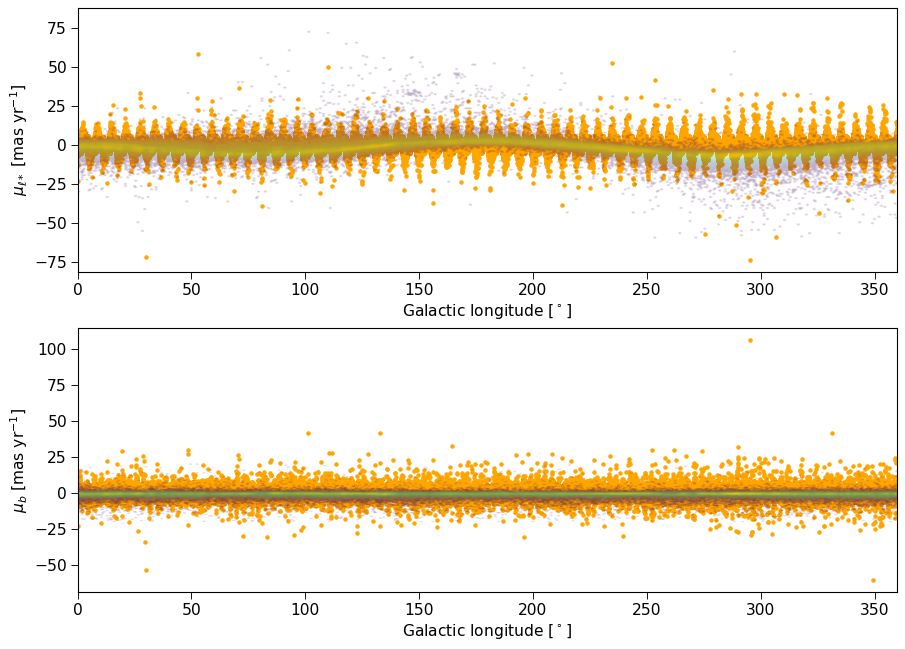

Text(0.5, 0, '$v_{\\ell*}$ [km s$^{-1}$]')

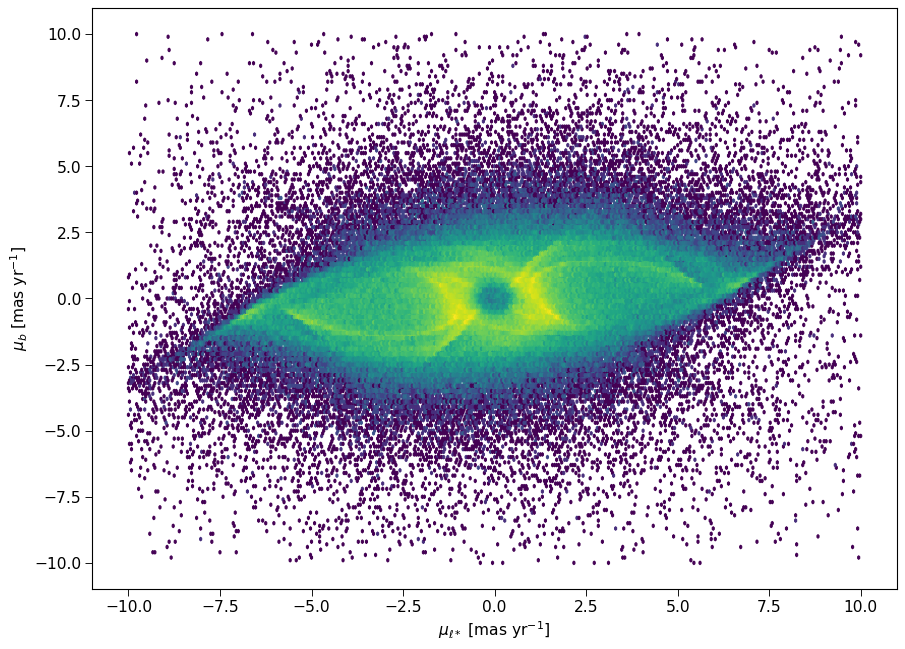

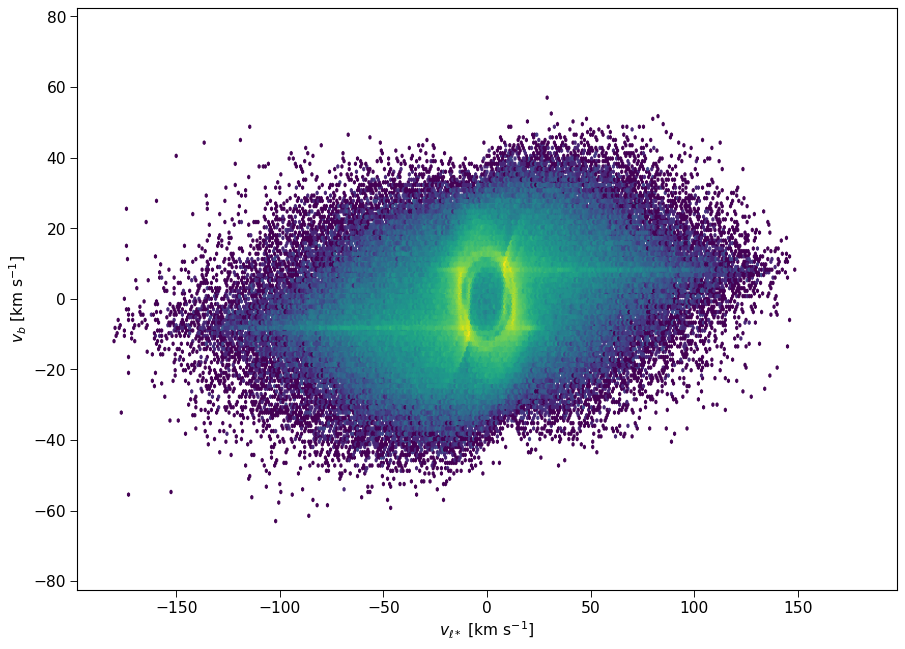

In [142]:
fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))

gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
ax_lmul.scatter(obatable['l'][sample_filter], pml_model, marker='.', alpha = 1, c='orange')

im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], obatable['pml'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-60,80], alpha = 0.1)
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'$\mu_{\ell*}$ [mas yr$^{-1}$]')
ax_lmul.set_xlim(0,360)

ax_lmub = fig.add_subplot(gs[1,0])
ax_lmub.scatter(obatable['l'][sample_filter], pmb_model, marker='.', alpha = 1, c='orange')
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], obatable['pmb'][sample_filter], 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20], alpha = 0.1)
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'$\mu_b$ [mas yr$^{-1}$]')
ax_lmub.set_xlim(0,360)

plt.show()

fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))
gs = GridSpec(1, 1, figure=fig)

ax_mulb = fig.add_subplot(gs[0,0])
# ax_lmulb.scatter(pml_model, pmb_model, marker='.', alpha = 1, c='orange')

im_mulb = ax_mulb.hexbin(pml_model, pmb_model, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[-10,10,-10,10])
ax_mulb.set_ylabel(r'$\mu_b$ [mas yr$^{-1}$]')
ax_mulb.set_xlabel(r'$\mu_{\ell*}$ [mas yr$^{-1}$]')
# ax_lmulb.set_xlim(0,360)

vl_model = A/plx * pml_model
vb_model = A/plx * pmb_model

fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))
gs = GridSpec(1, 1, figure=fig)

ax_vlb = fig.add_subplot(gs[0,0])
# ax_lmulb.scatter(pml_model, pmb_model, marker='.', alpha = 1, c='orange')

im_vlb = ax_vlb.hexbin(vl_model, vb_model, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[-180,180,-75,75])
ax_vlb.set_ylabel(r'$v_b$ [km s$^{-1}$]')
ax_vlb.set_xlabel(r'$v_{\ell*}$ [km s$^{-1}$]')
# ax_lmulb.set_xlim(0,360)


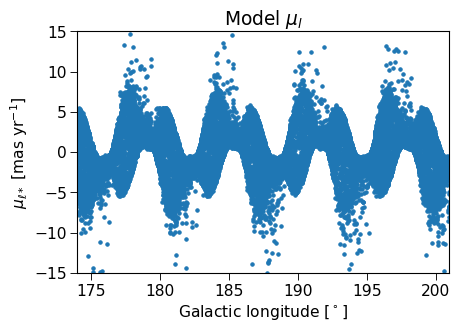

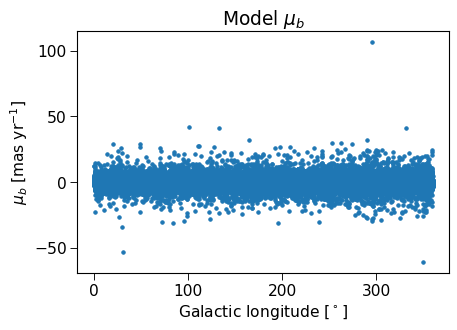

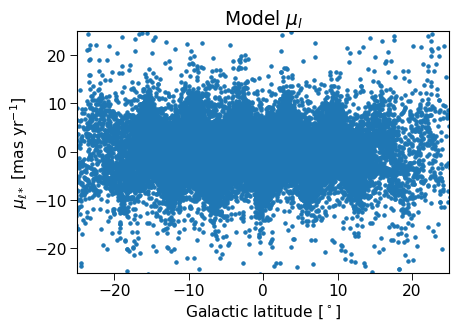

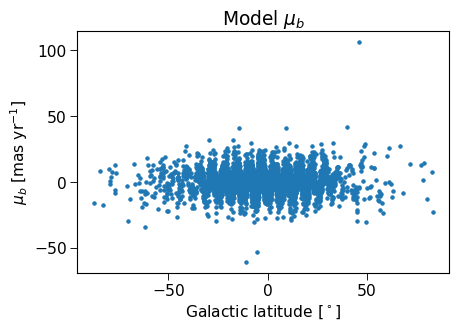

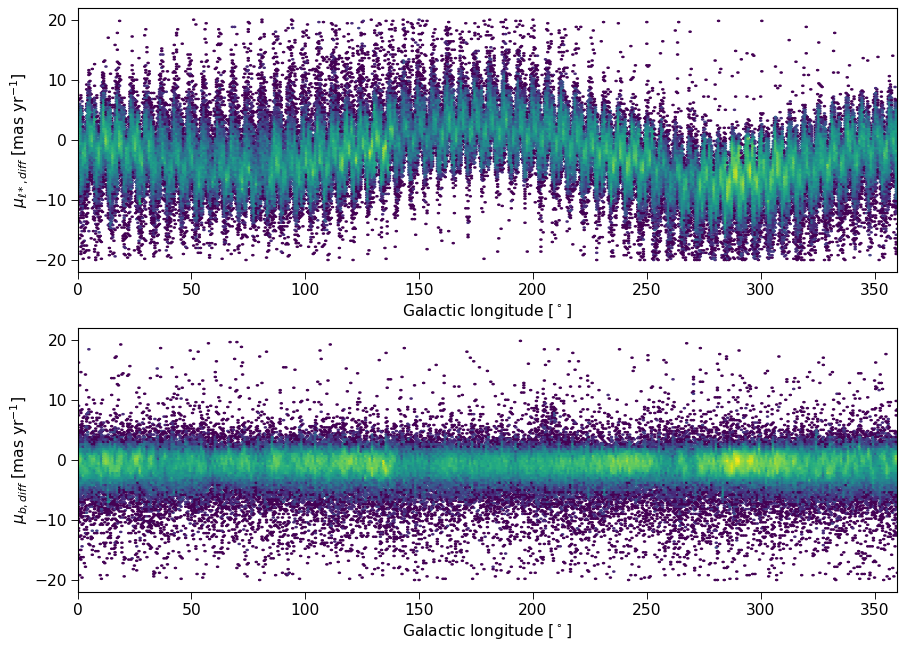

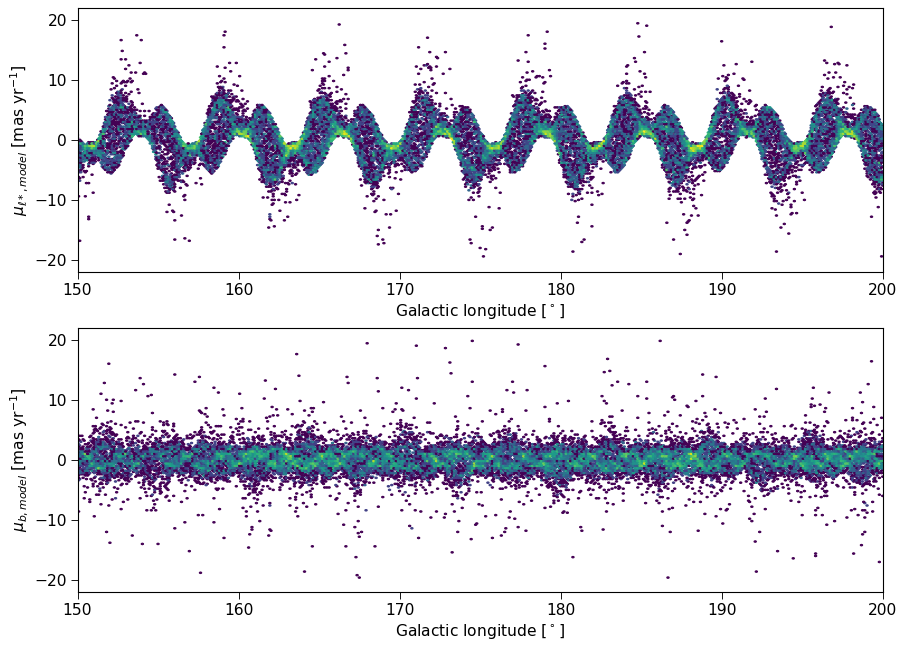

In [101]:
plt.title(r"Model $\mu_l$")
plt.scatter(obatable['l'][sample_filter], pml_model, marker='.')
plt.xlim(174, 201)
plt.ylim(-15, 15)
plt.xlabel(r'Galactic longitude [$^\circ$]')
plt.ylabel(r'$\mu_{\ell*}$ [mas yr$^{-1}$]')
plt.show()

plt.title(r"Model $\mu_b$")
plt.scatter(obatable['l'][sample_filter], pmb_model, marker='.')
# plt.xlim(174, 201)
# plt.ylim(-10, 10)
plt.xlabel(r'Galactic longitude [$^\circ$]')
plt.ylabel(r'$\mu_b$ [mas yr$^{-1}$]')
plt.show()

plt.title(r"Model $\mu_l$")
plt.scatter(obatable['b'][sample_filter], pml_model, marker='.')
plt.xlim(-25, 25)
plt.ylim(-25, 25)
plt.xlabel(r'Galactic latitude [$^\circ$]')
plt.ylabel(r'$\mu_{\ell*}$ [mas yr$^{-1}$]')
plt.show()

plt.title(r"Model $\mu_b$")
plt.scatter(obatable['b'][sample_filter], pmb_model, marker='.')
# plt.xlim(174, 201)
# plt.ylim(-10, 10)
plt.xlabel(r'Galactic latitude [$^\circ$]')
plt.ylabel(r'$\mu_b$ [mas yr$^{-1}$]')
plt.show()

fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))
gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], pml_diff, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'$\mu_{\ell*,diff}$ [mas yr$^{-1}$]')
ax_lmul.set_xlim(0,360)

ax_lmub = fig.add_subplot(gs[1,0])
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], pmb_diff, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'$\mu_{b, diff}$ [mas yr$^{-1}$]')
ax_lmub.set_xlim(0,360)

plt.savefig('bstar-pml_diff-pmb_diff-vs-galon.png')

fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))
gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], pml_model, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[150,200,-20,20])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'$\mu_{\ell*, model}$ [mas yr$^{-1}$]')
ax_lmul.set_xlim(150,200)

ax_lmub = fig.add_subplot(gs[1,0])
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], pmb_model, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[150,200,-20,20])
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'$\mu_{b, model}$ [mas yr$^{-1}$]')
ax_lmub.set_xlim(150,200)

plt.show()

## Exploring possible causes of periodicity

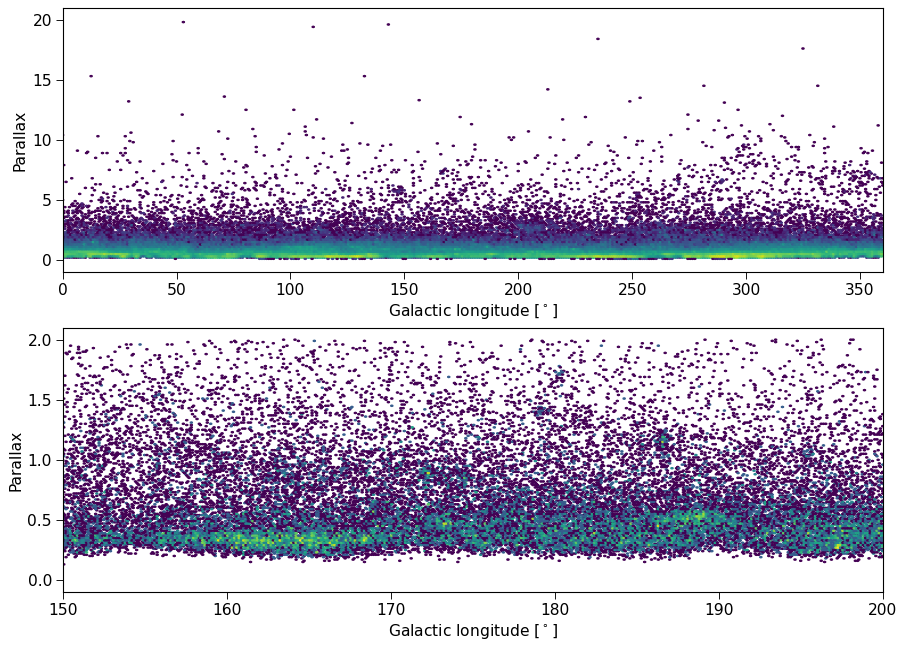

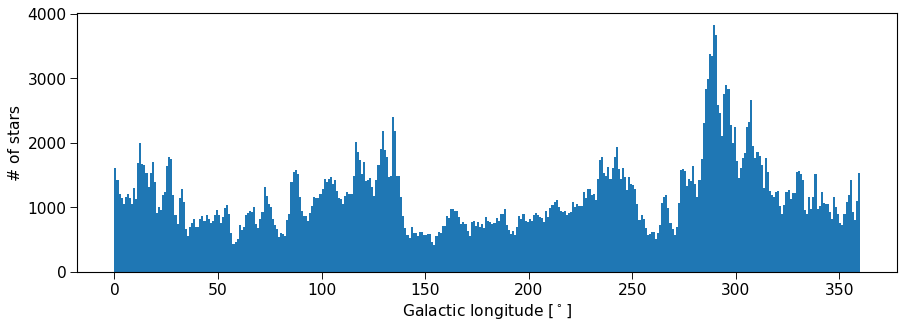

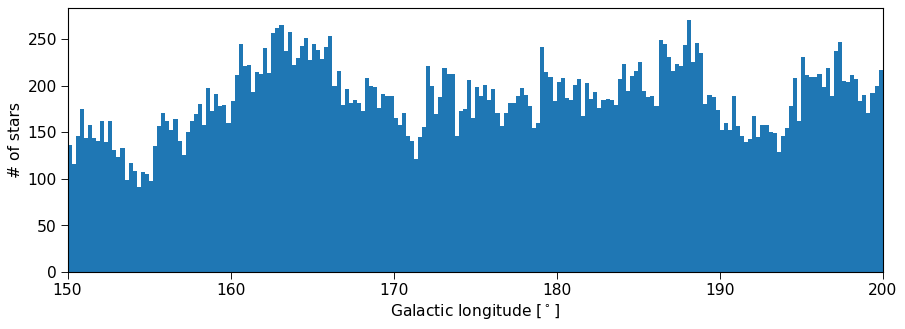

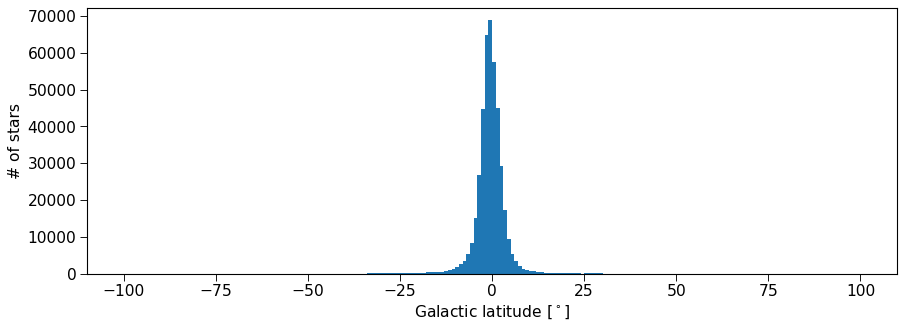

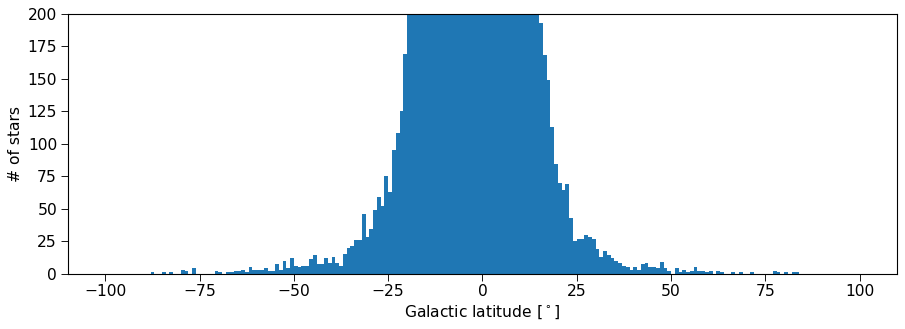

(0.0, 360.0)

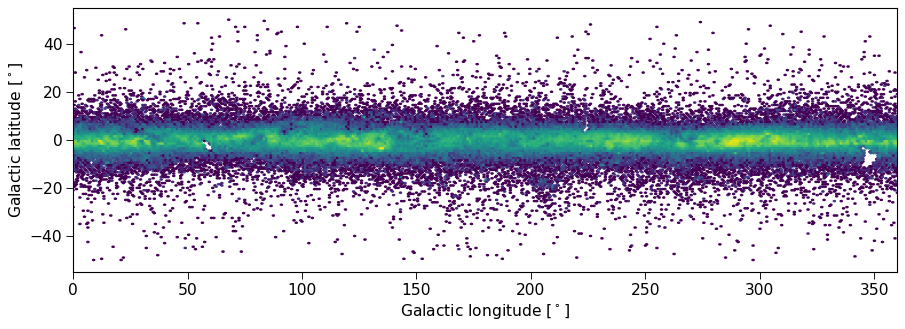

In [125]:
# We insert three parameters: galon, galat and plx
# Does parallax maybe show some periodicity?

fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))
gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], plx, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,0,20])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'Parallax')
ax_lmul.set_xlim(0,360)

ax_lmub = fig.add_subplot(gs[1,0])
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], plx, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[150,200,0,2])
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'Parallax')
ax_lmub.set_xlim(150,200)

# No.


# Number of stars?
plt.figure(constrained_layout=True, figsize=(0.8*14,0.4*10))
plt.hist(obatable['l'][sample_filter], bins=np.linspace(0, 360, 361))
plt.xlabel(r'Galactic longitude [$^\circ$]')
plt.ylabel("# of stars")
plt.show()

plt.figure(constrained_layout=True, figsize=(0.8*14,0.4*10))
plt.hist(obatable['l'][sample_filter], bins=np.linspace(150, 200, 201))
plt.xlabel(r'Galactic longitude [$^\circ$]')
plt.ylabel("# of stars")
plt.xlim(150, 200)
plt.show()

plt.figure(constrained_layout=True, figsize=(0.8*14,0.4*10))
plt.hist(obatable['b'][sample_filter], bins=np.linspace(-100, 100, 201))
plt.xlabel(r'Galactic latitude [$^\circ$]')
plt.ylabel("# of stars")
plt.show()

plt.figure(constrained_layout=True, figsize=(0.8*14,0.4*10))
plt.hist(obatable['b'][sample_filter], bins=np.linspace(-100, 100, 201))
plt.xlabel(r'Galactic latitude [$^\circ$]')
plt.ylabel("# of stars")
# plt.xlim(150, 200)
plt.ylim(0, 200)
plt.show()

# No.


# Galat vs. galon
# Has some gaps, but no extrodinary behaviour

fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.4*10))
gs = GridSpec(1, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(galon, galat, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-50,50])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'Galactic latitude [$^\circ$]')
ax_lmul.set_xlim(0,360)



## Replicating runaway figure from Zari book

<ipython-input-154-4980966fab59>:36: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  pvec = np.array([-np.sin(longitude_vals), np.cos(longitude_vals), 0.0])
<ipython-input-154-4980966fab59>:38: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  v_lon_model = np.dot(pvec, np.array([-v_phi_model*np.sin(phis[n]), v_phi_model*np.cos(phis[n]), 0.0])-np.array([0.0, Vcirc_sun, 0.0]))


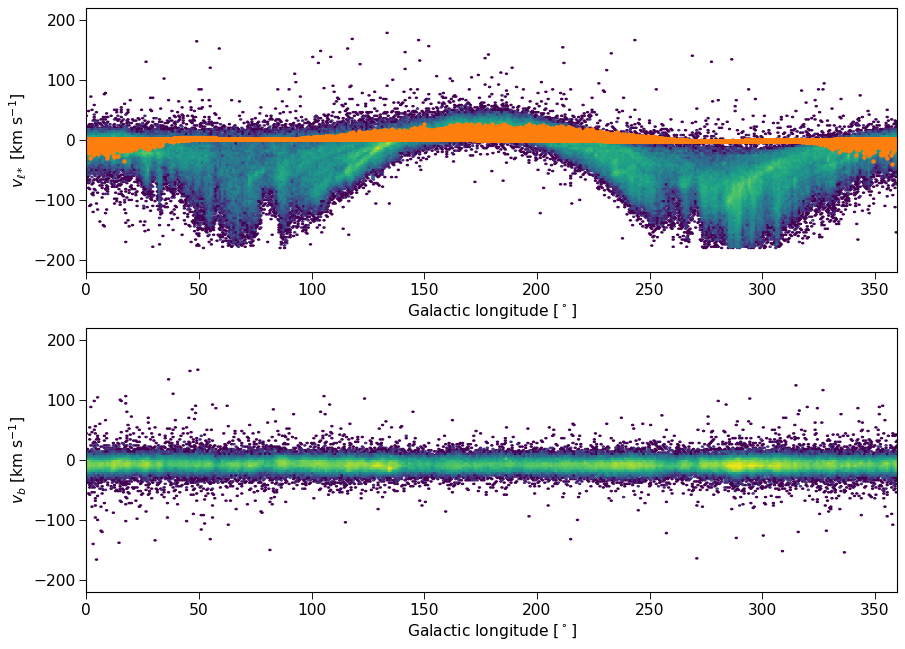

In [154]:
A = 4.74047  # km s^-1 yr

prop_mot_lon = np.array(obatable['pml'][sample_filter].tolist())
prop_mot_lat = np.array(obatable['pmb'][sample_filter].tolist())
plx = np.array(obatable['parallax'][sample_filter].tolist())

vsun = np.array([0.0, vcircsun, 0.0])# + vsunpeculiar.value

# Is vsun_pec niet in de xyz richting? Dan kan deze optelling hier nog niet!
v_lon = A * prop_mot_lon / plx# + vsun[1]
v_lat = A * prop_mot_lat / plx# + vsun[2]
# for n in range(len(v_lon)):
#     v_lon[n] = v_lon[n] + vsun
#     v_lat[n] = v_lat[n] + vsun

###

#################################################

def v_lon_model_values(longitude_vals = np.deg2rad(obatable['l'][sample_filter]).tolist(), latitude_vals=np.deg2rad(obatable['b'][sample_filter]).tolist(), plx=plx):
    hbp = stan_model['best_params']['hbp']
    pbp = stan_model['best_params']['pbp']
    Vcirc_sun = stan_model['best_params']['Vcirc_sun']
    v0 = Vcirc_sun/(Rsun.value/hbp*(1+(Rsun.value/hbp)**2)**((pbp-2)/4))
    
    rvec = np.array([np.cos(latitude_vals)*np.cos(longitude_vals), np.cos(latitude_vals)*np.sin(longitude_vals), np.sin(latitude_vals)]).T
    Ysun = 0.0
    sunpos = np.array([-Rsun.value, Ysun, zsun.value])
    starpos = ((1.0/plx)*rvec.T).T# + sunpos     # parallax temp. replaced with 1
    Rstar = np.zeros(starpos[:,0].shape)
    for n in range(len(starpos)):
        starpos[n] = starpos[n] + sunpos
        Rstar[n] = np.sqrt(starpos[n][0]**2+starpos[n][1]**2)
        phis[n] = np.arctan2(starpos[n][2], starpos[n][1])
        
    pvec = np.array([-np.sin(longitude_vals), np.cos(longitude_vals), 0.0])
    v_phi_model = bp_function(Rstar, pbp, hbp, v0)
    v_lon_model = np.dot(pvec, np.array([-v_phi_model*np.sin(phis[n]), v_phi_model*np.cos(phis[n]), 0.0])-np.array([0.0, Vcirc_sun, 0.0]))
    return v_lon_model
#################################################

model_behaviour = v_lon_model_values()



fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))

gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], v_lon, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-200,200])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'$v_{\ell*}$ [km s$^{-1}$]')
ax_lmul.set_xlim(0,360)

ax_lmub = fig.add_subplot(gs[1,0])
im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], v_lat, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-200,200])
ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmub.set_ylabel(r'$v_b$ [km s$^{-1}$]')
ax_lmub.set_xlim(0,360)

ax_lmul.scatter(obatable['l'][sample_filter], model_behaviour, c='C1', marker = '.', lw=1, label=rf'predicted values')

# print(median_dist)
# for dist, lstyle in zip([500, 2000], ['--C1', '-C1']):
#     distance = np.zeros_like(galon.value) + dist*u.pc
#     galat = np.zeros_like(galon.value) - np.rad2deg(np.arcsin(zsun.value/dist))*u.deg
#     pml_model, pmb_model, vrad_model = diskmodel_best.observables(distance, galon, galat)
#     ax_lmul.plot(galon, pml_model, lstyle, lw=3, label=rf'$d={dist:.0f}$ pc')
#     ax_lmub.plot(galon, pmb_model, lstyle, lw=3)

# Adding projection of the suns motion as test/control:       ___ Nog niet gedaan!!!!! ___
# ax_lmul.plot(galon, vrad_model, c='C1', lw=3, label=rf'$d={dist:.0f}$ pc')

## Substracting mean predicted proper motion

In [46]:
def bp_function(r, p_param, h_param, v0):
#     rotcur = lambda x : x/h_param * np.power(1 + (x/h_param)**2, (p_param-2)/4)
#     vc = v0*rotcur(r)
    return v0 * r/h_param * np.power(1 + (r/h_param)**2, (p_param-2)/4)

In [47]:
for par in stan_model['parnames']:
    vals = oba_fit.stan_variable(par)
    stan_model['best_params'][par] = np.median(vals)
    q1, q2, q3 = scap(vals, [16, 50, 84])
    print(f"{par} = {q2:.1f}+{q3-q2:.1f}-{q2-q1:.1f}")

Vcirc_sun = 231.7+1.5-1.5
hbp = 4.8+0.2-0.3
pbp = -0.9+0.1-0.1
Vsun_pec_x = 9.0+0.4-0.4
Vsun_pec_y = 10.7+0.4-0.4
Vsun_pec_z = 8.0+0.1-0.1
vdispR = 17.3+0.4-0.3
vdispPhi = 12.0+0.4-0.3
vdispZ = 7.2+0.1-0.1


[array([-0.43797979, -0.44122061, -0.44436842, ..., -0.81738516,
        -0.81727736, -0.81780982])
 array([-0.89898482, -0.89739867, -0.89584413, ...,  0.57609157,
         0.57624449,  0.57548857])                               0.0]
(3,)
[[-0.88715705  0.43221738 -0.16168028]
 [-0.88450416  0.43488082 -0.16891141]
 [-0.88259043  0.43779414 -0.17137801]
 ...
 [ 0.5760765   0.81736378  0.00723252]
 [ 0.5762271   0.81725269  0.00777005]
 [ 0.57547861  0.81779567  0.00588302]]
[8.79855039 9.01480119 8.79652908 ... 7.43565026 7.04368643 7.68668133]
[  9.53724032   2.7372363   11.95572073 ... -33.2500386  -91.05418804
   0.30125172]
[2.03295377 2.65934483 2.033363   ... 2.16859411 2.22672622 2.01369592]
[ 7.50428655e+00  7.78914697e-02  9.92235773e+00 ... -3.54186327e+01
 -9.32809143e+01 -1.71244420e+00]


<ipython-input-152-4195c783feeb>:27: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  pvec = np.array([-np.sin(galon), np.cos(galon), 0.0]).T
<ipython-input-152-4195c783feeb>:34: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  v_lon_model = np.dot(pvec, np.array([-v_phi_model*np.sin(phis[n]), v_phi_model*np.cos(phis[n]), 0.0])-np.array([0.0, Vcirc_sun, 0.0]))


(0.0, 360.0)

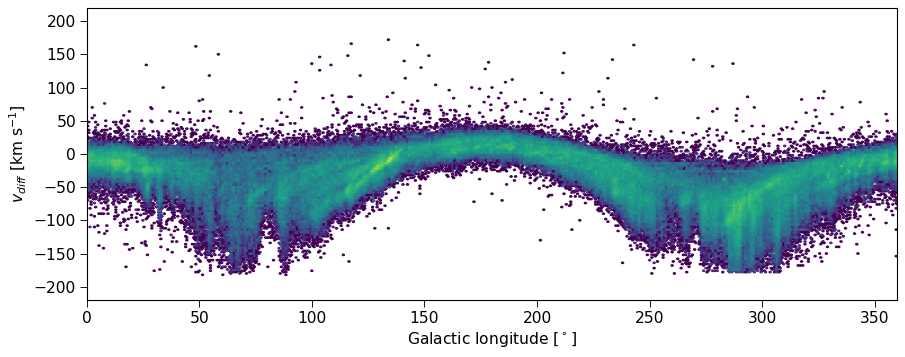

In [152]:
# Per radius, via model v uitrekenen
# Dat dan aftrekken van de sters eigenschappen
# is v_phi == v_lon ??? Nee.

galon = np.deg2rad(obatable['l'][sample_filter]).tolist()
galat = np.deg2rad(obatable['b'][sample_filter]).tolist()
hbp = stan_model['best_params']['hbp']
pbp = stan_model['best_params']['pbp']
Vcirc_sun = stan_model['best_params']['Vcirc_sun']


v0 = Vcirc_sun/(Rsun.value/hbp*(1+(Rsun.value/hbp)**2)**((pbp-2)/4))  # Controleren values/astropy units

rvec = np.array([np.cos(galat)*np.cos(galon), np.cos(galat)*np.sin(galon), np.sin(galat)]).T
Ysun = 0.0
sunpos = np.array([-Rsun.value, Ysun, zsun.value])

starpos = ((1.0/plx)*rvec.T).T# + sunpos
Rstar = np.zeros(starpos[:,0].shape)
phis = np.zeros(starpos[:,0].shape)
for n in range(len(starpos)):
    starpos[n] = starpos[n] + sunpos
    
    Rstar[n] = np.sqrt(starpos[n][0]**2+starpos[n][1]**2)
    
    phis[n] = np.arctan2(starpos[n][2], starpos[n][1])
pvec = np.array([-np.sin(galon), np.cos(galon), 0.0]).T
print(pvec)
print(pvec.shape)
print(rvec)
    
v_phi_model = bp_function(Rstar, pbp, hbp, v0)
# Hier dus nog aan toevoegen:
v_lon_model = np.dot(pvec, np.array([-v_phi_model*np.sin(phis[n]), v_phi_model*np.cos(phis[n]), 0.0])-np.array([0.0, Vcirc_sun, 0.0]))


print(Rstar)
print(v_lon)
print(v_lon_model)
# for n in Rstar:
#     v_lon_model[n] = bp_function(Rstar[n], pbp, hbp, v0)

v_lon_diff = v_lon - v_lon_model
print(v_lon_diff)

fig=plt.figure(constrained_layout=True, figsize=(0.8*14,0.8*10))

gs = GridSpec(2, 1, figure=fig)

ax_lmul = fig.add_subplot(gs[0,0])
im_lmul = ax_lmul.hexbin(obatable['l'][sample_filter], v_lon_diff, 
                         gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-200,200])
ax_lmul.set_xlabel(r'Galactic longitude [$^\circ$]')
ax_lmul.set_ylabel(r'$v_{diff}$ [km s$^{-1}$]')
ax_lmul.set_xlim(0,360)

# ax_lmub = fig.add_subplot(gs[1,0])
# im_lmub = ax_lmub.hexbin(obatable['l'][sample_filter], v_lat, 
#                          gridsize=[360,100], mincnt=1, bins='log', extent=[0,360,-20,20])
# ax_lmub.set_xlabel(r'Galactic longitude [$^\circ$]')
# ax_lmub.set_ylabel(r'$v_b$ [km s$^{-1}$]')
# ax_lmub.set_xlim(0,360)


In [65]:
A = np.array([1,2,3,4,5,6])
B = np.array([1,2,3,4,5,6])
print(A*B.T)

C = np.array([[1,2], [2,3], [3,4], [4,5], [5,6], [6,7]])
print(A*C.T)


print(1.0/plx)
print(rvec)
print(((1.0/plx)*rvec.T).T)

[ 1  4  9 16 25 36]
[[ 1  4  9 16 25 36]
 [ 2  6 12 20 30 42]]
[0.58381019 0.82604566 0.58442434 ... 1.68339927 2.80659098 1.12114834]
[[-0.88715705  0.43221738 -0.16168028]
 [-0.88450416  0.43488082 -0.16891141]
 [-0.88259043  0.43779414 -0.17137801]
 ...
 [ 0.5760765   0.81736378  0.00723252]
 [ 0.5762271   0.81725269  0.00777005]
 [ 0.57547861  0.81779567  0.00588302]]
[[-0.51793133  0.25233291 -0.09439059]
 [-0.73064083  0.35923142 -0.13952854]
 [-0.51580733  0.25585755 -0.10015748]
 ...
 [ 0.96976677  1.3759496   0.01217521]
 [ 1.61723377  2.29369403  0.02180736]
 [ 0.64519689  0.91687026  0.00659574]]
